In [1]:
import pandas as pd
import math
import numpy as np
from astropy.coordinates import SkyCoord
from astropy.io import fits
import healpy as hp
import matplotlib.pyplot as plt
import time
import sys
from pixell import enmap, enplot, reproject, utils, curvedsky
from matplotlib import cm
from scipy.optimize import curve_fit
from scipy.linalg import sqrtm
from tqdm import tqdm

In [2]:
# Read in AMF catalog
amf = pd.read_csv('dr9_main_complete.csv', header=None)
amf.columns = ['amf_no','amf_ra','amf_dec','amf_z','amf_lk','amf_rh','amf_r200','amf_rc','amf_c','amf_str_rh','bax_id','mcxc_id','red_id','whl_id']

c = SkyCoord(amf['amf_ra'],amf['amf_dec'],frame='icrs',unit='deg')
amf['glat'] = c.galactic.b.degree
amf['glon'] = c.galactic.l.degree
amf.head()

,amf_no,amf_ra,amf_dec,amf_z,amf_lk,amf_rh,amf_r200,amf_rc,amf_c,amf_str_rh,bax_id,mcxc_id,red_id,whl_id,glat,glon
0,4,23.9128,20.7465,0.0601,176.9125,219.3663,1.946,0.925,2.104,73.0001,-9999,-9999,-9999,-9999,-40.943468,136.662636
1,5,260.6324,32.1398,0.2252,222.1219,200.7117,1.784,0.625,2.856,35.0001,ABELL2261,J1722.4+3208,RMJ172227.2+320757.2,J172227.2+320757,31.846666,55.602221
2,6,197.8796,-1.3356,0.2042,171.6872,192.0829,1.773,0.227,7.792,9.0001,ABELL1689,J1311.5-0120,RMJ131129.5-012028.0,J131129.5-012028,61.128514,313.370385
3,7,250.1485,46.6917,0.2248,225.9874,182.3373,1.725,0.495,3.483,36.0001,ABELL2219,J1640.3+4642,RMJ164019.8+464241.5,J164019.8+464242,41.429880,72.599428
4,8,346.3402,21.0378,0.1453,121.0124,182.2769,1.775,0.440,4.034,72.0001,-9999,-9999,RMJ230520.1+210313.5,J230520.1+210313,-35.420653,92.175825


In [3]:
amf_whl_red = amf[(amf.whl_id!='-9999') & (amf.red_id!='-9999')]

In [4]:
hdul = fits.open("../overlaps/masks/DR5_cluster-catalog_v1.1.fits")
data = hdul[1].data

In [5]:
adv = pd.DataFrame({'name':data['name'].byteswap().newbyteorder(),
                    'RA':data['RADeg'].byteswap().newbyteorder(),
                    'dec':data['decDeg'].byteswap().newbyteorder(),
                    'SNR':data['SNR'].byteswap().newbyteorder(),
                    'redshift':data['redshift'].byteswap().newbyteorder(),
                    'RM':data['RM'].byteswap().newbyteorder()})

c = SkyCoord(adv['RA'],adv['dec'],frame='icrs',unit='deg')
adv['glat'] = c.galactic.b.degree
adv['glon'] = c.galactic.l.degree
adv.head()

,name,RA,dec,SNR,redshift,RM,glat,glon
0,ACT-CL J0000.0-3837,0.020898,-38.626732,4.793987,0.300599,False,-74.269559,342.746165
1,ACT-CL J0000.2-4357,0.060601,-43.955494,7.678747,0.878131,False,-70.264812,331.113939
2,ACT-CL J0000.3-2805,0.089900,-28.091249,5.665297,0.282570,False,-78.648931,25.118856
3,ACT-CL J0000.3-3936,0.083333,-39.604169,4.058639,0.356218,False,-73.619467,340.100462
4,ACT-CL J0000.4-0102,0.113533,-1.044811,4.997832,0.438800,True,-61.190547,95.689535


In [6]:
adv_not_red = adv[adv.RM==False]
adv.head()

,name,RA,dec,SNR,redshift,RM,glat,glon
0,ACT-CL J0000.0-3837,0.020898,-38.626732,4.793987,0.300599,False,-74.269559,342.746165
1,ACT-CL J0000.2-4357,0.060601,-43.955494,7.678747,0.878131,False,-70.264812,331.113939
2,ACT-CL J0000.3-2805,0.089900,-28.091249,5.665297,0.282570,False,-78.648931,25.118856
3,ACT-CL J0000.3-3936,0.083333,-39.604169,4.058639,0.356218,False,-73.619467,340.100462
4,ACT-CL J0000.4-0102,0.113533,-1.044811,4.997832,0.438800,True,-61.190547,95.689535


In [7]:
adv_not_red.loc[(adv_not_red['glat'].sub(amf_whl_red.iloc[2]['glat']).abs()<100) & (adv_not_red['glon'].sub(amf_whl_red.iloc[2]['glon']).abs()<100)]['glon']

6        98.466626
30      106.849386
37      100.678697
51      108.752638
59      105.952178
           ...    
4161     99.196545
4166    103.149079
4181    104.378702
4186    106.069278
4189    105.910176
Name: glon, Length: 679, dtype: float64

In [9]:
adv_arw = pd.DataFrame()
arw_adv = pd.DataFrame()

In [10]:
arw_adv = pd.DataFrame(data=arw_adv, columns=amf_whl_red.columns)
adv_arw = pd.DataFrame(data=adv_arw, columns=adv_not_red.columns)

In [17]:
arw_adv = arw_adv.iloc[0:0]
adv_arw = adv_arw.iloc[0:0]

for i in tqdm(range(amf_whl_red.shape[0])):
    matches = adv.loc[(adv['glat'].sub(amf_whl_red.iloc[i]['glat']).abs()<1) & (adv['glon'].sub(amf_whl_red.iloc[i]['glon']).abs()<1)]
    if len(matches)==0:
#         print(matches['glat'])
#         print(amf_whl_red.iloc[i]['glat'])
#         print(matches['glon'])
#         print(amf_whl_red.iloc[i]['glon'])      
        arw_adv.loc[len(arw_adv)] = amf_whl_red.iloc[i]
#         print("\n")
#         break

  0%|          | 0/15064 [00:00<?, ?it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the docu

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
  0%|          | 58/15064 [00:00<01:19, 187.64it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats i

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pand

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
  1%|          | 149/15064 [00:00<01:07, 221.08it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats 

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pand

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
  2%|▏         | 239/15064 [00:01<01:11, 205.95it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats 

  2%|▏         | 280/15064 [00:01<01:20, 184.67it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats 

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pand

  2%|▏         | 350/15064 [00:01<01:32, 159.45it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats 

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
  3%|▎         | 417/15064 [00:02<01:16, 190.66it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats 

  3%|▎         | 458/15064 [00:02<01:15, 192.66it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats 

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pand

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
  4%|▎         | 539/15064 [00:02<01:17, 187.14it/s]/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats 

/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pand

In [19]:
# adv_arw2 = arw_adv[(arw_adv.amf_ra>150)&(arw_adv.amf_ra<250)&(arw_adv.amf_dec>-7)&(arw_adv.amf_dec<3)].reset_index()
adv_arw2 = arw_adv.reset_index()

---

In [2]:
# Here we demonstrate how to read in the deep 56 compton y map.  This is the same region 
# we looked at with the lensing map in the previous section

# comptony = enmap.read_map("compsep_maps/tilec_single_tile_BN_comptony_deprojects_cmb_map_v1.2.0_joint.fits")
# comptony = enmap.read_map("act_dr5.01_s08s18_AA_f090_daynight_map.fits")

# Start by reading in the two relevant maps:
# CMB_kSZ_D56 = enmap.read_map("compsep_maps/tilec_single_tile_BN_comptony_deprojects_cmb_map_v1.2.0_joint.fits")
actmap = enmap.read_map("act_dr5.01_s08s18_AA_f150_daynight_map.fits")


In [3]:
# actmap.wcs
actmap_hp = reproject.healpix_from_enmap(actmap[0],nside=2048,lmax=6000)

Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


In [4]:
import healpy as hp
cmb = hp.read_map("COM_CMB_IQU-smica_2048_R3.00_full.fits")

NSIDE = 2048
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT


/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/healpy/fitsfunc.py:352: UserWarning: If you are not specifying the input dtype and using the default np.float64 dtype of read_map(), please consider that it will change in a future version to None as to keep the same dtype of the input file: please explicitly set the dtype if it is important to you.
  "If you are not specifying the input dtype and using the default "
/home/maamari/Documents/Other/Anaconda/lib/python3.7/site-packages/healpy/fitsfunc.py:403: UserWarning: No INDXSCHM keyword in header file : assume IMPLICIT
  warnings.warn("No INDXSCHM keyword in header file : " "assume {}".format(schm))


Ordering converted to RING


In [5]:
a = actmap_hp-cmb

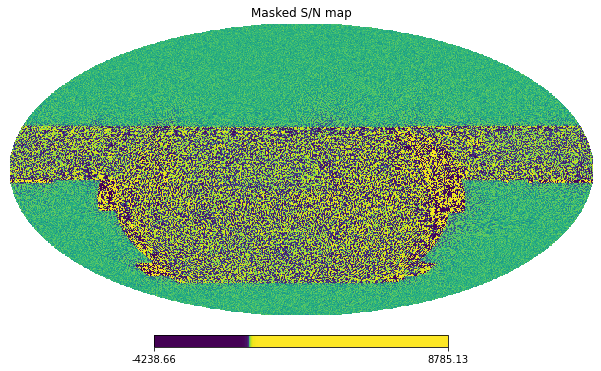

In [14]:
hp.mollview(actmap_hp,norm='hist',title='Masked S/N map')

In [17]:
pd.DataFrame(a).to_csv("file.csv")


In [ ]:
reproject.enmap_from_healpix(cmb,shape=(10320,43200),wcs=actmap.wcs)

Preparing SHT
T -> alm
float64 complex128
Computing pixel positions


In [12]:
CMB_kSZ_D56[0][500]

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [31]:
cmb = enmap.read_map("compsep_maps/tilec_single_tile_BN_cmb_map_v1.2.0_joint.fits")

In [ ]:
a = enmap.to_healpix(enmap.read_map("act_dr5.01_s08s18_AA_f090_daynight_map.fits"))

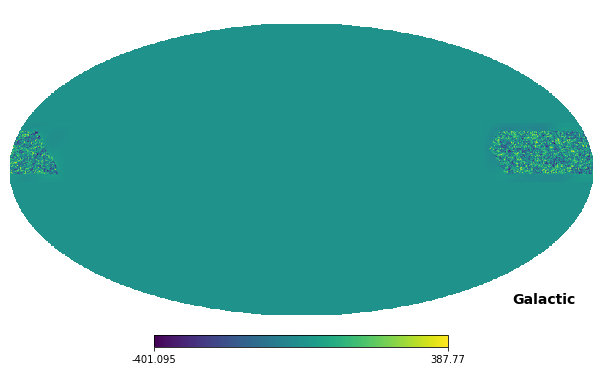

In [35]:
hp.mollview(a,coord=['G'],title=' ')

In [21]:
def eshow(x,**kwargs): 
    ''' Define a function to help us plot the maps neatly '''
    plots = enplot.get_plots(x, **kwargs)
    enplot.show(plots, method = "ipython")

In [22]:
# We can plot the whole region - again adjust the 'downgrade' option to get a larger
# or smaller map
# eshow(comptony, **{'downgrade': 4, 'ticks': 4, 'colorbar': True})

# We can also look at a 'submap' using the 'sub' option in order to see more detail
# eshow(comptony, **{"sub": "0:5 ,-180:-160", 'ticks': 4, "downgrade": 4, "colorbar": True})

  0%|          | 0/10099 [00:00<?, ?it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-256.75278    84.219765   35.234737 -312.69266  -529.87225  -487.58347
 -316.30084  -183.61224  -251.18848  -457.8824   -491.40814  -312.94
 -268.4113   -383.01483  -263.03867    28.595367  -58.23439 ]


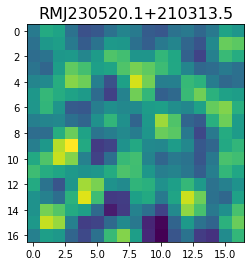

  0%|          | 3/10099 [00:00<12:39, 13.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -91.281456    -9.136234    55.69508     -7.461054  -146.79108
 -181.62994    -71.51073     -2.3725054 -100.44543   -220.15619
 -179.71794    -54.157692   -25.070782   -75.13866    -68.544266
  -19.42069    -33.596752 ]


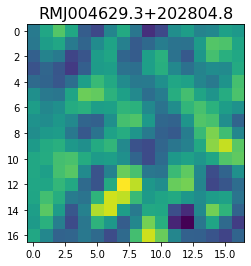

  0%|          | 8/10099 [00:00<10:09, 16.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-194.52448  -140.31084   -97.36179   -90.47421   -89.66616   -89.327644
 -127.509476 -190.2149   -195.77171  -130.0811    -87.38125  -105.712364
  -86.55236    24.478502  107.980446   53.399147  -48.244057]


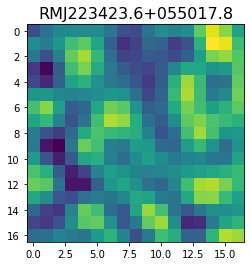

  0%|          | 14/10099 [00:00<09:00, 18.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 250.26111    201.40535     63.47118     71.091194   170.28873
   78.99523   -146.06953   -155.2062      35.389996    23.066278
 -246.6299    -336.90344    -67.06124    173.37633     82.03541
  -84.41843      2.5207415]


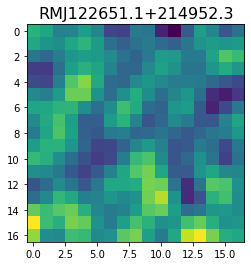

  0%|          | 17/10099 [00:01<10:01, 16.77it/s]

<class 'pixell.enmap.ndmap'>
[ 49.5693    78.04846   84.49133   80.38153   76.465256  70.695625
  70.70753   91.87348  120.91692  117.84084   75.45735   44.91618
  71.702484 128.6086   146.38425  100.57496   36.82652 ]


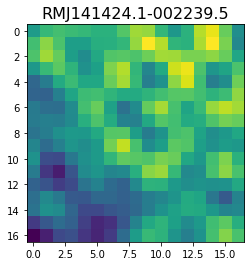

  0%|          | 19/10099 [00:01<11:51, 14.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 360.3353    332.15723   210.19727    63.222065  -26.811743  -48.721752
  -38.64806   -27.5384    -52.42313  -137.41103  -219.49567  -196.07835
  -92.433655  -53.61389  -114.11424  -131.53902   -33.701412]


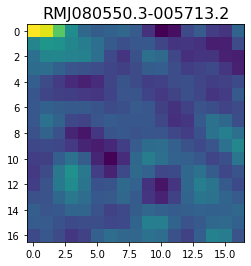

  0%|          | 23/10099 [00:01<11:00, 15.26it/s]

<class 'pixell.enmap.ndmap'>
[ -4.8650184  61.84394   195.94649   227.27594    95.316086  -17.337118
  25.623951   78.59474   -10.81744   -91.22696    39.744728  249.2032
 262.10776   102.36463    13.103838   47.766197   59.210297 ]


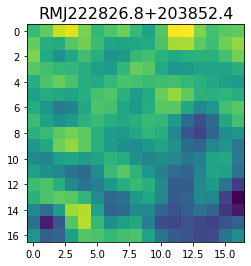

<class 'pixell.enmap.ndmap'>
[ -91.003746  -88.61293   -73.944244  -78.13514  -109.88695  -154.06578
 -197.4412   -223.65756  -208.27516  -155.38776  -112.4858   -113.18541
 -134.124    -140.6976   -138.59769  -144.25255  -143.8431  ]


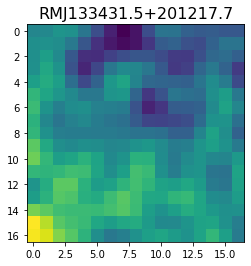

  0%|          | 25/10099 [00:02<20:50,  8.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -42.838337  -85.567825 -119.379654 -113.74931  -146.25331  -219.77457
 -243.32721  -204.02289  -183.74313  -205.81448  -207.2066   -157.25923
 -102.81644  -100.91983  -151.64293  -185.06335  -131.70161 ]


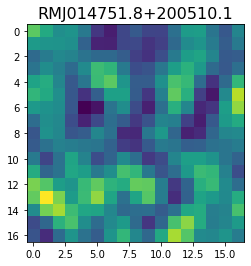

  0%|          | 32/10099 [00:02<13:46, 12.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-75.96863  -35.13924  -37.120308 -52.988342 -30.635378  27.364576
  57.580803  22.914845 -31.760975 -40.759422  -5.561503  19.09418
  12.505176  12.943015  47.60887   82.07861   69.98569 ]


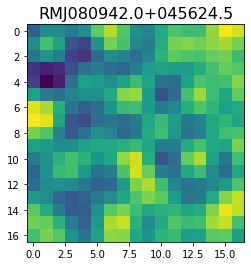

  0%|          | 36/10099 [00:02<12:47, 13.11it/s]

<class 'pixell.enmap.ndmap'>
[-46.843792 -18.495747   9.558852   6.024282 -24.072113 -42.696697
 -31.123825 -13.636472 -19.115267 -41.83482  -55.674706 -50.349903
 -37.20266  -30.00284  -33.70361  -44.787964 -52.7112  ]


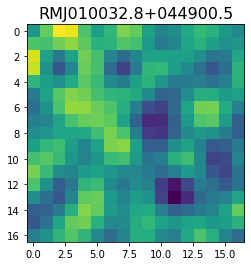

<class 'pixell.enmap.ndmap'>
[-17.48567   40.831203  84.03479   28.474663 -51.995354 -33.348637
  49.859722  51.351475 -44.840065 -95.39471  -36.411587  17.56697
 -19.743538 -56.10746   16.211168 128.97552  138.84584 ]


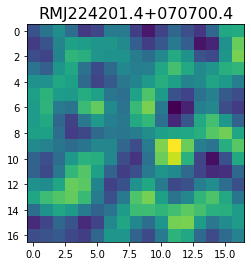

  0%|          | 45/10099 [00:03<09:58, 16.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -14.231111  -36.01717    44.611385  133.61728    92.224785  -53.655674
 -125.8636    -23.727625  153.8605    240.00513   179.7969     43.7664
  -79.561584 -141.20308  -105.1225     46.955486  243.51913 ]


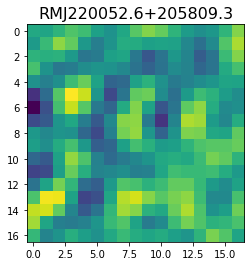

<class 'pixell.enmap.ndmap'>
[ 20.857046  -15.734141  -17.244867   12.621471   28.738008   11.746847
 -15.799375  -30.18185   -25.883694   -8.015344    5.2579875  -8.574138
 -42.91973   -61.16582   -46.540314  -25.20068   -24.230228 ]


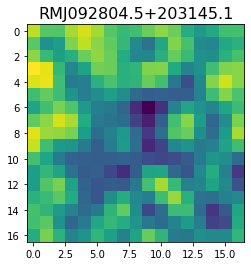

  0%|          | 48/10099 [00:03<12:48, 13.09it/s]

<class 'pixell.enmap.ndmap'>
[-34.55028   -33.001057  -24.711926  -16.946194  -16.116213  -14.378806
  -2.6223118   8.483505    3.9615147  -6.0896945  -2.1122785   9.469265
  10.668427    9.039884   21.557686   36.197727   31.631012 ]


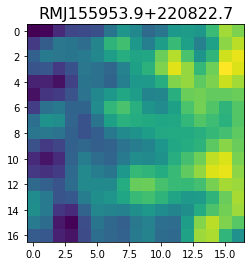

  1%|          | 51/10099 [00:03<12:42, 13.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


  1%|          | 59/10099 [00:03<07:43, 21.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-181.04251  -182.73055  -173.0666   -156.60286  -143.50401  -149.10811
 -177.06833  -208.44319  -219.83775  -210.7097   -200.53741  -197.41219
 -184.00179  -145.57303  -102.07646   -92.81508  -126.314255]


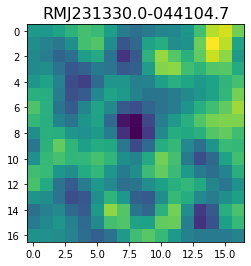

  1%|          | 64/10099 [00:04<08:48, 19.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-100.25249    -18.332651    41.641773     2.0312734  -61.884373
  -56.255154   -21.587872   -38.729393   -76.81864    -58.102943
   -3.5812714    5.7667446  -34.640785   -58.174664   -34.83151
    7.3957896   40.100983 ]


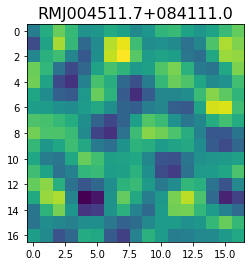

  1%|          | 72/10099 [00:04<07:43, 21.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -65.73537   -85.34048  -113.47546  -115.702644  -94.236786  -84.630005
 -101.884384 -118.5502   -114.21624  -118.09229  -166.72469  -234.53648
 -253.04605  -205.58658  -159.09056  -177.05537  -232.90541 ]


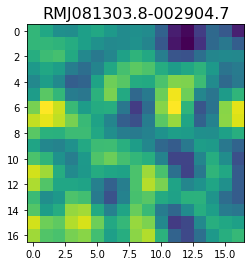

  1%|          | 75/10099 [00:04<08:41, 19.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[271.62436 273.4981  272.38214 263.89044 256.4738  256.5486  262.38828
 269.47873 271.98953 266.9174  262.7977  271.40033 287.35608 292.63602
 283.0665  272.48044 270.81793]


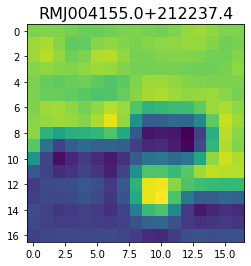

  1%|          | 78/10099 [00:05<09:34, 17.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -12.175549    -6.6770434   -5.6000056  -35.642437   -86.53843
 -108.83873    -92.7919     -79.655655   -78.92566    -50.72024
    3.412973    14.951884   -41.156403   -88.60709    -63.722916
  -18.662594   -35.867477 ]


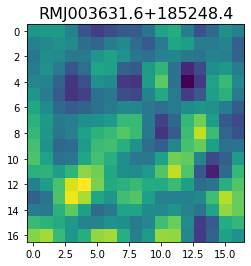

  1%|          | 82/10099 [00:05<09:53, 16.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-121.23794 -145.67169 -161.5658  -158.94705 -164.91176 -190.64137
 -205.75078 -184.21071 -149.28012 -144.813   -173.40034 -191.9114
 -170.16467 -129.06546 -108.39571 -114.65367 -120.2797 ]


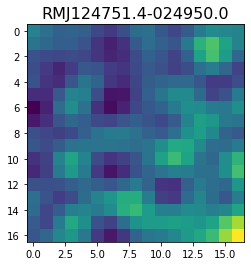

  1%|          | 85/10099 [00:05<11:40, 14.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  51.401016 -124.9582   -140.41148   -32.455265   53.990074   83.17113
   78.58728    24.18865   -50.89863   -39.42508    73.07205   146.75995
   98.880005   29.642168   39.38926    71.68692    45.25707 ]


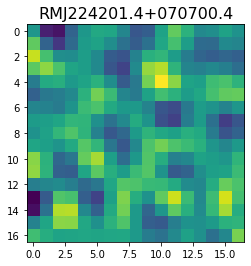

  1%|          | 87/10099 [00:05<12:57, 12.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[6.8773338e+01 1.0326706e+02 1.5558104e+02 1.5438983e+02 1.5444272e+02
 2.2748933e+02 2.7444803e+02 1.6470145e+02 5.5888045e-01 2.6970420e-02
 1.5054004e+02 2.2817390e+02 1.5125232e+02 6.7737152e+01 7.7093048e+01
 1.0289594e+02 8.2259033e+01]


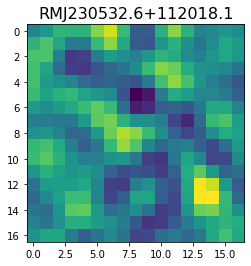

  1%|          | 90/10099 [00:06<13:06, 12.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -64.97393  -183.15445  -173.38776   -65.02742   -22.023006  -99.37633
 -160.15623   -98.48998   -14.631755  -46.298138 -141.19627  -163.21579
 -132.39186  -161.11504  -217.8424   -177.10268   -72.80395 ]


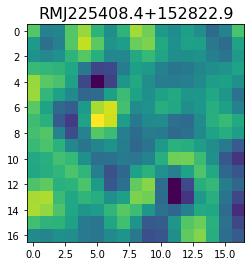

  1%|          | 93/10099 [00:06<13:23, 12.45it/s]

<class 'pixell.enmap.ndmap'>
[-267.14728 -265.75406 -248.35818 -220.69257 -212.87804 -234.7732
 -256.03436 -247.73698 -221.74753 -211.00818 -222.49263 -227.72911
 -202.44725 -162.67906 -145.24522 -155.20035 -158.9844 ]


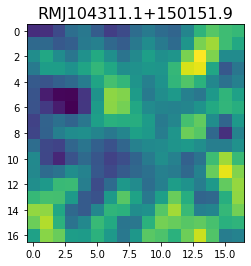

  1%|          | 95/10099 [00:06<14:30, 11.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[84.71301  91.56988  92.8448   86.12764  79.16191  78.265015 78.37053
 74.84492  74.450226 82.11279  89.195656 88.019394 84.323235 84.16412
 83.85944  81.97836  84.10782 ]


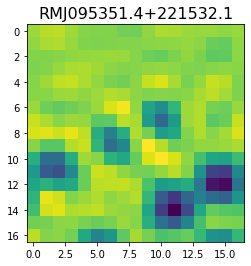

<class 'pixell.enmap.ndmap'>
[ 67.25539   81.55352  101.22296  101.10271   75.85701   55.958225
  64.80264   82.672104  79.44893   63.947544  65.85996   80.52113
  73.18621   38.097267  11.781771  17.073915  31.052017]


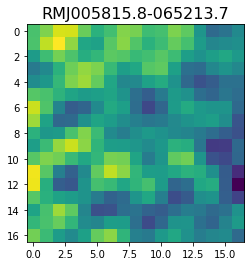

  1%|          | 97/10099 [00:06<18:42,  8.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -68.49325   -65.358025  -58.084225  -46.445347  -44.118176  -71.573586
 -117.06664  -129.70865   -85.78952   -39.253826  -54.83378  -107.93721
 -118.92903   -78.69999   -56.07397   -74.68812   -78.77728 ]


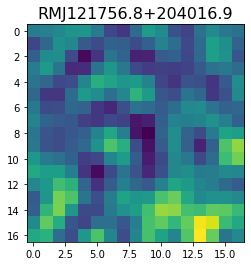

  1%|          | 99/10099 [00:07<18:46,  8.88it/s]

<class 'pixell.enmap.ndmap'>
[  50.011005  193.65445   126.7103    -43.849014  -72.22546    32.07206
  104.24368   131.36394   154.44006    90.67447   -64.1049   -114.33365
   15.426305  127.76577    98.53725    52.775906   69.73227 ]


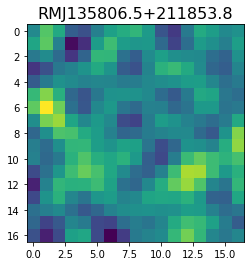

  1%|          | 113/10099 [00:07<06:59, 23.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


  1%|          | 120/10099 [00:07<05:05, 32.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[141.42957  173.37546  124.847664  36.39043  -26.098642 -30.925592
  24.776052 111.964264 157.1442   109.18638   29.173342  32.16457
 121.8901   171.08421   99.67586  -11.553234 -36.460743]


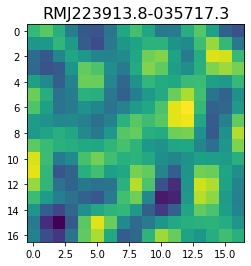

  1%|▏         | 128/10099 [00:08<05:32, 29.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  1.183827  -9.667542 -47.49728  -74.81393  -67.937645 -43.034607
 -29.073133 -34.26868  -45.083782 -45.478355 -32.465298 -19.571014
 -24.309488 -47.079845 -68.15381  -71.67053  -63.646606]


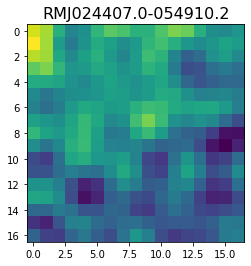

  1%|▏         | 132/10099 [00:08<06:34, 25.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 20.094385  117.62237   138.13188    84.619354   28.14061   -16.050444
 -65.33898   -77.787544  -12.093615   69.97807    91.98942    93.544685
 136.44878   159.69456    87.78281     5.5531073  47.420433 ]


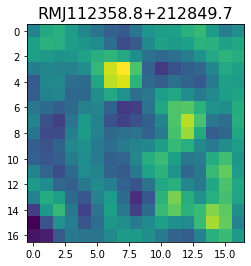

  1%|▏         | 136/10099 [00:08<07:23, 22.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-151.84662   -95.65855   -38.69318   -45.297245  -75.35464   -85.09056
 -107.03488  -176.20096  -243.37723  -228.04523  -133.52827   -57.46723
  -81.70438  -176.71806  -234.61002  -196.82167  -123.72437 ]


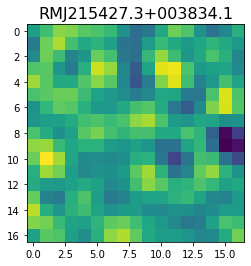

  1%|▏         | 139/10099 [00:08<08:21, 19.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 63.909653   47.38499   -13.325018  -10.642888   89.96239   141.65726
  55.203033  -31.87926    11.697284   79.07907    22.705168  -67.04891
 -12.464331  130.67809   148.65266    12.5405245 -84.39942  ]


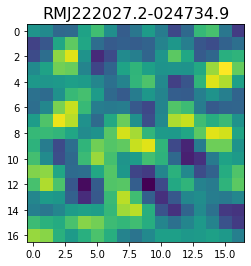

  1%|▏         | 150/10099 [00:09<06:03, 27.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-298.22028  -167.28438   -70.9908   -104.86932  -233.36331  -317.04523
 -270.43668  -172.01282  -161.66249  -231.11389  -225.68222  -105.13504
  -55.293694 -204.89864  -371.26245  -303.4303    -84.7377  ]


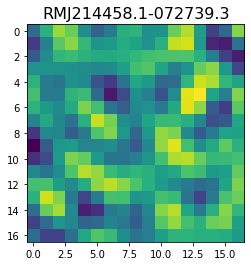

  2%|▏         | 156/10099 [00:09<07:13, 22.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.860096   19.3125     28.461523   10.693317  -24.411499  -34.346092
 -16.369778  -10.4522    -28.59965   -36.842632  -16.81861     3.1589897
  -5.3743496 -29.456572  -37.22409   -19.54396     4.143529 ]


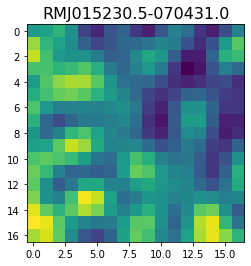

<class 'pixell.enmap.ndmap'>
[ -57.496964   -16.940243    -2.3970037  -49.33006    -84.76182
  -57.84244    -36.641342  -103.39237   -219.7209    -265.47623
 -192.48515    -92.83336    -92.37191   -187.78914   -242.74873
 -178.26892    -93.7384   ]


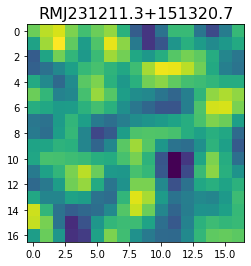

<class 'pixell.enmap.ndmap'>


  2%|▏         | 160/10099 [00:09<10:08, 16.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  23.762356  -15.284161  -79.89277   -74.075005  -31.123158  -54.729958
 -120.2762    -93.52271    38.572853  123.287056   79.05802    15.161839
   35.2904     73.35308    33.392216  -35.65849   -33.56116 ]


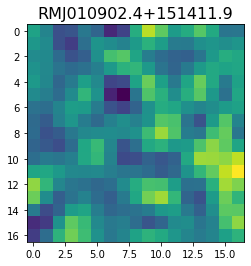

<class 'pixell.enmap.ndmap'>
[ 58.26538  168.4498   208.88664  164.77676  102.74057   75.44836
  77.54397   97.250984 158.5225   275.0769   391.1414   421.44537
 354.3993   270.4389   239.73451  242.9571   224.30269 ]


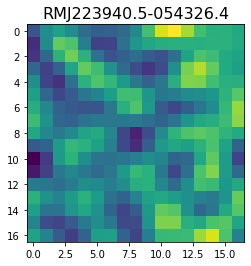

  2%|▏         | 163/10099 [00:10<13:06, 12.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-42.5293    -49.62714   -64.53938   -65.177376  -57.543552  -57.72172
 -59.614513  -41.866253   -5.864969   16.802565    8.528626   -0.7381685
  29.731766   86.58851   106.920555   58.851524  -11.369652 ]


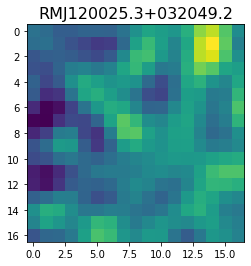

  2%|▏         | 168/10099 [00:10<11:49, 13.99it/s]

<class 'pixell.enmap.ndmap'>
[-34.839787  -35.53815   -21.710295    2.3661697  20.218678   16.829481
   4.1091175   7.257979   25.047077   31.711124   17.903875   -0.965026
 -15.799978  -29.21004   -31.760862  -11.25023    13.62863  ]


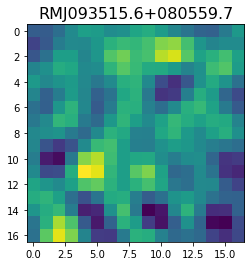

  2%|▏         | 170/10099 [00:10<13:02, 12.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[194.81192   139.41483    58.844387   51.060562   92.2551     82.71602
   7.354135  -41.396698   -6.584422   51.973053   57.02771    30.235138
  46.590317  105.68511   124.364586   64.2125     -2.1183107]


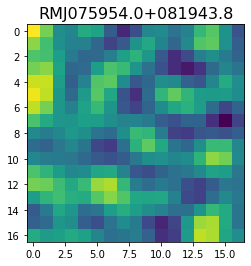

  2%|▏         | 172/10099 [00:11<13:39, 12.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-0.18929046 10.412035   14.6700325  16.276958   13.535173    3.4339783
 -6.933973   -7.314205    0.84780914  7.8157916   9.18266     6.5034633
  0.97645926 -4.120349   -2.4034052   5.538558   10.048556  ]


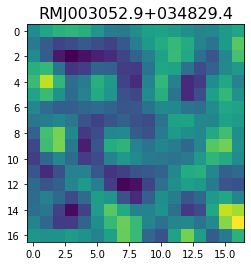

  2%|▏         | 175/10099 [00:11<13:22, 12.36it/s]

<class 'pixell.enmap.ndmap'>
[ -7.239926  -8.409749 -32.379612 -57.673077 -59.579277 -26.690123
  17.80975   25.71513  -14.493789 -47.005764 -21.905043  27.480785
  35.173244   2.127859 -22.25697  -31.686226 -55.860355]


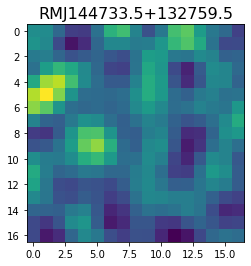

  2%|▏         | 177/10099 [00:11<14:30, 11.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[183.58168 106.24333 148.82661 295.2996  326.75165 182.46559  80.10401
 165.53914 282.13388 242.1296  121.77827 103.22663 180.51598 215.44618
 178.88266 155.29045 172.17479]


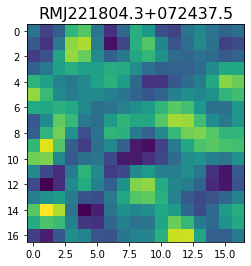

  2%|▏         | 179/10099 [00:11<15:11, 10.88it/s]

<class 'pixell.enmap.ndmap'>
[  61.29841     67.3232     -46.492138  -134.47496    -80.26845
   20.350006     2.8747609 -109.182556  -141.98543    -38.488365
   63.87834     36.909554   -82.768906  -176.93687   -189.0082
 -143.27629    -89.34801  ]


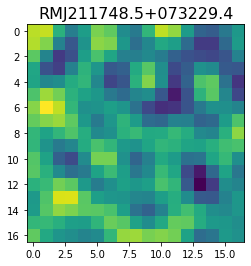

  2%|▏         | 181/10099 [00:11<15:51, 10.42it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -12.949306   -9.526087  -48.117268  -73.189896  -66.84556   -65.620026
  -99.9529   -149.15244  -169.26912  -146.75458  -105.5679    -70.02522
  -44.506016  -31.151295  -40.05638   -67.62095   -87.50736 ]


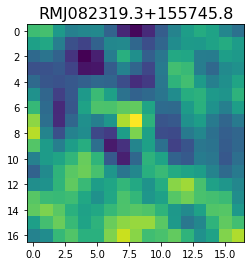

  2%|▏         | 185/10099 [00:12<13:23, 12.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-260.46594  -155.32806   -90.88042  -128.25171  -157.88689  -116.76014
  -93.961334 -161.4133   -242.65936  -231.79985  -149.19939   -99.294846
 -126.01221  -176.26122  -188.77782  -172.51456  -183.09386 ]


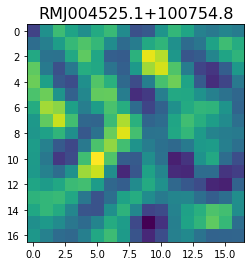

  2%|▏         | 189/10099 [00:12<11:59, 13.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -61.009487   -92.45009    -50.062645    18.530977    39.95995
   11.5408325  -15.99261    -23.405252   -26.917953   -26.194443
  -17.067924   -27.29212    -71.0024    -101.28255    -77.90875
  -41.53392    -45.44702  ]


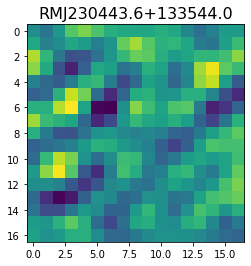

  2%|▏         | 191/10099 [00:12<14:03, 11.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  28.73279   124.5104     64.00126  -121.7018   -196.55043   -58.91689
  113.323235  133.64503    35.673702  -52.5933    -95.227844 -114.33688
 -101.07753   -48.745792   12.501873   62.9498    104.74987 ]


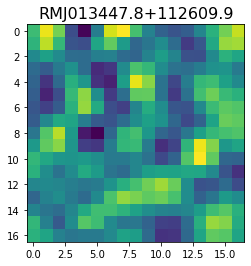

  2%|▏         | 197/10099 [00:12<10:55, 15.10it/s]

<class 'pixell.enmap.ndmap'>
[  -7.6217055   43.478573    50.450264     6.3957934   67.344284
  181.61009    148.41792     29.452604    58.765503   177.46906
  118.18081    -80.91206   -112.641045    61.976776   162.14632
   90.82226     73.75719  ]


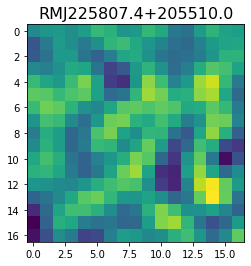

<class 'pixell.enmap.ndmap'>


  2%|▏         | 199/10099 [00:13<12:28, 13.23it/s]

<class 'pixell.enmap.ndmap'>
[-206.83675   -196.7291    -191.89763   -220.32147   -253.33827
 -243.40424   -196.92413   -167.74951   -174.87392   -174.41057
 -137.20103   -102.2004    -105.60604   -107.41471    -57.785156
    5.4924164   10.310305 ]


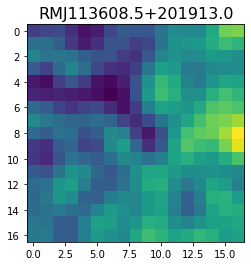

  2%|▏         | 201/10099 [00:13<13:28, 12.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-24.17956  -44.964058 -36.129555  -4.190646   6.329006 -17.186687
 -31.80497   -9.200936  19.678799  20.107403   4.130608  -6.749377
 -19.479162 -37.09663  -38.468567 -22.213758 -20.738194]


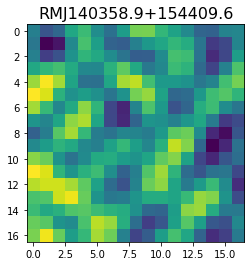

  2%|▏         | 205/10099 [00:13<12:00, 13.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -58.186455  -18.524261  133.43272   210.25261   235.65958   287.44778
  229.04712   -18.317429 -185.40317   -41.517914  197.97925   231.37642
  133.87605   131.07404   219.82207   284.12723   285.92838 ]


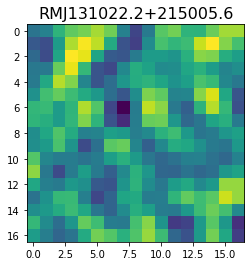

  2%|▏         | 208/10099 [00:13<12:20, 13.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -21.513344   -43.969654   -20.167252    12.525345     4.191963
  -25.619158   -39.86858    -59.80556   -114.40812   -162.41452
 -145.58815    -83.58578    -37.839523   -13.5075655   21.86087
   49.223812    17.62177  ]


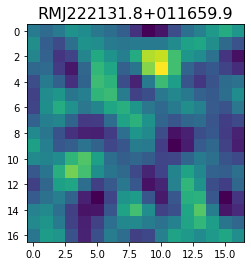

  2%|▏         | 211/10099 [00:14<12:13, 13.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-181.72205  -121.91562   -24.152235 -116.9381   -284.37048  -206.6037
    3.832894  -58.70575  -358.4204   -456.30002  -237.00085   -17.620722
   -4.860075 -112.110016 -215.03323  -242.44283  -159.21841 ]


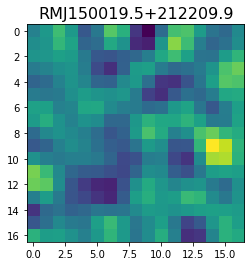

  2%|▏         | 215/10099 [00:14<12:08, 13.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.98742   89.33914  116.70641  109.404526  78.58653   40.744514
  21.954865  39.3333    68.37108   86.89784  118.214905 156.7861
 127.94975   21.905382 -37.089718  23.386513  91.88403 ]


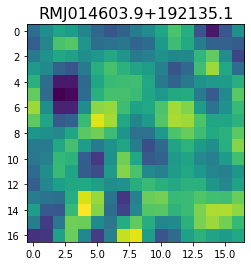

  2%|▏         | 222/10099 [00:14<09:51, 16.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.292988  -16.476862   71.052956  111.08222    80.51092    48.620552
  32.04246     1.1464063  -6.197935   59.19432   122.27541    72.59094
 -41.206467  -70.05209    10.852933   92.73784   118.21047  ]


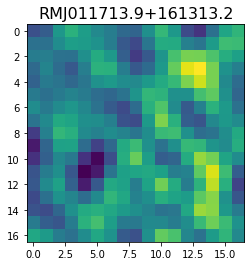

  2%|▏         | 225/10099 [00:14<10:44, 15.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-248.84961  -257.8763   -296.74683  -356.6398   -389.50558  -414.29288
 -432.0404   -379.84225  -281.11453  -247.8051   -254.30759  -153.8685
   22.143957   64.96243   -62.450077 -170.12889  -169.2703  ]


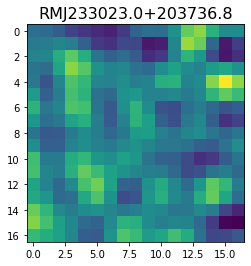

  2%|▏         | 228/10099 [00:15<11:12, 14.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -50.232952   -55.746788   -31.844934    -2.9371755  -55.273155
 -148.35852   -146.48914    -54.03054    -17.860214   -83.00276
 -139.97531   -123.280945   -84.961685   -68.84205    -62.854836
  -68.91676   -101.5769   ]


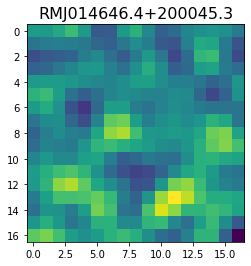

  2%|▏         | 232/10099 [00:15<10:42, 15.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-28.165792     0.13672781  34.42389     -1.5084792  -71.900154
 -69.93408     12.680035    60.646416     8.297686   -63.743435
 -64.927895   -33.863537   -50.367348   -85.78821    -59.92814
   1.578581     1.8125157 ]


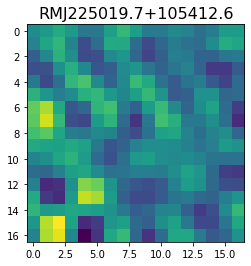

  2%|▏         | 234/10099 [00:15<11:58, 13.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-285.67325  -319.19217  -150.77054  -179.85214  -420.69565  -354.2831
   81.28613   265.6372    -24.003553 -206.13707    63.379784  321.75095
  191.86092    42.74559   233.57469   365.5439    -59.756992]


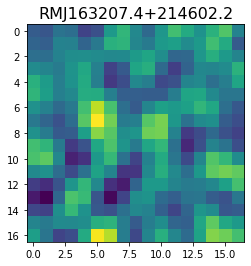

  2%|▏         | 237/10099 [00:15<12:08, 13.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.073715    46.8027      34.6783      36.342648    59.25685
  60.32038     21.07289     -0.31555992  48.13023    120.426025
 130.41927     73.06599     22.11111     22.330238    46.33839
  56.2349      54.02443   ]


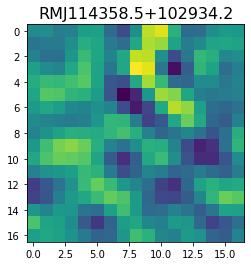

  2%|▏         | 239/10099 [00:16<14:58, 10.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   4.0222416  -88.37338     -7.7685504   41.946777   -20.41008
  -69.222626   -47.194317   -22.780708   -24.406542   -19.41778
   18.753666   104.206314   183.91609    126.95598    -61.017776
 -151.61134    -36.3397   ]


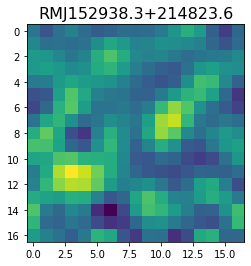

  2%|▏         | 246/10099 [00:16<10:57, 14.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[100.31582  100.947914 104.58989  116.09825  120.511894  90.4342
  50.546715  66.881714 129.97493  145.77147   93.25917   68.276306
 110.88418  133.34338   90.94467   68.37658  113.53483 ]


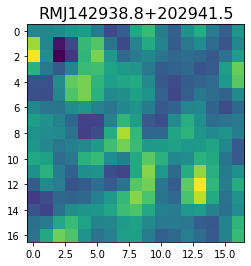

  2%|▏         | 248/10099 [00:16<12:34, 13.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  1.6143613 -24.112722  -10.794542   26.2202     45.371677   32.079113
  10.05175     2.6715019   7.2625837  13.695404   23.095255   34.298336
  35.413383   26.169022   25.271708   36.706993   35.583595 ]


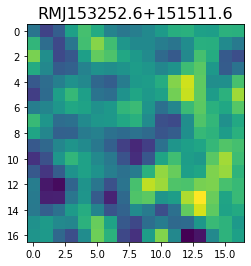

  3%|▎         | 253/10099 [00:16<11:10, 14.69it/s]

<class 'pixell.enmap.ndmap'>
[-268.19635  -226.01282  -125.37193  -111.345314 -135.78204  -116.58597
 -110.96901  -159.18661  -168.02225   -97.90305   -69.19899  -157.8444
 -256.8553   -239.75987  -127.21246   -27.867117  -10.609556]


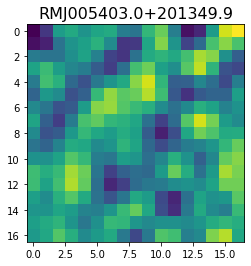

  3%|▎         | 255/10099 [00:17<12:19, 13.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.819874  -17.070745   41.81446   135.49545   132.15123    31.012524
 -12.289415   92.77889   223.96199   205.28448    50.672997  -59.700012
 -26.75708    56.546223   65.3252     13.353422   -1.0148985]


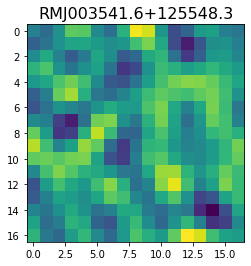

  3%|▎         | 257/10099 [00:17<13:29, 12.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-3.81180763e+01 -1.03058939e+01 -3.79853210e+01 -1.02292542e+02
 -1.23330482e+02 -8.31153183e+01 -6.10870285e+01 -1.09083504e+02
 -1.56392273e+02 -1.08778923e+02  1.49829373e-01  4.14675217e+01
 -3.75070457e+01 -1.53415558e+02 -2.03330688e+02 -1.70548630e+02
 -1.00925735e+02]


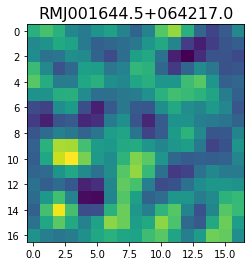

  3%|▎         | 260/10099 [00:17<13:23, 12.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 22.223095  -22.822765  -48.711227  -16.175953   30.027246   30.962807
  -6.2020063 -31.2701    -20.168184    9.44289    29.449339   25.811543
   6.30963    -5.5485253   3.0688417  15.848151   12.655526 ]


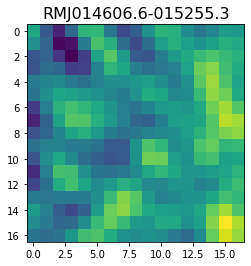

  3%|▎         | 269/10099 [00:18<08:32, 19.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -79.64762    -82.31754   -105.75654   -113.11804    -79.51151
  -38.630474   -45.601604   -94.21606   -107.68856    -48.322693
    3.5984101  -45.35245   -148.79137   -178.80557   -124.44189
  -98.607895  -132.9952   ]


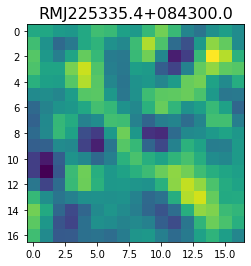

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[112.29533   49.953224 -16.599218  -5.617107  58.152393  86.00334
  50.763832   9.766443  14.928562  51.206047  72.08533   63.579838
  52.53302   60.87424   74.82605   70.14813   49.49196 ]


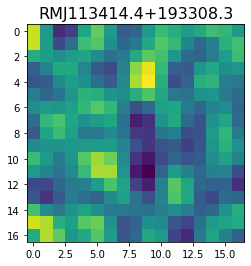

  3%|▎         | 272/10099 [00:18<12:25, 13.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  10.193069  -21.972973  -74.82819  -113.11678  -131.52455  -128.01584
  -90.69076   -41.532898  -44.7152   -119.037766 -183.79987  -161.20004
 -100.332855 -111.76852  -193.36     -224.06664  -146.46259 ]


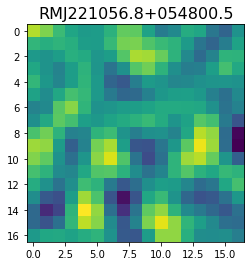

  3%|▎         | 275/10099 [00:18<12:57, 12.64it/s]

<class 'pixell.enmap.ndmap'>
[ 57.04519    81.521904   56.945972  -20.057133  -40.331783   49.030003
 136.98962   117.03831    49.580578   35.437344   41.247875   -6.8756313
 -55.21402    -6.044151  101.11343   142.98749    99.1399   ]


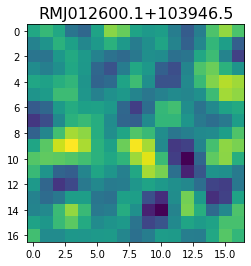

  3%|▎         | 277/10099 [00:18<14:04, 11.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -17.150578   -29.197739   -74.11983    -88.790405   -49.317646
  -14.804181   -34.50049    -75.12253    -87.99117    -89.41351
 -112.540276  -128.48344    -90.10095    -24.6247      -5.6632533
  -43.89175    -76.58845  ]


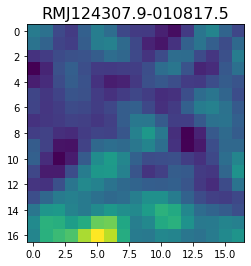

  3%|▎         | 283/10099 [00:19<11:09, 14.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -75.65008    -17.89767    -19.257048    -4.8745427   20.73876
  -36.82433   -169.97891   -218.16226    -94.55267     64.90891
   85.396675   -17.308039  -103.32073   -119.3619    -121.988976
 -146.02264   -164.73643  ]


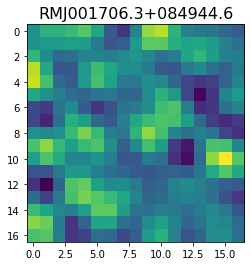

  3%|▎         | 287/10099 [00:19<10:52, 15.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 34.9861    64.265686  75.91463   67.30195   57.54296   62.86104
  75.665726  76.37376   62.99145   55.02022   63.052555  70.5027
  60.65339   48.986282  63.92584   99.4192   115.56808 ]


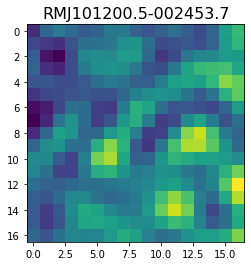

  3%|▎         | 292/10099 [00:19<10:50, 15.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  24.108948    -5.8107905  -34.142403   -80.16182   -123.5096
 -108.85369    -58.924435   -64.99436   -135.35732   -174.39583
 -142.77777   -109.38942   -109.88314    -91.3993     -43.76394
  -44.862354  -112.5155   ]


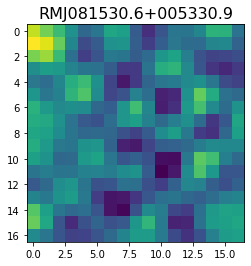

  3%|▎         | 294/10099 [00:20<12:09, 13.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[157.86115  174.22182  199.06213  201.72214  177.11688  150.05927
 129.49445  102.22939   74.09467   72.612854 102.85402  138.72868
 160.599    167.25568  154.81555  121.85156   92.547005]


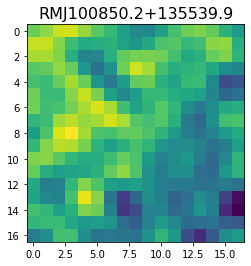

  3%|▎         | 300/10099 [00:20<10:18, 15.84it/s]

<class 'pixell.enmap.ndmap'>
[ -1.3633403 -49.26914   -56.36111   -20.131683  -19.679762  -33.581493
   8.843041   66.88244    62.899757   18.547628  -15.79057   -37.568344
 -23.112463   54.26084   115.6819     74.00209     6.5749464]


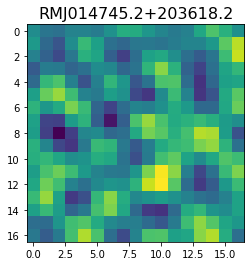

  3%|▎         | 302/10099 [00:20<11:26, 14.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-135.32294   -76.173645  -54.564014  -92.30798  -120.425255  -96.07322
  -58.853848  -58.96261   -92.56922  -121.99036  -120.3379    -92.347496
  -73.21324   -94.35435  -136.54883  -146.18993  -111.19331 ]


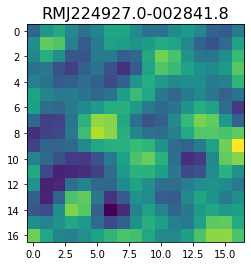

  3%|▎         | 304/10099 [00:20<12:50, 12.72it/s]

<class 'pixell.enmap.ndmap'>
[ 65.450554  57.2037    74.91465  109.70709  133.76714  136.38701
 123.84558  100.31349   84.45773  106.16149  146.97296  144.48445
  97.759476  84.29991  126.35657  146.04674  107.05962 ]


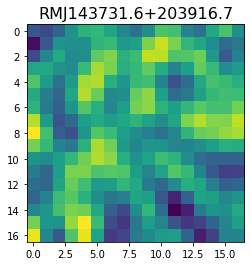

  3%|▎         | 306/10099 [00:21<14:14, 11.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 31.521374   44.258152   36.308037   14.728207   13.377779   33.10399
  41.205536   27.65122    17.336473   23.182196   27.421585   18.080496
   9.324234   12.4921255  14.106826   -0.6957242 -19.917744 ]


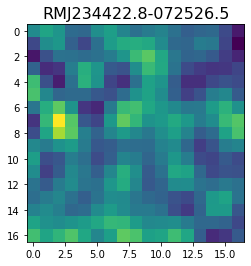

  3%|▎         | 315/10099 [00:21<08:19, 19.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -69.13653   -41.780106 -141.11876  -238.67323  -182.04095   -26.623055
   56.460766   51.08843    87.193474  170.36383   134.90646   -62.153114
 -192.13126   -47.11764   239.13716   342.92358   177.5115  ]


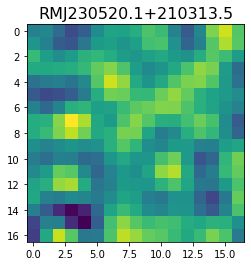

  3%|▎         | 321/10099 [00:21<08:00, 20.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -90.24187  -67.8564  -109.92046 -171.4644  -181.25374 -141.24565
 -117.20393 -138.398   -163.08582 -153.59706 -129.61972 -122.09669
 -124.04167 -120.0695  -120.67187 -128.90831 -114.18761]


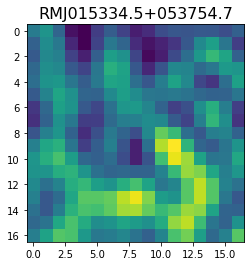

  3%|▎         | 324/10099 [00:21<09:25, 17.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-27.380516  -96.52806   -88.84893   -11.402652   67.5292     88.48288
  47.75268     2.4011095  11.529592   55.698975   56.86425    -0.5054217
 -33.940857   11.005807   72.23508    69.412186   22.373848 ]


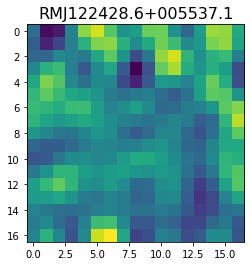

  3%|▎         | 336/10099 [00:22<06:36, 24.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[75.35731  57.23705  50.719444 66.390495 87.36956  90.71166  72.35461
 50.35734  44.04624  50.797283 51.315117 41.28529  42.093662 66.422935
 89.86557  81.07521  50.029545]


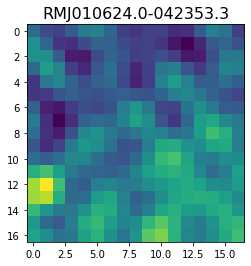

<class 'pixell.enmap.ndmap'>
[ -24.023838    -3.0948637  -79.9058    -188.8213    -182.61629
  -84.0417     -31.9975     -44.76453    -52.637444   -67.08354
 -112.48004   -113.98287    -40.122086    -9.112969   -89.69473
 -165.96065   -139.08414  ]


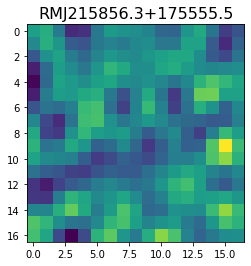

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -63.078266 -105.4746   -144.58751  -140.65149  -106.61578   -89.25707
  -94.058495  -89.14387   -74.4305    -79.90299   -98.39984   -90.9538
  -63.45755   -66.17462  -104.98937  -123.31187   -93.0087  ]


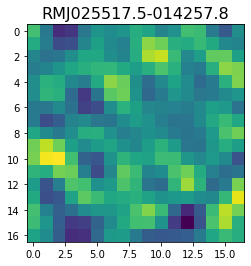

  3%|▎         | 340/10099 [00:23<12:16, 13.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[126.585     41.31321   32.650597 100.458374 151.1077   126.27553
  87.14558  109.133766 157.44762  161.45055  144.79877  160.71466
 165.72714  101.92616   41.8411    88.36189  180.9487  ]


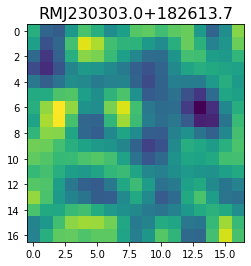

  3%|▎         | 344/10099 [00:23<12:01, 13.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-397.43784  -134.1228    188.02553   126.992874 -148.46233  -300.17322
 -346.96375  -311.06924   -39.29448   280.61157   220.365     -70.77007
  -27.363827  304.3298    353.3547     72.311615  -66.65764 ]


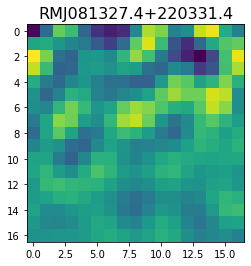

  3%|▎         | 348/10099 [00:23<12:13, 13.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-37.855328  -14.28455     1.8127954 -16.43021   -47.007343  -31.33107
  31.380472   64.317635   19.09672   -57.92476   -97.681465  -87.84838
 -49.74962     1.1592501  36.652885   19.626724  -33.72358  ]


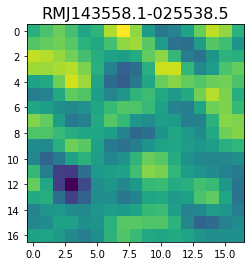

  3%|▎         | 351/10099 [00:23<12:38, 12.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-190.26965   -191.82603   -157.25853   -141.3175     -67.22987
   94.39552    204.08548    148.79535     -7.0742574 -156.93053
 -255.73521   -245.14088    -87.70978     98.92271    146.65646
   64.434784   -22.106337 ]


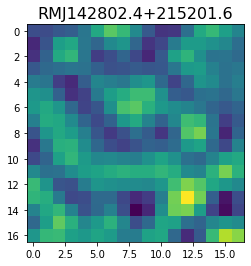

  4%|▎         | 360/10099 [00:24<08:50, 18.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 21.247234    1.3841424 -17.15617   -17.412962  -34.939514  -71.07387
 -59.81221     9.197709   46.84872    13.552101  -14.423775    6.8841105
  15.686006  -16.53818   -21.897474   24.03207    46.642147 ]


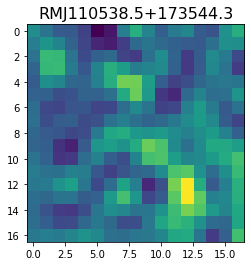

  4%|▎         | 363/10099 [00:24<09:49, 16.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -2.5939405    8.758132    73.445656    62.93282    -66.12695
 -187.9919    -213.60815   -217.46788   -259.24457   -254.14566
 -150.13103    -64.54571    -97.42866   -163.11354   -153.2943
 -119.15634   -144.01132  ]


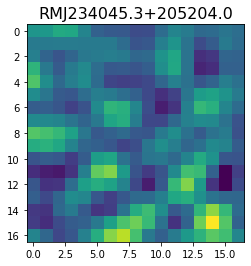

  4%|▎         | 366/10099 [00:24<10:25, 15.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-114.658485 -113.1643   -131.54358  -125.95277  -102.2665    -99.67935
 -124.30009  -146.80006  -148.26851  -134.27704  -119.15015  -117.624374
 -132.58566  -140.34732  -117.008835  -84.60803   -90.45541 ]


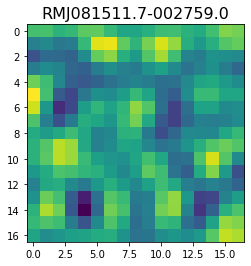

  4%|▎         | 368/10099 [00:24<11:48, 13.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -15.113015  -31.11104   -94.782005 -156.6941   -147.35406   -97.964554
 -110.58679  -187.28636  -205.05841  -110.866066  -26.60822   -77.49172
 -208.78247  -272.2397   -229.92444  -171.87102  -171.28815 ]


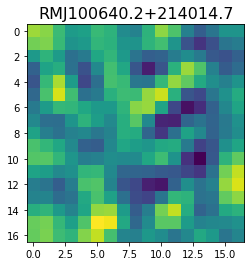

  4%|▎         | 370/10099 [00:25<13:02, 12.43it/s]

<class 'pixell.enmap.ndmap'>
[  48.503933   -40.96051     -5.985058     3.29075   -151.68404
 -240.37463    -85.01592     66.78824     -0.9683028  -94.16937
  -34.276382    18.718065   -55.04808   -115.518074  -103.06066
 -133.44452   -182.48767  ]


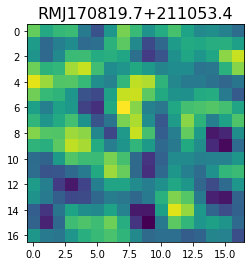

  4%|▎         | 372/10099 [00:25<14:07, 11.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  35.31966    -28.937761  -115.0271      14.871059   167.97656
   71.403656   -30.407902   163.50397    358.16867    208.73181
    6.2628145   95.86631    224.85745    117.233574    18.821297
  110.29484    120.4017   ]


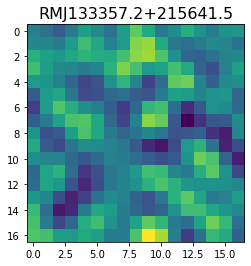

  4%|▎         | 374/10099 [00:25<14:59, 10.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -52.55345     22.1308      35.989014    17.439669    41.818527
   51.538593   -30.701511  -101.32761    -17.792454   117.58148
   81.745865   -87.915695  -132.41888     -6.4454994   42.255207
  -93.451454  -192.42621  ]


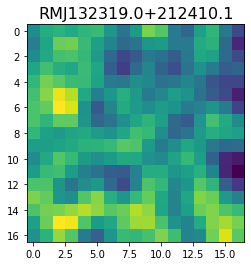

  4%|▎         | 376/10099 [00:25<16:21,  9.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[115.47921    150.59009    149.33759     94.52078     65.283455
 100.231476   117.716       60.272915    15.825003    72.74306
 149.05704    118.33249     27.673512    16.598185    75.74687
  74.87489      0.28720286]


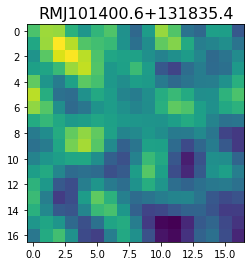

  4%|▎         | 378/10099 [00:26<18:28,  8.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-183.61838  -157.90796  -124.33033   -99.95779   -69.292625  -19.094664
   20.236261    2.74939   -66.453316 -125.10365  -128.29582  -103.76498
 -105.65861  -131.00922  -125.58394   -72.914665  -25.865881]


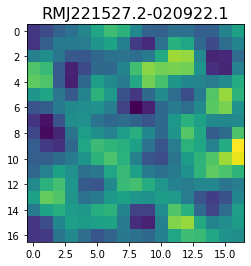

  4%|▍         | 389/10099 [00:26<08:53, 18.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 39.15466    32.27846    -8.816166  -28.866808  -11.300534    3.361035
  -2.4561708   1.3691105  25.328043   37.653454   26.765003   23.169374
  37.949608   38.651955    9.564282  -14.786239   -1.4329433]


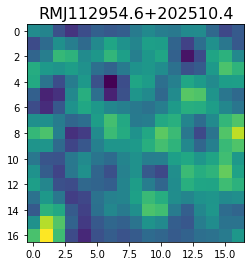

  4%|▍         | 392/10099 [00:26<10:17, 15.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-183.65875 -219.61375 -240.3654  -235.16464 -225.74138 -224.96736
 -220.11147 -203.06679 -190.70763 -203.02138 -235.74117 -263.5791
 -264.00845 -236.67024 -204.64139 -193.18971 -202.52869]


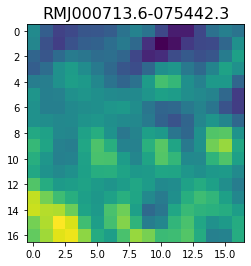

  4%|▍         | 398/10099 [00:27<09:13, 17.52it/s]

<class 'pixell.enmap.ndmap'>
[ 54.929123  73.54103   53.342896  29.730885  36.196968  59.718914
  75.08673   78.07118   74.58111   71.6482    78.784035  93.02787
  96.35176   88.05781   93.80809  123.34128  151.82582 ]


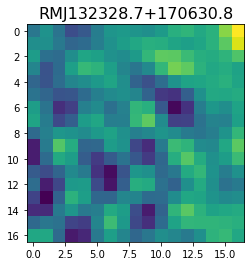

<class 'pixell.enmap.ndmap'>
[ -44.958714  -26.06893   -26.613708  -18.0428    -10.647182  -23.702068
  -48.979534  -64.74114   -59.455837  -35.765785  -15.23243   -30.966745
  -84.79814  -125.959625 -108.86014   -56.303837  -25.980743]


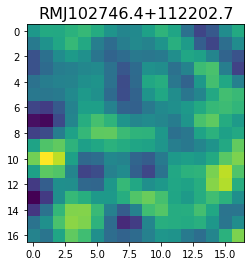

<class 'pixell.enmap.ndmap'>
[ -96.66614  -107.07344   -61.889034  -46.50926   -82.20848  -103.20019
  -71.73554   -30.234707  -19.631939  -24.825241  -31.91821   -65.62413
 -128.53427  -169.40344  -159.20435  -140.24602  -150.59212 ]


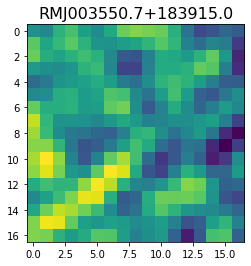

  4%|▍         | 401/10099 [00:27<15:59, 10.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[109.234764 132.75743  160.18576  165.78265  114.109116  51.300003
  47.590572  83.92356   95.41922   87.30395  106.54576  138.73653
 134.55994  103.43493   89.82297   94.27423   97.77117 ]


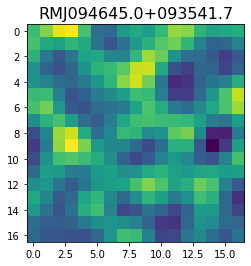

  4%|▍         | 403/10099 [00:28<16:28,  9.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[99.216515  88.108086  62.373665  34.322002  16.914093  18.33603
 30.795895  38.508907  41.980965  54.681923  69.729996  58.950314
 20.913471  -1.4388322 21.401743  56.44231   51.9424   ]


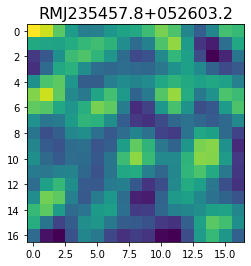

  4%|▍         | 405/10099 [00:28<16:44,  9.65it/s]

<class 'pixell.enmap.ndmap'>
[-315.43454 -507.79318 -431.83176 -245.7942  -226.27304 -365.1857
 -431.46408 -346.8968  -274.86172 -334.12537 -426.5709  -417.50668
 -332.325   -271.56232 -243.44284 -204.93384 -193.3486 ]


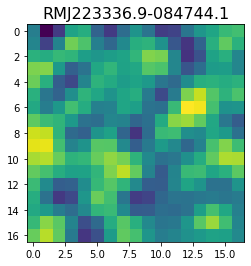

<class 'pixell.enmap.ndmap'>
[107.68664   -15.634138  -43.87754    52.130505  118.86967    69.72064
  -3.008387    5.6107507  67.07937    92.87884    64.81444    34.487617
  44.296143   95.73231   163.82558   204.0248    170.53265  ]


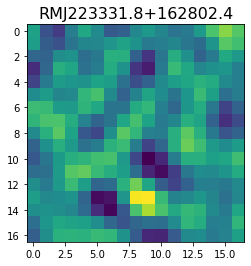

  4%|▍         | 407/10099 [00:28<20:34,  7.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 21.279743    -6.240994    35.66004     64.99371     28.025434
 -12.996004    17.592205    88.64805    106.52012     47.472633
 -12.474733    -0.93341595  59.302876    86.617165    50.09667
   4.342804     6.661165  ]


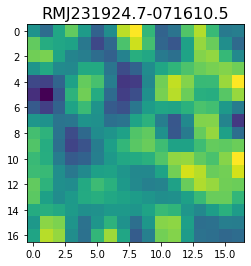

  4%|▍         | 410/10099 [00:28<18:04,  8.93it/s]

<class 'pixell.enmap.ndmap'>
[56.463467 62.299816 71.02459  78.27841  76.01286  60.0787   43.078407
 40.205967 44.483784 37.67695  22.449142 17.985611 25.660763 28.184978
 23.60486  28.98875  45.740067]


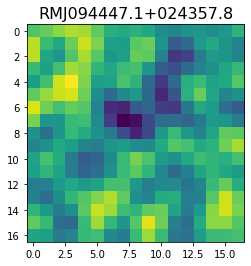

  4%|▍         | 418/10099 [00:29<10:27, 15.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


  4%|▍         | 426/10099 [00:29<06:26, 25.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 87.10426   78.81673   75.2106    78.37871   84.98717   96.54351
 117.10326  136.17403  129.07674   88.1455    44.14354   37.979374
  72.540054 110.567955 123.068306 120.35534  125.48387 ]


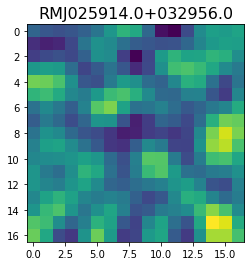

  4%|▍         | 430/10099 [00:29<07:25, 21.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 213.81815   -49.116264 -102.723175   94.15505   193.69469    74.81718
   45.130955  251.38039   381.8265    223.96564    45.27983    94.08201
  173.07396    51.75155  -100.041824  -32.573933  168.48096 ]


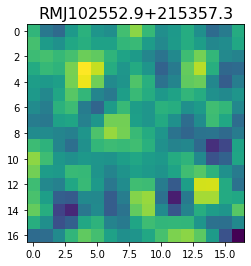

  4%|▍         | 434/10099 [00:29<08:39, 18.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -5.966785  -26.669916  -18.91832    -0.6542721 -15.510749  -61.31029
 -92.66244   -84.90082   -60.110596  -48.588394  -50.963524  -47.223824
 -28.124533   -5.8849964   4.0007105   3.5849357   8.200667 ]


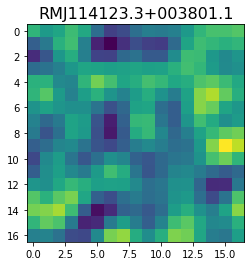

  4%|▍         | 444/10099 [00:30<06:55, 23.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -76.34946   -84.62458  -121.85747  -150.50334  -143.00691  -117.57105
 -109.08677  -120.7983   -128.95999  -124.02317  -119.421555 -123.76769
 -130.29512  -133.45023  -133.22314  -123.51059   -98.61486 ]


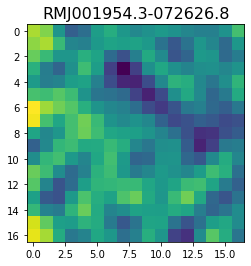

  4%|▍         | 448/10099 [00:30<07:43, 20.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-19.309368  -3.388986 -23.689386 -50.40126  -54.39042  -45.266537
 -45.090126 -50.575962 -46.6606   -38.719933 -41.929836 -49.6747
 -42.847904 -26.001825 -23.683905 -38.937073 -45.430367]


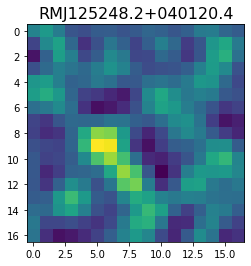

  4%|▍         | 451/10099 [00:30<08:45, 18.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 50.99915    -1.9021801  -9.9120655  19.044584    9.757335  -47.569946
 -81.479836  -50.369328    8.041493   43.18741    47.470833   36.51972
  20.331947    8.687519   13.977168   31.190704   31.851885 ]


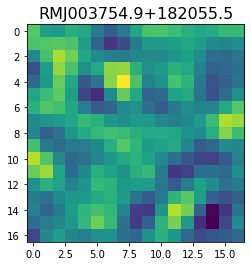

  4%|▍         | 454/10099 [00:31<10:24, 15.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-177.24704 -167.66281 -205.34598 -225.61029 -191.74146 -150.2869
 -151.02429 -179.97548 -195.38097 -182.26279 -156.86858 -148.56882
 -176.98871 -224.37173 -244.84743 -220.29897 -183.98485]


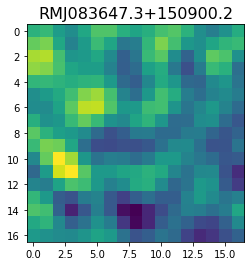

  5%|▍         | 468/10099 [00:31<06:08, 26.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -46.7996     -54.25243    -94.535934  -101.49671    -55.959393
  -27.025017   -52.500057   -78.83668    -66.05577    -50.41235
  -56.005676   -46.013718   -10.253333    -4.0435944  -51.26675
  -95.41847    -89.6767   ]


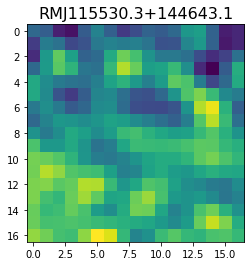

  5%|▍         | 479/10099 [00:31<05:19, 30.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  10.897634    95.60453     42.838387   -56.179882   -71.937546
  -42.35707    -53.296658   -74.49036    -60.277397   -60.451218
  -96.8532     -84.838       -4.0442767   16.164492   -87.38781
 -174.29427   -116.44993  ]


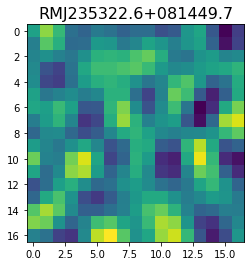

<class 'pixell.enmap.ndmap'>
[-67.89039     4.4917555   3.0182343 -45.492073  -66.82282   -47.939735
 -39.96004   -65.40889   -83.93853   -60.272316  -17.377472    0.7784243
 -11.944476  -26.9933    -24.76038   -10.789296    4.844327 ]


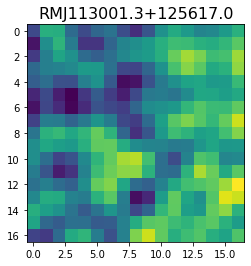

  5%|▍         | 484/10099 [00:32<07:55, 20.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -4.005634  -37.160515  -97.69177  -121.608444  -87.69706   -62.342205
  -86.52837   -94.02553   -23.511087   55.270596   32.73399   -65.88645
 -112.26837   -66.258125  -20.961538  -45.741405  -89.837776]


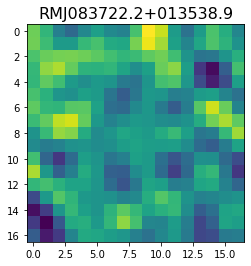

  5%|▍         | 488/10099 [00:32<08:25, 19.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.530285  34.831207  54.211754  64.4972    50.54547    4.983114
 -42.674046 -39.35379   21.435863  80.17078   92.690346  87.2691
 105.56058  134.51758  138.39214  115.333855  83.75728 ]


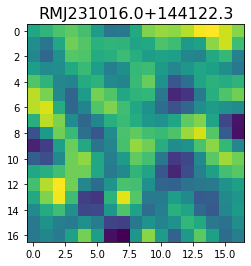

<class 'pixell.enmap.ndmap'>
[ 1.5532291e+01 -7.2564863e-02 -9.6346884e+00  7.7845325e+00
  3.3259342e+01  3.3271984e+01  1.7310642e+01  2.8438805e+01
  6.8752678e+01  8.5090591e+01  5.0124290e+01  7.1560602e+00
  4.2836432e+00  3.0451136e+01  5.0532413e+01  6.0671364e+01
  7.1576477e+01]


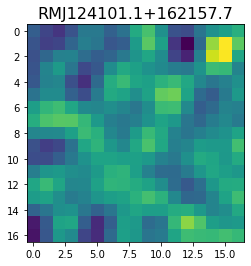

  5%|▍         | 491/10099 [00:32<11:16, 14.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 54.036602  41.19265   46.125824  71.46569   84.18378   73.40771
  52.759098  30.615744  24.72437   62.692043 120.803246 124.33531
  63.224384  29.719809  74.055595 112.15209   64.06517 ]


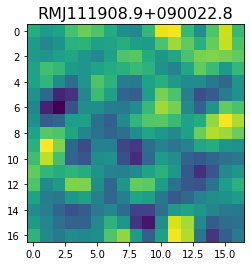

  5%|▍         | 494/10099 [00:33<11:29, 13.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-12.122309   53.05944    32.681316  -59.820953  -86.26997     2.3965533
  83.38287    46.30137   -51.401485  -81.70651   -23.684021   30.885452
  19.199736  -15.018643   -4.8272777  27.721807    7.0624914]


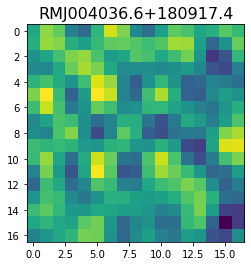

  5%|▍         | 496/10099 [00:33<12:27, 12.85it/s]

<class 'pixell.enmap.ndmap'>
[192.54506  188.41116  165.84933  140.37683  113.83425   92.89589
  89.69723   89.17719   63.654972  34.76238   59.55497  131.32835
 165.59811  124.236496  81.354935 110.38193  171.05867 ]


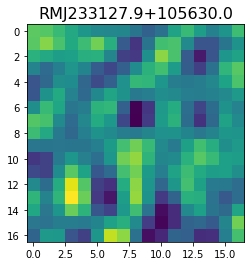

  5%|▍         | 498/10099 [00:33<13:21, 11.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  5.558256  49.635544  19.343294 -47.576897 -67.95494  -22.397223
  28.63724   35.50553   19.356075  23.016855  41.4933    39.448994
  17.611164  15.578776  46.55654   70.9246    52.973488]


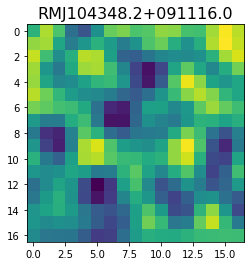

  5%|▍         | 500/10099 [00:33<14:20, 11.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-19.994848  -30.785452  -65.43332   -92.2156    -81.4637    -48.745705
 -34.13545   -44.307125  -47.61812   -30.046568  -19.123457  -33.462826
 -43.158974  -15.810236   22.838667   21.627586  -13.9955635]


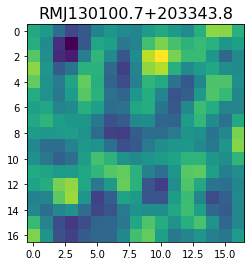

  5%|▍         | 502/10099 [00:34<15:07, 10.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -27.10727   -54.467793 -111.10163  -110.201485  -29.926111   19.369558
  -62.178947 -206.66928  -254.86331  -164.57817   -51.575706  -27.743925
  -84.1335   -144.97054  -160.90865  -125.722946  -61.728027]


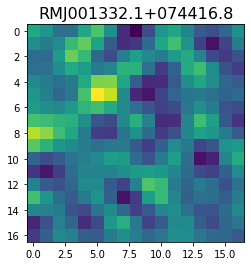

<class 'pixell.enmap.ndmap'>
[ 57.6028   104.400055 100.043625  52.98674   18.903086  -5.760237
 -38.82157  -36.690838  19.844828  56.469448  29.382254   9.878842
  50.63256   90.95126   77.0485    46.841415  32.00449 ]


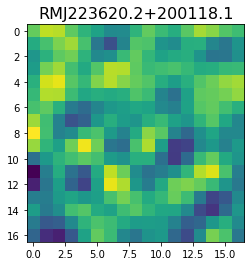

  5%|▍         | 504/10099 [00:34<20:58,  7.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 87.4671   116.18296  119.26523   88.1299    61.103836  69.244995
  94.90113  103.487755  95.69577  100.660255 126.174355 145.47406
 137.75687  117.62407  111.67822  122.107796 130.05121 ]


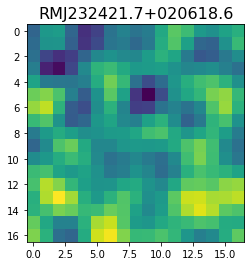

  5%|▌         | 507/10099 [00:34<17:56,  8.91it/s]

<class 'pixell.enmap.ndmap'>
[   6.872671  125.200584   64.84299  -105.23486  -180.90018   -82.78166
   56.313087   75.21931   -28.174063 -130.70601  -146.0328   -100.014145
  -67.30208   -79.612564 -106.31952  -106.756744  -82.92593 ]


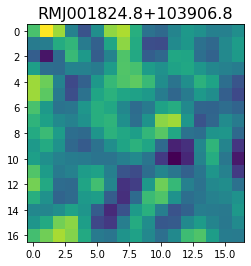

  5%|▌         | 509/10099 [00:34<17:52,  8.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.404606  31.330856  58.93667   76.53649   29.669472 -36.38695
 -39.043316  10.806916  28.485731  -8.875385 -36.88717  -18.344183
   3.499246 -11.950193 -40.86106  -47.486134 -36.838707]


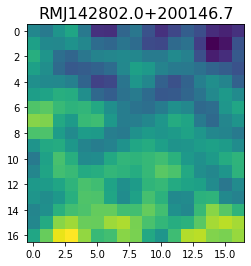

  5%|▌         | 513/10099 [00:35<14:14, 11.22it/s]

<class 'pixell.enmap.ndmap'>
[ 25.378477  11.204545 -27.215733 -26.18401   26.553434  55.956635
  30.865213  16.261381  44.117065  54.62472   22.636486  16.500313
  66.31806   96.620186  60.052948  20.568806  32.153828]


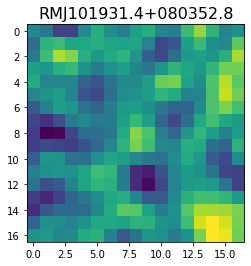

  5%|▌         | 515/10099 [00:35<14:53, 10.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-164.19357  -162.78395  -120.43314  -130.55403  -164.86583  -153.7259
 -117.516655  -64.79502    44.3518    128.24286    41.44571  -139.08015
 -197.78789  -151.13562  -174.27345  -228.87608  -163.14873 ]


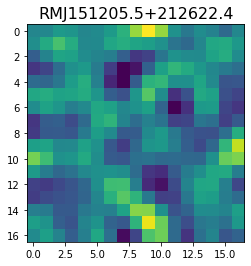

  5%|▌         | 517/10099 [00:35<15:25, 10.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


  5%|▌         | 524/10099 [00:35<08:11, 19.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -29.638668   61.79309    58.38893   -12.458182   -2.430502  103.33231
  133.49573   -13.074171 -197.52347  -215.85744   -57.16218    98.966805
   99.877625  -30.299711 -141.93192  -122.83521    -8.894661]


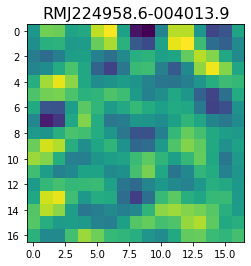

  5%|▌         | 529/10099 [00:36<08:24, 18.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 61.490982  41.619205 -15.943419  16.166298 131.48956  191.88094
 140.95593   70.40819   63.41072   99.813324 137.18314  172.09265
 190.99959  158.39171   91.15777   63.80871   99.35371 ]


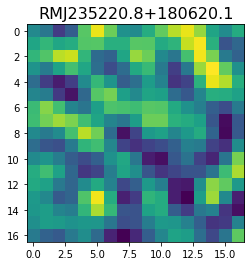

  5%|▌         | 535/10099 [00:36<08:40, 18.36it/s]

<class 'pixell.enmap.ndmap'>
[136.04445  142.41377  129.2707   139.7174   194.50647  232.9104
 191.60455  111.78856   91.58418  144.36288  182.3397   146.30763
  79.33947   50.880188  68.41939   96.53722  118.431435]


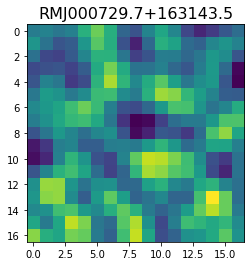

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-63.700596  -43.003967  -10.112765   14.898306    1.5559628 -48.832928
 -81.41637   -53.958344   -5.784102   -2.4815235 -32.829166  -34.637066
  -6.5483665  -5.4463735 -35.766365  -36.005234   11.601493 ]


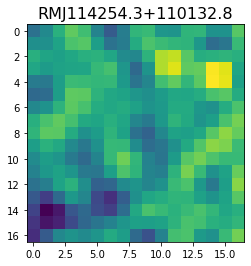

  5%|▌         | 538/10099 [00:36<11:55, 13.36it/s]

<class 'pixell.enmap.ndmap'>
[  1.4004694   24.987616    -6.5060143  -22.905415    50.93048
 152.75536    154.83049     50.635567   -37.679733   -34.253563
  12.792194    38.359745    41.15017     32.033665     0.21303727
 -30.149546     0.8361778 ]


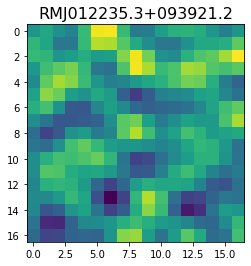

<class 'pixell.enmap.ndmap'>
[ -87.77244    -74.163284   -87.988976  -105.961205   -92.97177
  -58.844128   -37.756065   -26.027885     2.0544336   25.914532
   -7.569055   -94.32161   -156.23318   -133.89893    -53.53037
   16.936958    44.419735 ]


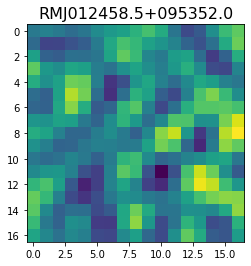

  5%|▌         | 540/10099 [00:37<17:09,  9.28it/s]

<class 'pixell.enmap.ndmap'>
[-39.49265  -47.079494 -38.207363 -20.304266 -11.304517 -23.206974
 -47.391144 -59.75026  -46.21847  -21.451336 -13.219869 -28.409138
 -48.075943 -58.4788   -66.57325  -75.943756 -72.90382 ]


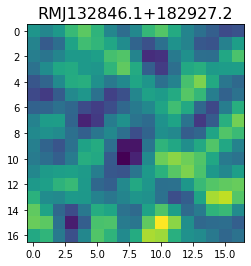

  5%|▌         | 542/10099 [00:37<17:36,  9.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 17.452173   19.603085   -6.383566  -28.730146  -17.112623    9.529111
   6.728397  -28.218199  -48.547245  -27.823185   -1.8886603 -15.380906
 -53.417706  -64.25543   -37.617996  -18.270542  -37.817467 ]


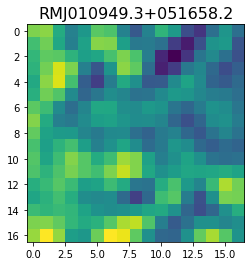

  5%|▌         | 544/10099 [00:37<18:54,  8.42it/s]

<class 'pixell.enmap.ndmap'>
[ -72.91025   -107.58646   -115.78548    -67.435005     7.345278
   25.979918    -7.6712184   15.899654   135.32611    237.24744
  224.96388    158.82307    140.36244    154.4903     129.71497
   80.03594     77.34965  ]


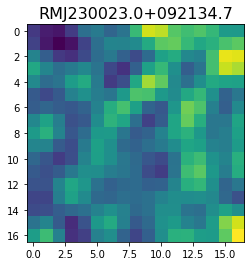

  5%|▌         | 546/10099 [00:38<21:10,  7.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 33.487583    9.100968   95.25429   200.6133    215.89139   163.3222
 116.439514   76.06126    24.205008    5.7808104  56.98873   122.86204
 129.88812    91.10474    75.9503    109.85729   151.07253  ]


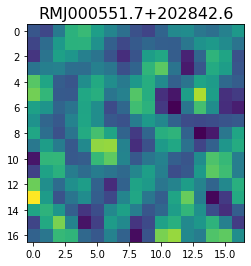

  5%|▌         | 547/10099 [00:38<23:19,  6.83it/s]

<class 'pixell.enmap.ndmap'>
[-106.27303   -78.888275  -48.09467   -47.703873  -60.507626  -59.10009
  -54.34823   -66.57501   -81.80292   -75.932     -57.4885    -49.845936
  -51.397877  -46.39728   -36.69572   -32.41514   -28.825644]


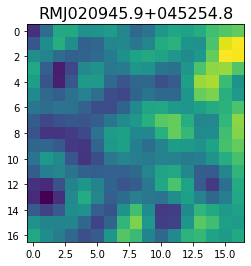

  5%|▌         | 548/10099 [00:38<25:55,  6.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -63.30435    -83.35984   -103.46853    -86.20015    -72.44366
 -136.18558   -209.37244   -145.26494      3.4285367   11.759487
 -140.1721    -194.15501    -39.45426     78.047745   -46.883984
 -240.41928   -236.92728  ]


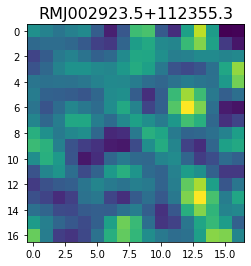

  5%|▌         | 550/10099 [00:38<24:57,  6.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 92.185165   41.892147   -7.6618257  10.68598    47.532307   26.898981
 -22.448376  -20.567017   24.196226   33.377464   -5.67134   -25.488075
  -0.5576444  13.100568  -19.009401  -50.403427  -32.9502   ]


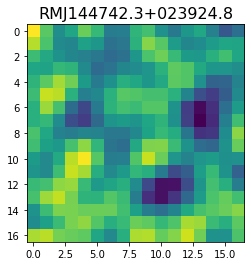

  5%|▌         | 553/10099 [00:39<20:51,  7.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[34.898254 43.215763 58.0893   61.43904  54.493874 46.971066 44.561634
 48.08796  50.682682 41.14377  22.219818 14.327398 27.775698 45.453014
 47.64911  38.408905 31.99488 ]


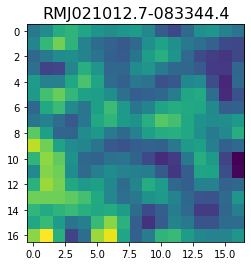

  5%|▌         | 555/10099 [00:39<20:33,  7.74it/s]

<class 'pixell.enmap.ndmap'>
[104.80938   85.36036   65.41107  101.42912  175.38448  189.42601
 109.94341   28.029577  31.650438  91.171936 116.94776   78.83994
  27.312555  17.877386  42.517532  46.308     10.297416]


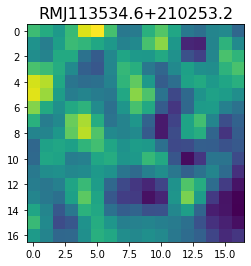

  6%|▌         | 556/10099 [00:39<23:12,  6.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-56.452145 -63.941288 -63.876194 -53.19691  -52.27393  -68.38486
 -78.22915  -63.915993 -43.814926 -45.70492  -64.475746 -70.389984
 -52.526707 -31.716892 -29.202616 -40.119785 -45.308907]


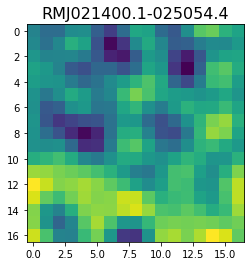

  6%|▌         | 560/10099 [00:40<17:08,  9.28it/s]

<class 'pixell.enmap.ndmap'>
[ -36.35547    -31.779974   -20.183954     1.357551    -1.4628369
  -54.590446   -81.313614    -0.9457555   95.372345    53.348648
  -79.47827   -107.37173      7.7936296  109.18561    106.49345
   68.62531     56.429222 ]


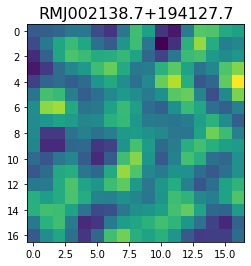

  6%|▌         | 561/10099 [00:40<20:23,  7.80it/s]

<class 'pixell.enmap.ndmap'>
[-4.6908684e+01 -4.0374657e+01 -3.6622567e+00  2.2962124e+01
  2.4063868e+01  8.7816401e+00 -5.4602313e+00 -1.8041147e+00
  1.7002911e+01  2.2683111e+01 -1.1294333e-02 -2.2294395e+01
 -8.0469398e+00  3.4122181e+01  6.5097504e+01  6.5846336e+01
  4.7232338e+01]


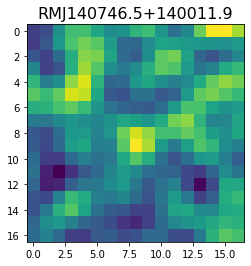

  6%|▌         | 562/10099 [00:40<24:07,  6.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[17.291672 15.709503 41.55267  81.46591  98.04776  72.98764  31.82235
 13.91945  27.14725  46.2945   48.856564 34.98279  16.315714  5.303571
 15.391704 49.547836 82.93306 ]


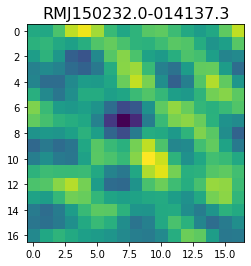

  6%|▌         | 573/10099 [00:40<09:25, 16.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[30.605623  76.96007   70.78883   11.895063  -8.643323  32.531887
 63.891766  54.219738  48.3812    58.739883  41.57975   -0.6319336
 -5.0638394 39.44953   65.20931   36.052055  -1.0645328]


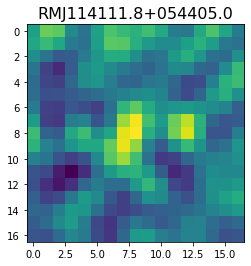

  6%|▌         | 580/10099 [00:41<08:29, 18.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-96.98752  -91.2232   -94.3884   -94.365555 -73.312706 -44.381348
 -41.314846 -67.68312  -87.86241  -80.526146 -67.36789  -68.447716
 -64.83392  -38.308838 -16.647463 -35.184864 -74.24548 ]


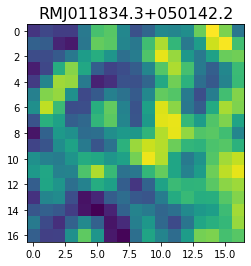

  6%|▌         | 590/10099 [00:41<06:37, 23.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[148.90582  185.62468  220.5127   202.05962  118.00265   29.734262
  16.48015   74.07354  122.74937  124.27839  117.80357  124.520355
 107.13183   55.851013  25.781195  47.870205  81.1755  ]


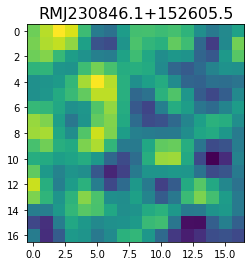

  6%|▌         | 595/10099 [00:41<07:22, 21.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -29.358147    -11.272874    -62.16013     -59.336105      5.6623683
   13.539678    -59.47522    -115.12369    -112.59941     -94.6307
  -67.70024     -14.262994     22.54218       0.66532004  -35.33067
  -36.363213    -33.549614  ]


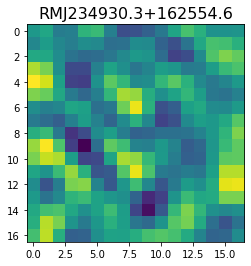

  6%|▌         | 599/10099 [00:42<08:55, 17.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-193.84825 -149.26913 -127.22302 -125.75351 -155.89806 -206.09698
 -225.16422 -199.55951 -184.6729  -208.89156 -220.992   -186.27129
 -156.65398 -185.56003 -244.31471 -279.93527 -288.8275 ]


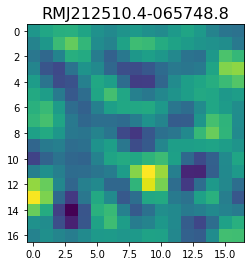

  6%|▌         | 604/10099 [00:42<08:54, 17.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -79.080734 -135.88658   -91.152954   13.284789   70.8652     29.985178
  -52.12085   -77.66939   -20.102016   45.35316    27.806442  -73.56895
 -165.14594  -158.07457   -57.092728   51.5864     87.04321 ]


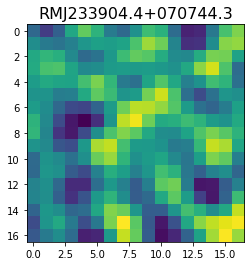

<class 'pixell.enmap.ndmap'>
[ 42.378433   22.06488   -22.222702  -32.88528    13.540388   72.32533
  80.98439    36.547916   -1.6436455   8.7992525  40.192432   40.597973
   6.106476  -25.655638  -36.575092  -41.725662  -47.582302 ]


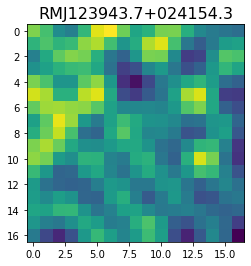

  6%|▌         | 614/10099 [00:43<08:08, 19.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


  6%|▌         | 621/10099 [00:43<06:04, 26.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[205.59387  187.50427   81.0696    35.32451   82.31658  137.08772
 133.84604   85.612816  38.207836  19.892088  33.744198  73.22709
 131.30768  186.47052  194.85895  135.9905    65.25099 ]


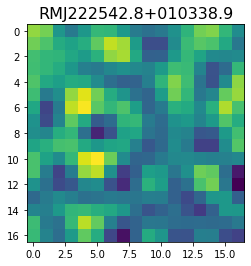

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -68.35873   -50.747833  -71.791626 -119.78925  -140.76207  -103.3341
  -46.561512  -34.76714   -74.30618  -111.0305   -110.14106   -96.08981
  -98.80264  -103.142555  -83.31637   -55.471283  -54.925465]


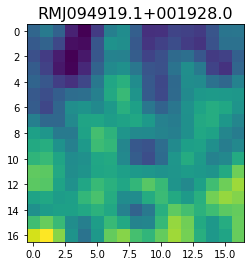

  6%|▌         | 626/10099 [00:43<08:59, 17.57it/s]

<class 'pixell.enmap.ndmap'>
[-19.386581  -34.51056   -50.910034  -63.717583  -50.918507  -17.861483
   5.835324   10.105777   11.626953   19.461727   22.397038   12.092789
  -3.1643262 -11.975051  -14.134068  -18.40549   -31.37536  ]


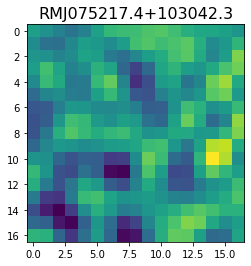

  6%|▌         | 630/10099 [00:44<09:29, 16.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 33.32254    19.725563    3.6662643  56.726128  112.09732    73.42373
 -18.7321    -66.91576   -67.50209   -53.179626    6.0425415 109.45575
 147.53717    61.458363  -28.212471    4.4007826  94.1831   ]


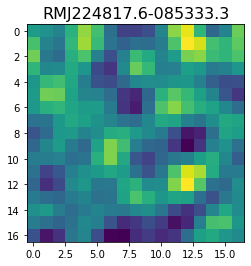

  6%|▋         | 634/10099 [00:44<09:47, 16.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -89.614624  -55.180256 -113.65618  -202.96461  -191.29297   -91.04401
  -22.494333  -19.041634  -27.451963  -37.299385  -71.22505  -107.365135
 -113.07922   -97.13089   -74.39907   -45.402996  -26.626167]


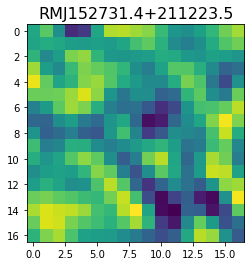

  6%|▋         | 641/10099 [00:44<09:03, 17.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[114.8959    65.85091   91.90089  131.68974  104.43071   64.81347
  90.58937  130.25546  113.22486   83.42783   84.82882   60.72378
 -10.737392 -44.754135 -14.90722   -9.878059 -46.22262 ]


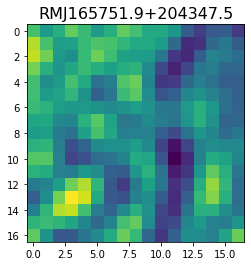

<class 'pixell.enmap.ndmap'>
[ -67.85808    -64.85407    -96.83256    -74.43097    -17.903893
    1.0874808  -15.940445   -52.041714  -134.46928   -227.45921
 -207.82121    -59.809696    49.225445     1.9987863  -94.95157
  -86.63064      1.0618258]


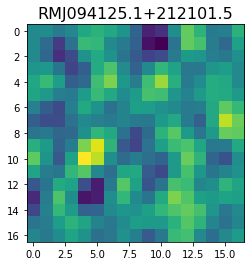

  6%|▋         | 644/10099 [00:45<12:43, 12.38it/s]

<class 'pixell.enmap.ndmap'>
[158.75175  126.57148  155.71436  157.92743   90.77111   48.059418
  98.48406  160.4636   148.89693  126.46035  176.2761   234.86893
 205.58798  141.74171  146.32458  171.50635  105.1008  ]


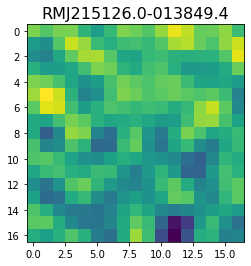

  6%|▋         | 646/10099 [00:45<13:55, 11.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-12.153834  -16.341944   -2.784551    9.202308    6.1773634   0.2788215
   1.9923817  -2.2661462 -21.33834   -32.224384  -15.422556    4.7864966
  -1.3573866  -9.004818   27.260744   86.87887    96.913246 ]


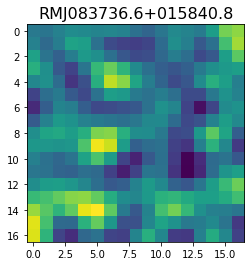

  6%|▋         | 649/10099 [00:45<14:23, 10.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-24.639477   -9.729982   16.11355    20.502766    9.309353   11.460782
  27.713364   29.02308     7.722997   -6.4936166   4.744049   18.42093
  11.622226    2.527172   18.393778   45.05122    45.733383 ]


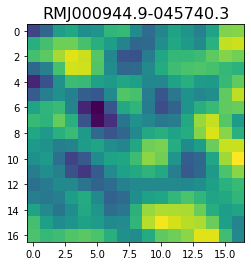

  6%|▋         | 654/10099 [00:46<12:21, 12.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 89.82229  163.72676  249.00548  251.49895  140.63268   24.122519
  33.055485 138.03737  174.54877   85.93613   27.16991  131.90923
 282.45084  267.93185  105.262215   9.119829  59.873203]


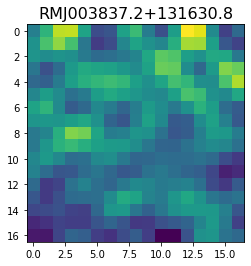

  6%|▋         | 656/10099 [00:46<14:25, 10.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.304794   38.72805    44.093834   21.124125  -11.942065  -19.919334
  19.033525   74.46642    76.58295    12.11824   -32.348576    5.1425033
  46.45991    -8.536294  -97.32936   -73.98368    52.577293 ]


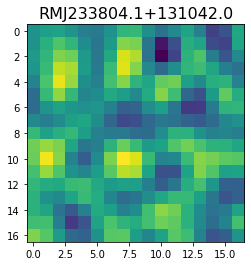

  7%|▋         | 659/10099 [00:46<14:18, 10.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 29.539837  -12.742999  -44.234577    3.9989028  82.301834   81.00031
  13.064048    1.1123654  70.82789   106.11234    49.69863     1.0641191
  46.4151    118.77471   112.64254    39.08915   -18.748732 ]


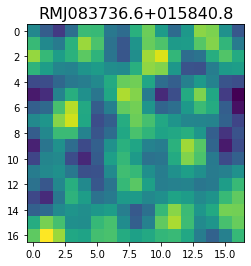

  7%|▋         | 665/10099 [00:46<11:30, 13.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -7.133884   -89.265526   -96.338745   -23.91695     28.190004
   14.136328   -10.277305    -4.229406    -5.5037484  -48.774174
 -102.014595  -120.93271   -107.0135     -84.065926   -67.39287
  -73.86721   -113.50166  ]


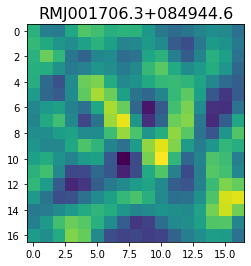

  7%|▋         | 671/10099 [00:47<10:12, 15.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 93.121414  113.15072    30.216257  -42.961445  -19.300406   32.577885
  25.556581   -1.6156948  18.692665   51.404568   37.223522   11.906932
  34.848793   71.651985   56.065796   14.136364   24.192345 ]


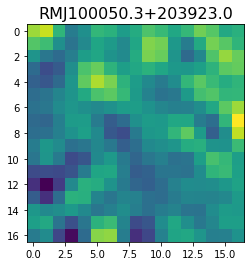

  7%|▋         | 673/10099 [00:47<11:30, 13.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[108.5456   111.569695 216.28958  253.03683  166.97722  101.97508
 146.5083   193.55533  149.3193   106.64215  181.26247  307.13696
 335.68835  255.58723  184.68715  189.02739  219.56259 ]


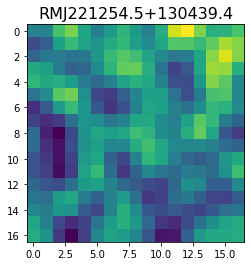

  7%|▋         | 678/10099 [00:47<10:26, 15.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 37.999004    82.213524   148.96036    115.94667     -1.7871892
 -45.34474     37.46585    106.79329     61.176186   -11.870508
   0.65951437  68.85356    104.97718     96.79139     73.38959
  36.75227     -4.790135  ]


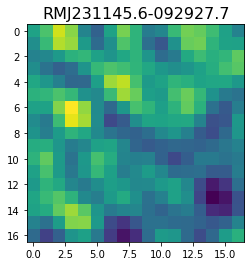

  7%|▋         | 685/10099 [00:48<08:47, 17.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-184.19101  -129.81374   -12.657296   -9.237458  -89.14807  -135.62021
 -123.36149   -86.929375  -47.506485  -31.42719   -52.88904   -60.59565
  -11.411351   23.237967  -43.238598 -143.33115  -140.22672 ]


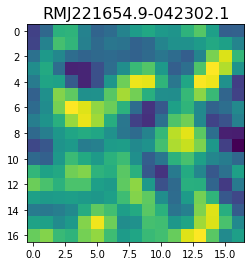

  7%|▋         | 689/10099 [00:48<09:18, 16.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-43.28084  -37.164032 -33.53553  -34.996155 -37.065723 -35.678303
 -33.579865 -33.129185 -31.798653 -30.734564 -35.096638 -40.224934
 -34.467594 -20.992367 -16.495354 -23.177595 -25.146622]


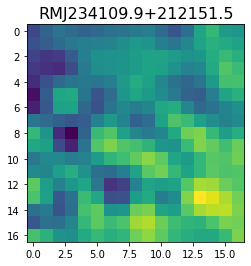

  7%|▋         | 692/10099 [00:48<09:55, 15.79it/s]

<class 'pixell.enmap.ndmap'>
[-215.47351 -204.801   -170.69882 -193.60847 -244.56654 -241.33385
 -195.41348 -184.35468 -206.59598 -188.05069 -125.36743 -103.7529
 -158.94978 -221.7148  -223.7339  -180.97557 -146.89912]


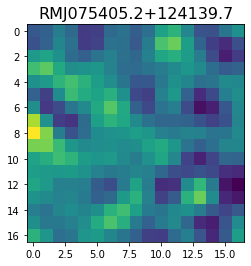

<class 'pixell.enmap.ndmap'>
[-16.63742    -9.288156  -12.996387  -30.733423  -42.376328  -32.122517
 -13.535381  -10.1858425 -21.32075   -26.23586   -17.046032   -7.62628
 -10.712493  -21.728128  -27.03309   -18.52393    -0.4196343]


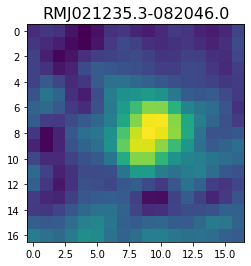

  7%|▋         | 694/10099 [00:48<13:46, 11.38it/s]

<class 'pixell.enmap.ndmap'>
[ 60.183346 106.06943   73.106995 -27.707071 -91.54516  -67.840416
 -22.585407 -19.431126 -26.135172   5.681369  42.58122   25.490892
 -24.397831 -32.846977  15.426947  57.63085   43.703598]


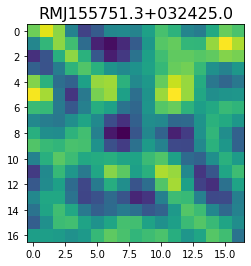

  7%|▋         | 696/10099 [00:49<14:58, 10.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 41.527733  51.103176  50.524822  53.224865  78.41874  109.75487
 117.991005 110.52477  117.050415 131.25974  114.984474  70.37973
  57.939663 112.25775  179.75594  184.6863   132.11882 ]


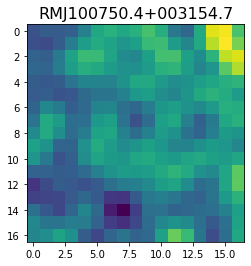

  7%|▋         | 698/10099 [00:49<15:45,  9.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-21.357079  -57.309372  -85.221176  -50.638184   18.313654   29.34062
 -39.05725   -92.15929   -59.579323   -2.4983144  -4.5424943 -36.0313
 -27.776163   -6.339618  -34.023376  -72.968376  -42.59648  ]


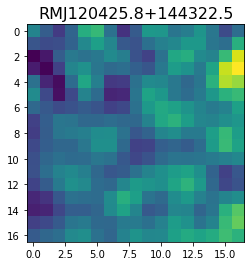

  7%|▋         | 700/10099 [00:49<16:24,  9.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -92.17481    -77.2658     -28.248615     0.239705    -2.8337831
  -11.16746    -21.169214   -38.975464   -42.105774   -18.470362
   -8.209777   -46.33979    -97.66323   -103.296      -62.822422
  -25.53561    -23.770752 ]


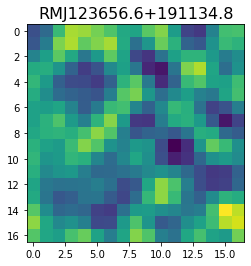

  7%|▋         | 701/10099 [00:49<20:17,  7.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-351.996    -152.6635    117.62908    96.41338  -105.767784 -163.61578
  -49.44837    13.518009  -98.49684  -306.88162  -436.5407   -342.3872
  -50.150665  224.8215    292.2848    168.59215    -8.516503]


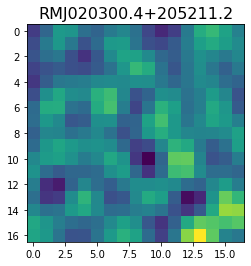

  7%|▋         | 704/10099 [00:50<17:24,  9.00it/s]

<class 'pixell.enmap.ndmap'>
[103.09533  193.9603   189.01952  105.80783   95.284256 164.97688
 175.5605    97.34999   49.219288  89.0234   152.14114  185.62558
 192.80162  173.78934  139.29929  133.77856  159.78886 ]


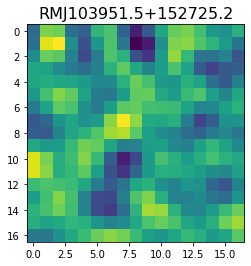

  7%|▋         | 705/10099 [00:50<21:03,  7.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   3.9802396   -1.00787    -32.113064   -19.004068    29.901321
   19.916054   -72.83103   -145.83038   -127.27931    -76.33732
  -58.173122   -40.821777    -0.8778883   -4.200545   -78.47387
 -126.092995   -73.97951  ]


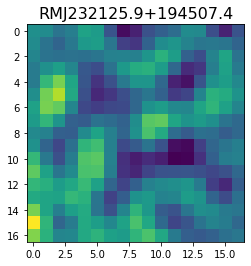

  7%|▋         | 707/10099 [00:50<20:53,  7.49it/s]

<class 'pixell.enmap.ndmap'>
[-140.00232  -173.5623   -119.817085 -107.14365  -171.35779  -193.36856
 -112.69952   -35.823242  -64.139404 -146.2039   -176.68405  -142.77835
  -99.90176   -74.408936  -57.671     -53.533253  -77.09494 ]


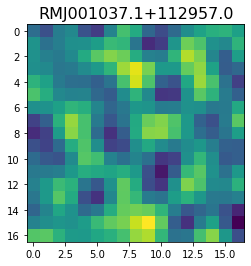

  7%|▋         | 708/10099 [00:50<23:40,  6.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 37.344677  60.673397  22.134098 -61.582695 -66.055626  33.43376
  99.926     48.622852 -36.97299  -68.47768  -70.93795  -70.637146
 -24.628843  63.210796 100.958855  57.645622  28.728895]


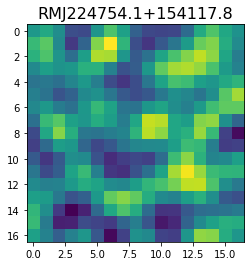

  7%|▋         | 715/10099 [00:51<12:54, 12.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-12.202156   -5.50402    -2.166586   -8.830223  -16.36575   -12.954812
  -1.0621822   7.4408035   8.122412    5.3779206   1.089166   -5.385664
  -8.336514   -1.1596947   9.538443   10.327378    2.6468444]


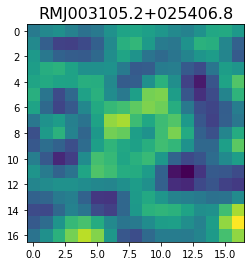

  7%|▋         | 719/10099 [00:51<11:51, 13.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -36.929657  -18.74955   -27.219868 -224.42464  -312.53278   -62.08239
  241.16185   314.2883    315.00766   383.23206   320.58243    84.63014
   19.051794  250.5251    406.52228   239.23564    22.557173]


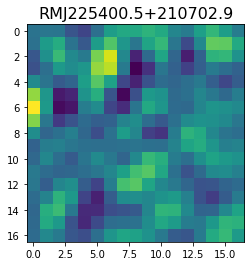

  7%|▋         | 722/10099 [00:51<12:02, 12.98it/s]

<class 'pixell.enmap.ndmap'>
[ -59.911568  -59.616703  -62.45009   -99.35236  -129.64258  -103.90085
  -65.37731   -81.58493  -120.54952  -110.70048   -79.66508  -103.77749
 -149.62888  -105.65869    31.646795  132.8433    112.31707 ]


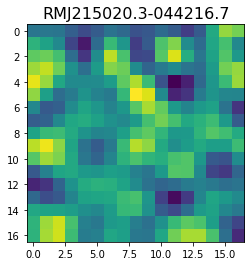

<class 'pixell.enmap.ndmap'>
[ 82.740456  78.29138   61.802105  54.766415  69.01566   86.322945
  88.85651   83.23382   82.21979   87.1458    94.26138  100.115425
 103.60842  111.95403  128.80392  135.46158  114.735176]


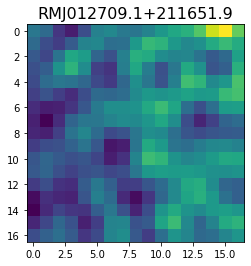

  7%|▋         | 724/10099 [00:52<16:47,  9.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 82.25179    38.242947   16.219292   13.391684   26.41864    48.930843
  73.91235    99.820786  113.37564    89.86       40.7806     23.137848
  58.374733   86.365135   53.93311     2.5357747   2.9639132]


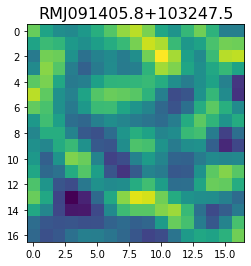

  7%|▋         | 726/10099 [00:52<17:23,  8.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -3.6673012  -26.66267     23.564539    95.64944    111.27205
   68.440865    32.75604     45.35178     84.87983    107.91306
   83.68206      4.2219315  -90.4074    -113.3        -19.780508
  110.07851    146.25894  ]


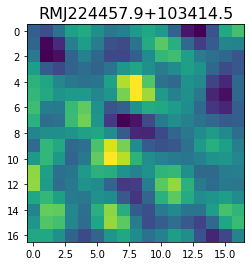

  7%|▋         | 729/10099 [00:52<16:30,  9.46it/s]

<class 'pixell.enmap.ndmap'>
[123.28666  119.38825  104.53135   81.25835   67.4489    77.16043
  96.22363   97.37711   79.231476  66.61997   70.96627   76.678696
  71.046     60.83376   53.2931    47.184723  48.758038]


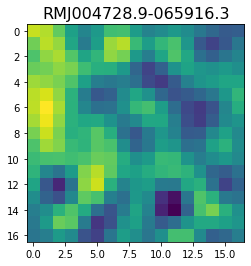

  7%|▋         | 730/10099 [00:53<20:19,  7.68it/s]

<class 'pixell.enmap.ndmap'>
[ -25.511     -23.6262    -32.252518  -50.984795  -81.92213  -103.71904
  -85.81064   -43.285896  -28.80913   -58.5319    -94.15033  -101.506325
  -75.814125  -15.703843   65.19759   108.57769    65.51195 ]


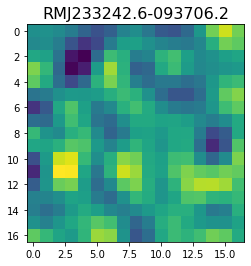

  7%|▋         | 731/10099 [00:53<22:58,  6.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[172.20068   20.829647  21.824    153.01416  213.35635  124.421974
  19.935383  28.238651 111.25101  154.09343  118.38782   60.871616
  41.769764  54.4071    52.072086  24.854115  12.622812]


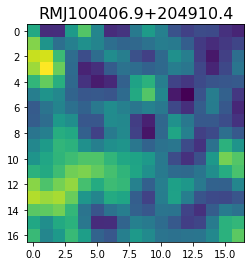

  7%|▋         | 733/10099 [00:53<22:45,  6.86it/s]

<class 'pixell.enmap.ndmap'>
[ -53.28528    -1.147757   19.517696   15.694398  -30.13618  -112.31744
 -155.69112  -122.99702   -89.69878  -111.83111  -121.255035  -61.673195
  -11.537318  -43.34165   -75.49982    -7.49924    95.34833 ]


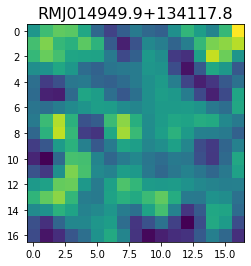

  7%|▋         | 734/10099 [00:53<25:24,  6.14it/s]

<class 'pixell.enmap.ndmap'>
[-1.97767620e+01 -8.94084091e+01 -4.30455666e+01  6.25545464e+01
  1.14244774e+02  6.42339706e+01 -6.46252680e+00  1.17459316e+01
  8.90286484e+01  9.55953979e+01  2.28705616e+01  8.88896883e-02
  5.57448158e+01  6.88509979e+01  1.34255400e+01  1.90223198e+01
  1.14216324e+02]


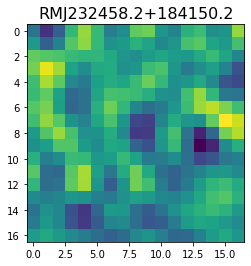

  7%|▋         | 735/10099 [00:54<27:16,  5.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 28.599548   11.480091  -32.8887    -55.94813   -42.403873  -17.231054
   0.9373456  14.661628   24.529276   24.234385   16.593044   12.339136
  13.458572   10.317081   -3.900273  -19.68881   -15.6069765]


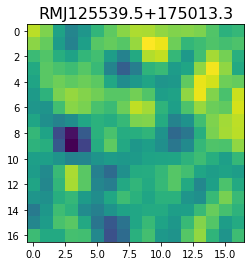

  7%|▋         | 737/10099 [00:54<24:11,  6.45it/s]

<class 'pixell.enmap.ndmap'>
[40.272472  9.234748  6.122118 27.724285 41.857502 37.602566 32.138477
 37.011047 45.472717 50.01886  49.545288 40.882362 23.368885 10.638312
 18.734243 41.8665   56.989647]


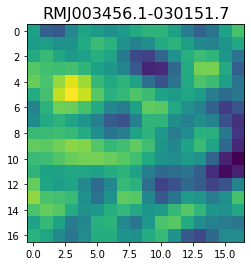

  7%|▋         | 738/10099 [00:54<26:02,  5.99it/s]

<class 'pixell.enmap.ndmap'>


  7%|▋         | 745/10099 [00:54<09:58, 15.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 67.6065   109.89614  115.62095   68.80738   26.049814  36.882366
  69.94084   72.685135  59.917156  79.48523  125.12434  148.85188
 136.64407  112.96088   88.70865   59.81095   43.811768]


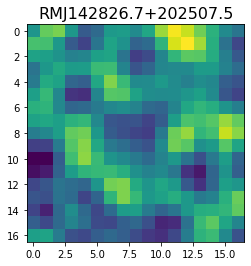

  7%|▋         | 748/10099 [00:54<10:49, 14.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-185.0669   -192.19249  -232.78735  -247.1055   -214.12225  -193.032
 -215.27324  -220.29701  -170.10526  -146.43192  -226.96667  -327.1847
 -302.15024  -176.88248  -124.022415 -203.6988   -278.38422 ]


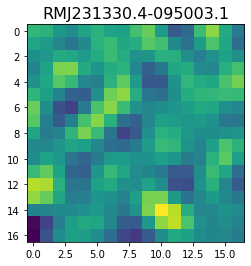

  7%|▋         | 751/10099 [00:55<11:35, 13.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   7.9567647  -49.464622   -43.61324     -8.620802   -26.33148
  -63.153282   -47.971695   -15.82582    -30.283752   -58.27377
  -45.180946   -22.197239   -40.285393   -82.100006  -108.014275
 -113.03364   -102.27676  ]


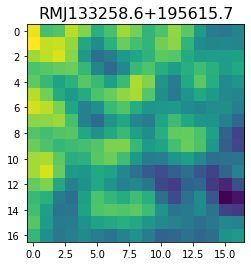

  7%|▋         | 756/10099 [00:55<10:31, 14.79it/s]

<class 'pixell.enmap.ndmap'>
[-290.55835 -273.9352  -261.5228  -261.634   -260.41907 -240.66823
 -203.66347 -166.02643 -150.6261  -179.68547 -250.0934  -310.39413
 -295.5543  -204.25743 -115.51587 -102.27052 -147.70708]


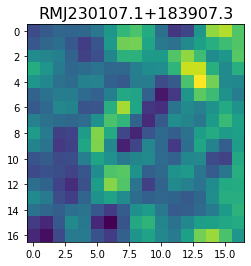

  8%|▊         | 758/10099 [00:55<12:05, 12.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  69.81769    -28.428947  -152.36783   -123.561424    16.20614
   86.12573     30.910494   -49.291515   -68.25486    -26.545925
   35.15997     61.83211     12.960634   -68.14651    -77.947
    1.6420656   61.748478 ]


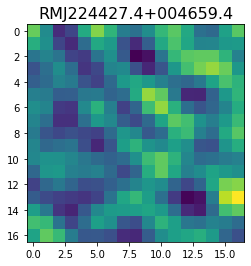

<class 'pixell.enmap.ndmap'>
[ 56.192375  59.73433   41.83022   32.053894  30.837015   6.803231
 -25.664621  -4.434886  63.20343   71.33078  -22.018597 -95.56099
 -35.949608  77.77343   96.777374  34.949863  19.072813]


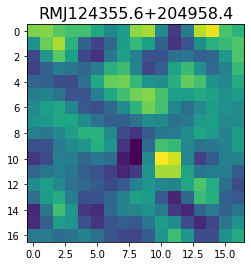

  8%|▊         | 760/10099 [00:56<17:11,  9.05it/s]

<class 'pixell.enmap.ndmap'>
[ 96.720474  -29.371243  -71.59396   -32.444283   13.420102   22.457083
  -5.4317117 -45.875805  -55.220093  -10.890096   41.763878   33.009098
 -35.119457  -83.05562   -51.49403    30.858732   84.82064  ]


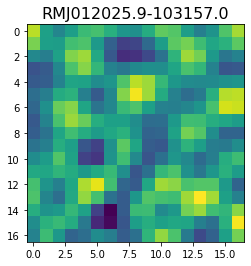

  8%|▊         | 762/10099 [00:56<18:35,  8.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -21.338102   26.48021   -13.024799  -86.59844  -110.38289   -75.55881
  -46.584503  -64.428024  -91.33814   -73.7098    -29.02286   -18.257559
  -40.312332  -25.133121   48.001102  101.78918    75.8659  ]


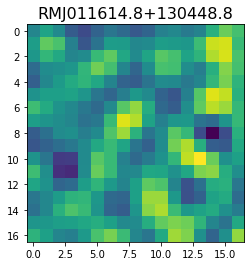

  8%|▊         | 765/10099 [00:56<17:18,  8.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-121.763626     8.100542    -4.090633  -206.84116   -324.27206
 -213.7591     -70.19372    -55.612587   -68.19461      2.8421507
   71.663795    10.692571  -163.3152    -311.15683   -307.696
 -179.14723    -97.22258  ]


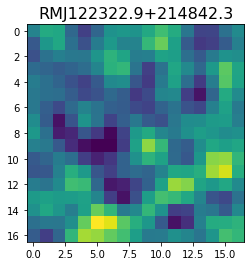

  8%|▊         | 768/10099 [00:56<15:51,  9.81it/s]

<class 'pixell.enmap.ndmap'>
[-131.52094  -136.04782  -143.14352  -156.92883  -172.70654  -159.0733
 -113.46592   -92.6448   -135.31589  -191.25484  -187.39098  -136.42023
 -113.399765 -139.55028  -158.31697  -130.56999   -92.5478  ]


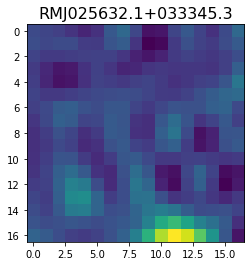

  8%|▊         | 770/10099 [00:57<17:45,  8.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[114.09295   98.566025  83.69506   89.34122  104.71739  106.666016
  97.27883   97.926605 109.658455 109.0604    89.37288   77.00686
  91.645134 112.892136 108.3417    79.66718   56.945694]


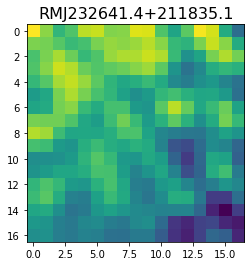

  8%|▊         | 773/10099 [00:57<16:03,  9.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 184.15825   212.11569   165.78755   113.32916   113.782234  129.77643
   78.16215   -38.025673 -105.97849   -43.507175   83.65326   146.39131
  127.39754   125.89007   183.33945   206.99843   118.55392 ]


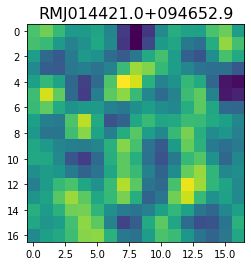

  8%|▊         | 777/10099 [00:57<13:47, 11.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -68.4608      -86.860855    -70.99394     -29.34649      -0.4777255
    0.58268833  -10.95779     -30.890156    -68.26682    -105.37206
 -105.25197     -69.79964     -43.758324    -47.225525    -50.31338
  -32.67904     -21.94672   ]


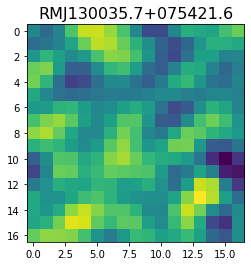

  8%|▊         | 779/10099 [00:57<14:44, 10.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-11.573877  -7.780114 -10.594192 -24.617172 -47.804405 -65.90588
 -64.12066  -47.43746  -37.176342 -43.57661  -55.45382  -61.889996
 -67.888824 -78.8958   -84.99766  -74.64952  -54.069897]


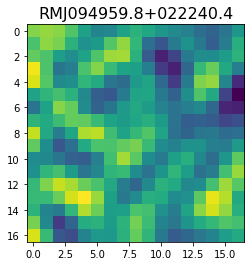

  8%|▊         | 781/10099 [00:58<15:26, 10.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-398.79535    -8.864419  104.306564  -92.22988  -128.11534   109.32672
  197.24239   -55.688816 -256.07062   -78.69059   191.51733   107.8862
 -261.26297  -479.85092  -388.96207  -228.36887  -185.09834 ]


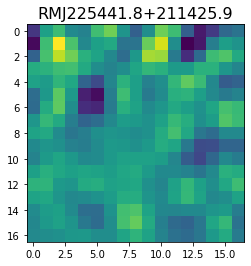

  8%|▊         | 786/10099 [00:58<12:17, 12.62it/s]

<class 'pixell.enmap.ndmap'>
[ -49.950233  -66.52863   -46.956276   29.106335  102.60292    79.82498
  -31.8154   -117.208015 -109.0813    -64.20394   -49.503395  -39.784992
   15.191155   89.92953   116.23315    80.6436     33.603745]


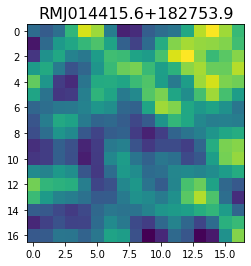

  8%|▊         | 788/10099 [00:58<13:47, 11.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[149.60193   133.48491   118.7754    107.22296    99.36202    93.665855
  87.83306    81.47616    75.23807    67.57527    56.160427   42.916023
  33.255894   28.597853   23.532318   12.8985615  -1.3932698]


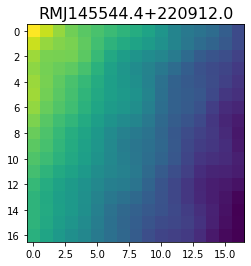

  8%|▊         | 790/10099 [00:58<14:47, 10.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[38.82654  43.709614 43.592136 48.963127 63.9063   68.88367  54.0166
 41.592632 50.685337 64.03081  56.266026 34.984062 27.43395  40.661324
 58.055496 65.15529  60.211033]


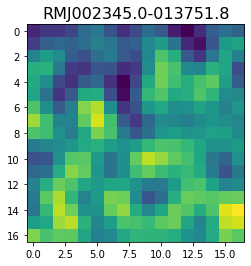

  8%|▊         | 794/10099 [00:59<13:33, 11.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -23.960287  -56.766983 -114.51801  -137.83173  -115.603004  -92.830345
  -99.65262  -110.97576   -94.839485  -67.75929   -69.674675 -102.143074
 -126.59592  -118.84508   -94.04098   -75.48865   -66.53915 ]


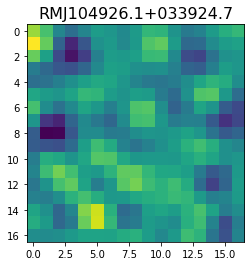

  8%|▊         | 801/10099 [00:59<10:08, 15.28it/s]

<class 'pixell.enmap.ndmap'>
[ -36.210617  -27.925465  -35.721775  -47.480976  -44.75021   -51.442993
  -87.94203  -118.08825  -100.5006    -59.76585   -50.286144  -73.88586
  -87.32846   -77.605415  -78.05807  -107.62964  -136.8761  ]


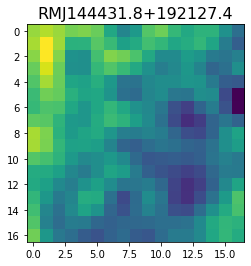

<class 'pixell.enmap.ndmap'>
[-147.05928  -162.9796   -186.81061  -193.52675  -172.98734  -157.13277
 -166.06715  -169.53282  -146.47913  -136.30594  -172.67085  -207.43736
 -171.87689   -88.91276   -49.870068  -85.51685  -129.09055 ]


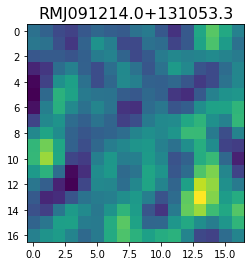

  8%|▊         | 803/10099 [00:59<14:11, 10.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-40.19336    -13.216901    13.812489    17.70655      2.051186
  -0.67371094  27.759003    58.895058    52.889534    15.074029
 -12.34873     -7.8284254   10.969795    21.26035     16.327
  -4.914001   -37.087048  ]


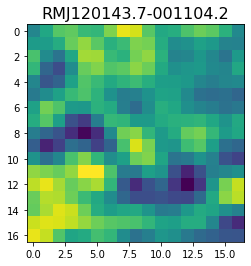

  8%|▊         | 806/10099 [01:00<13:54, 11.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -85.02623  -103.83941  -130.91103  -133.00204   -97.72733   -69.158035
  -84.817856 -118.77464  -129.58458  -123.55754  -123.28352  -111.95449
  -65.46571   -13.502182  -10.257736  -56.561123 -101.42113 ]


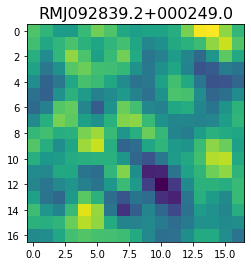

  8%|▊         | 808/10099 [01:00<14:56, 10.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -55.26486   -31.317644  -82.65332  -168.04715  -187.77592  -126.21561
  -72.70492   -89.14262  -130.76474  -130.89159  -105.80748  -121.91612
 -185.39151  -222.82706  -181.52219  -107.30875   -88.19722 ]


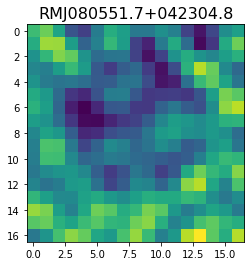

  8%|▊         | 814/10099 [01:00<12:22, 12.50it/s]

<class 'pixell.enmap.ndmap'>
[ 261.3466    433.45633   340.5439     39.253654 -119.5376    -10.91681
  129.4947    126.66817   100.56197   187.86584   301.1074    296.2049
  189.76738    86.04266    30.228643   32.061237  108.41062 ]


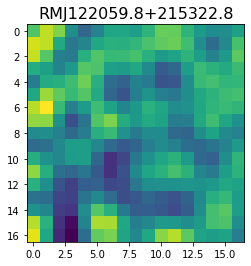

  8%|▊         | 823/10099 [01:01<08:14, 18.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -63.25334      6.9602823  -12.598027  -120.948006  -225.69316
 -281.0664    -278.17273   -196.73624    -65.11259     12.638059
  -34.368336  -157.03416   -240.938     -216.2637    -118.249084
  -56.907715   -98.6035   ]


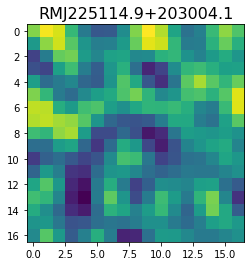

  8%|▊         | 827/10099 [01:01<08:48, 17.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  36.86984     49.788513   -22.792156  -100.72922    -75.054306
    0.2476235    3.900771   -36.673428   -19.057844    24.609076
   -1.2015828  -53.759995   -27.221115    45.98079     58.74415
   18.285055     4.769333 ]


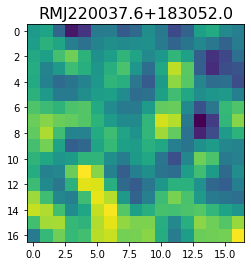

  8%|▊         | 830/10099 [01:01<10:09, 15.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[158.9931   186.16174  179.37904  156.03253  131.42805  126.270195
 162.94698  226.5203   258.05768  217.88373  139.83514   93.72488
 100.67792  115.015526  96.13315   70.09457   92.85788 ]


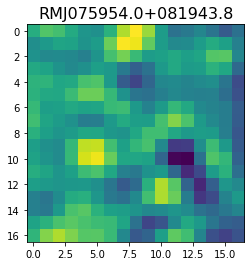

  8%|▊         | 832/10099 [01:02<12:07, 12.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 68.304054    71.28987     13.283639   -22.468672    -0.85399765
  26.631227    20.150087    11.907239    36.17266     65.191475
  61.793255    44.09268     46.019276    55.115746    43.498966
  26.972925    37.62913   ]


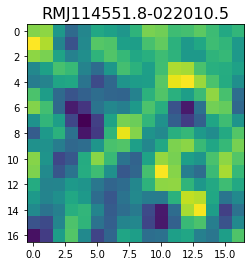

  8%|▊         | 835/10099 [01:02<12:31, 12.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 15.452209   -9.345237  -30.03116   -24.869537  -11.55557   -23.19962
 -54.4277    -64.93349   -38.862034   -9.9191065 -14.059303  -39.182587
 -42.972622  -12.191455   17.724945    7.6078835 -35.659126 ]


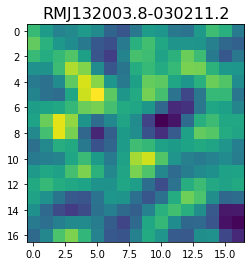

  8%|▊         | 838/10099 [01:02<12:38, 12.21it/s]

<class 'pixell.enmap.ndmap'>
[187.06676  268.94772  305.0368   214.26291  120.45341  160.93622
 263.04706  288.09354  268.58298  295.86237  306.59692  207.19531
  82.35356   62.042328 112.39911  150.57031  209.8137  ]


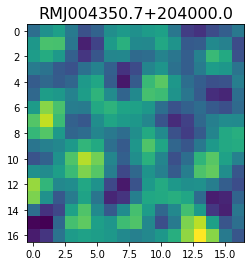

  8%|▊         | 840/10099 [01:02<13:43, 11.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[214.6618  217.99611 207.04971 207.08426 234.54947 246.48949 197.11336
 120.52622  94.63659 136.8083  190.36557 205.2049  182.69609 146.81319
 116.4758  109.10144 136.94295]


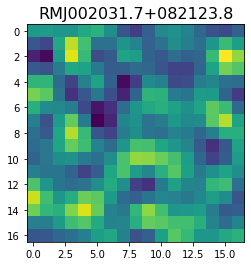

  8%|▊         | 845/10099 [01:03<11:26, 13.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 88.263016  83.36237   64.9024    37.57375   30.08452   55.423485
  79.273834  62.348423  23.164469  18.836597  63.09939  104.243935
  97.50653   63.51842   51.49914   71.70087   95.063484]


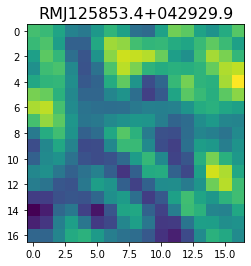

  8%|▊         | 849/10099 [01:03<11:07, 13.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -47.816154   -58.724815   -90.69838   -108.82425    -98.722466
  -68.13015    -41.22448    -33.513367   -31.425968   -25.773258
  -47.279575  -113.974495  -164.07996   -122.208176   -25.29077
   10.9781065  -40.724865 ]


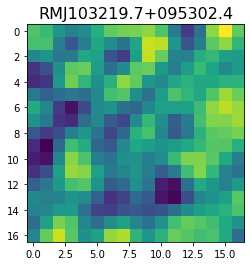

  9%|▊         | 862/10099 [01:03<06:51, 22.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-134.96434 -158.82849 -157.73311 -155.05803 -172.95467 -191.73468
 -187.9593  -175.77675 -176.83618 -183.96806 -186.11107 -193.90497
 -209.401   -205.9546  -171.19853 -137.57495 -137.78162]


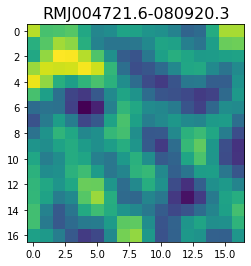

  9%|▊         | 865/10099 [01:03<08:05, 19.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  6.280155   -2.5910487  -9.0885105 -11.207631  -13.418968  -18.189241
 -24.8832    -32.63773   -38.32265   -38.12115   -36.49072   -42.5166
 -50.395138  -39.919563   -8.870507   14.0344515   8.161382 ]


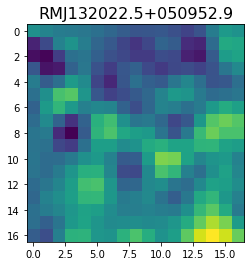

  9%|▊         | 870/10099 [01:04<08:36, 17.87it/s]

<class 'pixell.enmap.ndmap'>
[ 29.618032  84.78131  114.239944  83.12441   42.84394   50.56276
  85.26057   94.28134   78.266914  71.62975   76.26418   72.01676
  59.80877   43.552956   6.817002 -43.300488 -54.033463]


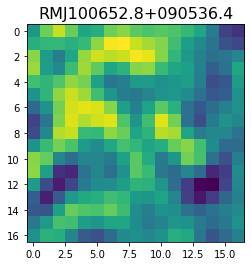

  9%|▊         | 873/10099 [01:04<10:16, 14.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-259.5901   -285.29623  -302.18683  -295.13922  -248.37508  -191.96161
 -159.54619  -136.84944  -127.203445 -189.17     -306.01904  -332.806
 -221.89415  -166.21625  -316.084    -489.8999   -426.04614 ]


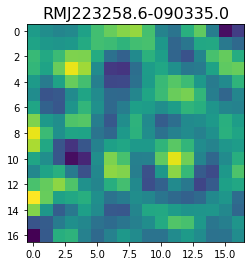

  9%|▊         | 875/10099 [01:04<12:52, 11.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  93.10305    97.39896    40.89006   -44.244053  -86.50561   -61.94993
  -43.69908   -62.16232   -51.356724  -15.005981  -44.273823 -109.65048
  -90.478775  -35.026566  -95.82592  -209.5827   -168.42258 ]


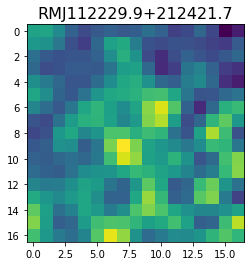

  9%|▊         | 879/10099 [01:05<12:24, 12.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  6.7933965  15.806272   22.333204   23.11478    11.718296   -5.902152
 -11.55158    -1.4948032   4.3677998  -7.2655864 -21.172619  -16.812689
   2.0702994  16.83471    20.01571    16.694527   10.665708 ]


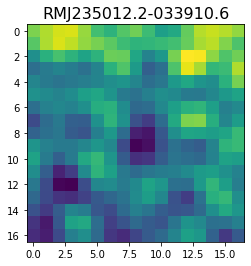

  9%|▉         | 886/10099 [01:05<09:49, 15.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.14371   20.28558   14.697209  61.721695  55.52285   27.320543
  67.676704 143.47041  159.7223   121.45394   84.12946   38.540215
 -11.041994  30.291367 190.33684  311.6607   255.79533 ]


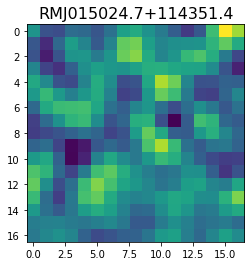

  9%|▉         | 888/10099 [01:05<11:18, 13.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[22.47839   14.147824  32.288815  35.464607   7.804456  -9.94115
  6.6582017 29.257654  36.60012   45.81324   61.67392   58.582764
 35.503033  27.890806  44.88493   53.333202  41.30307  ]


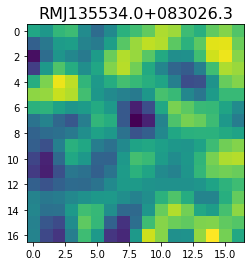

  9%|▉         | 892/10099 [01:06<10:57, 14.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  77.8816       52.74549      -4.6699963   -49.586174    -38.71339
   26.220802     75.23767      49.671432     -8.072111    -15.664737
   16.240423      0.94467926  -79.91262    -141.0281     -113.00478
  -20.185291     69.787735  ]


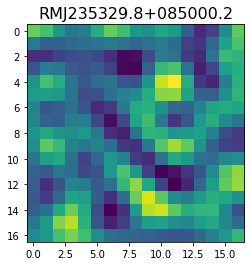

  9%|▉         | 894/10099 [01:06<12:36, 12.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.887343  -17.122366   25.452702   60.749023   51.6293     32.72701
  32.413338   22.631485  -10.287676  -20.296614   19.595469   56.59487
  36.09731    -7.960716   -6.0095057  34.48244    40.291355 ]


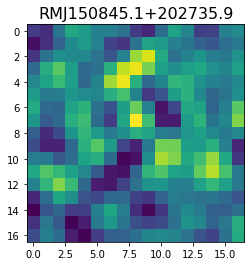

  9%|▉         | 899/10099 [01:06<11:14, 13.64it/s]

<class 'pixell.enmap.ndmap'>
[ -72.53913     38.00678     27.90305    -90.060234  -122.63941
   -6.7865443   96.33796     43.324055  -105.68201   -192.60452
 -158.16212    -82.37121    -67.29776   -112.81009   -125.482704
  -63.519466   -22.893476 ]


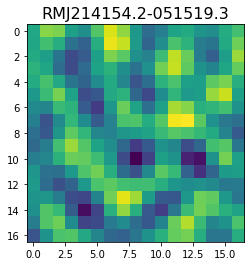

<class 'pixell.enmap.ndmap'>
[-23.14717   -18.238443   -8.710886    1.1549131  -7.156804  -35.204426
 -52.588215  -32.088337    6.7366233  14.319599  -24.26953   -66.82293
 -69.10256   -39.623856  -19.563305  -26.732912  -45.224    ]


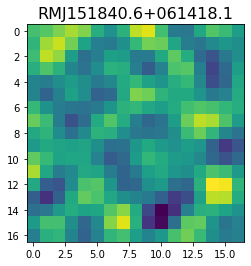

  9%|▉         | 901/10099 [01:07<15:27,  9.92it/s]

<class 'pixell.enmap.ndmap'>
[10.69749   29.589138  38.292526  30.501356   9.509021  -7.99737
 -2.288775  21.690144  32.49639   15.513323  -0.8734072 13.4864855
 42.705322  49.9965    34.35865   24.524902  26.369448 ]


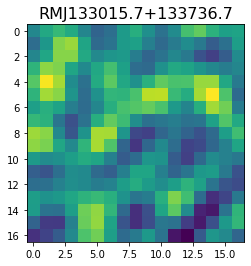

  9%|▉         | 903/10099 [01:07<16:19,  9.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[113.53546  162.34811  167.84744  114.83067   92.135796 146.96573
 197.58539  173.38658  135.24765  157.5234   193.58728  171.20862
 129.4409   142.53812  184.69894  185.92311  160.92438 ]


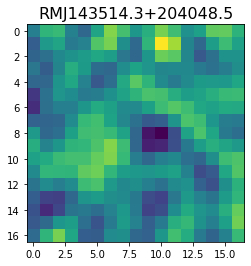

  9%|▉         | 910/10099 [01:07<11:19, 13.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 34.591526   59.513523   43.090042   12.339882   33.169594   61.078228
  12.645084  -60.190605  -53.918774    0.3152495  19.497515   29.252583
  58.630436   25.985453  -80.10478   -90.952835   70.449326 ]


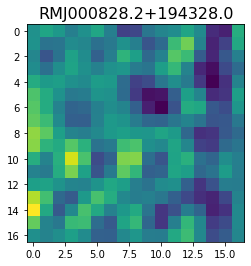

  9%|▉         | 916/10099 [01:07<09:57, 15.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.648033    -1.4859405   35.21695     44.223526    37.486458
  43.50204     54.405724    41.011787    14.278265    17.384344
  49.335487    55.1567      13.847615   -20.609583    -0.39201546
  43.797005    54.878044  ]


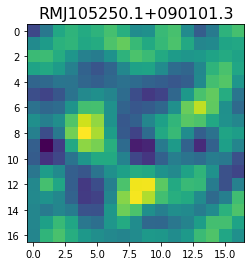

  9%|▉         | 922/10099 [01:08<09:00, 16.98it/s]

<class 'pixell.enmap.ndmap'>
[ 91.412285   57.44869    95.67369   130.43921    68.07435   -38.15557
 -49.0506     43.91284   100.23174    48.89419   -18.556293  -19.750748
  -2.3047423 -21.418242  -31.150276   10.501746   43.799725 ]


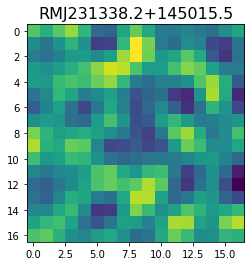

  9%|▉         | 924/10099 [01:08<10:18, 14.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.6103296   12.521282    46.061535    51.976334    33.982143
  39.463234    57.00151     34.352333   -10.02412     -2.6536448
  57.702198    89.76003     53.298565    -0.80137855 -12.577741
  15.870296    37.493916  ]


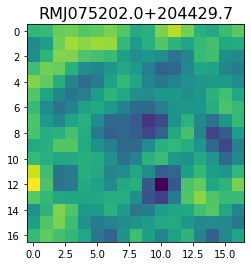

<class 'pixell.enmap.ndmap'>
[ -18.458046  -27.847769  -62.33435  -102.5297   -108.46647   -81.584366
  -71.73772  -105.63657  -146.47461  -144.31815  -101.18904   -67.078835
  -82.11314  -135.32297  -180.61253  -187.42068  -166.6645  ]


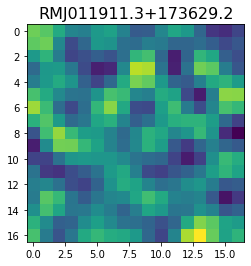

  9%|▉         | 926/10099 [01:09<15:43,  9.72it/s]

<class 'pixell.enmap.ndmap'>
[-56.97306   -65.07357   -62.588715  -44.912605  -33.5715    -41.63692
 -56.99413   -65.55742   -69.30908   -72.44719   -66.6863    -43.13309
 -10.669984    9.148699    5.4315515 -10.127052  -17.920965 ]


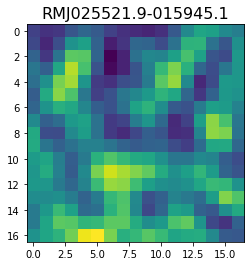

  9%|▉         | 928/10099 [01:09<16:47,  9.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  66.04875    -8.676365 -163.61996  -232.99036  -145.97952   -25.553217
  -22.739025 -117.794304 -169.41898  -113.24166    -9.739866   75.77512
  124.91728   113.33248    30.652079  -43.62896    -4.146761]


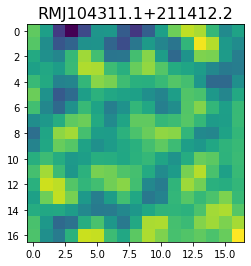

  9%|▉         | 932/10099 [01:09<14:35, 10.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  9.295207 -38.45489  -32.96175  -56.07936  -59.90799   50.85004
 178.37532  150.54346   23.521612  -8.707858  53.654522  51.91977
 -20.756483 -24.706203  46.9963    56.14196  -30.065758]


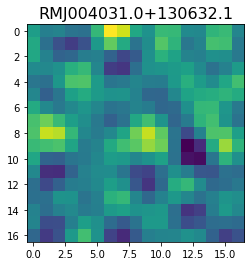

  9%|▉         | 934/10099 [01:09<15:29,  9.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -42.681404  156.74796   252.8142    231.3331     45.67842  -131.48712
  -91.03129    46.154003   47.324566   -7.759175   83.29459   231.59657
  213.58522    56.11463   -47.31806   -35.799686   28.56845 ]


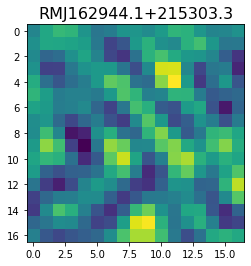

  9%|▉         | 936/10099 [01:10<16:16,  9.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 63.129868   88.23227    95.53836    92.49069    86.23503    67.214386
  41.080837   35.63749    54.66806    65.41787    51.82251    35.910206
  27.035402    1.8058964 -38.78039   -45.885994    6.287176 ]


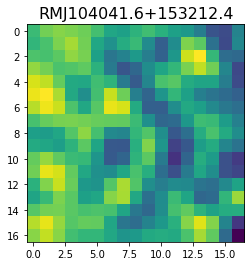

  9%|▉         | 939/10099 [01:10<15:02, 10.14it/s]

<class 'pixell.enmap.ndmap'>
[ -95.67817   -87.591484  -82.06474   -98.39123  -141.62909  -180.24257
 -182.40378  -157.23499  -136.80978  -137.41333  -155.83746  -179.47794
 -187.91765  -172.93536  -161.0164   -178.4224   -196.79456 ]


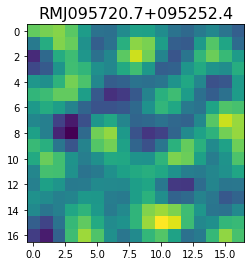

<class 'pixell.enmap.ndmap'>
[ -30.38976 -109.83283 -141.71556  -97.9876   -77.11998 -148.47931
 -225.09715 -191.81302  -96.66128  -84.75402 -168.60455 -206.32396
 -125.62292  -35.38182  -55.43609 -141.65244 -166.28381]


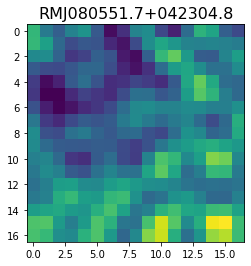

  9%|▉         | 941/10099 [01:10<20:26,  7.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 1.6948978e+02  1.5940840e+02  1.3079640e+02  1.4176350e+02
  1.8619263e+02  1.6485173e+02  5.9341988e+01 -1.4351919e-01
  7.0411797e+01  1.7752722e+02  2.0630231e+02  1.7784050e+02
  1.5734143e+02  1.3766125e+02  1.1294589e+02  1.3753587e+02
  2.1078090e+02]


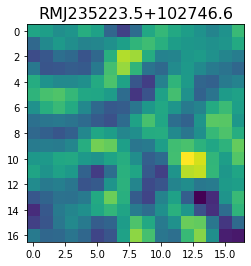

  9%|▉         | 943/10099 [01:11<19:46,  7.72it/s]

<class 'pixell.enmap.ndmap'>
[-161.16394   -42.589935  159.72136   221.44391   132.90701    62.564137
   76.4472     70.012115   -5.741717  -29.265781   85.91456   209.94318
  170.52408    26.519789   -8.599382  104.29042   165.75713 ]


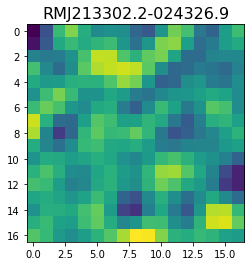

  9%|▉         | 944/10099 [01:11<21:52,  6.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 46.352623   23.171825    9.675007   40.65162    78.07987    54.57216
 -16.871948  -43.667187   14.460584   80.535774   71.746086   19.272436
  12.214791   59.37162    84.504814   48.552357    0.4157701]


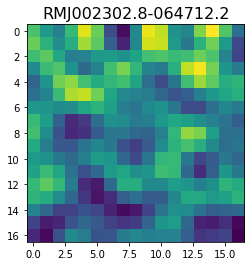

  9%|▉         | 947/10099 [01:11<18:11,  8.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -8.499722   -46.69312    -73.5052     -31.86045     33.938904
  40.633583    -5.1042266  -28.895561    -9.194091    11.470834
  13.033356    12.963979    12.173311     0.15017821  -4.510025
  14.005035    20.630583  ]


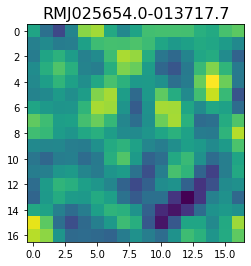

  9%|▉         | 953/10099 [01:11<12:39, 12.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -1.1175143  12.185478  -11.38021   -34.926723  -45.185352  -44.789864
 -31.24045    -7.0869756  15.014179   30.202606   38.574364   23.882658
 -26.86876   -80.5957    -81.33726   -26.423388   25.95813  ]


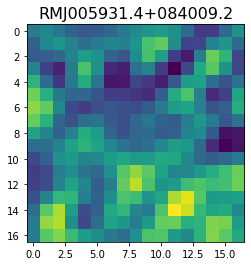

  9%|▉         | 957/10099 [01:12<11:49, 12.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -38.74403   -49.22338   -92.7937   -121.40601   -98.25935   -63.273144
  -72.4898   -104.68949   -96.82417   -40.358772   15.489383   24.107626
  -27.315836 -102.14792  -122.97093   -58.311214   14.695045]


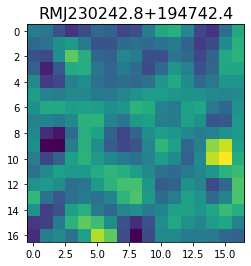

  9%|▉         | 959/10099 [01:12<14:44, 10.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-125.84828   -95.80754    64.03063   155.80681    62.813465  -66.642685
  -50.05941    66.074196  121.952644   86.65352    26.793108  -42.617996
 -112.04081   -92.57497    55.026863  195.28305   180.96219 ]


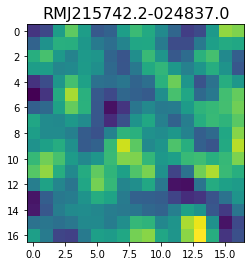

 10%|▉         | 961/10099 [01:12<16:00,  9.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.24853    75.00699    89.954956   79.34404    32.747917  -31.324272
 -69.79367   -57.168045  -12.416367   25.64667    37.322132   25.156206
  -5.2524743 -43.79599   -63.39576   -40.633175    4.2435603]


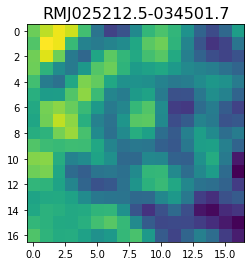

 10%|▉         | 963/10099 [01:12<16:42,  9.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   7.472084  -26.559958  -57.872723  -51.81452   -33.08693   -32.45542
  -34.591587  -25.546062  -32.95316   -68.020355  -83.24757   -42.344078
   11.487214    6.529144  -66.61543  -146.67625  -161.91542 ]


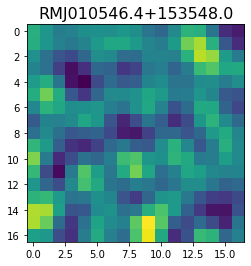

 10%|▉         | 965/10099 [01:13<16:56,  8.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 85.2925   114.13392  121.650536  82.59953   40.464657  82.21255
 213.78279  317.89145  288.00873  164.02646   72.27867   59.76165
  67.96297   64.117256 100.64098  205.62312  297.5933  ]


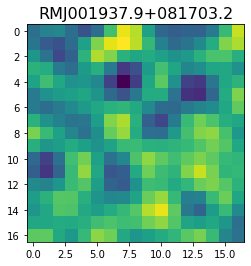

 10%|▉         | 972/10099 [01:13<11:13, 13.55it/s]

<class 'pixell.enmap.ndmap'>
[ -52.144306  -80.152596 -105.27747  -107.1903    -89.4045    -76.961136
  -84.860596 -102.20244  -109.28974  -101.01581   -88.16543   -80.45581
  -77.32938   -77.894005  -88.98998  -111.08772  -123.55856 ]


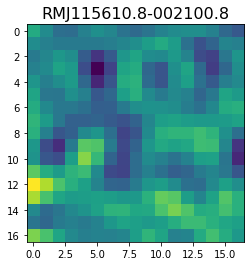

<class 'pixell.enmap.ndmap'>
[   6.5798354 -105.38946   -212.98482   -150.62634     13.568204
   77.97856    -11.700777  -115.829384  -111.04513    -37.210205
  -16.555347   -89.70432   -169.28894   -148.66922    -32.139435
   72.43904     88.15917  ]


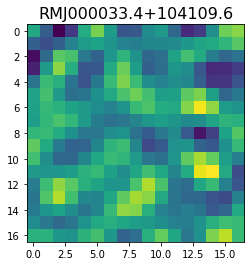

 10%|▉         | 974/10099 [01:13<15:22,  9.89it/s]

<class 'pixell.enmap.ndmap'>
[155.99704   82.49012  105.46591  175.42061  189.50356  135.7172
 114.29535  170.1814   189.93759   84.052086 -32.485115 -19.279076
  44.450592  12.322459 -56.307766 -22.63937   63.619904]


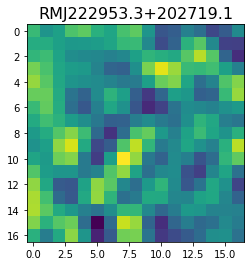

 10%|▉         | 984/10099 [01:14<08:26, 17.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -77.5959    -78.85216  -101.74963  -147.69415  -144.36241   -75.48832
  -17.712742  -23.715929  -60.148804  -83.88287   -99.09872  -117.91032
 -130.06906  -125.50694  -100.01159   -46.88906    14.504579]


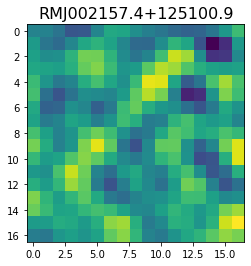

 10%|▉         | 990/10099 [01:14<08:10, 18.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-18.362036  -27.610186   -2.7353263  27.99949    24.057877  -13.557932
 -43.011772  -40.28544   -28.963564  -37.76801   -57.198788  -62.289753
 -53.611336  -45.770573  -36.128754  -18.633204  -10.545901 ]


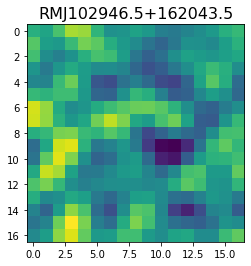

 10%|▉         | 993/10099 [01:14<09:25, 16.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 508.1949    274.42313   -10.323585  -47.7076    -31.706509 -124.72616
 -158.27097   -41.170437   50.012577   13.595427  -38.24952   -14.128997
   74.83025   205.8003    307.23608   264.3842    102.44266 ]


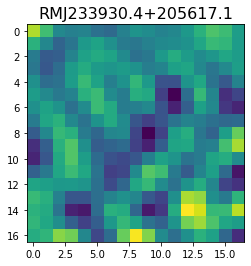

 10%|▉         | 996/10099 [01:15<10:05, 15.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -15.214644  -87.0325   -132.29527   -50.315845   73.08588    72.43795
  -27.653046  -54.060314   25.70893    78.84754    68.99559    98.644516
  160.37405   102.60362   -79.66078  -162.70668   -21.282572]


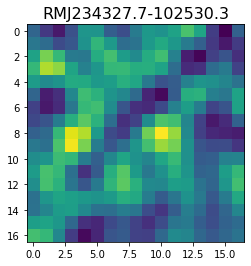

 10%|▉         | 1000/10099 [01:15<10:02, 15.11it/s]

<class 'pixell.enmap.ndmap'>
[ 1.04923355e+02  8.64332886e+01  6.90694199e+01  3.98594475e+01
  4.97593507e-02  2.14912300e+01  1.08012764e+02  1.36026138e+02
  5.28100471e+01 -1.34354086e+01  3.14250698e+01  8.08728104e+01
  1.97764740e+01 -7.53873596e+01 -8.74990463e+01 -5.95988464e+01
 -7.62310486e+01]


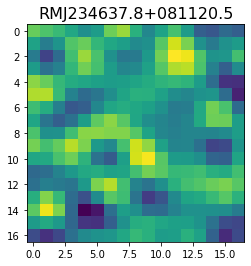

 10%|▉         | 1002/10099 [01:15<11:20, 13.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-36.61634  -46.015743 -46.364624 -45.969875 -46.6067   -43.900642
 -39.82449  -42.71907  -54.078217 -64.46343  -65.66028  -60.445683
 -56.650105 -56.780327 -58.39365  -60.807087 -64.71027 ]


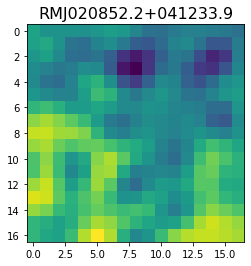

 10%|█         | 1012/10099 [01:15<07:08, 21.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -4.8252144  -38.886497  -100.93819   -136.88995   -143.94368
 -139.14778   -108.50074    -47.689117   -10.498257   -47.85964
 -124.5716    -160.33498   -136.74913   -105.50152   -101.93272
 -106.67367    -92.99921  ]


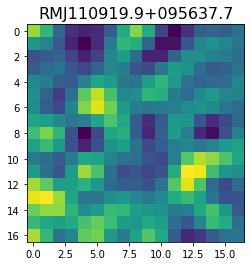

 10%|█         | 1016/10099 [01:16<08:31, 17.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-130.20935  -113.31276  -123.35304  -145.9184   -144.74597  -121.77822
 -104.01655   -98.671455  -98.82423  -104.222374 -106.47978   -86.95628
  -54.50417   -48.096867  -78.39472  -104.74977   -93.23845 ]


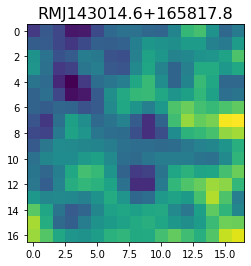

 10%|█         | 1022/10099 [01:16<08:08, 18.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 39.021942   21.91336    68.47286   110.71272   111.229485  130.1469
 185.13213   169.55704    35.3245    -68.032234   -2.1462948 123.14297
 115.26061     7.709983  -16.4747     59.27769    87.54285  ]


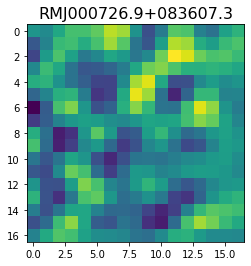

 10%|█         | 1025/10099 [01:16<09:04, 16.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -62.518646  -11.996068  -15.6142    -61.114933  -90.26203   -98.038635
 -128.7498   -169.26936  -158.76965  -114.16357  -121.68282  -189.73558
 -237.61708  -238.8372   -237.77884  -221.69133  -135.57065 ]


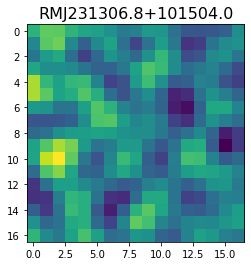

 10%|█         | 1027/10099 [01:17<10:34, 14.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -58.415367  -42.254757 -109.322624 -201.74551  -201.93892  -113.26079
  -59.673927 -100.87044  -150.82349  -112.893456  -14.328376   42.3681
    8.590037  -76.954956 -149.34592  -168.83795  -130.00507 ]


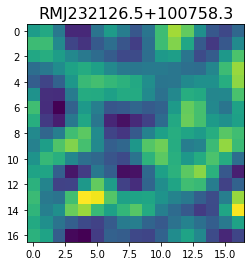

 10%|█         | 1029/10099 [01:17<12:05, 12.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-40.12927   -36.682743  -20.531387   -2.4207962  -5.596149  -34.915443
 -67.94876   -81.63607   -70.3329    -38.342686    1.5555022  22.493711
   4.860165  -33.635822  -56.78979   -59.648018  -68.13319  ]


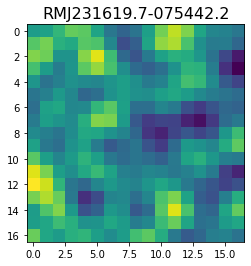

 10%|█         | 1032/10099 [01:17<12:19, 12.26it/s]

<class 'pixell.enmap.ndmap'>
[  1.3021758  62.112816   86.35585    22.154516  -44.59721   -26.093525
  17.805767  -12.630434  -72.28302   -44.87047    46.095943   63.596832
 -22.762945  -99.26891   -92.453354  -48.026253  -16.013588 ]


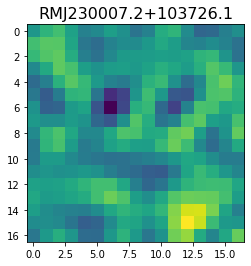

 10%|█         | 1034/10099 [01:17<13:33, 11.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-179.53722  -117.10059  -117.24957  -173.1287   -207.48807  -187.11679
 -160.3363   -171.07152  -192.17738  -179.58841  -150.62172  -154.26659
 -183.2125   -177.42126  -120.211716  -72.701454  -88.08907 ]


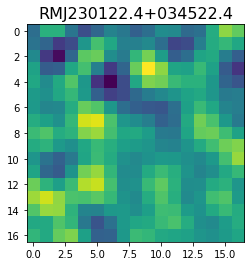

 10%|█         | 1039/10099 [01:18<11:24, 13.24it/s]

<class 'pixell.enmap.ndmap'>
[ -53.430054  -52.052834  -42.357     -33.00546   -43.369328  -64.785774
  -72.06539   -67.82227   -76.05858   -95.821526 -101.12554   -86.362816
  -74.06138   -76.303894  -83.55095   -92.667366 -111.5248  ]


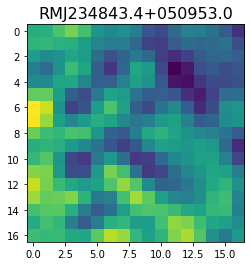

<class 'pixell.enmap.ndmap'>
[ 21.67299     5.519168    4.2027326  29.653603   43.86295    14.308075
 -29.574223  -37.347687  -13.127109   -1.486494  -12.435317  -14.506325
   1.7470819   8.81922    -1.9566522  -1.319024   23.651264 ]


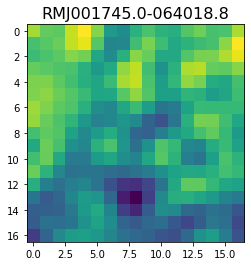

 10%|█         | 1041/10099 [01:18<15:31,  9.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.49454    -3.8721118   4.848838    4.05873    10.001106   27.529314
  29.008852    1.6065788 -24.43134   -22.29803    -8.798204  -11.412119
 -25.328047  -30.25364   -26.837564  -30.791765  -44.460083 ]


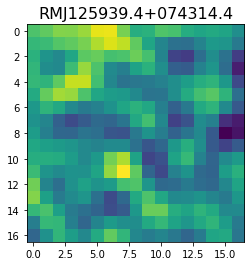

 10%|█         | 1044/10099 [01:18<14:54, 10.12it/s]

<class 'pixell.enmap.ndmap'>
[ -97.92599   -55.26833    13.154114  -19.489693 -115.662674 -131.57486
  -69.54044   -56.576122  -97.51215   -74.73046    13.772193   40.429115
  -20.613358  -63.00941   -56.808704  -74.175995 -100.652534]


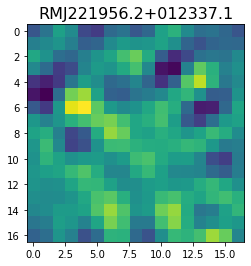

 10%|█         | 1046/10099 [01:19<16:03,  9.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[193.49284  159.93932   67.28364   45.853127 115.59554  154.91615
 101.44161   53.677418  93.50231  145.25316  126.28104  104.8009
 162.55037  218.93463  161.7833    58.854412  57.53878 ]


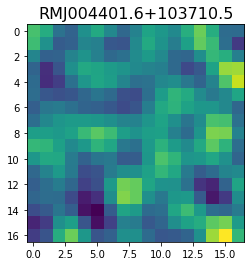

 10%|█         | 1048/10099 [01:19<16:39,  9.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -51.523853   -64.14575   -114.86015   -114.23605    -36.811253
   50.962605    81.32597     47.666153    -9.906317   -45.980057
  -46.818577   -38.139885   -43.627594   -47.999474   -29.033957
   -3.8136842   -2.5725725]


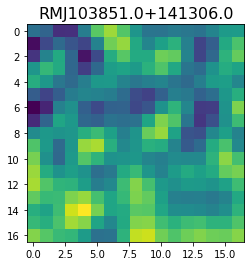

 10%|█         | 1059/10099 [01:19<08:02, 18.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  0.27708003  24.06341     -0.6241601  -40.407284   -38.58246
  -6.539643    10.688938    11.251658    17.171627    16.798326
 -15.218756   -62.1354     -76.932884   -44.65463     -1.295218
  14.565142     9.186255  ]


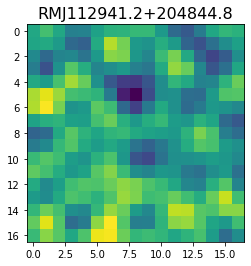

 11%|█         | 1063/10099 [01:19<09:08, 16.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -3.5322788  23.745892   59.321774   78.412865   90.6677    111.82735
 117.25508    80.77914    43.156948   67.71829   132.95755   153.27782
 113.369385   89.9974    118.95517   138.37862   106.07235  ]


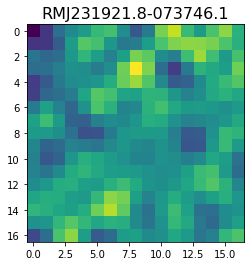

 11%|█         | 1066/10099 [01:20<09:47, 15.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 75.24139   96.81526  130.84297  127.419914  90.75666   79.642876
 116.94327  147.20177  121.10091   75.313156  73.024506 102.95422
 107.31656   85.619095  91.08917  130.87155  150.07422 ]


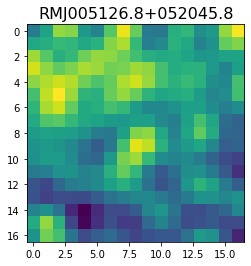

 11%|█         | 1068/10099 [01:20<11:03, 13.62it/s]

<class 'pixell.enmap.ndmap'>
[ 81.102234  79.42004  108.39381  126.92781  114.27374   93.203384
  89.240715  93.91727   84.65231   62.972664  52.404373  65.50448
  89.825935 104.90665  101.142876  82.14902   58.57688 ]


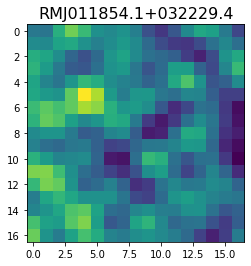

 11%|█         | 1070/10099 [01:20<12:50, 11.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 95.37817   64.306496  48.752094  55.875996  70.15339   88.80609
 111.73551  117.85126   92.51368   61.80274   57.843464  64.970764
  46.67456   15.582576  21.87028   67.107666  87.93769 ]


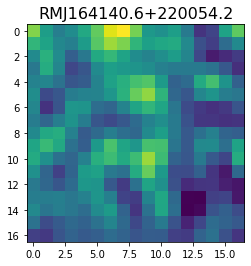

<class 'pixell.enmap.ndmap'>
[ -68.88515    -88.38967   -120.4011    -145.02293   -163.26003
 -172.1637    -153.57132   -103.892105   -53.6874     -37.5953
  -52.758224   -63.411823   -44.521175    -6.5873294   22.914276
   25.864307    -2.0320697]


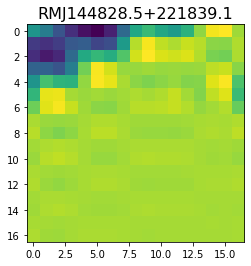

 11%|█         | 1072/10099 [01:21<18:36,  8.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 78.07342    64.46702   112.39931   142.21268    88.0215      6.3239536
  -2.0589583  55.396854   81.326965   43.61105    14.262097   47.349022
 106.086815  133.85362   129.35468   122.53902   122.26509  ]


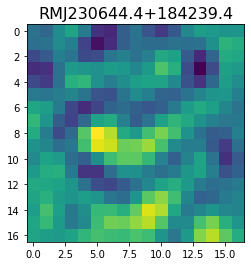

 11%|█         | 1076/10099 [01:21<15:52,  9.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -78.87661   -81.43448  -101.620255 -125.80436  -130.42392  -118.57642
 -111.567375 -114.59442  -107.02788   -71.3743    -24.23781    -2.81621
  -16.640955  -34.57359   -35.062622  -42.758343  -85.12136 ]


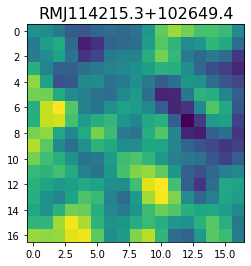

 11%|█         | 1081/10099 [01:21<12:54, 11.64it/s]

<class 'pixell.enmap.ndmap'>
[ 33.010136  13.37441   46.81806   85.482315  75.522575  53.198162
  66.0341    78.13189   59.73403   65.272606 109.52198   98.89381
   8.116417 -28.679426  63.6626   153.70905  112.58391 ]


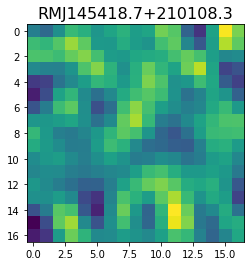

 11%|█         | 1083/10099 [01:22<14:09, 10.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-181.70042  -181.34273  -174.50172  -160.35492  -128.67635   -89.75913
  -69.41008   -75.32805   -93.825    -111.86898  -121.340546 -116.34052
 -104.378006 -101.86025  -107.58962  -105.348976  -97.12066 ]


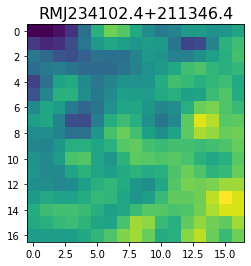

 11%|█         | 1085/10099 [01:22<15:21,  9.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-109.71375   -193.2862    -195.55418   -109.10599    -38.871258
  -76.40351   -160.4979    -158.70427    -69.94287    -30.585594
 -107.36531   -197.50858   -178.54103    -72.52407     -4.8470383
  -48.079895  -154.45105  ]


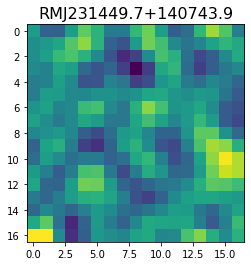

 11%|█         | 1089/10099 [01:22<13:25, 11.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 94.84467   46.623676  34.3228    82.69359  127.666824 127.73354
 115.9637   120.568695 119.73342  102.28415   96.42032  111.24353
 116.674805 102.81451   98.56149  115.52829  129.46764 ]


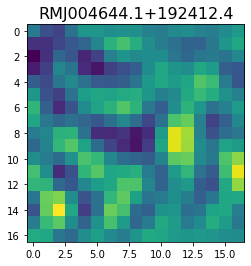

 11%|█         | 1091/10099 [01:22<14:09, 10.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-53.096508 -38.46459    9.497916  32.429688   4.095104 -30.003593
 -25.926882  -4.787673  -6.103715 -23.480019 -30.566317 -33.606483
 -51.419147 -70.962944 -67.97004  -52.059887 -51.20809 ]


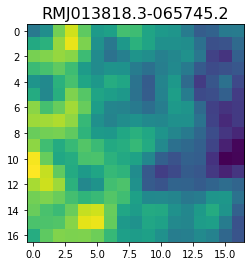

 11%|█         | 1099/10099 [01:23<09:37, 15.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  14.822231   64.9492     27.10078   -49.684273  -71.19671   -25.066696
   20.378563   28.49683    30.389137   41.209118   18.033798  -60.679836
 -132.82784  -125.81147   -59.62715   -21.02579   -47.102856]


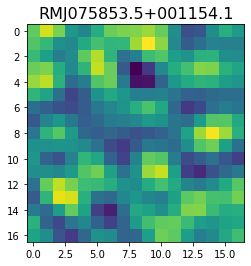

 11%|█         | 1102/10099 [01:23<10:52, 13.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -98.830284 -156.43192  -195.96103  -170.99638  -108.42717   -79.49447
 -108.080894 -144.77855  -145.24611  -131.2236   -141.23412  -159.11284
 -142.00638   -97.54371   -77.07372   -97.697784 -123.28942 ]


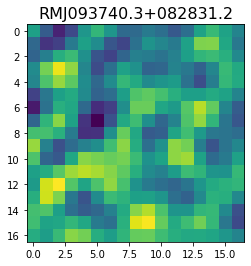

 11%|█         | 1105/10099 [01:23<12:04, 12.41it/s]

<class 'pixell.enmap.ndmap'>
[10.6466255  4.2701397  8.284358  16.327951  25.27763   40.379787
 58.74811   63.272346  44.96509   20.303709  11.32015   16.430824
 18.687887  16.734798  24.389963  39.895927  42.09356  ]


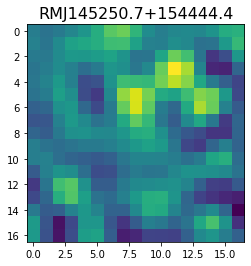

 11%|█         | 1107/10099 [01:24<13:26, 11.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[122.25982    62.754745   -4.785379   20.61737    65.90777    45.244236
  11.329202   30.620953   48.007572    1.8235958 -43.1589     -5.7966576
  63.73428    69.99966    27.928131   16.31326    40.823013 ]


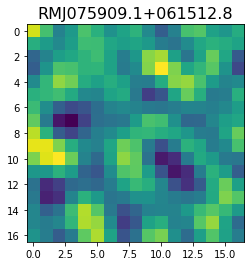

 11%|█         | 1109/10099 [01:24<14:29, 10.34it/s]

<class 'pixell.enmap.ndmap'>
[ 54.824867   36.13195    36.78468    35.770523   -3.7290874 -35.848633
   6.4750767  76.69742    70.97533     1.087953  -23.497854   21.573143
  45.685818    5.4549456 -27.750654    7.3238597  67.36954  ]


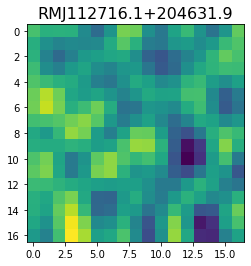

 11%|█         | 1111/10099 [01:24<15:10,  9.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.17249     24.188787    25.469122    20.481709    14.058084
  -0.44568667 -14.541919    -4.127735    26.105204    36.287132
  10.46226    -16.499565   -14.150571     1.0295622    5.1573358
   8.781647    26.490202  ]


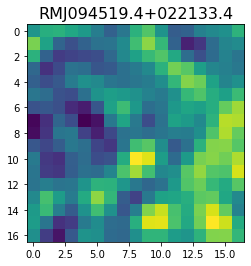

 11%|█         | 1113/10099 [01:24<15:56,  9.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -67.937126   -43.381393   -94.385895  -102.263695   -36.58015
   16.893553    14.339729     2.1861997    5.2446995    4.228401
   21.834702    90.         135.16702     43.57333   -145.47856
 -246.28922   -160.77011  ]


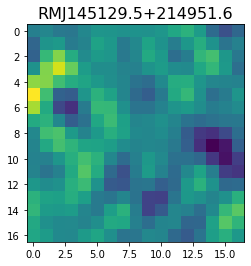

 11%|█         | 1118/10099 [01:25<12:27, 12.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 64.40147   50.729267  77.98455  119.18193  103.489716  40.059814
  10.696968  42.532425  80.09638   87.65373   89.7005    98.79218
  89.2202    62.398716  61.598225  97.13133  122.21363 ]


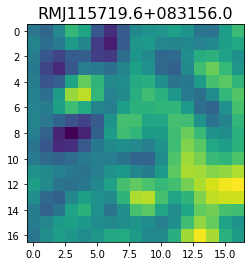

 11%|█         | 1120/10099 [01:25<14:06, 10.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -79.2851    -80.63075   -88.17421   -91.071945  -81.52444   -65.0592
  -58.051777  -72.404015 -100.82327  -119.64477  -111.8937    -88.57334
  -79.60664   -98.58583  -124.49783  -128.31795  -110.8005  ]


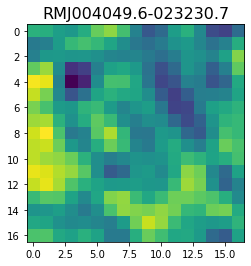

 11%|█         | 1123/10099 [01:25<14:15, 10.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-5.23045425e+01 -3.61879611e+00  4.26178780e+01  2.02535534e+01
 -3.19682636e+01 -3.61549149e+01 -1.98823094e+00  3.98913217e+00
 -1.89717522e+01 -1.30602036e+01  2.38754044e+01  2.95924053e+01
 -1.35162325e+01 -4.72099838e+01 -3.16682510e+01  1.07462155e-02
  4.40645885e+00]


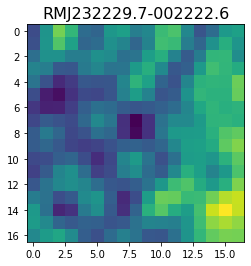

 11%|█         | 1126/10099 [01:25<13:42, 10.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -73.8297    -28.635145  -54.370827 -100.74842   -65.28496    42.80553
  115.01084   110.586555   88.77257    72.34627    19.851171  -47.334484
  -38.943783   40.01853    64.98969    -7.620845  -55.987118]


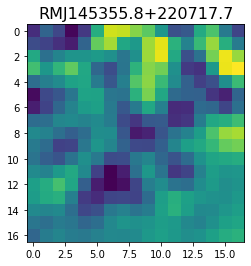

 11%|█         | 1128/10099 [01:26<14:35, 10.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-428.61005 -349.84155 -372.2893  -352.34995 -261.58008 -314.19315
 -532.5459  -591.2721  -334.62686  -95.26981 -214.24164 -518.3937
 -587.96924 -370.22324 -217.33035 -351.05606 -568.6623 ]


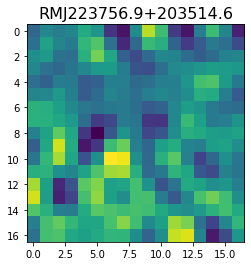

 11%|█         | 1132/10099 [01:26<13:07, 11.38it/s]

<class 'pixell.enmap.ndmap'>
[-137.56529  -142.38814  -120.81861   -97.64537  -101.75284  -125.21268
 -138.67499  -133.03319  -120.23811  -106.00767   -90.69086   -87.314545
 -107.9143   -136.52538  -144.47214  -130.73859  -120.732544]


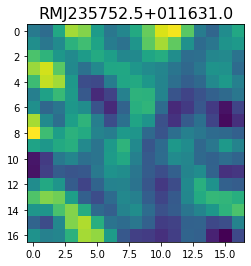

<class 'pixell.enmap.ndmap'>
[ -55.289055 -118.791595 -134.21715  -127.18432  -166.69447  -190.28831
 -113.64611   -23.869633  -53.345634 -143.83786  -143.3087    -61.61318
  -29.68912   -69.97126   -94.48065   -80.77519   -86.529434]


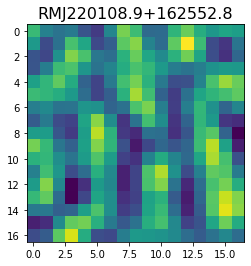

 11%|█         | 1134/10099 [01:26<18:26,  8.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -43.395542     9.846826   -64.16221   -183.40837   -169.71777
  -47.849274    14.5831375   -3.1588328   21.895235   105.590675
  126.862076    41.31453    -52.819965   -73.56873    -48.946438
  -35.700165   -37.87403  ]


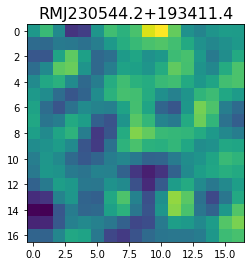

 11%|█▏        | 1137/10099 [01:27<17:12,  8.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -91.3125   -176.07936  -151.92992   -81.713905  -93.981445 -168.24164
 -172.02245   -86.855446  -29.938036  -47.406105  -56.434406  -18.836393
   -5.841531  -46.967453  -69.92965   -42.92733   -32.966797]


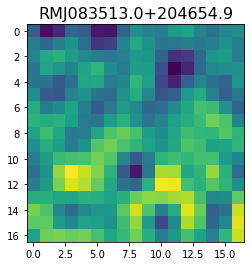

 11%|█▏        | 1139/10099 [01:27<19:02,  7.84it/s]

<class 'pixell.enmap.ndmap'>
[ 39.112827  55.84545   40.388706  76.62617  148.22388  132.76736
  56.48575   74.069756 168.16695  163.12143   53.342014  17.647276
  93.186134 127.495766  72.390594  55.084908 128.86337 ]


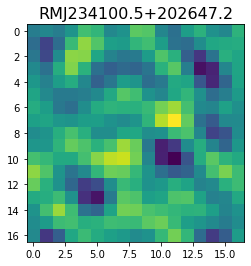

 11%|█▏        | 1140/10099 [01:27<21:43,  6.87it/s]

<class 'pixell.enmap.ndmap'>
[ -19.718838 -105.47862  -199.10701  -201.83266   -97.803406  -10.873901
  -54.029545 -158.15387  -156.47145   -26.596956   73.07612    31.75619
  -67.52053   -90.345085  -42.504845  -28.750246  -78.81405 ]


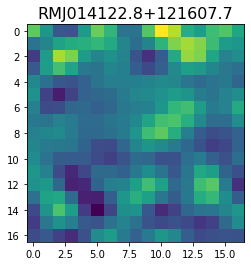

 11%|█▏        | 1141/10099 [01:27<23:26,  6.37it/s]

<class 'pixell.enmap.ndmap'>


 11%|█▏        | 1148/10099 [01:28<10:06, 14.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 31.33331     32.317905    11.395941    16.581495    62.866787
  96.275856    63.869537   -12.191117   -64.35731    -63.78221
 -40.608967   -29.00702    -26.459143   -15.515825    -0.56626284
  -1.2213627  -15.80614   ]


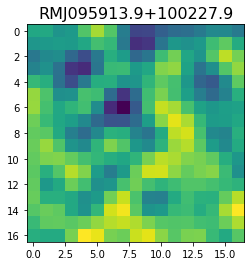

 11%|█▏        | 1151/10099 [01:28<10:50, 13.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 37.667274   13.290789  -50.246513  -54.719658  -23.18298   -27.299774
 -51.07875   -43.542942  -25.320406  -37.795605  -50.88379   -15.1283245
  39.659595   40.39233   -15.563323  -50.699734  -17.456884 ]


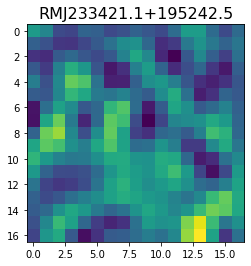

 11%|█▏        | 1157/10099 [01:28<09:31, 15.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-69.54981     7.4550085  97.30632    48.251633  -67.24893   -93.50753
 -19.177324   55.325623   77.34389    60.501945   18.855576  -26.208494
 -30.740057   10.438395   37.722195   13.366731  -17.995733 ]


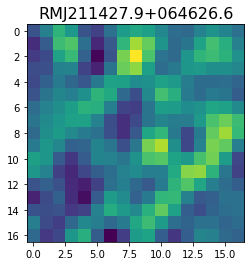

 11%|█▏        | 1160/10099 [01:28<10:23, 14.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 75.376045  81.286285  80.48954   70.45066   64.26411   75.46525
  97.41274  106.23773   86.31426   51.38408   36.319805  60.886993
 102.0863   114.61705   83.93097   44.815754  37.055325]


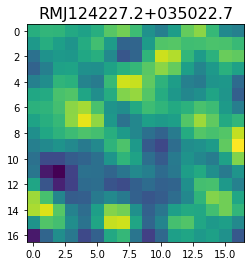

 12%|█▏        | 1162/10099 [01:29<11:59, 12.42it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -97.228195   -76.646       -3.1560535   14.544618   -61.48595
 -152.66768   -178.75052   -150.74371   -125.26712   -119.56744
 -110.13397    -86.493484   -67.564186   -70.86803    -90.80347
 -109.93862   -117.95514  ]


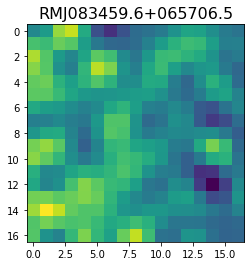

 12%|█▏        | 1164/10099 [01:29<13:19, 11.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -0.15519401   0.2515953    2.2364988   -1.6358218   -6.271637
  -2.0159214    1.5441362   -2.854857    -0.42812875   5.266631
 -14.086028   -37.494923     0.7337664   85.48911    110.04413
  44.81802     -8.676862  ]


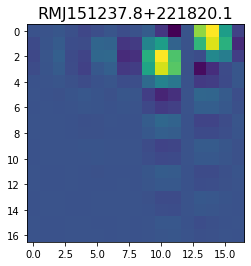

 12%|█▏        | 1169/10099 [01:29<11:19, 13.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-39.313316 -40.806576 -27.598818 -27.89357  -43.54577  -48.279755
 -38.190884 -41.64141  -64.503044 -71.05596  -44.392303 -20.054245
 -26.551533 -38.4137   -28.73966  -22.019375 -44.62691 ]


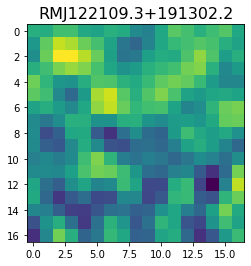

 12%|█▏        | 1178/10099 [01:30<07:28, 19.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -48.29749   -79.709724 -123.84436  -133.05423   -89.38244   -33.514153
  -21.691584  -62.297062 -109.11442  -113.06906   -71.07763   -27.76671
  -33.23121   -91.4308   -149.81569  -154.19652  -113.567825]


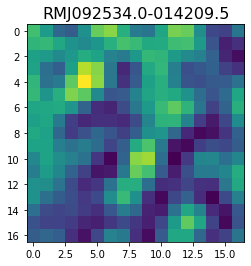

 12%|█▏        | 1182/10099 [01:30<08:06, 18.33it/s]

<class 'pixell.enmap.ndmap'>
[ -24.783197   -100.66964    -141.50174     -94.82116      -0.9442559
   50.315212     33.639713      5.5604186     9.206528     23.056955
   17.505615      0.16206534  -21.54234     -63.33791    -112.13577
 -107.790855    -28.907084  ]


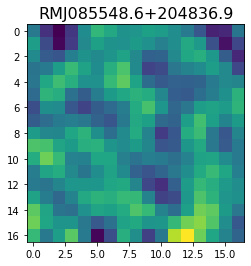

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-3.3466164e+01 -1.5019131e+01 -2.6908525e+01 -6.4317924e+01
 -7.5871407e+01 -3.0520466e+01  2.6925240e+01  2.4708260e+01
 -3.7235462e+01 -8.3005333e+01 -6.3779396e+01 -1.7128649e+01
  2.8512541e-02 -7.9661865e+00 -1.6648723e+00  2.0545246e+01
  2.5758972e+01]


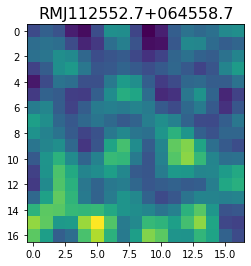

 12%|█▏        | 1185/10099 [01:30<12:07, 12.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-205.77333 -113.40575  -50.74105  -87.60692 -166.86304 -203.63144
 -204.96547 -217.68066 -227.30191 -197.50336 -160.12224 -174.58745
 -226.27122 -246.78139 -219.69513 -194.07722 -198.85316]


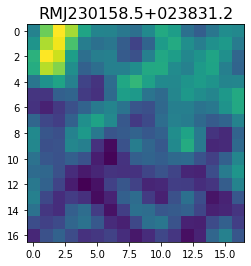

 12%|█▏        | 1187/10099 [01:31<13:04, 11.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -94.18072   -82.999374  -74.347984  -76.19093   -75.32583   -68.982956
  -80.02754  -113.98296  -128.9701    -90.42342   -36.445442  -36.356144
  -90.83791  -129.50792  -112.47494   -76.648346  -65.26139 ]


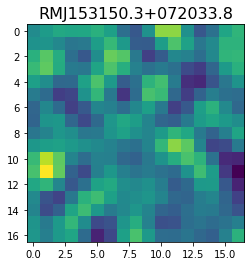

 12%|█▏        | 1198/10099 [01:31<07:51, 18.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  57.787727  -88.07519  -187.65102  -169.80492  -162.13533  -190.63075
 -152.94992   -70.5103    -38.634098   -8.229216   73.01113    57.9566
 -149.82726  -338.62994  -280.30933   -76.40839    35.745655]


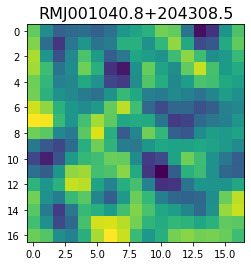

 12%|█▏        | 1202/10099 [01:31<08:23, 17.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 4.3611708e+00 -9.8661003e+00 -3.4447380e+01 -4.4812977e+01
 -4.7613789e+01 -4.7397205e+01 -2.7266426e+01  1.0126229e+01
  2.2947235e+01 -1.1541329e+01 -5.0902168e+01 -4.2093990e+01
  4.4531971e-03  1.4079901e+01 -1.9084166e+01 -5.5925564e+01
 -5.8709267e+01]


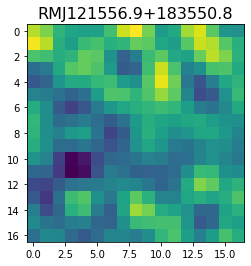

 12%|█▏        | 1205/10099 [01:31<09:13, 16.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-223.10892  -164.1844    -35.28624   -32.142075 -119.54417  -135.16945
 -104.67946  -161.9436   -268.19504  -286.61703  -241.542    -251.31975
 -285.67313  -227.28801  -120.45062  -136.93182  -298.16534 ]


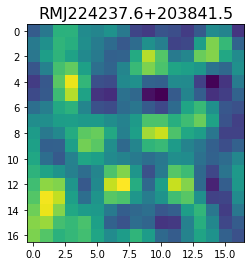

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -62.565792 -176.14366  -225.19955  -185.4272   -123.61179   -85.84392
  -78.12059  -110.86064  -169.81516  -188.58353  -138.47289   -94.30274
 -123.66964  -170.31993  -142.02744   -58.08562   -12.953162]


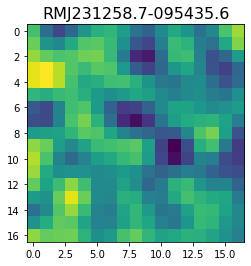

 12%|█▏        | 1215/10099 [01:32<07:46, 19.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -34.53739   -29.837118 -103.20028  -132.55797   -68.75326    -9.178658
  -41.74951  -121.553925 -159.83214  -150.30934  -141.77774  -147.00633
 -142.04034  -118.86804   -92.581314  -80.99901  -101.14812 ]


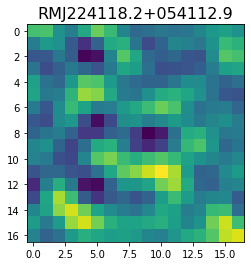

 12%|█▏        | 1219/10099 [01:32<08:16, 17.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[12.608775  27.141777  52.61056   73.35244   67.13482   31.885294
  0.7314656  8.983419  44.277977  55.730106  24.582092  -3.1291888
 20.237295  73.1587    95.047935  71.92684   47.065086 ]


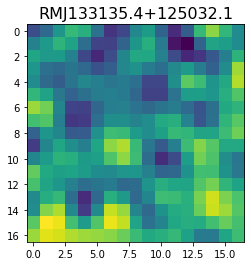

 12%|█▏        | 1224/10099 [01:33<08:05, 18.27it/s]

<class 'pixell.enmap.ndmap'>
[  14.230875  -26.908974  -29.647894   40.464245   98.9381     67.82007
  -20.627275 -109.31631  -193.19417  -240.95245  -172.37999    -8.624604
   85.730415   19.622765  -90.27659  -111.21547   -86.18856 ]


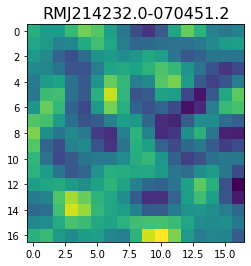

 12%|█▏        | 1227/10099 [01:33<09:07, 16.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -71.64557   -69.14781   -65.47343   -74.85991   -92.03328  -100.914116
  -95.91364   -83.062065  -66.26964   -46.7082    -33.28398   -37.538246
  -54.83278   -64.85416   -57.656563  -47.51846   -51.75359 ]


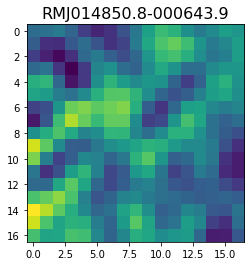

 12%|█▏        | 1232/10099 [01:33<09:02, 16.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 32.528393   76.42762    91.88221    85.129776   47.614227   -3.9860091
  -9.8189125  29.857357   35.18105    -6.472997  -15.157989   10.72238
 -16.524164  -79.505394  -68.229515  -10.049131  -42.85093  ]


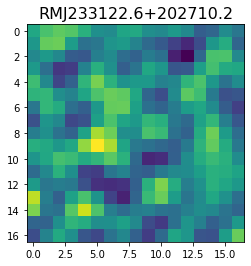

 12%|█▏        | 1235/10099 [01:33<09:39, 15.28it/s]

<class 'pixell.enmap.ndmap'>
[  75.140335  -12.736211 -268.26947  -339.04117  -190.92125   -81.727425
 -123.745285 -194.03842  -204.98427  -197.67276  -204.41466  -205.89717
 -202.12463  -221.54413  -285.68512  -393.6608   -495.6025  ]


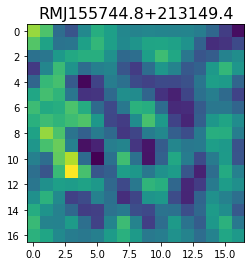

 12%|█▏        | 1243/10099 [01:34<07:21, 20.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[216.18053 198.74855 250.37076 287.255   213.95967  99.35187  90.0431
 180.25977 216.53491 141.10661  79.61702 133.64401 222.11917 220.09335
 149.6665  119.85648 147.92056]


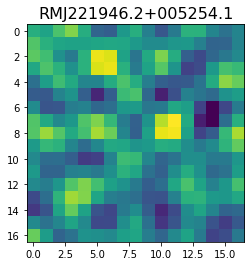

<class 'pixell.enmap.ndmap'>
[-5.9085445  6.113969  41.977257  71.27056   63.617508  29.382442
  2.9765005 -1.6663653  3.2570822  7.0242057 10.390745  13.573115
 13.54788   11.777114  12.471983  15.632453  19.24146  ]


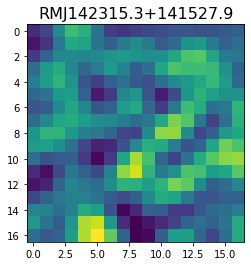

 12%|█▏        | 1246/10099 [01:34<11:02, 13.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -5.9620423 -36.979866   14.523912   54.97105    25.058979  -30.996948
 -51.835938  -42.299957  -43.588604  -65.074005  -79.01514   -64.425735
 -29.756374    3.7823987  20.800854    9.591916  -36.397358 ]


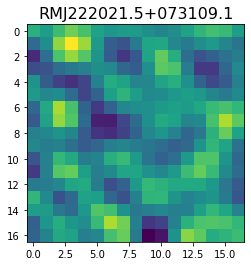

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  1.9695807 -69.89285   -66.082756  -32.9948    -27.85915   -27.88123
  -9.331165   12.46016    47.611725  107.18002   121.16928    31.578693
 -59.237328  -14.285754   96.2385     89.05003   -21.488201 ]


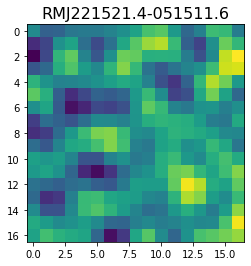

 12%|█▏        | 1249/10099 [01:35<15:18,  9.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -5.7438474  101.71371    138.72934     59.356693   -79.615486
 -148.26912    -77.226906    58.37631    119.05869     58.022396
  -34.263657   -50.153522     8.107138    58.31721     68.85696
   91.18755    153.292    ]


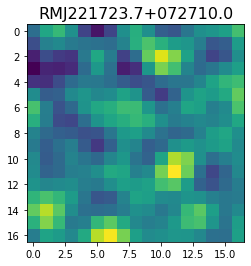

 12%|█▏        | 1254/10099 [01:35<12:58, 11.37it/s]

<class 'pixell.enmap.ndmap'>
[ -3.0442119  -3.4025524  11.1645565  24.722204   17.912577   12.035547
  33.676636   49.49046     8.480586  -53.939423  -43.47153    42.81993
  89.42482    29.19859   -53.736515  -52.53953     9.698445 ]


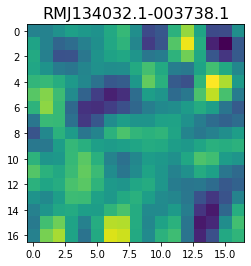

 12%|█▏        | 1256/10099 [01:35<14:24, 10.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-159.75716     8.475405   -8.747389 -148.25264  -196.34297  -127.48582
  -89.770164 -136.56993  -171.89261  -137.82549   -97.17338  -113.27401
 -153.95354  -151.77283  -106.37261   -84.94697  -126.461685]


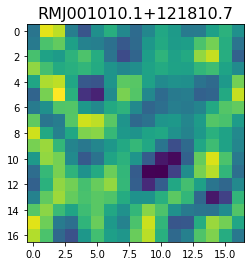

<class 'pixell.enmap.ndmap'>
[127.270325 103.82969   69.68371   63.993427  89.68074  109.34141
  99.615654  77.41931   63.613533  54.301617  43.955837  45.44042
  64.65732   80.571526  74.10873   57.12982   50.94427 ]


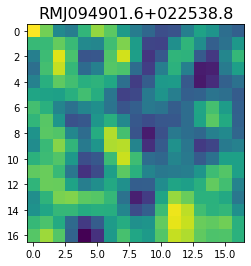

 12%|█▏        | 1258/10099 [01:36<18:55,  7.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -91.7006    -81.21065   -76.471634  -70.09149   -51.172184  -30.777153
  -36.905933  -75.55611  -113.37857  -116.7708    -95.89837   -86.77623
  -97.663376 -101.476425  -80.8599    -51.789803  -35.964123]


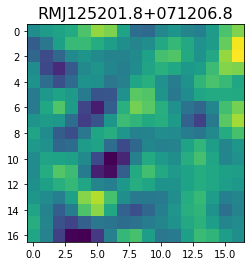

 12%|█▏        | 1260/10099 [01:36<19:00,  7.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[250.45767  239.89969  182.96446  141.79066  152.84053  175.08167
 150.72226   94.633835  72.666336  94.38014   91.83557   31.697624
 -13.835512  37.2856   154.79562  237.57828  247.81322 ]


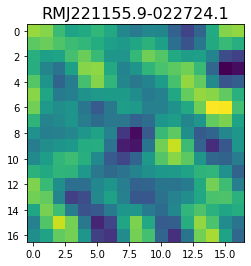

 13%|█▎        | 1263/10099 [01:36<17:14,  8.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-190.28484 -199.48952 -190.94745 -167.10242 -144.59993 -138.60205
 -153.90918 -178.75673 -186.70209 -160.62376 -118.71365 -100.97912
 -124.459   -166.57332 -197.94075 -213.79515 -222.62012]


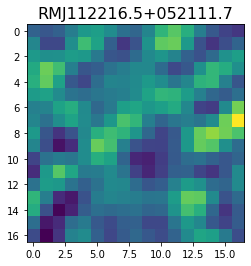

 13%|█▎        | 1268/10099 [01:37<13:20, 11.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 152.56845   112.711044   55.125694   51.247097   83.47759    44.12825
  -61.73262   -75.23837    46.73843   105.7209    -30.434555 -174.25165
  -92.54514   113.341934  158.60799    11.538783  -91.72014 ]


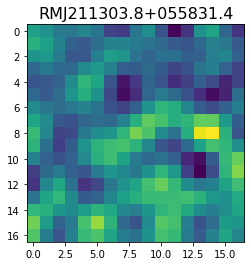

 13%|█▎        | 1271/10099 [01:37<12:53, 11.42it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  85.43046     -2.8938034   -5.8863606   68.99629    152.23962
  135.97244    -39.302326  -269.50357   -332.83734   -157.35384
   56.596165   122.72233    125.02399    193.94139    230.755
  122.86741     20.655298 ]


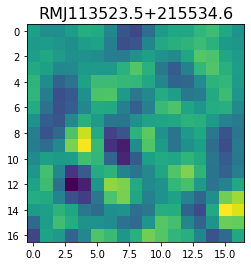

 13%|█▎        | 1276/10099 [01:37<11:24, 12.90it/s]

<class 'pixell.enmap.ndmap'>
[  9.355138   -5.3943486   7.2794     26.510344    7.829754  -47.26049
 -88.76641   -89.057945  -68.10057   -48.14049   -31.277613  -17.881464
  -6.1144986  12.570873   26.105335    4.0161433 -42.994637 ]


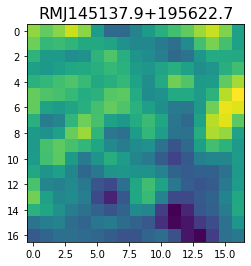

 13%|█▎        | 1278/10099 [01:37<12:47, 11.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -60.363216    -85.49718    -133.60396    -156.38994    -133.43765
  -88.0533      -66.04335     -97.05671    -154.71254    -166.37593
  -95.75457       0.43217605   39.723244     16.010376    -17.124353
  -38.922283    -69.88345   ]


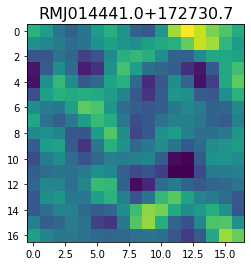

 13%|█▎        | 1282/10099 [01:38<11:32, 12.73it/s]

<class 'pixell.enmap.ndmap'>
[  -1.7057135  -54.602695  -148.8924    -131.98653    -67.26883
  -60.343307   -82.77786    -80.72692    -76.52748    -75.080215
  -39.040516   -13.166319   -92.499954  -226.33324   -246.75421
 -130.07777    -35.260113 ]


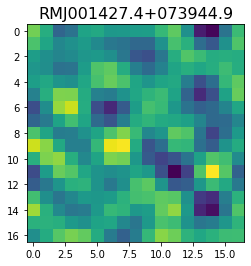

<class 'pixell.enmap.ndmap'>
[-72.4784    -83.79146   -64.280304  -46.35466   -60.508526  -75.42929
 -56.61936   -30.768854  -32.701828  -45.401234  -44.631184  -41.90292
 -41.755447  -23.88331     1.4332232  -5.392024  -34.783188 ]


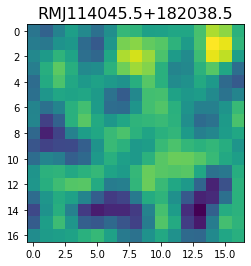

 13%|█▎        | 1284/10099 [01:38<15:29,  9.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -3.9259624   1.7208937   4.37457    15.248974   23.890915   12.86609
 -13.183397  -29.692225  -25.186634  -17.104052  -25.072708  -40.42461
 -39.611176  -22.352129  -13.634365  -24.18234   -32.90804  ]


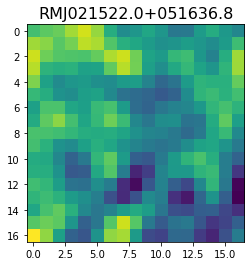

 13%|█▎        | 1289/10099 [01:38<13:18, 11.03it/s]

<class 'pixell.enmap.ndmap'>
[ -38.224728    16.018568    51.335632    20.314108   -32.438667
  -33.943295     6.4095025   15.723536   -23.757225   -49.782864
  -26.061874    -1.0501003  -27.794256   -83.13968   -110.05989
  -97.7162     -74.89608  ]


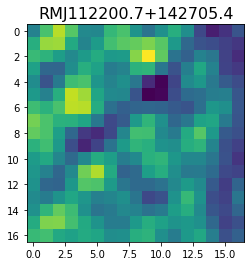

 13%|█▎        | 1291/10099 [01:39<14:07, 10.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-136.79938   -96.51925  -113.79259  -145.10277  -133.42148  -106.76112
 -111.214066 -115.70293   -78.30257   -42.609253  -65.75041  -105.79354
  -86.07528   -27.725737  -15.106122  -60.725655  -99.8375  ]


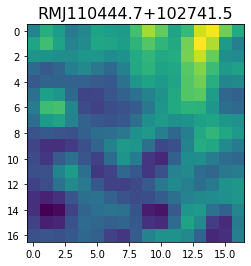

 13%|█▎        | 1293/10099 [01:39<14:46,  9.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -69.054405  -78.855385  -75.43901   -71.68603   -80.42501   -91.61052
  -92.142494  -93.76644  -112.0908   -130.4316   -121.48674   -98.51258
 -102.71037  -137.77979  -160.75941  -148.43736  -131.19717 ]


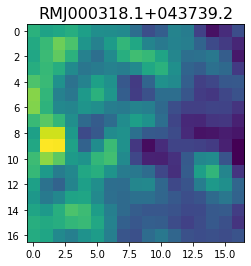

 13%|█▎        | 1295/10099 [01:39<15:23,  9.53it/s]

<class 'pixell.enmap.ndmap'>
[-228.60661 -220.17104 -218.00009 -201.07639 -171.26254 -170.51534
 -209.21416 -237.63953 -227.77379 -211.50891 -206.11678 -189.66975
 -174.95874 -201.58284 -233.90514 -191.59587 -103.73432]


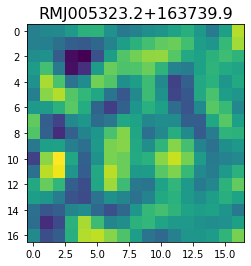

 13%|█▎        | 1296/10099 [01:39<17:40,  8.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 19.04433    83.871704  151.00127    95.74587   -25.985271  -62.527992
   6.7682805  69.95851    64.54238    33.18332    20.72313    26.217052
  48.8962     89.73858   107.547874   52.58297   -45.216057 ]


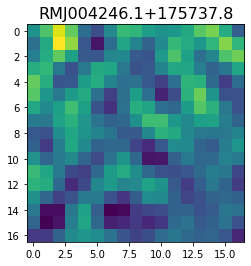

 13%|█▎        | 1310/10099 [01:40<07:02, 20.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 50.020424   -24.772438   -69.97964    -19.236713    12.972936
 -49.4668     -95.02552    -34.37158     36.860626    18.500242
 -34.619144   -42.784473   -21.46713      2.6046689   36.953575
  49.869167     0.87975067]


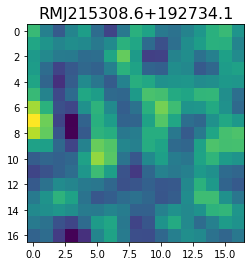

 13%|█▎        | 1313/10099 [01:40<08:08, 17.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -84.531456  -77.8569    -89.83876  -116.89628  -126.50195  -102.10134
  -73.549385  -77.25039  -101.810875 -107.25009   -88.07236   -76.367714
  -83.864876  -85.41641   -69.69955   -63.43251   -84.53878 ]


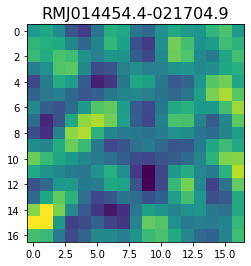

 13%|█▎        | 1324/10099 [01:40<05:41, 25.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


 13%|█▎        | 1331/10099 [01:41<04:23, 33.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[70.55034  69.775055 71.88807  73.89894  72.97214  72.138954 74.36716
 77.00016  76.28739  73.24695  71.7181   73.11887  75.409164 76.363075
 76.55543  78.35278  82.12401 ]


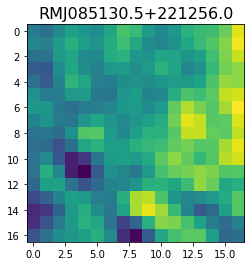

<class 'pixell.enmap.ndmap'>
[-164.34563   -69.98238   -57.154114  -97.72861  -104.24641   -85.2799
 -121.43546  -212.77806  -262.09995  -225.11087  -178.59244  -196.36893
 -237.31023  -220.1054   -155.05661  -127.49763  -173.46333 ]


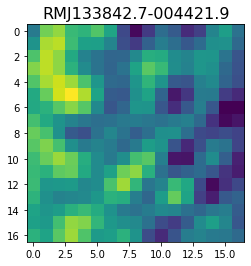

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 55.15056   -14.330334  -22.161842   51.81395    95.4586     22.813663
 -82.76625   -90.06      -22.023848   -4.5258656 -54.175976  -67.054726
  -9.809743   28.81078    -1.5662353 -36.27018   -18.751575 ]


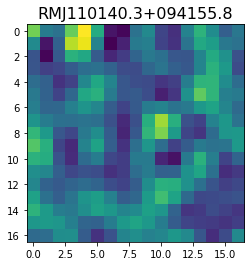

 13%|█▎        | 1336/10099 [01:41<08:50, 16.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-36.969574  -14.082071   19.432676   24.123718    9.316216    9.15026
  16.988445   -3.3309412 -41.810043  -40.61934    10.87043    42.013252
   3.1498823 -54.120766  -56.282913  -20.600851  -16.479788 ]


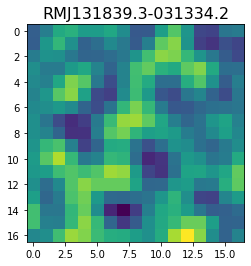

<class 'pixell.enmap.ndmap'>
[168.73134 155.21208 129.66507 141.00237 179.74184 183.27856 136.19507
 102.32835 130.26706 179.24875 181.06621 139.77837 117.68139 138.06944
 158.32475 146.54668 131.17604]


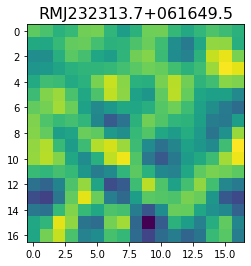

<class 'pixell.enmap.ndmap'>
[  9.302579   -8.090783  -25.74036   -18.68792     7.426226   27.848179
  40.83907    58.531105   68.26582    47.4211      8.78861   -11.741234
  -6.632579    3.5606027  12.417539   27.415043   36.730164 ]


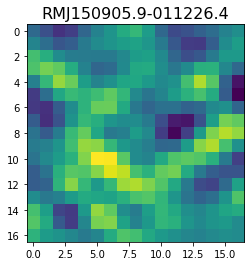

 13%|█▎        | 1340/10099 [01:42<13:04, 11.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-21.445843  -49.42897   -52.51545   -20.400648   -2.0524461 -28.173126
 -62.609337  -62.114998  -40.623276  -36.77065   -49.976894  -49.1439
 -26.967272   -9.462252  -17.012953  -41.426624  -61.207474 ]


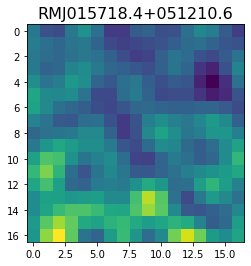

 13%|█▎        | 1343/10099 [01:42<13:37, 10.71it/s]

<class 'pixell.enmap.ndmap'>
[ 50.237988  -19.93213   -25.247425    4.222738    2.9689357  11.982286
  62.893593   68.18281   -18.683784  -84.13687   -31.592833   65.7315
  94.32294    49.68783   -11.149637  -44.75436   -19.73608  ]


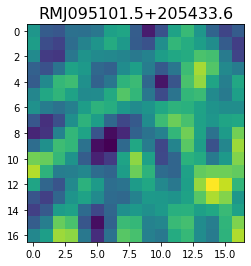

 13%|█▎        | 1346/10099 [01:43<13:15, 11.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 31.83607   23.03042   13.218912  62.02613  111.97977   56.630226
 -58.942562 -89.99993  -27.09089    8.760658  -8.945371  10.380241
  71.991425  70.5261   -10.591354 -58.37361  -22.846325]


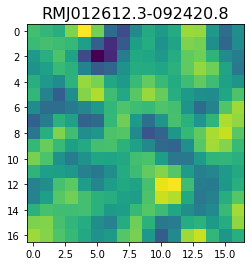

 13%|█▎        | 1354/10099 [01:43<09:44, 14.95it/s]

<class 'pixell.enmap.ndmap'>
[ 35.76793   74.35198  152.94531  129.18031   83.199356 152.05318
 261.38     250.75989  156.11012  140.1643   214.01372  242.85426
 187.5882   145.17491  165.57123  194.14769  191.38019 ]


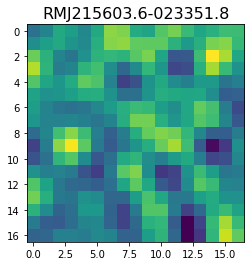

<class 'pixell.enmap.ndmap'>
[ 128.03485    68.9699     12.77295    32.81839    95.29666   123.17898
   86.971344   21.487099  -13.288626   17.560349   82.605354   97.161606
   15.236503  -98.02665  -133.02571   -73.02       -9.447576]


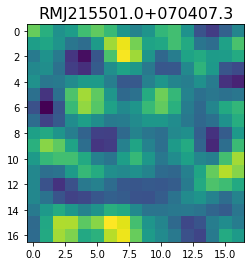

 13%|█▎        | 1357/10099 [01:43<12:23, 11.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 85.507484 125.145065 102.87997   93.799065 139.47275  175.83122
 157.60979  124.70824  111.19738  107.3627   116.051834 135.09132
 115.94788   50.860504  34.038013 117.849106 197.33322 ]


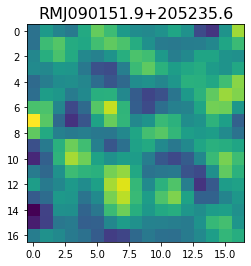

 14%|█▎        | 1364/10099 [01:44<10:11, 14.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-125.071655   50.587475  173.36714    99.700714  -28.15691   -34.902393
   17.77422   -12.441074  -89.54135   -87.40678   -23.198298  -20.44084
  -98.41935  -148.46117  -102.528175  -19.391907    6.224969]


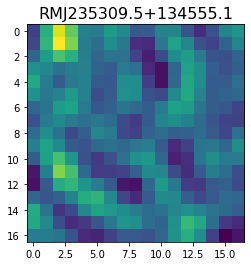

 14%|█▎        | 1368/10099 [01:44<10:22, 14.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[106.42861    47.87989   -36.528503  -41.24393     4.9135237  15.305984
 -12.495036  -31.673077  -45.757004  -70.942764  -71.15479   -26.790903
   3.2856386 -26.018179  -67.801674  -71.90806   -66.72682  ]


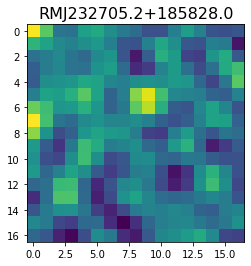

 14%|█▎        | 1371/10099 [01:44<10:56, 13.29it/s]

<class 'pixell.enmap.ndmap'>
[104.94298  141.4437   151.94478  133.3768   123.62533  139.05402
 148.33226  125.66786   92.21939   82.64928  100.4073   127.042755
 150.85818  167.09229  169.82932  160.28891  149.08604 ]


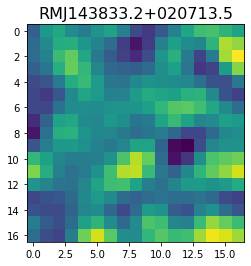

 14%|█▎        | 1373/10099 [01:44<12:09, 11.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.437463   29.897305   18.772587  -11.201082  -36.44762   -44.119873
 -34.239746  -15.966728   -6.6230264 -15.863862  -25.240564   -6.4978747
  30.102716   35.03065   -11.039417  -55.335598  -36.656143 ]


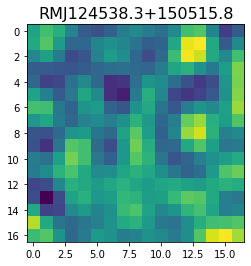

 14%|█▎        | 1376/10099 [01:45<12:42, 11.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[155.73419  153.87715  136.3614   131.65251  142.54906  131.2419
  93.12218   65.649635  55.38184   36.81079   22.972271  49.368904
  92.05637   96.95203   83.64243  115.6014   171.69937 ]


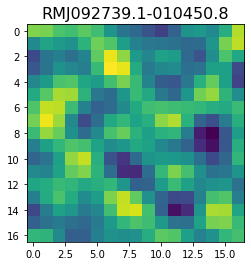

 14%|█▎        | 1381/10099 [01:45<11:01, 13.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-132.46986  -124.13715   -72.75568   -28.377832  -54.335495 -127.10378
 -153.50381   -99.49986   -31.587622  -19.575773  -65.08667  -130.10005
 -173.80707  -166.63031  -123.247314 -103.298645 -132.593   ]


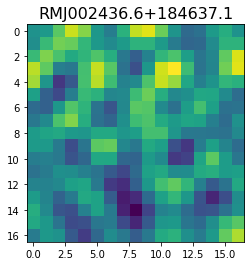

 14%|█▎        | 1384/10099 [01:45<11:51, 12.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.199945  -48.112076  -62.782898    4.8651915 113.95918   172.54515
 127.62141    27.815983  -26.286459    5.701052   69.88659   104.15934
 116.27976   140.1766    151.76936    96.75732    -2.853153 ]


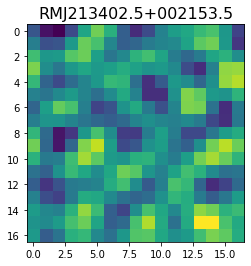

 14%|█▍        | 1389/10099 [01:46<10:38, 13.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 1.4457748e+02  4.8760162e+01 -2.4330559e+01  3.0737002e+00
  5.9348949e+01  7.1087982e+01  6.9583366e+01  8.8584282e+01
  8.8782959e+01  5.3591839e+01  3.9531013e+01  6.6361458e+01
  7.1486420e+01  3.0563728e+01  5.9807854e+00  1.9605787e+01
 -1.1641814e-01]


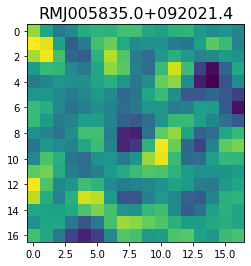

 14%|█▍        | 1396/10099 [01:46<08:47, 16.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 10.100891   18.908585    6.9461455 -15.58353   -18.311115    5.446885
  19.313429   -7.377902  -48.918552  -55.459682  -25.613085   -6.6894665
 -23.126694  -46.30251   -44.955368  -27.913305  -19.307991 ]


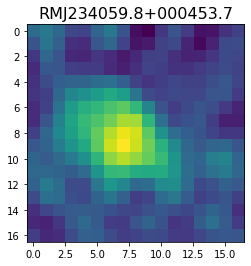

 14%|█▍        | 1398/10099 [01:46<10:43, 13.53it/s]

<class 'pixell.enmap.ndmap'>
[ 17.987246    28.47435     16.543756   -18.43622    -34.120346
   0.36416227  47.767006    43.266186   -10.909224   -40.451168
  -4.565897    41.803005    28.311749   -25.545067   -39.693924
   8.571841    55.876766  ]


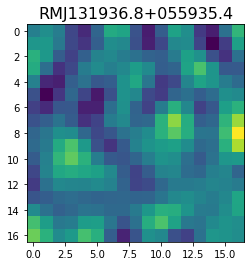

 14%|█▍        | 1400/10099 [01:47<12:02, 12.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 76.40815    58.358475   39.699604   51.653225   74.05473    84.42855
  96.20754   114.63928   108.119804   60.065216    7.9328556  -3.7544312
  19.295595   35.665535   18.820002  -20.6778    -46.01901  ]


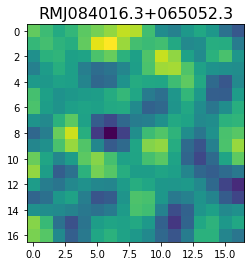

<class 'pixell.enmap.ndmap'>
[ 34.92515    20.946936   67.06379   105.56182   116.69109   134.11299
 151.2065    111.178215    5.97635   -87.13881   -93.019295  -15.14749
  84.364975  135.99986    98.10925    -1.9564053 -62.949375 ]


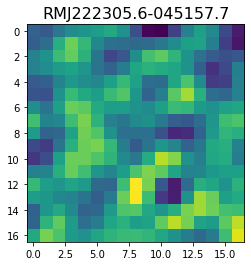

 14%|█▍        | 1402/10099 [01:47<16:20,  8.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 17.154625   29.387049   10.534675  -41.16975   -37.47624    54.63611
 132.50816   102.58357    19.710619   -7.7269697  21.172113   30.431051
   3.602362   -9.953109    4.652357   10.1278715  -8.202489 ]


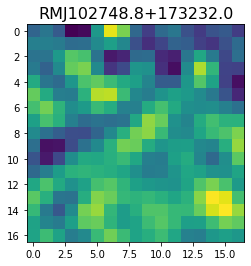

 14%|█▍        | 1414/10099 [01:47<08:18, 17.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 55.250595  32.3536    73.733665 116.23052   99.56238   60.062084
  55.10063   67.44349   54.89707   34.09288   42.333366  63.469463
  59.611893  39.567574  35.194576  41.151684  32.985756]


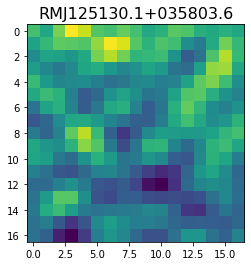

 14%|█▍        | 1417/10099 [01:48<09:30, 15.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-34.467587  -25.116043  -26.516361  -44.004837  -65.45006   -74.87171
 -59.62705   -23.497871    3.5407913  -2.5609655 -20.66356   -14.705373
   6.1254735   5.561415  -13.268993  -16.40112    -3.6795177]


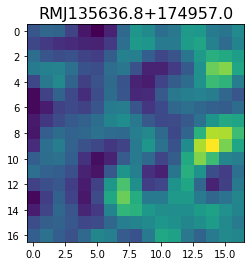

 14%|█▍        | 1420/10099 [01:48<10:32, 13.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[146.47163  139.07446  156.34375  176.52315  171.31332  148.41254
 139.50195  152.24852  161.60284  153.085    146.06451  157.80368
 169.4691   154.77718  126.02794  118.362144 133.88342 ]


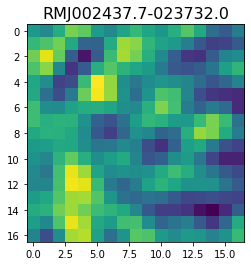

 14%|█▍        | 1422/10099 [01:48<12:31, 11.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 53.382103   18.565603  -11.384318   -5.1482215  27.519583   52.52312
  54.298847   44.676037   38.66166    38.84342    39.823833   35.992825
  27.420916   23.538502   34.74097    57.2248     75.71788  ]


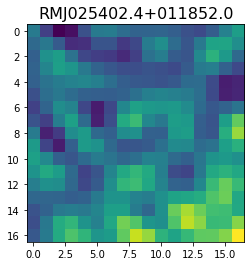

 14%|█▍        | 1428/10099 [01:49<10:31, 13.74it/s]

<class 'pixell.enmap.ndmap'>
[ 12.47849    18.83118    32.104954   52.471367   82.47113    90.25182
  43.277763  -22.618593  -42.256287  -22.238583  -18.278973  -26.838669
  -3.2002466  27.085495   -1.3974333 -56.01619   -35.22509  ]


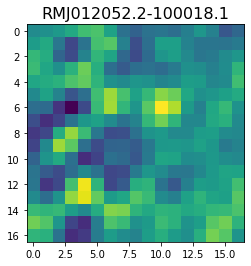

 14%|█▍        | 1430/10099 [01:49<12:17, 11.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[64.42387  85.19966  90.52174  70.76778  44.18226  35.347637 43.162716
 48.841053 51.051834 64.45706  83.06256  81.6033   61.497795 55.76774
 73.95638  83.99687  69.31752 ]


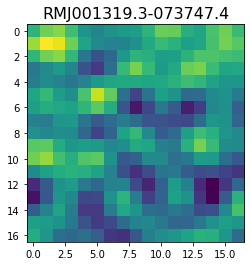

 14%|█▍        | 1435/10099 [01:49<11:11, 12.91it/s]

<class 'pixell.enmap.ndmap'>
[ -71.26198   -89.75686   -79.78677   -94.910545 -144.28319  -150.93019
  -87.35552   -25.671326  -11.813851  -17.767698  -32.756477  -68.3819
  -82.65663   -35.00307    13.214662  -14.239501  -71.7888  ]


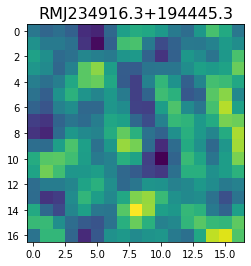

<class 'pixell.enmap.ndmap'>
[ 42.04681  102.08173  179.82982  175.04736  109.45125   88.137054
 116.368034 109.018745  67.3215    74.55593  120.74453  109.71969
  46.310833  40.613625 111.551796 153.5039   120.215515]


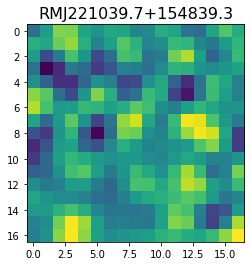

 14%|█▍        | 1443/10099 [01:50<10:10, 14.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 61.822777  82.2324    84.240456  59.505787  12.724819 -25.184725
 -26.34888   11.907048  75.427666 138.25055  160.02444  112.33066
  20.099184 -48.76279  -52.70253  -20.151125  -7.016026]


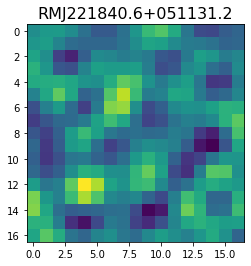

 14%|█▍        | 1446/10099 [01:50<10:56, 13.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -3.5787     17.44366    13.961576  -15.222253  -17.705841    6.9549136
  10.999198  -12.9068775 -38.55569   -57.160065  -50.82447     7.8594227
  73.539024   53.86327   -33.269653  -58.52302    18.202637 ]


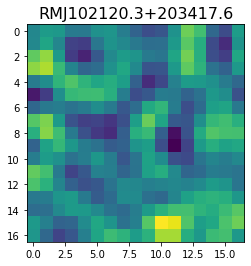

 14%|█▍        | 1452/10099 [01:50<10:07, 14.24it/s]

<class 'pixell.enmap.ndmap'>
[ -26.957155 -100.89756   -42.79383    71.99364    65.94806   -33.57909
  -49.780575   22.070734    8.581072 -130.69945  -231.128    -185.30893
  -72.80926    -4.989751   -6.59469   -54.922913  -97.11224 ]


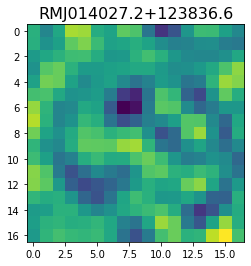

 14%|█▍        | 1454/10099 [01:51<11:34, 12.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 85.107475   86.641624   73.84478    87.36312    94.35106    76.97611
  75.126236   84.43801    48.045685  -11.278164    0.2390904  78.7775
 113.11752    61.76488     0.5226125 -12.296033    4.735441 ]


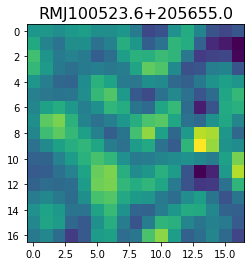

 14%|█▍        | 1456/10099 [01:51<13:12, 10.91it/s]

<class 'pixell.enmap.ndmap'>
[ 79.89962   80.99157  127.89627  186.28162  179.92491   94.841515
  21.06925   41.49096  118.35795  152.22748  122.604706  96.17074
 110.18879  126.53453  110.0733    85.03592   89.74608 ]


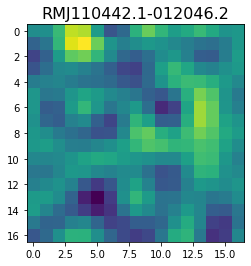

<class 'pixell.enmap.ndmap'>
[36.082684 35.784252 31.052935 29.46946  36.321495 42.274837 42.156464
 46.250343 58.55711  64.70715  57.212177 51.41683  58.841885 65.949104
 59.290173 52.440174 65.722015]


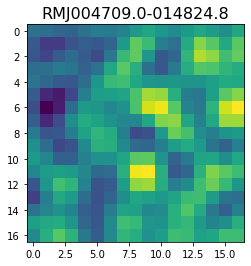

 14%|█▍        | 1458/10099 [01:52<18:22,  7.84it/s]

<class 'pixell.enmap.ndmap'>
[  -7.9074893  -11.036372     0.5690192  -24.303988   -71.20269
  -67.371254   -30.864204   -52.051067  -116.10255   -114.31026
  -38.143288     8.861357    -8.240379   -28.101631   -33.64124
  -61.567383   -91.14238  ]


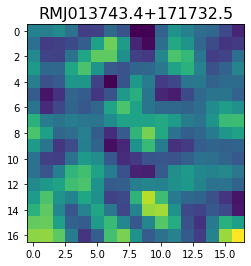

<class 'pixell.enmap.ndmap'>
[  5.705602  34.420254  82.252594  56.983906 -21.146786 -48.4592
  15.238948  99.39209  124.22874   87.6489    40.42055   28.125162
  67.15432  129.18776  146.8996    87.35458   14.539539]


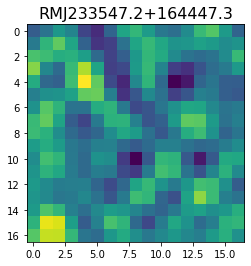

 14%|█▍        | 1460/10099 [01:52<22:27,  6.41it/s]

<class 'pixell.enmap.ndmap'>
[269.11758  234.49976  138.84274  146.22887  216.5739   200.1325
 112.324326 106.02865  205.65755  269.96213  232.84653  197.0451
 237.00175  273.85587  231.81798  178.10356  195.38527 ]


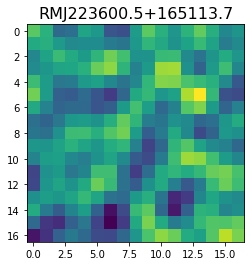

 14%|█▍        | 1461/10099 [01:52<24:10,  5.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-1.46985748e+02 -1.79133972e+02 -1.92106003e+02 -1.21694756e+02
  1.18880653e+01  8.45858688e+01  8.22443292e-02 -1.72600967e+02
 -2.58426270e+02 -1.81083130e+02 -4.42101631e+01  1.31036453e+01
 -2.44090099e+01 -7.50980225e+01 -8.74942703e+01 -7.54083633e+01
 -5.78911819e+01]


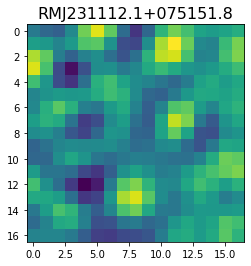

 14%|█▍        | 1464/10099 [01:53<19:27,  7.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.58049  226.4581   231.11168  150.8357   123.68084  175.66264
 222.12846  237.20822  245.68898  218.35904  142.65593  114.862854
 197.98793  282.462    251.83542  178.09984  179.87059 ]


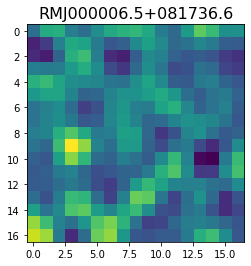

 15%|█▍        | 1467/10099 [01:53<16:53,  8.51it/s]

<class 'pixell.enmap.ndmap'>
[135.32785   71.93859  -50.742058 -56.70107   55.382656 100.923645
  16.405172 -33.681248  47.775257 115.59383   45.991043 -44.709667
 -15.60466   64.19798   68.65066   20.704102 -10.350592]


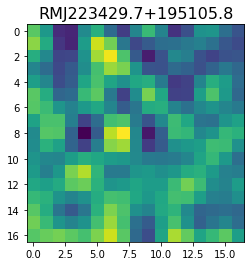

 15%|█▍        | 1468/10099 [01:53<18:56,  7.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-11.146066     6.166713    49.94272     92.20155     96.57455
  46.29084    -11.703744     0.59754646  80.378944   126.802055
  81.965034    17.840784    21.49005     66.93204     79.39274
  61.086582    61.580086  ]


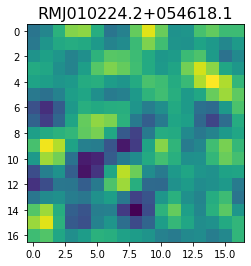

 15%|█▍        | 1477/10099 [01:53<08:45, 16.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 40.34541   109.35025    73.5174    -18.702394  -32.35033    40.3139
  67.61779    -7.35167   -74.28181   -31.390263   58.426105   73.5328
  18.593498   -1.4104707  42.848797   63.842064    2.5458984]


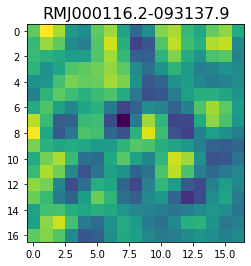

 15%|█▍        | 1480/10099 [01:54<09:37, 14.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-93.25264  -75.62423  -49.194588 -50.134937 -79.701965 -97.37878
 -83.60452  -66.2147   -69.25488  -78.64104  -78.15861  -77.94829
 -84.63164  -81.788956 -64.56179  -57.965233 -75.395615]


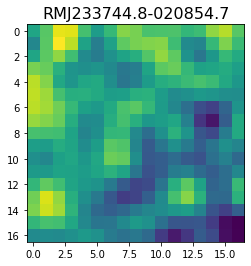

 15%|█▍        | 1483/10099 [01:54<10:50, 13.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 108.42407   152.3223    197.56584   129.09634   -56.089825 -182.3785
  -90.7179    111.20353   150.13863   -17.90222  -117.33561    21.25429
  170.86838    62.746597 -169.30995  -200.56334   -33.998558]


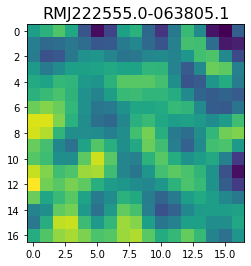

 15%|█▍        | 1485/10099 [01:54<12:50, 11.19it/s]

<class 'pixell.enmap.ndmap'>
[-31.985445   6.032722  14.912842 -13.175193 -40.8629   -37.683327
 -17.74569  -12.136953 -24.532333 -34.66668  -32.960365 -28.96797
 -29.81995  -30.136301 -25.09353  -19.525108 -20.10658 ]


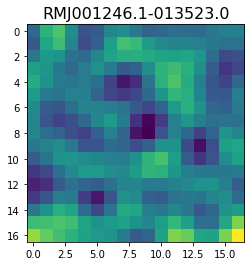

 15%|█▍        | 1487/10099 [01:54<13:39, 10.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-55.803734  -26.624014   17.68382    39.34039    31.464478    9.739444
 -14.853028  -33.018612  -24.666714   19.678165   70.53299    81.371506
  42.946743   -3.9545221 -14.826751   13.279391   46.184917 ]


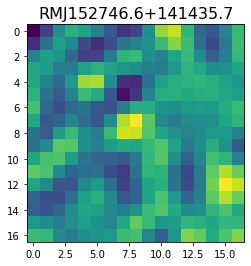

 15%|█▍        | 1489/10099 [01:55<15:29,  9.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-112.70604  -105.55905  -116.40552  -116.927986  -90.15845   -66.07744
  -71.8789    -83.97576   -73.16246   -61.29238   -80.60385  -107.94292
  -98.58105   -63.235176  -51.547478  -72.56691   -89.07764 ]


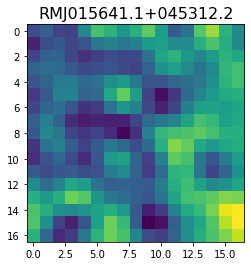

 15%|█▍        | 1491/10099 [01:55<15:47,  9.09it/s]

<class 'pixell.enmap.ndmap'>
[-32.876846 -65.46661  -90.23142  -67.133736 -10.567248  17.769976
  -8.003777 -44.738426 -49.731194 -39.689568 -48.275845 -64.55082
 -58.17118  -38.018967 -36.72642  -52.006954 -51.24637 ]


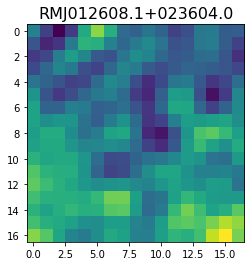

 15%|█▍        | 1493/10099 [01:55<16:16,  8.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-141.312      -82.4552     -46.738262  -115.08321   -190.8102
 -151.86081    -38.393913    24.121326    -3.1611605  -78.360825
 -155.0053    -168.01262    -66.23611     68.88564     82.32277
  -15.490094   -40.07707  ]


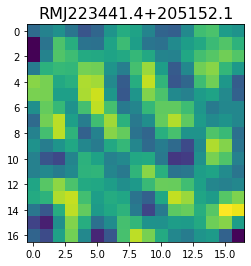

 15%|█▍        | 1495/10099 [01:55<16:57,  8.46it/s]

<class 'pixell.enmap.ndmap'>
[-67.63258   -65.42943   -52.12307   -50.22785   -58.989235  -61.267014
 -51.611877  -37.994843  -25.909515  -16.189402  -10.05244    -6.0865564
  -1.8477149  -3.5006394 -19.204784  -38.427547  -37.272606 ]


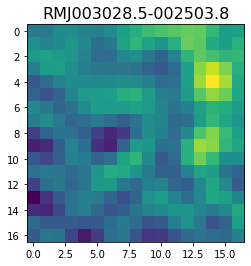

 15%|█▍        | 1496/10099 [01:56<19:48,  7.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 126.53474     133.02785      92.5318       14.294976    -16.601938
   71.03106     187.98686     173.33922      20.731106   -118.73378
 -146.67941    -100.337006    -42.368675      0.78284407    3.309453
  -34.888283    -45.719936  ]


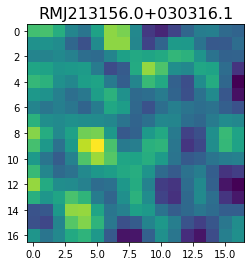

 15%|█▍        | 1507/10099 [01:56<07:57, 17.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-184.55597    -64.6258      12.564573   -21.352404   -79.81955
  -55.789024     8.014938    -7.1595697  -98.64726   -146.72594
 -103.47162    -53.717022   -73.06962   -131.24506   -166.04872
 -166.7037    -147.77618  ]


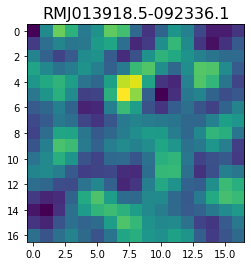

 15%|█▍        | 1510/10099 [01:56<09:04, 15.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  23.879322   19.64135    21.944233  -18.243296 -108.75361  -178.7708
 -153.49075   -71.28565   -58.473537 -154.18732  -239.09438  -200.60605
  -92.36834   -41.222     -61.47613   -73.15096   -59.741173]


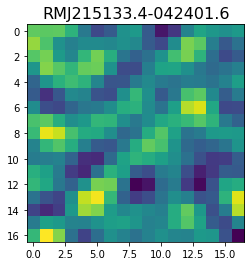

<class 'pixell.enmap.ndmap'>
[-55.5893    -69.002686  -77.366936  -70.23638   -65.85153   -69.718605
 -62.830658  -31.084347   12.769464   39.817318   33.490402    9.004421
  -1.1190434  11.557972   18.103622   -2.7589226 -24.848742 ]


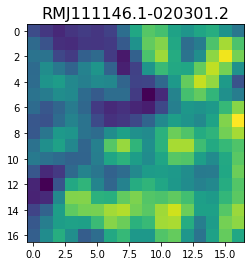

 15%|█▍        | 1513/10099 [01:57<12:27, 11.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[104.60761  236.7573   369.4451   319.18353  146.91614  105.45462
 275.35367  452.4482   446.1962   308.53586  190.43028  131.20847
  94.928986  94.90733  160.71727  247.11772  279.1244  ]


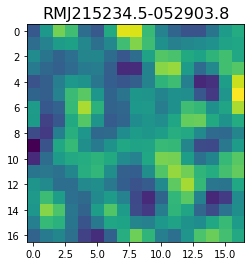

 15%|█▌        | 1519/10099 [01:57<10:16, 13.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-128.62592   -71.490746   17.710033   18.252306  -74.17733  -151.13171
 -143.60193   -91.47041   -58.888916  -55.90854   -66.02222   -90.69106
 -130.66383  -159.41145  -149.52252  -109.67501   -73.00732 ]


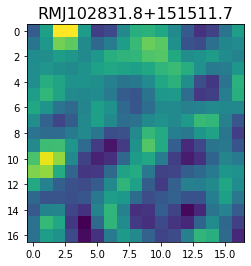

 15%|█▌        | 1522/10099 [01:57<10:42, 13.36it/s]

<class 'pixell.enmap.ndmap'>
[-110.508606 -105.5347   -138.90883  -162.18596  -106.40957   -25.639961
  -30.993912 -119.71296  -187.2747   -178.6121   -130.98416   -97.803825
 -104.12511  -144.86327  -178.7089   -163.0614   -118.05493 ]


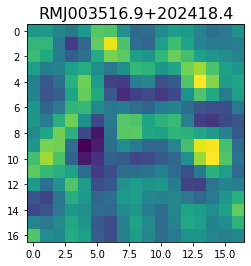

 15%|█▌        | 1524/10099 [01:58<12:17, 11.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 0.00095197  0.00274593 -0.00222597 -0.00316959  0.00391881  0.00304594
 -0.00597849 -0.00223015  0.00841478  0.00048365 -0.01139943  0.00274762
  0.0156291  -0.00933109 -0.02446047  0.03177309  0.10503195]


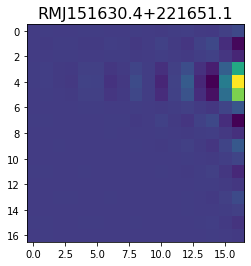

 15%|█▌        | 1532/10099 [01:58<09:09, 15.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  14.660454  -42.782375 -122.58834  -128.66116   -58.42454     0.999424
  -11.710014  -68.88428  -108.06502  -109.037315  -98.40708   -99.729485
 -104.67643   -94.44489   -72.2776    -59.587307  -63.46171 ]


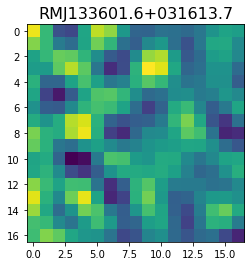

 15%|█▌        | 1538/10099 [01:58<08:38, 16.50it/s]

<class 'pixell.enmap.ndmap'>
[ 44.859585     3.3330998    9.024742    42.903255    39.945274
 -11.875112   -52.457863   -38.729298    -3.855306     0.39578074
 -22.766785   -38.208996   -37.880085   -31.42416    -11.59227
  21.514801    31.969215  ]


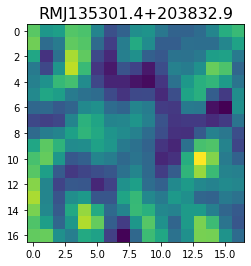

 15%|█▌        | 1541/10099 [01:59<09:37, 14.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.958313  -40.809772  -33.555885  -20.526663  -21.645267  -41.162563
 -59.42245   -58.818684  -43.55868   -26.057034   -8.445616    9.977827
  19.67711    12.867766    1.5175297   4.19366    16.557955 ]


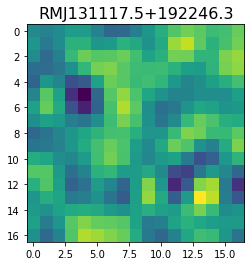

 15%|█▌        | 1543/10099 [01:59<10:46, 13.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -62.80136   -86.96291  -104.072395  -86.58051   -68.858376  -78.66687
  -79.21088   -50.162704  -39.385056  -61.235867  -55.16403   -21.593012
  -59.822144 -180.66734  -236.37517  -145.572     -36.72045 ]


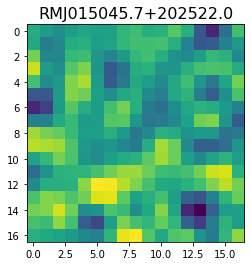

 15%|█▌        | 1545/10099 [01:59<11:59, 11.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -29.087278    21.432709   122.519394   124.37274     11.790046
  -78.39052    -58.383717     1.0557816    3.1532686  -39.413094
  -71.47446    -96.331696  -117.9316     -80.35635     22.074192
   67.64338    -27.237438 ]


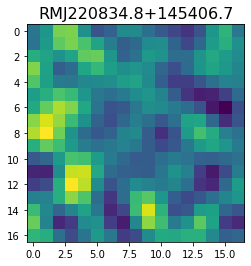

 15%|█▌        | 1547/10099 [01:59<13:19, 10.69it/s]

<class 'pixell.enmap.ndmap'>
[-68.16771  -69.64708  -78.37285  -81.84338  -64.338936 -44.82432
 -53.580578 -83.5356   -99.93705  -90.31247  -74.895836 -73.30893
 -84.79001  -96.053215 -92.71639  -72.80618  -58.534977]


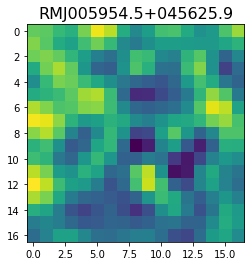

 15%|█▌        | 1549/10099 [02:00<14:29,  9.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[106.4426   108.44447  102.68627   72.684906  53.61748   78.58102
 115.42286  108.17694   66.7899    54.492867  83.795944  92.8182
  48.184704   5.766963  24.328266  71.4988    75.44541 ]


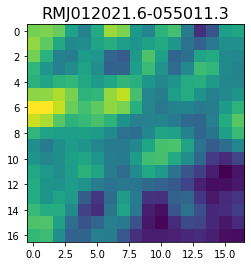

<class 'pixell.enmap.ndmap'>
[ 99.64532  131.68327  131.24779  104.4079   107.01573  126.41661
  93.90821   22.382092  11.947624  88.84736  152.4213   128.75797
  75.054344  73.29117  106.76374  108.76449   70.5832  ]


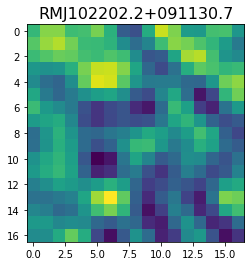

 15%|█▌        | 1551/10099 [02:00<19:09,  7.44it/s]

<class 'pixell.enmap.ndmap'>
[  1.3681964   -1.0711633   -1.9826725    2.706648     3.2375753
  -9.801308   -24.084099   -19.971888    -1.1033353   11.059727
   8.558871     2.128398    -0.24356169  -1.012285    -2.2712932
  -1.5516231    2.710028  ]


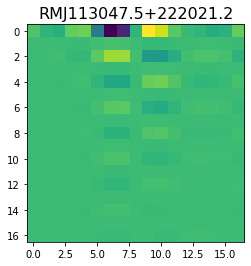

 15%|█▌        | 1552/10099 [02:00<21:01,  6.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[106.52442   105.223404   27.599552  -28.97128     9.142847   89.09087
 110.52536    57.998978   -3.7812529 -27.112583   -8.712797   48.38315
 126.153885  162.04964   106.81792    12.191253  -14.193039 ]


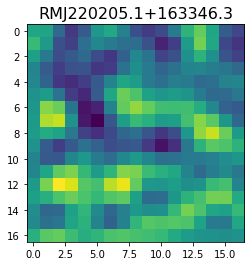

 15%|█▌        | 1554/10099 [02:01<20:23,  6.98it/s]

<class 'pixell.enmap.ndmap'>
[71.013306 79.38896  74.679794 66.82549  70.479836 84.690575 88.574234
 74.01546  61.543438 65.835014 71.37566  63.116695 53.112213 53.66225
 53.34894  44.530975 44.76026 ]


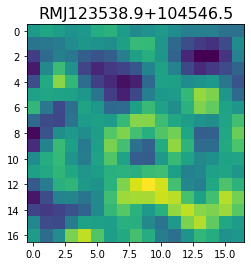

 15%|█▌        | 1555/10099 [02:01<22:35,  6.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -62.408443  -28.595343  -54.28458   -92.52145  -112.15432  -116.89671
 -103.127625  -66.59413   -33.87705   -32.916092  -50.569687  -60.40354
  -63.66055   -66.36535   -55.26639   -33.672447  -35.745106]


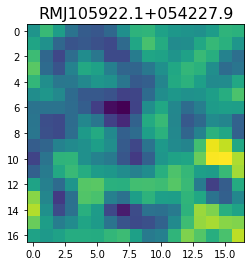

 15%|█▌        | 1559/10099 [02:01<15:54,  8.95it/s]

<class 'pixell.enmap.ndmap'>
[ 50.755196  39.873108  96.42281  146.60777  130.83699   78.78179
  52.62897   74.81876  122.250206 148.78998  119.25004   58.89331
  44.920425 104.994156 161.21695  132.09993   50.4027  ]


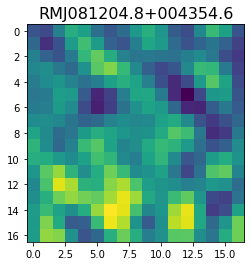

 15%|█▌        | 1560/10099 [02:01<18:07,  7.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -74.324875  -39.690228  -92.91859  -211.34673  -304.66342  -280.64172
 -156.07266   -65.629456  -91.67363  -157.35368  -168.06224  -151.02426
 -157.11148  -154.3368   -127.191574 -136.71501  -176.11172 ]


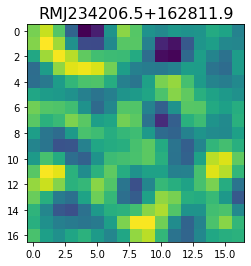

 16%|█▌        | 1568/10099 [02:02<10:50, 13.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 36.750996   26.021196   37.1702     55.830185   64.04625    48.358135
  16.832487   -2.9246445   4.2594867  24.019566   35.05795    30.189472
   9.385779  -22.079203  -41.991642  -30.253586   -9.124169 ]


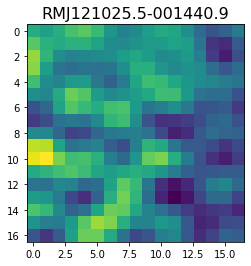

 16%|█▌        | 1570/10099 [02:02<12:02, 11.80it/s]

<class 'pixell.enmap.ndmap'>
[-104.20704  -151.78471  -121.188255  -58.56019   -44.785442  -81.66669
 -108.22776   -95.025116  -78.36112  -102.268814 -155.27284  -184.70358
 -164.50491  -119.84412   -79.89014   -42.445747   -4.111701]


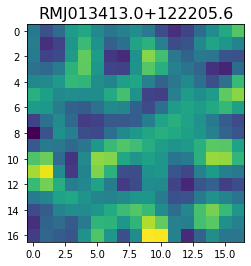

<class 'pixell.enmap.ndmap'>
[ -87.89514   -97.54725   -70.98669   -54.244793  -69.218155  -67.6554
  -19.307991   24.98225     9.889023  -46.417156  -98.492004 -137.0828
 -160.35603  -144.63431   -96.65708   -79.52513  -130.09245 ]


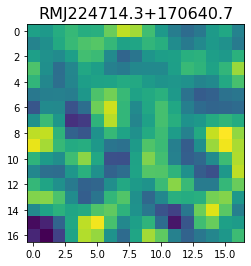

 16%|█▌        | 1572/10099 [02:02<17:09,  8.28it/s]

<class 'pixell.enmap.ndmap'>
[-116.52781   -82.29967    31.945671   62.72219   -34.630974  -96.97686
  -20.995855   56.439743  -15.5048   -149.30444  -162.3611    -56.60998
   21.379349   20.147665   13.016586   33.35586    32.518417]


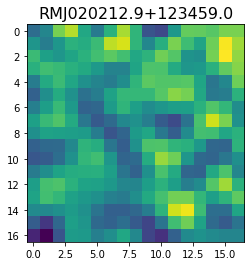

 16%|█▌        | 1573/10099 [02:03<19:00,  7.47it/s]

<class 'pixell.enmap.ndmap'>
[ -13.202216    43.38083     82.02988     47.482014   -58.530224
 -145.83966   -117.02231      4.6045275   96.87105    104.05219
   83.64973     65.21712     -2.324429  -104.93952   -117.4017
   -1.8579284   92.64264  ]


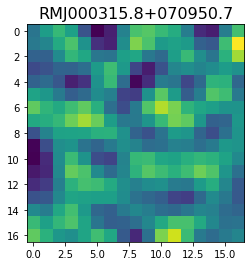

 16%|█▌        | 1574/10099 [02:03<21:00,  6.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -1.7818806   15.811452    84.439095    63.238373   -61.202675
 -103.70446     40.501198   202.48534    180.25113     46.93236
   28.642479   155.34177    242.76839    196.61832    128.71886
  140.42964    166.454    ]


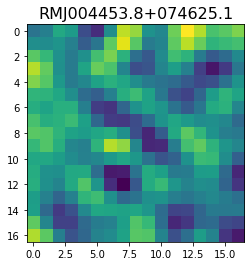

 16%|█▌        | 1577/10099 [02:03<17:18,  8.20it/s]

<class 'pixell.enmap.ndmap'>
[ 61.21408    41.45644    29.151247   40.753265   47.07457    32.157032
  18.435284   20.133045   16.677975   -3.8923073 -13.027361   12.304853
  39.100708   18.14985   -37.810566  -63.712883  -32.13998  ]


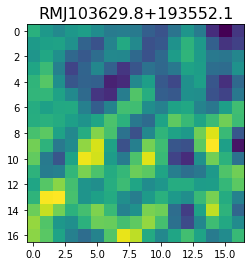

 16%|█▌        | 1578/10099 [02:03<19:30,  7.28it/s]

<class 'pixell.enmap.ndmap'>
[-209.02881 -172.23267 -162.80186 -179.41989 -179.12428 -153.27489
 -158.66345 -206.07582 -216.6099  -166.58092 -151.08096 -214.3629
 -257.76352 -213.2126  -160.11589 -171.18364 -192.82106]


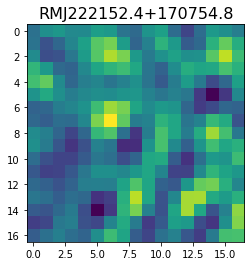

 16%|█▌        | 1579/10099 [02:04<21:37,  6.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -7.3360596     0.31566232   -6.4135747   -28.815956    -67.07535
 -108.70075    -108.27322     -45.343277     15.283982      1.8448771
  -50.66333     -57.122185    -23.139597    -24.913347    -71.97377
  -97.3281      -72.62078   ]


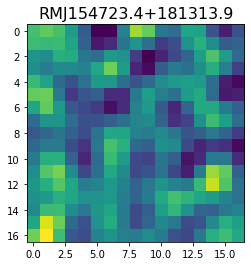

 16%|█▌        | 1584/10099 [02:04<14:10, 10.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -25.734482  -21.665476   -6.911401  -17.630634  -34.382717  -21.978207
    9.09794    25.432198   22.837517   11.536137  -20.727943  -79.482704
 -120.52103   -95.96769   -35.18428   -18.496134  -64.325226]


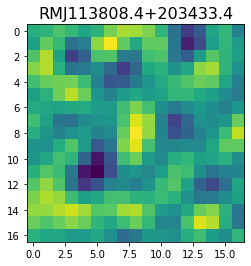

 16%|█▌        | 1587/10099 [02:04<14:03, 10.09it/s]

<class 'pixell.enmap.ndmap'>
[ 85.083336  11.407989   9.801828 134.7808   172.2534    38.772137
 -42.919754  66.31341  176.71634  104.20335  -27.004364 -16.296404
 106.173325 187.14404  179.1775   114.50074   12.859216]


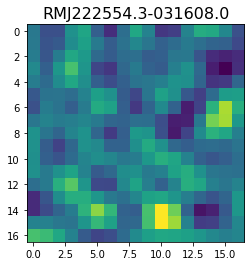

 16%|█▌        | 1588/10099 [02:04<16:15,  8.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[206.66742 195.27357 181.17339 196.97304 211.8517  185.58746 150.51753
 161.92743 201.089   207.90749 185.4094  189.1261  225.4771  241.85895
 219.04884 200.85985 218.14479]


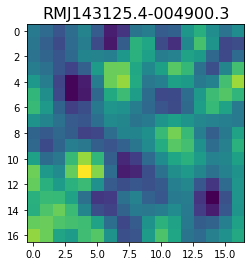

 16%|█▌        | 1590/10099 [02:05<16:11,  8.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  77.99411    59.655506  -61.050716 -119.38766   -51.721405   42.039745
   73.050446   69.690346   80.827995   83.81275    48.259228   14.740122
   35.69983    78.0479     58.956184  -28.59751   -91.49949 ]


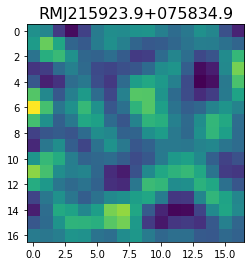

 16%|█▌        | 1592/10099 [02:05<16:49,  8.42it/s]

<class 'pixell.enmap.ndmap'>
[-43.40776   -22.359442   11.554325   16.273298  -11.33932   -32.090298
 -27.315699  -23.759607  -37.48377   -43.34621   -30.52515   -33.551014
 -65.199425  -74.9554    -31.358091    8.2311945 -18.312794 ]


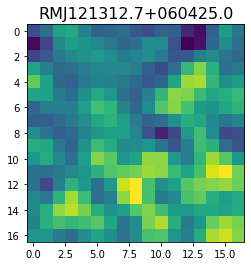

 16%|█▌        | 1593/10099 [02:05<20:56,  6.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -35.8666    -58.31812  -149.2104   -158.07178   -80.75091   -72.58655
 -135.30312  -125.01145   -62.892056  -94.343666 -180.0437   -160.85104
  -59.305595  -15.745716  -32.79727   -41.671703  -71.27659 ]


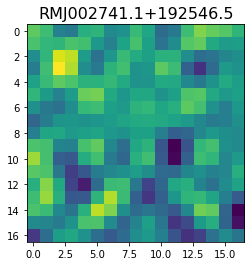

 16%|█▌        | 1595/10099 [02:05<20:16,  6.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 70.87232    82.930695   63.372086   27.444288   23.746592   60.18492
  82.02501    46.3511    -16.307953  -44.536095  -26.817934   -6.484654
 -16.175924  -39.325493  -41.130386  -15.769812   10.4707365]


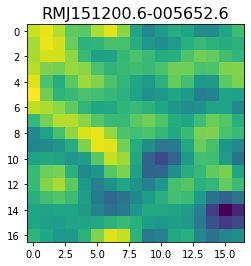

 16%|█▌        | 1598/10099 [02:06<16:43,  8.47it/s]

<class 'pixell.enmap.ndmap'>
[ -49.82427   -74.26046   -87.0224    -55.576733  -14.357673  -20.047531
  -58.792473  -74.51348   -62.76625   -63.63221   -84.81857   -97.63132
  -92.32767   -86.16383   -90.462135 -103.22398  -118.61795 ]


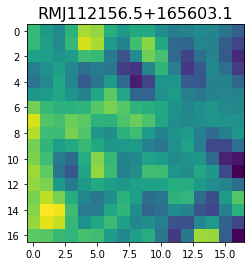

 16%|█▌        | 1599/10099 [02:06<19:13,  7.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-130.6927   -118.69802  -113.1368   -112.37843  -115.14286  -118.21683
 -115.27461  -106.97929  -102.05558   -99.99354   -87.31546   -62.776863
  -49.655975  -65.67304   -94.34387  -105.60234   -94.22284 ]


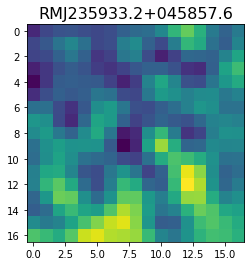

 16%|█▌        | 1601/10099 [02:06<18:31,  7.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 14.644634   55.414986  -15.544195  -93.77403   -62.746586   52.11136
 116.69768    60.740078  -43.485126  -91.33479   -74.821976  -53.027927
 -41.18548    -7.3870807  38.220257   38.786823  -13.65929  ]


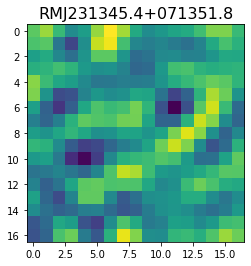

 16%|█▌        | 1607/10099 [02:06<12:01, 11.76it/s]

<class 'pixell.enmap.ndmap'>
[  7.841276  169.52989   187.27242    34.00679   -98.26758   -85.76708
 -31.412033  -54.4666    -98.870445  -71.61848   -20.815956  -30.59286
 -52.699177    4.863474   98.62908   104.79318     9.5689335]


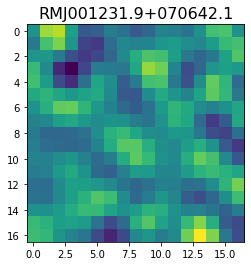

<class 'pixell.enmap.ndmap'>
[ -17.122297  -50.51268   -65.87131   -60.644123  -70.73861   -95.39656
 -100.24395   -84.45219   -80.021805  -88.99091   -81.73374   -56.91371
  -47.58447   -64.25931   -80.0952    -78.04235   -72.04224 ]


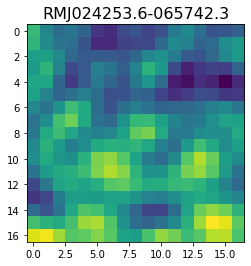

 16%|█▌        | 1609/10099 [02:07<16:10,  8.75it/s]

<class 'pixell.enmap.ndmap'>
[ 59.594048    85.30911     75.66347     34.82635     14.239295
  29.334696    33.015358     6.175951    -0.24372926  37.50397
  57.73246     17.699223   -23.830544    -7.0935445   20.739882
 -10.212159   -65.15553   ]


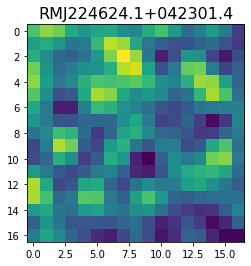

 16%|█▌        | 1610/10099 [02:07<18:12,  7.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[116.08006   71.120834 -15.706195 -44.713203 -32.039787  -3.713675
  65.77889  138.74132  116.8928    19.152466 -13.262832  59.54271
 114.83769   79.43657   40.931076  87.36548  173.17918 ]


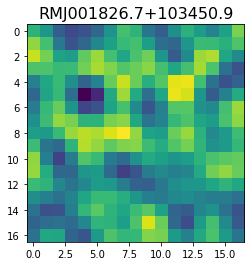

 16%|█▌        | 1613/10099 [02:07<16:03,  8.81it/s]

<class 'pixell.enmap.ndmap'>
[ 100.05363     126.23499      67.61001      13.892534     52.25236
  112.461395     69.74617     -55.753017   -129.5281     -100.85172
  -47.320232    -31.613539    -27.70972      -2.8154027    18.45637
    0.86928475  -46.27231   ]


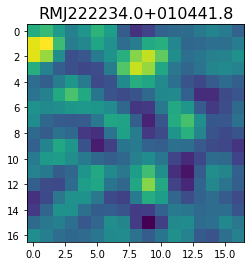

 16%|█▌        | 1614/10099 [02:08<18:22,  7.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -4.7901335  -36.65348    -64.48923    -46.250683   -36.17584
  -72.66373   -103.73793    -87.328606   -68.18066    -88.03548
 -107.58533    -86.88274    -64.39497    -86.22458   -122.891495
 -122.749855   -94.76136  ]


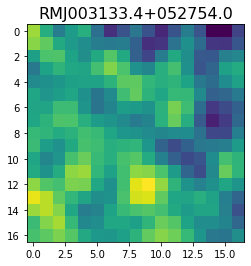

 16%|█▌        | 1618/10099 [02:08<14:12,  9.95it/s]

<class 'pixell.enmap.ndmap'>
[ -98.78975    -102.05187     -69.55888     -57.044323    -71.268326
  -57.9857        0.49561805   41.334953     17.966717    -21.2771
  -11.66134      24.102602     20.432083    -23.849392    -53.54633
  -42.734287     -9.497925  ]


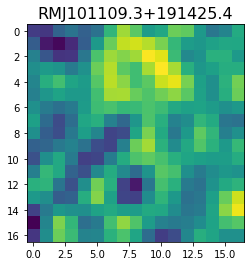

 16%|█▌        | 1619/10099 [02:08<17:11,  8.22it/s]

<class 'pixell.enmap.ndmap'>
[ 19.295586   35.75564    25.63871    20.614357   16.678709    1.9635594
  -3.0364325   5.9830027   1.701133   -5.2471137  23.581793   58.72232
  35.480347  -14.764782   -1.3775908  63.194683   82.426346 ]


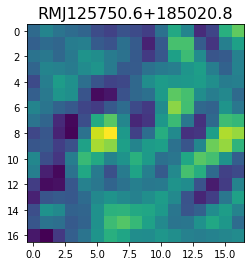

 16%|█▌        | 1620/10099 [02:08<20:10,  7.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-214.6801  -259.6269  -234.94379 -191.12054 -215.1965  -253.75891
 -223.79338 -179.52151 -190.59526 -198.63892 -154.96077 -137.74594
 -194.56892 -241.5482  -225.71997 -207.7599  -212.5586 ]


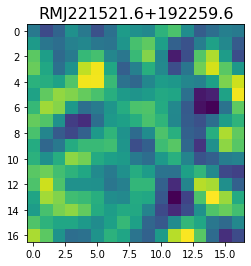

 16%|█▌        | 1625/10099 [02:09<15:21,  9.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   4.524997   31.891502  -84.927284 -266.89932  -268.44223   -72.38889
   38.094357  -95.99572  -267.56656  -241.1062   -100.88837   -60.189632
 -114.029076 -114.91146   -55.760406  -39.52366   -57.440865]


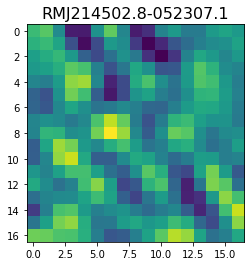

 16%|█▌        | 1630/10099 [02:09<12:30, 11.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-3.41285973e+01 -7.92962503e+00  3.83380661e+01 -1.20812616e+01
 -1.58617447e+02 -2.54959076e+02 -2.17466568e+02 -1.12165421e+02
 -1.28287971e-01  1.14758675e+02  1.63603668e+02  7.64732513e+01
 -1.77885380e+01  6.61224136e+01  2.26568008e+02  1.94737015e+02
 -4.49025345e+00]


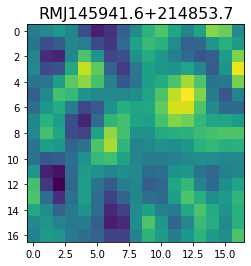

 16%|█▌        | 1632/10099 [02:09<13:52, 10.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-96.39996  -80.81103  -56.806767 -53.858753 -71.07945  -82.314705
 -79.89526  -77.60189  -74.25805  -54.89516  -31.029001 -36.80317
 -72.87063  -94.57455  -75.26426  -45.974392 -47.52662 ]


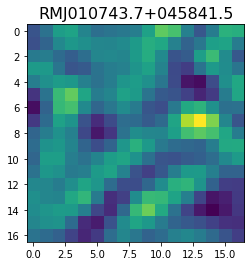

 16%|█▌        | 1635/10099 [02:10<13:47, 10.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-126.88566  -115.700195  -59.331223  -24.615187  -56.91697  -122.72196
 -152.70448  -121.921555  -67.014305  -36.434402  -43.40373   -64.67034
  -72.663666  -65.7628    -66.337326  -86.99764  -107.789536]


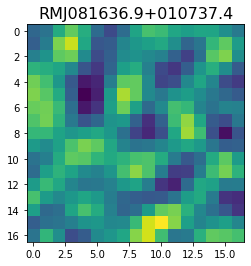

 16%|█▌        | 1637/10099 [02:10<14:57,  9.43it/s]

<class 'pixell.enmap.ndmap'>
[ 193.16759    82.36653   -52.348534  -64.067986   50.739334  152.79652
  143.46938    71.812645   28.08767    13.460136  -11.468256  -18.18015
   38.371807   95.566635   41.533375  -96.87166  -156.80948 ]


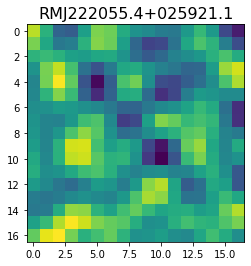

 16%|█▌        | 1638/10099 [02:10<17:56,  7.86it/s]

<class 'pixell.enmap.ndmap'>
[ -4.1402     16.706165   -1.7327119 -23.918104  -19.269499  -18.270758
 -51.782547  -79.787964  -42.166843   51.268238  132.2006    149.46716
  99.5032     14.741062  -50.675385  -60.54385   -40.745186 ]


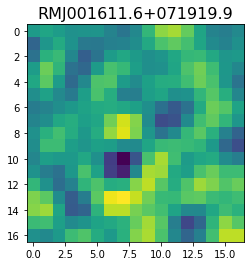

 16%|█▌        | 1639/10099 [02:10<20:42,  6.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-61.480618   -19.447823   -28.905039   -48.923084    -1.8318955
  49.044315    14.802238   -38.740097   -15.533157    24.597431
 -14.82491    -80.26807    -68.19987     -0.75435394  40.33733
  49.195972    53.247025  ]


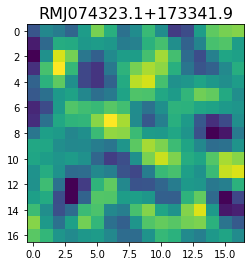

 16%|█▌        | 1641/10099 [02:11<20:07,  7.00it/s]

<class 'pixell.enmap.ndmap'>
[-58.064312   -9.730191    6.7280746 -13.849811   -3.8392198  44.67923
  64.30029    38.03892    26.788183   50.943546   55.702255   23.76844
  13.181112   42.468002   44.237244  -12.585844  -51.946712 ]


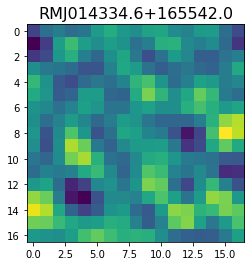

 16%|█▋        | 1642/10099 [02:11<23:19,  6.04it/s]

<class 'pixell.enmap.ndmap'>
[119.55367   76.77784   64.99572   76.18143   91.48915  111.54336
 139.92216  166.32039  184.29596  190.75581  161.92091   84.44621
  16.053904  40.780254 145.59601  220.5303   205.47897 ]


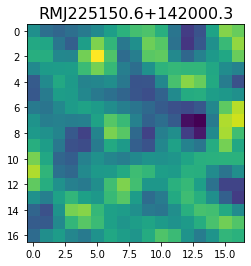

 16%|█▋        | 1643/10099 [02:11<25:42,  5.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -40.214615     7.5628624   26.245457    -6.8736715  -30.20988
   -7.1489887   19.87026      5.9967833  -31.731237   -63.616848
  -98.13048   -130.94746   -107.20332    -12.918044    51.89837
   -3.793611  -104.26362  ]


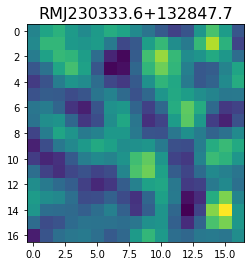

 16%|█▋        | 1648/10099 [02:12<15:30,  9.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-133.31175  -106.52965  -102.07056  -115.724106 -117.685936  -97.3918
  -77.02032   -73.8295    -81.93324   -98.45574  -126.47693  -145.59326
 -129.42967   -97.594376  -92.40156  -102.685715  -81.076324]


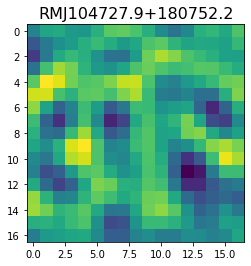

 16%|█▋        | 1650/10099 [02:12<16:10,  8.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 134.53111     78.389366   -65.03519    -85.090126   -59.7459
 -125.35957   -152.82605      3.7605834  199.32301    235.71042
  152.71753     61.849495   -39.002396  -121.115715   -69.261024
  103.2932     216.13797  ]


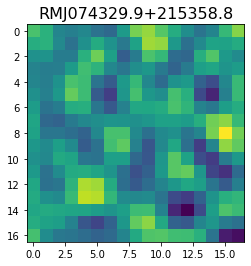

 16%|█▋        | 1653/10099 [02:12<14:48,  9.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -7.5364485  -18.21768    -23.320143   -43.86621    -91.18549
 -122.09365    -95.95135    -25.10107     43.992016    56.734245
   -7.121617   -68.580215   -10.025909   135.30693    178.47986
   47.616955   -83.94826  ]


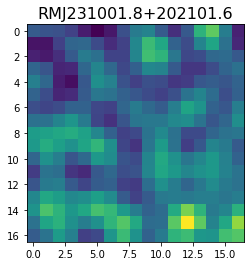

 16%|█▋        | 1660/10099 [02:12<10:36, 13.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.462571   -9.217988  -29.023222  -14.300564   19.210438   18.369661
 -19.493114  -30.754438   19.436258   77.050385   74.11621    26.157219
   3.3048003  24.722565   40.071358   16.995584   -9.510041 ]


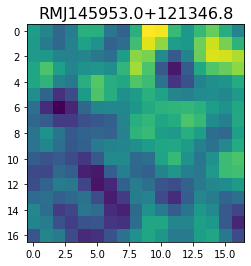

 16%|█▋        | 1663/10099 [02:13<11:47, 11.93it/s]

<class 'pixell.enmap.ndmap'>
[ -61.466705  -50.131393  -54.77388   -69.336205  -71.727036  -59.169548
  -49.671745  -56.4232    -77.28733  -104.027054 -126.57847  -131.82925
 -113.58199   -84.63325   -67.47037   -71.32706   -87.02934 ]


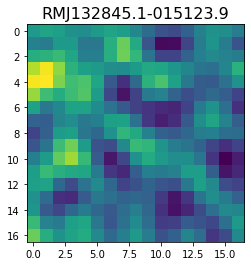

<class 'pixell.enmap.ndmap'>
[-29.356602 -21.212896 -29.59742  -46.83137  -48.146523 -33.68418
 -26.067997 -30.86253  -33.281532 -31.48012  -39.30498  -54.982044
 -58.250885 -42.90312  -26.230307 -22.100409 -26.679245]


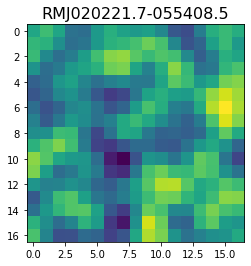

 16%|█▋        | 1665/10099 [02:13<15:53,  8.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-177.85757  -201.61     -216.25652  -196.06644  -157.8577   -139.5057
 -145.28464  -149.30667  -147.3038   -158.49425  -177.42496  -177.34058
 -165.50731  -175.63115  -195.0958   -168.34387   -96.317474]


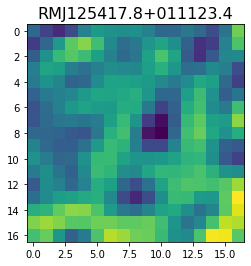

 17%|█▋        | 1671/10099 [02:13<11:55, 11.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-221.51682  -181.92734  -146.55402  -188.7923   -215.8329   -158.47778
 -106.22972  -137.69466  -186.71895  -177.34584  -142.90192  -134.30344
 -144.1945   -168.14601  -210.67911  -214.42882  -120.476036]


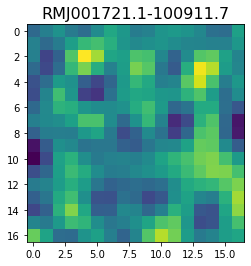

 17%|█▋        | 1673/10099 [02:14<12:37, 11.12it/s]

<class 'pixell.enmap.ndmap'>
[  3.0592465 -37.38264   -60.73398   -37.15252     3.0933213   9.824287
 -20.247795  -42.044483  -23.564268   14.8552685  30.50751    11.043585
 -18.376656  -33.524143  -36.520428  -38.506836  -36.87286  ]


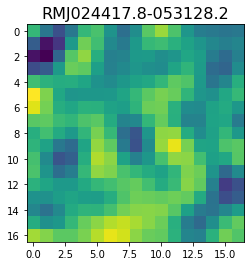

 17%|█▋        | 1675/10099 [02:14<13:43, 10.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-23.755983   16.914047   43.543526   12.740692  -29.054754  -14.007761
  33.387756   27.838686  -39.258083  -75.21094   -20.982725   59.3274
  69.44808    12.723063  -24.901361    0.7245714  45.209644 ]


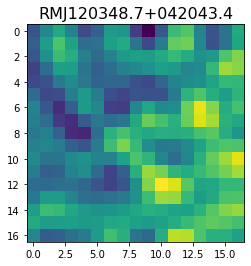

 17%|█▋        | 1677/10099 [02:14<14:54,  9.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-119.90929  -130.07532  -127.258156 -122.16931  -121.94705  -127.267456
 -126.35709   -98.75168   -49.79682   -24.698053  -52.620667  -95.6936
  -98.85869   -71.77254   -66.48666   -88.99583   -97.09518 ]


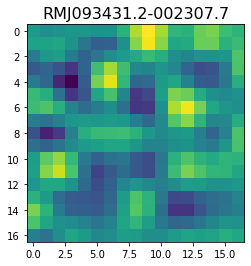

 17%|█▋        | 1681/10099 [02:14<12:32, 11.18it/s]

<class 'pixell.enmap.ndmap'>
[ -24.04453   -54.881557  -75.08346   -73.42408   -61.334225  -53.037174
  -48.789093  -43.14882   -40.295704  -47.29823   -55.579308  -48.364918
  -31.459833  -35.04899   -69.95792  -101.14266   -88.71891 ]


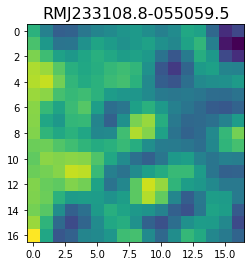

<class 'pixell.enmap.ndmap'>
[118.490486  81.08668   44.7462    57.900845  88.791374  87.642784
  70.674194  86.73145  117.90245   89.44251   -4.039884 -55.650105
  18.9834   151.794    196.12746  115.16841   26.769083]


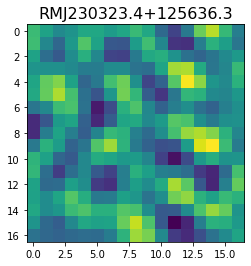

 17%|█▋        | 1683/10099 [02:15<16:26,  8.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[118.854965  149.32263   183.4819    213.14998   194.42549    92.26756
 -34.258343  -58.194542   41.66369   116.571396   53.86645   -41.547607
  -6.2916245 119.81716   160.61937    81.2568     14.121251 ]


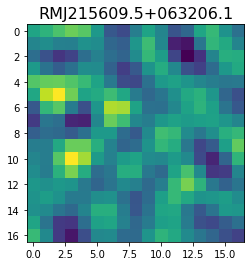

 17%|█▋        | 1685/10099 [02:15<16:31,  8.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-38.70383  -49.4839   -59.620735 -63.538116 -54.83887  -38.41432
 -34.11309  -52.819366 -73.82239  -66.261    -32.55358   -8.064712
 -13.518372 -31.064907 -36.804176 -34.38299  -40.970356]


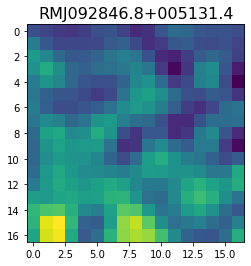

 17%|█▋        | 1691/10099 [02:15<11:38, 12.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 59.372894  137.2886    101.68091    49.300587  105.80829   180.0201
 112.79923   -33.179768  -68.444916   10.206315   42.21656    -3.5151565
   2.7375216  95.421814  147.33252    90.457405   23.341373 ]


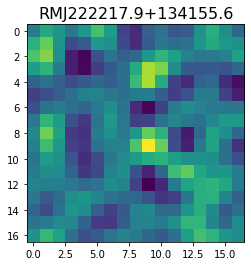

 17%|█▋        | 1693/10099 [02:16<12:29, 11.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[46.85933   60.69031   47.909237  22.119055  22.091217  53.530495
 75.41669   58.05227   23.985058   9.975098  15.011282  14.361056
  5.9903913  9.770043  27.827456  36.741055  22.511515 ]


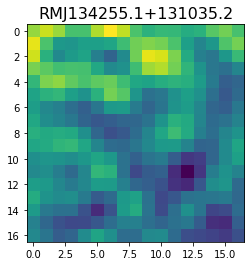

 17%|█▋        | 1699/10099 [02:16<10:06, 13.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -0.3638706 -22.632183  -31.338669  -18.048973    2.055692    8.30507
  -1.692261  -11.289466   -5.441663   13.45824    30.318136   32.766705
  20.371225    3.207835   -5.6404824   0.2585374  14.307518 ]


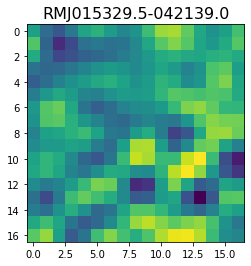

 17%|█▋        | 1703/10099 [02:16<10:47, 12.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 87.6724       4.8299737  -14.708004    27.990051    55.54036
  34.51616     15.615081    41.734962    77.43196     74.62734
  59.37169     82.232796   115.070854    88.542274    19.73947
   0.22966084  51.09217   ]


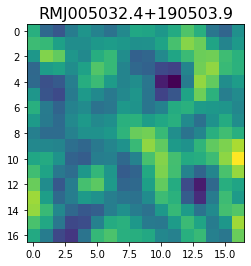

 17%|█▋        | 1706/10099 [02:17<11:43, 11.93it/s]

<class 'pixell.enmap.ndmap'>
[ 81.78885    47.297802   32.400955   77.92667   141.54608   117.8014
   7.2452545 -44.87268    42.857727  157.19339   167.09697   114.50247
 106.58199   127.04102   100.21458    56.29512    77.84057  ]


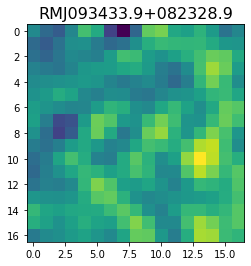

 17%|█▋        | 1708/10099 [02:17<12:43, 10.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-102.20363   -70.26876   -16.443895   31.04163    27.93853   -34.45305
  -94.81546   -98.46675   -78.50507   -93.632195 -118.2295    -83.23776
  -11.43811    -9.607191 -108.641815 -203.91379  -196.15285 ]


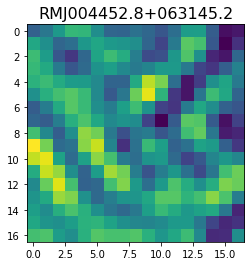

 17%|█▋        | 1712/10099 [02:17<11:48, 11.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 280.82794  -156.85178  -449.77258  -317.18646    17.398375  108.66013
  -46.710777  -50.733906  168.66899   215.42058   -25.755014  -92.884384
  268.01324   583.726     391.65857   -10.290737  -98.99147 ]


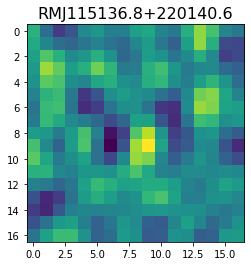

 17%|█▋        | 1715/10099 [02:18<12:35, 11.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-208.18854 -204.11894 -207.06485 -224.21533 -231.74178 -210.82849
 -180.71512 -173.29094 -186.54292 -189.53174 -171.11351 -156.07861
 -165.0009  -183.26596 -187.93265 -185.78398 -197.55989]


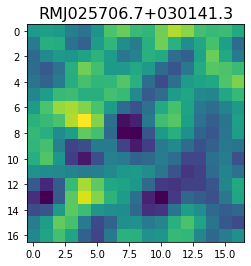

 17%|█▋        | 1717/10099 [02:18<14:03,  9.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-58.66397    -63.367493   -65.97663    -62.806377   -63.863655
 -70.3093     -65.2278     -40.915424   -17.921911   -16.853764
 -25.016825   -17.038553    -0.24341391  -7.372604   -41.888573
 -63.26177    -41.43268   ]


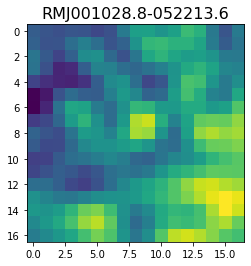

 17%|█▋        | 1722/10099 [02:18<11:58, 11.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  64.889465  -30.034819  -61.424675  -74.77694  -135.97075  -217.95699
 -246.53676  -210.94962  -171.38837  -153.21925  -109.158844  -37.91411
  -38.006527 -135.89502  -181.89629   -77.39769    26.331385]


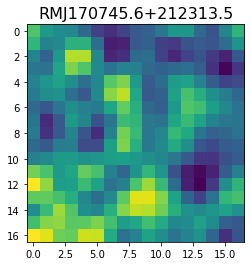

 17%|█▋        | 1724/10099 [02:18<13:16, 10.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-131.44173  -125.35311  -138.0899   -151.45686  -139.53629  -101.34592
  -67.35604   -65.94862   -88.10509   -97.96298   -78.72746   -52.622074
  -48.641884  -65.928474  -81.92223   -84.451195  -78.78121 ]


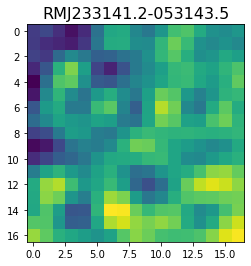

 17%|█▋        | 1727/10099 [02:19<13:42, 10.17it/s]

<class 'pixell.enmap.ndmap'>
[ -99.026665 -138.7997   -193.15579  -218.35272  -155.8968    -59.483948
  -56.25796  -146.1293   -164.12473   -24.27206   116.05079    65.77892
 -110.9583   -180.00592   -71.67745    47.692978   46.589233]


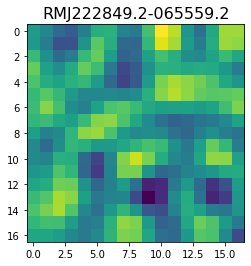

 17%|█▋        | 1729/10099 [02:19<14:36,  9.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[121.33524  102.004684  49.35105   38.149746  84.389595 109.11377
  91.48005  104.07428  151.4939   148.01012   93.72391   89.04353
 143.61562  156.40907  106.063934  79.748344 104.36431 ]


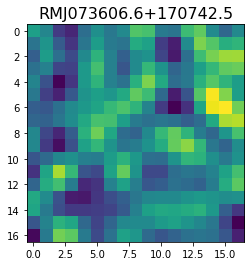

 17%|█▋        | 1730/10099 [02:19<17:05,  8.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -63.22174    -12.890436    43.075512    53.811527    -1.7749805
  -54.352924   -34.003517    -2.5635283  -54.84598   -125.727715
  -80.63372     33.146698    39.49497    -74.3628    -140.73721
  -93.58604    -51.12225  ]


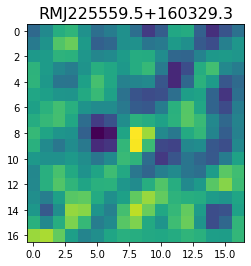

 17%|█▋        | 1734/10099 [02:19<13:46, 10.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-195.65794 -146.63554 -105.73771 -162.58762 -250.63536 -244.57959
 -150.72502  -96.61771 -138.51395 -194.1043  -197.43051 -202.92459
 -261.98853 -300.7311  -234.12593 -131.21744 -132.71895]


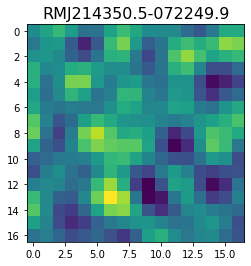

 17%|█▋        | 1738/10099 [02:20<12:09, 11.47it/s]

<class 'pixell.enmap.ndmap'>
[ 116.4355     53.844025  -22.34738   -39.962406    6.947818  -33.874886
 -182.74622  -157.1267    141.05028   298.9529     42.32801  -206.1054
  -20.75949   241.0097     55.48564  -319.5731   -284.81516 ]


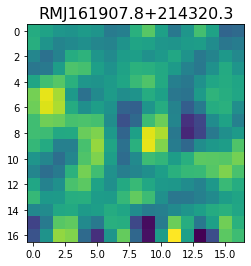

 17%|█▋        | 1740/10099 [02:20<13:12, 10.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -6.1921606 -16.603416  -54.159668  -67.68005   -41.060596  -11.529507
 -19.93707   -61.231197  -91.920395  -82.27262   -51.65862   -42.08082
 -61.529716  -75.29325   -58.930748  -34.192898  -36.05033  ]


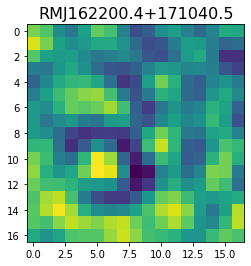

 17%|█▋        | 1743/10099 [02:20<13:31, 10.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -5.9723988  14.649231   34.947037   15.450936  -14.228063    2.1729808
  58.461697   89.13616    60.082237    8.814043  -17.692667  -21.035957
 -22.75642   -17.33363     7.228661   29.064453   19.024645 ]


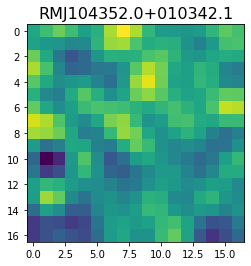

 17%|█▋        | 1746/10099 [02:21<12:54, 10.78it/s]

<class 'pixell.enmap.ndmap'>
[-39.994537 -36.132423 -23.702333 -20.061882 -24.970306 -23.898525
 -20.566551 -32.030804 -51.74505  -54.628437 -39.229748 -28.515005
 -30.283642 -31.90969  -30.539015 -34.875626 -41.58788 ]


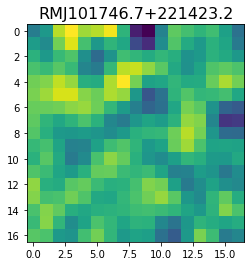

<class 'pixell.enmap.ndmap'>
[ 34.436184   31.884327   35.646717   10.145854    6.2328014  75.54621
 149.18896   134.7049     76.243355   82.88318   145.21204   157.15921
  93.035095   42.437016   71.70518   142.12451   179.73363  ]


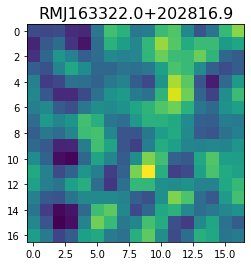

 17%|█▋        | 1748/10099 [02:21<17:46,  7.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -5.366337   33.326942   27.299982  -12.111287  -12.526412    1.9717076
 -38.622585  -89.039696  -64.56749   -10.584647  -18.876995  -60.749878
 -63.196636  -47.23743   -53.099567  -46.21062    -8.887593 ]


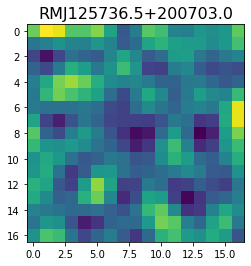

 17%|█▋        | 1751/10099 [02:21<15:40,  8.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -77.06212    21.020555  -37.582233 -129.32942   -95.14605   -22.078161
  -70.34516  -175.45119  -169.22418   -68.959236  -13.221117  -15.77209
    9.789854   64.851685   75.72478    26.588568  -34.278397]


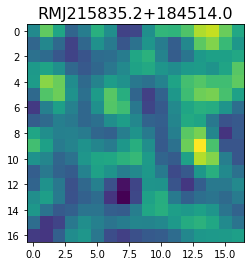

 17%|█▋        | 1753/10099 [02:22<15:43,  8.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 44.252827   98.93881   101.92475    76.00831    69.537056   72.44131
  55.749283   36.389343   46.092445   71.637215   76.000435   59.042675
  54.458447   72.28271    79.14844    46.16024    -2.0400538]


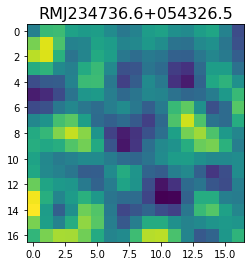

 17%|█▋        | 1755/10099 [02:22<15:54,  8.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-162.26257   -241.52043   -256.82837   -198.60559   -159.78856
 -166.07097   -169.7467    -163.38303   -155.3425    -104.570366
  -14.650236     6.3646474  -85.44739   -162.63707   -126.307816
  -75.66593   -128.36884  ]


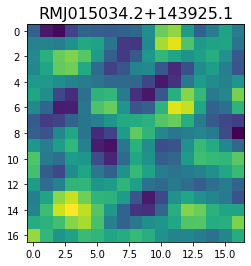

 17%|█▋        | 1762/10099 [02:22<10:16, 13.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[134.39449   89.273155  70.5646   111.48368  160.96954  166.24141
 148.62816  152.37875  162.19786  133.98747   82.36229   66.42947
  91.890045  97.79249   58.060745  32.80703   80.01315 ]


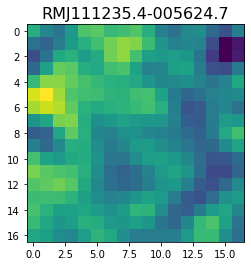

 17%|█▋        | 1766/10099 [02:22<09:48, 14.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -84.92927   -110.79438    -56.311897     7.6895933  -61.457253
 -202.39124   -192.6418      -1.394167   133.68004     61.242138
  -69.71785    -69.20146     10.588396     6.747621   -80.60417
 -119.59054    -74.49176  ]


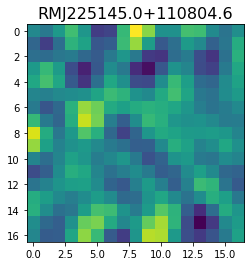

 18%|█▊        | 1769/10099 [02:23<10:07, 13.70it/s]

<class 'pixell.enmap.ndmap'>
[ 15.518634    25.690727    31.596878     9.716414   -17.974201
 -15.033671     9.323834    13.810992    -6.689517    -9.917769
  27.97047     71.88858     73.33334     33.71535     -0.98759246
   0.26537162  20.438404  ]


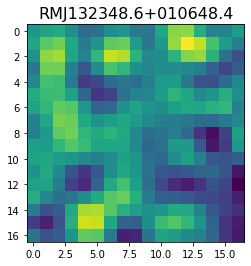

 18%|█▊        | 1771/10099 [02:23<11:26, 12.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -97.19391   -26.19453    57.931793   15.081951  -98.56099  -124.40467
  -47.128292    8.662428  -18.044214  -58.258755  -36.719402   31.258432
   71.80144    37.78576   -41.33686   -92.15936   -84.77009 ]


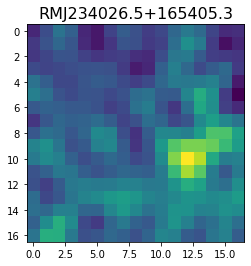

 18%|█▊        | 1773/10099 [02:23<12:31, 11.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -43.051624  -91.10535  -184.1122   -189.84923  -113.29487   -72.39935
  -79.987335  -53.528225  -21.980392  -84.27537  -181.1126   -164.82599
  -72.619484  -65.91716  -133.44228  -126.41353   -47.643764]


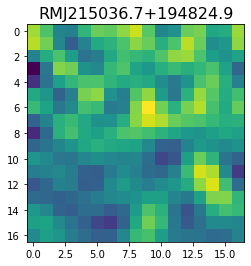

 18%|█▊        | 1780/10099 [02:23<09:09, 15.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -96.12872   -77.32599   -68.362144  -86.547295 -111.04984  -109.46502
  -83.11373   -64.974594  -75.3177    -98.741135 -109.04229  -100.9023
  -88.04894   -81.01165   -78.834564  -78.52657   -80.98381 ]


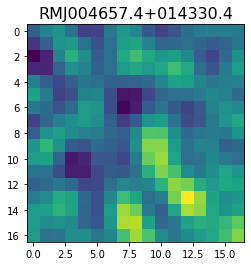

 18%|█▊        | 1782/10099 [02:24<10:33, 13.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 53.91905    34.51171     9.612672   -7.5607295   1.8187205  39.150238
  64.895966   42.481117    2.0111039   6.1275654  52.782623   75.45217
  47.2193     15.094279   12.766504   10.657987  -15.4797   ]


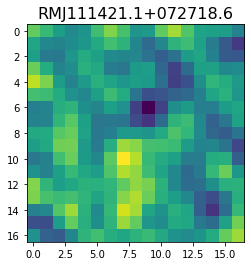

 18%|█▊        | 1784/10099 [02:24<12:43, 10.89it/s]

<class 'pixell.enmap.ndmap'>
[-149.31108  -139.9437   -142.10088  -154.34726  -161.26839  -145.07513
 -114.214165 -103.9745   -131.67804  -167.35736  -171.11475  -146.82689
 -132.85846  -146.34631  -164.00159  -159.75696  -137.88591 ]


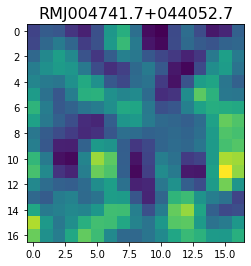

 18%|█▊        | 1786/10099 [02:24<13:56,  9.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.229393  69.651085 114.41307  117.334755  38.633648 -44.231483
 -27.195917  72.09191  131.84338   80.23838  -26.296656 -82.51124
 -51.553383  15.593981  58.619095  73.02766   85.12909 ]


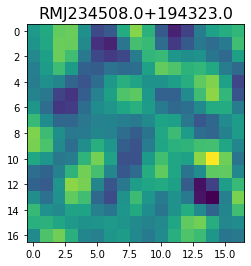

 18%|█▊        | 1791/10099 [02:24<11:08, 12.43it/s]

<class 'pixell.enmap.ndmap'>
[   7.182922 -113.368065 -146.18585   -55.965046   43.3694     49.03746
  -14.625706  -62.45419   -70.056656  -77.150604  -96.224434  -84.371475
  -24.525946   18.28747   -27.435411 -131.83942  -191.59128 ]


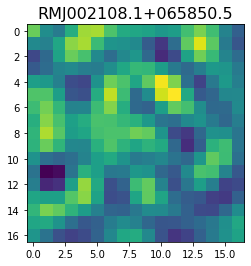

<class 'pixell.enmap.ndmap'>
[ 1.8404202e+01 -6.8421555e+01 -1.5433821e+02 -9.7557266e+01
  5.4363964e+01  1.0571229e+02 -1.1752355e+01 -1.4194733e+02
 -1.3388506e+02 -3.4445240e+01  2.4136135e+01  1.3584841e+01
 -4.4619503e+00  5.9292566e-02  1.1364563e+00 -2.9031780e+01
 -8.5683556e+01]


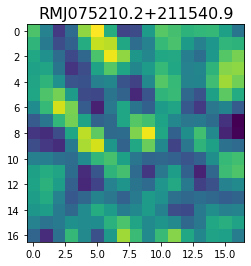

 18%|█▊        | 1793/10099 [02:25<14:59,  9.23it/s]

<class 'pixell.enmap.ndmap'>
[-179.78958 -149.17923 -139.9977  -151.31519 -151.0143  -139.50911
 -145.9412  -170.54977 -180.71298 -163.46904 -142.68024 -140.48026
 -150.4453  -153.9997  -143.25923 -121.97454  -97.61306]


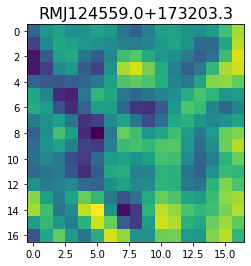

 18%|█▊        | 1794/10099 [02:25<16:56,  8.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -2.3480716  20.451519   26.287016   24.47673    -9.600069  -65.26122
 -66.891945    7.857792   58.353973    9.591242  -43.423367   26.07911
 148.80814   140.76442    -1.5870683 -80.70767    -9.591419 ]


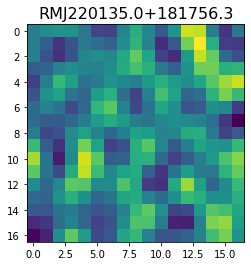

 18%|█▊        | 1800/10099 [02:25<12:14, 11.29it/s]

<class 'pixell.enmap.ndmap'>
[  88.95088    -4.863149 -116.838585 -116.59365   -39.204292    4.518719
  -24.981747  -71.37994   -65.146454  -24.200392  -40.485794 -126.19166
 -157.26453   -61.501026   44.587124   30.116734  -54.742603]


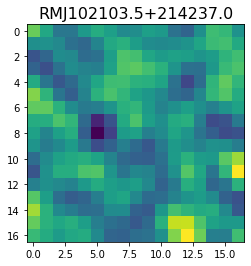

<class 'pixell.enmap.ndmap'>
[ -3.8139484 -11.162864   -2.7761405  35.730602   53.027203    7.3334923
 -46.555344  -31.711973   17.361452   -1.0949534 -79.45566   -86.17596
  28.444197  124.09635    61.5827    -76.68283   -85.54682  ]


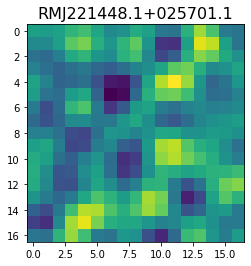

 18%|█▊        | 1802/10099 [02:26<16:15,  8.51it/s]

<class 'pixell.enmap.ndmap'>
[ 42.243725 -54.2659   -43.54852   18.595575  29.521975  16.532043
  39.953712  60.73319   35.176067  16.104563  51.784424  95.62881
  98.99169   93.67655  117.422745 138.41795  105.86805 ]


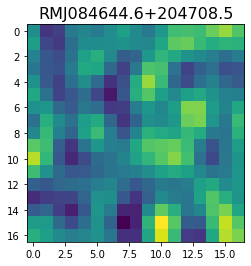

 18%|█▊        | 1803/10099 [02:26<18:14,  7.58it/s]

<class 'pixell.enmap.ndmap'>
[ 24.687845 -15.530791  21.302525  75.676125  75.313194  43.53885
  36.964676  43.91496   23.450573  -8.578542  -9.52681   14.213108
  28.446306  32.913918  43.194256  46.80825   31.472612]


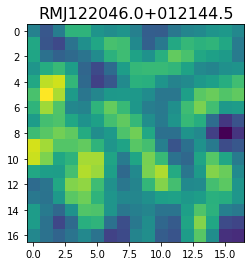

 18%|█▊        | 1804/10099 [02:26<20:18,  6.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  8.775412   12.944574   35.552673   46.673042   30.512882    1.1211059
 -17.152452  -14.589734   -1.0684148   6.0895805  -3.2112617 -24.59026
 -43.435173  -47.79328   -38.653008  -27.253096  -22.539356 ]


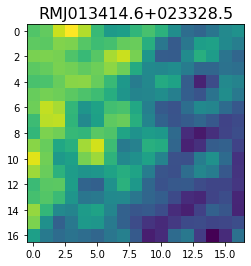

 18%|█▊        | 1808/10099 [02:27<15:18,  9.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 55.24974   76.033264  77.8528    74.17427  100.79376  140.44879
 142.03906  106.34362   82.72812   91.24988  112.96576  139.23647
 166.03386  164.13234  121.34243   85.943405 101.35643 ]


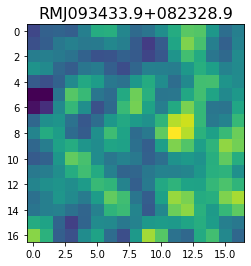

 18%|█▊        | 1816/10099 [02:27<08:59, 15.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -76.09955   -147.85309    112.000336   273.55408    -86.732666
 -458.75916   -248.57072    136.88847    126.556854     8.210519
   99.54761     -3.9080005 -419.212     -458.10477     72.608345
  370.15457     60.568817 ]


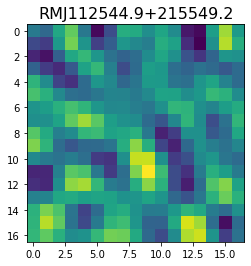

 18%|█▊        | 1819/10099 [02:27<09:49, 14.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 66.826965  150.9919    189.59575    81.11102   -40.04224     5.3515105
 158.24353   214.5399    133.7952     63.173866   81.97934   107.896385
  71.791435   26.679953   35.35148    66.87675    65.308754 ]


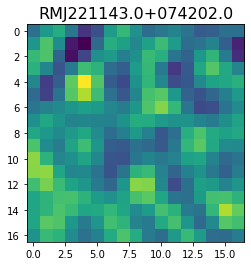

 18%|█▊        | 1826/10099 [02:28<08:44, 15.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.484268  -24.311531  -30.611206  -40.581337  -42.231777  -39.770092
 -41.074905  -34.960438  -14.11701    -3.400846  -24.076578  -47.86285
 -35.67646    -5.2657943  -3.1432555 -21.785017  -10.420002 ]


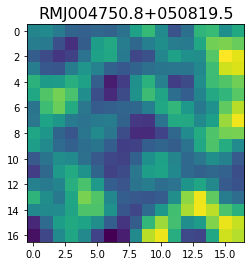

 18%|█▊        | 1832/10099 [02:28<08:07, 16.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -44.94361   -142.78297   -168.79936    -79.24937      3.6271958
  -21.179811   -82.625946   -69.51476    -10.857624   -15.7681265
  -96.38095   -152.07323   -108.228516    -4.164133    52.574306
   -7.2183294 -143.31267  ]


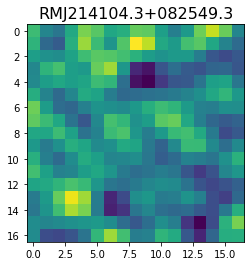

 18%|█▊        | 1836/10099 [02:28<08:25, 16.35it/s]

<class 'pixell.enmap.ndmap'>
[ 66.4829     37.91851    66.31806    77.48705    49.579727   45.908955
  85.57429   105.00361    80.16444    74.74485   121.043625  148.25769
  88.22242   -15.718295  -67.16806   -43.150635   -5.0013576]


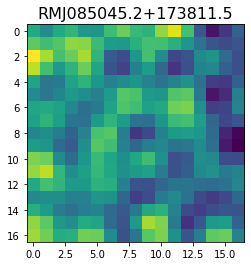

<class 'pixell.enmap.ndmap'>
[  47.607895    -1.8578112  -73.67967   -108.62558    -76.92846
  -12.276213     8.094419   -34.008217   -59.01669    -14.847745
   28.73429     -3.8882089  -59.968033   -45.021114    21.719488
   47.785507    14.617758 ]


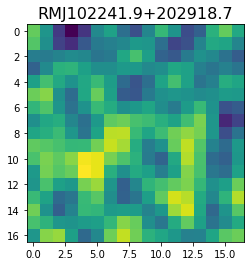

 18%|█▊        | 1838/10099 [02:29<12:38, 10.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -49.39615    -68.474205   -99.04072   -112.70741    -89.491806
  -49.668644   -47.556053   -99.167946  -131.19597    -77.619896
   -5.2859178  -23.138954   -88.54684    -71.08324      2.2990174
  -22.231003  -135.04222  ]


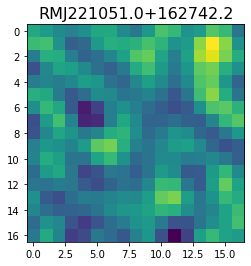

 18%|█▊        | 1840/10099 [02:29<13:40, 10.06it/s]

<class 'pixell.enmap.ndmap'>
[189.052   133.86488 149.94577 198.20073 231.53047 262.20917 300.89453
 305.12888 256.0538  218.56822 247.95227 294.8169  285.01077 242.58095
 243.30902 285.28485 300.3566 ]


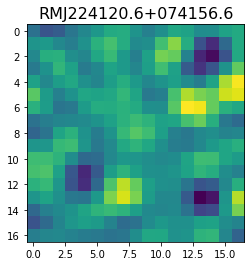

 18%|█▊        | 1842/10099 [02:29<14:24,  9.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-8.15334930e+01 -4.83127365e+01 -7.42420731e+01 -1.10918236e+02
 -8.00677261e+01 -1.06448084e-01  2.80632553e+01 -3.73410873e+01
 -1.19327072e+02 -1.29816208e+02 -7.73739548e+01 -2.80532417e+01
 -1.14080486e+01 -1.49007053e+01 -2.81806068e+01 -3.99307327e+01
 -2.68323822e+01]


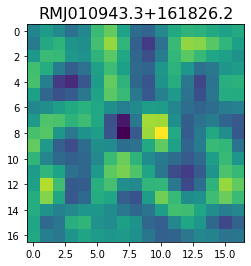

 18%|█▊        | 1849/10099 [02:30<10:15, 13.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[120.21878  138.23685   82.13944   46.34364   48.615543  21.063692
 -32.63418  -32.090843  34.65733   95.09316  113.48751  115.98895
 109.634636  77.93149   45.636093  61.774483 121.00984 ]


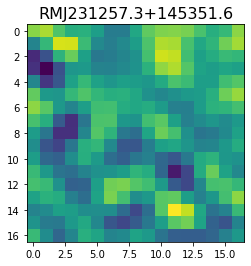

 18%|█▊        | 1851/10099 [02:30<11:29, 11.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -49.755142   -21.723343    89.33473     72.200775   -86.20558
 -159.57443    -46.36245     61.043926    -2.0481944  -99.821815
  -39.707012    83.82354     36.87314   -162.8675    -264.39798
 -163.52061    -22.559963 ]


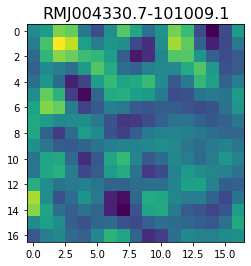

 18%|█▊        | 1855/10099 [02:30<10:58, 12.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -49.331     -39.583656  -18.682932  -16.039291  -52.328423  -95.21962
  -97.20039   -70.47808   -69.19053   -98.552086 -105.469406  -69.58774
  -37.400917  -42.017624  -49.770943  -21.959553   19.218292]


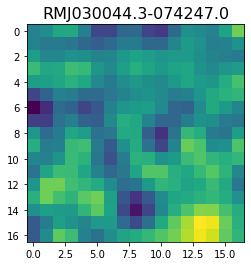

 18%|█▊        | 1858/10099 [02:30<11:15, 12.20it/s]

<class 'pixell.enmap.ndmap'>
[  2.564278   13.295922   -4.270061  -52.496765  -80.13211   -51.143364
 -16.502077  -40.75113   -86.27714   -70.10128   -11.216637   -0.6695759
 -36.907204  -26.199366   46.372757   85.89077    52.470684 ]


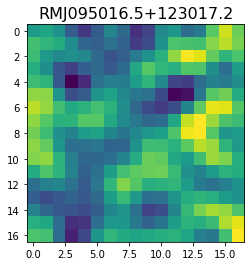

<class 'pixell.enmap.ndmap'>
[-183.47026  -157.64073  -117.99429   -85.80943   -59.229504  -52.975178
  -85.2712   -120.70474  -102.6845    -54.022522  -58.44658  -124.508385
 -165.64323  -144.99852  -133.30869  -173.7851   -197.49881 ]


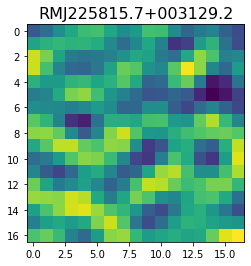

 18%|█▊        | 1867/10099 [02:31<08:58, 15.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[158.7987    88.61896  143.97978  254.23636  257.34088  140.0179
  51.810196  88.10933  168.04105  173.20107  123.44493  126.98325
 196.43422  224.67207  156.66455   80.33057   89.444664]


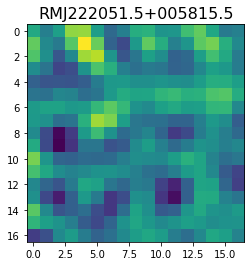

 19%|█▊        | 1870/10099 [02:31<09:35, 14.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[285.01303 285.71378 281.54968 270.81653 259.90204 257.4148  261.78
 261.40286 251.12459 242.44937 250.19011 271.31598 285.21216 277.10226
 255.20984 240.05894 240.4101 ]


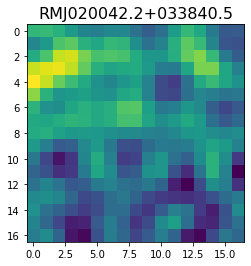

 19%|█▊        | 1877/10099 [02:32<08:29, 16.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 21.145618    5.580665   53.696392  146.11214   183.11221   117.28485
  26.38062     5.0799685  36.707413   36.356194  -10.527332  -29.137724
  23.373827   87.91624    88.11229    37.038563    9.158892 ]


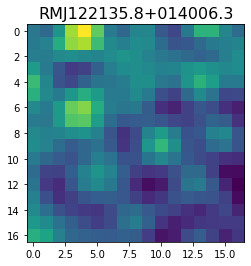

 19%|█▊        | 1883/10099 [02:32<07:55, 17.29it/s]

<class 'pixell.enmap.ndmap'>
[-146.29071  -136.22324  -149.60353  -175.99724  -188.00885  -154.29956
  -80.638954  -23.435053  -39.894615 -121.89344  -192.56415  -184.21268
 -117.790855  -79.38594  -108.112335 -145.82224  -129.60179 ]


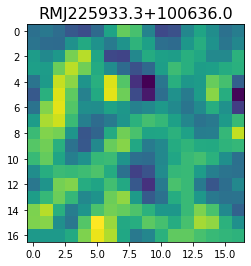

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -41.254784  -43.128498  -80.541245  -82.945496  -88.17185  -136.32869
 -151.67531   -64.95968    51.99323    96.00567    84.47913    89.64743
  107.40771    91.37059    44.7198     -5.018635  -57.44331 ]


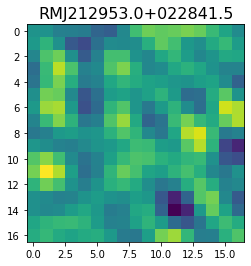

 19%|█▊        | 1886/10099 [02:32<10:34, 12.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -16.647167  -94.24826   -98.52373   -46.061398  -30.17763   -58.906425
  -64.12053   -49.011795  -78.04852  -130.70532  -122.85867   -72.112015
  -79.755806 -144.0099   -156.39049   -95.34125   -59.392216]


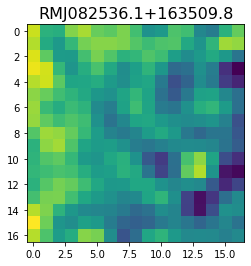

 19%|█▊        | 1890/10099 [02:33<10:11, 13.41it/s]

<class 'pixell.enmap.ndmap'>
[ 75.71754  107.81883  106.06469   55.957954  29.123098  69.70947
 114.743515 102.80317   77.75621   98.73396  130.48746  117.73623
  88.8294    95.53696  121.207794 125.44474  115.39244 ]


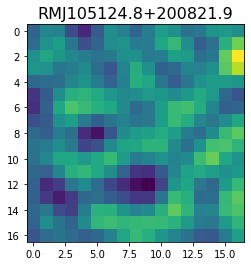

 19%|█▊        | 1892/10099 [02:33<11:23, 12.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 50.861927   80.45657    42.548805   -6.2971663  14.908323   55.81954
  36.999546    3.6644838  33.460487   82.411316   61.615753   -6.114228
 -29.516413    9.79543    57.743664   76.529526   59.392647 ]


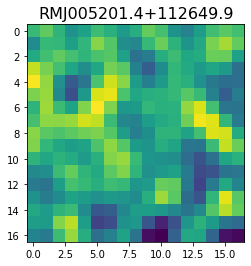

 19%|█▉        | 1896/10099 [02:33<10:51, 12.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-18.871334 -50.62722  -34.567482 -12.072309 -20.184738 -35.4589
 -32.45928  -28.358572 -31.133114 -12.721494  24.124798  22.70584
 -34.563934 -76.2352   -41.441616  27.442562  50.87335 ]


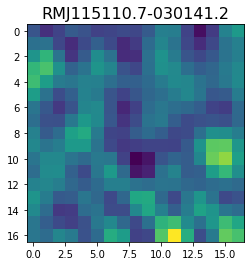

 19%|█▉        | 1899/10099 [02:33<11:10, 12.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.986305   63.189205   17.039507  -38.614037  -46.44453   -14.490933
  16.363213   34.694668   49.62442    54.609818   37.947937    8.86472
 -10.0648365  -3.3398588  27.35163    56.28567    48.793472 ]


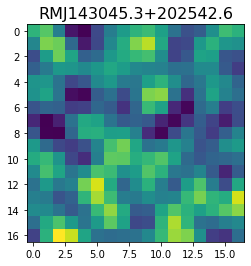

 19%|█▉        | 1912/10099 [02:34<06:23, 21.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -37.526215    -2.8718922    4.1136174  -23.887905   -52.205235
  -61.787632   -68.628815   -73.1504     -53.531433   -24.296898
  -32.34782    -76.65784   -102.975464   -96.53418   -103.145424
 -135.47021   -141.16003  ]


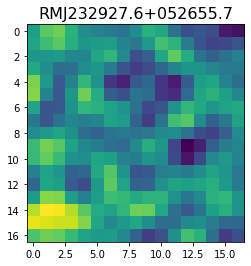

 19%|█▉        | 1915/10099 [02:34<07:27, 18.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -37.768337  -69.124535  -80.85379   -58.57889   -74.25202  -129.91452
 -125.824455  -25.103146   63.850574   31.893623  -81.17749  -144.53476
  -99.95858   -14.57486    15.125707  -23.510593  -53.325985]


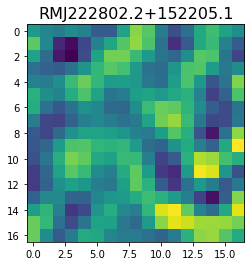

 19%|█▉        | 1918/10099 [02:34<08:37, 15.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-18.763584 -44.316677 -32.821148 -30.141546 -47.316826 -53.185226
 -38.226044 -24.300192 -23.56641  -29.124275 -32.373283 -28.039206
 -21.691402 -34.04912  -66.65021  -77.75118  -40.011055]


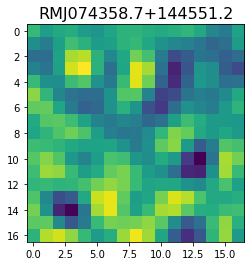

<class 'pixell.enmap.ndmap'>
[-83.706924  -79.916855  -58.398632  -36.471806  -17.289045   -2.0435255
   3.9853778  -0.7870882 -12.609185  -25.230124  -28.301407  -15.81507
  -2.819209  -12.667427  -36.478718  -33.2309      9.330228 ]


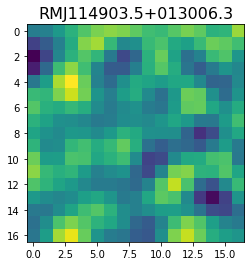

 19%|█▉        | 1921/10099 [02:35<12:14, 11.13it/s]

<class 'pixell.enmap.ndmap'>
[ -91.59172  -118.02787  -143.49663  -140.58157   -99.95567   -62.035206
  -82.04371  -152.41234  -195.22473  -159.12941   -93.81246   -85.17641
 -137.45886  -179.35522  -181.22977  -189.84477  -225.69292 ]


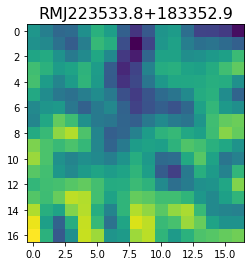

 19%|█▉        | 1923/10099 [02:35<13:33, 10.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-207.34613 -218.23163 -203.41217 -205.75189 -261.4359  -310.11252
 -280.4037  -223.3979  -243.76865 -324.5451  -348.85388 -289.1545
 -241.56349 -257.63852 -273.25534 -241.48495 -218.5664 ]


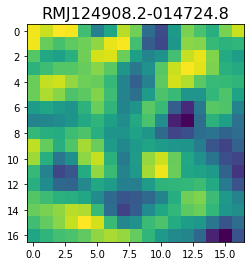

 19%|█▉        | 1926/10099 [02:36<14:02,  9.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 54.727165   63.9513     26.307926  -17.722584  -28.543385  -14.845191
  -9.137225  -21.990284  -36.81479   -38.23313   -31.81899   -33.08033
 -40.494534  -32.1428     -1.1912206  19.870546   -1.6182381]


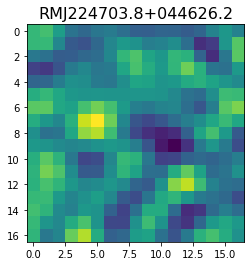

 19%|█▉        | 1928/10099 [02:36<14:53,  9.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -11.998452   115.12122    101.59393    -29.720373   -72.523506
   -9.41574    -51.838894  -206.14139   -196.76582     33.389614
  168.15126     34.015385  -135.54065   -116.5011      -1.9398807
   43.436825     9.878654 ]


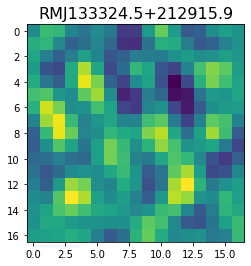

 19%|█▉        | 1931/10099 [02:36<14:33,  9.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -58.60378  -128.514    -164.46347  -120.49031   -60.39732   -63.455975
 -115.07282  -146.85611  -134.11922   -93.22649   -31.425743   35.54755
   60.043465   21.607262  -29.946976  -47.408165  -55.035835]


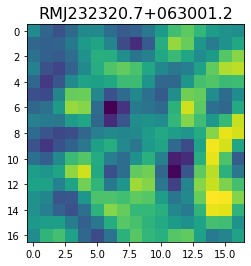

 19%|█▉        | 1936/10099 [02:36<12:08, 11.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.662532   -20.37488    -27.000479    -5.232609    14.163595
   9.49062     -7.3453918  -15.879879   -11.492697     0.29617655
  13.421474    19.018705     8.823792   -13.55203    -34.091957
 -42.812584   -40.18375   ]


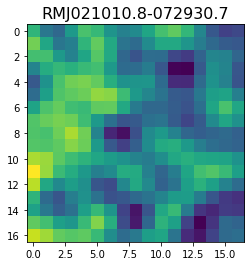

 19%|█▉        | 1942/10099 [02:37<10:30, 12.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 51.886154  26.839407  54.86736   48.748333  37.50072   98.43787
 177.9533   159.97305   71.36111   43.86161   95.78057  118.94394
  73.694756  40.789852  69.95904  109.90985  110.12955 ]


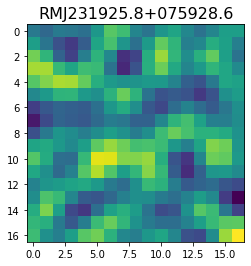

 19%|█▉        | 1945/10099 [02:37<11:07, 12.21it/s]

<class 'pixell.enmap.ndmap'>
[ 25.069412   -53.25087    -87.25826    -45.878162    -2.2924116
  -0.6470102  -13.523516   -22.648966   -32.687183   -26.873436
  -0.13208917   8.699959    -7.043072     9.863803    66.303955
  79.18336     24.487871  ]


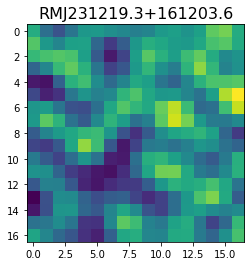

 19%|█▉        | 1947/10099 [02:37<12:20, 11.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-169.42972  -195.92712   -49.865448   40.70354   -19.712387  -79.81157
  -52.594498  -45.36555  -111.09661  -144.28339  -103.22991   -86.18179
 -117.02232   -96.87281   -27.350918  -38.33223  -133.47478 ]


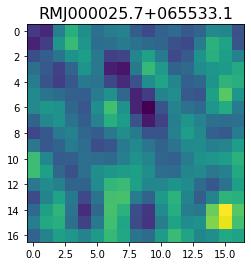

 19%|█▉        | 1949/10099 [02:38<13:22, 10.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-18.58681   11.457967  19.363512  -4.114653   5.019097  70.207886
 116.47883   84.65885   32.534443  40.63181   78.82621   67.12903
  20.322401  14.95474   42.46836   23.465485 -37.7919  ]


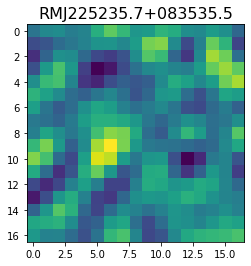

 19%|█▉        | 1950/10099 [02:38<16:10,  8.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -3.3355925   -0.27515167   5.7604384   -1.9799161  -18.456226
 -16.072523    10.103474    25.385912     5.6304984  -21.655767
 -15.442645    18.788763    39.55426     29.010057    10.066159
   6.9405856   17.085016  ]


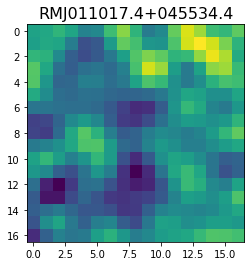

 19%|█▉        | 1954/10099 [02:38<13:02, 10.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -83.64479   -120.89998   -118.16423    -94.111565   -76.86103
  -70.574135   -68.61686    -67.235275   -61.221302   -46.322025
  -26.669807    -9.015949     4.9700136   15.8982725   25.647907
   36.19876     34.660126 ]


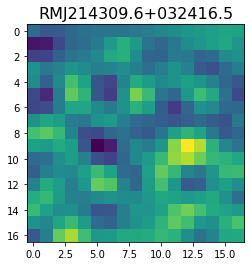

 19%|█▉        | 1959/10099 [02:38<10:45, 12.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -22.625244    -21.649961      0.63781136  -10.126389    -60.099247
  -74.9605      -25.984104      1.8832403   -54.144352   -119.35258
  -97.14892     -22.82289       1.8620653   -33.0522      -55.184986
  -34.58575      -7.8665705 ]


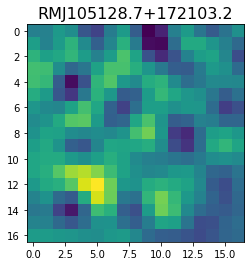

 19%|█▉        | 1961/10099 [02:39<12:04, 11.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -23.45636     90.86853    172.3815     140.33937     26.744373
  -28.218046    47.05303    143.38171    109.25099    -45.39174
 -170.68773   -175.24078   -109.890594   -56.93159    -28.344263
   -1.1801832   17.455114 ]


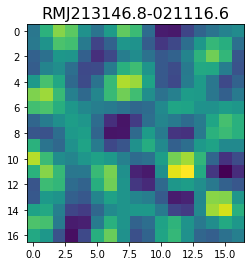

 19%|█▉        | 1963/10099 [02:39<13:05, 10.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 84.37749   67.14341   69.120766 112.773315 138.05199   92.668106
  19.792248   6.128692  65.88188  124.83411  120.51913   79.451416
  74.52315  127.66385  187.11766  199.97533  172.97614 ]


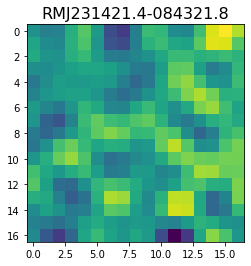

 19%|█▉        | 1966/10099 [02:39<12:34, 10.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -17.386204   -29.531982   -14.6852665   29.620193    64.32952
   36.77431    -65.62683   -178.85745   -203.70456   -109.882805
   16.037687    54.269314   -23.04169   -130.84567   -168.60754
 -119.46646    -54.234123 ]


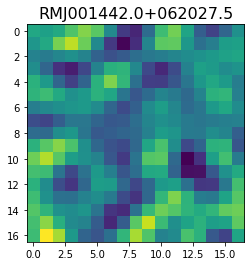

 19%|█▉        | 1968/10099 [02:39<14:30,  9.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -27.065435   -68.8348     -23.53746     -3.5280635  -24.939535
    9.732523    86.27123     61.145027   -81.87266   -176.53394
 -141.16089    -93.477005  -124.707535  -156.59361   -110.02475
  -42.377033   -28.031387 ]


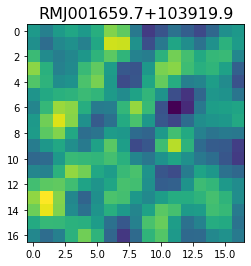

 20%|█▉        | 1972/10099 [02:40<12:17, 11.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[22.840271  26.41588   35.09836   53.16076   62.186577  52.39669
 34.229893  17.655615   6.1625185  7.7422743 24.539333  37.232014
 28.521202  15.185322  25.48954   51.783512  60.2051   ]


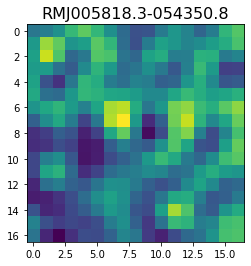

 20%|█▉        | 1977/10099 [02:40<10:40, 12.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.07585   83.403175 175.75906  219.67462  145.47179   47.63101
  62.516342 163.61736  212.76993  183.13708  174.13579  212.47945
 209.72604  143.77556  118.64158  189.70123  270.081   ]


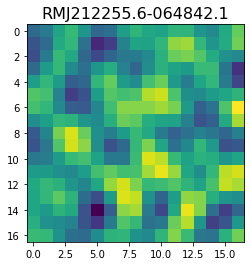

 20%|█▉        | 1979/10099 [02:40<11:29, 11.77it/s]

<class 'pixell.enmap.ndmap'>
[ -48.873676  -69.88343   -49.4365    -12.7722     10.093365   10.46946
   -8.108289  -33.65871   -44.23308   -36.834175  -49.993263 -113.16132
 -180.67992  -174.92203  -100.23211   -47.643867  -65.91353 ]


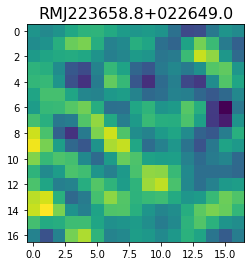

<class 'pixell.enmap.ndmap'>
[  9.203557   12.997908    8.129      15.723226   34.55283    33.078053
   4.9756756 -16.09236   -13.534344  -12.670835  -29.69508   -40.658104
 -24.10252     3.6579046  17.107973   13.027742   -2.0183113]


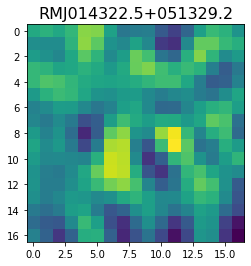

 20%|█▉        | 1981/10099 [02:41<15:24,  8.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -95.5625     -81.427505   -36.235275    -3.6629252  -20.734575
  -57.749756   -62.647068   -48.514893   -66.05307   -105.889435
 -113.74756    -93.3115    -102.15001   -146.21042   -169.08684
 -150.89885   -132.11789  ]


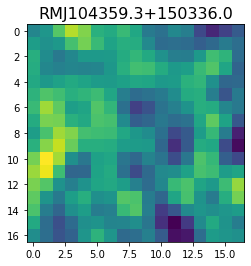

 20%|█▉        | 1983/10099 [02:41<15:32,  8.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[40.31107   62.587082  48.263786  31.014423  36.745285  51.91477
 55.726418  50.545586  44.868195  32.908543  10.78605   -7.217562
 -8.309495  -0.6905708  5.0207314 17.512974  46.132877 ]


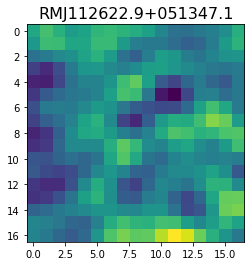

 20%|█▉        | 1985/10099 [02:41<15:40,  8.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-279.00977 -281.00983 -279.87512 -274.89517 -286.2217  -308.78
 -299.4619  -253.69594 -231.21631 -257.16367 -273.88278 -247.31905
 -233.50838 -269.26932 -288.56497 -233.95598 -168.45555]


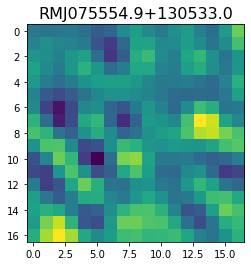

 20%|█▉        | 1989/10099 [02:41<13:03, 10.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-18.238672    5.440882  -28.47192   -77.71299   -56.05228    27.787306
  59.917194   -9.2443075 -88.80377   -82.192825   -3.918806   65.79457
  65.80518    -5.090613  -72.82024   -56.12568     4.315764 ]


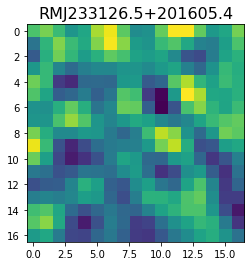

 20%|█▉        | 1996/10099 [02:42<09:14, 14.61it/s]

<class 'pixell.enmap.ndmap'>
[ 41.111076   90.10536   102.265144   62.44697    12.906964    1.8706644
  26.283636   43.953373   33.731247   15.128459    7.280686    4.1485744
   1.7445512  11.941894   31.573576   37.01078    29.253965 ]


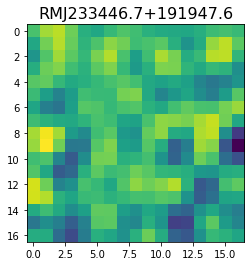

 20%|█▉        | 1998/10099 [02:42<10:32, 12.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  30.008194    -8.204211   -57.17936    -86.509186   -95.362404
  -79.28158    -37.844852     3.1353488   19.79098     22.067944
   21.951862    -2.1279738  -63.386925  -112.76424    -83.34613
   14.680938    91.23518  ]


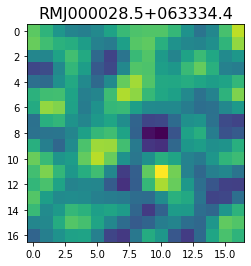

 20%|█▉        | 2000/10099 [02:42<11:39, 11.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -84.72395    -91.315765   -33.571465   -29.619343   -56.055298
  -37.14131     -3.5469654   10.047841    60.186882   140.16296
  125.05531     -6.0350113 -103.46962    -95.54677    -73.73782
  -79.41959    -51.212986 ]


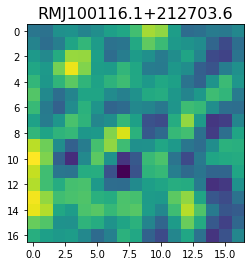

 20%|█▉        | 2006/10099 [02:43<09:20, 14.44it/s]

<class 'pixell.enmap.ndmap'>
[146.21083  174.52852  110.17115   93.96188  197.31454  264.98987
 174.88843   78.079285 154.23917  289.82727  262.61304  118.09231
  81.33913  179.49611  230.945    169.0481   118.93032 ]


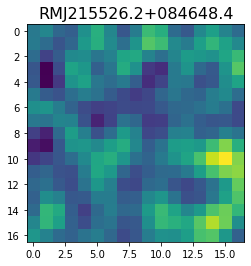

 20%|█▉        | 2008/10099 [02:43<10:29, 12.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-31.983282  -47.0339    -21.61665    19.129015   55.803837   70.86557
  49.179188    3.6264822 -20.614857    6.3646803  57.446053   78.94059
  57.122723   28.478249   24.566296   35.87255    39.648273 ]


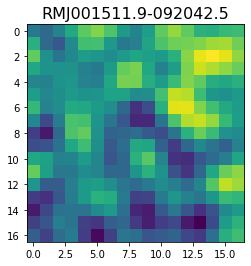

 20%|█▉        | 2013/10099 [02:43<09:54, 13.59it/s]

<class 'pixell.enmap.ndmap'>
[  -5.2802696   17.231667   -63.992928  -140.39542    -88.99754
   19.56467     41.389874    -6.4256473   -7.8149056   27.891203
   -5.1201878  -92.92147   -104.13919     -9.146858    67.826035
   38.21744    -42.810665 ]


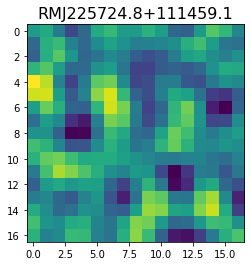

 20%|█▉        | 2015/10099 [02:43<10:57, 12.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-23.168278  -55.078472  -73.196144  -52.06133   -22.85857   -16.385029
 -23.329777  -31.076763  -46.40135   -59.903343  -41.9699      0.8915556
  18.159452   -9.468483  -38.645916  -37.127712  -36.06114  ]


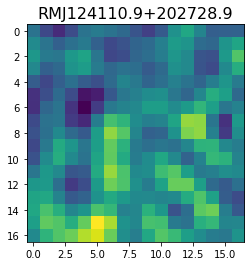

 20%|██        | 2020/10099 [02:44<09:38, 13.97it/s]

<class 'pixell.enmap.ndmap'>
[-211.75931  -340.4779   -276.33218   -91.89124   -64.733444 -202.08719
 -242.0879   -136.31084   -88.30919  -132.32765  -123.32463   -85.64372
 -139.91772  -200.091    -145.86777  -113.181694 -237.56583 ]


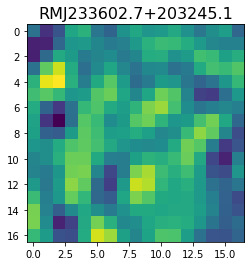

 20%|██        | 2022/10099 [02:44<10:56, 12.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 1.7592457e+01 -1.4408857e-01 -2.7466570e+01 -5.5364025e+01
 -8.8429848e+01 -1.0166476e+02 -6.0668285e+01  4.6063204e+00
  5.6017251e+00 -8.6767418e+01 -1.7747227e+02 -1.5976968e+02
 -6.3656895e+01 -2.0778107e+01 -8.5961166e+01 -1.6816736e+02
 -1.6100104e+02]


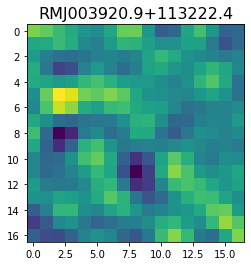

 20%|██        | 2024/10099 [02:44<12:07, 11.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -36.024323  -37.022606  -82.87266  -108.157425  -86.80596   -76.25781
 -108.685234 -134.25623  -121.10032  -116.64819  -150.55525  -166.22084
 -118.62495   -64.10541   -77.04179  -135.34608  -160.94577 ]


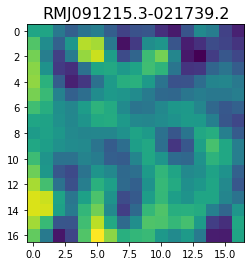

 20%|██        | 2026/10099 [02:44<13:02, 10.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  5.1157475   7.343398   36.83848    53.267624   14.604738  -41.56632
 -43.292118   -6.8688703 -15.531615  -69.120346  -74.9378    -12.515838
  21.528334  -25.526144  -80.74666   -74.35379   -37.661083 ]


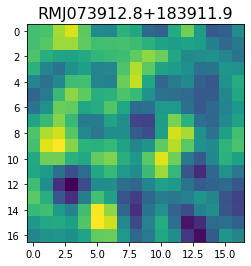

 20%|██        | 2028/10099 [02:45<14:17,  9.41it/s]

<class 'pixell.enmap.ndmap'>
[137.39009  103.78144   50.229637  47.092693 101.129616 142.77057
 120.77329   68.328735  47.8575    66.24786   83.17374   77.68963
  63.316795  51.472042  41.96242   44.033176  69.178276]


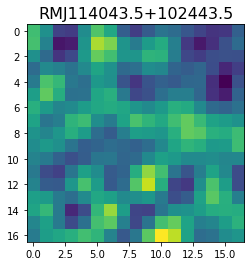

 20%|██        | 2029/10099 [02:45<17:40,  7.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  53.799953  -41.433304 -120.6874    -59.279133   29.373922   25.994892
  -12.352414  -20.497004  -57.2111   -143.20291  -162.47523   -54.808456
   60.073055   65.482765    8.029258  -20.342834  -20.94244 ]


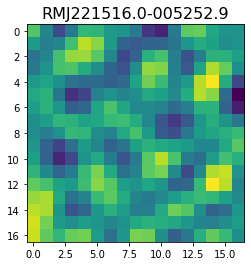

 20%|██        | 2032/10099 [02:45<15:33,  8.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[105.985565 102.74986   82.746864  70.258156  76.98103  101.96043
 110.859795  73.1524    36.646057  68.550896 123.66244  107.49905
  57.085434  85.37669  163.2758   158.99301   80.75836 ]


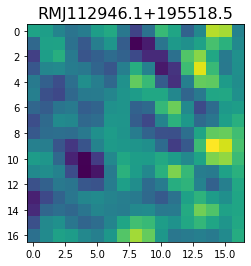

 20%|██        | 2035/10099 [02:45<14:09,  9.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -39.417862  -26.170515  -61.80535  -153.18391  -217.49881  -177.21645
  -72.390755   -9.450387  -12.856256  -10.025823   29.288143   36.97
  -25.400911  -78.01883   -45.059696    8.846169  -27.170223]


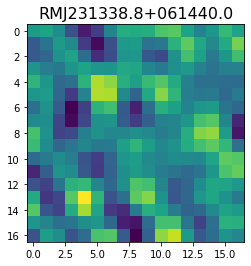

 20%|██        | 2038/10099 [02:46<13:16, 10.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-2.03994638e-03 -1.92235069e+01 -8.49431801e+00 -6.31246901e+00
 -4.20314026e+01 -8.41963577e+01 -8.32257614e+01 -4.10807190e+01
 -6.66321850e+00 -1.15680571e+01 -3.72434349e+01 -4.65290108e+01
 -2.86141586e+01 -5.09621716e+00 -8.05314071e-03 -1.30806265e+01
 -2.44736061e+01]


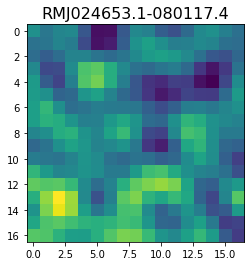

 20%|██        | 2040/10099 [02:46<13:56,  9.64it/s]

<class 'pixell.enmap.ndmap'>
[  54.920643   -2.912921  -72.150345  -22.1057     75.65243    48.131157
  -82.67822  -124.404274  -20.908606   79.76835    74.46863    23.906322
   -1.750283  -14.401877  -13.727987   33.0371     86.81544 ]


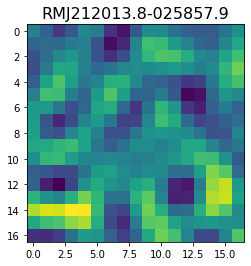

 20%|██        | 2041/10099 [02:46<16:17,  8.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  3.1173792   18.170958    32.768692    18.621069   -24.17668
 -57.50355    -48.23184     -7.1200733   30.541714    46.386276
  42.196648    20.858698    -9.836339   -28.2489     -20.262697
  -0.35050136  10.019178  ]


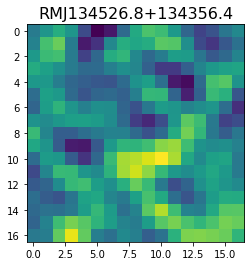

 20%|██        | 2044/10099 [02:46<14:26,  9.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -26.802933   -66.994064  -107.28061    -72.262985     9.043154
   58.7481      57.034294    34.485493    23.092672    35.224438
   41.773876     2.9026146  -47.45176    -39.455864    -8.4957485
  -48.617775  -115.728546 ]


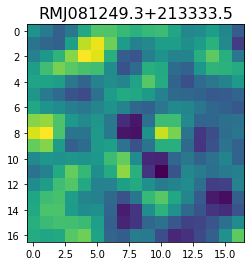

 20%|██        | 2049/10099 [02:47<12:01, 11.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -1.7094389   1.2189705   1.8277482  -2.1967063  -1.9611661   4.1739087
   2.1928656 -12.7487755 -22.582994  -13.800461    1.2701269   6.780339
   5.491013    3.5499065  -4.390326  -19.512154  -28.288794 ]


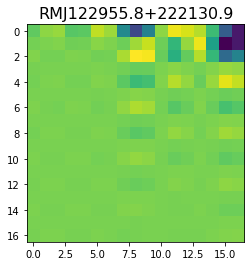

 20%|██        | 2052/10099 [02:47<11:37, 11.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[79.97914   86.496666  82.03868   75.7955    79.047874  85.5402
 80.2338    67.21621   69.03003   89.8634    99.43275   71.232735
 22.884722  -3.4741533  6.6610913 30.085646  43.75091  ]


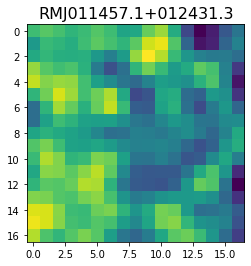

 20%|██        | 2054/10099 [02:47<12:43, 10.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-113.04727  -118.26372  -105.88491   -87.98738   -76.91202   -71.94958
  -78.93275  -100.3459   -110.188446  -89.70168   -71.24356   -88.08705
 -110.7708   -100.53929   -84.14794   -99.070404 -114.46108 ]


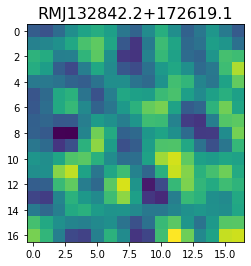

 20%|██        | 2056/10099 [02:47<13:35,  9.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 106.70129    98.2457    123.52784   113.2554     34.86368   -42.20712
  -30.921316   58.626167  134.07417   133.76328    84.36137    43.962536
   20.540525  -25.32392  -100.18859  -138.00182   -76.55581 ]


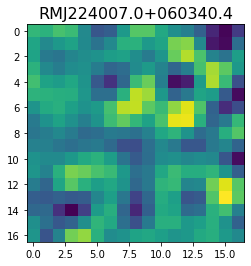

 21%|██        | 2072/10099 [02:48<05:10, 25.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-21.127056 -57.081264  -1.563263  88.6458    91.43888   21.1661
   5.979323  88.74534  169.96675  156.31718   81.7284    54.304928
 122.85464  222.46335  252.70496  197.39275  137.24176 ]


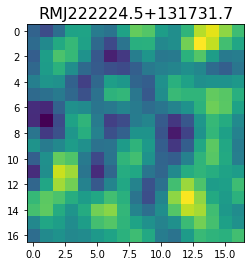

 21%|██        | 2076/10099 [02:48<06:19, 21.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[136.06828  121.76832  107.63403  103.72997  109.138    112.53962
 107.626595  99.00642   88.021     73.709015  69.38675   84.732956
  95.31887   77.359436  61.866676  89.636566 127.30687 ]


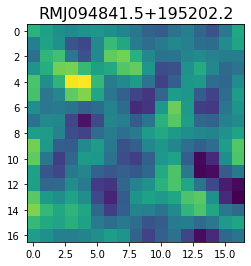

 21%|██        | 2082/10099 [02:49<06:30, 20.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 112.57371   158.36101   149.04747    98.707466   55.63934    53.50207
   82.44733    87.090385   14.758121 -100.30039  -145.36871   -75.12386
   14.722824   33.328857   27.529778   60.811996   60.31437 ]


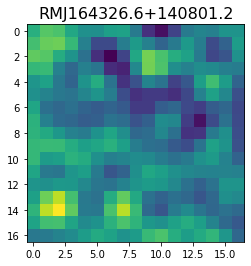

 21%|██        | 2087/10099 [02:49<07:10, 18.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 13.042655  58.356606  81.10459   63.93515   42.376846  37.59938
  28.356422   8.079652  13.393647  61.55478  106.50195  100.12228
  62.304424  45.41587   55.72631   57.338512  38.417385]


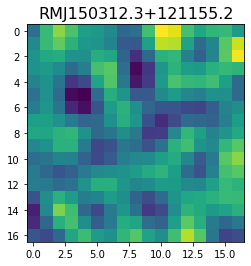

 21%|██        | 2090/10099 [02:49<08:33, 15.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 15.398688    1.0639132  48.94599   122.87464   163.74434   152.29861
 124.58374   122.2966    132.90889   106.35462    39.45365     2.724357
  52.175335  148.8066    207.48431   200.3793    167.53897  ]


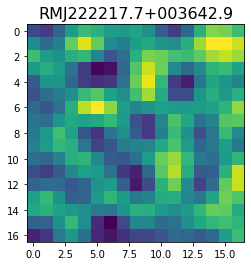

 21%|██        | 2094/10099 [02:50<09:02, 14.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.495934  -22.10684   -51.27048   -39.30821    -3.8966064  17.538345
  16.874777    1.0481375 -32.60543   -72.75848   -83.375984  -53.880737
 -26.247887  -35.359188  -56.12171   -48.43946   -20.882435 ]


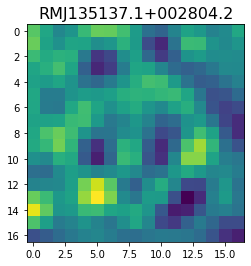

 21%|██        | 2099/10099 [02:50<08:56, 14.92it/s]

<class 'pixell.enmap.ndmap'>
[-2.9754438  -2.3755221  -0.08472398  0.76355726 -0.09173425 -0.4460343
  0.14830591  0.28789514 -0.16785438 -0.18372685  0.16660903  0.10778396
 -0.15083621 -0.05190877  0.12445533  0.01349953 -0.0908393 ]


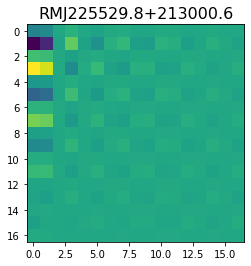

<class 'pixell.enmap.ndmap'>
[ 43.968544   95.15594    96.386345   51.663254   21.140131   23.975803
  25.339792   12.435765    6.775134    7.7264156  -3.190916  -11.251018
  11.988145   51.958805   71.00303    65.720436   57.98021  ]


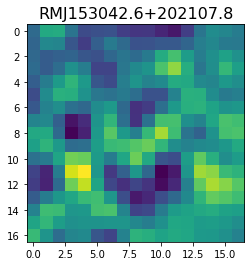

 21%|██        | 2101/10099 [02:50<12:59, 10.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -63.049965  -69.63624   -79.92475   -83.22374   -88.234695  -84.4649
  -56.277866  -29.521431  -47.149853  -95.74019  -110.75535   -68.03225
  -22.398306  -31.707329  -78.039185  -95.34252   -56.97058 ]


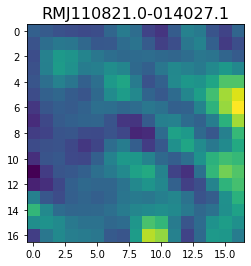

 21%|██        | 2103/10099 [02:51<13:29,  9.88it/s]

<class 'pixell.enmap.ndmap'>
[  36.92766     8.066165 -106.30077  -157.69948   -93.631035  -13.20081
   -9.189846  -67.09741  -135.63632  -181.89503  -166.16496   -83.953865
  -33.475792 -104.41201  -206.45026  -170.94252   -23.791986]


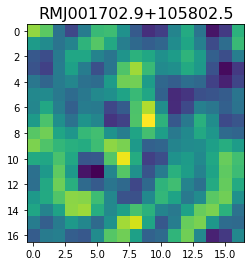

 21%|██        | 2105/10099 [02:51<14:57,  8.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 75.424164  91.38577  118.122154 123.39959  105.44298  107.99373
 136.42426  129.73811   70.12951   41.26497  101.191216 175.22118
 171.44508  131.09227  148.7123   200.89374  187.34708 ]


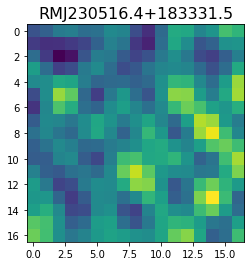

 21%|██        | 2108/10099 [02:51<14:08,  9.41it/s]

<class 'pixell.enmap.ndmap'>
[ -94.26711    -67.022446   -34.46267    -36.814007   -77.35129
 -115.90574   -113.76145    -77.68626    -49.304935   -51.454807
  -59.484642   -36.43724     14.098136    49.46468     40.66106
    3.0924082  -30.959208 ]


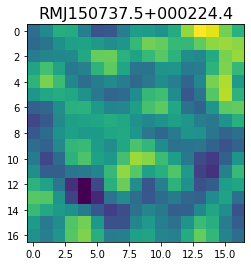

<class 'pixell.enmap.ndmap'>
[-106.25466   -114.99232   -100.25646    -91.34474    -92.20404
  -90.90122    -93.78911   -118.609634  -149.70804   -142.98691
  -98.28244    -79.70183   -121.34342   -158.24243   -114.51872
  -25.592667     6.7700706]


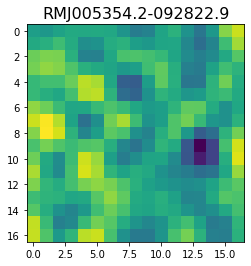

 21%|██        | 2110/10099 [02:52<18:11,  7.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-104.77562  -140.54982  -197.44698  -165.01237   -71.319405  -43.82101
 -102.11204  -146.6498   -131.56935  -105.202965  -94.14155   -78.43546
  -67.890114  -84.05945   -86.27682   -29.359268   28.606531]


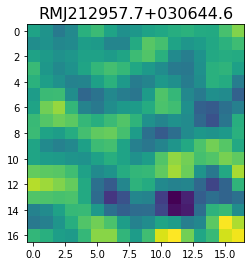

 21%|██        | 2113/10099 [02:52<16:23,  8.12it/s]

<class 'pixell.enmap.ndmap'>
[-304.91376   -313.8582    -144.38951      3.0809827  -89.092026
 -215.99165   -126.921295   -20.349636  -127.29685   -215.58214
  -62.922104    48.08689   -148.07585   -376.67838   -318.1653
 -137.78432   -103.3777   ]


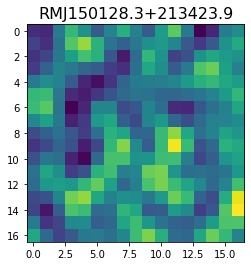

 21%|██        | 2114/10099 [02:52<18:56,  7.02it/s]

<class 'pixell.enmap.ndmap'>
[-45.821186 -41.982643 -44.050507 -54.956192 -65.1433   -62.996063
 -48.96696  -37.70084  -44.441124 -68.408035 -91.96099  -98.432396
 -88.33901  -75.59293  -71.712074 -77.893074 -88.103096]


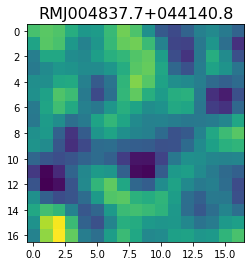

 21%|██        | 2115/10099 [02:52<21:48,  6.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.82991  100.21507  103.117615 146.1558   154.37608   95.33355
  50.28878   78.96751  122.15298  113.75542   84.17984   82.03476
  90.23904   81.33893   73.242424  84.51756  101.63496 ]


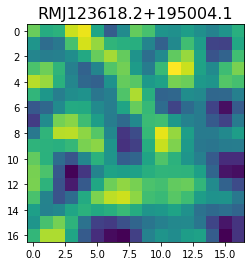

 21%|██        | 2118/10099 [02:53<18:09,  7.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 14.9973     5.2074   -85.3589   -92.02103   13.289136  82.837456
  37.316807 -33.432045 -47.22264  -43.01952  -69.17594  -92.885445
 -72.96321  -24.623358  22.142803  52.975006  48.35924 ]


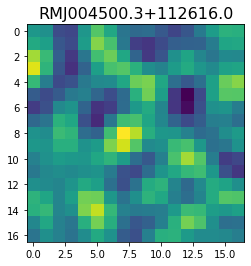

 21%|██        | 2121/10099 [02:53<15:31,  8.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.167503 -69.9773   -93.05434  -24.072088  11.395556 -16.941036
 -10.591826  43.998253  41.09077  -35.61159  -72.223015 -26.401787
  10.748212 -17.808811 -62.463524 -80.020615 -86.93592 ]


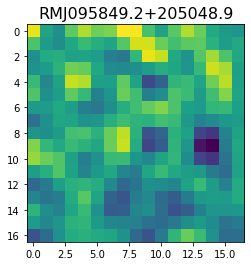

 21%|██        | 2125/10099 [02:53<13:08, 10.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 240.05362    140.31734   -147.42245   -154.59636    143.96385
  267.58975     42.771366  -138.36353    -20.088076   118.8339
    0.7480422 -189.4302    -167.10382     -8.848002    56.03115
   43.755714    97.0272   ]


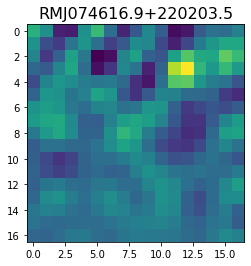

 21%|██        | 2127/10099 [02:54<13:40,  9.72it/s]

<class 'pixell.enmap.ndmap'>
[-108.09296    -35.355293   -19.73975   -111.88736   -189.09749
 -148.77036    -53.31377     -0.2355647    6.9489017  -11.213934
  -60.73419   -101.34162    -61.612034    44.70663    134.87279
  173.41888    166.80814  ]


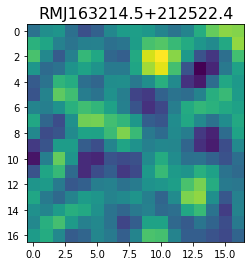

 21%|██        | 2128/10099 [02:54<16:04,  8.26it/s]

<class 'pixell.enmap.ndmap'>
[ 79.65589   91.536415 139.43979  166.9897   128.54166   73.54287
  95.05599  194.79156  267.23694  229.62816  114.58063   21.413216
  14.925506  79.4257   143.39172  146.95737  101.77247 ]


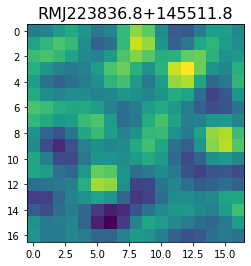

 21%|██        | 2129/10099 [02:54<18:19,  7.25it/s]

<class 'pixell.enmap.ndmap'>
[  11.127125   103.70921     43.366177   -54.57214    -44.20386
   33.13488     54.869064    -7.2353625 -103.36609   -163.35576
 -109.54307     49.12301    163.61414    133.10689     64.52315
   84.7764     127.007645 ]


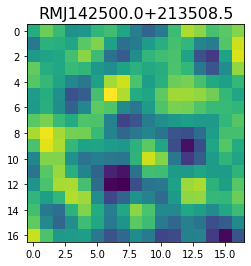

 21%|██        | 2130/10099 [02:54<20:25,  6.50it/s]

<class 'pixell.enmap.ndmap'>
[ -4.9774456  -9.81855   -24.34365   -25.913862  -11.879746    4.194949
  16.166712   21.35504    10.448224  -12.445593  -20.780746   -5.7793946
  -0.5781128 -29.134983  -58.149464  -43.823025   -2.6836417]


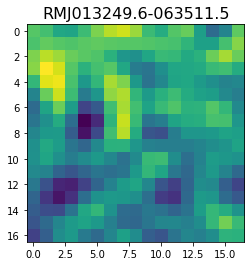

 21%|██        | 2131/10099 [02:55<24:06,  5.51it/s]

<class 'pixell.enmap.ndmap'>
[ -83.8681    -97.46005  -137.30328  -143.89717   -97.024765  -53.792656
  -68.49639  -118.37475  -145.98225  -142.15634  -140.59375  -148.83182
 -136.84792   -95.530136  -60.838585  -64.01205   -90.35677 ]


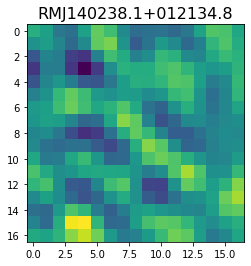

 21%|██        | 2132/10099 [02:55<25:29,  5.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -70.73031    -63.17689    -17.35926     -3.0603426  -55.122734
  -91.34368    -19.568102   102.49175    121.02697      4.500451
  -99.627655   -66.33792     39.576042    64.96386    -23.33031
 -113.5562    -109.83074  ]


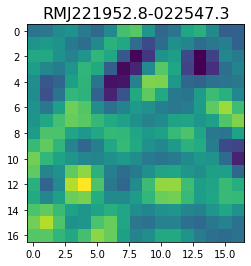

 21%|██        | 2138/10099 [02:55<12:53, 10.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -66.36917  -119.332855 -148.74805  -124.79204   -69.3335    -18.156271
  -14.559993  -88.41569  -200.64691  -251.58923  -191.27663   -92.92878
  -69.456955 -132.90111  -187.27985  -163.43953  -109.67291 ]


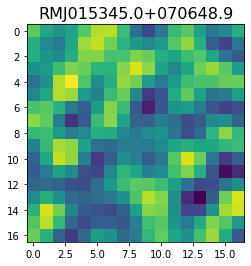

 21%|██        | 2141/10099 [02:55<12:30, 10.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -43.791653  -57.901314  -68.52311   -79.918755  -95.55687  -100.629875
  -81.02706   -48.689148  -31.954704  -41.953518  -59.673466  -59.382927
  -38.194298  -16.894438  -13.907152  -25.763027  -36.384712]


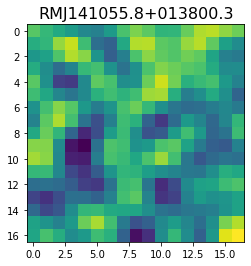

 21%|██        | 2144/10099 [02:56<12:16, 10.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-100.126724 -123.69669  -133.55319  -121.6839    -76.2012    -21.044344
  -10.556613  -46.744797  -68.34871   -57.3389    -70.06164  -118.319
 -123.18843   -51.352467    9.348216  -10.567741  -51.04689 ]


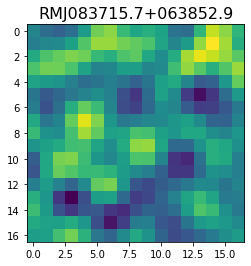

 21%|██▏       | 2147/10099 [02:56<12:07, 10.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -7.2161455   -7.261476    -5.797603    -6.7153645   -8.34948
  -6.2775736   -1.9086423   -0.62743896  -1.9248183   -0.12678176
   4.2165446    3.828704    -2.1690187   -6.0724573   -5.895519
  -8.900962   -16.211395  ]


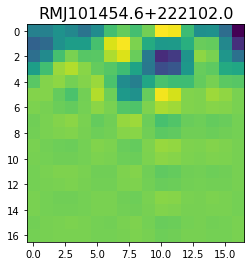

 21%|██▏       | 2149/10099 [02:56<12:57, 10.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-17.16187   -54.188435  -60.89033   -29.073854   -4.5649266 -15.367307
 -34.226826  -31.072096  -19.305714  -24.152937  -39.105755  -42.466904
 -33.978683  -29.81429   -36.108604  -46.125618  -53.32967  ]


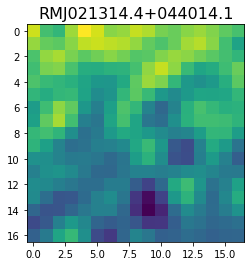

 21%|██▏       | 2155/10099 [02:56<09:55, 13.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.471578 -12.553607 -35.61606  -42.028057 -48.981    -58.511
 -48.53943  -22.272997 -17.527794 -45.84021  -66.96549  -52.52647
 -33.770363 -48.655003 -77.20404  -76.94803  -58.12672 ]


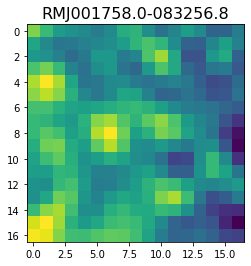

 21%|██▏       | 2165/10099 [02:57<06:47, 19.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-127.666595  -96.654564 -155.0202   -231.41461  -237.5396   -178.77002
 -133.61015  -144.9888   -183.3342   -211.8488   -231.48964  -246.20969
 -234.64882  -189.69514  -151.5471   -161.27094  -199.99643 ]


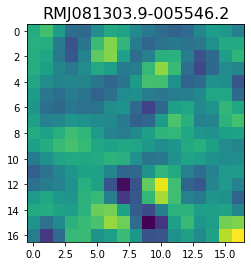

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[242.85994  186.20662   42.681057  49.07135  130.95888   65.68682
 -86.90798  -59.09594  159.3985   267.63715  122.04301  -35.206978
  46.973064 251.35757  289.91705  139.84435   53.249607]


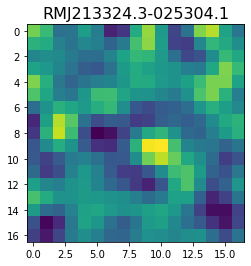

 21%|██▏       | 2168/10099 [02:57<10:16, 12.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  48.841805  -261.0526    -425.51886   -206.1409     -13.5723715
 -160.39775   -356.88116   -307.56033   -241.3148    -391.87555
 -472.4276    -188.45271    152.29605     90.03385   -252.6156
 -393.65167   -181.31157  ]


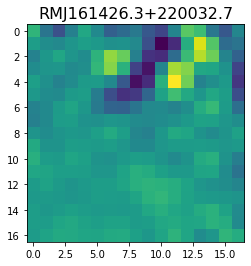

 22%|██▏       | 2172/10099 [02:58<10:01, 13.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -4.3545527  15.386983   38.366932   43.88727    29.052004   21.974613
  41.56738    68.064285   73.83965    60.336826   42.59425    20.339504
  -9.228288  -28.257936  -16.143341   18.729614   46.956207 ]


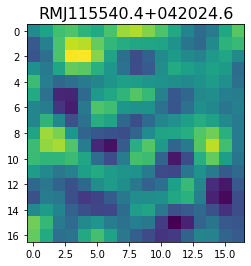

 22%|██▏       | 2175/10099 [02:58<10:17, 12.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-67.612206 -28.167149  61.492016 107.114876 142.19313  200.37134
 197.97356   81.17231  -30.645363  -1.606617 108.3244   139.91396
  82.28224   70.511955 160.42569  246.45888  219.67264 ]


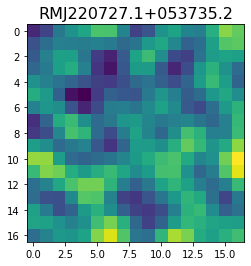

 22%|██▏       | 2179/10099 [02:58<09:59, 13.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[78.39842  76.18998  59.455257 50.395428 58.04634  65.89185  56.234203
 34.185226 19.53685  22.64513  36.93979  51.1397   60.051323 63.30873
 60.841022 53.607246 45.84107 ]


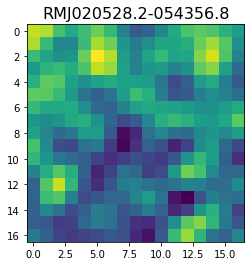

 22%|██▏       | 2184/10099 [02:58<09:42, 13.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 84.29201   48.023643  99.65455  160.76201  136.04555   65.717514
  69.756546 162.34544  223.50899  172.89844   82.621254  67.95152
 129.80583  174.45276  156.00662  122.74299  122.93765 ]


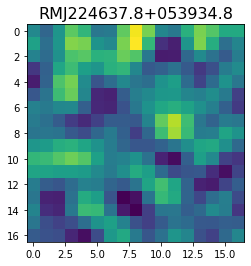

 22%|██▏       | 2188/10099 [02:59<09:39, 13.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-138.55089  -125.40874   -82.19318   -54.679955  -57.80936   -82.9229
 -122.39722  -154.38605  -152.7737   -134.95663  -141.2629   -153.07771
 -110.36926   -31.653324  -19.464045 -103.589096 -177.41121 ]


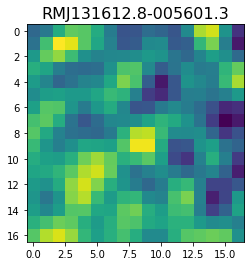

 22%|██▏       | 2191/10099 [02:59<09:59, 13.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-15.396281   14.249135   43.65729     9.239288  -53.17021   -66.24352
 -28.68696     2.5776637   7.2420263   6.966032    6.587523   -8.506845
 -35.7857    -58.483337  -67.725845  -58.798836  -30.051596 ]


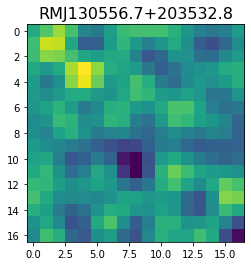

 22%|██▏       | 2195/10099 [02:59<09:34, 13.76it/s]

<class 'pixell.enmap.ndmap'>
[ -83.86353     -8.768114  -106.013336  -199.97011   -158.67493
  -65.5349     -51.038807   -91.30918    -87.90826    -61.918373
 -119.40869   -243.04582   -274.90887   -148.2022       3.5554192
   42.33781      4.7036285]


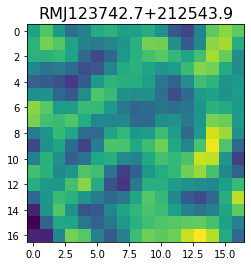

<class 'pixell.enmap.ndmap'>
[31.65529   47.56769   43.311794  27.090477  12.528073   4.92051
  5.3660917 15.248352  30.307426  38.86966   33.335167  20.01122
 12.901843  19.369717  34.534737  48.477726  56.434467 ]


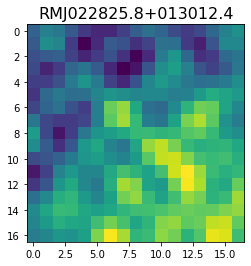

 22%|██▏       | 2197/10099 [03:00<13:03, 10.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[164.24495  116.42769  127.9862   164.6124   128.1304    55.05202
  58.91669  110.78027   92.1368    27.90951   34.07715   75.797676
  30.715704 -46.123623   8.454125 157.24414  198.38945 ]


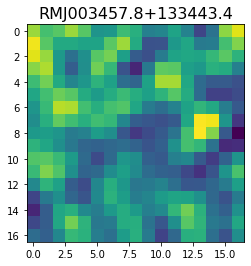

 22%|██▏       | 2200/10099 [03:00<12:40, 10.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-88.18327   34.765026 120.136246  44.8219   -87.583244 -83.364586
  71.64897  198.53749  169.99806   59.978313  17.279942  68.18215
 108.59945   63.310184 -16.370039 -33.365223  24.593393]


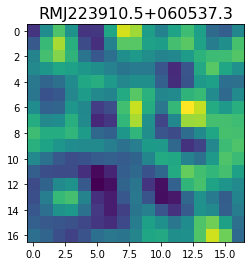

 22%|██▏       | 2202/10099 [03:00<13:30,  9.74it/s]

<class 'pixell.enmap.ndmap'>
[212.73528 213.84457 210.60373 194.2379  187.36705 208.53818 235.28888
 233.63072 209.40303 200.02357 221.64415 250.9281  259.0973  243.42789
 221.69467 209.9468  211.54276]


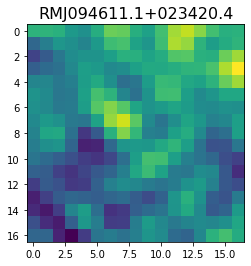

<class 'pixell.enmap.ndmap'>
[ 97.791115 103.652214  89.51328   69.33212   70.96416   95.489075
 114.90027  114.46202  112.570244 127.944084 149.34354  153.27242
 134.78735  105.51339   76.275444  57.626534  62.962105]


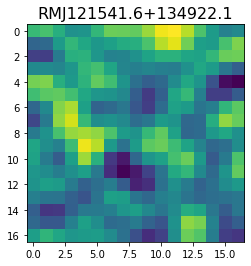

 22%|██▏       | 2211/10099 [03:01<09:02, 14.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-109.268776   -98.13197    -33.18386     11.217442    -1.7229197
  -44.9012     -53.848133     2.602726    65.21722     36.615135
  -85.958115  -181.34323   -153.93552    -65.304535   -48.177975
 -117.48881   -151.98682  ]


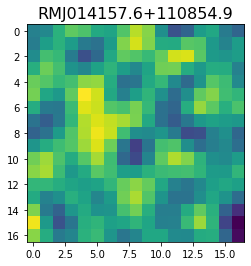

 22%|██▏       | 2214/10099 [03:01<09:27, 13.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -91.54881   -63.66055   -80.327614 -121.73806  -148.05522  -159.04022
 -160.141    -135.4558    -95.62362   -82.51242   -92.30751   -71.87693
  -22.06129   -16.380589  -78.93501  -131.00839  -106.09483 ]


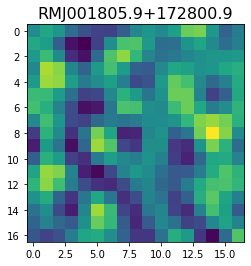

 22%|██▏       | 2217/10099 [03:01<09:50, 13.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[109.12724  124.12498  133.13464  104.55611   82.51601  116.67113
 161.51175  146.90462   98.43749   80.930786  81.98778   64.31077
  65.08379  121.07349  164.14836  119.10645   42.179714]


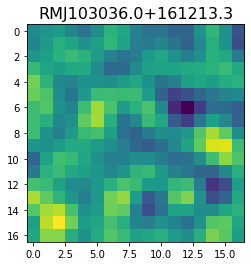

<class 'pixell.enmap.ndmap'>
[ -92.65067   -84.363495 -107.18161  -112.38018   -80.76481   -57.105568
  -61.86026   -58.486687  -41.554585  -57.49408  -104.55023  -116.62125
  -78.37831   -52.33872   -65.33211   -72.20883   -54.72365 ]


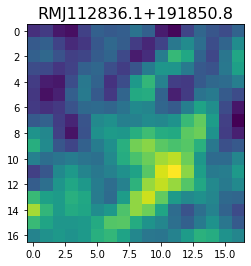

 22%|██▏       | 2219/10099 [03:02<13:45,  9.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[85.81484  73.12238  76.6276   66.66807  42.241405 40.979538 75.42944
 98.97102  71.15428  23.892038 15.165224 42.967743 60.961124 58.56403
 59.720116 55.263943 12.676553]


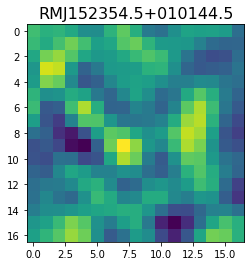

 22%|██▏       | 2221/10099 [03:02<15:30,  8.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-54.307106 -30.173552  15.230567  14.965897 -33.40942  -67.19359
 -56.389523 -39.409107 -50.900467 -71.09777  -68.910324 -50.220875
 -37.000244 -31.155684 -24.612246 -22.596094 -33.9492  ]


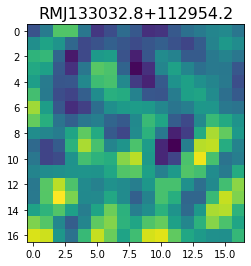

 22%|██▏       | 2224/10099 [03:02<14:19,  9.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.15206   82.40822   35.89888   53.17824  130.68402  180.88132
 139.6983    46.077774 -10.90691    7.715327  67.72249  109.31423
  96.22767   45.84018   25.634027  84.444855 174.31859 ]


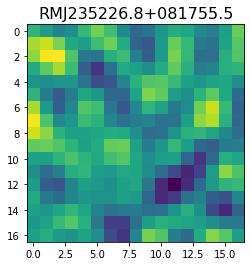

 22%|██▏       | 2229/10099 [03:03<11:11, 11.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-154.34964   -161.74333   -197.94893   -195.68076   -127.15946
  -77.76136   -107.779     -146.8601    -118.540726   -70.22581
  -81.56303   -128.68874   -135.11061    -90.44952    -38.28837
   -5.0008273   -4.366911 ]


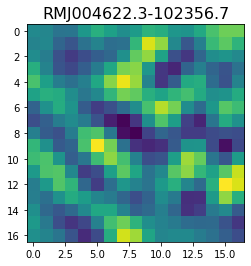

 22%|██▏       | 2233/10099 [03:03<10:22, 12.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[214.08012 185.83969 128.0677  116.58659 145.67366 165.08533 178.37288
 214.6548  242.69437 208.64339 139.53578 121.03886 176.53154 240.47594
 251.09789 211.14224 159.91164]


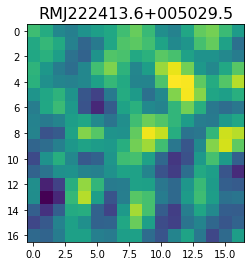

 22%|██▏       | 2236/10099 [03:03<10:29, 12.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-177.29187  -249.2869   -227.02715  -147.01906  -112.49383  -115.88723
 -108.663445 -133.79073  -228.16432  -287.51886  -199.57524   -48.884094
  -19.78246  -126.27015  -197.0362   -130.01288   -25.36558 ]


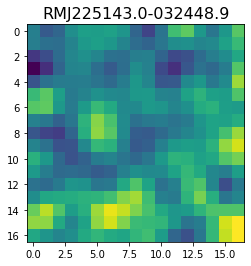

 22%|██▏       | 2241/10099 [03:03<09:27, 13.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.218386  27.226503  46.93852   55.00575   53.12059   66.18487
  98.26338  115.87183   99.65992   79.68864   84.126595  88.6054
  63.815853  40.07038   66.0855   126.59773  161.22704 ]


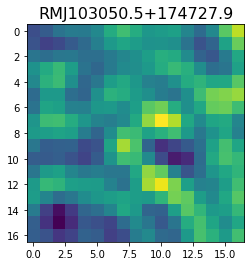

 22%|██▏       | 2243/10099 [03:04<10:31, 12.44it/s]

<class 'pixell.enmap.ndmap'>
[119.05467   94.90245  103.41985  120.97817  123.61752  125.707275
 149.23787  175.63708  167.80078  129.67303  102.873985 105.78958
 115.18892  112.588715 110.83892  122.48622  134.23013 ]


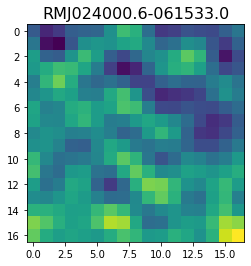

 22%|██▏       | 2245/10099 [03:04<12:00, 10.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  86.2192       7.0566716  -19.183908    14.177517    39.792835
   18.9783     -20.967524   -52.31417    -65.96059    -20.940865
  111.1117     229.22098    173.77147    -26.995096  -133.44823
  -15.36331    151.27037  ]


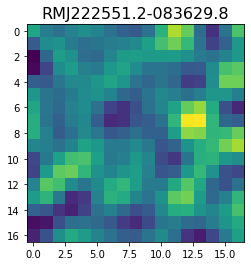

 22%|██▏       | 2247/10099 [03:04<12:55, 10.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[259.83148  354.223    225.13701   -4.591201 -61.64059   97.2919
 237.77315  209.44174  130.61617  133.20833  151.76552  100.079865
  60.298275 127.78942  218.60728  204.08391  121.819374]


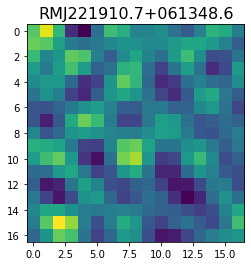

 22%|██▏       | 2250/10099 [03:04<12:28, 10.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 87.031364   90.71699   103.028915  124.338684  115.50355    77.4929
  61.125202   72.39572    52.051025  -16.125904  -54.93209    -0.862927
  94.48552   124.12948    61.288193   -7.0687876  16.699654 ]


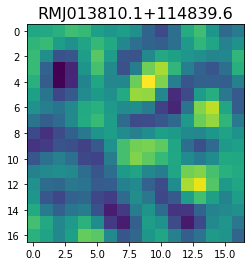

 22%|██▏       | 2255/10099 [03:05<10:20, 12.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[96.90359  80.16256  93.479324 98.89649  79.669815 65.10216  78.56101
 96.33577  83.43502  49.510056 35.80989  52.084213 63.73995  51.294594
 43.779186 66.040405 87.083145]


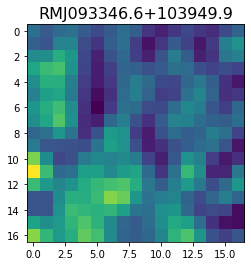

 22%|██▏       | 2258/10099 [03:05<10:36, 12.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  62.09319     47.398823    62.39674     68.22383    -22.401537
 -154.11526   -155.15054     -3.2954497  108.91417     56.921215
  -39.843628   -36.9834       6.5933504  -30.146547  -101.636284
  -85.29992     -4.767015 ]


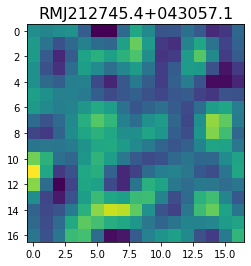

 22%|██▏       | 2260/10099 [03:05<11:40, 11.19it/s]

<class 'pixell.enmap.ndmap'>
[-12.977649   -75.72749    -12.086466    75.06505     63.850986
   2.9122055   15.453498    87.408356    97.592995    25.288141
 -21.707249    11.574981    53.940266    41.224136     5.378316
  -6.115466    -0.96402425]


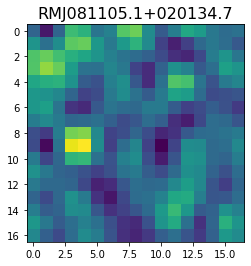

<class 'pixell.enmap.ndmap'>
[ 3.33416290e+01  6.13458557e+01  2.92031193e+00 -6.55995178e+01
 -2.90737820e+01  4.46663399e+01 -3.34638804e-02 -1.14308090e+02
 -9.46346359e+01  6.17499771e+01  1.24850006e+02  1.09825726e+01
 -8.60719986e+01 -3.71120300e+01  2.06960926e+01 -4.70768547e+01
 -1.45763626e+02]


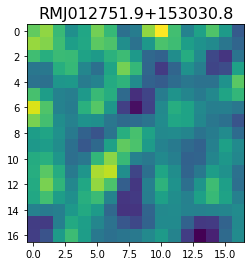

 22%|██▏       | 2262/10099 [03:06<16:40,  7.84it/s]

<class 'pixell.enmap.ndmap'>
[ -6.7694297 -41.62255   -89.603584  -95.93055   -67.203674  -40.977016
 -13.888474   29.203293   53.003677   19.053364  -37.783455  -57.54416
 -46.0752    -44.787872  -48.7634    -30.113142   -7.016775 ]


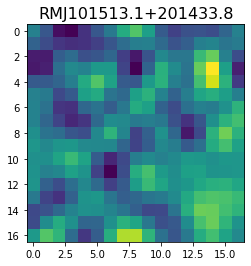

 22%|██▏       | 2263/10099 [03:06<18:23,  7.10it/s]

<class 'pixell.enmap.ndmap'>
[ -8.38053   -14.729288   -4.423736  -12.375762  -47.92922   -75.46997
 -67.93759   -41.334873  -19.248154    1.6833476  27.03081    36.34055
  12.897894  -17.446527  -13.960186   18.813562   34.075466 ]


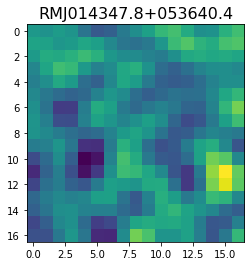

 22%|██▏       | 2264/10099 [03:06<20:08,  6.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -53.677517    -70.06398     -48.513752     -0.16517533    7.2142158
  -56.21707    -123.21683    -114.937065    -53.81751     -30.51967
  -73.35663    -116.84502    -107.316154    -78.60315     -91.38077
 -138.29695    -154.56255   ]


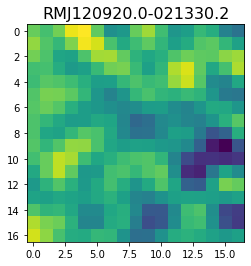

 22%|██▏       | 2266/10099 [03:06<18:42,  6.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -95.438934  -84.19058  -109.32146   -97.908264  -24.591747   31.632565
   12.324772  -41.356743  -69.37142   -64.13087   -45.67127   -44.74264
  -97.101105 -172.64494  -158.28113   -17.914207   98.034164]


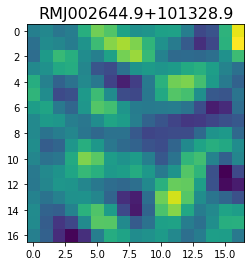

 23%|██▎       | 2278/10099 [03:07<07:15, 17.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-53.739143  -11.13505    11.156445   -5.8814425 -17.215107    1.5192385
  14.276667   -2.9847577 -21.136288  -22.229958  -34.277744  -63.538387
 -62.903145  -13.69248    27.18004    12.551854  -21.947409 ]


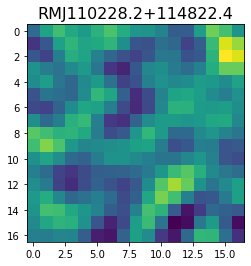

 23%|██▎       | 2281/10099 [03:07<08:07, 16.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[161.49771  130.10402  124.59878  118.88771  107.98979  112.19369
 128.43015  123.85822   93.821365  82.005325 112.13137  138.74585
 111.235695  58.092285  51.316807  99.939705 138.59329 ]


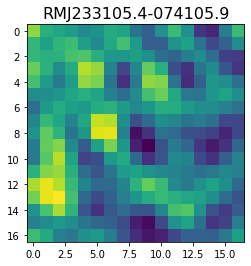

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.95592    -60.15691    -34.61031     -0.90758526 -30.29474
 -60.621113     1.2833965   97.5646     110.36909     52.97606
  25.368412    56.681026    98.19294    102.949425    59.166016
  11.121754    34.842197  ]


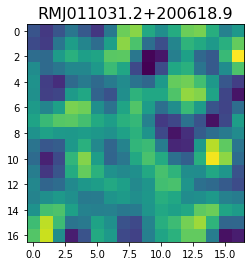

 23%|██▎       | 2284/10099 [03:08<11:14, 11.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-305.69885  -289.91742   -45.43071    71.237434 -135.02661  -367.01193
 -308.78043  -109.20087   -97.876305 -273.85638  -379.8504   -315.1201
 -204.15175  -151.23936  -144.81024  -164.88446  -221.41435 ]


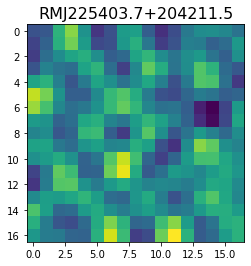

 23%|██▎       | 2286/10099 [03:08<11:58, 10.87it/s]

<class 'pixell.enmap.ndmap'>
[ 74.95693    9.507418  64.225136 201.83583  254.36137  161.2959
  52.313084  33.452335  52.14351   51.310814  82.41712  161.52145
 185.25717  112.4079    64.341896 115.210655 149.39899 ]


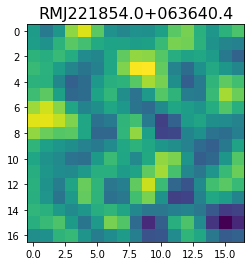

 23%|██▎       | 2288/10099 [03:08<12:46, 10.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[44.57475    77.60441    88.881805   60.33383    27.159515   32.440853
 63.498257   74.15296    59.448315   58.2815     81.45724    91.13257
 65.95932    36.237396   29.637701   26.173258   -0.11266306]


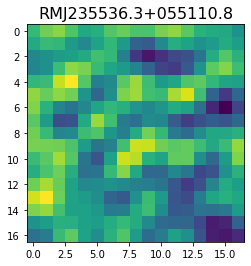

<class 'pixell.enmap.ndmap'>
[-188.68912  -174.10587   -78.146454   15.644297   20.490602  -51.452843
  -94.777756  -53.562046  -15.629994  -91.25896  -228.27744  -255.39009
 -119.67365    29.1565     38.595913  -54.517353 -103.745674]


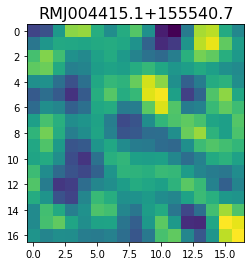

 23%|██▎       | 2290/10099 [03:09<18:12,  7.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   8.05185     12.75623     -8.166932   -14.4142275  -32.285984
  -55.15414    -24.994997    29.902803     6.2889256  -82.687096
 -106.01225    -36.911247     9.510063   -14.819799   -33.560368
  -17.177662   -25.894087 ]


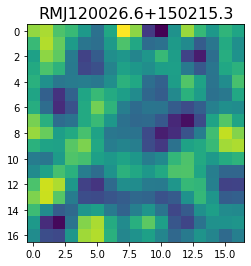

 23%|██▎       | 2294/10099 [03:09<15:18,  8.50it/s]

<class 'pixell.enmap.ndmap'>
[ 51.86892   38.79847   30.217102  49.837975  90.99268  115.379395
 102.15936   77.22229   75.83357   93.39569   98.31766   83.82927
  76.50986   91.82072  110.498276 111.13559  102.74779 ]


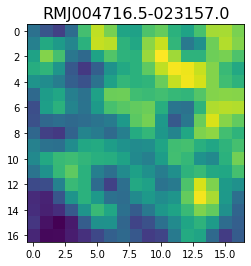

 23%|██▎       | 2296/10099 [03:09<15:38,  8.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 46.459568   58.76284    34.98132    -2.2172914 -47.6607    -79.933975
 -57.006252    5.792187   28.952295  -11.728475  -42.598946  -15.635543
  21.881422   25.211636   18.602432   22.913012   15.913262 ]


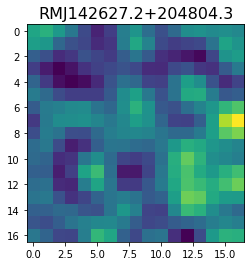

 23%|██▎       | 2300/10099 [03:10<13:57,  9.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-71.46297   -39.737595  -16.907639  -44.932125  -82.103615  -89.035545
 -84.98564   -89.963     -80.3504    -39.44485    -2.4667313 -12.107216
 -56.989162  -85.155624  -66.78371   -24.150288   -1.0046451]


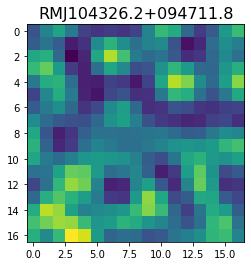

 23%|██▎       | 2310/10099 [03:10<07:37, 17.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-31.352493   -8.9869995 -12.4108925 -31.584986  -28.649128    0.7479762
  19.03777     2.9157624 -25.073101  -33.31361   -24.146921  -23.296818
 -41.65777   -64.050644  -70.49528   -57.95649   -40.99725  ]


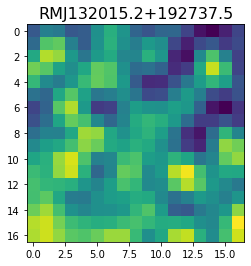

 23%|██▎       | 2313/10099 [03:10<08:41, 14.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-249.53291  -107.95817   -33.778145 -191.2532   -274.24405  -182.8176
 -119.594765 -147.98373  -184.76845  -233.87956  -303.10712  -333.1211
 -329.7981   -301.74094  -157.23853    49.106915   35.556034]


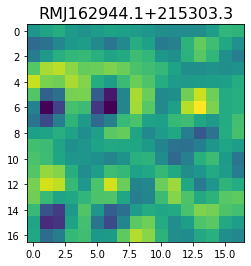

 23%|██▎       | 2316/10099 [03:10<09:40, 13.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.45423    72.55478    71.104546   27.976524   19.03309    48.749596
  60.537155   47.9508     42.630302   30.023144  -11.488593  -34.4909
   6.5877876  62.342625   65.19132    35.56201    21.420223 ]


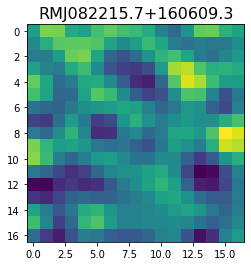

 23%|██▎       | 2318/10099 [03:11<11:22, 11.40it/s]

<class 'pixell.enmap.ndmap'>
[ -42.377666  -57.27286   -77.95681   -91.613014  -49.135197   14.470739
    2.386276  -82.68074  -128.87115   -84.64175   -28.311644  -45.87328
 -120.12215  -168.17899  -144.25244   -79.94825   -33.910343]


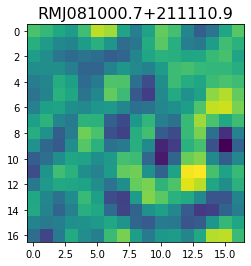

<class 'pixell.enmap.ndmap'>
[ 87.58001   96.657814  59.72034   22.280575  22.74235   30.85259
  26.810537  47.023396  96.178215 110.77425   69.96823   46.809566
  84.37834  112.41173   58.467865 -35.946426 -80.45618 ]


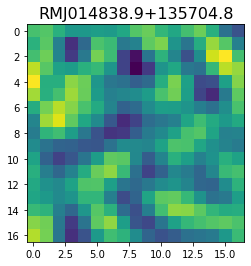

 23%|██▎       | 2328/10099 [03:11<08:21, 15.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-100.00129   -12.113399   66.349594   32.218395  -66.11046  -133.69283
 -165.4002   -193.86284  -207.79839  -190.78389  -159.41158  -117.82364
  -43.320793   53.82405   114.88573   100.15801    35.383423]


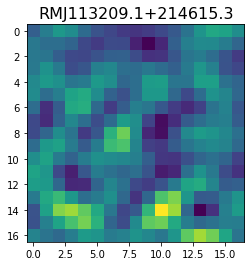

 23%|██▎       | 2331/10099 [03:12<08:56, 14.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-107.49358    -23.404234    15.775456     2.033469   -13.06996
  -17.77129    -44.63744    -82.67517    -71.92504     -4.530028
   46.771706    32.897354    -6.4347873  -18.317362   -14.812275
  -30.788248   -55.623154 ]


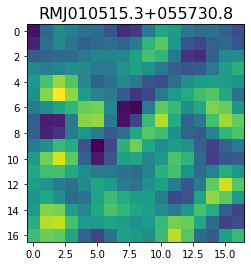

 23%|██▎       | 2334/10099 [03:12<09:24, 13.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 20.025366   26.054138    5.153727  -11.059871   -2.4284961   4.450441
  -6.3972034  -3.091588   30.84539    52.30611    29.972742    5.2176895
  21.75585    46.088406   26.697079  -11.1153755  -4.9511485]


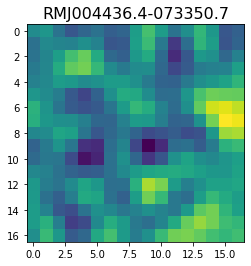

 23%|██▎       | 2337/10099 [03:12<09:54, 13.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-15.37269    -6.820482   31.525599   53.764725   37.333786   10.068279
   1.6622576  13.235033   32.80203    45.132442   35.134796    8.608477
  -6.3108582   2.6364012  15.720924   16.234047   11.856714 ]


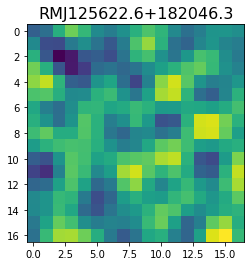

 23%|██▎       | 2339/10099 [03:12<10:58, 11.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-13.78364  -42.52996  -73.33733  -89.53723  -88.769775 -84.33994
 -81.750694 -69.185356 -42.652145 -23.04799  -29.03124  -45.86955
 -43.53735  -17.897892   7.684223  16.217329  11.432416]


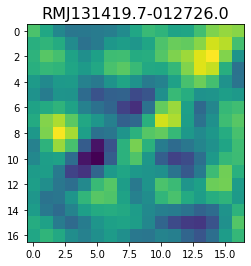

<class 'pixell.enmap.ndmap'>
[   1.5131323  -12.702592   -86.09366   -124.439514  -109.56124
 -121.467995  -180.47414   -190.62851   -113.34763    -68.33007
 -151.24237   -266.5574    -275.65042   -215.14307   -218.3347
 -289.8021    -315.46884  ]


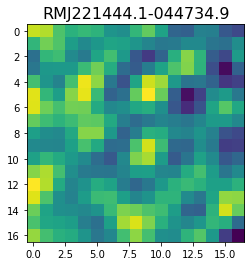

 23%|██▎       | 2341/10099 [03:13<14:58,  8.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -62.691322   -67.81498    -73.552734   -69.02454    -17.957579
   49.415287    29.482052   -93.27463   -165.204      -67.2097
   82.52539     93.53067     -1.5432882  -23.651224    30.218548
   -7.2443943 -145.25229  ]


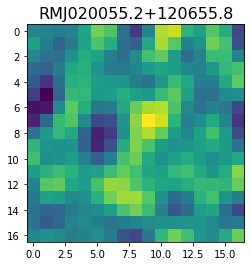

 23%|██▎       | 2343/10099 [03:13<15:27,  8.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-129.28177 -144.30424 -163.0549  -158.56757 -138.42226 -128.95343
 -138.45447 -155.76222 -169.49083 -168.83304 -142.85614 -103.32915
  -91.42113 -130.6951  -183.86633 -190.56061 -145.93736]


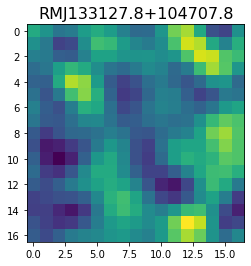

 23%|██▎       | 2345/10099 [03:13<16:31,  7.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[134.42975 148.38914 143.47775 125.91742 116.61697 122.6566  132.91463
 136.37946 133.14066 128.76324 126.23005 124.4193  120.62178 113.5789
 103.92472  91.36332  75.41898]


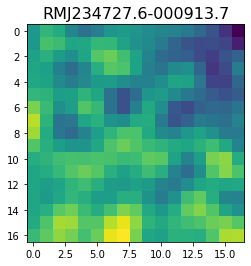

 23%|██▎       | 2347/10099 [03:14<16:35,  7.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-20.601055  -20.352312    5.3817644  19.278036   13.768624   17.826237
  37.4215     40.0135     12.756949   -9.205158    5.2739644  38.916573
  56.41638    49.737484   31.047003    7.216573  -13.949634 ]


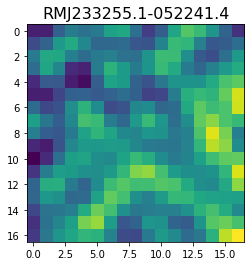

 23%|██▎       | 2349/10099 [03:14<16:06,  8.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  56.826984   -15.378506   -96.22985   -117.71348    -53.962696
   25.280909    18.579496   -75.43212   -139.55765    -88.828606
    9.161564    29.641184   -29.899897   -56.419167    -0.5789081
   51.085155    13.323255 ]


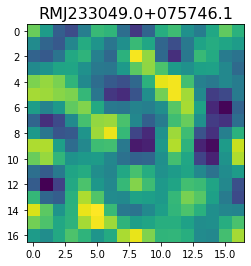

 23%|██▎       | 2353/10099 [03:14<12:41, 10.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[23.909649  73.34003   84.294     47.93265   24.919119  47.570465
 69.24817   43.664314   2.6251645  5.195134  44.08235   60.086117
 33.95439    6.3619184  5.86903   10.83173   -0.538497 ]


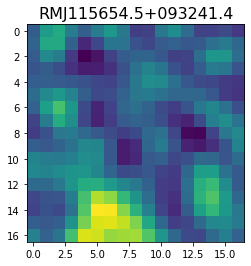

 23%|██▎       | 2355/10099 [03:14<13:22,  9.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 76.14742    49.239353    5.0175285 -28.602808  -21.151735   37.483902
  97.92804    80.14586   -14.813625  -74.587006  -15.0216875 102.626274
 160.0851    134.3475     85.22667    39.760387  -20.640392 ]


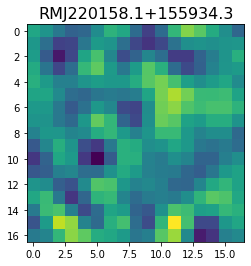

 23%|██▎       | 2357/10099 [03:15<13:56,  9.26it/s]

<class 'pixell.enmap.ndmap'>
[ 45.13625    19.029173    6.4221797  22.357943   36.750206   24.897635
   0.591055  -11.583183   -5.0037823  17.469667   51.03697    78.28254
  78.69411    59.28222    51.663597   69.71799    91.96696  ]


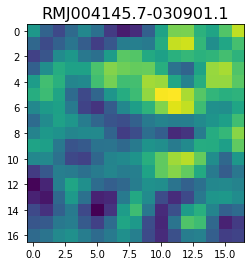

 23%|██▎       | 2358/10099 [03:15<16:35,  7.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-105.75299   -98.69497  -152.02438  -171.52623   -95.52686   -11.354399
  -28.280128 -118.96929  -184.16354  -191.35455  -158.04042   -88.09483
  -15.608678  -16.971174  -92.1612   -134.5968    -97.469   ]


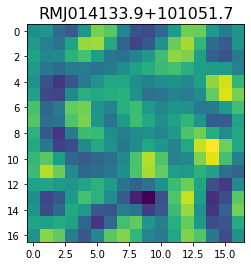

 23%|██▎       | 2364/10099 [03:15<10:51, 11.87it/s]

<class 'pixell.enmap.ndmap'>
[ 110.54593    120.37037    -37.52079   -152.05873    -56.488235
  111.756516   117.03474    -22.793158   -89.42935     -9.707136
   57.650383    -5.8311305  -96.0779     -57.395374    77.68524
  138.47731     65.06719  ]


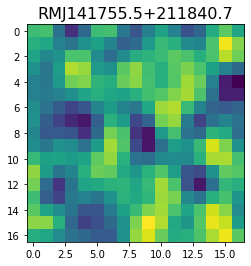

 23%|██▎       | 2366/10099 [03:15<12:01, 10.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-38.04556  -42.267887 -48.222267 -51.236534 -49.837894 -37.135853
   7.442432  87.12057  162.04784  187.95049  168.03645  133.79724
  92.03169   32.865692 -23.7647   -39.739307 -15.790315]


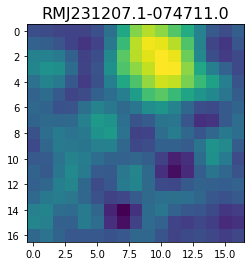

 23%|██▎       | 2369/10099 [03:16<11:37, 11.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[106.62344   74.03394   89.0776   106.275375 120.16822  154.52904
 186.55447  172.4829   133.93304  131.3175   160.94153  163.93666
 132.99039  125.43302  163.71544  199.87346  194.12152 ]


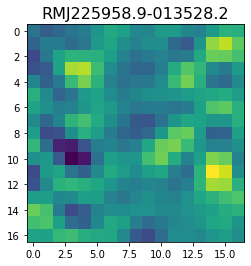

 23%|██▎       | 2371/10099 [03:16<12:47, 10.07it/s]

<class 'pixell.enmap.ndmap'>
[-102.99538    -89.17623    -61.91426    -47.67121    -74.2681
 -119.7739    -137.3265    -125.41564   -120.20233   -128.6781
 -132.13756   -141.72018   -177.06804   -199.79848   -150.70517
  -53.331627    -0.2994774]


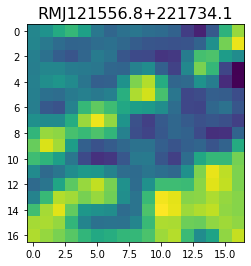

 23%|██▎       | 2372/10099 [03:16<15:37,  8.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-56.305187   -39.35517    -24.998783    -0.45280686  37.96311
  52.72277     14.186446   -42.189316   -58.06414    -33.42932
 -16.003159   -26.689793   -46.551956   -62.961895   -75.71492
 -68.83223    -30.62798   ]


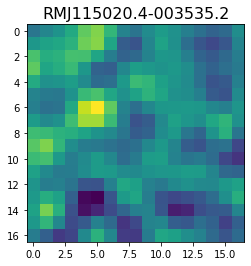

 24%|██▎       | 2374/10099 [03:16<16:10,  7.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-135.59889  -182.16109  -211.67422  -175.31216  -114.363716 -107.9902
 -149.63115  -155.19324   -97.41618   -46.93905   -57.50541   -90.46097
  -91.25203   -73.00122   -75.85735   -94.22783   -95.82512 ]


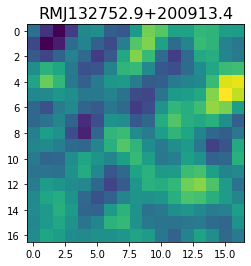

 24%|██▎       | 2377/10099 [03:17<14:49,  8.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.39212     36.26511     29.8834      27.601267    23.968931
  10.590581     0.47141886  12.839932    36.60158     37.706703
   9.813959   -10.203371     7.0475454   40.773582    50.376965
  31.432838    14.087551  ]


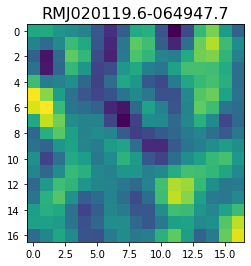

 24%|██▎       | 2380/10099 [03:17<14:22,  8.95it/s]

<class 'pixell.enmap.ndmap'>
[  5.697319  17.129576  14.074946  -2.803859  -8.108719  15.731038
  48.066402  56.01296   41.962776  36.569916  46.39484   43.324562
  18.16125    9.814022  50.94508  107.69924  115.20633 ]


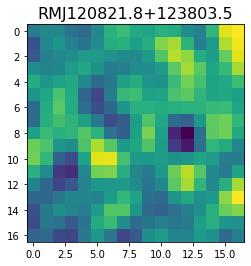

 24%|██▎       | 2381/10099 [03:17<16:27,  7.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-103.575584    -2.0185344  103.15263    126.426346    76.35318
   -5.2829795  -96.50298   -163.9319    -157.00087    -74.41918
   12.546359    39.11641     18.338827     7.8043156   29.854862
   50.731564    30.879045 ]


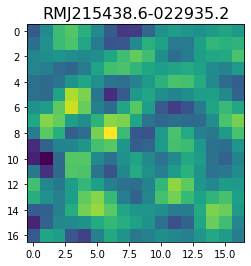

 24%|██▎       | 2383/10099 [03:18<16:00,  8.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[131.64366  105.23843   70.20492   79.705055 117.73748  143.49294
 155.80211  156.669    111.88219   21.198    -25.419527  47.328182
 171.0078   207.01068  139.15843   92.54838  144.63133 ]


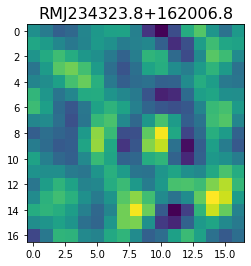

 24%|██▎       | 2385/10099 [03:18<15:55,  8.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-408.73245 -388.31564 -425.15952 -450.6581  -408.1394  -347.7869
 -335.53915 -348.93414 -337.4237  -319.81628 -343.0827  -392.21884
 -415.70154 -408.49792 -404.95642 -412.34872 -407.78598]


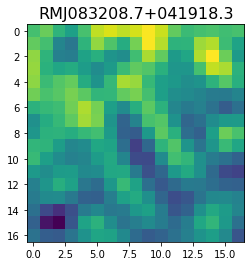

 24%|██▎       | 2387/10099 [03:18<15:58,  8.04it/s]

<class 'pixell.enmap.ndmap'>
[-38.51873   -7.727583 -19.646317 -54.627083 -76.50559  -79.32158
 -77.258865 -71.31506  -53.08745  -30.235756 -23.186457 -37.661053
 -55.909664 -56.37795  -35.388275 -10.545673  -4.202302]


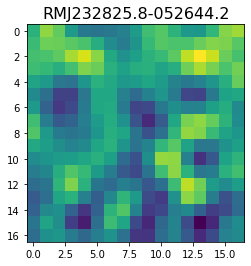

 24%|██▎       | 2388/10099 [03:18<18:29,  6.95it/s]

<class 'pixell.enmap.ndmap'>
[105.02499   67.94908   67.32515  100.803635 110.57589   84.040695
  72.13366  101.38745  130.0279   115.33017   75.987434  55.03839
  56.5159    55.60981   47.34671   45.73463   46.936363]


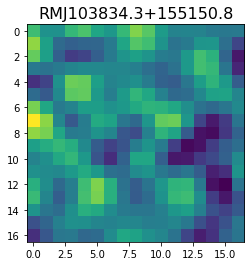

 24%|██▎       | 2389/10099 [03:19<20:44,  6.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.651695  30.793047 -18.729042 -58.11321  -51.005524 -21.375877
  -7.058062 -11.784559 -22.252745 -34.545197 -42.584797 -34.108204
 -16.694511 -16.824139 -38.791653 -55.574677 -51.781254]


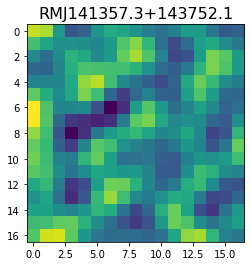

 24%|██▍       | 2400/10099 [03:19<07:43, 16.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-21.037388    3.1044848  23.95932    31.110092   17.08207    -9.123867
 -22.76385   -10.722256    8.936647    8.74231   -11.562488  -25.476875
 -16.153559    2.8017628   7.5715113  -6.197646  -21.525892 ]


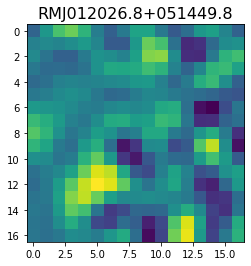

<class 'pixell.enmap.ndmap'>
[ -98.56893   -85.1674    -74.27432   -73.43279   -79.091095  -83.59711
  -87.34386   -99.37369  -121.79361  -138.26619  -131.0212   -110.37205
 -107.72875  -129.17227  -139.00954  -111.38494   -77.57916 ]


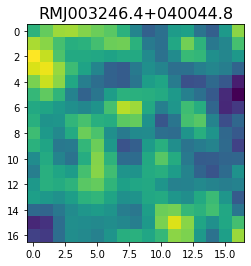

<class 'pixell.enmap.ndmap'>
[-268.15982 -250.62703 -256.34476 -319.54755 -363.14114 -304.84528
 -217.04736 -234.62805 -335.29984 -369.7245  -301.0817  -254.5776
 -308.1692  -378.92856 -365.25027 -290.36584 -244.62057]


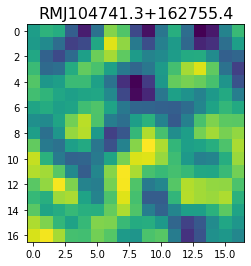

 24%|██▍       | 2403/10099 [03:20<14:09,  9.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-17.799307  -23.681892   -6.380578   21.47846    10.764233  -37.309807
 -61.420017  -36.57227   -11.86453   -24.45047   -41.24712   -24.176569
   2.6443748  -3.9238362 -35.540108  -48.64947   -27.74042  ]


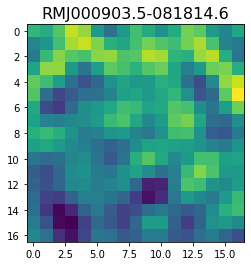

 24%|██▍       | 2407/10099 [03:20<12:34, 10.20it/s]

<class 'pixell.enmap.ndmap'>
[113.0383   119.60601  153.00754  148.56784  110.686966 118.99639
 197.63498  247.39145  169.84872   24.608337 -26.865082  60.86597
 160.8515   179.40404  195.94202  291.85034  353.02576 ]


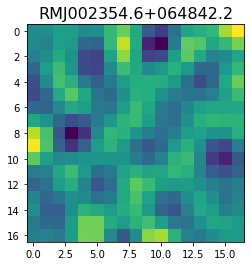

 24%|██▍       | 2409/10099 [03:20<13:26,  9.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -38.705605  -84.78022   -28.707975   47.65839    17.000175  -83.98602
 -111.32304   -44.876705  -11.874341  -75.40928  -142.00662  -122.77955
  -69.6477    -79.54355  -141.4751   -162.33618  -109.60163 ]


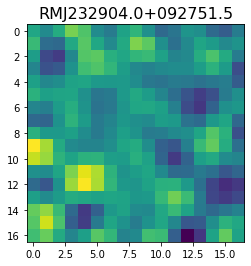

 24%|██▍       | 2417/10099 [03:21<09:04, 14.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 65.55131   99.94111  149.28093  154.59044  129.32872  116.02151
 128.38051  155.52666  177.0179   168.18611  132.55864  118.536934
 156.07095  197.36172  178.71332  118.22429   84.91069 ]


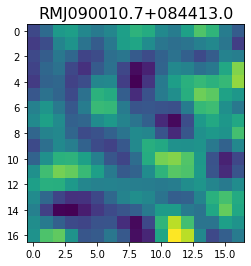

 24%|██▍       | 2420/10099 [03:21<10:00, 12.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-14.706467   -25.62456    -49.554363   -50.826046   -18.14519
   8.867861    -3.862828   -34.873463   -43.28256    -30.248575
 -27.714108   -40.47331    -40.747036   -18.722992     0.66703415
  -0.1976296   -6.684774  ]


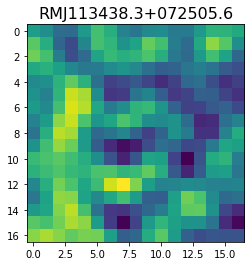

 24%|██▍       | 2423/10099 [03:21<10:11, 12.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-177.39897  -145.83679   -80.25165  -110.24727  -168.63008  -125.781654
  -34.570038  -47.118477 -145.62004  -160.89117   -50.55472    40.574806
   26.059126   -7.119969   10.755932    7.638586  -68.524666]


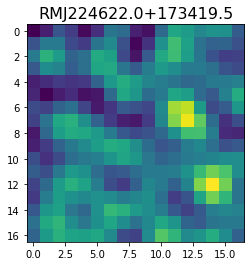

 24%|██▍       | 2425/10099 [03:21<11:09, 11.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-16.06865   -36.795612  -66.4593    -47.749367   -6.25232   -13.014252
 -57.80738   -62.311287  -16.178257    5.3431773 -25.133457  -38.866043
   6.9802585  50.80009    28.447697  -16.021423    5.194004 ]


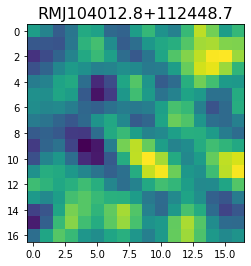

 24%|██▍       | 2428/10099 [03:22<11:25, 11.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.93437  116.70995   33.777317 -55.464478 -42.925804  69.302605
 140.66849   69.170715 -62.53412  -92.48736    7.485874 106.23495
  89.70593  -12.230515 -88.562065 -80.48694  -22.503319]


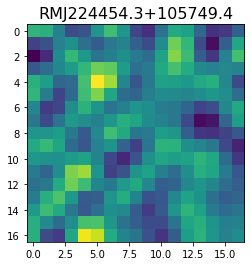

 24%|██▍       | 2430/10099 [03:22<12:23, 10.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 59.254887    83.266426    49.34756     -0.96188253 -44.620644
 -65.68815    -43.85385     11.965484    50.064774    35.32326
   2.3915653    6.453292    34.47508     21.219564   -42.843506
 -83.00984    -48.10062   ]


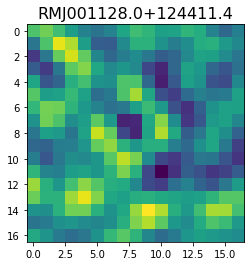

 24%|██▍       | 2442/10099 [03:22<06:48, 18.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[292.797   239.11966 189.12767 230.04895 285.17905 242.28354 139.82736
 104.78943 164.74135 227.925   222.11873 172.00288 145.00797 169.00311
 208.44838 211.6123  181.99356]


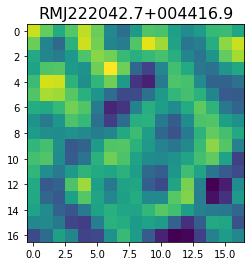

 24%|██▍       | 2445/10099 [03:23<08:20, 15.29it/s]

<class 'pixell.enmap.ndmap'>
[ -45.60328    -61.03155    -26.144358     5.178755     2.2966025
  -12.393084   -26.33235    -60.660946  -112.03615   -130.0162
  -88.891464   -41.36768    -53.939644  -108.86007   -123.738594
  -71.53122    -25.272919 ]


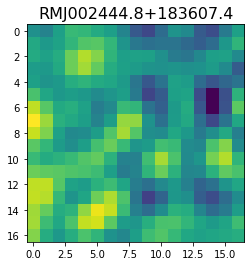

 24%|██▍       | 2448/10099 [03:23<09:12, 13.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -90.385025 -120.911    -102.67012   -55.68182   -22.804132  -24.527624
  -46.8428    -62.131306  -55.726894  -39.260166  -37.34983   -53.323364
  -57.54671   -26.961678   14.070449   19.127584  -18.240318]


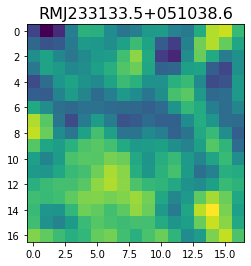

 24%|██▍       | 2451/10099 [03:23<09:40, 13.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[137.95564    96.89259    34.52855     6.3839126  51.53356   127.89588
 152.25774   103.57245    50.46005    57.048893   98.33527   112.54121
 102.32095   112.42509   131.65495   111.2935     72.07591  ]


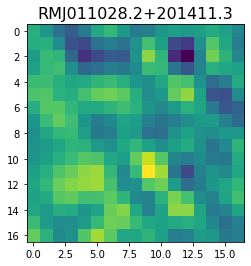

 24%|██▍       | 2455/10099 [03:23<09:12, 13.84it/s]

<class 'pixell.enmap.ndmap'>
[ 87.8707    23.979023 -19.418242  22.83147   87.41074   61.52465
 -37.801693 -85.83664  -45.968838 -11.043982 -33.06844  -43.093773
  16.598642  91.318245 102.296715  56.51948   14.189423]


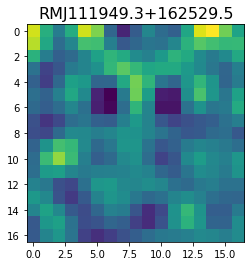

 24%|██▍       | 2457/10099 [03:24<10:28, 12.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[389.55127 248.30135 231.87564 283.832   247.98805 194.6261  257.68594
 316.2718  203.6679   83.63218 219.4298  474.7759  481.40323 245.10681
 130.46849 258.44598 369.89307]


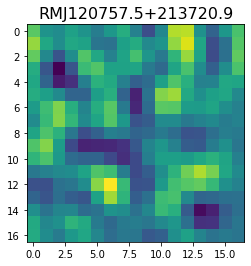

 24%|██▍       | 2460/10099 [03:24<10:48, 11.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[127.25101  115.04488   99.84386   93.34714  103.63587  119.42371
 125.41991  122.49489  117.718124 107.467606  90.485825  85.6625
 110.03657  144.34668  149.16049  117.51859   85.41246 ]


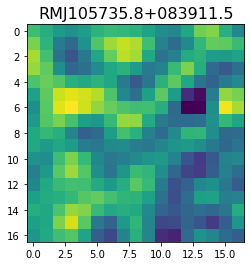

 24%|██▍       | 2463/10099 [03:24<11:03, 11.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-160.32784 -169.13617 -147.72156 -135.51585 -143.89195 -146.0858
 -135.66869 -137.931   -153.75188 -153.08342 -139.9344  -158.61426
 -210.31711 -230.23262 -185.29982 -135.25584 -149.6249 ]


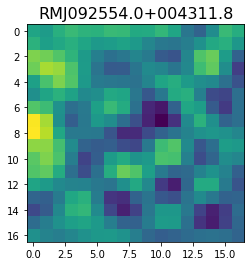

 24%|██▍       | 2466/10099 [03:25<10:47, 11.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.769421  78.400185  52.313263 -25.955582 -34.701393  44.269894
  90.773575  24.53105  -72.72528  -75.81797    8.24111   64.23256
  33.039734 -32.8151   -66.55404  -58.910946 -26.63911 ]


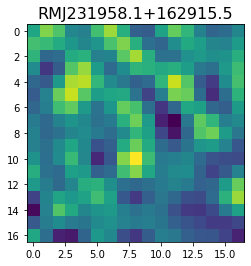

 24%|██▍       | 2469/10099 [03:25<11:17, 11.26it/s]

<class 'pixell.enmap.ndmap'>
[ 0.18255988  2.7320065   0.32884544 -5.7882466  -8.833201   -5.200714
  1.3534193   6.647834   12.501339   19.8174     20.90927    10.453556
 -0.7542216   1.0940504   9.777408    8.295215   -1.8685243 ]


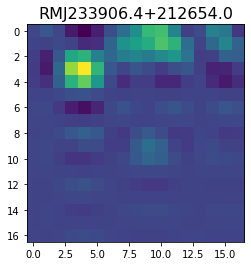

 24%|██▍       | 2471/10099 [03:25<11:58, 10.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -25.771132    53.82802    127.8781      56.488297   -52.68775
  -21.410643    50.020805   -29.812817  -154.10988   -110.9395
    5.9389434  -12.7692175  -84.39277    -21.866882    78.74105
   24.051498  -112.25475  ]


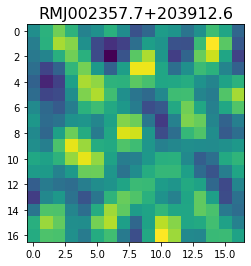

 24%|██▍       | 2473/10099 [03:25<12:45,  9.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-136.77252  -161.18207  -124.04307   -74.606964  -74.5462   -107.673294
 -119.25492   -96.822685  -71.32648   -68.64013   -84.02084   -90.650764
  -71.35386   -45.302265  -44.763054  -67.3381    -84.05114 ]


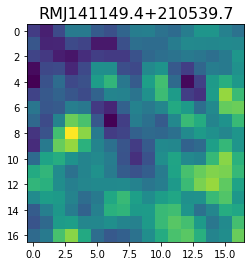

 25%|██▍       | 2475/10099 [03:26<13:42,  9.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-77.87098  -56.376312 -38.153793 -41.322544 -56.971077 -69.17616
 -72.72432  -67.20965  -51.16772  -31.81702  -26.936638 -43.41349
 -62.22806  -59.441963 -38.036354 -23.999115 -31.61469 ]


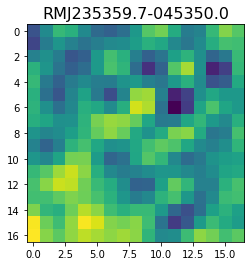

 25%|██▍       | 2480/10099 [03:26<10:55, 11.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[37.391556  14.328581   9.184706  28.101786  38.939537  28.183468
 23.891813  43.574245  57.872307  37.141888   2.4483006 -7.5388293
  5.411902  15.845119  26.419222  54.157806  80.13861  ]


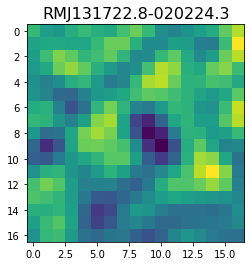

 25%|██▍       | 2485/10099 [03:26<09:29, 13.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -58.42048    -48.96591     31.552122    40.12362    -54.361397
 -100.080345    -3.2821815  114.24733    109.286705    17.453945
  -47.387665   -53.87785    -27.920341     5.7499666    5.675226
  -45.661022   -77.22215  ]


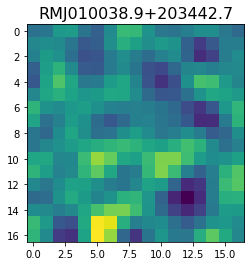

 25%|██▍       | 2488/10099 [03:26<09:48, 12.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 99.28645  118.7609   115.578285  90.68073   69.175026  69.44892
  83.80174   89.97327   73.31283   40.78486   20.154646  36.417576
  79.88487  109.87705  101.416885  74.23516   62.959846]


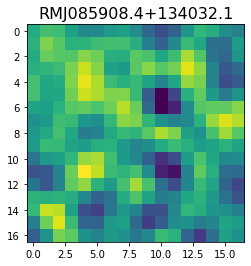

 25%|██▍       | 2491/10099 [03:27<09:52, 12.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-152.6029    -34.171062  -16.733643 -258.46466  -375.15002  -202.66595
 -133.42998  -348.64987  -474.4572   -294.3421    -75.16901    16.08519
  111.76611   152.14935  -105.29757  -511.3879   -593.71686 ]


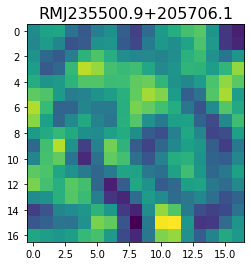

 25%|██▍       | 2498/10099 [03:27<07:56, 15.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-44.0484   -38.59032  -48.541496 -45.511787 -36.956913 -47.977566
 -62.33274  -52.64546  -41.56584  -59.95803  -77.18189  -52.174896
 -20.095657 -40.41337  -87.378174 -86.64152  -41.640404]


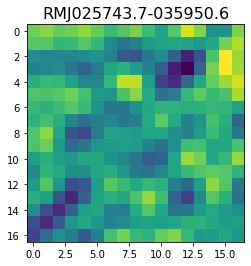

 25%|██▍       | 2504/10099 [03:27<07:20, 17.23it/s]

<class 'pixell.enmap.ndmap'>
[  17.82229     48.908688   123.586464   154.41872    120.69113
   54.765404     1.8482085   17.366278   110.743484   179.74927
  112.4388     -37.339058  -100.87069    -26.543377    74.57394
  119.4393     139.6235   ]


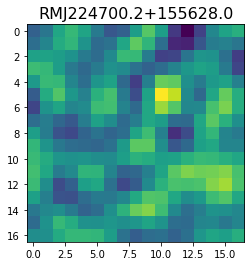

<class 'pixell.enmap.ndmap'>
[101.59812   130.37503    90.57833     5.347227  -35.510838    6.3806944
  55.928356   31.024832  -33.13278   -41.772835    8.149369   29.56132
  -9.277013  -41.42048   -17.72734    27.647175   54.80291  ]


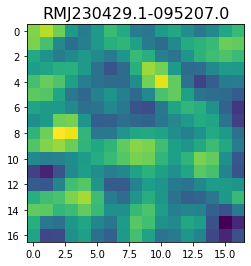

 25%|██▍       | 2506/10099 [03:28<10:19, 12.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-11.13756   -26.246181  -36.668087  -20.211708   10.377502   20.483732
   1.8724425 -17.748163  -16.175941   -2.8564053   4.088663    4.6604004
   8.339456   15.055529   18.371004   17.472353   14.651099 ]


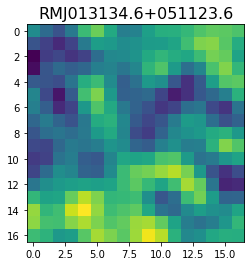

 25%|██▍       | 2508/10099 [03:28<11:02, 11.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 64.59293    28.429045  -14.9448    -27.485054  -10.991576    3.3670022
   3.651199    9.824817   36.14992    65.10903    70.96012    54.204277
  37.83346    36.098274   40.53665    36.635654   23.969072 ]


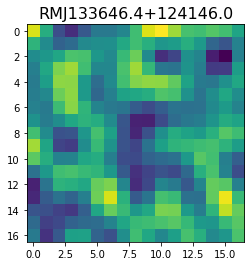

 25%|██▍       | 2512/10099 [03:28<10:07, 12.48it/s]

<class 'pixell.enmap.ndmap'>
[-54.203007  -52.70636     7.4248886  54.04039    36.528896    5.6859527
  22.235859   47.448677    9.012981  -62.658714  -64.48883    18.245018
  79.690796   45.56212   -27.792854  -48.70521   -16.635311 ]


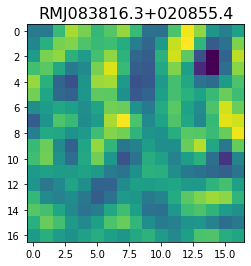

 25%|██▍       | 2514/10099 [03:28<11:53, 10.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 62.376842 116.08122   90.766205  60.701572  95.215324 137.75735
 123.366356  79.155846  37.846348 -10.391694 -31.957443  30.315022
 115.1474    90.9866   -20.062538 -49.152958  51.05386 ]


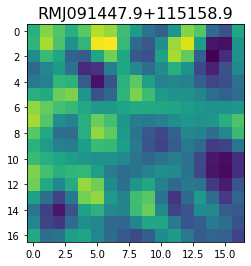

 25%|██▍       | 2516/10099 [03:29<12:54,  9.79it/s]

<class 'pixell.enmap.ndmap'>
[ -28.461588  -42.184505  -28.61691   -42.368305  -81.64737  -113.570045
 -134.65108  -152.62933  -146.01674  -101.24519   -61.476406  -72.926575
 -102.13158   -80.8764    -27.142544  -36.3861   -133.77777 ]


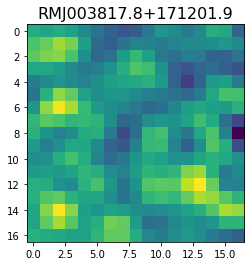

 25%|██▍       | 2517/10099 [03:29<15:16,  8.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-23.192148  -46.668476  -23.798155    9.9658375  19.48917     1.4557011
 -22.338772  -31.806496  -26.490765  -17.104214   -8.198488   -3.113646
 -15.883549  -49.97081   -71.67576   -45.15279     4.849297 ]


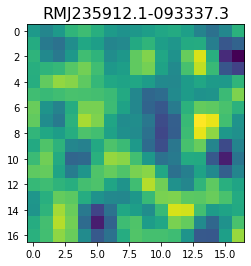

 25%|██▍       | 2521/10099 [03:29<12:41,  9.96it/s]

<class 'pixell.enmap.ndmap'>
[-7.3677649e+00 -6.2905796e+01 -6.5874847e+01  1.2369515e+01
  1.0339529e+02  9.9943169e+01  1.1543437e+01 -2.8748825e+01
  4.3705986e+01  1.3200574e+02  1.3213208e+02  7.0339577e+01
  2.1629507e+01  1.5268998e-02 -2.6289725e+00  2.4387232e+01
  4.9649052e+01]


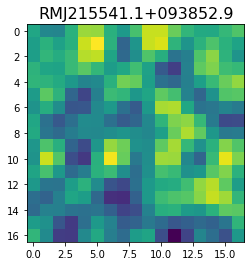

 25%|██▍       | 2522/10099 [03:30<15:06,  8.36it/s]

<class 'pixell.enmap.ndmap'>
[ 98.46692  109.2121    99.532364 107.29724  149.34737  175.59172
 147.0528   100.660614  81.52711   68.72167   35.63191   22.603888
  62.05645   90.500694  43.644104 -12.248086  27.776392]


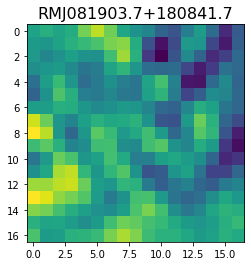

 25%|██▍       | 2523/10099 [03:30<17:10,  7.35it/s]

<class 'pixell.enmap.ndmap'>
[ -95.18796  -105.97709   -75.612564  -40.57111   -46.561535  -76.26195
  -76.091736  -40.660175  -18.832798  -39.5167    -77.3503    -95.014206
  -82.87356   -53.84006   -29.414402  -31.142612  -59.23334 ]


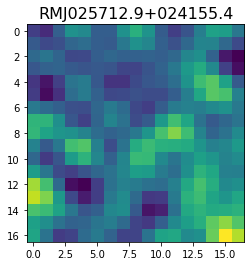

 25%|██▍       | 2524/10099 [03:30<19:40,  6.42it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[26.519615 43.010384 45.682003 42.721596 41.5356   35.155815 19.640656
  8.838731 13.512439 20.199612 15.377001 17.196976 48.833565 87.45413
 83.71279  38.2342   11.981207]


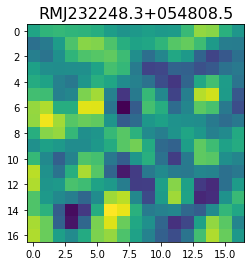

 25%|██▌       | 2527/10099 [03:30<15:56,  7.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-22.502214    4.2088346   6.3404512 -10.546626  -38.432117  -74.23549
 -96.80905   -79.96937   -40.752357  -29.236263  -53.7513    -63.283333
 -25.996109   22.197353   35.656937   22.5844     17.40356  ]


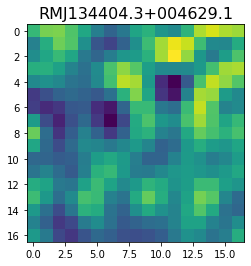

 25%|██▌       | 2537/10099 [03:31<07:15, 17.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[133.7883     81.14703    10.168242    2.4037457  59.165806   94.093414
  73.68876    59.16022    81.28077    87.26082    48.974583   16.66167
  25.077227   41.541935   42.158424   54.773605   97.0126   ]


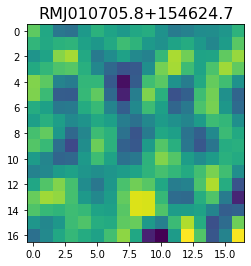

 25%|██▌       | 2540/10099 [03:31<08:16, 15.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[112.93597  115.66518   51.47432   10.172944  49.98773  122.65179
 157.00629  148.30019  136.34023  144.9603   166.91028  175.74648
 144.94235   83.40609   44.383244  65.62603  115.36556 ]


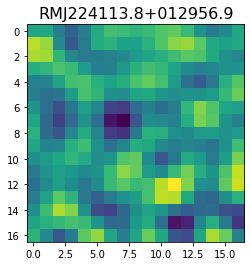

 25%|██▌       | 2544/10099 [03:31<08:54, 14.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[120.83508  103.07548   93.67198  115.733376 136.23552  118.55445
  85.77462   86.06411  114.40018  119.73864   86.12907   56.554405
  64.75648   86.10779   79.550606  48.616753  31.36821 ]


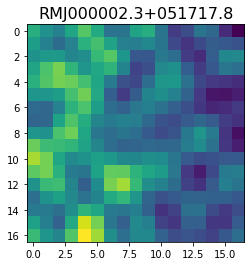

 25%|██▌       | 2550/10099 [03:32<08:06, 15.52it/s]

<class 'pixell.enmap.ndmap'>
[ -92.9194    -45.381836  -38.91768   -78.65711  -124.88102  -126.505585
  -88.97659   -63.065296  -60.400536  -49.551537  -33.271946  -41.29988
  -54.399     -35.838257  -22.927425  -76.409706 -159.14445 ]


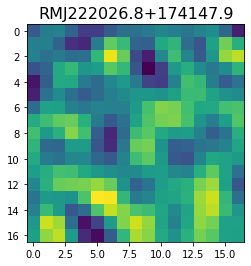

 25%|██▌       | 2552/10099 [03:32<09:26, 13.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -3.1863008  22.148802   16.299156  -20.890825  -30.960396    5.4600253
  34.947765   24.064968   14.627869   43.54309    73.96953    62.78908
  40.239487   56.556072   93.16739    98.04416    79.09465  ]


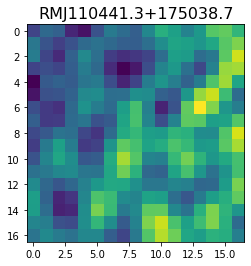

 25%|██▌       | 2555/10099 [03:32<10:06, 12.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  93.99175   116.07383    13.906529  -82.211235  -37.103546   81.3762
  118.67585    70.700905   66.42967   148.9565    208.77599   150.0762
   17.168354  -85.89296  -125.24018  -133.46394  -128.65605 ]


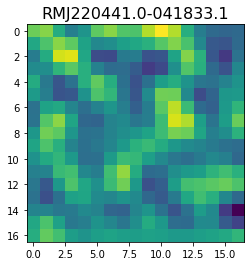

 25%|██▌       | 2566/10099 [03:33<06:26, 19.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.45232   -25.777468  -20.771206  -37.405014  -73.935265  -81.87424
 -36.203938   10.943779   -1.3801306 -52.45922   -77.0937    -64.86137
 -54.770893  -53.852394  -36.60062   -12.508848  -16.60936  ]


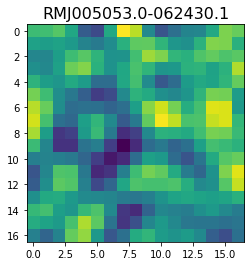

 25%|██▌       | 2569/10099 [03:33<07:33, 16.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -45.04273    -62.91337    -53.884693   -25.344818    -7.3790956
  -16.33418    -33.790413   -35.26484    -28.695341   -37.95782
  -54.4545     -44.336727   -10.568842    -3.5562406  -47.94668
  -98.622856  -102.13948  ]


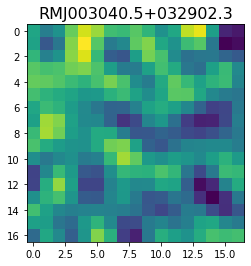

 25%|██▌       | 2572/10099 [03:33<08:42, 14.40it/s]

<class 'pixell.enmap.ndmap'>
[ 35.855785   37.659477   35.993786   32.35822    46.610073   70.62663
  61.84207     8.813529  -37.121758  -32.4801     -7.2651396 -12.866832
 -36.10725   -25.997414   11.805608   16.171427  -31.057335 ]


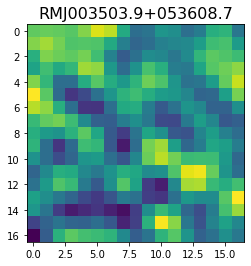

<class 'pixell.enmap.ndmap'>
[218.00346 234.41699 241.48282 249.27315 259.1218  268.32153 287.04248
 310.07227 308.45407 282.67908 275.46933 299.9251  311.8187  286.74667
 265.67218 286.9415  325.38422]


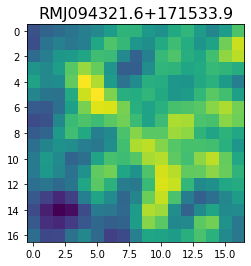

 25%|██▌       | 2574/10099 [03:34<12:53,  9.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 39.707005  35.03628  107.71057  140.80986   38.714046 -64.19231
  15.158829 204.20827  279.10028  210.11661  160.43921  176.53862
 138.62883   30.067      5.408286 131.67963  270.85098 ]


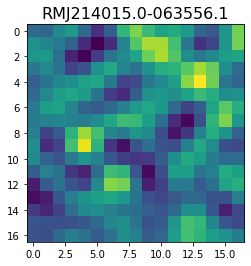

 26%|██▌       | 2583/10099 [03:34<07:47, 16.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-32.083885 -22.023806 -27.50174  -41.896698 -60.799416 -81.98188
 -93.25787  -81.31294  -56.10037  -46.446888 -62.72997  -80.790695
 -74.33732  -49.318027 -31.965366 -32.592243 -37.78902 ]


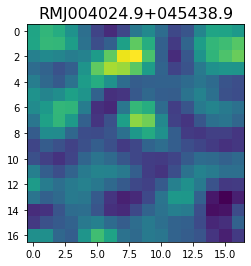

 26%|██▌       | 2586/10099 [03:34<08:33, 14.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 79.329346  84.686714  93.629524  89.10228   67.12647   56.565037
  72.72784   79.522644  48.749794  23.273382  53.83982  105.477325
 107.464195  69.848694  60.931858  87.506744  91.8929  ]


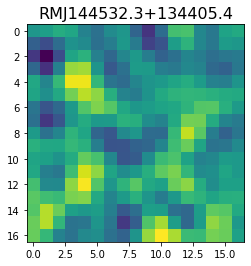

<class 'pixell.enmap.ndmap'>
[ -7.354101  -17.862303   47.979076   83.634346   16.834433  -65.690865
 -62.492104   -5.0366282  30.64771    43.528194   52.81713    31.55877
 -25.874765  -60.67334   -35.475014   12.198527   38.472477 ]


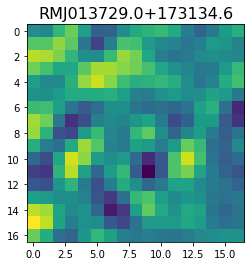

 26%|██▌       | 2589/10099 [03:35<11:12, 11.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[68.92172  17.619913 31.607475 68.71276  59.138493 20.456402 15.540845
 44.122063 58.041252 45.878387 31.958023 24.464947 19.825155 26.23094
 42.066402 44.32244  26.713625]


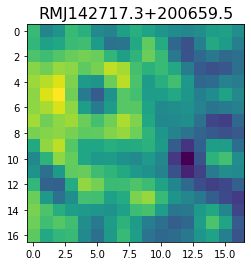

 26%|██▌       | 2595/10099 [03:35<09:10, 13.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-66.33289  -87.11013  -89.71811  -74.802086 -53.81968  -36.859753
 -37.551296 -59.429626 -78.85259  -74.302795 -62.731903 -70.595085
 -86.5147   -83.57196  -67.28677  -59.015446 -54.895096]


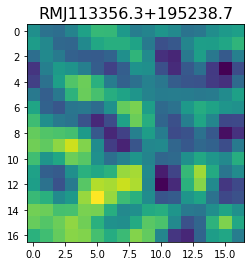

 26%|██▌       | 2598/10099 [03:35<09:37, 12.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-34.920902  -25.877142   11.2119055   4.342744  -46.778     -67.28397
 -27.221907   11.844225   -2.5400095 -34.5661    -26.282759   11.036296
  27.991524   22.470118   31.938637   59.78892    70.45962  ]


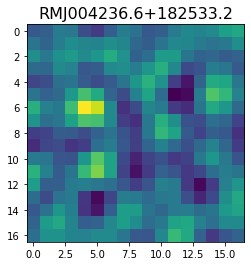

 26%|██▌       | 2603/10099 [03:36<08:51, 14.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 99.36568   82.65748   89.70644  108.20315  103.70693   75.80809
  70.99171  110.773056 142.24924  109.20844   42.86346   18.472736
  42.95253   59.40068   51.67417   61.477207  97.13153 ]


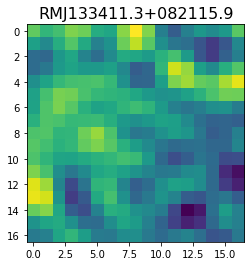

 26%|██▌       | 2618/10099 [03:36<05:14, 23.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 89.01186  115.61647  132.39967  114.92906   66.352356  26.361912
  34.68052   78.48762  107.51777  105.98087  104.1344   112.09911
 101.1339    66.036835  43.5889    47.460438  45.441418]


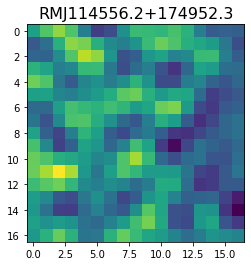

 26%|██▌       | 2622/10099 [03:36<05:53, 21.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 12.641461  29.719109  31.691778  24.568153  18.718592   8.652536
 -14.601811 -30.342112 -18.716238 -16.37433  -59.48124  -89.83685
 -34.215828  47.250828  39.3075   -28.271666 -30.378271]


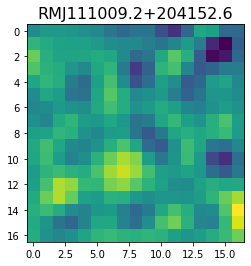

<class 'pixell.enmap.ndmap'>
[-13.273305 101.755264 207.09235  165.89731   16.062597 -65.453835
   6.896322 134.31815  184.89778  143.35475   75.90952   28.410656
  13.063003  36.34138   79.827446  92.31833   56.858685]


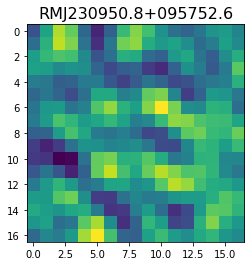

<class 'pixell.enmap.ndmap'>
[107.886086 195.92923  170.14722   99.931335  91.11734  110.14956
  82.594696  47.805317  72.487076 103.976524  59.49671   -4.149017
  37.400948 165.77126  224.92365  140.04344   13.48083 ]


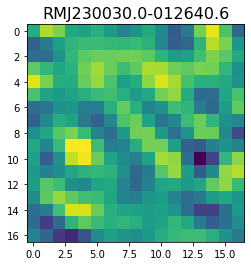

 26%|██▌       | 2625/10099 [03:37<11:05, 11.24it/s]

<class 'pixell.enmap.ndmap'>
[  14.867551  -46.14922  -104.34778   -97.89556   -71.42312   -93.761345
 -149.74184  -165.99141  -121.96954   -75.285805  -72.45143   -90.48294
  -90.34475   -80.103065  -85.93476   -96.36322   -85.833206]


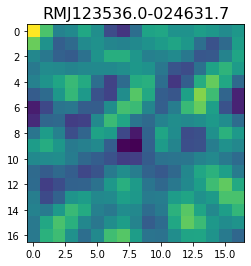

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  93.06165      43.58923     -22.947832     36.486652    115.31849
   37.55663    -135.01923    -193.69127     -95.299484     13.59415
   35.792847     13.9015045     0.78517675  -17.169477    -55.804684
  -86.01383     -72.09211   ]


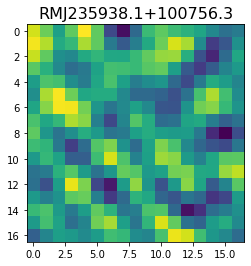

 26%|██▌       | 2628/10099 [03:38<13:08,  9.47it/s]

<class 'pixell.enmap.ndmap'>
[ 86.29133    51.869507   -4.4767156 -29.53117   -11.681277   18.480524
  35.077183   42.910618   57.633926   77.05264    80.26567    50.851936
  -2.350096  -46.643982  -51.45151   -19.688614    9.737283 ]


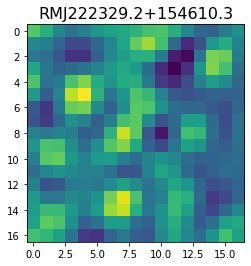

<class 'pixell.enmap.ndmap'>
[-144.14194   -70.873535  -30.48801   -25.65281   -40.70633   -65.84547
  -94.16974  -123.77138  -158.58751  -187.44612  -181.35191  -137.13286
 -100.381714 -113.3954   -159.24385  -185.9934   -167.54735 ]


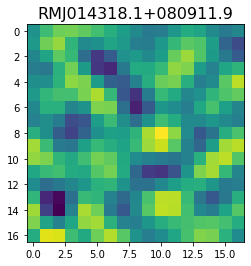

 26%|██▌       | 2630/10099 [03:38<15:42,  7.93it/s]

<class 'pixell.enmap.ndmap'>
[-151.7552   -137.84247  -111.29727   -58.183018  -24.4869    -48.370724
  -98.13899  -142.50119  -198.87488  -253.08076  -233.98283  -135.96289
  -59.136803  -60.802605  -85.16494  -102.940475 -174.45612 ]


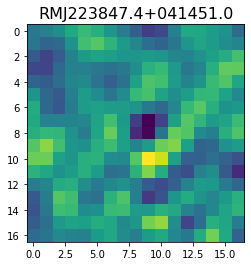

 26%|██▌       | 2632/10099 [03:38<15:25,  8.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-145.12325    -26.244865    52.683254    37.649487   -26.188942
  -74.839645   -88.41617    -76.08021    -49.369373   -20.695673
   -4.3328757  -13.650401   -53.05846    -94.60858    -80.495605
    5.028563    80.983055 ]


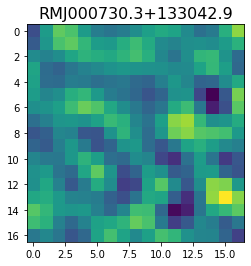

 26%|██▌       | 2635/10099 [03:38<14:00,  8.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-41.920464 -26.855633 -12.429821 -26.000343 -45.630043 -31.635298
  10.052601  36.852177  34.68266   31.093723  38.658028  29.111567
 -15.148599 -59.103916 -57.467255 -19.25103    4.832622]


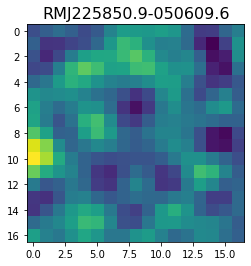

 26%|██▌       | 2644/10099 [03:39<07:55, 15.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 91.29502    53.55959    -1.7680169 -16.551952   35.879074   88.36199
  77.07949    40.531895   42.03416    58.166435   37.589363    9.970997
  30.521137   64.25507    37.39467   -28.762968  -46.403927 ]


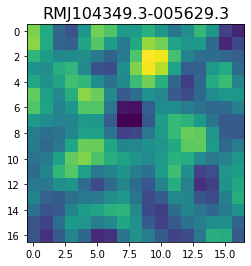

<class 'pixell.enmap.ndmap'>
[ 16.518482  28.973896  32.75546   30.331038  33.58685   51.96327
  79.348785  91.74146   75.3441    53.72623   56.08054   62.60989
  30.495565 -21.771955 -21.278965  45.975426  98.48225 ]


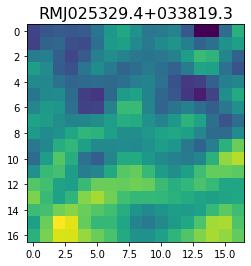

 26%|██▌       | 2647/10099 [03:39<11:06, 11.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -30.85959    -103.50083    -143.25931     -93.01201     -42.81803
  -70.40675    -105.61122     -62.830692      0.72199583  -18.49707
  -93.82993    -112.51465     -53.371265     -6.308504    -26.900002
  -71.26777     -88.76628   ]


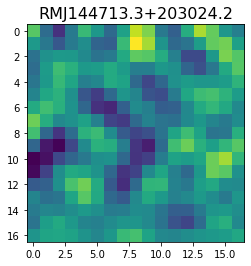

 26%|██▌       | 2649/10099 [03:40<12:05, 10.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 4.649364  -3.161329  12.609863  24.291769  23.228035  22.500154
 21.921202  12.209862   5.2737613 19.6515    41.66748   39.83871
 14.600918  -2.1855168  4.494215  17.269175  18.674706 ]


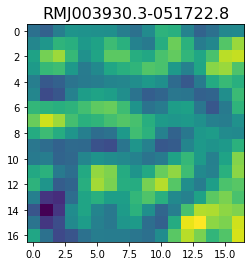

 26%|██▋       | 2651/10099 [03:40<13:11,  9.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 188.63297   186.01851   -21.608313 -176.29546   -79.41414   116.03991
  151.56245    75.86093    94.56323   119.11984   -69.408295 -267.641
  -60.63533   391.53363   460.5746     48.687283 -239.55316 ]


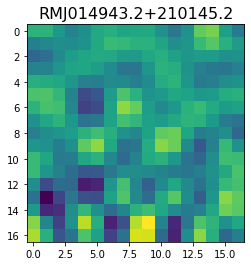

<class 'pixell.enmap.ndmap'>
[ 57.692833   79.17978    61.427914   18.045483    0.7473836   5.2245326
   0.6637004   9.222166   56.92797    91.400345   51.03248   -21.68251
 -31.997038   29.47447    83.298035   77.95699    44.21785  ]


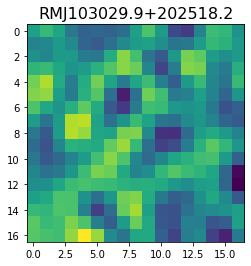

 26%|██▋       | 2653/10099 [03:40<17:39,  7.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[224.35707   98.116936  37.24414   61.349262  87.81764   82.27605
 106.34421  183.4932   226.22986  174.88521  116.82565  158.21053
 247.46132  257.05875  191.68927  164.73338  190.74586 ]


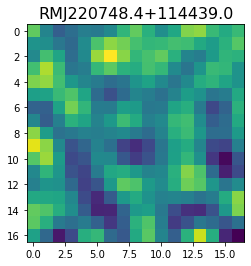

 26%|██▋       | 2656/10099 [03:41<15:33,  7.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-20.547924  -69.24178   -90.94742   -68.08569   -43.413807  -56.340496
 -87.31353   -85.41374   -38.587296    7.4351993   5.1377954 -37.414764
 -71.6026    -72.29842   -62.437912  -69.63432   -85.40648  ]


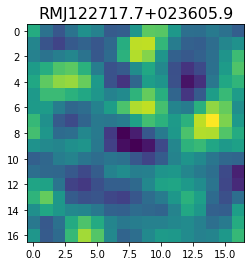

 26%|██▋       | 2658/10099 [03:41<15:22,  8.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[30.909054 52.869095 48.69495  31.132751 21.864414 28.443853 40.58464
 42.111683 28.591295 16.521025 26.760513 54.804993 71.45401  60.77812
 40.88285  35.808647 45.03988 ]


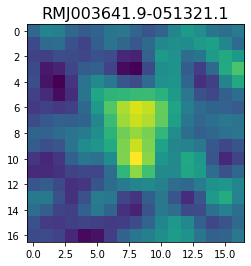

 26%|██▋       | 2661/10099 [03:41<13:43,  9.04it/s]

<class 'pixell.enmap.ndmap'>
[ -92.978455  -86.72509  -111.14454  -135.58914  -111.31368   -52.38923
  -27.929462  -60.312164  -86.54556   -56.63662   -18.003141  -43.249527
 -112.166595 -139.74515  -103.53431   -64.904495  -63.188957]


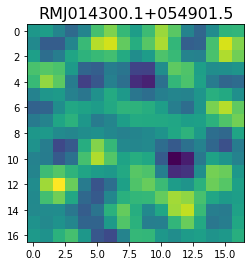

 26%|██▋       | 2663/10099 [03:41<14:08,  8.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-110.08238   -70.97293   -32.863228  -48.00096   -98.04635  -120.97412
  -98.542145  -73.41505   -80.17447  -100.45128  -102.05673   -91.936584
 -101.757645 -133.23643  -149.36086  -126.56436   -90.62056 ]


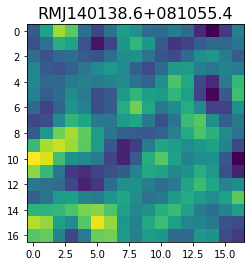

 26%|██▋       | 2664/10099 [03:42<16:39,  7.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-179.68916   -159.33461   -159.90479   -197.0245    -294.26862
 -357.36188   -258.9096     -94.42717    -80.16047   -176.72269
 -141.47519     35.196686   108.85251     12.399257   -55.963924
   -4.6124377   25.31026  ]


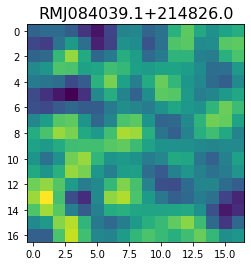

 26%|██▋       | 2666/10099 [03:42<16:12,  7.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  91.17133     71.250175   -73.02197   -146.62616    -82.512024
    6.8284335   43.55117     75.35458    132.7355     151.25182
   97.88213     50.953514    69.88434     83.62327     12.512674
  -70.93064    -29.556292 ]


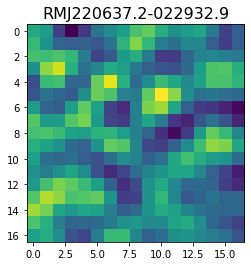

 26%|██▋       | 2669/10099 [03:42<13:59,  8.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  59.71185   -90.95681  -155.57083    -3.682818  154.91638    65.90253
 -132.13307   -92.17632   181.00548   322.90536   168.75797   -55.22446
 -147.0506   -154.62013  -119.258934   13.236016  136.51634 ]


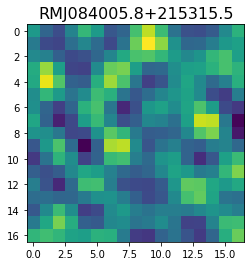

 26%|██▋       | 2671/10099 [03:42<14:18,  8.65it/s]

<class 'pixell.enmap.ndmap'>
[-32.139133   45.994106  107.594246   30.315666  -55.37133     8.45625
 142.66815   155.53313    25.47043   -88.66971   -70.342705   29.52638
  80.54359    30.741486  -37.45129   -15.1847925  81.09357  ]


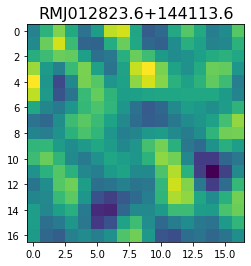

 26%|██▋       | 2672/10099 [03:43<16:35,  7.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.098534  64.239784  98.23477  113.94481  118.023    131.78133
 153.1688   170.11363  178.14069  166.91235  124.230576  69.48117
  46.850727  68.72658   99.49167  108.50141  103.509285]


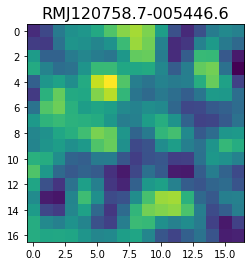

 26%|██▋       | 2676/10099 [03:43<12:48,  9.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.920826 -18.402582 -34.90296  -61.2023   -56.714275 -32.406925
 -29.557983 -50.595898 -62.38907  -55.77944  -52.997524 -61.652775
 -64.40416  -53.312    -40.749416 -37.04663  -41.979523]


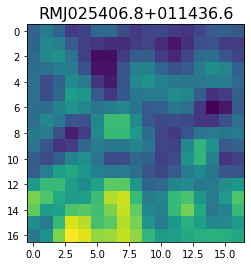

 27%|██▋       | 2678/10099 [03:43<14:06,  8.77it/s]

<class 'pixell.enmap.ndmap'>
[-40.570786   -27.470022   -29.27613    -32.8264     -31.741375
 -34.230343   -37.902283   -32.56793    -24.811125   -27.342464
 -31.082775   -19.377527     0.05006449   8.438937     8.515737
  12.337773    12.541845  ]


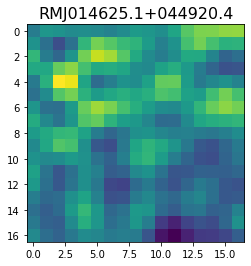

 27%|██▋       | 2679/10099 [03:43<16:32,  7.48it/s]

<class 'pixell.enmap.ndmap'>
[-23.951868  -62.29904   -40.504288   -1.0545062 -17.674408  -54.234283
 -14.633024   81.03964   103.74862    15.684249  -73.415855  -86.2726
 -73.22655   -74.82595   -40.02746    37.48761    48.213696 ]


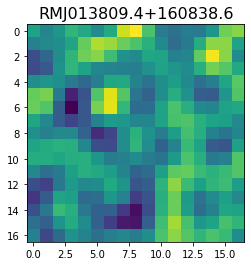

 27%|██▋       | 2680/10099 [03:44<20:30,  6.03it/s]

<class 'pixell.enmap.ndmap'>
[ 71.34305    48.404766   -2.0297902  14.244896   87.4322    136.63605
 115.07199    45.39496    -6.1946564  13.20717    80.59076   114.73493
  81.04959    32.041077   19.975742   30.652695   30.988293 ]


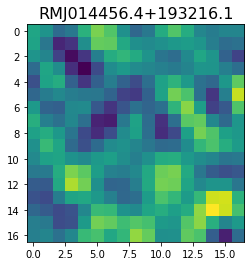

 27%|██▋       | 2681/10099 [03:44<22:07,  5.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  14.72156    -54.313103  -122.73573   -107.00867    -46.592262
  -15.881431   -15.648644   -14.389111    -7.8389235    2.3706608
   13.967014     3.4383     -31.75066    -42.234818    -6.4004364
   18.240814    -8.282222 ]


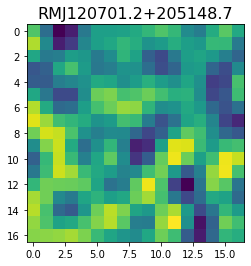

 27%|██▋       | 2685/10099 [03:44<14:56,  8.27it/s]

<class 'pixell.enmap.ndmap'>
[ 50.087166   59.419395   39.75156    10.636927   -2.2083294   1.740123
   6.3322854   5.991361    8.553126   16.440105   19.682       9.057732
 -11.516127  -27.12298   -24.00293    -2.7139244  17.570105 ]


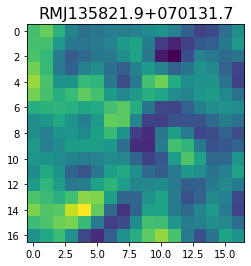

 27%|██▋       | 2686/10099 [03:45<17:06,  7.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-69.12051  -57.29114  -18.11707  -17.23141  -49.521553 -41.58956
  27.850313  88.65747   78.340164  19.574932 -26.923988 -40.967693
 -43.131504 -46.31022  -42.472874 -30.532013 -29.583836]


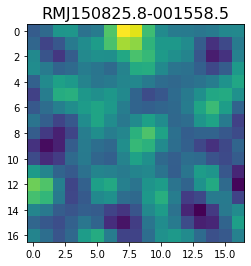

 27%|██▋       | 2690/10099 [03:45<13:03,  9.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-114.82564  -213.37425  -189.04962   -98.43464  -117.78876  -187.25615
 -165.52853  -137.65472  -212.49796  -258.5782   -156.37523   -49.086952
  -85.744545 -181.30078  -215.26663  -210.89201  -209.88991 ]


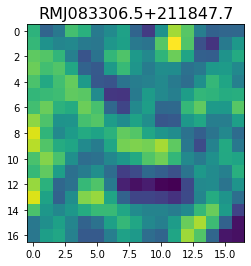

 27%|██▋       | 2692/10099 [03:45<13:39,  9.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[154.36847 154.7411  153.31598 156.24094 161.7434  158.9806  146.48457
 141.12155 157.31734 183.63426 194.4471  183.4206  170.43404 172.43796
 182.46442 185.25903 180.51247]


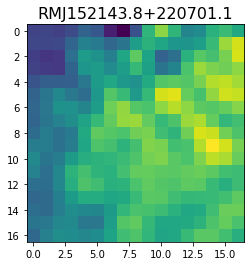

 27%|██▋       | 2696/10099 [03:45<11:42, 10.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.58602    8.675526  53.381107  52.162685  27.726362  23.841957
  36.811638  46.4192    53.839134  58.229702  49.22169   38.14717
  48.852962  76.341194  96.58365  104.72546  106.38383 ]


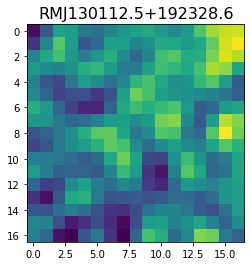

 27%|██▋       | 2698/10099 [03:46<12:16, 10.04it/s]

<class 'pixell.enmap.ndmap'>
[  27.411657   -53.591328  -118.70197    -89.605545   -25.843964
   -6.2330933  -14.381347   -12.894863   -23.820345   -63.89028
  -92.35744    -83.637566   -70.14136    -71.193214   -61.451008
  -38.68709    -37.827724 ]


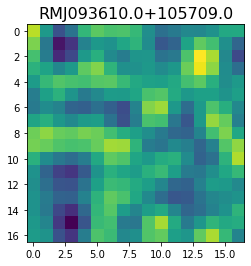

 27%|██▋       | 2699/10099 [03:46<14:27,  8.53it/s]

<class 'pixell.enmap.ndmap'>
[ 113.81278     71.46212    -43.287254  -110.291336   -44.70271
   65.02943     84.57011     27.209082     1.0268661   28.433575
   49.265827    53.166317    75.320404    94.38897     59.160233
   -5.8850765  -31.034143 ]


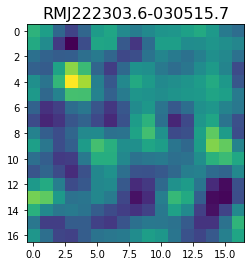

 27%|██▋       | 2700/10099 [03:46<16:45,  7.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  0.6110574   2.1352267   5.3033595  35.770927  109.668976  169.23169
 134.36368    34.37002    -3.4378116  70.58405   153.90971   140.27866
  60.05129    10.767135   13.925426   12.7922    -25.090841 ]


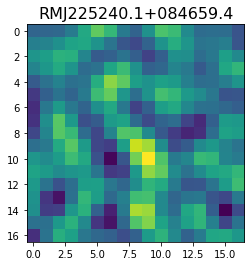

 27%|██▋       | 2702/10099 [03:46<16:03,  7.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 43.933857  48.80831   58.905056  59.714973  53.314774  64.89635
  95.63673  103.01491   62.990726  20.63156   33.195667  85.603096
 113.361046  95.87751   73.64696   76.584305  88.5429  ]


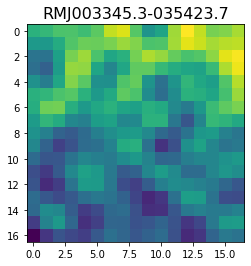

 27%|██▋       | 2705/10099 [03:47<13:42,  8.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[89.73048  82.28082  76.1051   83.76085  99.69649  98.10903  67.124054
 35.84842  43.29862  81.31851  98.34122  70.10465  35.337524 38.932335
 67.285225 73.43591  49.002216]


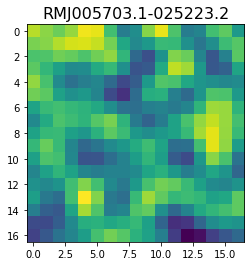

 27%|██▋       | 2707/10099 [03:47<13:58,  8.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  36.32256   -109.451195  -167.40704    -81.13678     15.932609
   -7.588234   -98.61673   -108.56517     -5.897884    99.60082
  119.18348     70.55064      0.4262722  -81.32513   -161.5413
 -195.36534   -163.97363  ]


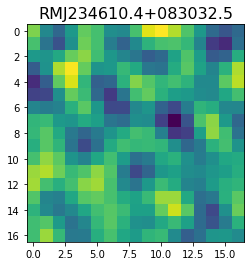

 27%|██▋       | 2709/10099 [03:47<13:59,  8.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -87.9608    -36.278168  -31.882273  -82.9347   -115.65504   -79.82863
  -25.298704  -28.02485   -82.737946 -124.01348  -123.40249  -109.3909
 -110.18947  -127.20229  -151.4248   -163.3055   -132.20279 ]


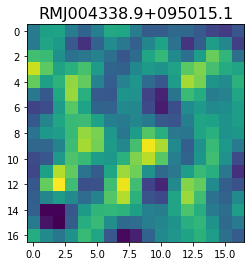

 27%|██▋       | 2711/10099 [03:47<15:50,  7.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   2.6684983  -65.24689   -168.11952   -174.04285    -38.923367
   69.416725   -16.921467  -191.43866   -232.39903   -149.51038
 -103.41669    -96.66062    -45.78181    -14.438267   -64.34052
  -59.729897    73.03119  ]


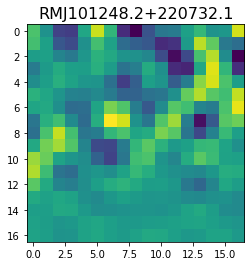

 27%|██▋       | 2716/10099 [03:48<11:45, 10.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  90.02217     91.01764    -13.645911   -57.8277      40.83226
  102.269104     5.5175395  -58.058235    68.66601    179.11803
   56.22024   -111.90659    -46.51676    134.98883    139.62688
   -5.8462257  -64.69999  ]


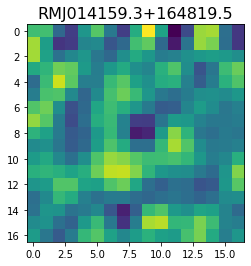

 27%|██▋       | 2721/10099 [03:48<10:27, 11.77it/s]

<class 'pixell.enmap.ndmap'>
[111.82288  180.43465  146.14291   98.22877  115.22558  136.38876
 109.60776   99.331085 151.29308  202.84874  204.95532  188.47237
 161.90495   96.69051   41.334396  85.47704  191.8774  ]


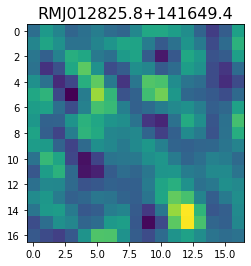

<class 'pixell.enmap.ndmap'>
[-220.86559  -170.57394  -185.2656   -255.98416  -274.4237   -208.0046
 -150.9516   -161.39108  -180.51178  -169.74544  -188.11015  -253.95467
 -265.61868  -162.47063   -50.529663  -56.366257 -145.8707  ]


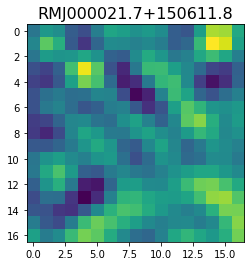

 27%|██▋       | 2723/10099 [03:48<13:43,  8.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-53.349823 -43.266804 -42.66403  -55.142555 -73.508675 -81.10007
 -71.58279  -61.634846 -67.67215  -76.52809  -63.19927  -35.170208
 -28.56654  -53.700474 -75.63235  -64.108696 -35.43901 ]


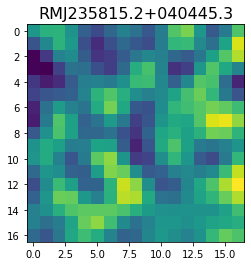

 27%|██▋       | 2725/10099 [03:49<14:19,  8.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   1.9194335 -126.06895    -15.74141    130.54936     94.45541
  -15.484558     3.38315    104.52574    144.29863    159.83018
  224.1068     231.26025    103.09484      5.9528055   77.83717
  151.64375     37.523518 ]


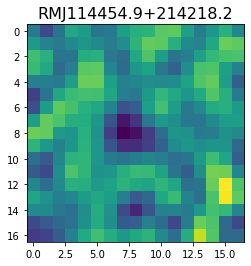

 27%|██▋       | 2728/10099 [03:49<13:15,  9.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 51.53884    44.41828    29.763382   14.145524    1.4834088   2.732569
  18.014725   19.45731   -11.834112  -41.402493  -18.74215    43.453712
  76.43311    50.014965   12.993478   21.528048   67.335976 ]


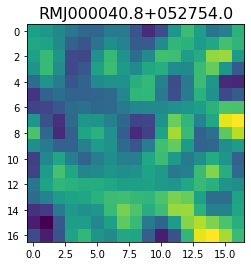

 27%|██▋       | 2730/10099 [03:49<13:44,  8.94it/s]

<class 'pixell.enmap.ndmap'>
[  5.9366174   4.5007205 -26.553734  -41.377243  -19.49993     2.882657
 -10.334327  -44.23214   -63.85627   -64.99111   -65.4815    -70.20607
 -73.05452   -75.89886   -81.715416  -83.93842   -81.21249  ]


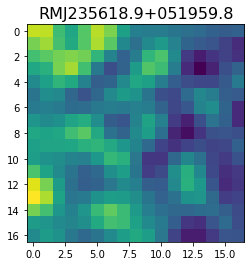

 27%|██▋       | 2731/10099 [03:49<15:55,  7.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[167.18765 168.97267 172.45903 172.33746 150.29393 132.98204 163.99905
 213.99905 217.38461 190.5642  203.33078 248.84491 263.2556  253.25685
 274.05646 303.49808 274.42947]


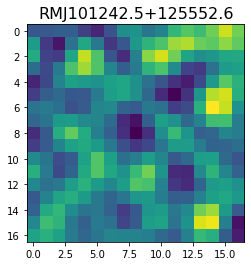

 27%|██▋       | 2734/10099 [03:50<14:18,  8.58it/s]

<class 'pixell.enmap.ndmap'>
[ 55.315773     0.38155806 -13.262636    18.586088    43.95498
  33.552982    20.08283     22.86384      3.2178245  -52.77387
 -82.33325    -44.385162     2.384172    -4.886057   -30.078312
 -13.859453    14.440891  ]


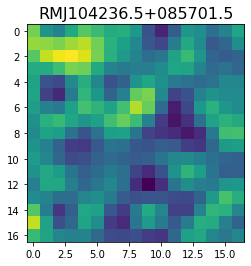

 27%|██▋       | 2735/10099 [03:50<16:29,  7.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  78.543495    57.721767   -23.030407   -86.34285    -60.91843
   24.151985    72.61405     44.018604   -16.535383   -62.09537
  -81.66942    -60.567585     5.607393    52.190998     2.1661937
  -99.61716   -114.5963   ]


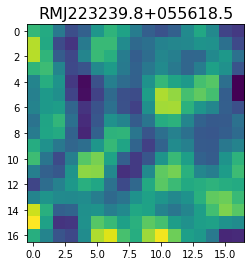

 27%|██▋       | 2737/10099 [03:50<16:07,  7.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[118.18751  106.82439  113.94463  153.54353  219.70401  282.98105
 308.9735   283.3983   217.96219  143.51752  100.50171  111.256386
 147.73442  153.19781  115.27709   87.56274  112.57377 ]


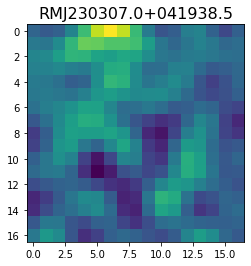

 27%|██▋       | 2740/10099 [03:50<13:47,  8.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-74.06289  -77.31331  -72.097694 -37.46162   -6.938562 -21.012968
 -60.14264  -71.94599  -52.377254 -46.598656 -68.36799  -76.57454
 -49.393486 -25.764343 -40.516632 -66.34526  -62.708153]


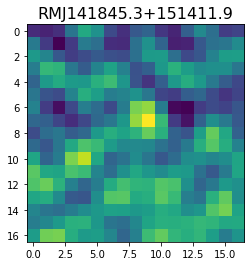

 27%|██▋       | 2751/10099 [03:51<06:59, 17.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-143.97844   -75.56106   -78.63341  -126.01001  -130.38692  -113.409996
 -133.38904  -144.77882   -85.08834   -18.046724  -46.06706  -142.09375
 -188.6705   -140.6116    -61.61862   -32.57203   -76.35871 ]


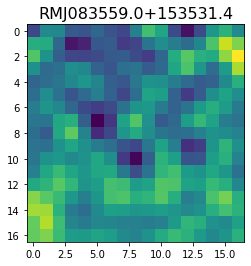

 27%|██▋       | 2755/10099 [03:51<08:11, 14.94it/s]

<class 'pixell.enmap.ndmap'>
[101.57932  107.46366   73.095024  44.45208   45.176624  57.239773
  66.95584   81.72848   95.99283   85.07244   49.938477  30.07422
  47.133713  68.48043   56.68527   25.724735  12.853682]


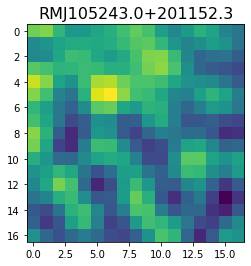

<class 'pixell.enmap.ndmap'>
[-57.187645  -46.01798   -10.327334    1.538843  -28.591017  -57.263855
 -40.59631     2.6280384  21.822746    8.337706   -1.8989258   7.4988294
   9.852481  -13.549083  -35.613983  -21.712091   16.201538 ]


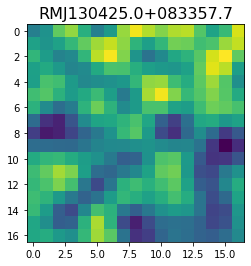

<class 'pixell.enmap.ndmap'>
[ -6.938882  81.93026  144.57794  130.3043    73.461555  37.72087
  50.808342 103.249    166.10487  189.81718  138.10535   56.88755
  51.844776 147.28394  227.10114  186.0321    83.574974]


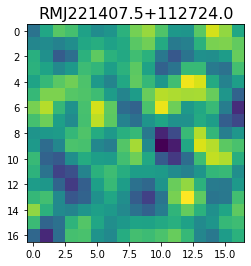

 27%|██▋       | 2758/10099 [03:52<13:11,  9.27it/s]

<class 'pixell.enmap.ndmap'>
[ 96.15283   146.40262   142.8543    113.801094   93.66938    65.99507
  19.763355   10.051585   78.64202   149.47563   114.491844   13.629707
   1.1148841 113.242714  204.06229   162.0873     63.204006 ]


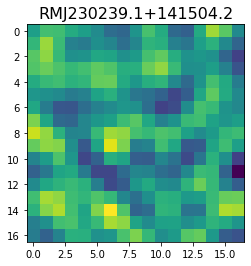

<class 'pixell.enmap.ndmap'>
[ -82.096985   -98.91653    -64.61219    -28.926928   -61.267597
 -122.49884   -113.38876    -32.487858    14.426768   -28.332775
  -90.07453    -85.48001    -29.778507     3.9657443   -7.0547113
  -23.959637   -19.929619 ]


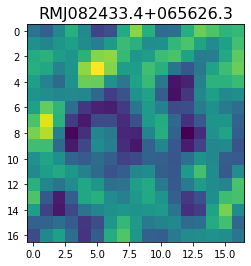

 27%|██▋       | 2760/10099 [03:52<16:01,  7.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -36.19843     -48.62424      20.25205      61.133167     -0.89387363
  -62.126995    -23.845724     40.64213      43.041416     33.151733
   54.11427      27.88535     -69.31709    -106.08665     -19.502787
   47.480766    -18.917194  ]


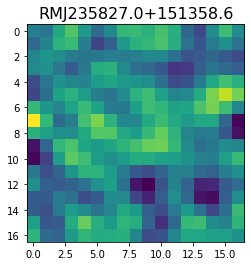

 27%|██▋       | 2765/10099 [03:53<12:38,  9.67it/s]

<class 'pixell.enmap.ndmap'>
[216.95811   107.63647    13.468441    4.7621155  98.480705  213.76814
 242.50801   169.31963    90.677895  102.4841    188.64674   240.90216
 186.26082    74.707756   23.315298   82.275406  186.80595  ]


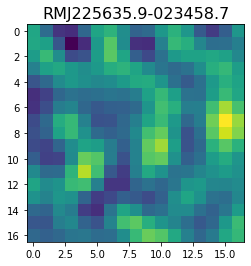

 27%|██▋       | 2767/10099 [03:53<13:23,  9.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 54.02778    84.70201    69.43997    71.3074     93.95998    73.09496
  -1.1264207 -43.71329    -1.7217275  56.463192   44.635      -9.110706
 -12.242313   50.29772   105.00527   100.64999    58.14175  ]


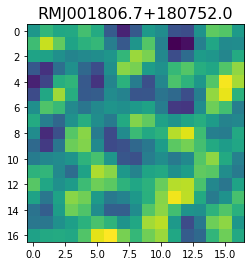

 27%|██▋       | 2771/10099 [03:53<12:03, 10.13it/s]

<class 'pixell.enmap.ndmap'>
[-265.9235   -244.6295   -142.00668   -95.93439  -157.66736  -216.14664
 -173.22395   -91.54304   -85.268936 -152.51477  -209.11258  -216.2631
 -186.77348  -131.66383   -83.78451  -107.900185 -205.44923 ]


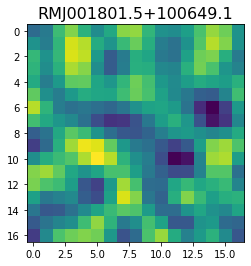

<class 'pixell.enmap.ndmap'>
[ 94.006325  80.95501   80.127396  91.12488   97.72157   95.87443
  98.40289  109.957016 117.570175 111.084305  97.563194  91.36976
 100.67159  123.06786  144.0937   144.43025  121.26045 ]


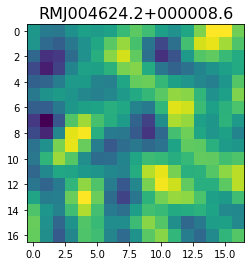

 27%|██▋       | 2773/10099 [03:54<15:55,  7.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-229.54254  -158.55594   -12.267425  -42.437977 -205.07388  -236.00964
 -108.417564  -61.99251  -177.91801  -261.14777  -190.95293   -93.24878
  -92.02382  -134.38568  -140.80325  -129.45036  -123.07731 ]


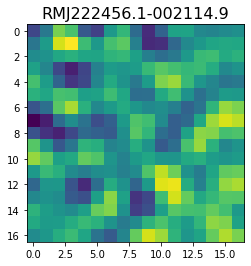

 27%|██▋       | 2776/10099 [03:54<14:10,  8.61it/s]

<class 'pixell.enmap.ndmap'>
[ -24.43676  -107.15965  -128.30072   -85.34602   -59.466156  -72.311
  -75.52827   -66.58566   -93.299515 -140.22954  -132.34929   -73.74637
  -66.38921  -150.42755  -229.79742  -212.32628  -138.18779 ]


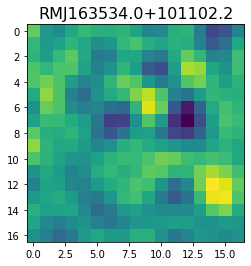

<class 'pixell.enmap.ndmap'>
[  5.7776747 -68.08859   -65.64623   -19.830269  -16.737177  -55.769245
 -77.21348   -70.733955  -68.17506   -69.943985  -55.142906  -34.643425
 -31.227814  -32.026703  -13.006919   11.955305   14.130219 ]


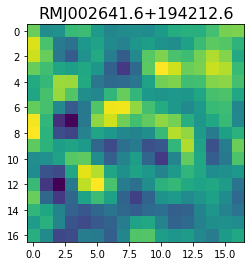

 28%|██▊       | 2778/10099 [03:55<16:53,  7.22it/s]

<class 'pixell.enmap.ndmap'>
[-33.484566  47.389328 102.20872  115.40928  129.05931  153.95544
 150.15926   95.44054   26.378937  -2.314188  22.935612  64.02671
  68.931885  20.457777 -42.68631  -58.58072   -9.52692 ]


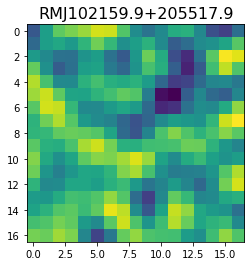

 28%|██▊       | 2779/10099 [03:55<19:18,  6.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-108.701454  -99.832115  -83.072075  -88.30804  -110.86526  -117.05589
  -91.07913   -56.01222   -45.704914  -68.343666 -103.98384  -131.53896
 -146.69257  -150.34761  -134.65878   -98.12038   -65.81331 ]


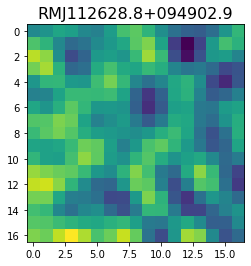

 28%|██▊       | 2783/10099 [03:55<14:42,  8.29it/s]

<class 'pixell.enmap.ndmap'>
[-174.23495  -126.81728   -88.12207   -77.634735  -88.9894   -123.03557
 -172.24379  -190.19641  -148.07777  -105.23608  -136.56514  -205.87752
 -212.2559   -148.64052  -103.97758  -115.85278  -134.33684 ]


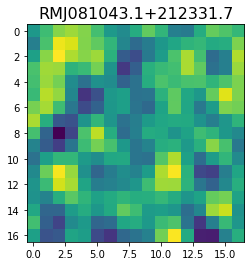

 28%|██▊       | 2784/10099 [03:55<16:54,  7.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -57.810654  -81.219574 -127.49642  -135.59583   -98.855606  -64.24803
  -55.905216  -50.19401   -33.63521   -33.374035  -65.16893   -93.96513
  -81.80322   -44.895863  -25.610447  -29.150148  -26.96275 ]


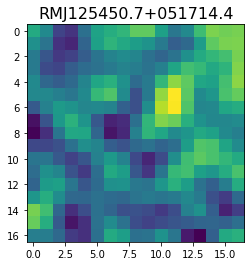

 28%|██▊       | 2786/10099 [03:56<16:09,  7.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -88.217804  -78.03823   -72.292274  -75.9632    -89.0187   -102.987625
 -107.861855 -108.20802  -122.611305 -155.04582  -176.34383  -154.6922
 -102.622055  -70.973495  -89.97695  -135.3682   -162.31604 ]


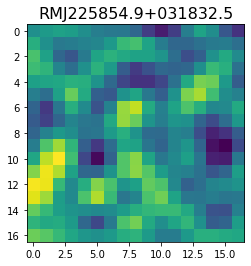

 28%|██▊       | 2789/10099 [03:56<14:21,  8.48it/s]

<class 'pixell.enmap.ndmap'>
[ -9.814836   -23.537825   -37.623695   -35.550663   -16.338152
  -6.849218   -26.960314   -53.5911     -48.30859    -14.138289
   8.356385     0.6894928  -12.767814    -8.979721     2.582963
   4.884522     0.37804452]


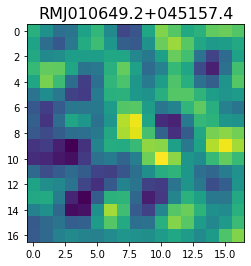

 28%|██▊       | 2790/10099 [03:56<16:55,  7.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -49.911346  -46.51934   -31.776901  -35.051704  -51.64882   -54.653137
  -44.10212   -46.346478  -63.344353  -63.7895    -40.19515   -33.440994
  -68.47358  -101.61999   -80.43963   -31.848131  -29.00553 ]


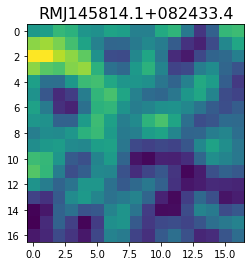

 28%|██▊       | 2796/10099 [03:56<11:18, 10.77it/s]

<class 'pixell.enmap.ndmap'>
[134.77899  132.46982   72.056656  19.571274  32.002518  85.88117
 114.820335  99.41422   83.408424 101.19821  129.74176  130.2052
 102.54824   70.384834  39.58409    6.119733 -16.595392]


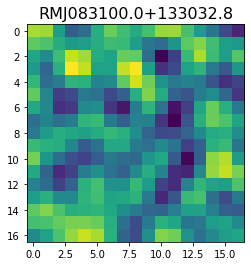

<class 'pixell.enmap.ndmap'>
[  -3.9446723   15.230771    85.37503    102.32814     13.037676
 -102.01241   -141.82573   -120.58628   -119.356544  -147.00723
 -143.0693    -101.16953    -86.36695   -118.50564   -135.51334
 -104.197975   -79.656075 ]


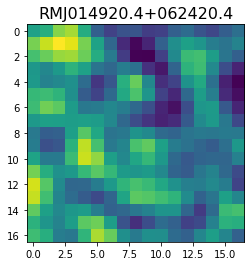

 28%|██▊       | 2798/10099 [03:57<14:53,  8.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -98.22673  -87.68658  -86.11217  -93.85824 -104.36808 -119.81214
 -135.7385  -133.09172 -107.89053  -92.08688 -116.87568 -164.10043
 -185.6652  -170.1154  -154.58406 -161.75136 -163.70226]


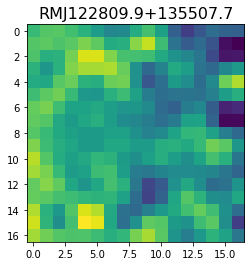

 28%|██▊       | 2801/10099 [03:57<13:25,  9.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[301.51068  495.8837   385.54898   90.04008  100.95849  430.32364
 524.7576   210.08574    8.456529 252.42743  546.89154  442.40833
 108.476265  -9.151414 162.82918  321.3258   245.88533 ]


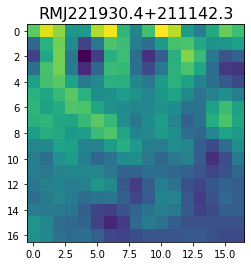

 28%|██▊       | 2803/10099 [03:57<13:39,  8.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[129.43425  105.70914   61.622433  28.365335  38.27771  102.671165
 142.09538   85.83495   27.19421   74.71157  125.5852    50.46359
 -29.764608  34.830425 106.346565  14.395661 -86.18658 ]


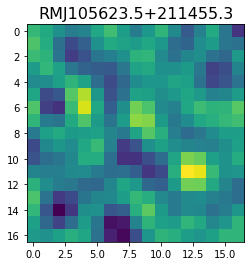

 28%|██▊       | 2807/10099 [03:58<11:30, 10.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-12.448609  21.188816  51.504585  46.08428   27.888426  36.32778
  80.38425  127.31591  129.68204   76.95898   20.945889  23.65816
  77.94597  114.69392   95.65764   58.466118  53.461178]


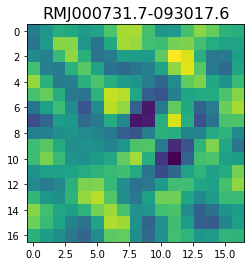

 28%|██▊       | 2810/10099 [03:58<11:33, 10.51it/s]

<class 'pixell.enmap.ndmap'>
[   0.8881497   -9.500989    21.148344   -25.56642   -107.12809
  -72.2466      61.949192   111.116425    24.755047   -33.049847
   36.146046   106.17996     47.239063   -59.170666   -57.24046
   39.987244    84.75456  ]


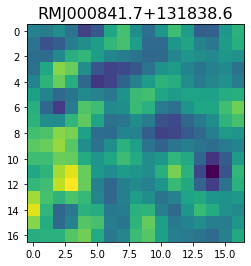

 28%|██▊       | 2812/10099 [03:58<13:16,  9.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.550447  13.846462  46.33851   44.20793    6.499786   9.914391
  84.00842  146.17093  122.70963   70.07625   86.48601  149.1608
 149.51892   71.76787   18.111135  43.51384   78.143776]


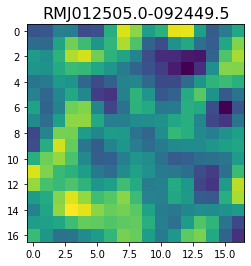

 28%|██▊       | 2814/10099 [03:59<14:41,  8.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 107.129295   56.83097    -8.878527  -35.239773  -37.98408   -59.64786
  -90.85174   -87.02677   -48.92918   -30.592999  -60.4617   -104.41915
 -124.80599  -128.14223  -125.274895  -92.09259   -18.591331]


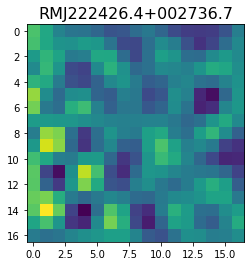

 28%|██▊       | 2821/10099 [03:59<09:45, 12.42it/s]

<class 'pixell.enmap.ndmap'>
[ 80.9335    82.790245  84.80188  102.70268  112.08833   94.847786
  75.68521   79.18794   88.71488   80.81396   65.97105   62.264194
  59.585865  44.40606   34.287827  52.370556  85.325836]


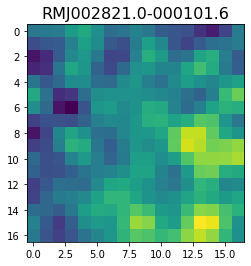

 28%|██▊       | 2823/10099 [03:59<10:34, 11.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 89.40032    52.810097   81.44947   138.70078   131.00052    50.321205
 -13.637941   -5.2091417  36.18605    60.01056    74.18853   102.56176
 132.65874   143.64793   146.143     156.38536   158.14232  ]


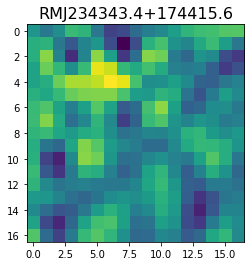

 28%|██▊       | 2829/10099 [04:00<08:45, 13.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -88.81478   -75.12095   -71.987465  -83.41725   -98.35497  -107.164
 -113.96639  -127.879814 -146.10855  -155.13556  -149.96063  -141.16763
 -137.13834  -131.53802  -119.648476 -114.6761   -129.52338 ]


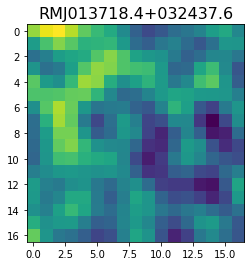

 28%|██▊       | 2831/10099 [04:00<09:56, 12.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.0715137 -25.954733  -32.577152  -17.196285   -0.7355254   2.3341956
  -2.5492766   1.3151517  20.3715     43.97705    60.768284   71.46099
  79.58814    81.463066   75.83333    73.88975    87.0465   ]


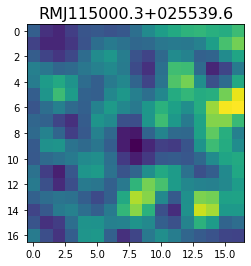

 28%|██▊       | 2833/10099 [04:00<11:05, 10.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 46.42886   33.37901   52.08433   81.68294   78.71331   49.989956
  42.205616  69.135124  96.15296   98.388535  91.931046  96.80267
 104.8105   101.88274   95.612305  99.037704 103.706985]


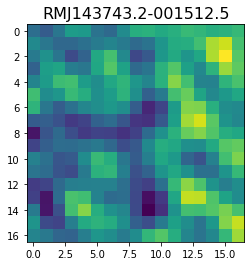

 28%|██▊       | 2835/10099 [04:00<12:01, 10.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-75.63497   -50.54695   -39.781025  -44.689697  -49.68964   -47.20931
 -35.196373  -12.889883   10.492255   21.124557   19.672523   19.112005
  23.018347   21.132078    5.5606775 -18.993912  -35.947083 ]


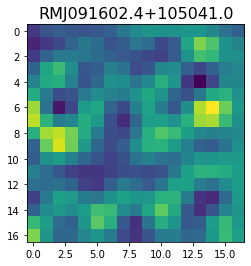

 28%|██▊       | 2840/10099 [04:01<09:43, 12.45it/s]

<class 'pixell.enmap.ndmap'>
[ 40.237545 110.74192  170.75359  155.26308  110.79981  100.22968
 126.386475 171.62917  227.47235  268.3977   268.50616  246.9654
 237.77077  236.28716  233.26561  254.7706   300.15393 ]


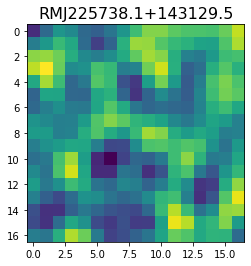

<class 'pixell.enmap.ndmap'>
[-74.13002  -92.999435 -90.1218   -65.459885 -56.2635   -75.12329
 -87.58987  -73.347046 -63.59916  -82.023415 -95.77566  -73.58596
 -48.174538 -62.237514 -91.550224 -87.90827  -64.98454 ]


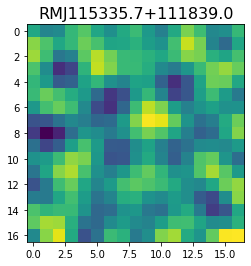

 28%|██▊       | 2842/10099 [04:01<13:25,  9.01it/s]

<class 'pixell.enmap.ndmap'>
[   5.2220006  -63.38136   -120.4877    -114.97925    -65.49935
  -33.80898    -49.39067    -80.70226    -87.1399     -77.3603
  -88.904205  -119.63908   -121.01416    -72.165054   -21.712889
  -26.389801   -76.00704  ]


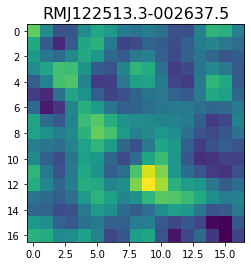

 28%|██▊       | 2843/10099 [04:01<15:23,  7.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[179.1853   183.8631   170.99364  177.57036  201.07672  189.70648
 131.55286   93.08749  121.18677  164.01451  149.96114   94.27486
  59.52818   56.888943  62.001995  88.47623  159.65498 ]


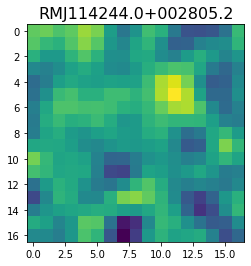

 28%|██▊       | 2845/10099 [04:02<15:30,  7.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -40.718784  -55.142952  -52.41151   -78.19959  -101.55094  -101.477844
 -115.83734  -138.0627   -129.4014   -141.10155  -224.4092   -265.6224
 -153.87138   -26.603909  -67.22151  -175.90443  -154.57915 ]


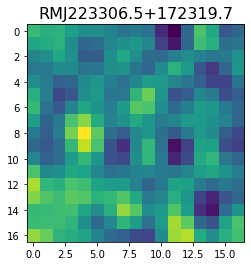

 28%|██▊       | 2847/10099 [04:02<15:36,  7.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 47.78842   59.3531    94.67083   79.27161   19.288513   5.947635
  58.11717   84.79753   45.702568  19.079865  53.9961    81.15945
  38.10764  -26.380444 -40.285778 -12.215891   8.173487]


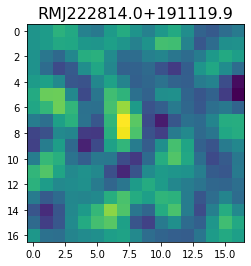

 28%|██▊       | 2849/10099 [04:02<15:46,  7.66it/s]

<class 'pixell.enmap.ndmap'>
[  22.121874   -49.085346   -57.731285    -6.87542     23.340097
   -6.5661197  -60.01707    -87.28502    -80.83845    -60.288948
  -35.005596   -12.493194   -21.94705    -76.593796  -120.422516
  -83.835365    -0.7478253]


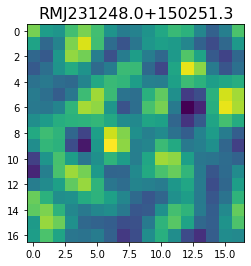

 28%|██▊       | 2850/10099 [04:02<18:52,  6.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-132.00845  -127.05936  -108.31385  -103.28565  -117.306145 -130.82253
 -129.23004  -118.403946 -111.79836  -115.369934 -126.135155 -135.96423
 -136.1059   -125.86643  -117.29841  -123.94319  -143.30148 ]


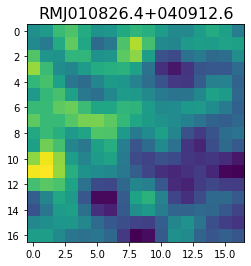

 28%|██▊       | 2853/10099 [04:03<15:11,  7.95it/s]

<class 'pixell.enmap.ndmap'>
[-60.862465  -63.490166  -29.208708   14.725752    6.2618947 -45.30254
 -66.528336  -34.68124    -7.1333203 -21.480247  -38.368885  -15.516743
  17.437157    3.9226382 -49.227547  -74.44614   -35.05793  ]


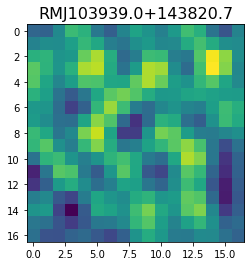

 28%|██▊       | 2854/10099 [04:03<17:36,  6.85it/s]

<class 'pixell.enmap.ndmap'>
[ 94.80512  104.888145 146.58287  157.99365  122.67183   85.150665
  75.82898   81.702385  93.573166 121.26992  153.23395  157.19896
 134.43646  124.99383  145.5885   165.33904  157.66966 ]


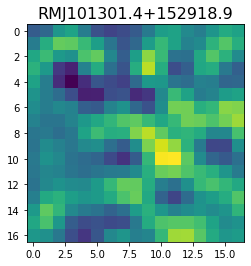

 28%|██▊       | 2855/10099 [04:03<19:25,  6.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.30745   54.252125  66.46605   58.74043   32.093224  19.329687
  31.919981  36.749825  10.999375  -8.363043  28.319075 100.61924
 132.58687   94.72477   43.106003  38.735565  72.18221 ]


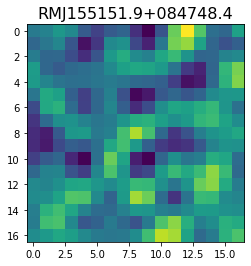

 28%|██▊       | 2859/10099 [04:03<13:34,  8.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-152.70985 -151.44576 -158.89096 -164.99821 -165.33362 -163.67351
 -159.26508 -152.40361 -154.60092 -170.32031 -178.50677 -159.72276
 -133.5192  -137.05412 -169.12518 -187.78548 -166.94742]


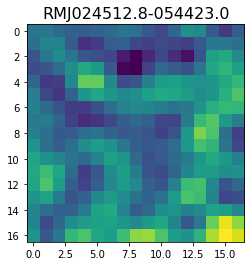

 28%|██▊       | 2862/10099 [04:04<12:22,  9.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-134.4843   -167.39453  -164.22731  -133.38467  -133.7      -158.99838
 -140.92706   -78.20689   -55.36823  -103.88119  -148.17134  -132.6055
 -105.844444 -123.89104  -152.78485  -132.71124   -77.4047  ]


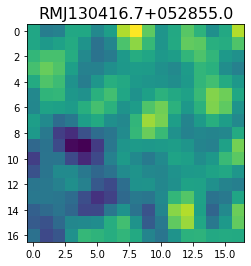

 28%|██▊       | 2867/10099 [04:04<09:50, 12.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 89.51319    89.81237   112.192764  129.17      108.63998    64.73235
  39.813583   54.680447   95.35312   125.17119   101.59156    16.767025
 -68.013824  -73.11838    -5.9378123  28.3665    -46.78836  ]


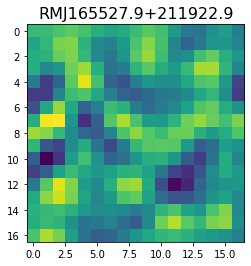

 28%|██▊       | 2870/10099 [04:04<10:03, 11.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 202.22127   198.425     144.71906   139.54308   164.80772   158.4105
  154.85156   200.50117   205.0926     59.819645 -146.20833  -217.90451
 -133.37106   -47.934902  -44.60464   -62.571712  -55.261597]


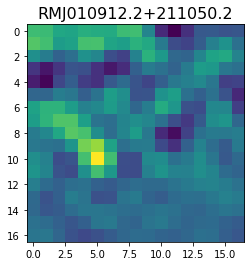

 28%|██▊       | 2876/10099 [04:04<08:16, 14.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-45.532143  -32.94321   -35.336464  -60.786587  -76.288536  -50.8661
  -4.9968586  12.978423   -6.037875  -24.00988   -18.781982  -13.92616
 -28.677618  -40.137527  -26.66755   -12.40032   -26.633017 ]


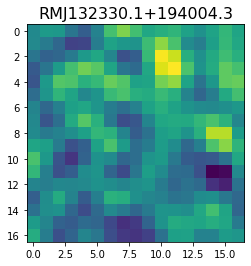

 29%|██▊       | 2880/10099 [04:05<08:23, 14.35it/s]

<class 'pixell.enmap.ndmap'>
[-29.529013    2.555138   39.877697   48.624798   56.00839    37.775513
 -43.816765  -95.72716     7.4772153 177.47249   193.35748    54.242718
   4.473808  143.50815   258.50232   159.02943   -38.838177 ]


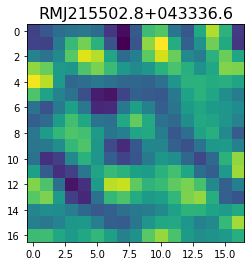

<class 'pixell.enmap.ndmap'>


 29%|██▊       | 2882/10099 [04:05<09:27, 12.73it/s]

<class 'pixell.enmap.ndmap'>
[-216.30824 -196.79376 -183.54497 -199.017   -211.45752 -196.6092
 -184.87874 -205.45908 -232.2321  -228.86032 -207.23563 -199.91563
 -207.52722 -209.43674 -200.1941  -187.69469 -177.77013]


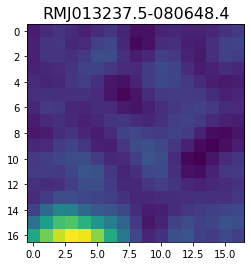

<class 'pixell.enmap.ndmap'>
[  -8.1094475   -1.9584594    9.074724    10.951693   -20.35904
  -75.04525   -118.12236   -138.19139   -152.39607   -158.22241
 -120.902596   -34.195557    37.256134    20.047522   -69.9847
 -135.79158   -117.30138  ]


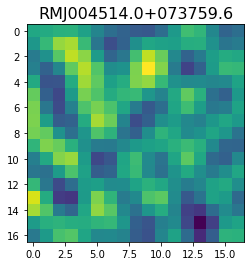

 29%|██▊       | 2884/10099 [04:06<13:49,  8.69it/s]

<class 'pixell.enmap.ndmap'>
[-31.14493   -71.06212   -30.550018   26.22242    39.30171    25.908978
   3.6477375 -28.53533   -36.457874   -6.680611   -7.4488444 -65.85239
 -83.286285   -9.618116   37.594135  -25.209324  -89.075165 ]


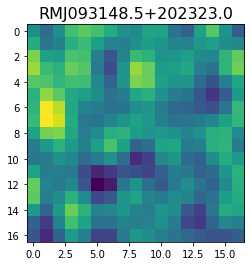

 29%|██▊       | 2885/10099 [04:06<15:59,  7.52it/s]

<class 'pixell.enmap.ndmap'>
[ -94.77287   -133.41246   -123.7751     -94.94786   -113.648254
 -145.02344   -118.57234    -83.891464  -129.14183   -195.88567
 -159.94623    -50.90949     -5.662928   -42.85133    -60.59899
  -25.45655     -2.8365464]


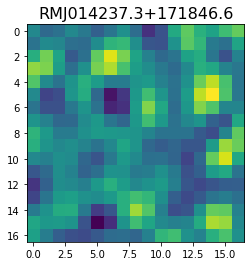

 29%|██▊       | 2886/10099 [04:06<19:21,  6.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 248.86215    117.29229     -4.0762053  -64.367355   -95.89182
  -62.86133     64.395836   168.1569     127.62319     23.499212
   32.47012    179.97421    307.8723     258.33026     51.38499
 -121.39025   -111.667755 ]


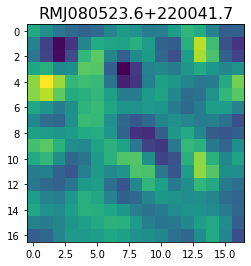

 29%|██▊       | 2888/10099 [04:06<18:01,  6.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -0.6352027 -66.50933    14.706247  158.24533   201.98476   135.46025
  84.87251   107.264854  134.24918   115.96667    89.50423    77.75227
  39.068466  -30.704477  -46.776012   41.29332   148.00853  ]


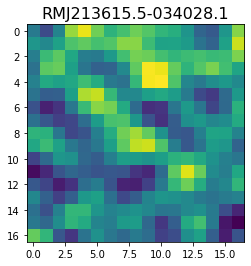

 29%|██▊       | 2890/10099 [04:07<17:00,  7.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  2.9973774  12.742042    8.661091   38.249172   86.87956    98.193504
  94.17344   122.50841   133.57475    70.37823    14.457542   65.94669
 150.59116   135.0148     58.492645   48.76225    85.38682  ]


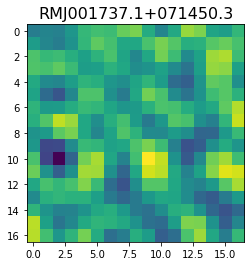

 29%|██▊       | 2895/10099 [04:07<12:10,  9.86it/s]

<class 'pixell.enmap.ndmap'>
[   4.7352176   15.505445    91.403175    64.96191   -127.6253
 -261.3178    -194.85585    -78.26201    -45.460842   -31.141302
   32.09182    112.034676   166.26872    142.05313      6.544229
 -107.316284   -21.62318  ]


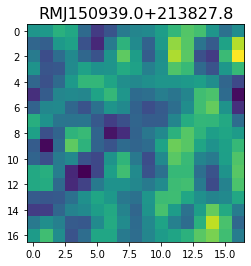

 29%|██▊       | 2896/10099 [04:07<14:00,  8.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 13.211433  -38.042183  -70.83401   -52.554092  -32.361046  -59.917683
 -77.63807     2.4607391 137.2867    177.42798    67.525     -68.57323
 -85.08338     3.1720417  54.408558   -7.4099975 -99.637474 ]


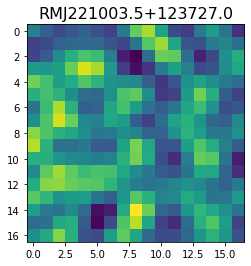

 29%|██▊       | 2898/10099 [04:07<14:23,  8.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -15.380336 -106.195786  -58.87453    15.867561   18.602604   30.554205
   99.79563   108.49749    18.01024    -9.610717  100.14265   177.11224
   96.65103   -13.482505   -4.050712   75.71569   114.824905]


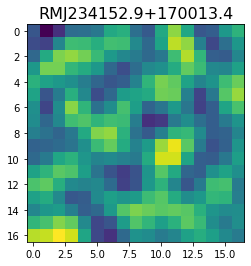

 29%|██▊       | 2900/10099 [04:08<14:38,  8.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -65.52636  -109.29236  -100.48881   -59.9471    -58.362747  -85.813614
  -80.96081   -53.43037   -59.196465  -92.96131  -109.39917  -106.50452
 -102.852295  -88.41174   -64.23532   -63.26976   -84.469086]


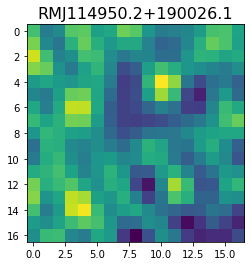

 29%|██▉       | 2906/10099 [04:08<09:59, 12.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-0.94010967 11.24822    34.007095   45.788452   38.577156   24.938221
 18.994587   22.62996    29.065628   31.63129    31.122646   37.72395
 58.017414   78.309235   75.68476    51.81978    38.281635  ]


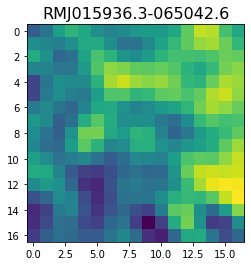

 29%|██▉       | 2909/10099 [04:08<10:15, 11.68it/s]

<class 'pixell.enmap.ndmap'>
[ -62.61976   -71.104126  -78.83378   -69.88663   -39.00919   -16.239199
  -32.645054  -68.22967   -54.859478   36.496346  118.74545    74.62676
  -60.153595 -110.197624  -10.559146   87.895645   48.24846 ]


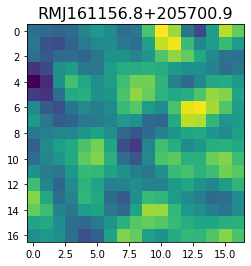

 29%|██▉       | 2911/10099 [04:08<11:22, 10.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -37.079426     3.1227007  -44.793983  -146.3611    -155.3286
  -68.17689    -48.76459   -152.05305   -237.08492   -211.6744
 -156.81738   -145.58037   -133.03554    -90.85007    -75.80894
 -104.51967   -110.62576  ]


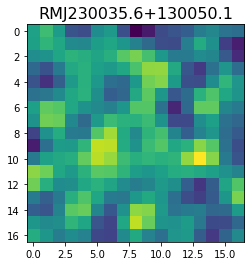

 29%|██▉       | 2915/10099 [04:09<10:15, 11.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 31.721226   25.649422   10.436253   -2.8262691  -7.865467   -8.087083
  -7.5648007  -5.259022   -1.0107064  -0.4363202  -7.3926663 -14.637428
 -10.144784    5.686405   16.59388     9.762523   -6.5914245]


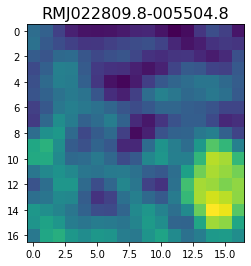

 29%|██▉       | 2917/10099 [04:09<11:16, 10.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  13.53565    -40.661114  -102.23767   -104.19069    -40.635063
    8.612158   -11.644055   -51.9184     -42.521767    -5.0618987
   -8.575172   -51.839294   -68.062256   -33.052513     1.6779872
  -11.015313   -53.13983  ]


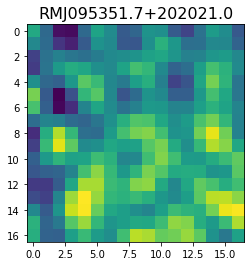

 29%|██▉       | 2919/10099 [04:09<12:04,  9.91it/s]

<class 'pixell.enmap.ndmap'>
[  13.776598  -58.293953 -168.7376   -210.77475  -162.19017   -93.32748
  -62.95585   -66.34324   -75.11922   -79.73428   -85.98194   -93.26758
  -88.18438   -62.10168   -31.343567  -23.788137  -42.879177]


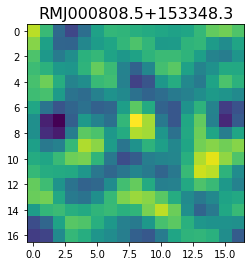

 29%|██▉       | 2920/10099 [04:09<14:35,  8.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -81.84938    -59.446426   -96.43021   -123.97104    -63.467957
   15.4932165  -12.1986685 -118.630424  -157.00288    -93.53356
  -48.530983   -87.731895  -128.80759   -102.43337    -63.051037
  -71.48239    -90.18935  ]


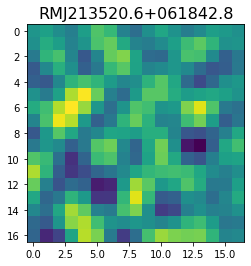

 29%|██▉       | 2924/10099 [04:10<12:19,  9.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -76.68601  -120.97068  -162.39175  -118.60875   -25.91701     9.390945
  -52.504543 -149.86775  -197.51768  -164.48859   -89.57996   -39.989857
  -44.23982   -67.079994  -67.45636   -60.12535   -81.82382 ]


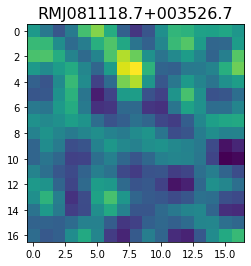

 29%|██▉       | 2926/10099 [04:10<13:00,  9.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   4.9468856   10.634157    33.61429     42.990433    36.26147
   35.71068     45.414654    45.3514      29.437454     7.491615
  -20.4198     -36.413567    15.183641   130.79364    176.50327
   51.685516  -111.13031  ]


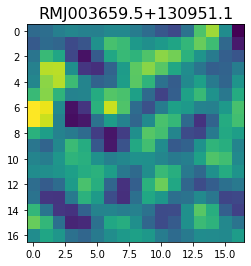

 29%|██▉       | 2929/10099 [04:10<12:12,  9.79it/s]

<class 'pixell.enmap.ndmap'>
[  9.816941  57.93884   87.4785    89.5544    89.443146  93.15984
  73.63756   31.72139   17.609186  51.96326   79.50801   55.623085
  28.665134  66.54692  142.05559  173.1816   152.06303 ]


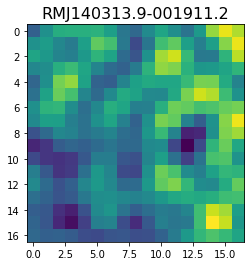

 29%|██▉       | 2930/10099 [04:11<14:19,  8.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-103.943634  -105.749855   -44.725025   -10.714472   -38.690536
  -63.25636    -39.61988     -7.564557    -6.5189247  -12.703699
    4.319644    27.780209    29.456467    13.740417     0.5682646
   -5.860611   -14.741227 ]


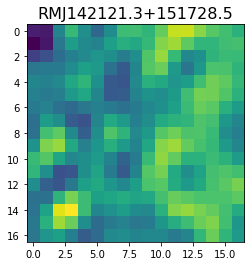

 29%|██▉       | 2933/10099 [04:11<12:58,  9.21it/s]

<class 'pixell.enmap.ndmap'>
[23.156643 22.222511 47.152187 67.435524 68.64466  62.01717  58.57597
 55.36793  47.63231  40.002842 42.929256 62.22019  88.28699  96.74597
 73.77051  42.389065 42.55718 ]


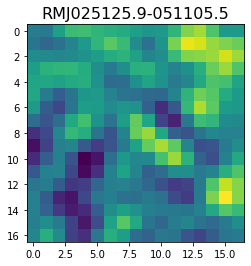

 29%|██▉       | 2934/10099 [04:11<15:03,  7.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 44.71301    23.556816   -7.6591983  -8.646124   16.151356   26.549458
   5.0812373 -24.811903  -37.626427  -34.55374   -28.076538  -20.789783
 -10.615905   -3.1698325  -6.8469872 -20.30533   -32.364147 ]


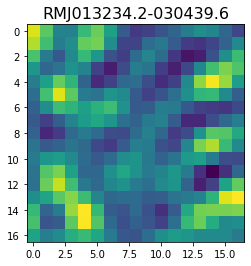

 29%|██▉       | 2937/10099 [04:11<13:14,  9.01it/s]

<class 'pixell.enmap.ndmap'>
[  66.14068    42.281136  -27.508884 -114.06011  -163.99078  -139.31696
  -56.661373   16.369051   15.510528  -53.203667 -106.4872    -70.98607
   22.583858   69.00407    19.525616  -61.404396  -88.70406 ]


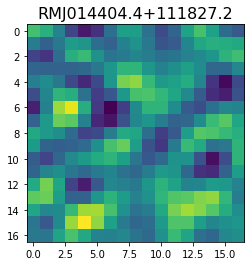

 29%|██▉       | 2944/10099 [04:12<07:54, 15.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 62.492188  150.10803   167.38249   137.20168   108.15284    97.95595
 119.66969   171.63776   191.69702   114.6132    -12.425321  -64.05839
  -3.7140903  71.520134   73.17338    24.960085   -1.0276655]


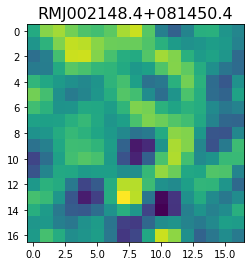

 29%|██▉       | 2948/10099 [04:12<08:05, 14.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[106.13658  138.72061  114.39443   73.30057   84.79259  135.01746
 157.64691  143.62216  149.34506  193.56294  209.7963   142.00821
  51.895763  63.810482 195.2992   309.69553  280.56018 ]


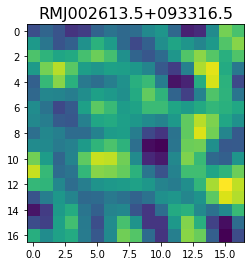

<class 'pixell.enmap.ndmap'>
[-47.282207  -63.71544   -37.895767   -8.739844    1.5506397  10.441491
  27.631147   26.253744  -11.088916  -52.438755  -60.06581   -47.0383
 -48.59578   -59.880142  -50.455505  -25.704088  -20.341978 ]


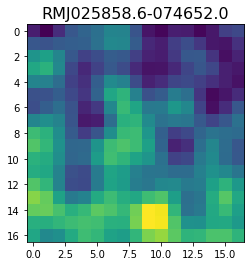

 29%|██▉       | 2951/10099 [04:12<11:26, 10.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -61.91399   -74.516685  -63.17315   -61.270687  -78.454956  -80.897194
  -54.53459   -42.68509   -86.051865 -152.92403  -170.52393  -118.81708
  -56.283417  -45.104256  -79.97474  -108.84391  -103.63836 ]


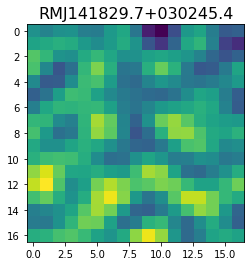

 29%|██▉       | 2953/10099 [04:13<12:00,  9.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  13.827254     77.172325     19.064419     31.934608    107.516624
   49.32728     -99.652466   -109.13716      -1.3741857    -0.25110352
 -107.54052    -135.3874      -59.604786      1.8034861    33.03665
   66.16906      41.504124  ]


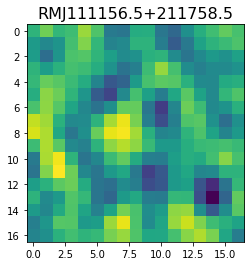

 29%|██▉       | 2955/10099 [04:13<12:22,  9.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 69.95292   91.475945  73.940025  52.71727   63.413166  79.236786
  49.747887  -8.931105 -26.470806  16.580156  61.59381   63.35526
  46.0181    46.02384   56.932938  59.67366   59.593967]


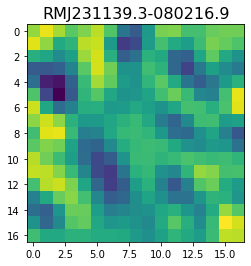

 29%|██▉       | 2962/10099 [04:13<09:08, 13.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -28.353296  -63.77608  -100.913216 -103.092865 -102.10394  -116.71912
 -103.871376  -63.20115   -69.06142  -132.04858  -157.50163  -100.66541
  -38.60408   -42.291138  -87.85834  -118.76332  -104.81169 ]


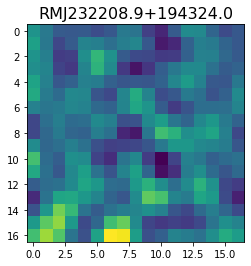

 29%|██▉       | 2965/10099 [04:14<09:54, 12.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-39.710403  -8.795386  -9.479146 -28.473133 -37.677105 -35.190533
 -33.323868 -33.19786  -30.610123 -27.384434 -24.498947 -19.394258
 -15.081523 -17.562632 -23.97594  -26.352072 -24.093622]


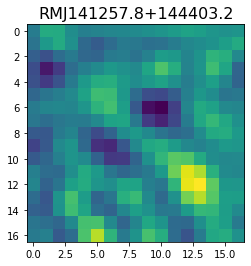

 29%|██▉       | 2971/10099 [04:14<08:25, 14.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   3.3134782   12.118503   -11.561343   -39.06935    -79.49932
  -93.895935   -43.303444     9.26641    -11.873537   -60.832703
  -61.85721    -50.05481    -80.2561    -101.20266    -66.26591
  -50.095737  -106.00745  ]


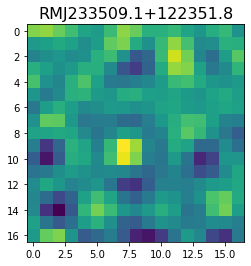

 29%|██▉       | 2973/10099 [04:14<09:16, 12.80it/s]

<class 'pixell.enmap.ndmap'>
[ -20.119717  -72.53854  -103.078156 -111.05665  -122.045944 -131.55457
 -107.67805   -55.63412   -29.972637  -57.11728   -91.65955   -88.716324
  -77.28273  -106.146774 -149.5312   -139.44293   -81.00811 ]


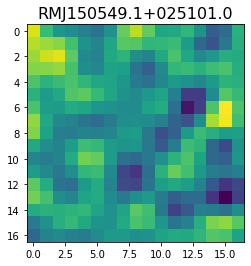

 29%|██▉       | 2975/10099 [04:14<10:11, 11.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-164.26503 -175.35863 -126.71989  -87.4661   -92.04302 -102.78958
 -100.5499   -95.43254  -84.12979  -84.11228 -134.65887 -198.3288
 -180.11044 -100.07166  -90.785   -169.81201 -199.46585]


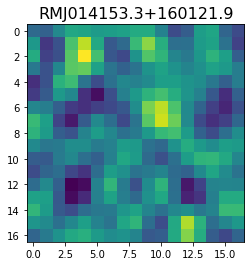

 29%|██▉       | 2979/10099 [04:15<09:17, 12.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -48.73268  -165.50406    19.227962  209.3023     95.25247  -148.9766
 -151.45209    68.0489    165.55743    40.92017   -58.643394  -10.13086
   16.512407  -47.3833    -13.557962  160.83864   215.92671 ]


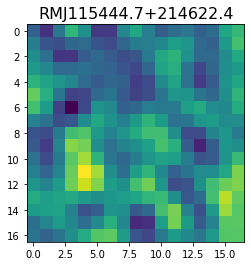

 30%|██▉       | 2983/10099 [04:15<09:01, 13.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-36.664883 -32.98276  -31.046844 -48.09336  -70.45668  -66.270164
 -39.07659  -24.048248 -30.57828  -32.955532 -20.128891 -11.19063
 -16.714941 -24.605097 -28.308317 -32.266293 -28.860544]


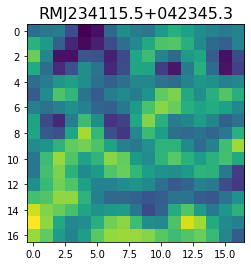

 30%|██▉       | 2988/10099 [04:15<08:23, 14.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.798641  55.113953  72.882416  49.989468  28.979656  55.57221
  86.765076  49.213593 -18.962591  -1.848515 100.592384 144.19939
  59.191338 -31.34503    2.610047 103.087494 124.6359  ]


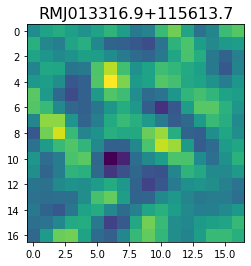

 30%|██▉       | 2992/10099 [04:16<08:34, 13.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -97.323296   -10.084348    20.154058   -32.870705  -117.24886
 -148.96497    -92.61665     -4.4753675   54.104267    97.679306
  119.24517     29.906797  -143.65012   -177.33441      6.808863
  137.0327      12.004361 ]


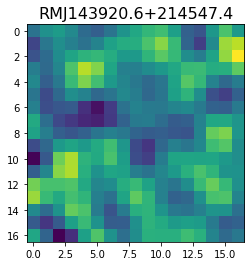

 30%|██▉       | 2995/10099 [04:16<09:10, 12.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-17.890505 -21.652748 -51.820683 -39.70941   21.091278  37.803123
 -24.797058 -73.59528  -39.90541   14.148268  18.25476   10.475412
  41.926956  65.479576  22.282877 -37.686558 -26.532421]


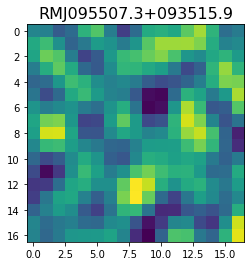

 30%|██▉       | 2997/10099 [04:16<10:04, 11.76it/s]

<class 'pixell.enmap.ndmap'>
[ -8.207884    3.360987   38.464363   68.41006    97.80537   121.83124
 111.520744   62.415688   13.469598   -0.9862068  16.306934   49.83573
  92.118065  130.99849   147.68556   136.1923    103.28235  ]


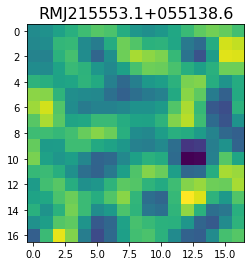

<class 'pixell.enmap.ndmap'>
[-18.662968  -22.59118   -27.912447  -38.399174  -67.768684  -92.12483
 -63.947273    2.4311426  27.557087  -18.544098  -69.27271   -69.35912
 -55.46717   -73.5332    -86.28975   -39.025593   31.536636 ]


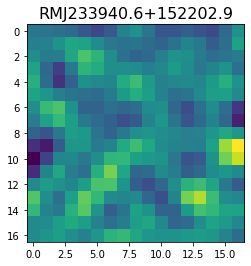

 30%|██▉       | 2999/10099 [04:17<13:30,  8.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -2.54133   -15.545772   -7.5903473   3.2965848  -2.2339528 -16.821636
 -19.407518   -7.302509    1.7431133  -3.7920704 -16.482704  -24.973003
 -27.626137  -26.532516  -19.636364   -7.5578976  -1.5110786]


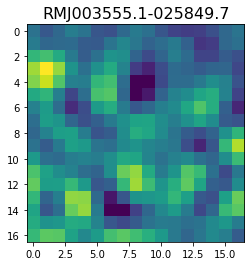

 30%|██▉       | 3004/10099 [04:17<10:43, 11.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 23.609228     0.64411336 -18.355206   -15.708493    22.350502
  64.82656     66.22817     31.41852      5.6624627    7.665647
  15.523345    11.258234    -2.3644633  -20.91773    -34.86626
 -19.961811    27.673813  ]


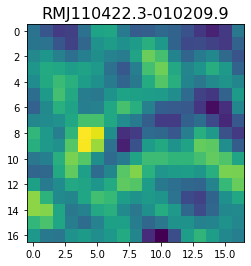

 30%|██▉       | 3008/10099 [04:17<09:45, 12.11it/s]

<class 'pixell.enmap.ndmap'>
[-11.815739  -18.184355    2.2936616  39.747517   54.75306    31.3399
   7.2750463  32.245056   91.25188   107.84715    54.967354   10.540296
  41.61577    92.96292    83.52691    53.59185    90.982506 ]


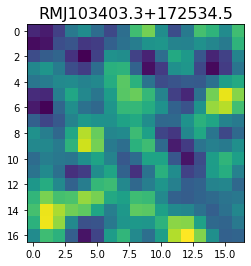

 30%|██▉       | 3010/10099 [04:17<12:23,  9.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-67.08048  -70.55829  -88.765274 -83.9304   -62.33244  -65.063416
 -87.98552  -86.01011  -56.469677 -44.387337 -60.50476  -64.55901
 -38.453842 -11.024294  -0.706189   5.99046   10.18253 ]


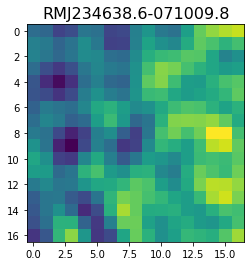

 30%|██▉       | 3012/10099 [04:18<12:59,  9.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  33.995213    -1.2496414  -40.99159      3.9502585   66.853035
   40.99534    -53.552288  -103.146      -53.99441     29.68699
   45.76356    -33.97255   -127.70712   -127.370636   -26.892687
   66.830505    69.32397  ]


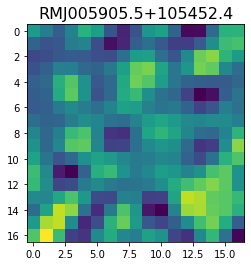

 30%|██▉       | 3013/10099 [04:18<16:01,  7.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 88.88331   112.23747    82.74278    51.32876    63.362892   97.021835
 112.63712   109.59539   103.92387    90.82424    57.600616   11.997356
 -16.451872    2.0204136  64.72194   121.698784  119.56037  ]


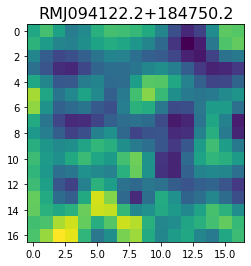

 30%|██▉       | 3016/10099 [04:18<14:52,  7.93it/s]

<class 'pixell.enmap.ndmap'>
[ -28.54918   -21.118065  -60.67845  -129.49635  -133.88066   -66.30453
  -41.043316 -110.20673  -178.29404  -169.01651  -142.63274  -162.4093
 -173.83208  -120.71108   -67.73168   -90.86027  -137.87685 ]


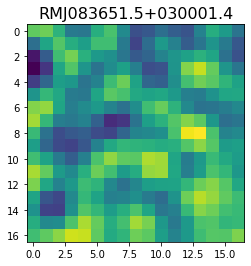

 30%|██▉       | 3017/10099 [04:19<17:49,  6.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 84.33483    77.298454   51.796158   40.345802   45.9801     59.493347
  85.5653    113.70064   103.90806    47.00196     2.0648303  21.919716
  72.91691    85.112854   56.609367   46.98355    80.45175  ]


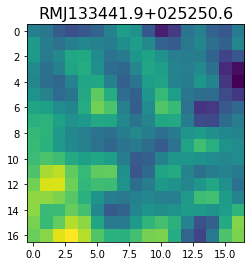

 30%|███       | 3034/10099 [04:19<05:51, 20.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 60.48737   87.63537   99.90331   69.2097    30.573668  31.17051
  78.16765  141.79713  183.51268  178.22289  131.2127    77.013245
  48.278515  49.13465   68.55275  104.35098  154.66336 ]


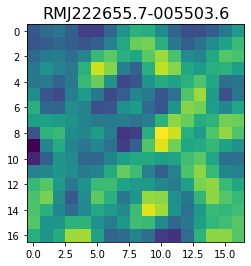

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 15.747473 -43.8763   -79.178406 -55.209373 -31.801336 -53.204563
 -79.76643  -69.31999  -48.624443 -57.795147 -82.6185   -86.41238
 -68.48345  -54.48183  -55.078037 -59.998775 -57.458702]


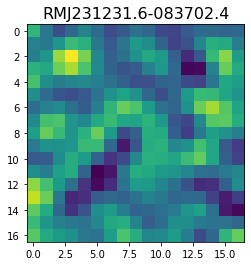

 30%|███       | 3038/10099 [04:20<09:13, 12.75it/s]

<class 'pixell.enmap.ndmap'>
[ -43.29599     -5.9302344  -46.80539   -118.738686  -141.49582
 -121.48836    -91.65853    -43.157494     4.6231594  -11.003835
  -82.0312    -128.5322    -133.79146   -137.14801   -111.08322
  -22.717499    25.77139  ]


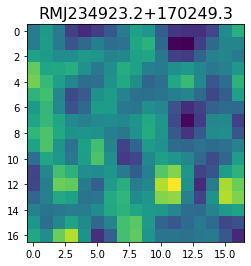

<class 'pixell.enmap.ndmap'>
[  6.8176627 -44.240955  -70.15449   -23.029902   41.99529    56.855106
  43.19528    54.021343   65.20439    16.380308  -63.20747   -71.817055
   6.9435034  60.384953   13.196766  -43.65967    18.258127 ]


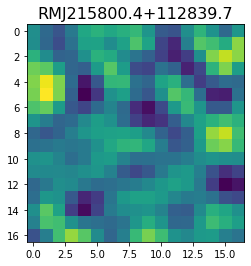

<class 'pixell.enmap.ndmap'>
[-191.982      48.464592  135.30914   118.96135   182.28098   263.37503
  188.37744    16.413618  -44.912167   34.61381   103.07142    83.24319
   52.690517   88.07577   151.23506   155.31448    93.804955]


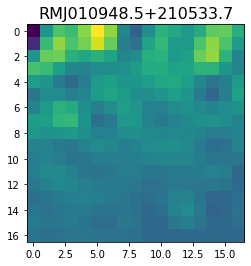

 30%|███       | 3041/10099 [04:21<13:48,  8.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -0.9541838  29.359629   18.533625   41.504646  143.47171   189.18542
  76.940315  -69.53366   -82.82851    15.942453   88.92988    73.27739
  15.287274  -13.022042   13.2013645  53.26334    62.630478 ]


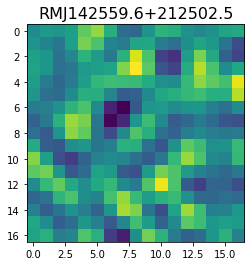

 30%|███       | 3043/10099 [04:21<13:54,  8.45it/s]

<class 'pixell.enmap.ndmap'>
[-61.18259  -62.20626  -54.981327 -42.26176  -44.967274 -62.055103
 -67.945724 -54.600544 -43.810978 -47.97355  -50.66757  -41.80429
 -41.22609  -63.771152 -85.136635 -71.68002  -31.056213]


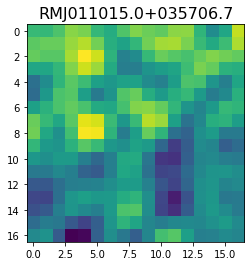

<class 'pixell.enmap.ndmap'>


 30%|███       | 3045/10099 [04:21<13:52,  8.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 73.706276  45.63514   36.195663  63.849075  97.001366  99.48362
  80.67508   78.06796   96.90515  101.4715    74.8699    49.62227
  56.796818  79.22786   84.65406   75.42795   73.12475 ]


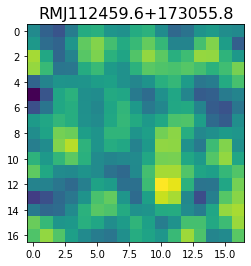

 30%|███       | 3048/10099 [04:21<12:40,  9.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -84.84976   -102.900375   -90.48388    -50.47891    -30.846775
  -63.24801   -109.73236   -111.791794   -77.199234   -62.93967
  -78.525345   -73.863144   -32.738873    -7.6639347  -34.4063
  -73.60991    -73.995285 ]


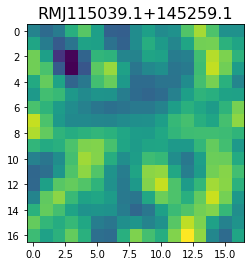

 30%|███       | 3050/10099 [04:22<13:58,  8.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 80.37596    62.685955   -6.1634517 -46.096317  -29.42549   -13.422953
 -27.518618  -26.951502    1.6754718  -2.5610185 -56.161903  -80.110214
 -35.783226   -2.45405   -40.677788  -84.08462   -56.92391  ]


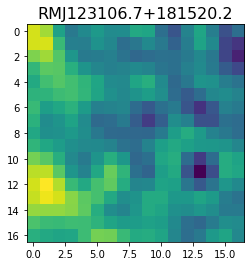

 30%|███       | 3054/10099 [04:22<11:27, 10.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-155.85437  -173.90504  -193.24834  -148.34035   -66.09883   -48.290604
 -101.57948  -122.42706   -71.53974   -33.384422  -68.99984  -124.23189
 -126.78717   -84.806915  -49.413696  -44.91585   -64.30561 ]


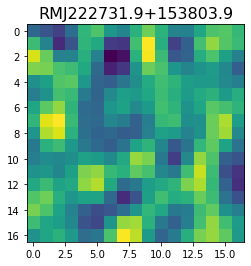

 30%|███       | 3056/10099 [04:22<12:08,  9.67it/s]

<class 'pixell.enmap.ndmap'>
[ -4.9149246   2.2050939  28.04242    25.520174  -21.313454  -58.4814
 -36.00437    13.835496   22.01923   -13.493743  -27.4366      9.589352
  45.51846    26.872435  -21.177757  -34.74088    -6.1964803]


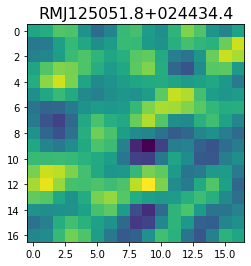

<class 'pixell.enmap.ndmap'>
[ 74.25084     76.07495     28.061539     9.438131    18.810644
  -0.21683422 -28.78053    -11.088269    29.279812    33.153084
  14.653563    24.707743    59.88537     84.980515    91.10476
  79.586365    45.467155  ]


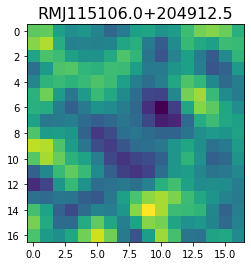

 30%|███       | 3058/10099 [04:23<15:22,  7.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-124.18612   -173.1047    -268.6787    -248.02345   -116.530655
  -43.391735  -105.46831   -194.15314   -195.47098   -141.68504
 -137.8568    -207.14256   -260.9584    -211.11182    -84.559525
   -1.2002592  -29.84451  ]


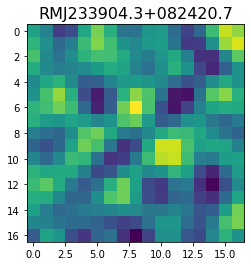

 30%|███       | 3061/10099 [04:23<13:36,  8.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 90.4393    81.78781  108.489494 138.57707  130.90514   99.71835
  91.81648  109.4155   105.568306  67.42207   50.306522  93.666145
 149.5947   147.93796   97.897316  63.361534  63.795277]


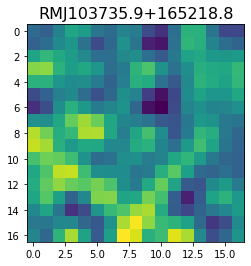

 30%|███       | 3067/10099 [04:23<10:04, 11.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-47.597855  -36.33774   -22.584145  -25.89805   -31.157673  -14.824325
   9.222454    7.695823  -14.3527565 -15.381678   17.17412    42.879436
  26.23412   -13.133343  -30.19079   -12.25856    15.71081  ]


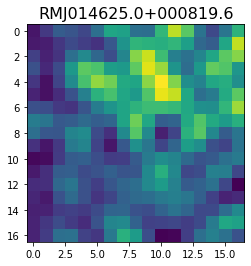

 30%|███       | 3070/10099 [04:23<10:11, 11.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  54.487362   -80.122505   -16.747356    91.74278    108.70845
  111.065315   129.89542     88.14297     35.60835     89.19995
  173.2745     146.69662     82.28946    108.32796    126.90298
   -7.6692486 -189.89345  ]


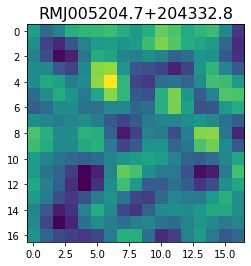

 30%|███       | 3073/10099 [04:24<10:15, 11.42it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  3.3656695  -0.7380052 -17.142967  -38.21113   -36.457077  -11.086953
   2.623239  -12.529881  -26.88667   -13.335977    8.6687355   9.369642
  -2.479146   -2.9422245   2.0299754  -5.7038994 -15.068074 ]


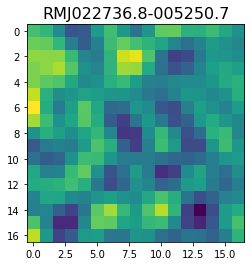

 30%|███       | 3075/10099 [04:24<11:06, 10.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-108.630035 -125.34603  -130.78658  -134.49843  -135.38438  -128.98361
 -132.877    -156.35883  -164.44652  -134.15553  -113.55432  -147.49521
 -188.54167  -174.35901  -142.88815  -164.12291  -209.09445 ]


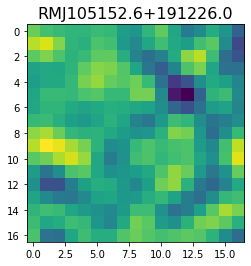

 30%|███       | 3078/10099 [04:24<10:46, 10.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -20.056856  -91.38339  -147.89273  -157.82793  -148.47385  -118.72046
  -88.122734 -121.475555 -193.3049   -187.09317  -120.99422  -155.79013
 -285.87415  -288.94424   -96.79375    62.468414   20.166574]


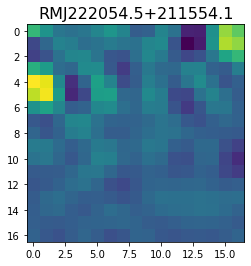

 31%|███       | 3087/10099 [04:25<06:26, 18.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -53.299103  -37.232323  -37.184017  -47.949577  -58.2688    -65.943565
  -68.0851    -57.774677  -43.972195  -52.304943  -84.99548  -101.6445
  -70.50056   -22.691383  -16.77325   -56.31221   -85.64254 ]


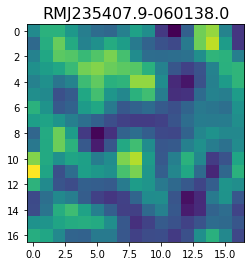

 31%|███       | 3091/10099 [04:25<06:55, 16.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -97.75157  -124.60444   -93.49121    34.115177  252.77753   337.09033
  119.58232  -170.04333  -180.09282    28.809029   77.9331   -124.75259
 -245.35724   -68.09906   161.64995   123.185005 -106.82153 ]


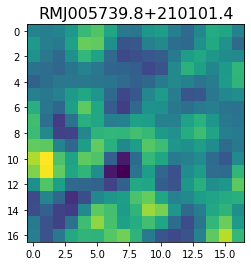

 31%|███       | 3096/10099 [04:25<06:44, 17.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 22.600704    4.792212  -19.917913  -35.08289   -21.687544   20.233486
  51.042885   36.12444     4.113478    2.2607954  12.855762  -10.38919
 -47.36556   -41.124138    1.5134646  28.004389   32.451138 ]


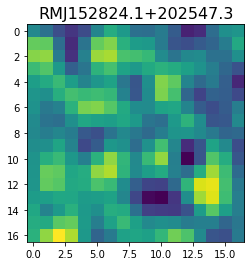

 31%|███       | 3099/10099 [04:26<08:11, 14.25it/s]

<class 'pixell.enmap.ndmap'>
[  66.77224     77.45828     38.622395   -10.570281   -28.566225
    2.0768425   44.063534    20.479174   -77.02743   -138.06168
  -77.287476    26.05646     43.7664      -2.272084     6.1834335
   75.51841    100.71193  ]


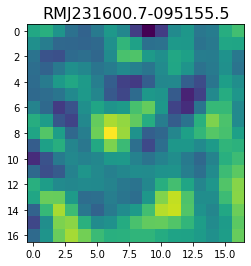

 31%|███       | 3101/10099 [04:26<09:27, 12.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 15.022606 -13.611429 -39.386623 -45.520473 -42.838066 -51.410217
 -73.246346 -92.25256  -96.85328  -91.82544  -86.46672  -80.94531
 -71.159874 -61.23849  -60.91572  -70.27032  -76.945076]


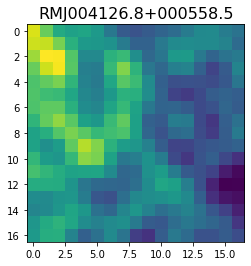

 31%|███       | 3106/10099 [04:26<08:22, 13.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[116.50671  118.05203   98.76658   67.35493   82.4205   163.1447
 225.31241  176.42342   52.94663  -12.960511  39.59043  134.95355
 169.60432  127.500244  71.87367   64.56602  110.167564]


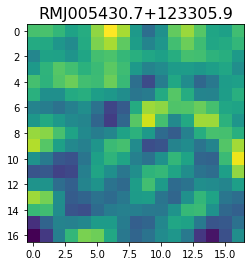

 31%|███       | 3115/10099 [04:26<05:48, 20.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[135.80615  162.82434  136.5358   100.874344  96.91446   97.69698
  80.70403   77.08756  103.81288  127.547806 129.12444  129.1255
 132.82497  124.24128  117.72232  139.95108  167.84258 ]


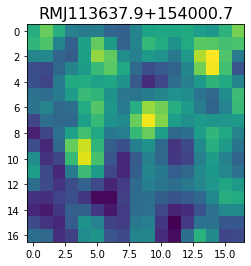

 31%|███       | 3121/10099 [04:27<05:53, 19.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[105.19768   87.34608   53.200584  59.489887 103.1274   130.0786
 126.45042  132.60811  156.34225  146.15887   84.10281   36.90928
  64.05819  129.90465  163.94931  160.1713   152.7112  ]


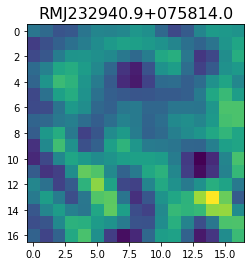

 31%|███       | 3124/10099 [04:27<07:04, 16.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-33.563526  -32.123554  -16.712898   -3.6393557 -11.252584  -27.79809
 -33.612156  -35.99172   -46.84703   -52.11784   -42.112865  -40.54316
 -60.15765   -65.723755  -31.430853    2.5326765 -11.291747 ]


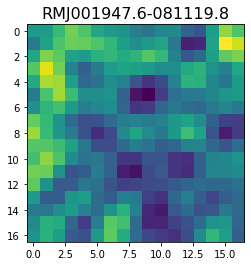

 31%|███       | 3127/10099 [04:27<07:58, 14.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -5.655331   52.688766   32.741837  -26.211672  -35.631172    1.48963
  17.433523   -5.1188645 -28.736696  -31.391167  -17.39148     7.4991593
  30.888535   35.757557   26.257221   18.847685   10.21756  ]


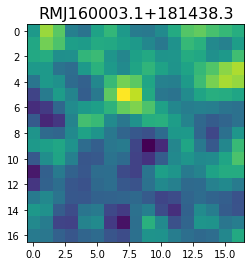

 31%|███       | 3130/10099 [04:28<08:36, 13.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[107.22052   92.582695  89.48927  108.295265  96.84867   44.861904
  25.591082  77.11043  129.48972  114.05834   67.331436  59.219833
  85.04054   97.461945  92.23709   96.41581  109.42685 ]


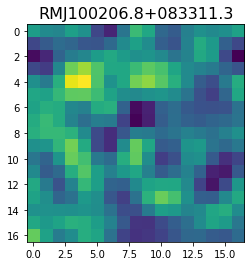

 31%|███       | 3133/10099 [04:28<09:25, 12.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[176.08545 178.48904 161.2203  150.22702 150.81326 163.2863  190.15778
 204.89034 169.27211 104.94515  83.44935 119.08115 144.37077 123.87362
 109.13963 135.43546 152.31151]


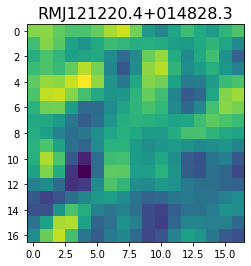

 31%|███       | 3136/10099 [04:28<09:25, 12.31it/s]

<class 'pixell.enmap.ndmap'>
[ 37.231285  56.66268   82.937096 109.16608  114.07349   97.69585
  83.51013   70.45142   42.587315  28.1949    67.754944 123.239044
 119.19058   74.8577    75.20539  104.63664   56.458515]


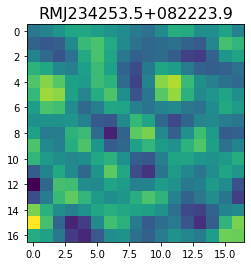

 31%|███       | 3138/10099 [04:28<10:47, 10.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-31.401684  -37.568707  -37.74808   -52.326996  -68.37588   -53.295616
 -28.518108  -40.914852  -72.72407   -68.58603   -33.849712  -19.19169
 -28.58691   -24.121935   -2.4306703   4.331312  -12.79006  ]


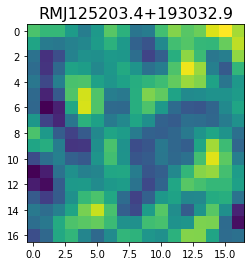

 31%|███       | 3141/10099 [04:29<11:08, 10.41it/s]

<class 'pixell.enmap.ndmap'>
[-100.643425 -160.59563   -43.61919   101.97688    50.725544 -122.424774
 -156.78471   -18.144169   73.66246    14.238254  -51.917683  -14.966188
   24.58805   -28.765982  -74.17997     5.278263  111.72487 ]


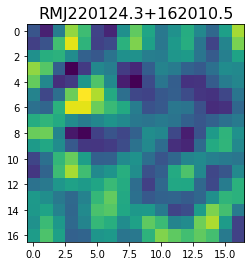

 31%|███       | 3143/10099 [04:29<12:21,  9.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  97.32515    64.9336    -20.900032  -45.35898   -74.59086  -157.7739
 -187.48322  -104.067276  -22.087507  -40.36022  -100.06106   -99.92976
  -23.62053    66.20031    81.21508    -4.650435  -85.06573 ]


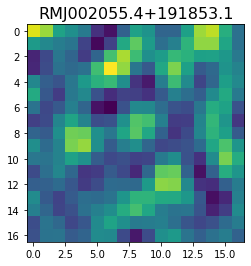

 31%|███       | 3146/10099 [04:29<11:42,  9.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 27.61084    -1.852784  -31.136196  -23.996117    6.1262803  11.1063
 -13.45284   -12.490895   42.338745   96.74749    82.32606     8.369839
 -55.693726  -67.00519   -38.79995    -0.5739549  29.776287 ]


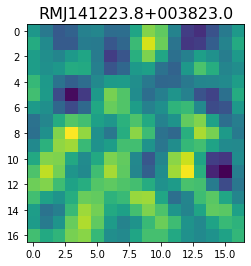

 31%|███       | 3149/10099 [04:30<11:45,  9.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[110.06881  145.48373  126.9787    56.84857   16.518     50.48574
 110.96366  135.39806  125.897446 120.50849  125.31472  116.33626
  88.58766   63.31572   52.447163  49.11984   53.166817]


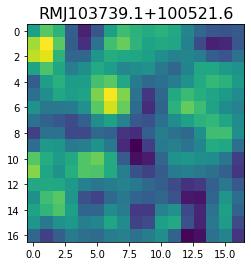

 31%|███       | 3154/10099 [04:30<09:41, 11.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -63.027973   -28.51304    -17.841002   -26.180227   -27.361134
   -6.7813244   13.909158    -5.522147   -62.425953   -92.832695
  -55.863583    -6.5147796  -22.585543   -84.23389   -101.26884
  -47.417297     8.942192 ]


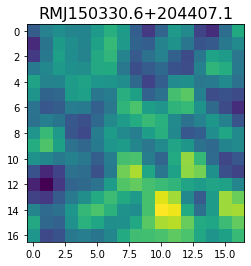

 31%|███▏      | 3159/10099 [04:30<08:33, 13.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -82.307396  -71.06141   -52.524345  -50.42247   -54.299656  -51.153477
  -53.08172   -69.38921   -84.864555  -88.149574  -91.04967  -101.10791
 -105.78224  -100.37015  -100.76811  -112.80681  -118.96195 ]


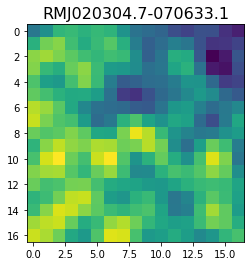

 31%|███▏      | 3161/10099 [04:30<10:06, 11.43it/s]

<class 'pixell.enmap.ndmap'>
[120.38191  105.78236  101.19081   64.002884  12.67848   16.7741
  75.90478   93.1499    20.55664  -52.36194  -31.50679   40.145664
  70.64161   70.46729   91.39963   84.76366  -20.116776]


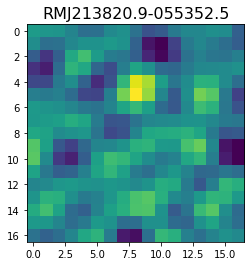

<class 'pixell.enmap.ndmap'>
[  6.3071065  13.227422  -18.671518  -33.561485  -19.407825  -11.898082
 -36.214035  -73.6471    -85.18742   -49.610325   22.819126   96.01905
 122.42986    73.99584   -22.689825  -95.36306   -91.82913  ]


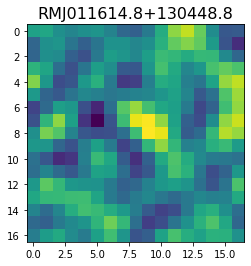

 31%|███▏      | 3163/10099 [04:31<14:11,  8.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 29.438139   43.496857   26.220816  -15.427514    1.4385777  70.4969
  70.276474  -20.657013  -57.562817   28.14379   101.13165    51.141663
 -25.199524   -6.477553   47.956726   25.36799   -37.968052 ]


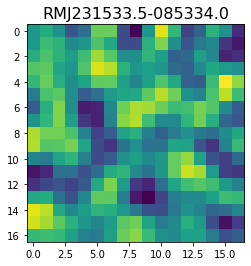

 31%|███▏      | 3173/10099 [04:31<07:24, 15.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-50.123962   -62.484768   -61.75395    -48.60255    -32.479797
 -15.9138365   -0.28240165   1.2751789  -22.123833   -52.721165
 -56.15224    -28.391708    -7.4687533  -22.704653   -52.91088
 -57.980976   -36.656693  ]


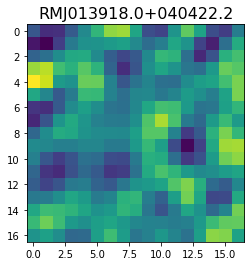

 31%|███▏      | 3176/10099 [04:32<08:03, 14.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  80.63145    38.184338  -62.372143 -104.09463   -37.211353   41.361187
   33.945396  -18.028852  -21.631844   17.797068   26.844685  -11.44571
  -48.792088  -51.128017  -21.028625   28.702005   75.987144]


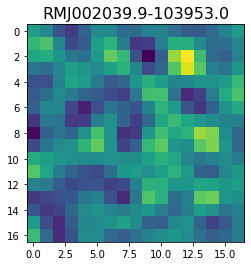

 31%|███▏      | 3179/10099 [04:32<08:33, 13.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[239.20226 203.08597 156.21472 135.87111 144.96237 161.23787 169.66151
 170.93054 177.36932 202.53937 233.8215  231.04074 184.19588 145.47784
 160.03902 196.02979 194.46829]


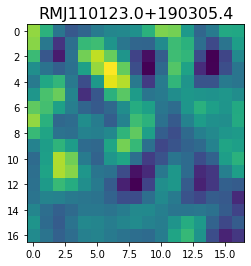

 32%|███▏      | 3182/10099 [04:32<09:03, 12.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-181.72652  -215.76094  -191.23598  -166.5893   -172.88475  -170.0299
 -122.1979    -66.82396   -70.78101  -140.18906  -210.56758  -226.28152
 -201.37216  -185.32039  -186.07373  -161.33075   -93.618515]


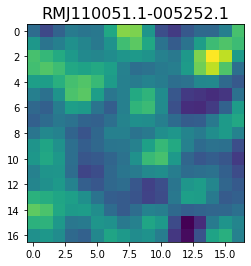

 32%|███▏      | 3187/10099 [04:32<08:19, 13.84it/s]

<class 'pixell.enmap.ndmap'>
[ 28.610886    5.534297   11.207119   45.68198    83.25436    82.84713
  35.910515   -5.5669312   8.214018   42.951015   21.272175  -52.843216
 -85.906815  -32.88649    34.765106   40.181995    8.493725 ]


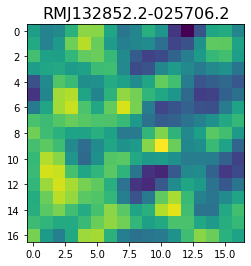

<class 'pixell.enmap.ndmap'>
[ 53.651035  52.519093  52.140003  48.577175  19.194393 -23.338924
 -40.667377 -28.862778 -16.276981  -8.704268  10.238016  30.18891
  19.155443 -20.501616 -47.376785 -40.41439  -26.714542]


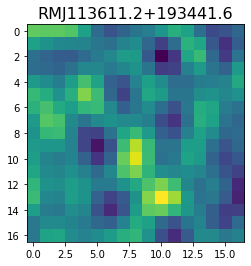

 32%|███▏      | 3196/10099 [04:33<06:57, 16.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-316.19052 -257.8646  -238.92673 -237.81374 -237.8772  -265.1329
 -303.44995 -295.85495 -249.78804 -228.31383 -239.85063 -241.86838
 -228.62898 -218.02573 -197.66095 -171.01422 -189.35522]


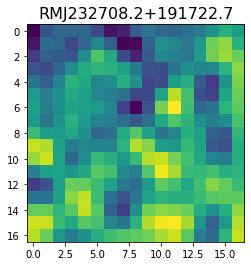

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 128.16841    25.642078  -67.05832   -46.226143   11.973411   35.51721
   59.779163   89.43663    48.755184  -55.239754  -92.338974  -15.891853
   44.62763   -14.239534 -112.56859  -123.15913   -52.192207]


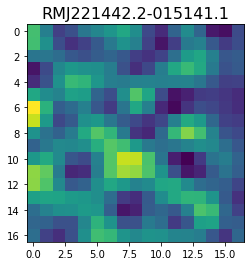

 32%|███▏      | 3199/10099 [04:34<10:14, 11.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 84.60177   83.12321   72.41851  103.71314  117.232605  42.86369
 -55.3169   -49.33958   59.778965 141.23553  129.83008   97.009026
 100.90107   93.54906   33.120724 -27.632553 -41.385   ]


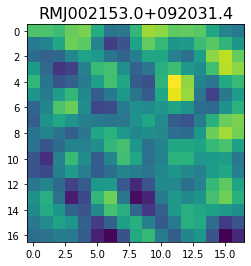

 32%|███▏      | 3202/10099 [04:34<10:29, 10.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-14.576881 -18.09098  -37.191    -41.42785  -16.7533    15.098379
  26.565565  14.045255  -6.808662 -17.583601  -6.501565  20.322222
  35.865746  19.871933 -10.053707 -16.442875   8.413523]


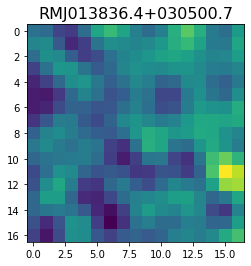

 32%|███▏      | 3204/10099 [04:34<11:23, 10.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -85.11941   -75.70747   -74.25125   -73.94441   -66.10626   -71.57666
 -114.97094  -169.90248  -174.05809  -115.5777    -64.63355   -85.48706
 -145.13141  -155.0968    -93.75881   -36.793854  -54.33941 ]


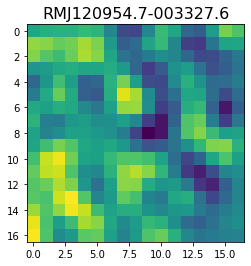

 32%|███▏      | 3206/10099 [04:34<12:21,  9.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-125.39787   -80.44303   -70.04218  -102.939415 -142.66219  -154.01338
 -146.79935  -146.14394  -145.15952  -129.19727  -119.563576 -140.32056
 -166.62112  -161.60562  -139.38312  -135.7991   -144.68465 ]


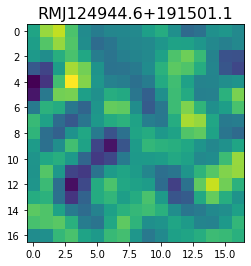

 32%|███▏      | 3209/10099 [04:35<11:55,  9.63it/s]

<class 'pixell.enmap.ndmap'>
[-189.5932   -132.36363   -52.86154   -35.023716  -89.73197  -145.55574
 -142.03932  -101.99299   -87.02792  -102.359535  -95.81436   -56.66914
  -48.349506 -100.322136 -133.32443   -68.66968    36.670273]


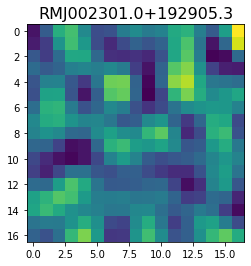

<class 'pixell.enmap.ndmap'>
[118.63985  167.29904  154.40709  106.503     98.81364  142.56198
 179.36937  163.0492   106.16875   57.028687  54.321266  90.886566
 109.35652   57.060925 -40.822746 -91.54133  -39.1761  ]


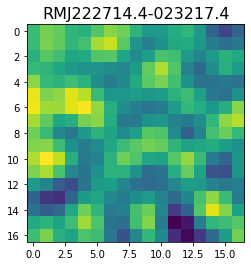

 32%|███▏      | 3211/10099 [04:35<15:26,  7.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-167.54396    -193.28404    -165.91002    -106.517204   -116.52498
 -206.01657    -220.67064     -92.31187      -0.83058673  -90.28851
 -211.07858    -180.21597     -97.31489    -130.14124    -186.95236
 -105.134445     15.232594  ]


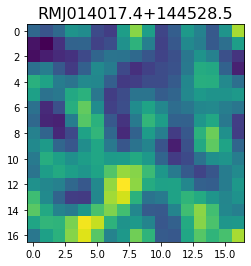

 32%|███▏      | 3213/10099 [04:35<14:46,  7.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-139.03383  -135.50758  -121.63176  -101.01936   -95.26685  -114.87997
 -138.2168   -136.619    -114.299194 -101.31668  -106.10139  -102.29378
  -75.312004  -53.283615  -64.203156  -84.508     -69.74956 ]


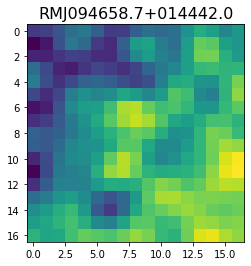

 32%|███▏      | 3216/10099 [04:36<13:01,  8.80it/s]

<class 'pixell.enmap.ndmap'>
[ -58.869156  -80.26277   -78.13685   -83.6632   -100.06958   -95.05423
  -69.781746  -63.879     -83.01167   -87.136246  -62.970726  -47.98735
  -66.21833   -92.26304   -97.47175   -89.5452    -88.38646 ]


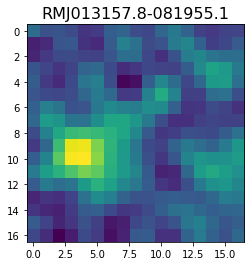

 32%|███▏      | 3218/10099 [04:36<13:25,  8.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 55.32895   50.198566  30.566452  54.22649  114.03007  115.011986
  28.777775 -28.019772  31.373257 113.46505   93.32022   16.53752
   8.370437  64.67632   89.40803   75.7415    91.73272 ]


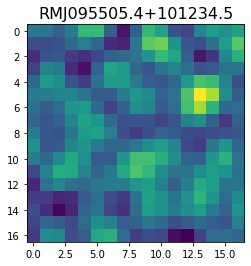

 32%|███▏      | 3219/10099 [04:36<15:09,  7.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  2.1201587  52.187836   85.15345    86.57688    72.45987    58.57529
  44.3319     20.968546  -14.917799  -51.01655   -66.10966   -55.212376
 -32.778065   -3.028727   40.71507    74.144875   49.94843  ]


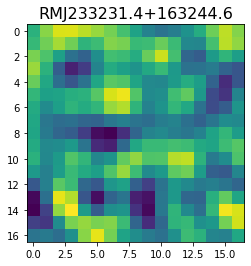

 32%|███▏      | 3223/10099 [04:36<11:30,  9.96it/s]

<class 'pixell.enmap.ndmap'>
[122.00849  277.18036  323.00742  215.80836  109.96929  128.22145
 195.01184  183.85251  125.66606  139.5681   213.90298  212.52396
 103.30214   29.852077  96.9839   207.46233  208.32465 ]


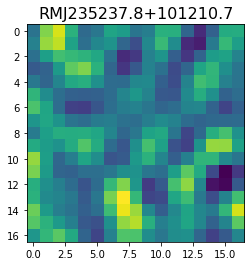

 32%|███▏      | 3225/10099 [04:37<11:55,  9.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -2.9878151 -15.996295  -15.328525   -4.584001    6.5691338  10.21878
   4.4587393  -1.2054205   3.0151389   8.727305    1.7508283 -10.260371
 -10.066973   -4.5278015 -12.038065  -23.70018   -15.859686 ]


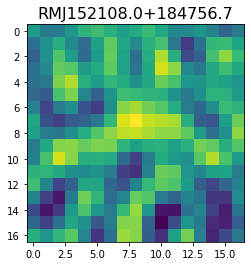

 32%|███▏      | 3231/10099 [04:37<08:50, 12.94it/s]

<class 'pixell.enmap.ndmap'>
[-139.18283  -256.28296  -247.17603  -180.51736  -180.26344  -228.06702
 -247.25916  -230.86511  -192.21933  -137.1811   -112.55325  -136.13435
 -127.360115  -56.296288  -41.688717 -144.59319  -235.33757 ]


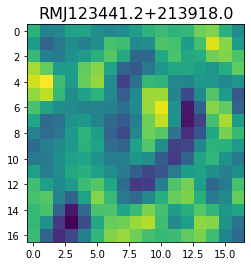

 32%|███▏      | 3233/10099 [04:37<10:35, 10.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 73.739204  33.831516 119.478874 250.41673  254.60672  133.38089
  50.86224   95.84678  188.68575  216.23492  163.43184   99.25189
  83.69699  109.56345  128.80312  119.521515 101.72748 ]


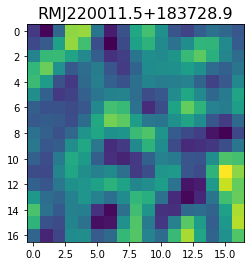

 32%|███▏      | 3235/10099 [04:38<11:26, 10.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -58.286    -109.32879   -34.886482   41.054913  -37.16128  -170.46693
 -179.9341   -103.604485  -78.34597   -97.76756   -93.81337   -82.216446
  -73.60008   -26.319649   21.212439  -24.574305 -117.77189 ]


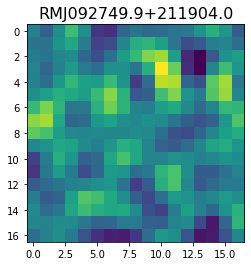

 32%|███▏      | 3236/10099 [04:38<13:40,  8.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-51.070557 -31.916721 -13.667908 -27.317863 -46.113667 -32.833767
  -6.602404  -4.322163 -18.33788  -23.686695 -23.320473 -26.085052
 -25.890852 -27.809132 -42.80765  -48.920826 -17.928574]


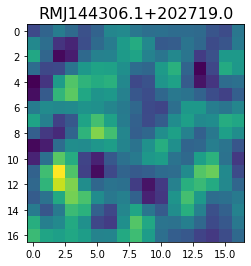

 32%|███▏      | 3239/10099 [04:38<12:27,  9.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[155.54399   164.59993   111.79054   103.77114   153.61378   153.52489
  66.03317    -3.8266287  22.912064   84.4636     95.01123    69.91109
  62.46164    61.614742   33.795807    8.239822   36.995785 ]


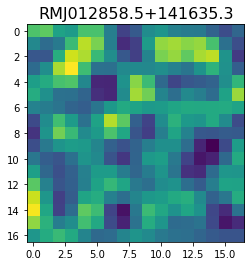

 32%|███▏      | 3241/10099 [04:38<13:05,  8.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -77.27582  -110.91312  -152.06665  -155.4334   -123.6529   -103.53097
 -110.318886 -103.62282   -63.100384  -35.59395   -64.213585 -116.64853
 -135.80656  -122.40236  -112.07638  -106.5866    -87.72841 ]


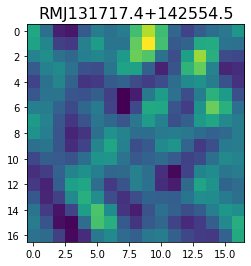

 32%|███▏      | 3243/10099 [04:39<13:39,  8.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -6.468361    5.88325    58.46288    72.51258    10.818377  -55.22208
 -40.499813   33.112873   73.88449    51.31474    17.46412     8.627717
   3.3973732 -13.691459  -20.78598   -13.841     -27.691801 ]


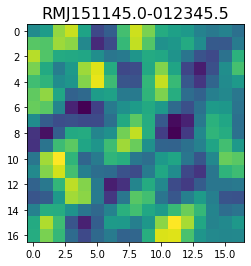

 32%|███▏      | 3251/10099 [04:39<07:33, 15.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -53.253555   -60.94519    -50.819374   -53.9496    -109.50165
 -160.75456   -120.97163    -34.37232    -23.710272   -80.292725
  -78.28533     -5.0937634   13.725707   -56.0614     -97.3995
  -50.60318      1.9448578]


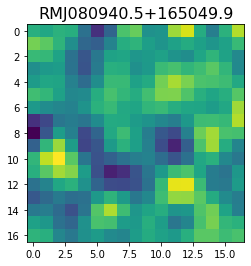

<class 'pixell.enmap.ndmap'>
[161.086    216.46904  175.62984   73.87812    2.292351  14.418181
  96.85582  186.34357  207.05206  131.60695   19.456665 -29.032877
  33.838387 161.87856  259.82513  264.0403   193.08646 ]


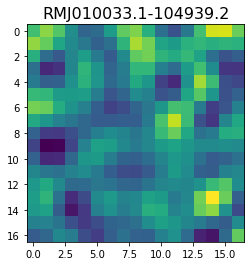

 32%|███▏      | 3254/10099 [04:39<10:24, 10.96it/s]

<class 'pixell.enmap.ndmap'>
[-68.94443  -74.903244 -63.47587  -71.13384  -94.421074 -95.269325
 -76.46202  -74.43979  -87.24634  -84.08633  -70.506424 -72.89256
 -79.833984 -65.63025  -45.655315 -48.124966 -61.90939 ]


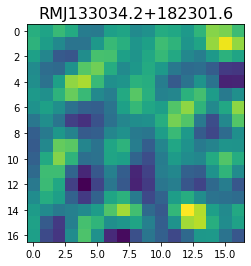

 32%|███▏      | 3256/10099 [04:40<11:22, 10.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  34.26263    106.64088    103.37591     -0.8580666  -92.7321
  -37.824024   111.70464    148.0323       4.754528  -118.71699
  -45.971928   101.34935     91.53783    -58.960594  -128.2422
  -37.36996     64.546104 ]


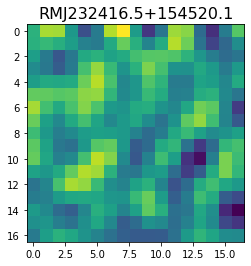

 32%|███▏      | 3263/10099 [04:40<08:10, 13.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   2.833651   -66.59268    -98.34644    -60.34828    -58.127083
 -131.33257   -171.99371   -101.2727       1.0508547   21.52567
  -21.90536    -25.479322    37.044052    77.10023     15.262581
 -109.44726   -180.08138  ]


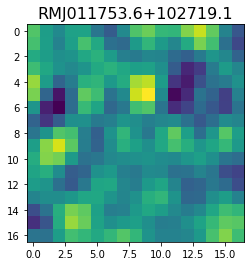

 32%|███▏      | 3266/10099 [04:40<08:32, 13.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-34.922337   27.308035   50.413437   32.573692    5.3721848  -2.651253
  16.655346   49.538048   73.252106   81.50545    88.47513    98.15851
  92.61623    68.689735   56.42019    72.13419    83.97731  ]


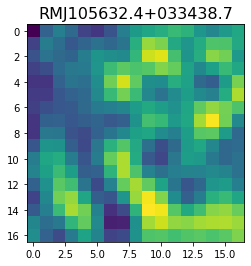

 32%|███▏      | 3270/10099 [04:41<08:19, 13.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.48276  140.3421   127.425186  96.285164  79.3143    82.35786
  87.81266   90.71296   99.00436  108.79721  110.60673  111.5963
 123.36895  135.90321  129.83511  107.15913   86.19607 ]


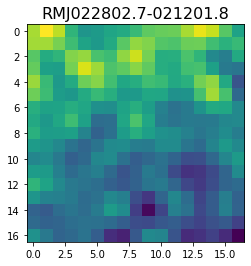

 32%|███▏      | 3272/10099 [04:41<09:17, 12.24it/s]

<class 'pixell.enmap.ndmap'>
[ -27.60024   131.46182   126.677376  -34.57918  -182.07271  -175.05399
  -65.78037   -23.031227 -101.38578  -169.31833  -106.90736    11.730976
   27.737814  -65.08287  -116.61414   -46.833824   49.019825]


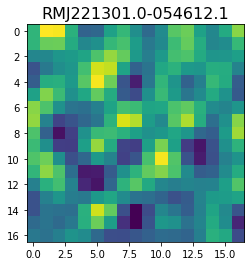

 32%|███▏      | 3274/10099 [04:41<10:57, 10.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-87.287056   -5.6747384  69.49633    30.636717  -59.515682  -58.50156
  31.358358   68.6396      1.7295399 -58.879982  -35.809517   -5.3482637
 -44.04744   -83.09624   -30.214544   56.893417   52.451027 ]


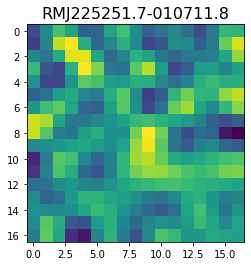

 32%|███▏      | 3276/10099 [04:41<12:01,  9.46it/s]

<class 'pixell.enmap.ndmap'>
[  10.852568    149.14836     281.55197     350.2125      173.11816
 -233.52179    -466.87622    -214.47856     256.88474     431.75476
  228.18939       0.95369273  -38.51946     -22.783213    -54.435234
  -13.778499    144.35002   ]


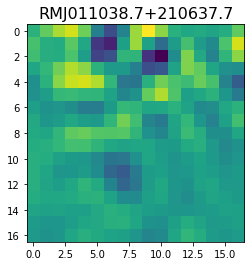

 32%|███▏      | 3277/10099 [04:42<13:57,  8.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-13.972781  -49.9524    -72.526245  -63.129498  -41.86529   -24.941816
 -10.12861    -1.4140447  -8.800144  -22.032598  -19.51723    -5.855159
  -7.711765  -28.37429   -38.77709   -22.791101   -2.9634948]


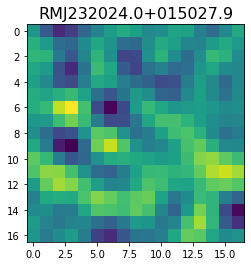

 32%|███▏      | 3280/10099 [04:42<12:27,  9.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -50.18264    -23.857224     4.5263796  -10.3790655  -24.396885
   -3.575888     6.0354176  -17.499676   -14.663279    30.310463
   25.913935   -73.9113    -162.70244   -128.449      -19.797848
   33.055847    -4.496017 ]


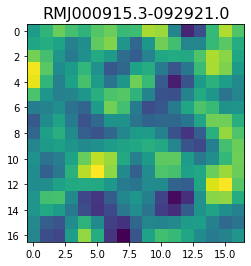

 33%|███▎      | 3290/10099 [04:42<06:08, 18.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[101.13503    89.01589    22.416782  -14.335007   33.65473    93.32968
  60.370304  -38.688587  -70.1866     21.02335   135.21722   153.13022
  78.69547     6.312176   -5.6399617  18.023968   22.850395 ]


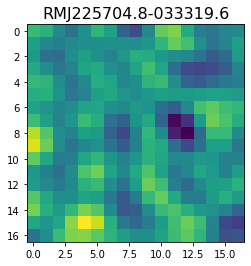

 33%|███▎      | 3295/10099 [04:42<06:11, 18.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-156.17102    -131.19489     -56.331474     -0.79143524  -16.407402
  -57.99717     -67.33769     -57.92013     -57.76599     -48.9568
  -25.009851    -30.334732    -80.94442    -117.656654    -96.77888
  -61.53316     -69.492584  ]


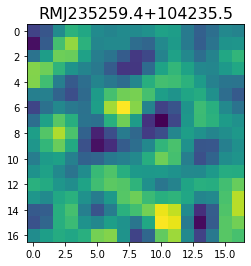

<class 'pixell.enmap.ndmap'>
[-144.55957  -146.68904   -78.191414   28.703613   43.79371   -25.094463
  -32.68926    27.525364    8.654905  -96.57072  -125.682556  -46.14092
  -10.636635  -75.1657   -120.76732   -86.60661   -44.119156]


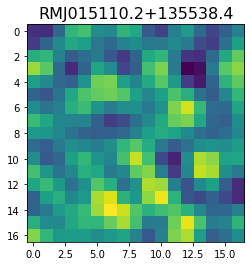

 33%|███▎      | 3298/10099 [04:43<08:44, 12.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -94.13303  -170.48647   -69.50818   102.39636   108.45054   -45.495377
 -116.55141   -20.80329    20.527561 -152.45479  -339.06866  -256.15372
   13.192058  111.415436  -74.262825 -249.02415  -147.3123  ]


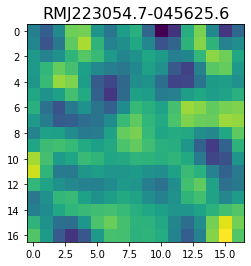

 33%|███▎      | 3300/10099 [04:43<09:33, 11.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[140.63704 160.2128  186.59384 162.13133 133.75917 144.01962 149.86058
 129.02124 133.01707 176.91072 207.01564 204.93152 199.46004 185.6314
 152.37411 145.53416 187.45146]


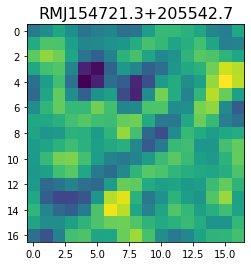

 33%|███▎      | 3303/10099 [04:43<09:28, 11.96it/s]

<class 'pixell.enmap.ndmap'>
[-21.252605 167.53372  260.0214   202.16171  108.1259    93.08507
 133.5017   144.40701  117.326866  92.92826   66.12297   24.25825
  16.4838    75.80854  134.92953  122.58879   72.645355]


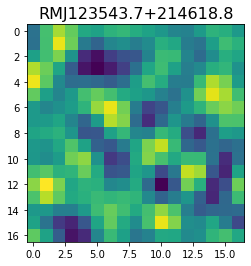

<class 'pixell.enmap.ndmap'>
[   9.5176735  160.82451    206.03625     92.56674    -74.1079
 -149.1642     -84.167145    36.17219     82.55481     22.602676
  -48.702427   -48.311623   -17.240408   -27.290138   -44.27118
    6.528187    88.03688  ]


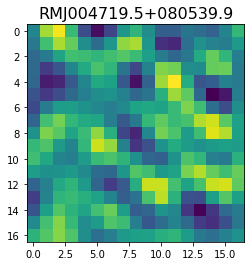

 33%|███▎      | 3305/10099 [04:44<12:59,  8.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 14.280597   11.105272   -9.115207  -24.352503  -15.435223    4.1349583
   7.8159676  -7.431481  -24.151817  -35.234825  -48.37547   -60.95641
 -54.985607  -26.693146   -2.7790184 -10.292589  -38.647373 ]


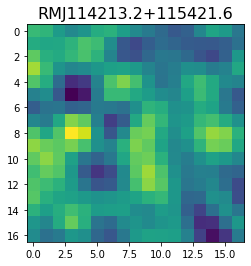

 33%|███▎      | 3307/10099 [04:44<13:15,  8.54it/s]

<class 'pixell.enmap.ndmap'>
[ -16.230003    79.86637    105.18561      4.9014153 -103.0142
 -103.96645    -44.941685   -28.365353   -43.631725   -14.400427
   49.6199      62.44396     -2.0679216  -76.9353    -100.8575
  -82.783844   -63.356537 ]


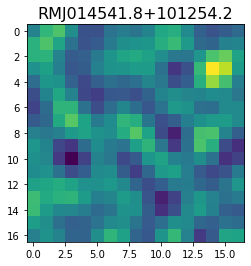

 33%|███▎      | 3309/10099 [04:44<13:35,  8.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[207.95041  222.24069  177.67445  122.50336  103.32797  115.55154
 126.79345  126.74269  129.68892  138.37688  134.57533  109.86469
  83.5354    79.533     99.51127  126.836555 144.89883 ]


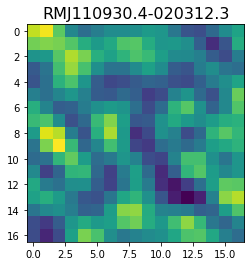

 33%|███▎      | 3310/10099 [04:45<16:27,  6.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[232.65572  250.95172  219.99065  180.86333  162.51587  147.50804
 127.05829  118.21779  117.2669   103.40265   90.06193  104.5907
 124.27535  107.71054   78.07495   91.391365 133.10852 ]


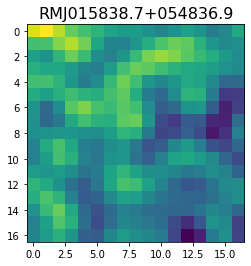

 33%|███▎      | 3312/10099 [04:45<15:38,  7.23it/s]

<class 'pixell.enmap.ndmap'>
[106.77893    62.993664   67.125595  119.73153   132.46422    65.26296
  -8.916223   -1.3758105  80.17919   148.456     142.35956    88.06448
  55.099045   69.31996    90.01011    77.484665   53.748688 ]


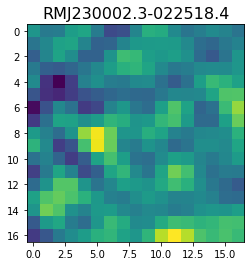

 33%|███▎      | 3313/10099 [04:45<17:25,  6.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 47.89086    47.912373   -4.2661676 -46.355507  -26.529284   18.906866
  28.882027   13.946829   16.357393   14.58411   -34.76612   -88.41421
 -63.970814   17.179482   52.264988   16.83377   -16.482637 ]


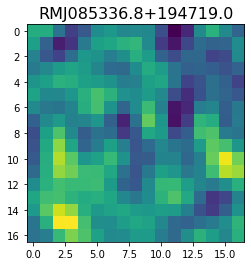

 33%|███▎      | 3319/10099 [04:45<10:26, 10.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 1.02178101e+02 -1.76434040e+01 -8.05984344e+01  9.46807489e-02
  1.12491905e+02  1.09640594e+02  1.07389593e+01 -5.60471611e+01
 -3.66858330e+01  1.63874016e+01  4.50651016e+01  4.04592361e+01
  2.66524067e+01  3.74603119e+01  7.96655045e+01  1.02911285e+02
  6.01365623e+01]


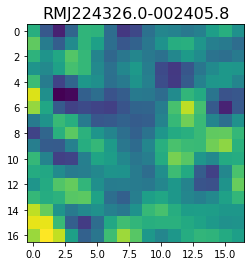

 33%|███▎      | 3322/10099 [04:46<10:13, 11.05it/s]

<class 'pixell.enmap.ndmap'>
[-4.5718547e-02  2.3276665e+01  4.3338103e+00 -4.5666111e+01
 -6.5160507e+01 -2.9686350e+01  1.1184000e+01  6.0796576e+00
 -3.0014067e+01 -5.0033211e+01 -4.3105278e+01 -3.2243137e+01
 -2.7622135e+01 -1.8893381e+01 -2.0367706e+00  1.5451448e+01
  2.9563263e+01]


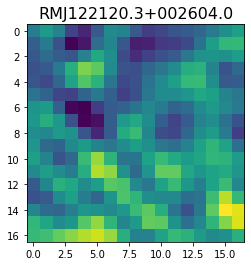

<class 'pixell.enmap.ndmap'>
[  75.6253     39.63761   116.08188   291.38147   354.07706   233.05196
  118.12092   114.944664   74.446075  -71.54016  -120.77279    52.700294
  254.59282   277.8037    200.52734   197.89482   272.50107 ]


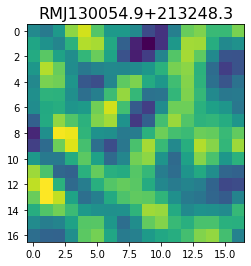

 33%|███▎      | 3324/10099 [04:46<13:43,  8.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[100.63754   36.81993    9.620532  44.84026   68.80402   48.862633
  32.757587  38.64837   33.432507  23.199389  42.792583  64.891045
  39.792847   2.264035  16.736738  51.68836   35.67289 ]


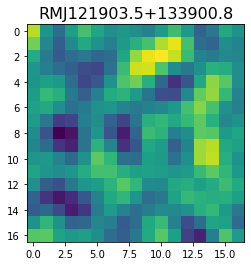

 33%|███▎      | 3326/10099 [04:46<13:32,  8.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[80.02493   88.89079   69.32098   40.171143  27.684261  33.60291
 35.80228   23.254215   9.123808   4.91326    6.4682755 12.51911
 30.406185  53.552094  60.027332  46.36988   38.095276 ]


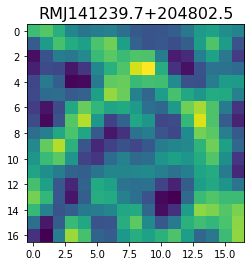

 33%|███▎      | 3328/10099 [04:47<13:54,  8.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -79.88086   -40.360752 -126.2017   -242.87148  -290.7576   -280.36917
 -272.46573  -270.6596   -228.29535  -141.79167   -83.40095  -118.78936
 -217.6396   -281.79834  -259.3938   -196.40192  -167.68727 ]


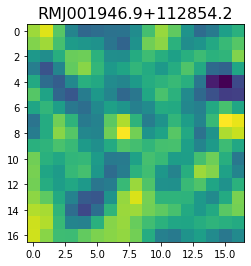

 33%|███▎      | 3337/10099 [04:47<06:57, 16.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -84.035     -131.22913   -150.6262     -87.592094    -7.1631346
   -0.3476976  -53.81593    -82.45509    -55.043983   -20.823568
  -25.49971    -57.70817    -83.09142    -91.167816   -92.03691
  -86.38599    -60.232697 ]


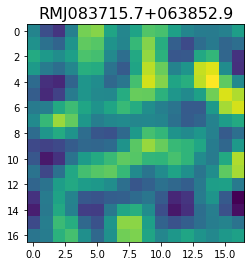

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[25.897163  5.666353 41.69982  87.199234 78.83008  42.57735  43.476902
 70.89586  69.079025 47.535095 58.49838  88.78278  79.61192  39.945297
 34.72967  66.22149  70.9049  ]


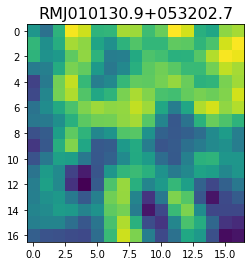

 33%|███▎      | 3340/10099 [04:48<09:52, 11.42it/s]

<class 'pixell.enmap.ndmap'>
[  47.050373    -0.7038818   18.289124    55.429245    61.42466
   20.636286   -50.819424  -101.54994    -73.19312     28.142656
  121.35663    146.49667    127.82508     99.52364     29.610203
 -106.38615   -222.55118  ]


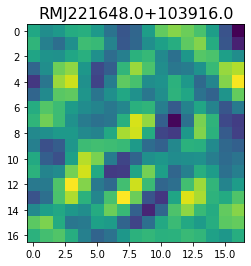

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -95.190475  -83.318634  -80.873024  -84.088036  -92.68874  -119.626305
 -155.29451  -159.28532  -123.02889   -99.63117  -127.105995 -163.57845
 -152.74477  -116.43505  -119.611206 -169.10974  -210.43501 ]


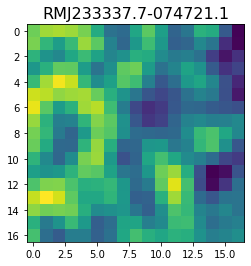

 33%|███▎      | 3350/10099 [04:48<07:20, 15.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 41.040543   31.012714  -12.6227045 -18.970327   35.42514    66.39547
  38.17503    33.960606   90.60359   117.47194    62.785618    5.7105474
   4.547456    8.9742365  -6.9662685  13.548484   68.04472  ]


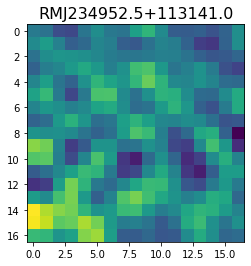

<class 'pixell.enmap.ndmap'>
[ 70.67093   70.80805   94.74835   99.88832   60.296635  17.936592
  22.747663  55.20155   61.413242  40.611183  40.058445  74.21801
 103.70294   96.31866   65.43692   41.384968  37.565037]


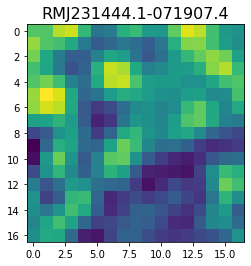

 33%|███▎      | 3360/10099 [04:49<06:38, 16.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[22.200275 28.817278 36.503254 44.10981  62.035736 72.147446 53.713753
 31.791536 42.730038 70.339775 70.72717  41.768555 18.435322 17.632082
 29.59401  44.383533 53.751328]


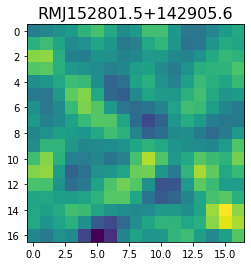

<class 'pixell.enmap.ndmap'>
[57.603733  62.893085  53.706604  56.31707   72.66537   70.44345
 37.217518  12.039106  31.66714   68.34243   64.7395    22.338037
  4.2417817 40.26231   79.751884  67.54181   25.328869 ]


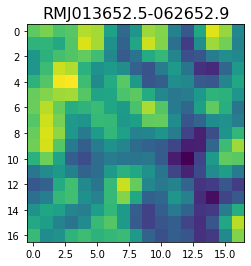

 33%|███▎      | 3364/10099 [04:49<08:35, 13.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   8.672029    73.10303     77.35076     19.634481    -1.2587551
   38.497932    40.12999    -42.81993   -102.281334   -35.122227
   93.095695   148.56845    116.12078     73.555695    42.460552
  -10.952193   -65.182076 ]


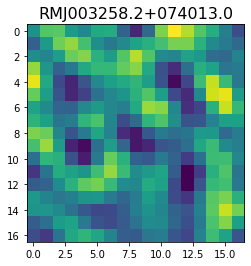

<class 'pixell.enmap.ndmap'>
[-5.1615284e+01 -3.0341316e+01 -4.5589260e+01 -8.0192947e+01
 -8.5244621e+01 -4.6695335e+01 -4.9728785e+00  8.7341830e-02
 -3.1671453e+01 -8.2129562e+01 -1.2945142e+02 -1.3687932e+02
 -8.4616661e+01 -1.9976130e+01 -1.0198110e+01 -3.8631233e+01
 -2.5607620e+01]


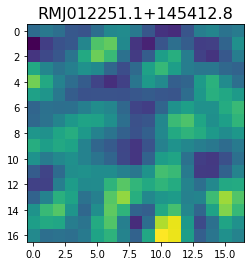

 33%|███▎      | 3367/10099 [04:50<10:47, 10.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -56.127792   -124.66696     -82.66623      16.35563      52.789185
   22.960913      0.30881932   -8.607154    -39.685158    -59.826546
  -13.53026      52.803093     45.32379     -13.942337    -13.843044
   49.71313      48.6403    ]


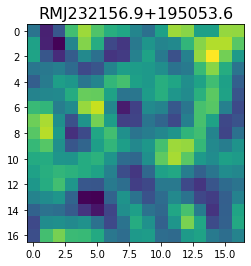

 33%|███▎      | 3377/10099 [04:50<06:43, 16.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 71.06403  101.07505   97.011314  70.67347   65.18264   82.784355
  95.081245  91.85217   79.67774   68.77806   79.73154  118.08573
 144.64822  127.50543  103.67368  120.35465  146.99098 ]


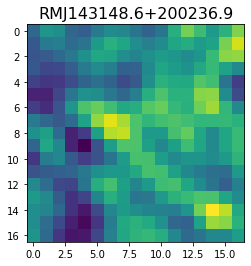

 33%|███▎      | 3381/10099 [04:50<07:05, 15.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  2.4230752  18.854206   43.456783   39.45118    14.471575   10.917388
  32.13179    39.97813    30.360926   42.904606   84.11593   108.70906
  93.5959     68.35748    56.90186    47.194595   33.84065  ]


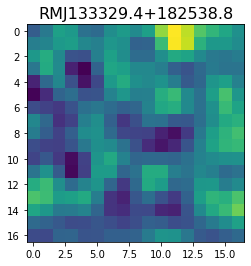

 34%|███▎      | 3386/10099 [04:51<06:59, 16.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[248.09067 215.48532 191.75629 188.07425 249.28865 346.09296 372.8882
 306.1585  249.30937 264.97873 282.87784 239.48428 191.29454 208.6764
 255.73196 258.1276  213.2947 ]


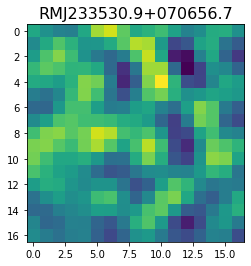

 34%|███▎      | 3389/10099 [04:51<07:54, 14.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  28.520025     8.022721    78.40759     62.2922      -4.5465555
  -25.71297    -61.09915   -113.62865    -83.80032    -66.31036
 -205.18811   -285.46497    -63.44775    170.38156     37.022667
 -213.71301   -154.25266  ]


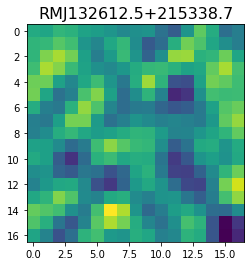

 34%|███▎      | 3393/10099 [04:51<08:05, 13.81it/s]

<class 'pixell.enmap.ndmap'>
[60.283237 55.832134 63.516125 69.66963  68.64619  66.094124 65.540924
 65.04892  66.04273  72.64084  80.8481   80.39     70.56284  63.45255
 66.454735 71.612404 69.019585]


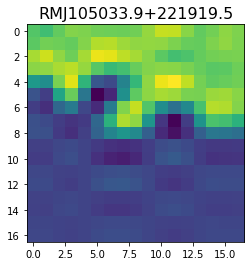

<class 'pixell.enmap.ndmap'>
[ -77.90523     20.306433   -28.73485   -214.75885   -250.59464
  -40.660282   153.14508    122.560356    -3.4496796  -24.51864
   29.307285    25.717453   -26.096941   -29.59699     17.241034
   36.36703      4.2059917]


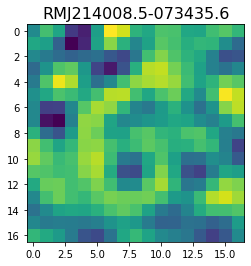

 34%|███▎      | 3395/10099 [04:52<11:43,  9.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.036709  -4.530528  -2.506787  -4.818484 -33.349117 -65.16497
 -61.58158  -28.61341   -9.602828 -21.826786 -38.634968 -36.5426
 -24.493927 -19.27543  -20.891266 -20.25729  -10.256501]


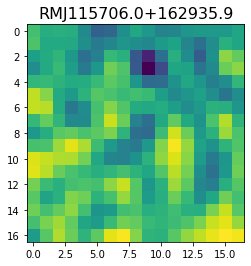

 34%|███▎      | 3400/10099 [04:52<09:47, 11.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 54.685688  45.110653 111.881294 156.12451   75.003426 -59.273384
 -77.27477   51.745827 177.62431  175.53912   90.262665  35.792538
  40.684704  59.00782   73.21934  103.23415  137.19705 ]


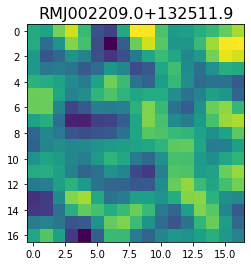

 34%|███▎      | 3402/10099 [04:53<11:06, 10.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 76.73533   92.62598  116.33854   69.80281   49.027817 124.124916
 190.52686  158.33423  107.527626 133.37689  189.92319  187.14522
 131.67628   99.467735 130.87564  182.73183  169.00026 ]


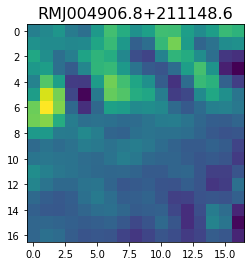

 34%|███▎      | 3406/10099 [04:53<10:07, 11.02it/s]

<class 'pixell.enmap.ndmap'>
[-126.500916 -148.09558  -136.20056   -90.05331   -97.20379  -166.17877
 -168.61678   -81.60244   -71.462265 -191.95688  -252.87074  -150.7421
  -52.51766   -89.948975 -151.65506  -128.41302   -97.827736]


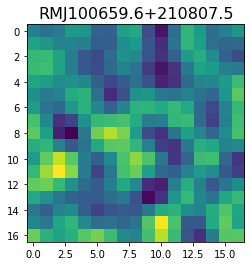

 34%|███▍      | 3413/10099 [04:53<07:29, 14.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-148.65393   -107.99244    -82.27136   -111.652756  -154.18828
 -150.96767   -113.16932    -93.02386   -107.80634   -134.83371
 -144.67818   -111.341866   -35.545193    23.051298    -1.9025722
  -79.76183   -106.20436  ]


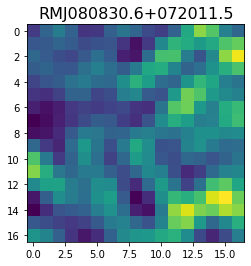

 34%|███▍      | 3416/10099 [04:53<08:14, 13.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-69.279495  -52.53749   -28.28497   -25.846163  -45.54348   -56.296963
 -34.921165    1.2585776  10.906093  -19.448526  -55.659424  -61.900276
 -47.11737   -41.292633  -46.192295  -44.50923   -39.748966 ]


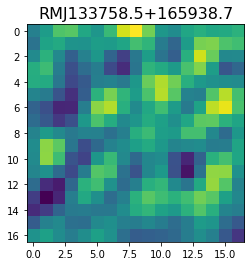

 34%|███▍      | 3420/10099 [04:54<08:29, 13.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  4.6187234   1.6820982  10.33493    24.13357     8.38957   -26.670177
 -24.55748    13.89259    15.836134  -38.168964  -70.93319   -35.49798
   9.944529    4.1395154 -28.569849  -42.626785  -44.11267  ]


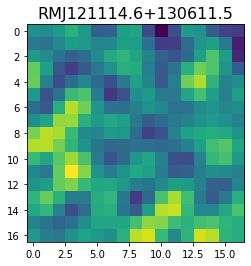

 34%|███▍      | 3423/10099 [04:54<08:50, 12.58it/s]

<class 'pixell.enmap.ndmap'>
[ 20.18972    34.337646   42.33861    30.3636     15.959478    5.7065973
  -8.90327   -14.830979   10.859035   49.363632   52.236275   14.080776
 -16.051617   -9.061899    5.604959   -4.57964   -24.588913 ]


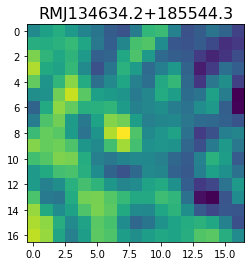

 34%|███▍      | 3425/10099 [04:54<10:05, 11.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  4.8480177 -34.237514  -40.702694  -20.317741   -1.9366684   3.0846262
   6.246358   13.353714   16.358892   16.907383   28.674614   44.550312
  33.34799    -9.829758  -41.624607  -29.24615    -2.4586306]


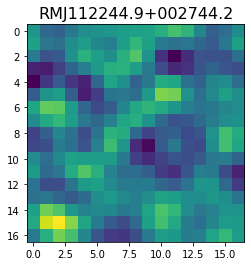

 34%|███▍      | 3427/10099 [04:55<10:36, 10.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-48.140488  -45.593224  -49.133556  -42.62971   -34.614567  -45.12651
 -61.564095  -42.756523   18.853329   68.08381    47.88281   -24.661764
 -74.70368   -61.122528  -19.896807   -4.7863083 -15.078113 ]


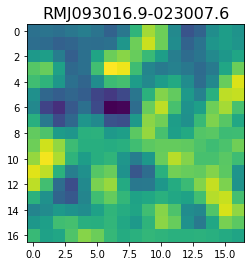

 34%|███▍      | 3430/10099 [04:55<10:18, 10.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 39.715477  15.146743  20.711275  40.477695  83.381775 144.87263
 185.11418  177.06982  144.87172  120.6429    97.02643   65.21453
  64.12997  130.82657  222.57411  254.94402  214.33228 ]


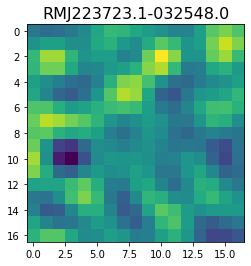

 34%|███▍      | 3432/10099 [04:55<11:21,  9.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-41.15479  -62.573524 -75.63713  -62.04733  -40.249226 -31.588057
 -29.563875 -26.847582 -38.284397 -66.426025 -77.27991  -48.05078
 -12.119609 -15.810038 -50.483982 -68.110176 -50.695034]


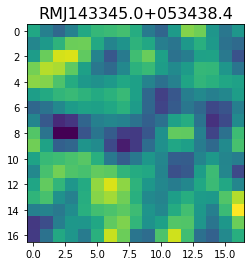

 34%|███▍      | 3434/10099 [04:55<12:05,  9.18it/s]

<class 'pixell.enmap.ndmap'>
[ -82.49762   -82.07438  -119.6415   -168.34868  -171.58934  -122.89387
  -79.215744  -82.85263  -111.06436  -120.70841  -104.15985   -77.147255
  -46.33198   -19.94947   -22.516912  -62.673126 -103.60702 ]


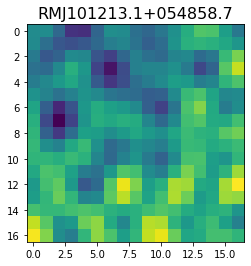

 34%|███▍      | 3442/10099 [04:56<06:50, 16.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -1.5898095   2.139109    5.588246   -0.6964186  -9.879345  -15.664946
 -18.768406  -13.954222    2.4039795  10.893535  -11.784802  -48.769386
 -55.361076  -24.042984    1.1260524 -10.8454075 -36.710526 ]


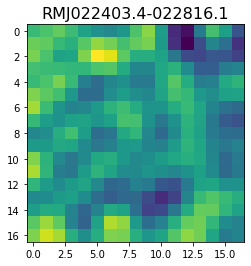

 34%|███▍      | 3445/10099 [04:56<07:58, 13.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 53.30898  -52.280758 -21.315165  99.63562  162.704    122.12722
  56.847103  27.45657   15.596341  10.072287  48.17881  125.60083
 152.98756   77.25356  -16.535826 -13.245587  64.43177 ]


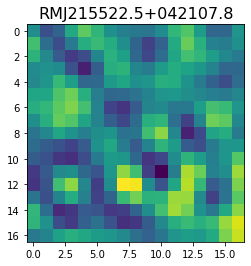

 34%|███▍      | 3447/10099 [04:56<09:29, 11.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  26.345915  -45.803635    9.457146  157.57993   189.95778    40.60613
 -104.405106  -91.1205     -8.709627   -8.354548  -71.09453   -89.86595
  -60.385956  -49.319492  -57.658054  -45.42658   -30.230703]


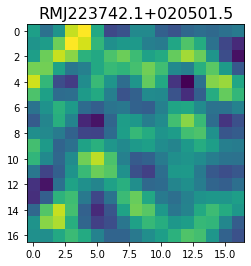

 34%|███▍      | 3449/10099 [04:57<11:00, 10.06it/s]

<class 'pixell.enmap.ndmap'>
[-152.69281  -150.0999    -39.38487    50.472855   56.087986    9.626228
  -40.44789   -89.518265 -162.45006  -246.11697  -259.1318   -143.36201
   20.694532   79.80611     7.081515  -68.3373    -60.073353]


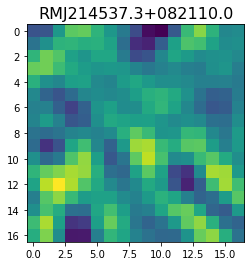

 34%|███▍      | 3451/10099 [04:57<11:31,  9.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  2.560803    19.253017    22.621185    11.0540695   -2.7346199
  -6.0161757   -0.24678642   3.4221008    0.2067026   -4.956608
  -9.710114   -17.983503   -26.486233   -19.97092      8.660138
  41.63957     53.627224  ]


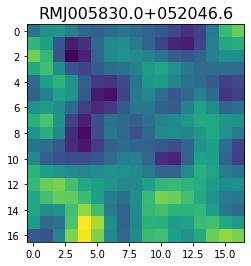

 34%|███▍      | 3457/10099 [04:57<08:31, 12.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[203.74625 209.6335  242.19066 255.8557  200.06818 119.03991 106.92988
 174.64255 234.76187 223.50587 172.09859 141.19124 141.56726 147.8385
 149.55621 154.16684 159.86191]


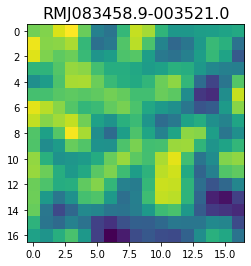

 34%|███▍      | 3460/10099 [04:57<08:49, 12.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-112.55082   -72.07654   -31.995926  -39.026382  -63.99426   -54.55928
  -29.580532  -43.044006  -81.99092   -88.078636  -61.523174  -50.151417
  -48.57736   -11.605653   34.89285     8.479247  -87.92638 ]


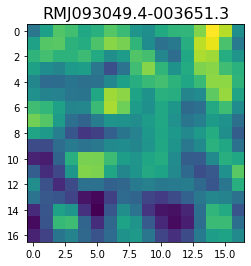

 34%|███▍      | 3462/10099 [04:58<09:37, 11.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-119.801636    72.85274    186.83812    144.62366     91.19214
   38.47004    -94.987625  -218.49242   -196.68588   -113.247986
 -121.05259   -171.39069   -130.44688    -29.002111     0.3801685
  -66.43205   -137.34517  ]


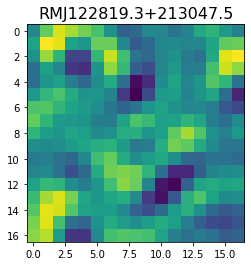

 34%|███▍      | 3466/10099 [04:58<08:47, 12.58it/s]

<class 'pixell.enmap.ndmap'>
[  57.523693    22.517378   -76.2623    -105.324196   -10.4913025
   54.026527   -35.352673  -147.91597   -108.19658     15.449488
   45.630726   -13.822566   -38.47493    -15.682843   -12.619832
  -16.297247    15.351124 ]


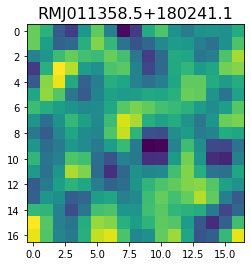

 34%|███▍      | 3468/10099 [04:58<09:50, 11.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[187.82748  171.61914  162.82643  180.75217  193.44806  162.59546
 109.669266  91.1333   120.07498  157.9986   175.89944  178.74199
 174.54883  162.70108  152.70842  157.1643   166.02675 ]


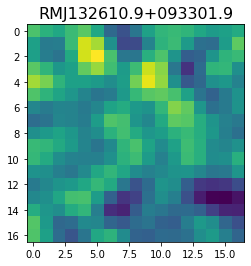

 34%|███▍      | 3470/10099 [04:58<10:32, 10.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  8.845292  14.855431 110.91138  173.23787  126.21021   84.2194
 168.99986  273.5429   200.21524    5.113575 -29.54514  181.45813
 371.11465  311.65448  136.13179   87.88412  148.11525 ]


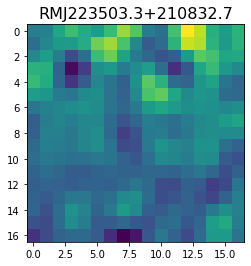

 34%|███▍      | 3475/10099 [04:59<08:56, 12.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[46.126152 47.020424 56.319187 47.39432  21.176846 11.618093 32.084347
 53.7796   53.64208  45.340675 43.451748 37.93033  28.545006 41.31568
 78.47439  93.660065 56.146152]


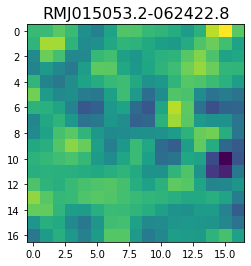

 34%|███▍      | 3479/10099 [04:59<08:46, 12.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-112.4874   -107.69981   -85.86967   -82.7024   -107.570015 -124.456085
 -106.88205   -80.817375  -85.66066  -114.5708   -127.240036 -110.22029
  -88.94507   -81.65925   -76.326706  -62.2211    -54.56627 ]


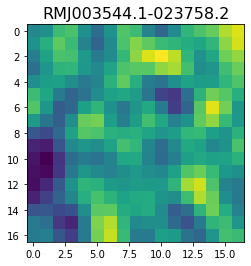

 35%|███▍      | 3486/10099 [04:59<07:05, 15.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.221075   49.676548   58.066566   25.013264   -2.7579865  23.621136
  72.92905    84.56351    60.483284   42.365982   31.948452    1.4159058
 -39.581345  -50.533527  -23.052439   11.715626   29.552208 ]


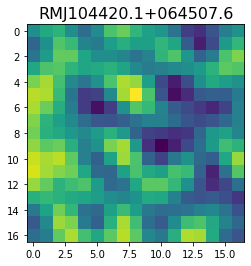

 35%|███▍      | 3488/10099 [05:00<08:13, 13.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-215.94423  -192.04909  -167.24066  -150.30164  -144.44919  -162.0645
 -203.46571  -237.07365  -232.18642  -201.45403  -178.41255  -162.2801
 -126.30815   -80.306564  -74.77281  -122.86144  -162.46004 ]


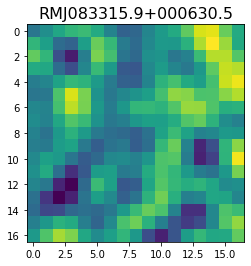

 35%|███▍      | 3490/10099 [05:00<09:23, 11.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  5.898219    3.8835099 -15.636133  -38.6139    -54.028763  -54.33294
 -34.68525    -5.0210576   9.204096   -3.5440154 -21.14331   -17.19774
   1.430713    9.744094    4.7165895   1.2256864  -1.5579442]


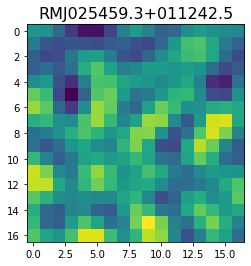

 35%|███▍      | 3495/10099 [05:00<08:39, 12.72it/s]

<class 'pixell.enmap.ndmap'>
[-12.526698 -26.886364 -63.653828 -56.227192 -26.535685 -26.211407
 -35.104656 -22.550714 -13.959899 -19.82677   -8.776132   4.546227
 -27.881073 -71.78089  -47.591835  24.509773  57.963795]


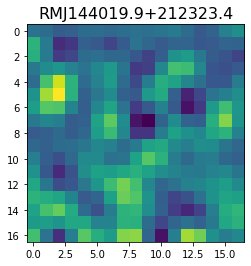

 35%|███▍      | 3497/10099 [05:01<10:16, 10.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 96.225975  90.88522  103.3334   106.6137    70.77287   32.453484
  49.51641  102.02477  125.14458  121.359406 138.15076  153.79904
 107.87361   38.00582   50.75859  142.82637  187.23015 ]


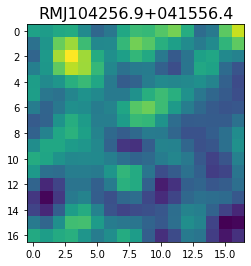

 35%|███▍      | 3500/10099 [05:01<10:47, 10.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -76.7004    -62.123604  -69.87887   -89.6447    -98.86235  -100.21247
 -108.0311   -114.11004  -106.03342  -101.530846 -120.71031  -141.23647
 -128.75327   -96.5617    -85.08187   -96.560684 -103.147484]


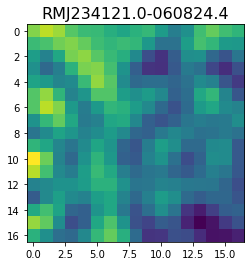

 35%|███▍      | 3502/10099 [05:01<11:48,  9.31it/s]

<class 'pixell.enmap.ndmap'>
[-171.41083  -214.08015  -248.93207  -229.46739  -226.70526  -272.95792
 -289.8304   -233.16483  -175.7638   -183.3325   -214.53523  -199.88309
 -146.03668  -123.987755 -191.06796  -323.38522  -408.06415 ]


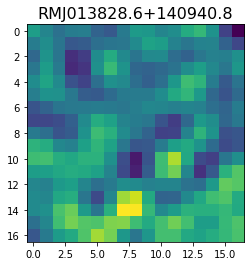

 35%|███▍      | 3503/10099 [05:01<14:01,  7.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[26.334478 31.644474 42.884254 36.56966  27.58543  42.86425  71.6788
 77.55241  52.214195 27.31958  29.575668 47.167313 51.41957  38.052765
 30.26562  41.558002 52.465427]


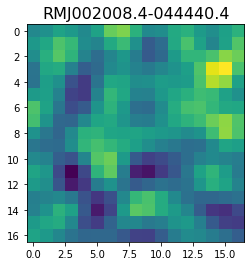

 35%|███▍      | 3506/10099 [05:02<12:38,  8.69it/s]

<class 'pixell.enmap.ndmap'>
[111.17412   96.68762   62.236397  37.21184   52.944004  94.6781
 119.75761  116.97277  111.90947  118.441635 123.646645 121.32386
 122.66036  127.86911  120.662926  98.41008   78.98463 ]


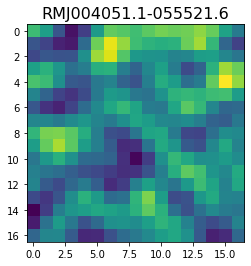

 35%|███▍      | 3507/10099 [05:02<14:57,  7.34it/s]

<class 'pixell.enmap.ndmap'>
[ 169.67944   159.89392   165.24338   128.33272    45.271378   -5.999033
   15.844641   35.760185  -23.94922  -105.127754  -88.81687    21.722452
  104.35347   100.20506    80.04771   108.39551   147.43687 ]


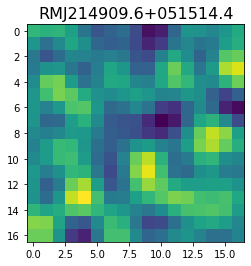

 35%|███▍      | 3508/10099 [05:02<17:53,  6.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -41.110638    -31.028563     11.217994     36.55299     -20.519598
 -110.3798     -126.19718     -69.72781     -22.046246      2.7752125
   32.0092       32.214725    -20.366543    -52.39314     -17.148766
    0.76135266  -60.530388  ]


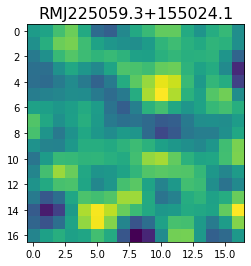

 35%|███▍      | 3511/10099 [05:02<14:44,  7.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-3.49248910e+00 -1.96109581e+01  3.26889572e+01  3.84081001e+01
 -9.50216055e-01  1.90031242e+01  1.10345764e+02  1.37126556e+02
 -1.84752882e-01 -2.04596100e+02 -2.77897888e+02 -1.47565765e+02
  6.19206009e+01  1.79280884e+02  1.53994553e+02  6.14396591e+01
 -7.78327274e+00]


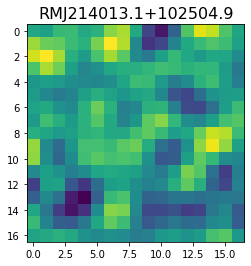

 35%|███▍      | 3516/10099 [05:03<10:49, 10.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-131.39009    -48.020313    -2.2154326  -62.628654  -137.77745
 -116.101845   -31.416647    15.123527    16.118973    19.91513
    4.367067   -74.68906   -160.94545   -161.65509    -99.71486
  -71.23895    -81.97514  ]


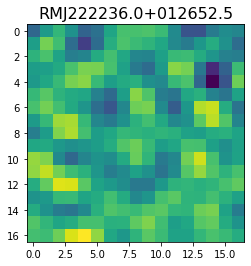

 35%|███▍      | 3518/10099 [05:03<11:31,  9.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -65.372086  117.23853    81.652985 -173.59863  -270.3958    -77.902
   30.088764 -161.57724  -316.49863  -172.70363   -10.27708   -84.708244
 -147.2839     23.843447  153.3742    -26.27628  -271.31628 ]


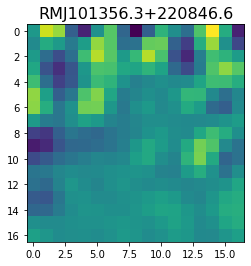

 35%|███▍      | 3521/10099 [05:03<10:51, 10.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 133.03568   144.76471   120.0524     90.15909    74.55793    88.33301
  117.968956  106.65264    43.740902   16.243393   64.76202    75.45374
  -31.428818 -109.70086     4.738174  183.61531   163.56471 ]


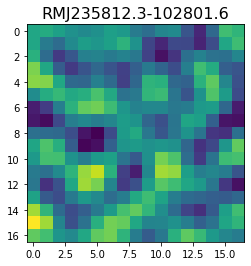

 35%|███▍      | 3527/10099 [05:04<08:19, 13.16it/s]

<class 'pixell.enmap.ndmap'>
[118.36572  104.532394  62.82661   44.058712  57.898205  57.407913
  36.719234  49.827003 104.38924  137.13507  125.17339  118.664665
 133.57767  118.35092   58.84391   14.695922  20.84641 ]


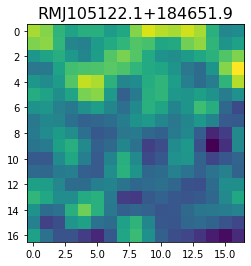

<class 'pixell.enmap.ndmap'>
[ -33.518593 -126.542435 -195.85297  -125.7828    -34.038013  -59.380592
 -131.69302  -137.50449  -115.859856 -125.55245  -116.141335  -64.404305
  -47.421112  -88.57852  -113.6103   -101.97359  -104.93401 ]


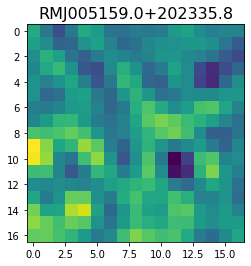

 35%|███▍      | 3529/10099 [05:04<11:19,  9.66it/s]

<class 'pixell.enmap.ndmap'>
[  49.39244    31.569508  -56.988586  -48.504112   62.77319   122.740776
   61.587887  -10.641839   12.751554   69.59363    31.159813  -90.1715
 -147.1095    -72.62303    20.858217    9.75998   -65.50075 ]


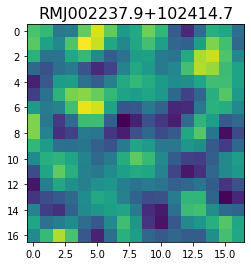

<class 'pixell.enmap.ndmap'>
[246.98108 217.66255 194.81468 194.91563 197.98029 196.12988 195.00778
 190.392   178.08676 169.7812  174.41534 179.44357 168.19409 142.71364
 119.71244 115.09877 133.19957]


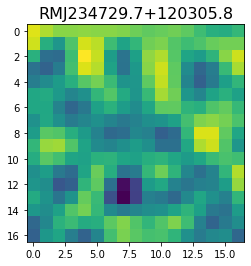

 35%|███▍      | 3531/10099 [05:05<15:26,  7.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 27.761847   -17.872192   -74.853645   -88.9435     -60.72643
 -31.149714   -23.644884   -33.39495    -51.627094   -67.888824
 -65.43687    -43.279774   -27.866024   -37.478996   -50.49842
 -35.293636     0.96209186]


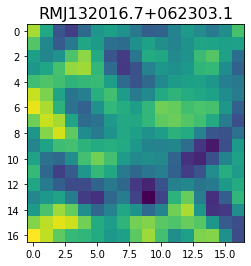

 35%|███▌      | 3536/10099 [05:05<11:29,  9.52it/s]

<class 'pixell.enmap.ndmap'>
[-133.73238   -116.67551    -91.26633    -61.172054   -48.81543
 -105.25765   -195.64203   -204.23007   -110.45694    -26.94539
  -16.650675   -19.792841    -6.1432176  -35.720833  -109.57109
 -124.06267    -46.39026  ]


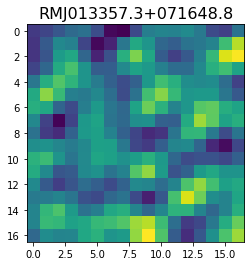

 35%|███▌      | 3538/10099 [05:05<11:51,  9.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-169.79706 -191.81013 -201.11978 -171.5042  -123.15005 -126.0557
 -203.08563 -272.45578 -250.36705 -178.22362 -164.50185 -217.32253
 -236.80978 -182.43642 -137.46867 -167.32687 -216.50531]


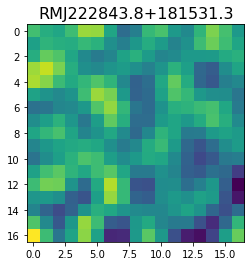

 35%|███▌      | 3542/10099 [05:05<10:17, 10.63it/s]

<class 'pixell.enmap.ndmap'>
[ 29.9112     37.381763   50.706585   61.90296    56.45712    27.360624
 -12.128591  -35.74539   -30.321003  -11.480068   -3.69147    -6.307978
   4.5739098  36.229565   62.039978   58.516956   40.547657 ]


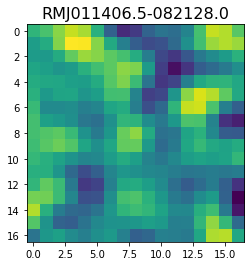

 35%|███▌      | 3544/10099 [05:06<10:48, 10.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -8.693779   -9.972455  -50.84071  -108.095184 -137.19072  -124.6489
 -108.335266 -114.78415  -113.425156  -80.63798   -63.451893 -106.77143
 -156.28267  -127.46695   -48.537075  -28.817999  -89.241745]


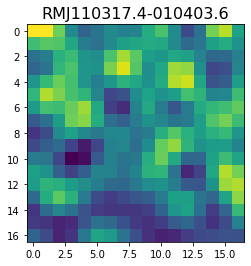

 35%|███▌      | 3546/10099 [05:06<11:35,  9.42it/s]

<class 'pixell.enmap.ndmap'>
[ 24.266182   43.76382    42.627544   36.50507    61.2931     94.504074
  81.25196    23.421432  -16.187855   -3.263834   21.73163     7.2215066
 -30.138062  -24.471226   44.07048   107.53285    87.76152  ]


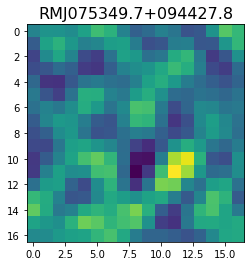

 35%|███▌      | 3547/10099 [05:06<13:40,  7.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -31.257532  -85.73587  -193.94804  -228.65851   -88.674545   90.38061
   75.79927  -115.47409  -232.80852  -172.1448    -98.06902  -134.01501
 -180.7524   -145.74365  -122.53721  -196.77281  -262.32123 ]


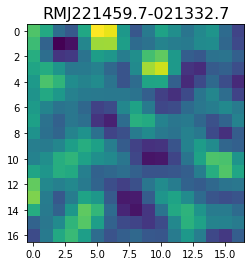

 35%|███▌      | 3549/10099 [05:06<13:31,  8.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  83.00122     42.12276    -43.295456  -116.49655   -105.50285
   -3.815516    89.03789     76.44515      2.8526962   -7.586398
   55.871574    76.53277      5.797553   -58.760715   -38.968227
    6.539298     4.5104356]


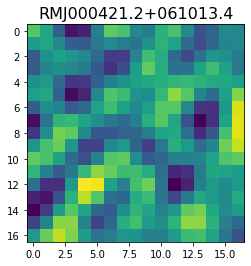

 35%|███▌      | 3556/10099 [05:07<08:33, 12.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-23.466     -12.946429   -1.4304197 -11.459609  -30.043356  -30.175491
 -18.40944   -19.077961  -28.519428  -26.962223  -18.683767  -19.803669
 -24.270805  -18.733103  -12.001679  -18.126997  -29.13581  ]


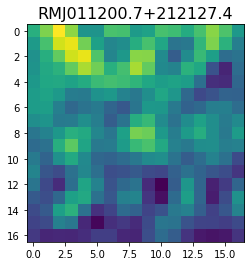

 35%|███▌      | 3574/10099 [05:07<03:59, 27.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 30.732616   16.441603    2.5093498 -15.249074  -24.933569  -19.929728
 -18.71944   -27.622581  -20.065815   14.150068   41.799343   41.42361
  38.259197   49.792107   47.517765   11.696864  -25.434404 ]


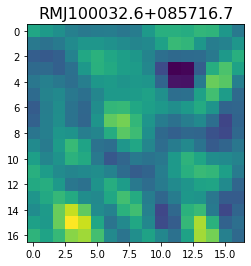

 35%|███▌      | 3579/10099 [05:08<04:52, 22.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  20.021872   39.8223     46.18856   -30.054392 -141.37178  -160.21394
  -83.61463   -35.261383  -58.963097  -75.38162   -54.245792  -64.130325
 -123.706726 -150.98177   -98.36185   -21.971449   11.529166]


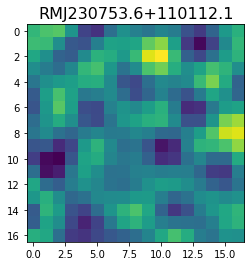

 35%|███▌      | 3583/10099 [05:08<05:42, 19.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  35.842064  -138.7107    -250.7025    -176.20258      3.2750816
  111.53413    112.05539    114.745346   165.28267    172.06787
   82.598976    -4.646946     7.888833    59.577957    38.22679
  -29.787132   -23.300282 ]


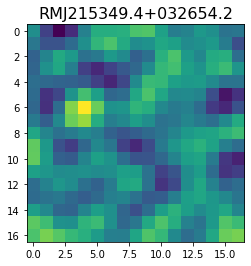

 36%|███▌      | 3586/10099 [05:08<06:34, 16.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-111.573586   -72.00635    -71.70268    -67.59705    -50.97059
  -40.359833   -30.923145   -18.981033   -43.998333  -129.874
 -208.4127    -185.49011    -76.50716      4.111195    -7.7756114
  -62.021862   -91.62146  ]


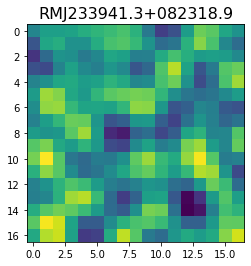

 36%|███▌      | 3589/10099 [05:09<08:00, 13.55it/s]

<class 'pixell.enmap.ndmap'>
[-104.53529  -113.7869   -109.73594   -97.44738   -95.00597  -103.92472
 -109.510124 -108.10701  -110.922005 -119.08603  -117.974266 -103.90652
  -96.08612  -109.52313  -132.31764  -144.55098  -145.73872 ]


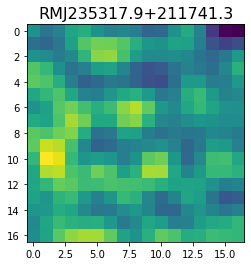

 36%|███▌      | 3591/10099 [05:09<09:15, 11.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 77.97106   25.231537  14.219732  79.6314   177.59454  215.51898
 151.40619   54.663776  42.664936 144.95328  255.51578  248.73837
 126.7432    13.311049   6.330128  79.373764 138.79907 ]


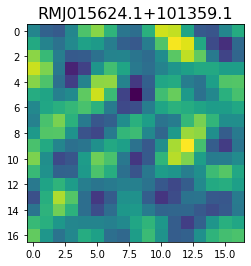

 36%|███▌      | 3593/10099 [05:09<10:41, 10.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-33.785694  -17.323532    8.441108    4.4738436 -21.046253  -26.808308
  -6.842326    3.044576   -9.023405  -12.750341    2.350332    2.015319
 -30.361158  -58.355293  -52.61854   -38.985165  -48.019016 ]


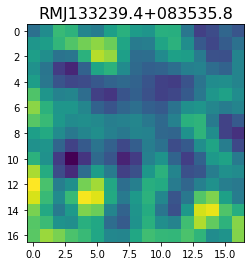

<class 'pixell.enmap.ndmap'>
[ -36.56955   -12.447641   30.83612    32.838593  -14.993665  -44.731243
  -18.078331   11.302473  -18.04794   -83.70985  -118.36817  -100.905594
  -61.44169   -22.294096   16.836958   42.836777   23.066618]


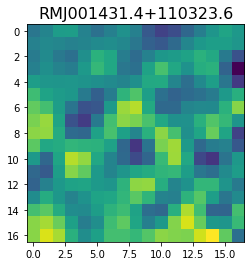

 36%|███▌      | 3595/10099 [05:10<13:44,  7.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 153.16948    162.95634    114.726166    99.68015    162.86069
  189.7265      98.71397      6.184072    39.02485    103.14255
   25.360542  -150.97813   -206.52383    -63.017628   107.520355
  118.249245    -7.6351385]


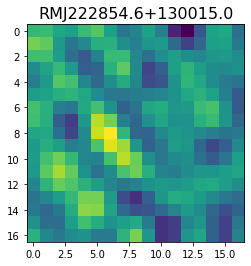

 36%|███▌      | 3600/10099 [05:10<10:22, 10.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -0.33280376 -24.712696   -41.79972    -31.657848   -23.14439
 -37.753983   -50.24941    -41.712906   -36.875153   -49.16644
 -47.47508    -19.46012     -7.8614244  -40.631943   -81.73037
 -90.63182    -76.75369   ]


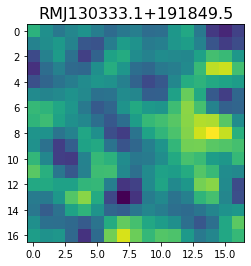

 36%|███▌      | 3605/10099 [05:10<08:47, 12.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-98.223274  -76.58376    -1.422471   -5.6784916 -60.27673   -35.454792
  53.029278   71.01965    11.501675    0.657799   62.236164   81.57406
  24.48401    -0.6489828  59.54683   114.03868    88.778885 ]


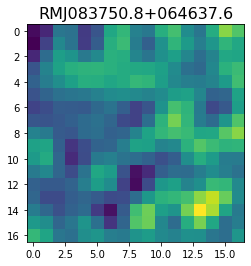

 36%|███▌      | 3608/10099 [05:10<08:59, 12.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-55.83347   -48.44668    30.692665   67.98219    36.33739    10.255228
  17.06625     6.1080484 -34.17634   -46.022297   -6.044108   32.651085
  24.45777    -8.938048  -23.188648  -10.11263     6.417556 ]


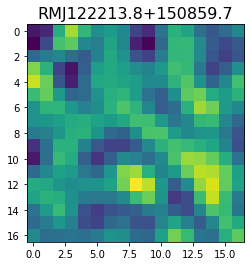

 36%|███▌      | 3618/10099 [05:11<05:35, 19.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-16.683805 -15.953645 -11.158512 -12.877374 -20.103834 -34.768036
 -52.584816 -57.022274 -46.055134 -39.493618 -43.72909  -43.560062
 -38.98418  -46.953926 -60.34206  -54.634754 -38.36053 ]


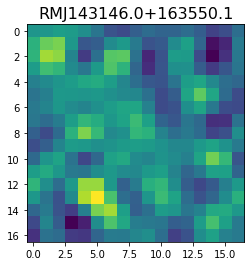

<class 'pixell.enmap.ndmap'>
[ 70.179924  45.6305    52.44113   70.84298   76.18601   63.919262
  51.556587  56.491844  72.09057   74.222046  56.09291   42.101303
  54.175854  79.58779   92.66116   95.72148  111.40501 ]


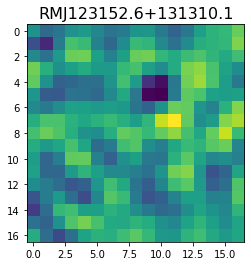

 36%|███▌      | 3621/10099 [05:11<08:08, 13.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 103.20243    47.06245    25.455675   68.46003    62.553528  -40.01142
 -114.74115   -49.692852   84.10917   142.15936   101.3305     51.910545
   49.808025   64.71637    55.48271    29.07582    16.912893]


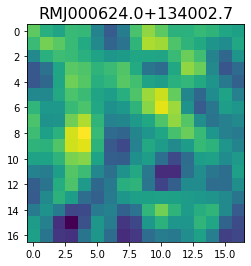

 36%|███▌      | 3624/10099 [05:11<08:25, 12.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-147.82253   -85.71589   -59.457817  -82.35859   -73.53549   -22.067797
   -2.012338  -37.818752  -72.74363   -67.25457   -42.792046  -30.135359
  -31.799807  -34.58205   -32.142426  -36.950943  -63.789238]


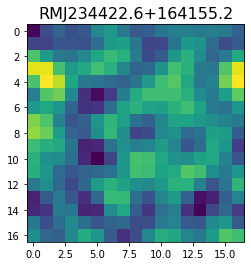

 36%|███▌      | 3626/10099 [05:12<09:16, 11.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-23.766148   33.226105   55.233425    6.08959   -43.391224  -22.89313
  20.944592    4.7524347 -48.78461   -51.910892    0.6518378  32.199436
  14.049382   -5.4291844   2.2993188   8.946205   -4.247022 ]


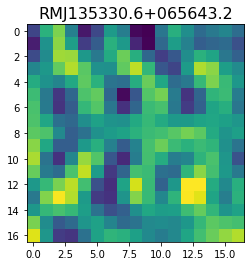

 36%|███▌      | 3628/10099 [05:12<10:23, 10.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-36.835255  -52.50496   -29.112202   17.366997   36.828293   14.777558
 -16.812073  -21.286459    8.0323305  44.231678   52.644623   29.720308
   8.82288    14.452338   28.866055   25.647184   13.614283 ]


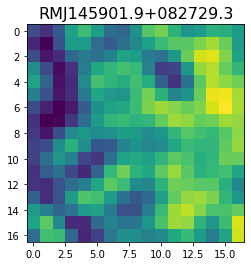

 36%|███▌      | 3641/10099 [05:13<05:42, 18.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.3158045 -20.997124  -14.828648   -1.2185696   4.007673    4.1354747
   4.791546   -2.1422923 -16.317783  -18.88538    -4.503069    6.2676435
   2.2269702  -2.3491313   1.4449953   2.8741312  -2.8035734]


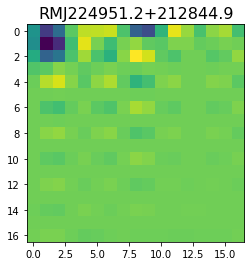

<class 'pixell.enmap.ndmap'>
[ -85.79512      0.5846793  -13.947254   -69.465485   -43.922115
   25.201353    31.262669   -16.411087   -47.538033   -66.13894
 -109.36347   -153.93732   -152.70387   -107.469246   -60.524178
  -54.11721    -98.57939  ]


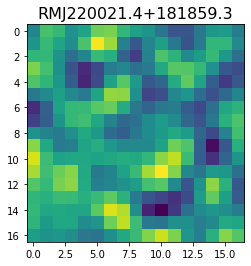

<class 'pixell.enmap.ndmap'>
[-54.557438 -39.037727 -24.90216  -12.624827 -13.723988 -36.002026
 -62.70559  -70.78427  -65.198715 -68.42004  -77.43706  -61.477943
 -10.522109  39.0285    41.738167  -7.154187 -69.97241 ]


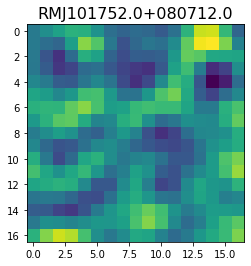

 36%|███▌      | 3644/10099 [05:13<09:52, 10.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.468412  -42.024963  -89.63444   -45.826477   43.248207   73.43066
  38.377483   19.088968   42.617485   45.443817  -13.615496  -80.85975
 -79.50107    -6.0232296  78.83452   125.52734   128.27136  ]


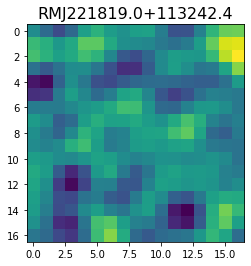

 36%|███▌      | 3650/10099 [05:13<08:07, 13.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -50.765778 -102.05745  -166.18782  -136.63492   -50.717533  -37.196156
 -108.87318  -151.09789  -116.417114  -86.49813  -123.08344  -184.80164
 -212.99103  -195.30911  -137.27956   -64.28967   -43.349686]


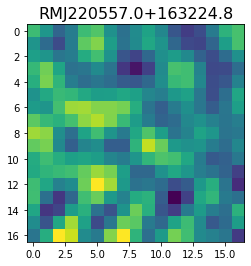

<class 'pixell.enmap.ndmap'>
[-120.18105  -171.344    -174.49252   -90.364456  -36.629078 -112.62664
 -215.61028  -188.42769   -83.38207   -92.567696 -238.01355  -329.01874
 -255.98187  -144.0505   -144.89333  -224.46088  -253.78067 ]


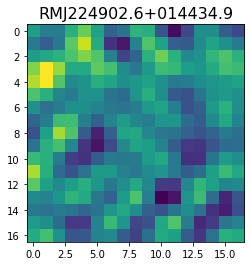

 36%|███▌      | 3653/10099 [05:14<10:02, 10.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  5.3918333 -11.1112385 -13.389414   -5.0379815  -7.7597947 -18.752504
 -11.773668   11.382611   11.866776  -22.727192  -47.704838  -26.250362
  12.927121   22.081194    5.2990847  -1.2466967   7.9777436]


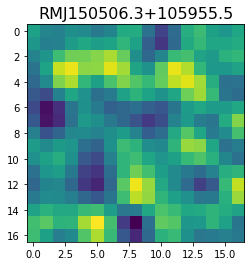

 36%|███▌      | 3657/10099 [05:14<09:10, 11.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-41.73198   -42.79257   -55.78326   -61.82586   -53.4667    -43.98542
 -46.18867   -54.921253  -55.93096   -43.584034  -24.571754   -9.186874
  -2.7284284  -2.8239815  -3.5396585  -3.1362512  -6.01025  ]


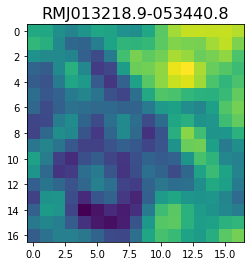

 36%|███▋      | 3664/10099 [05:15<07:31, 14.24it/s]

<class 'pixell.enmap.ndmap'>
[-24.325073  20.340437 110.04858  154.00516  123.121574  76.27197
  62.719837  58.04181   30.662136  11.735985  37.807213  68.333176
  38.091015 -30.112085 -46.820198  10.834854  65.97701 ]


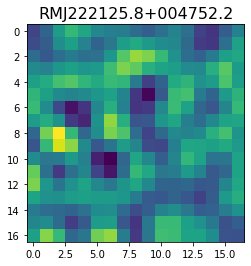

<class 'pixell.enmap.ndmap'>
[ 40.96519   13.549701 -24.009188 -30.990646 -22.870392 -38.388863
 -63.14078  -44.880714  16.977406  55.81466   27.810152 -30.142904
 -57.25067  -46.717262 -37.04647  -50.508053 -71.67107 ]


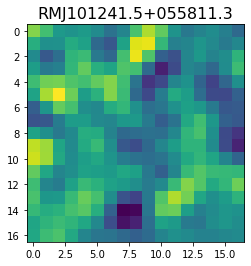

 36%|███▋      | 3666/10099 [05:15<10:39, 10.05it/s]

<class 'pixell.enmap.ndmap'>
[-12.397617   7.335124  29.121914  39.331375  23.304182 -22.623114
 -71.64076  -85.02375  -58.56792  -28.726065 -24.59217  -35.89293
 -39.43154  -35.44133  -40.207607 -56.7544   -71.133896]


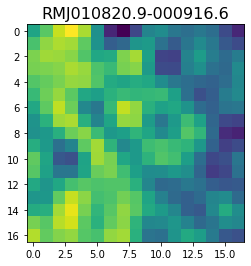

 36%|███▋      | 3668/10099 [05:15<11:23,  9.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 133.45349   154.29453   182.48946   178.52325   131.84459    81.24757
   73.57772   101.34724   101.11055    26.69908   -85.48921  -139.68753
  -74.655785   67.31749   170.91667   155.76526    54.66019 ]


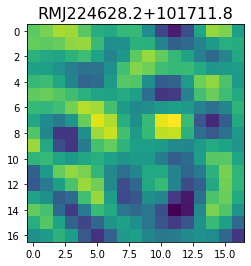

 36%|███▋      | 3670/10099 [05:16<12:04,  8.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 19.790737   31.133558   57.334206   21.505276  -42.944466   -5.8066697
  90.14804    61.46601   -70.947     -88.48447    43.70478   128.85649
  86.68277    36.626793   40.52252    45.169724   48.568474 ]


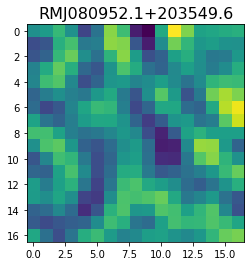

 36%|███▋      | 3674/10099 [05:16<10:35, 10.11it/s]

<class 'pixell.enmap.ndmap'>
[40.66079    6.1261992 -0.447206  18.226122  34.20782   33.9703
 37.08573   58.15115   73.27783   57.82834   36.49403   48.6879
 77.35636   69.71288   26.673466   7.3552017 33.198704 ]


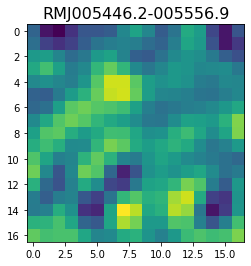

 36%|███▋      | 3676/10099 [05:16<12:04,  8.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  28.631342    16.960226    22.78816     20.46752     -1.1978455
   -1.4750301   53.84787    109.18498     67.87468    -70.289375
 -189.89035   -197.39839   -123.43481    -65.545006   -69.04072
  -90.69163    -66.00414  ]


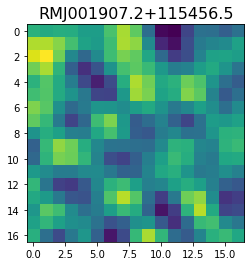

 36%|███▋      | 3677/10099 [05:17<13:56,  7.67it/s]

<class 'pixell.enmap.ndmap'>
[-131.29637  -101.10449   -25.31927   -10.032531  -61.575157  -86.35773
  -57.268085  -47.112606  -84.31154  -105.17518   -78.79735   -61.295586
  -86.71276  -108.462875  -93.28493   -81.65562  -107.120094]


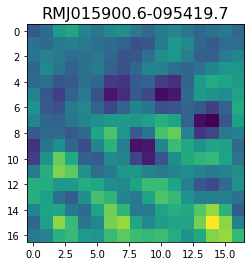

 36%|███▋      | 3678/10099 [05:17<15:34,  6.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[32.642876 35.00293  37.381557 36.19464  32.701103 27.37549  20.219187
 17.566011 24.713642 33.212738 31.413414 23.876167 23.30897  29.316748
 32.407974 31.263317 29.864687]


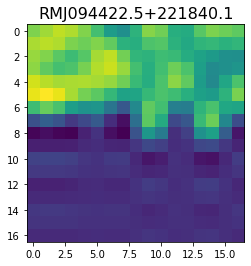

 36%|███▋      | 3680/10099 [05:17<14:40,  7.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-182.2956   -269.3813   -294.09592  -201.05403   -72.597824  -24.800747
  -70.04225  -129.66527  -154.02629  -166.53825  -189.25172  -195.0375
 -169.12825  -160.09752  -206.17554  -247.98604  -199.43614 ]


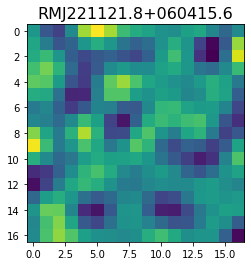

 36%|███▋      | 3682/10099 [05:17<14:02,  7.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-14.423953  -48.77164   -61.38374   -47.475857  -32.730896  -24.347963
 -21.249245  -31.473585  -50.81409   -61.04351   -59.266037  -53.56699
 -37.7724     -8.90132     9.273435   -1.2699801 -20.257347 ]


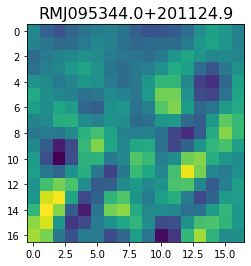

 36%|███▋      | 3685/10099 [05:18<12:28,  8.57it/s]

<class 'pixell.enmap.ndmap'>
[-89.53262   -51.037193  -59.9775    -97.35496   -91.09714   -37.726772
  -6.4043765 -22.825409  -36.315144  -18.714592  -12.4469385 -43.49913
 -64.24234   -36.277943   -2.079183  -10.187709  -27.096987 ]


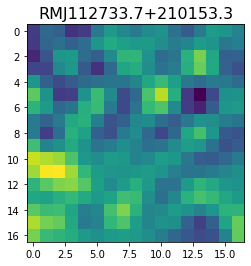

 36%|███▋      | 3686/10099 [05:18<14:15,  7.49it/s]

<class 'pixell.enmap.ndmap'>
[-14.04365   -32.7173    -27.901155  -10.467452  -11.734347  -24.761017
  -9.153844   36.370506   58.99129    32.758648    2.7178934  13.250347
  40.78398    43.035416   32.94923    49.002453   82.062744 ]


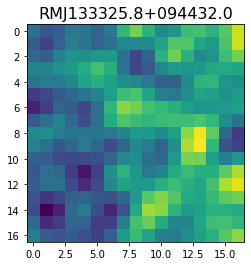

 37%|███▋      | 3687/10099 [05:18<16:17,  6.56it/s]

<class 'pixell.enmap.ndmap'>
[ -43.457573  -49.55173   -79.60108  -108.87251  -103.29668   -72.225426
  -57.028126  -69.78884   -80.06619   -66.00153   -43.908012  -37.62786
  -47.094013  -59.252556  -68.61197   -75.56373   -79.00302 ]


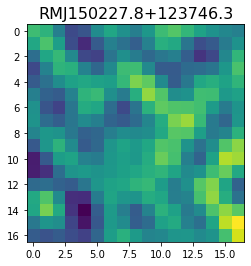

 37%|███▋      | 3694/10099 [05:18<08:01, 13.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  5.4582424  18.700367   22.447296   18.427126   11.275918    8.346477
  18.101944   40.290005   59.41912    57.410847   36.30904    18.98821
  18.592514   17.23092    -7.5834684 -41.271057  -43.21842  ]


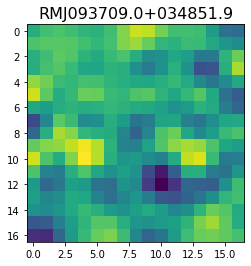

 37%|███▋      | 3697/10099 [05:19<08:42, 12.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -24.78814      -0.90311563    2.2633154   -36.99493     -75.90308
  -69.769485    -41.491       -40.230526    -60.460606    -60.575344
  -44.862747    -59.41162    -103.90599    -115.38205     -64.31911
   -9.951826    -19.122433  ]


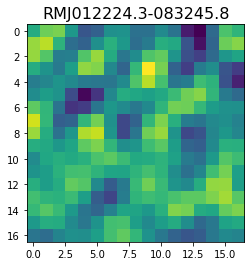

 37%|███▋      | 3699/10099 [05:19<09:50, 10.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-57.957138  -34.031494  130.86523   225.1238    153.57617    72.61479
 105.77376   139.10669    59.38285   -10.684651   71.838875  191.41376
 153.70891    17.865767   -1.3434025 118.56477   201.68648  ]


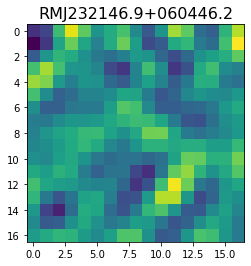

 37%|███▋      | 3706/10099 [05:19<07:19, 14.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   1.0845448   -7.244844   -10.531494    -1.343251    -5.317044
  -17.187654    -7.323308    -2.5303235  -59.362015  -139.26045
 -126.82986    -10.158827    73.38433     27.187147   -72.75901
 -101.0751     -48.95157  ]


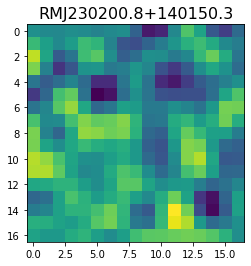

 37%|███▋      | 3708/10099 [05:19<08:07, 13.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-10.773159   -26.923761   -32.51881    -25.351728    -9.700248
  -4.8979206  -18.533379   -29.876184   -20.246544     0.48897275
  15.632341    26.95715     40.019028    46.612793    40.05502
  28.985798    22.310036  ]


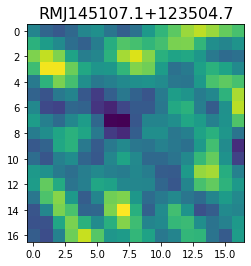

 37%|███▋      | 3710/10099 [05:20<08:59, 11.84it/s]

<class 'pixell.enmap.ndmap'>
[ 21.395113  72.161575 174.8128   180.41844   90.47154   45.8234
  98.94477  141.44307   80.18413  -28.2386   -62.386913  12.554163
 113.46567  131.01445   47.31352  -30.570768  12.776914]


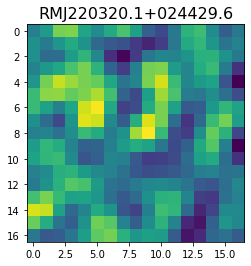

<class 'pixell.enmap.ndmap'>
[  70.09597    -57.935444  -113.83815    -62.714607     9.000409
   58.28688     93.44956     78.43582      6.1492333  -16.338085
   61.4534      95.01148    -17.18719   -108.932884   -13.100211
  111.14849     28.886967 ]


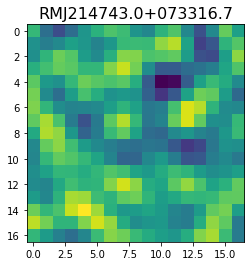

 37%|███▋      | 3712/10099 [05:20<12:55,  8.24it/s]

<class 'pixell.enmap.ndmap'>
[101.40502  110.72215   79.029305  72.94806  105.99581  117.70767
  86.080795  60.97062   71.61605   87.041466  81.39075   68.83588
  66.03479   71.98374   82.23461   87.21711   73.536896]


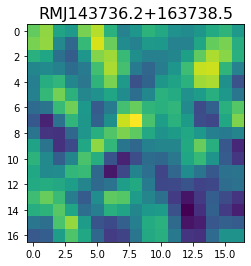

<class 'pixell.enmap.ndmap'>
[ 2.03600204e+02  1.06198265e+02  5.95495300e+01  5.25220146e+01
 -1.30323604e-01 -1.11479164e+02 -1.52653259e+02 -2.63551216e+01
  1.46952469e+02  1.72440704e+02  6.95938110e+01  2.23070984e+01
  6.67179108e+01  6.46818848e+01 -7.77999496e+00 -1.15394516e+01
  7.09349289e+01]


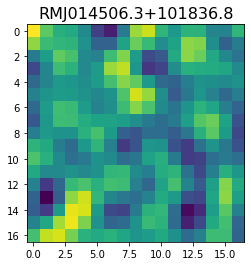

 37%|███▋      | 3714/10099 [05:21<16:20,  6.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 12.097333   63.073463   90.10122    51.018818   -1.1797115  -2.5281498
  23.601778   26.376131   26.57422    66.0499    108.58862    91.65546
  41.464573   34.916237   69.96018    73.352234   27.513872 ]


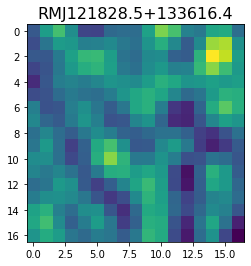

 37%|███▋      | 3717/10099 [05:21<14:25,  7.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 56.292454  38.868954  39.25262   44.751625  45.53581   53.29412
  60.950825  42.540466  12.292322  21.559254  75.80407  115.15028
  99.80362   59.94838   40.01446   42.145725  45.138767]


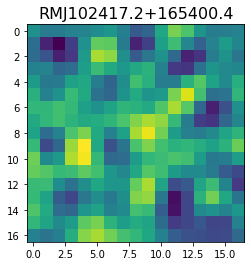

 37%|███▋      | 3720/10099 [05:21<13:00,  8.17it/s]

<class 'pixell.enmap.ndmap'>
[-18.41827  -35.324173 -45.55166  -48.93134  -42.719917 -32.31054
 -34.31293  -57.89113  -87.5644   -96.66105  -79.72995  -60.718967
 -62.503784 -78.28362  -85.46441  -80.88838  -83.26549 ]


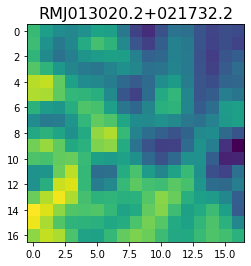

 37%|███▋      | 3721/10099 [05:22<15:18,  6.94it/s]

<class 'pixell.enmap.ndmap'>
[-273.5001    -142.22194   -142.31055   -143.21344      7.0651283
  114.58352     -0.5294417 -153.78302   -122.09718     35.1785
  157.5901     151.37732    -30.835165  -254.16658   -212.67488
  100.6794     257.3594   ]


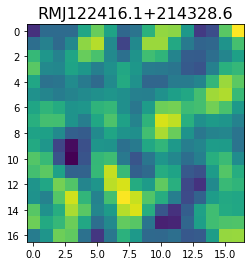

 37%|███▋      | 3722/10099 [05:22<16:54,  6.28it/s]

<class 'pixell.enmap.ndmap'>
[37.89409  12.319787 35.84374  69.72268  59.71487  18.740995  2.822939
 20.603132 29.740833 18.272749 21.309593 48.032288 58.608425 34.81807
 14.051772 23.980406 34.949844]


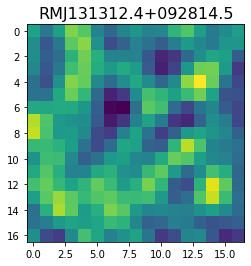

 37%|███▋      | 3723/10099 [05:22<18:14,  5.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 32.79761     3.5040722 -18.054722  -17.914013  -25.972301  -59.195244
 -76.13308   -36.41051    19.873863   17.956135  -34.376144  -51.991123
  -8.241578   16.921719  -34.378567  -97.95797   -84.296524 ]


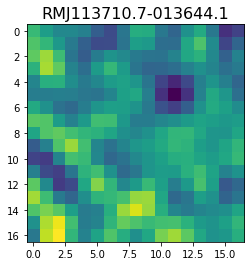

 37%|███▋      | 3728/10099 [05:22<11:26,  9.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  48.3113     55.89546    -3.573231  -77.70619  -110.05649   -96.52979
  -70.34306   -56.3568    -58.04595   -71.67258   -89.62347   -97.54845
  -89.955536  -84.59978   -99.293755 -115.778786  -93.911545]


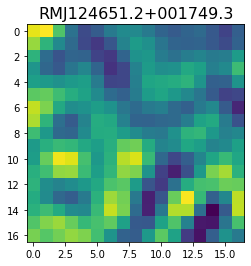

 37%|███▋      | 3734/10099 [05:23<08:43, 12.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 53.156353  55.18129   67.340805  87.903915 116.02996  136.05031
 121.97938   78.59241   54.51552   82.26389  126.75297  132.61757
 102.57568   82.347466  85.346016  86.29455   79.16403 ]


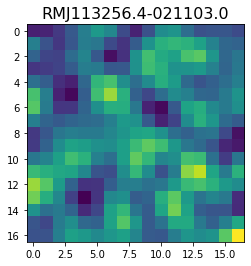

 37%|███▋      | 3736/10099 [05:23<09:27, 11.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-151.0588    -82.30665   -24.05286   -19.50156   -16.318531   37.928196
   92.11268    61.174824  -40.589767 -109.326485  -76.51797    16.925571
   65.0054     17.448544  -43.88549    -6.694831   88.657555]


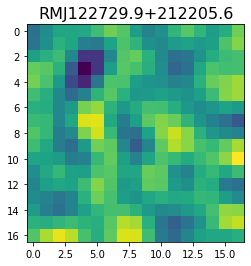

 37%|███▋      | 3738/10099 [05:23<10:48,  9.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.81427    39.40476    43.331676   51.180866   18.442556  -65.89046
 -91.41711    33.841427  188.38237   185.61723    70.30509    35.277527
  96.19572    98.40587     5.0996523 -60.776985  -36.226143 ]


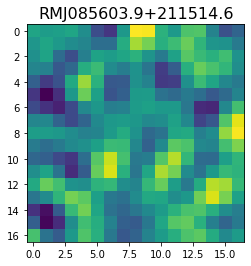

 37%|███▋      | 3747/10099 [05:24<06:23, 16.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.030466  62.273216  71.88172   46.151337  33.556404  49.415604
  59.80212   54.625767  67.30027  108.70353  137.28964  118.4454
  77.33504   65.22616   91.12486  115.53109  110.74277 ]


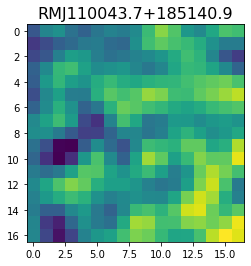

 37%|███▋      | 3750/10099 [05:24<07:54, 13.38it/s]

<class 'pixell.enmap.ndmap'>
[170.56062 174.74765 178.86395 178.99782 172.12364 159.48334 148.48807
 143.30312 137.25569 125.75761 122.91016 148.0219  192.34265 216.8067
 195.39062 151.18355 134.40063]


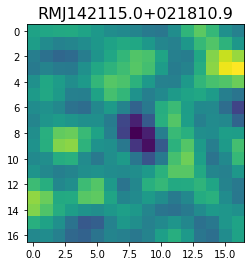

<class 'pixell.enmap.ndmap'>
[ -79.81364  -115.3228   -117.037735  -93.2909    -68.77214   -44.718548
  -23.2402    -26.868078  -55.595966  -66.43179   -37.779583  -12.409273
  -28.701311  -50.257324  -22.207186   33.494274   43.284817]


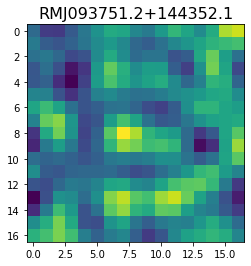

 37%|███▋      | 3752/10099 [05:24<11:02,  9.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 3.61503448e+01  1.13345027e-01 -1.05699814e+02 -2.00326843e+02
 -1.78675385e+02 -5.60523148e+01  4.11360741e+01  3.95606842e+01
  2.77212888e-01  4.61813068e+00  3.27576180e+01  1.88129063e+01
 -2.67889385e+01 -3.38696899e+01  9.79770565e+00  4.08055801e+01
  2.44551754e+01]


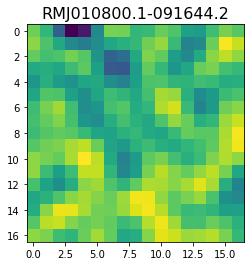

 37%|███▋      | 3754/10099 [05:25<11:44,  9.01it/s]

<class 'pixell.enmap.ndmap'>
[-171.57956  -234.61407  -272.67758  -275.66498  -233.20087  -146.13617
  -80.91089  -109.62659  -185.87701  -188.72935  -108.5391    -72.530594
 -149.83345  -245.55147  -245.15715  -168.53583  -113.37284 ]


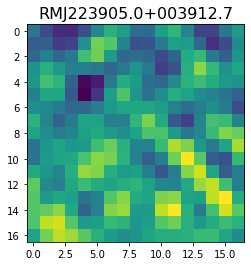

 37%|███▋      | 3756/10099 [05:25<12:20,  8.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-164.38007  -208.6471   -306.17902  -328.50912  -249.41168  -166.95323
 -162.72517  -214.46162  -261.51797  -284.77188  -283.73828  -236.10646
 -140.85014   -62.511627  -64.34414  -117.883415 -145.73605 ]


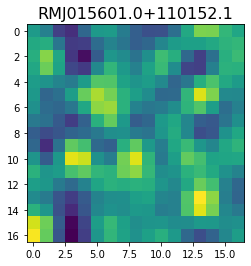

<class 'pixell.enmap.ndmap'>
[  47.826115    38.297867    -6.267862   -37.63299    -41.244545
  -39.652534   -31.25251      2.8935497   29.503935    -9.595084
  -84.08376    -91.16316    -18.507277    18.203674   -44.40033
 -110.61254    -80.83088  ]


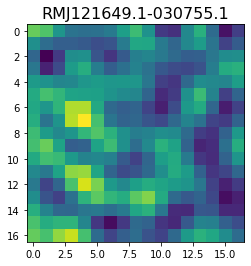

 37%|███▋      | 3758/10099 [05:25<16:12,  6.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 56.888416 119.52036  176.1024   159.08313   95.41317   64.38961
  88.507835 111.19058   84.76586   45.700306  70.677505 159.76883
 207.78262  133.91672   10.212087 -13.752744  86.19485 ]


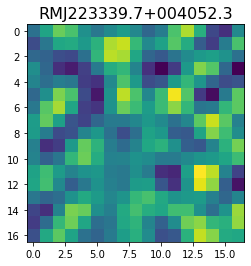

 37%|███▋      | 3760/10099 [05:26<16:05,  6.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -23.071497   -90.32705    -43.770245    50.992496    53.30316
  -22.937431   -63.949448   -59.163334   -75.676674   -94.805664
  -50.304173    15.158813    -0.7248481  -81.87768   -115.52202
  -73.5166     -36.75132  ]


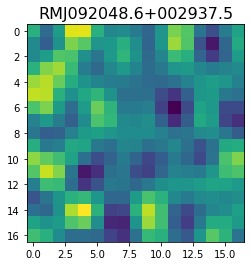

 37%|███▋      | 3773/10099 [05:26<06:24, 16.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  6.4523907  29.549566   18.782007  -12.669788  -23.93665    -6.8497257
  16.235321   33.193962   48.842957   60.904823   55.527218   30.089193
   6.536505   10.52887    36.74748    48.10433    21.130613 ]


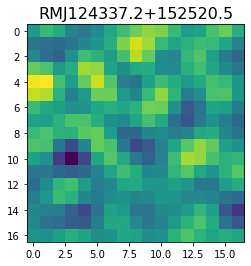

 37%|███▋      | 3776/10099 [05:27<07:11, 14.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-21.15653    -9.1006565   5.564294  -15.683954  -32.493492   -2.6812828
  29.29932     7.5188813 -27.051489   -4.484152   43.444115   32.24754
 -27.065634  -44.260612    2.0608788  44.39887    47.939663 ]


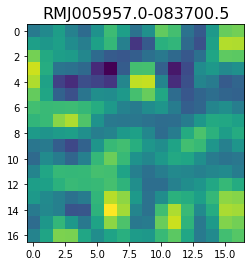

 37%|███▋      | 3779/10099 [05:27<07:38, 13.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  8.113728    3.5662735  33.262016   65.87335    57.94318    17.585491
 -14.146268  -26.86605   -39.342323  -45.050026  -13.7146     44.912117
  69.72981    26.427023  -38.24615   -52.826603  -11.372888 ]


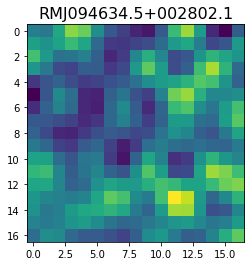

 37%|███▋      | 3781/10099 [05:27<08:46, 12.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -72.195435  -82.92842   -70.70092   -56.000504  -72.86372  -106.59445
 -113.63933   -88.75394   -67.586136  -69.78981   -79.937164  -81.94203
  -77.551125  -71.44497   -66.27244   -70.638306  -88.35021 ]


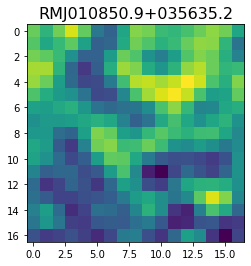

 37%|███▋      | 3785/10099 [05:27<08:29, 12.40it/s]

<class 'pixell.enmap.ndmap'>
[-199.2034   -150.394    -157.006    -216.69937  -224.20093  -157.74046
 -121.79835  -172.30943  -230.7204   -219.23529  -170.27448  -147.55481
 -146.80109  -128.51643   -87.65037   -51.44972   -49.676994]


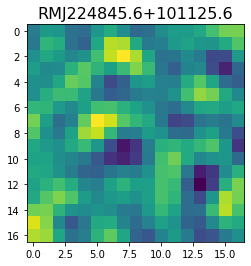

 37%|███▋      | 3787/10099 [05:28<09:33, 11.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -23.81332    -11.478582   -19.671965   -16.95608    -11.243933
  -40.236893   -96.14557   -114.514656   -63.013554    -0.5810889
   -7.5829754  -78.003784  -127.23047   -105.4134     -57.15547
  -50.56497    -85.012085 ]


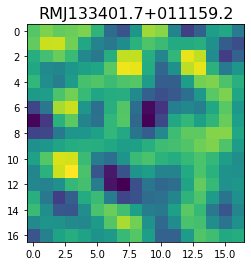

 38%|███▊      | 3789/10099 [05:28<11:12,  9.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 23.817646   12.711238   27.9256     44.700054   21.19045    -7.813717
  15.629968   58.40055    46.020275   -7.641244  -29.753668  -12.267701
  -2.9502327  -9.762717   -8.1186905  -5.517068  -18.790451 ]


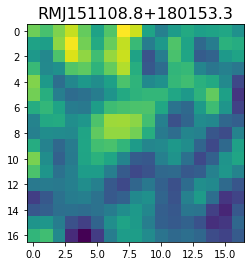

 38%|███▊      | 3791/10099 [05:28<11:55,  8.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.74577    76.9466    124.27649    87.358604    7.593035   -1.7576284
  66.39942   109.08954    91.76742    92.09122   139.84027   157.69034
 110.38762    75.69071   101.170555  116.400894   66.24326  ]


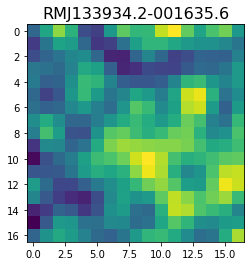

 38%|███▊      | 3792/10099 [05:28<13:40,  7.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-277.919    -570.54584  -428.2955     23.649485  246.83586    83.28579
 -144.37212  -217.52193  -186.70102   -93.18513    38.81661   107.88366
  116.162384  169.02115   162.17032  -100.5131   -416.50702 ]


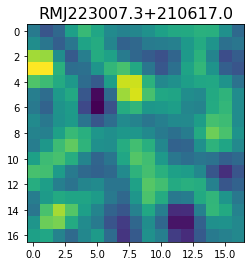

 38%|███▊      | 3796/10099 [05:29<10:47,  9.73it/s]

<class 'pixell.enmap.ndmap'>
[-70.638664  -59.645042  -39.206043   -3.8721564  25.594316   20.827795
  -9.5306    -13.840869   33.009914   72.3605     32.539726  -52.891174
 -79.3794    -27.203964   15.605912    2.9625833  -9.970284 ]


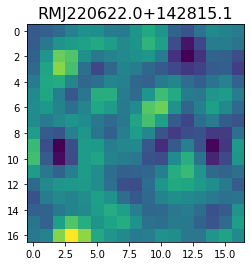

 38%|███▊      | 3797/10099 [05:29<12:42,  8.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-88.71481  -95.19946  -82.01802  -62.278957 -54.027702 -58.564808
 -60.44382  -48.573097 -30.95825  -24.445358 -33.48881  -46.011242
 -50.354588 -48.08645  -45.757935 -42.01588  -32.100353]


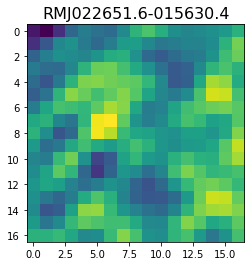

 38%|███▊      | 3803/10099 [05:29<08:38, 12.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 90.64443   79.539     83.256905 103.53872  121.516235 126.64595
 124.45207  122.1429   120.426315 118.602486 120.07777  130.15765
 147.30464  158.34636  151.1952   134.62497  131.40404 ]


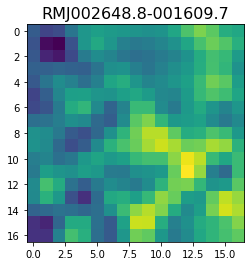

 38%|███▊      | 3809/10099 [05:30<07:14, 14.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  48.38909     71.11071      5.809503   -58.72564    -51.16527
  -16.344524   -25.919764   -67.26635    -88.120094   -87.39437
  -88.729256   -75.69473    -29.78572      5.0731378  -27.905085
 -106.175026  -149.99829  ]


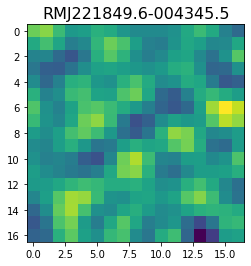

 38%|███▊      | 3814/10099 [05:30<06:56, 15.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[105.89751   121.97707   107.14988    85.945244   71.39667    48.249786
  22.676926   31.771887   72.89893    82.75359    31.901491  -15.307935
   7.0800743  62.00965    66.07519    16.72105   -13.409303 ]


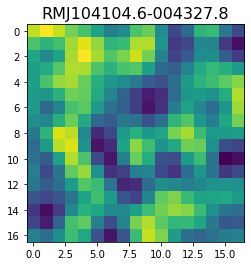

 38%|███▊      | 3820/10099 [05:30<06:25, 16.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-41.892704   30.325895   58.26285    24.40307   -31.58637   -50.914894
 -24.219597  -12.828667  -53.56318   -79.121544  -18.469454   65.679955
  56.784176  -28.07048   -61.72893    -4.3375125  52.683834 ]


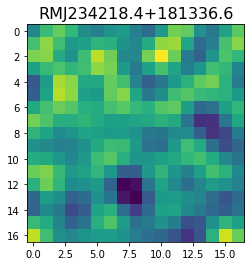

 38%|███▊      | 3823/10099 [05:30<07:12, 14.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -74.60886   -76.94674   -60.70945   -64.061264  -77.872345  -64.99284
  -40.80048   -57.97777  -113.23037  -141.59001  -113.100876  -74.763565
  -80.6052   -124.62616  -158.40125  -147.09677  -100.70501 ]


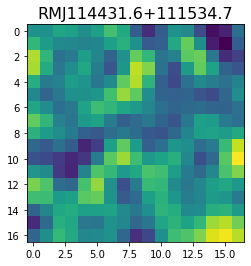

 38%|███▊      | 3825/10099 [05:31<08:10, 12.80it/s]

<class 'pixell.enmap.ndmap'>
[ 2.2042763e+01 -1.8979744e+02 -8.9702278e+01  1.7349278e+02
  1.6935664e+02  5.4661708e+00  3.6097969e+01  1.2688114e+02
  2.1905228e-01 -1.0818882e+02  9.9511429e+01  3.1293213e+02
  1.1213275e+02 -2.7008514e+02 -3.2828818e+02 -8.3326340e+01
  4.4284332e+01]


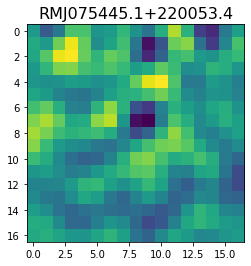

 38%|███▊      | 3827/10099 [05:31<09:16, 11.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[81.59211  99.67494  91.29596  60.210743 33.521008 25.86742  30.115551
 41.130123 61.07283  79.22933  76.78097  59.04575  54.08791  68.74928
 74.93723  55.001633 33.317184]


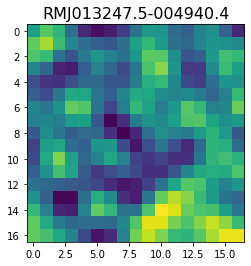

<class 'pixell.enmap.ndmap'>
[-31.640884    10.225596    26.186483    -0.11606181 -24.035109
 -12.484959     9.484745     7.270883    -8.792639   -10.490416
  -3.3562     -11.005184   -24.22459     -9.638288    30.25652
  46.485413     9.80492   ]


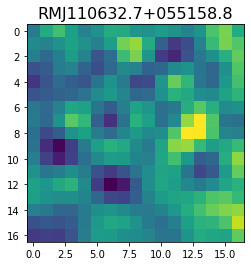

 38%|███▊      | 3829/10099 [05:31<12:52,  8.12it/s]

<class 'pixell.enmap.ndmap'>
[ -70.30993   -27.300068   -7.222289  -40.569126 -109.61133  -130.90475
  -76.06432   -28.882263  -55.032597 -107.59497  -130.51625  -151.13925
 -191.42993  -195.64206  -136.00171   -88.14417  -108.40574 ]


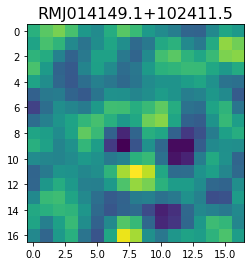

 38%|███▊      | 3830/10099 [05:32<15:09,  6.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -62.680298  -62.75043   -84.61195  -116.51595  -132.59975  -142.3757
 -160.62369  -160.01253  -117.33052   -68.536606  -57.8909    -73.777725
  -85.196266  -93.60093  -104.99315  -101.86272   -79.669136]


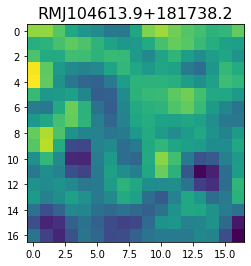

 38%|███▊      | 3833/10099 [05:32<13:08,  7.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 10.934236   -2.571811   12.694722   37.795986   41.564457   19.655266
  -8.8562765 -21.117167   -6.7614636  16.14254    15.445893   -4.9532924
  -1.0363687  35.00979    40.661037  -24.085554  -97.95558  ]


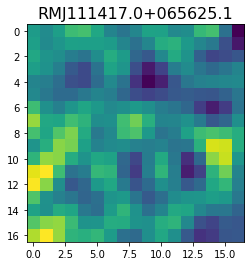

 38%|███▊      | 3835/10099 [05:32<13:17,  7.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -60.705383   -80.87952    -95.073204  -120.76406   -175.45169
 -225.36548   -214.73625   -143.38246    -75.5492     -61.465294
  -78.089966   -68.14875    -24.702719    -6.4322586  -56.734875
 -133.79047   -155.81071  ]


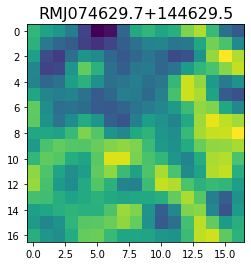

 38%|███▊      | 3838/10099 [05:33<11:54,  8.76it/s]

<class 'pixell.enmap.ndmap'>
[ 93.249115  81.03046   55.09779   77.06515  138.25208  150.95331
  92.32091   43.15813   56.903114  93.67442  106.6771    99.84845
  83.82616   59.39492   52.41748   89.37284  138.79651 ]


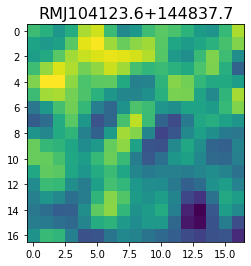

 38%|███▊      | 3839/10099 [05:33<13:43,  7.60it/s]

<class 'pixell.enmap.ndmap'>
[-189.4376   -140.15591  -206.32068  -319.94357  -359.11172  -313.5865
 -224.83606  -118.00534   -66.20226  -147.53442  -280.2844   -280.26584
 -129.07954   -13.244409  -57.84659  -176.17732  -221.40434 ]


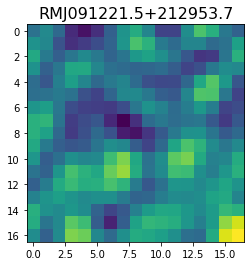

 38%|███▊      | 3840/10099 [05:33<15:57,  6.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -40.31868   -55.90646   -69.85122   -59.067364  -28.960129  -13.231839
  -32.57059   -65.90174   -75.19322   -56.313225  -47.804024  -78.23653
 -121.11504  -126.87221   -92.43279   -65.83167   -76.82636 ]


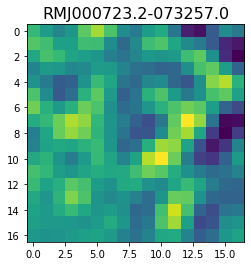

 38%|███▊      | 3842/10099 [05:33<16:08,  6.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-134.64548  -113.64457  -102.86806  -131.17189  -131.47093   -82.67792
  -68.026855 -114.31932  -132.39558   -84.02942   -46.24165   -60.004524
  -74.58732   -72.33264   -95.25077  -135.53096  -138.62723 ]


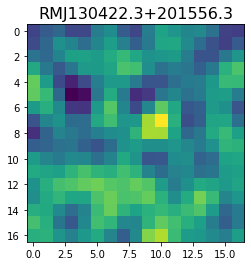

 38%|███▊      | 3846/10099 [05:34<12:28,  8.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[148.45499 189.14711 199.26881 170.76419 143.98424 143.1188  149.74165
 147.89418 148.29561 157.91698 165.78384 166.0196  160.8732  142.41124
 106.79652  79.95112  89.66047]


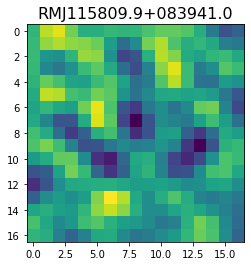

 38%|███▊      | 3848/10099 [05:34<13:02,  7.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-92.09235   -90.1701    -68.190445  -46.395603   -3.1213768  45.088306
  31.978874  -41.83442   -87.11303   -60.728542  -18.10752    -2.5211625
  13.4395485  48.976852   70.663734   52.534794   13.647258 ]


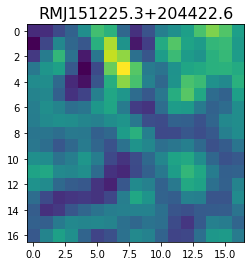

 38%|███▊      | 3858/10099 [05:34<06:11, 16.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  26.294252   -41.96201     58.328754   120.0362     -19.916687
 -178.72762   -138.68663      1.5017875   30.62699    -24.57823
   -1.2147192   94.95629    121.113815    46.734802   -20.21489
  -11.307106    34.647964 ]


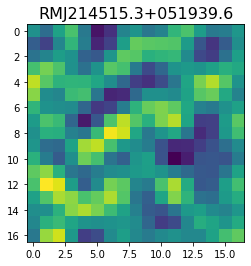

 38%|███▊      | 3861/10099 [05:35<06:53, 15.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -71.528824  -59.166702  -97.62761  -171.83829  -206.6912   -165.43217
 -109.791534 -114.47662  -158.75621  -174.6932   -165.70013  -176.92905
 -180.26697  -118.70626   -48.575237  -86.770065 -209.46613 ]


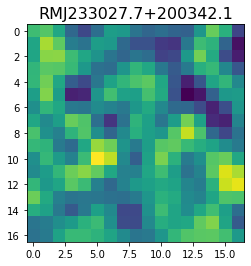

<class 'pixell.enmap.ndmap'>
[20.429676 34.969032 47.174904 47.09708  35.463005 22.36579  18.343348
 27.780771 46.423706 61.659252 59.961525 40.583336 19.747465 15.285989
 28.513939 46.1259   56.833244]


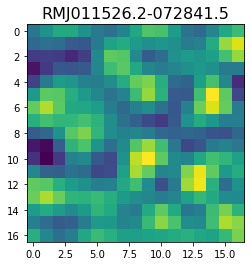

 38%|███▊      | 3864/10099 [05:35<09:35, 10.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 80.027115 110.99053  266.9327   314.65585  201.5169   142.77032
 267.46597  417.6856   408.16412  284.1397   199.1463   200.93414
 252.5261   323.0073   356.50003  280.2083   133.74352 ]


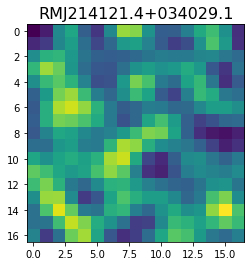

 38%|███▊      | 3866/10099 [05:35<10:07, 10.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[149.63046  118.73542  147.04047  194.57806  153.25447   72.48266
  94.726494 198.79292  231.01866  170.35649  142.44176  183.29222
 201.69278  171.57356  164.52577  194.05992  204.57068 ]


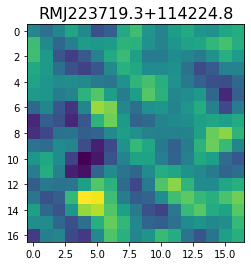

 38%|███▊      | 3868/10099 [05:36<11:32,  8.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -57.361397  -66.500046  -52.043304  -41.834034  -67.18976  -110.243576
 -117.442696  -73.27956   -32.275017  -52.376785 -112.785515 -135.08382
  -87.89704   -30.15027   -29.286634  -72.021034  -94.31921 ]


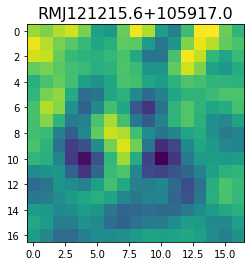

 38%|███▊      | 3871/10099 [05:36<10:41,  9.71it/s]

<class 'pixell.enmap.ndmap'>
[-133.21132   -102.8797     -64.89105    -77.11425   -111.84798
  -94.404854   -31.398277   -11.3522005  -70.68919   -142.25142
 -157.90663   -129.7798    -101.59295    -83.4463     -70.39169
  -74.24944    -98.2438   ]


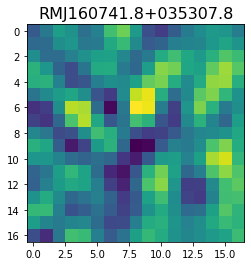

 38%|███▊      | 3873/10099 [05:36<11:02,  9.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 42.288853 118.22297  187.24403  202.53526  164.62653  121.66002
 121.86691  149.77594  140.368     78.73696   34.540577  57.0847
  98.54665  104.062256 110.66575  165.94135  208.19325 ]


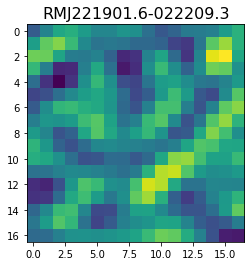

 38%|███▊      | 3875/10099 [05:36<11:19,  9.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[68.91617  68.876205 69.21586  63.008583 55.289318 53.372494 53.68065
 50.535316 46.860897 46.171654 45.235847 41.698624 38.13831  35.27174
 31.560078 29.255201 30.943089]


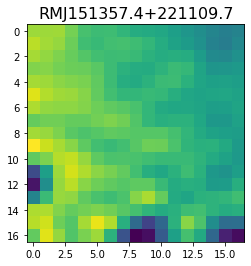

 38%|███▊      | 3880/10099 [05:37<08:40, 11.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[115.34237  129.00093   17.918795 -63.48938  -17.284586  80.247856
 114.64549   85.26777   55.30282   30.128727 -18.41323  -50.040874
   9.557711 130.31195  178.25308   94.23043  -11.760889]


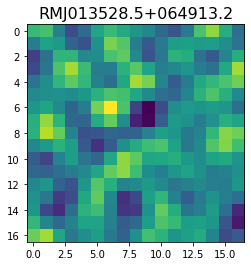

 38%|███▊      | 3885/10099 [05:37<07:30, 13.80it/s]

<class 'pixell.enmap.ndmap'>
[-136.21832  -123.30764  -136.99052  -155.4281   -161.8197   -159.05734
 -148.67378  -127.558044 -109.1768   -114.43254  -134.34525  -134.94644
 -108.51596   -87.83825   -98.0268   -123.374855 -134.62573 ]


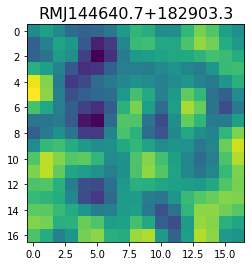

<class 'pixell.enmap.ndmap'>
[ -26.364613 -118.329216 -185.13022  -115.19002   -47.230385 -138.59784
 -262.65344  -220.10973  -120.92984  -183.76695  -286.7225   -173.65793
   17.391006  -45.336727 -272.4601   -302.32242  -157.78633 ]


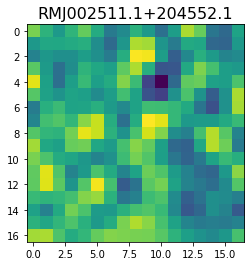

 38%|███▊      | 3887/10099 [05:37<10:17, 10.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.766153 -56.255825 -43.466484 -13.278316  -4.784661 -15.904884
 -18.95504  -14.554398 -27.52783  -55.822464 -66.3886   -45.953907
 -20.590921 -16.844967 -31.541643 -47.870956 -57.350597]


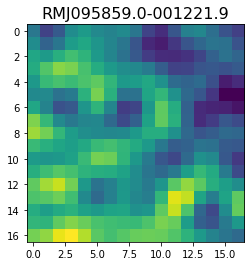

 39%|███▊      | 3891/10099 [05:38<09:06, 11.37it/s]

<class 'pixell.enmap.ndmap'>
[-133.00397   -73.03892    68.707664  102.509224   16.9736    -18.821611
   39.744617   63.483784   22.020592   44.02988   150.95168   175.18129
   34.447662 -114.97012  -101.88035    38.698673  156.75221 ]


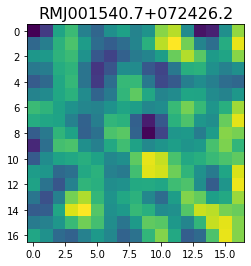

 39%|███▊      | 3893/10099 [05:38<09:50, 10.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 22.118855   66.987816  106.40896    57.70861   -54.530956  -86.98427
  12.278751  107.96925    81.21506     3.9603376  -3.2422383  29.97457
   4.6967115 -60.160927  -67.65857   -10.832341   29.814701 ]


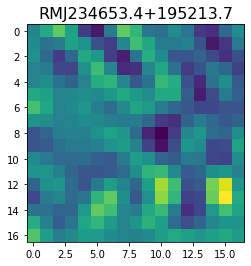

 39%|███▊      | 3902/10099 [05:38<05:59, 17.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 53.89284  -40.754673 -39.125317  85.55537  162.04857   92.0901
 -23.82585  -71.63817  -65.7216   -59.662266 -53.97234  -41.181732
 -40.443913 -51.696766 -47.853985 -24.969759  -5.186437]


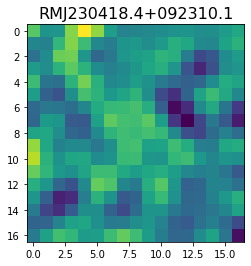

 39%|███▊      | 3905/10099 [05:39<06:47, 15.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 98.40831   83.596565  52.889248  36.874233  44.771572  58.946613
  68.77407   77.5308    79.79333   64.77458   44.12844   46.97552
  78.820915 107.00922   98.333595  58.499397  23.785511]


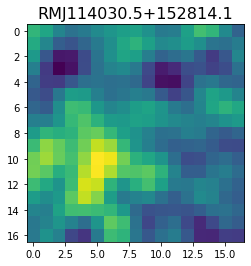

 39%|███▊      | 3911/10099 [05:39<06:22, 16.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-37.629356  -26.51398   -13.817449  -15.334103  -20.681622   -9.332849
  15.3785     23.919542    2.4772227 -22.411125  -22.862778  -13.820698
 -25.981731  -50.8798    -55.32143   -41.818443  -45.462337 ]


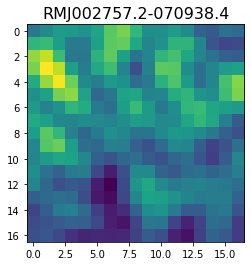

 39%|███▉      | 3916/10099 [05:39<06:09, 16.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-266.2493    -252.14513   -131.12953   -139.35645   -348.7455
 -488.14005   -313.06628     22.357212   167.0363      22.8542
 -192.69118   -255.26134   -147.0183       6.3969336   90.79229
   76.57776     -1.7920556]


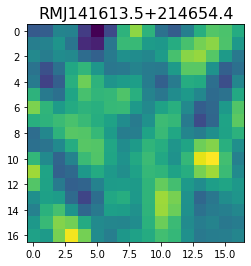

 39%|███▉      | 3919/10099 [05:39<07:10, 14.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 89.25357    77.87214    15.674264  -42.36019   -46.368702  -17.178665
 -15.688746  -46.970013  -48.87268     6.1847544  57.29706    42.44714
  -8.559156  -20.020512   23.673197   70.514885   78.07424  ]


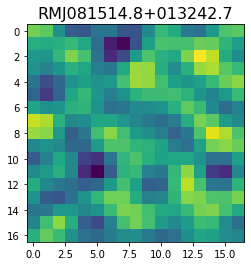

 39%|███▉      | 3922/10099 [05:40<07:30, 13.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-36.633015  -56.08251   -59.870953  -36.43014    -7.6792965  -5.0119624
 -25.655098  -36.001133  -17.938892    9.519888   19.012566    6.813748
 -11.5578785 -23.128801  -24.5788    -16.979908   -4.9117355]


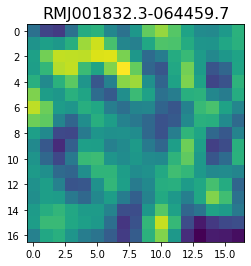

 39%|███▉      | 3926/10099 [05:40<07:47, 13.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -2.3084264  -14.332953   -32.44609    -44.217884   -48.77239
  -47.005703   -39.37191    -35.692413   -45.535965   -59.289295
  -62.497784   -64.686714   -83.93147   -106.94884   -102.03192
  -73.0369     -58.977016 ]


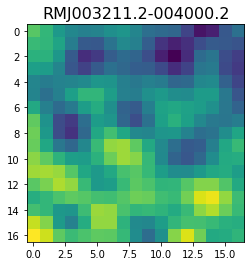

 39%|███▉      | 3932/10099 [05:40<06:42, 15.31it/s]

<class 'pixell.enmap.ndmap'>
[-185.30937  -161.7067   -174.42734  -173.52626  -142.2585   -126.2913
 -144.15364  -147.30371  -105.37605   -61.141155  -64.12327  -108.323364
 -161.61617  -202.4771   -214.9125   -201.4969   -199.96776 ]


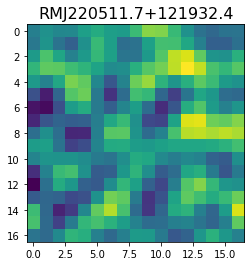

<class 'pixell.enmap.ndmap'>
[-33.328922  -19.41846   -23.891092  -45.86578   -55.93733   -41.341938
 -23.600689  -24.33969   -38.457397  -48.88083   -47.51328   -34.56759
 -13.877507    5.078154   12.817354    9.869963    1.8777324]


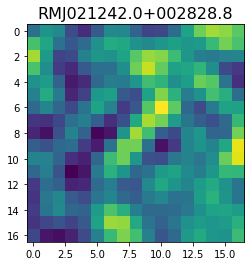

 39%|███▉      | 3934/10099 [05:41<09:25, 10.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 22.22678   -17.546328  -57.218967  -31.882288   41.03897    82.46204
  56.662502    5.6068206 -24.945873  -40.059616  -55.7305    -54.116085
 -17.095627   29.148514   46.624912   43.177742   55.07607  ]


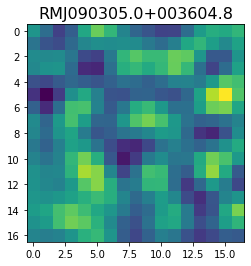

 39%|███▉      | 3936/10099 [05:41<09:58, 10.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-172.93793  -145.19682   -18.636364   51.087486   -8.835545  -88.75083
  -94.503365  -70.006096  -62.177177  -24.22574    65.64346   120.167786
   68.364815  -25.035955  -44.963837   26.600565  105.31227 ]


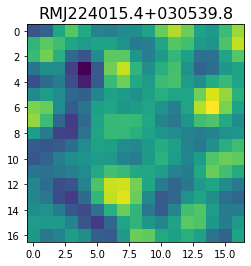

 39%|███▉      | 3939/10099 [05:41<09:38, 10.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[167.19598  190.8325   152.6351    91.5742    72.82405  103.906555
 120.143326  84.73969   59.47442  104.22411  157.2239   124.71723
  42.137867  13.771902  38.833466  43.882034  37.609756]


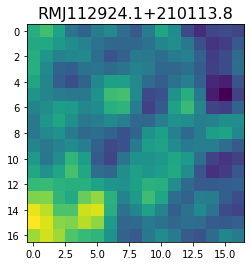

 39%|███▉      | 3941/10099 [05:42<10:12, 10.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 0.31362337  5.515922   11.563374    7.2719507  -0.43456158 -3.0081131
 -2.5629656  -2.909353   -2.907498   -1.4148673   0.19781113  0.90496415
  0.825297    0.47919953  0.5390702   0.607431   -0.26298785]


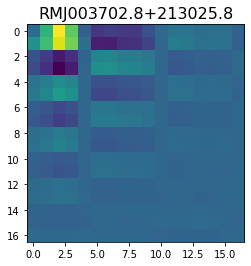

 39%|███▉      | 3943/10099 [05:42<10:42,  9.58it/s]

<class 'pixell.enmap.ndmap'>
[  -7.034245  -26.755913 -105.2395   -176.93349  -203.43253  -209.10223
 -212.90073  -185.4554   -120.51475   -85.04748  -127.13971  -184.50964
 -166.78154   -93.90167   -66.976326 -119.352    -178.55585 ]


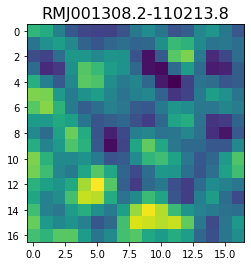

 39%|███▉      | 3944/10099 [05:42<13:19,  7.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[70.2698   69.55658  62.717457 59.77767  65.358826 71.7632   71.46915
 66.50954  62.064907 59.188667 56.757378 54.550537 52.75648  52.016235
 53.49109  56.653    58.899326]


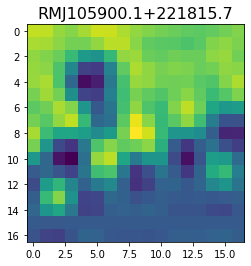

 39%|███▉      | 3947/10099 [05:42<12:03,  8.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.012894   17.828445  -30.42222   -55.149208  -39.986816  -17.724764
 -19.974833  -34.898354  -35.207253  -23.342724  -23.331102  -42.455147
 -62.76462   -63.667667  -41.04204   -10.920225    1.0106348]


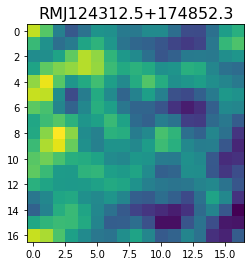

 39%|███▉      | 3957/10099 [05:43<05:58, 17.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  39.652996  -40.532116  -87.18405   -46.27862    38.985615   80.63579
   39.967194  -51.561867 -132.53735  -150.78348   -96.69247   -25.498768
  -18.823317  -95.73035  -183.29611  -200.26317  -149.2578  ]


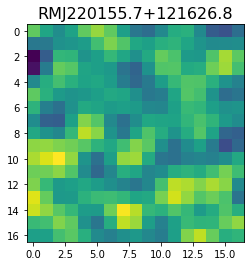

 39%|███▉      | 3961/10099 [05:43<06:15, 16.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 13.445337  10.475939  71.021706 110.21409   80.349815  35.979267
  38.90032   68.451675  70.076645  36.38139   -6.934652 -48.23888
 -76.53995  -62.53528   -1.200205  58.039387  67.799545]


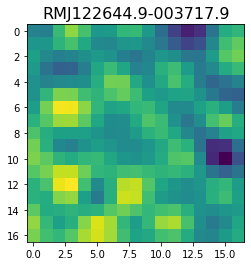

 39%|███▉      | 3964/10099 [05:43<07:22, 13.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-114.009636 -152.34816   -89.94145    -4.841785  -26.662203 -142.4014
 -205.25108  -141.5744    -52.477287  -65.05843  -157.03004  -201.80339
 -149.73026   -83.06963   -90.62744  -157.7174   -207.89235 ]


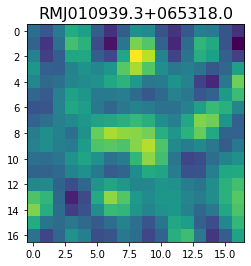

 39%|███▉      | 3966/10099 [05:44<08:28, 12.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[130.50624   156.60226   182.92265   122.01316     6.772488  -44.83239
   3.898311   87.01252   141.4327    148.78275   123.04047   112.79291
 148.77943   169.5713     99.13325    -3.2985616  -1.3524846]


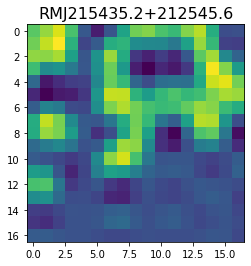

 39%|███▉      | 3968/10099 [05:44<09:22, 10.91it/s]

<class 'pixell.enmap.ndmap'>
[ -30.844805   -33.781418   -43.141197   -39.656      -17.575703
   -1.7538671  -10.399356   -23.480015   -24.546963   -39.209
  -81.78084   -104.8376     -67.19418    -13.747637   -14.379284
  -56.12457    -71.26736  ]


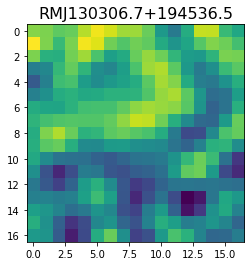

<class 'pixell.enmap.ndmap'>
[137.73792    19.595388   10.565992   77.67693    79.7799      9.570793
 -28.00063    -2.3679783  35.03657    66.560265  103.8878    124.231674
 105.55718    71.56833    43.813503   11.033364  -22.875286 ]


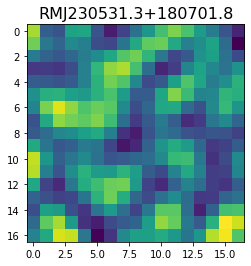

 39%|███▉      | 3970/10099 [05:44<12:40,  8.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -80.2871      79.587326   110.77686    -45.911263  -175.25008
 -119.51092    -18.515293   -71.16325   -203.21487   -181.70132
    2.1109452   96.506004   -29.84783   -180.64989   -123.841705
   62.754955   113.94464  ]


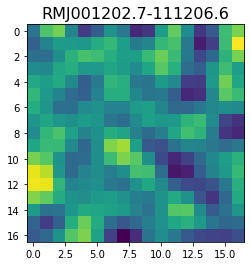

 39%|███▉      | 3983/10099 [05:45<05:38, 18.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.600456   62.573406   -2.9733381 -79.57053   -49.844738   61.65112
 133.06273   121.055405   81.93638    49.354824    4.574115  -40.37229
 -35.605392   16.243975   45.282757   13.152352  -35.04977  ]


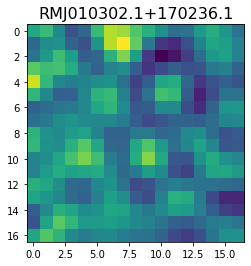

 39%|███▉      | 3986/10099 [05:45<06:28, 15.75it/s]

<class 'pixell.enmap.ndmap'>
[ 97.66863  162.1616   112.609795  13.566555  -6.228897  68.667244
 134.68759  124.559235  89.41144   97.92488  117.96712   72.11895
 -12.44531   -8.743093 123.34491  246.06784  215.14786 ]


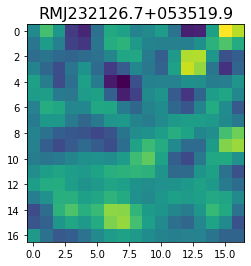

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[102.3723   112.37077  103.645996  56.14661    7.370848  12.658865
  71.38891  122.72697  126.117424 116.22367  151.23839  224.51549
 263.27618  218.97716  132.3154    90.48473  128.52904 ]


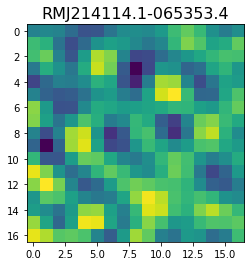

 39%|███▉      | 3989/10099 [05:46<09:03, 11.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[164.02505   37.909992   8.916138  99.609276 242.63472  326.87988
 267.15967  118.403656  60.82282  174.23238  315.0152   324.53683
 244.68579  200.60716  200.77626  201.34962  238.32932 ]


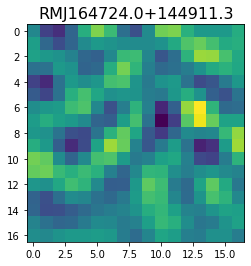

 40%|███▉      | 3993/10099 [05:46<08:29, 11.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[135.06807   63.994915  10.796138  50.229046 116.92294   96.38836
  31.577297  49.424206 127.677605 138.65791   82.18365   70.924065
 118.75671  133.71622   95.5724    76.326996 102.663895]


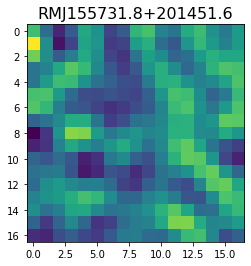

 40%|███▉      | 3996/10099 [05:46<08:33, 11.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 88.15966   89.04472  141.48466  181.4808   161.74605  111.32591
  80.000854  77.83021   93.24957  118.2831   129.90007   98.36479
  43.62981   33.329422  89.93553  144.15854  120.19495 ]


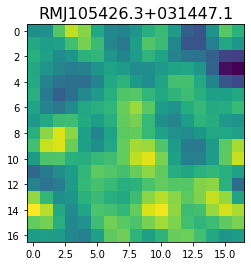

 40%|███▉      | 4000/10099 [05:46<07:56, 12.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-131.00652  -120.84168  -104.5142   -105.55877  -124.535614 -140.29524
 -137.29541  -124.81958  -124.66092  -140.38191  -150.19858  -139.3063
 -124.86109  -129.55524  -143.17932  -137.76125  -112.40788 ]


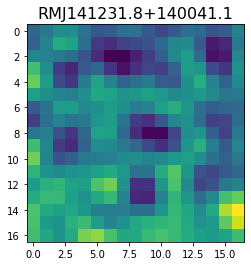

 40%|███▉      | 4009/10099 [05:47<05:15, 19.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  8.598099    29.187498    17.360725    -2.8163877    0.90754515
  12.983061     3.1942146  -20.06236    -34.042118   -41.466206
 -43.651283   -17.98691     31.640873    49.72398      6.727911
 -43.663506   -39.15834   ]


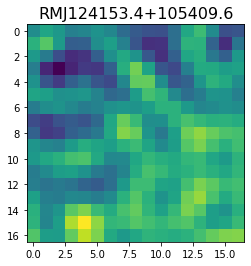

 40%|███▉      | 4012/10099 [05:47<06:01, 16.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.560896   -15.104686    -9.602578     4.4307013   12.001059
   6.315388    -0.72766685   3.7213905   14.770189    18.494543
  12.014888     4.4714265    2.7704275    6.0118446   10.896113
  14.001444    10.821008  ]


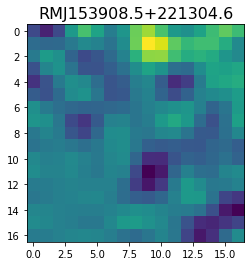

<class 'pixell.enmap.ndmap'>
[-64.866394  -73.503624  -80.80204   -71.68149   -63.88365   -76.74175
 -96.334114  -94.3895    -69.94011   -50.497265  -53.55615   -64.38831
 -58.53655   -34.40887   -10.80185     1.6141882   8.547461 ]


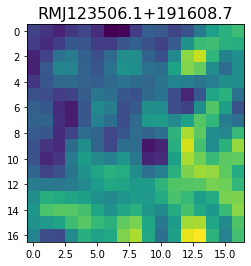

 40%|███▉      | 4015/10099 [05:47<08:57, 11.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 20.401567    5.615874    2.5254905  10.750434    9.447871   -5.277632
 -14.949625   -6.107781   18.781397   49.795216   69.492775   58.196323
  22.103376    1.1125445  22.715555   61.812393   73.44619  ]


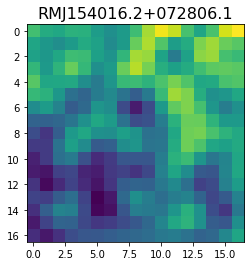

 40%|███▉      | 4017/10099 [05:48<10:05, 10.04it/s]

<class 'pixell.enmap.ndmap'>
[  33.509922    -31.045593   -116.8514     -107.798454    -50.533333
  -31.543764    -39.044735    -30.214462      0.14399381   42.530815
   64.66863      24.913414    -39.26706     -44.35146     -14.218901
  -34.233925    -57.004684  ]


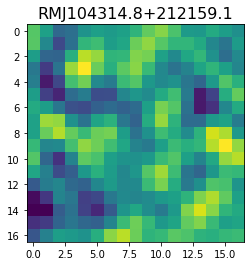

 40%|███▉      | 4019/10099 [05:48<10:52,  9.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-247.49942  -157.14606  -103.5446   -184.51308  -317.64127  -335.52136
 -215.02045  -116.58588  -160.9532   -258.87384  -247.17726  -128.55475
  -56.378742 -105.13938  -186.36253  -208.20236  -193.94063 ]


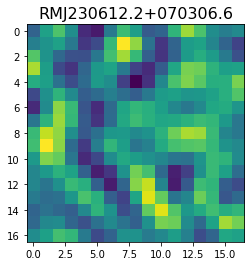

<class 'pixell.enmap.ndmap'>
[ -81.61222    -54.93919    -13.818712    10.4242525   -6.6151752
  -53.940388  -106.49826   -144.23053   -140.69003    -82.8864
  -17.621656   -15.624104   -66.15776    -79.51378    -27.346373
    3.6135607  -49.53065  ]


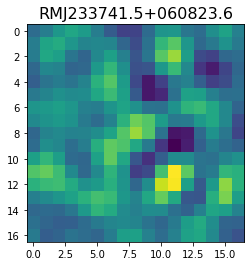

 40%|███▉      | 4021/10099 [05:48<13:48,  7.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[143.25162   49.94351  -59.587475 -32.637127  71.92228  146.69289
 204.57101  249.05634  200.97719   74.60853   12.107751  54.234344
  80.24511   26.170856 -33.98129  -47.58064  -43.90722 ]


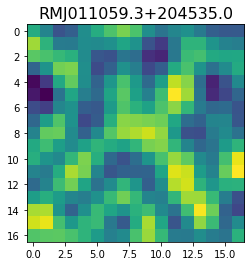

 40%|███▉      | 4026/10099 [05:49<10:20,  9.78it/s]

<class 'pixell.enmap.ndmap'>
[ 61.824432 101.855675 135.8821   154.10576  212.5342   258.06912
 186.74055   69.153366  76.04366  183.03357  197.30821   84.36221
  20.326233  94.38414  189.51247  197.82172  156.09772 ]


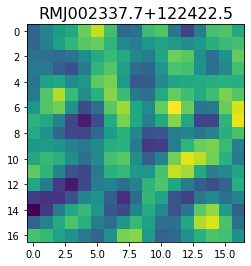

 40%|███▉      | 4028/10099 [05:49<10:44,  9.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 40.539066   36.73239    56.53939    60.66709    41.39516    21.31758
  14.573068   20.340431   33.73293    41.737797   30.022121    7.106631
  -2.8984153   1.574528   -1.859774  -19.423185  -33.552273 ]


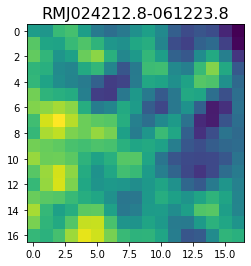

 40%|███▉      | 4033/10099 [05:49<08:39, 11.67it/s]

<class 'pixell.enmap.ndmap'>
[194.28908  115.186714  52.19253   63.65262  122.223305 167.9168
 183.01831  187.85704  193.0872   179.39034  128.26624   69.05496
  64.34304  126.287285 188.08435  193.91806  168.95526 ]


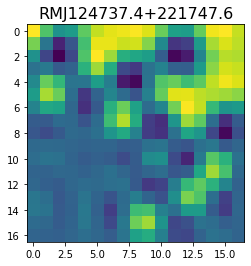

<class 'pixell.enmap.ndmap'>
[214.85986  206.28491   87.37175   -1.628227  37.40596  124.32211
 130.35326   70.69338   74.483406 174.23273  231.20305  137.79077
   8.543398  32.099262 174.27756  217.05219  107.55445 ]


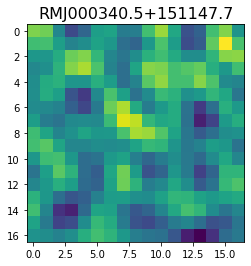

 40%|███▉      | 4035/10099 [05:50<11:31,  8.77it/s]

<class 'pixell.enmap.ndmap'>
[-188.93771    -94.570526    16.256697    -6.296951  -115.27517
 -171.26212   -149.67398   -121.20293    -98.73747    -46.319366
   -3.7721663  -49.75083   -137.18942   -116.787125    31.632856
  129.2312      41.722824 ]


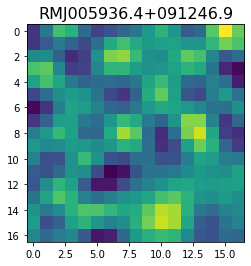

<class 'pixell.enmap.ndmap'>
[-82.5491    -8.01141   36.72312   43.271946  76.26906  137.22647
 136.7188    31.459148 -81.936226 -71.01258   54.58809  135.73586
  63.538654 -69.17516  -88.65749   19.64724  100.82545 ]


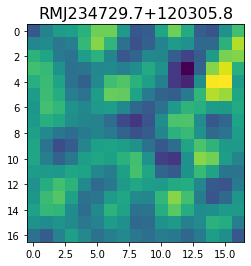

 40%|███▉      | 4037/10099 [05:50<14:36,  6.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-136.4437     -69.60116     22.1371      56.587902    32.519398
   -5.405673   -23.818405     1.3254224   71.907196   125.28403
   83.301346   -21.890432   -57.357674    26.421423   110.12093
   75.19422    -21.73702  ]


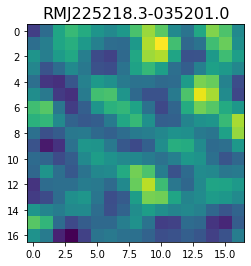

 40%|███▉      | 4039/10099 [05:51<14:23,  7.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[239.37093 219.25993 162.06462 123.88279 149.52493 199.21152 205.71529
 176.21744 166.46754 180.23149 177.69273 167.48378 197.18022 251.61449
 256.5842  203.28786 177.03435]


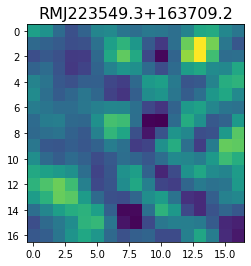

 40%|████      | 4041/10099 [05:51<14:48,  6.82it/s]

<class 'pixell.enmap.ndmap'>
[ 12.609163   42.9941     35.22647    -3.9506469  -9.465128   36.871197
  78.40432    71.66859    41.20301    24.592707   18.700024   13.914922
  32.049793   83.33753   122.82503   104.22642    54.355606 ]


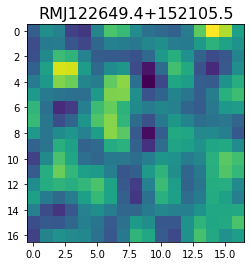

 40%|████      | 4042/10099 [05:51<16:16,  6.20it/s]

<class 'pixell.enmap.ndmap'>
[126.39824   108.90305    79.210785   49.438965   34.088093   46.092896
  74.35598    95.46135   102.349396   94.38795    59.3187      3.0767486
 -24.862337   15.356347   89.313225  124.14027    98.24431  ]


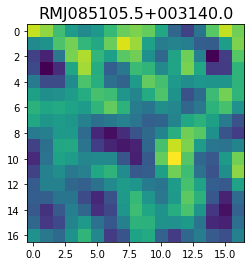

 40%|████      | 4043/10099 [05:51<17:49,  5.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 36.797913  76.828354  73.39095   42.30512   17.472225  12.559976
  17.610703  16.558432  10.04031   22.86621   67.274796 101.78663
  73.467316   8.64203   -2.68501   61.347755 109.412735]


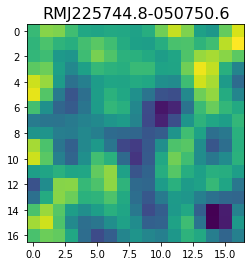

 40%|████      | 4045/10099 [05:52<16:17,  6.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  27.682919    8.48373   -55.222973  -62.905922  -39.672512  -51.936363
  -62.09636   -15.280883   42.502087   50.58803    24.070719  -14.926425
  -70.22044  -103.02318   -68.121216  -15.70697   -15.430303]


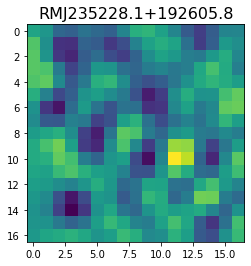

 40%|████      | 4049/10099 [05:52<11:46,  8.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[131.86559  147.87398  152.92029  144.14299  128.77258  127.337975
 153.55968  183.28163  175.64606  137.34595  119.93897  135.34766
 134.92204  101.044266  86.88081  121.605705 152.01054 ]


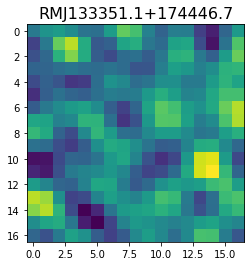

 40%|████      | 4054/10099 [05:52<09:08, 11.02it/s]

<class 'pixell.enmap.ndmap'>
[ -37.862366  -30.982267  -80.49457  -123.29383  -102.6901    -64.17752
  -73.71755   -95.016014  -57.921947   -9.551614  -55.909634 -165.27135
 -190.52097  -105.384926  -51.126682 -103.29553  -158.36429 ]


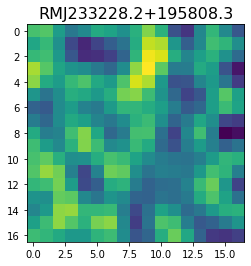

 40%|████      | 4056/10099 [05:52<09:58, 10.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -57.41218   -56.052162  -70.60695  -111.21512  -140.7815   -112.27666
  -46.597324  -25.576992  -78.908165 -129.21371   -99.6148    -29.443098
  -12.867907  -55.762283  -77.79251   -44.539642   -9.540971]


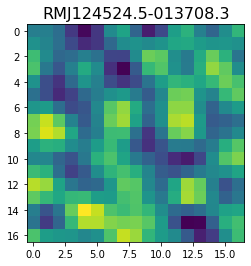

 40%|████      | 4058/10099 [05:53<10:50,  9.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[16.883179   3.0599854 10.15802   29.008049  42.929256  46.543674
 44.35537   40.952488  40.099373  45.731445  54.757496  54.338448
 37.012337  16.178665  14.600608  35.34747   55.345425 ]


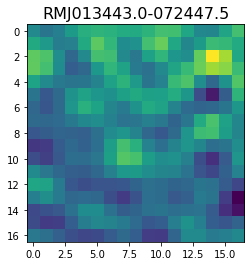

 40%|████      | 4061/10099 [05:53<10:10,  9.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -85.655304  -47.18917   -70.99778  -117.95515  -118.26858   -91.49777
  -98.66532  -121.41216  -102.875435  -69.96793   -93.03281  -150.49915
 -157.00748  -111.28373   -95.61324  -132.87675  -158.62392 ]


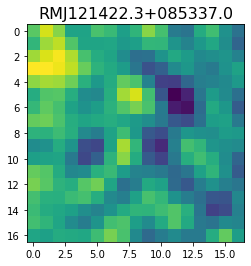

 40%|████      | 4067/10099 [05:53<07:43, 13.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 21.358202    0.7588641  -9.011433   19.653486   57.527863   47.807304
   0.6370019  -9.986126   36.84395    70.12244    39.89522    -5.042104
  -3.0106575  22.138464   10.921131  -33.12566   -59.631847 ]


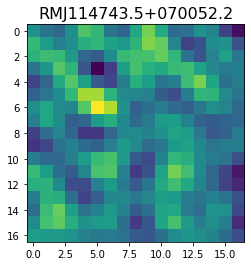

 40%|████      | 4071/10099 [05:54<07:36, 13.20it/s]

<class 'pixell.enmap.ndmap'>
[ 26.726936   67.22517    39.892757    2.9233968  -7.6080346 -16.906301
 -38.664124  -34.968727   10.750964   43.372272   18.83708   -15.555725
   2.4850135  40.702835   28.611153  -15.398117  -17.530193 ]


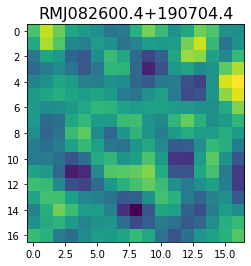

<class 'pixell.enmap.ndmap'>
[-94.840126 -73.06901  -45.23842  -30.439972 -25.339687 -18.612368
 -10.869785 -14.359923 -32.54681  -46.07518  -30.857492   7.41976
  30.845663  10.603894 -39.310017 -78.26639  -79.00569 ]


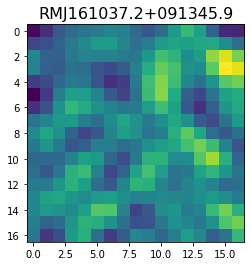

 40%|████      | 4073/10099 [05:54<10:39,  9.42it/s]

<class 'pixell.enmap.ndmap'>
[ -12.303785  246.10939   241.37619   -22.889456 -191.12192  -159.72198
 -154.3563   -270.5067   -358.37802  -302.44214  -135.71545    25.71162
   39.38205  -104.62045  -188.66275   -60.24675    94.1117  ]


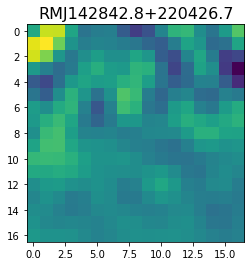

 40%|████      | 4075/10099 [05:54<11:00,  9.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-197.75914   -190.66586    -71.39249     39.657646    56.79468
    3.6999965  -65.70499   -123.24056   -131.16919    -53.30805
   58.673584    76.824      -45.16877   -184.23041   -182.31334
  -37.352856    97.0849   ]


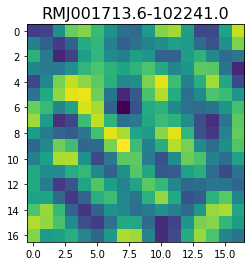

 40%|████      | 4080/10099 [05:55<09:33, 10.49it/s]

<class 'pixell.enmap.ndmap'>
[61.042896 54.67159  44.19048  46.288574 58.64979  64.38255  57.37559
 53.621143 67.57091  87.15711  89.09578  73.42379  62.775345 68.00299
 75.130264 70.788284 61.879173]


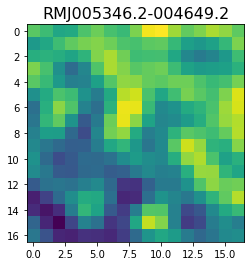

 40%|████      | 4082/10099 [05:55<10:20,  9.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 41.516476  83.58933   54.80058   17.8827    31.449205  83.43912
 136.13855  157.10516  115.828415  30.417671  -8.02566   51.480225
 118.80044   82.50456  -11.032526 -28.714357  33.838005]


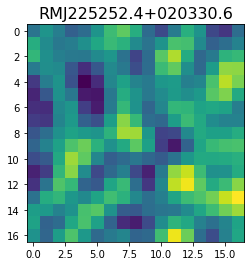

 40%|████      | 4083/10099 [05:55<12:06,  8.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-17.670757   5.498395  47.2612    80.55753   53.498882 -20.90856
 -57.69555  -18.813105  29.475359  26.981325  14.50634   48.454098
  86.95085   53.40162  -29.708395 -68.38533  -36.899574]


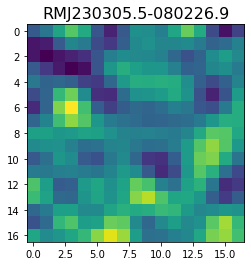

 40%|████      | 4086/10099 [05:56<11:09,  8.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[138.4585     106.09755     -4.191577   -35.772064    74.21827
 164.72485     84.345116   -66.618546   -88.69766      7.7380705
  44.229736   -11.736411    -0.42228985 129.65422    198.03659
  74.33202    -97.88985   ]


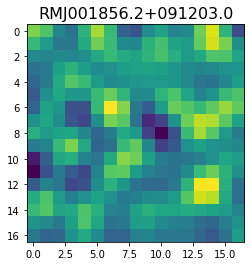

 41%|████      | 4092/10099 [05:56<08:05, 12.37it/s]

<class 'pixell.enmap.ndmap'>
[ 43.826508  46.653755  68.74619  127.514465 159.28882   85.69085
 -36.21397  -56.944904  47.020725 135.89612  124.62243   88.385414
  95.777275  94.20529   43.69515   18.787989  76.36988 ]


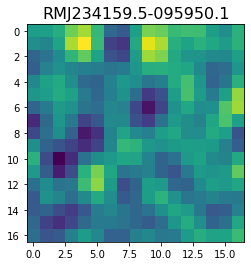

<class 'pixell.enmap.ndmap'>
[-61.058113 -36.758442 -28.850792 -36.43186  -49.74527  -54.42469
 -44.405876 -36.467625 -52.716526 -84.44068  -97.9745   -82.00009
 -60.584755 -51.572178 -43.840435 -28.25893  -18.569775]


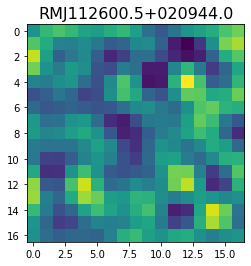

 41%|████      | 4094/10099 [05:56<10:48,  9.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-33.290993  -53.75896   -13.111711   23.998531    4.064262  -24.903261
  -6.4025636  24.219744   13.424656  -13.992172  -14.026186   -7.3078594
 -23.667133  -28.946726   14.920613   72.5418     86.57872  ]


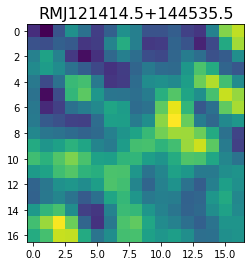

 41%|████      | 4097/10099 [05:57<10:01,  9.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-141.71521 -141.12344 -177.59045 -214.86678 -195.37259 -134.84203
  -97.22178  -98.37145 -106.73576 -114.55168 -135.10039 -152.55284
 -145.07735 -135.36266 -152.64531 -171.76657 -156.40176]


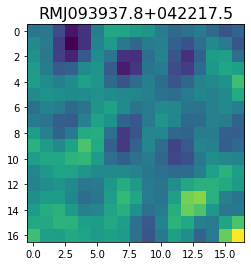

 41%|████      | 4099/10099 [05:57<10:38,  9.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -32.783096  -21.85859   -56.777832 -118.32097  -126.20251   -63.12692
  -22.431023  -70.998    -139.0968   -124.81748   -48.69581   -16.595867
  -64.24536  -121.435135 -118.93618   -68.23579   -33.659676]


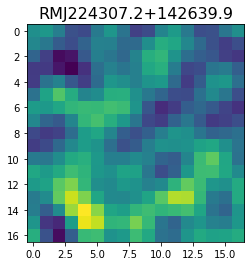

 41%|████      | 4102/10099 [05:57<10:15,  9.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  49.403122  103.259674   15.781285 -104.28451  -156.24237  -159.37822
 -168.32857  -176.15562  -140.16693   -52.738228   39.192562   70.44499
   20.768446  -51.598022  -68.33193   -26.86955     6.39822 ]


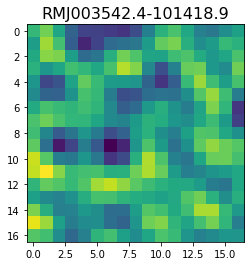

 41%|████      | 4108/10099 [05:57<07:49, 12.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-11.284277  -13.905463  -10.915066   -0.7210413  -9.813949  -32.422127
 -27.510094    7.699227   21.954323   -8.387677  -39.935966  -35.031013
 -20.548828  -36.85197   -72.50757   -90.71725   -87.53311  ]


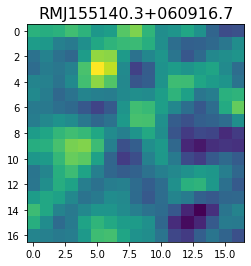

 41%|████      | 4110/10099 [05:58<08:32, 11.68it/s]

<class 'pixell.enmap.ndmap'>
[-59.244015  -19.089083  -18.522024  -51.781937  -57.666317  -25.062037
 -16.096205  -57.90404   -87.68888   -53.49178    -2.0633628  -4.6826344
 -48.50307   -67.02652   -39.205822    3.2490644  35.9061   ]


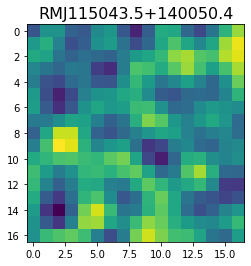

<class 'pixell.enmap.ndmap'>
[  34.393127    30.606112     1.1587728  -68.48692    -97.2404
  -20.24427     83.9915      89.76547     10.95277    -24.443436
   23.229538    46.44487    -36.145847  -147.23358   -157.22163
  -63.256977    16.88377  ]


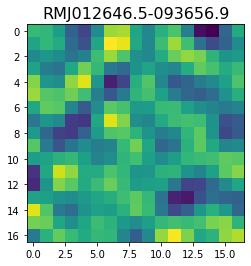

 41%|████      | 4112/10099 [05:58<11:36,  8.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[136.36987  100.87711   84.28173  116.91504  154.49266  151.8164
 124.650406 110.08537  109.779945 103.215645  88.666115  83.79346
  97.63359  117.17499  119.68145   98.9501    79.653564]


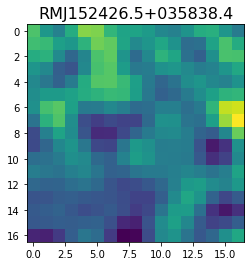

 41%|████      | 4114/10099 [05:58<12:36,  7.91it/s]

<class 'pixell.enmap.ndmap'>
[ -51.792984   -23.635803     7.7363806   -8.6422205  -65.076256
  -75.62653    -16.37382     11.2491865  -60.337914  -137.69846
 -107.0476     -20.342258    -9.813022   -72.45654    -81.536095
    6.889477    91.82862  ]


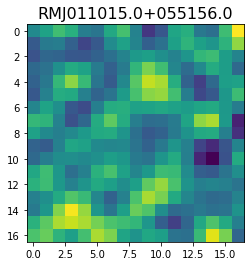

 41%|████      | 4115/10099 [05:59<14:19,  6.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[112.62057  115.925064  94.270386  63.885147  51.857845  54.085278
  50.746567  44.38852   46.37517   47.487877  37.753193  32.214973
  43.38662   52.428917  39.67301   20.535744  20.82566 ]


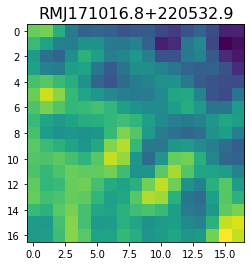

 41%|████      | 4117/10099 [05:59<13:57,  7.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -72.81912  -116.86209  -129.81718   -93.880875  -63.489788  -84.752625
 -126.50026  -133.10428  -105.01707   -81.51485   -75.16847   -69.72488
  -63.240513  -71.31998   -95.07747  -114.54571  -109.55651 ]


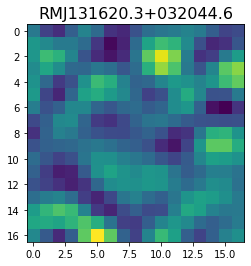

 41%|████      | 4119/10099 [05:59<13:35,  7.34it/s]

<class 'pixell.enmap.ndmap'>
[-105.48384  -118.36825  -155.2748   -174.94362  -133.27736   -83.75351
  -98.303505 -136.74988  -122.88898   -90.622505 -107.58876  -123.7081
  -71.37869   -43.215687 -158.24695  -306.22025  -266.76822 ]


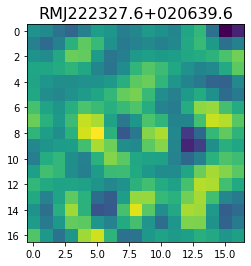

 41%|████      | 4120/10099 [05:59<15:22,  6.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -40.932354  -30.005762  -36.600327  -47.852524  -43.042625  -32.539555
  -45.889595  -81.95228  -103.96541   -91.89275   -67.60466   -53.602524
  -38.70433    -9.595489   10.315823  -10.780206  -58.69873 ]


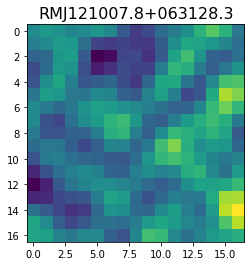

 41%|████      | 4123/10099 [06:00<12:35,  7.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-102.74638   -75.889145  -22.184383   -9.219586  -71.61001  -145.43456
 -131.69281   -32.540684   38.43192     9.232289  -53.183334  -48.963387
    9.432362   30.259026  -14.266748  -58.15443   -48.084892]


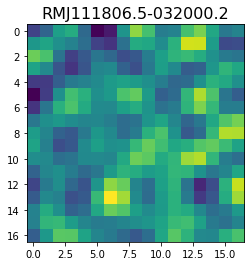

 41%|████      | 4125/10099 [06:00<12:25,  8.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -32.732883   26.456594  -34.414555 -101.91505   -26.014574   95.40258
   74.852264  -24.26639   -24.821678   19.076324  -32.91411   -82.70386
   13.273578  119.600876   63.273     -20.359936   57.424732]


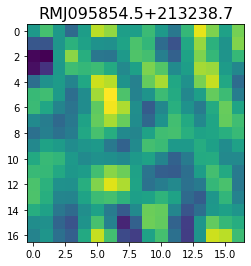

 41%|████      | 4130/10099 [06:00<09:06, 10.92it/s]

<class 'pixell.enmap.ndmap'>
[-49.890358  -48.10597   -53.402336  -55.98681   -60.018696  -74.209114
 -81.47988   -59.35178   -29.034145  -33.21351   -64.2665    -72.25753
 -46.81176   -27.05298   -24.771622   -7.9673357  26.14678  ]


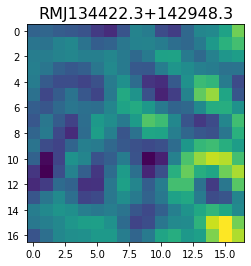

 41%|████      | 4132/10099 [06:00<10:12,  9.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-45.307884 -35.435116 -51.682835 -77.28608  -86.06112  -75.29677
 -60.086193 -45.546036 -27.558268 -15.29715  -23.847872 -41.21591
 -32.8428     9.51677   50.779316  60.37288   51.76814 ]


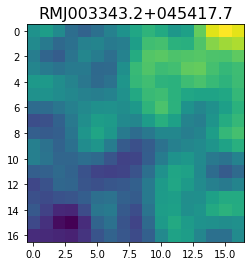

 41%|████      | 4133/10099 [06:01<12:16,  8.10it/s]

<class 'pixell.enmap.ndmap'>
[ 36.084568  29.049913  28.951458  12.246343 -13.411859 -13.130081
  18.92089   45.435707  41.297844  27.436508  29.35294   34.721504
  21.353828   2.758409  10.45201   42.617054  64.20369 ]


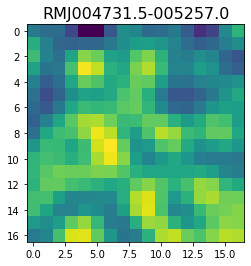

 41%|████      | 4134/10099 [06:01<13:58,  7.11it/s]

<class 'pixell.enmap.ndmap'>
[ -33.07181   -88.10925  -152.7715   -166.18073  -135.11308   -99.589264
  -75.44278   -62.944332  -67.92901   -83.009125  -82.87864   -62.17798
  -47.526985  -56.764233  -77.00322   -93.07286  -106.63585 ]


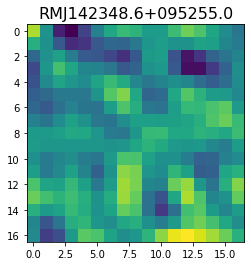

 41%|████      | 4135/10099 [06:01<15:34,  6.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[106.87653  197.8748   248.63461  181.50655   80.35634  102.58105
 235.47496  275.3305   121.98576  -49.7585   -33.457207 123.12862
 225.1793   215.59914  184.05869  171.48462  140.07098 ]


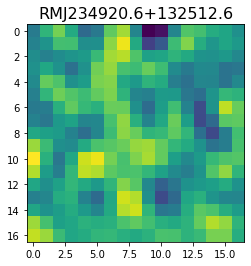

 41%|████      | 4138/10099 [06:01<12:22,  8.03it/s]

<class 'pixell.enmap.ndmap'>
[2.4846849e+01 2.8756569e+01 3.0500731e+01 3.7068375e+01 5.0483517e+01
 3.8724091e+01 2.4248550e+00 9.4272800e-02 4.8811829e+01 8.6828491e+01
 8.5494316e+01 9.1915306e+01 1.1424232e+02 9.2037415e+01 3.0722012e+01
 2.4896021e+01 9.1968269e+01]


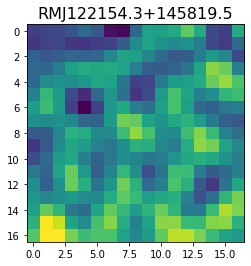

 41%|████      | 4139/10099 [06:02<14:23,  6.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  11.668367  -111.62977   -147.63644    -67.43432     -4.3102555
  -11.50399     -2.8560832   57.319824    85.07763     33.394707
  -29.666742   -42.39892    -31.971304   -36.491985   -37.61641
   -6.4776945   47.534744 ]


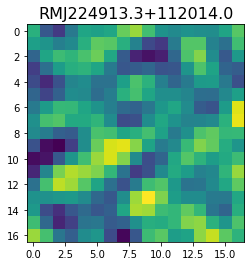

 41%|████      | 4141/10099 [06:02<14:26,  6.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.571175   24.358778   87.3066    157.46346   123.91254     6.2624393
 -70.65818   -50.476574   -4.562821  -14.77844   -69.1457    -92.3274
 -39.534046   52.013943   94.34768    44.763817  -30.40688  ]


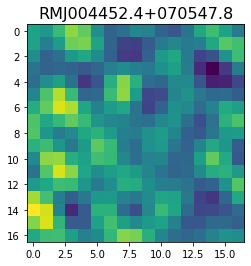

 41%|████      | 4145/10099 [06:02<10:54,  9.09it/s]

<class 'pixell.enmap.ndmap'>
[132.43962   179.3645    200.57541   164.3293     70.38969    -5.4042907
 -20.008345  -25.27893   -43.459877    2.3593128 133.74301   216.37312
 143.20143    14.755124   -1.1836299  94.089966  168.82188  ]


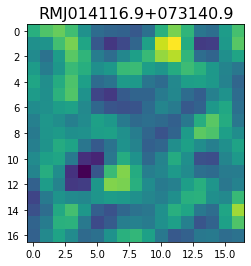

 41%|████      | 4146/10099 [06:03<12:55,  7.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-107.08228    -69.01182     26.120327    80.80051     49.932327
   -9.0136795  -28.682184   -16.519331   -19.502594   -46.796883
  -62.50717    -38.255795    11.146396    42.58083     29.625843
   -6.5096126  -19.23335  ]


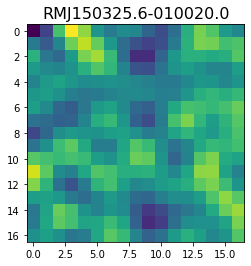

 41%|████      | 4154/10099 [06:03<06:42, 14.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-88.61726   -68.01544   -69.156586  -79.045815  -60.348907  -22.74938
 -13.154172  -38.7225    -57.171776  -50.458572  -48.5225    -62.59472
 -56.15387   -13.527712   18.610699    0.6759815 -35.002056 ]


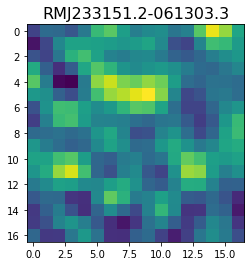

 41%|████      | 4157/10099 [06:03<07:28, 13.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -33.7725    -42.503807  -15.059814   38.74218    57.554855   15.65163
  -43.650047  -60.66656   -25.240229    8.821822  -20.517294 -100.22379
 -138.5132    -79.253944   11.947222   34.430542   -5.483904]


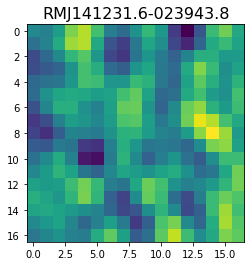

 41%|████      | 4159/10099 [06:03<08:19, 11.90it/s]

<class 'pixell.enmap.ndmap'>
[142.95183   54.598476  34.646572  62.426918 121.19873  205.96011
 236.95834  154.46045   62.4755    89.80109  172.65112  166.27733
  89.012436  62.848152  98.02723  115.61698  101.170906]


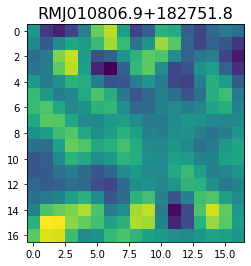

 41%|████      | 4161/10099 [06:04<09:19, 10.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 67.416725  54.976955  72.20635  102.715935 118.01109  105.85757
  85.47077   86.70585  109.15786  122.33626  112.18425   96.49444
  87.05797   75.42246   64.43946   69.91358   83.02589 ]


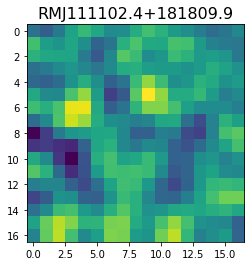

<class 'pixell.enmap.ndmap'>
[152.64401   130.69376    49.254658    8.467579   53.825924  111.35736
  84.3719     -4.1180916 -33.226612   43.324837  131.47835   139.35689
  95.773384   68.20582    50.343716    9.84181   -25.964848 ]


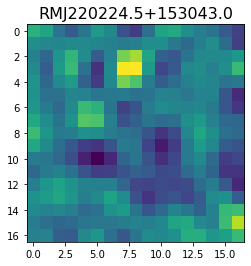

 41%|████      | 4163/10099 [06:04<12:49,  7.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-113.07313   -134.2857    -186.05533   -167.11899   -139.167
 -198.9287    -203.28148    -12.437292   152.30688     36.04984
 -167.15073   -132.1837      27.355518    -4.3055863 -172.42113
 -194.95204    -71.62229  ]


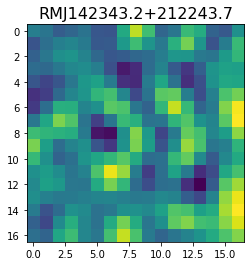

 41%|████      | 4165/10099 [06:04<12:33,  7.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -10.90791     24.079277   -74.13863   -118.50499     -3.1933846
   88.262474    21.583296   -54.91374     -9.5357485   35.980476
  -36.924988  -114.54653    -68.90056     12.755385    -7.0803437
  -84.86226    -86.10565  ]


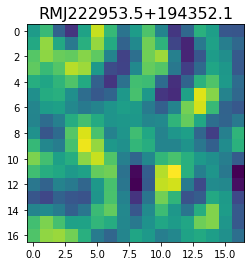

 41%|████▏     | 4167/10099 [06:05<12:38,  7.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 77.99127   74.50294   64.87753   62.544395  82.98858  118.01465
 136.11697  118.76734   86.98419   78.22662   99.98083  120.75919
 111.217354  82.0602    70.13211   92.14987  125.920006]


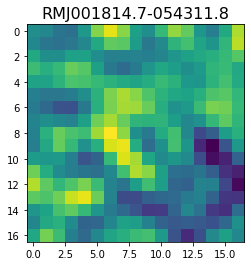

 41%|████▏     | 4170/10099 [06:05<11:21,  8.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 55.596577  43.214268  27.275032  36.0555    73.77654   96.90243
  78.852295  57.77437   68.25637   78.79291   58.77836   45.849434
  74.56098  102.411026  84.74763   57.97605   67.78361 ]


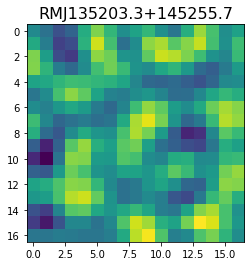

 41%|████▏     | 4175/10099 [06:05<08:53, 11.10it/s]

<class 'pixell.enmap.ndmap'>
[-55.66683   -17.022614    2.7880101 -16.648853  -30.867254   -8.047572
  20.269487   14.959825   -8.551441  -11.668846    7.4473767  23.815792
  30.092857   34.75478    35.948048   30.607464   32.185314 ]


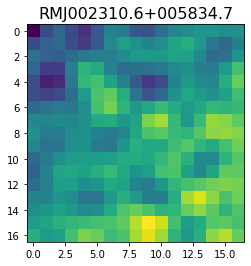

 41%|████▏     | 4184/10099 [06:06<05:26, 18.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[271.70746   74.79577   -5.462558  80.07295  180.87383  173.02487
 109.33385  105.66529  170.45273  221.7925   222.89536  215.35646
 227.06346  223.27367  175.05789  126.02467  146.40195 ]


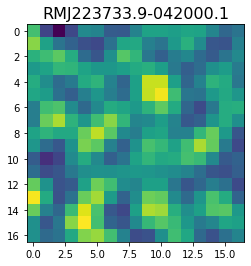

 41%|████▏     | 4187/10099 [06:06<06:42, 14.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 63.68552   57.83687  119.03173  185.4537   194.70445  141.4984
  80.665504  75.871765 135.0549   200.8466   214.93015  180.35074
 147.25269  152.53172  189.80974  224.13458  222.17326 ]


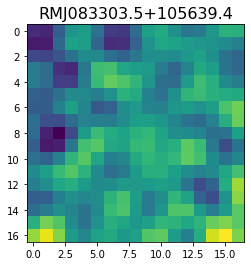

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 67.751595    45.79943     40.317146    61.310318    68.0654
  40.680927    11.606004     0.20383048 -13.422792   -23.04834
  13.845483    85.92513    112.48579     62.004734     4.150672
  -3.3264244    3.8984127 ]


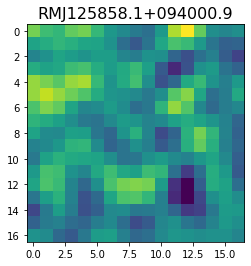

 41%|████▏     | 4190/10099 [06:06<08:52, 11.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -3.4429624 -40.076927  -23.475817   17.24058    27.7988     15.852241
  17.797968   24.820784    9.131708  -10.294357    3.7469645  34.410152
  32.320644   -1.4138548 -13.899034   17.386171   51.365765 ]


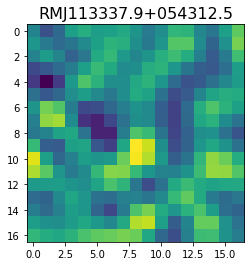

 42%|████▏     | 4196/10099 [06:07<07:23, 13.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 77.73501   47.71144   77.63993  108.68593   80.560814  43.838192
  85.65458  182.86676  227.6523   180.29333  104.838425  63.260784
  59.492367  83.05898  127.19183  160.54016  150.17012 ]


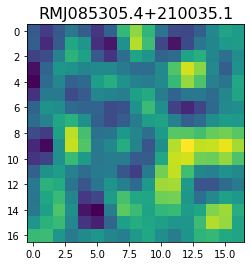

 42%|████▏     | 4202/10099 [06:07<06:47, 14.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -87.644806 -106.85389  -113.336205 -114.370834 -126.36689  -140.4246
 -131.29056   -96.427124  -63.89334   -57.333294  -70.0464    -81.330284
  -84.85207   -88.81968   -96.08657   -98.53786   -90.86514 ]


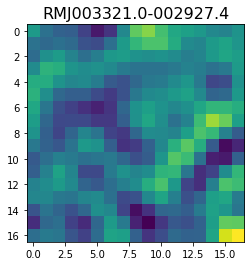

 42%|████▏     | 4205/10099 [06:07<07:15, 13.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 83.460205   60.671764   30.942753   33.970104   67.94529    83.353065
  49.260494    5.3396964  12.669289   61.240574   74.44683    18.007633
 -43.88431   -34.119694   32.00446    71.263145   41.09406  ]


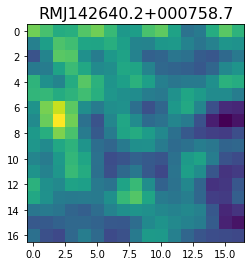

 42%|████▏     | 4207/10099 [06:08<08:05, 12.13it/s]

<class 'pixell.enmap.ndmap'>
[-10.066894    9.912562   32.084633   24.00561   -13.240943  -32.781086
  -4.289676   34.90761    31.071632   -3.1852753 -11.640537   12.112494
  20.932266    4.4848194   8.99737    49.80759    76.9116   ]


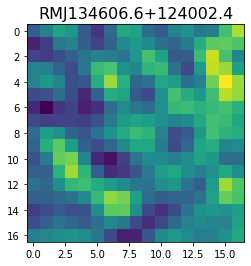

 42%|████▏     | 4209/10099 [06:08<09:05, 10.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-147.81633 -348.4504  -124.90459  138.68771  183.08665  238.16576
  331.76517  261.0382   199.27562  355.4831   400.9414   159.02235
  165.97365  644.72723  880.05023  476.6787   109.25758]


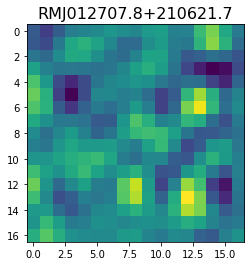

 42%|████▏     | 4211/10099 [06:08<09:52,  9.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-56.71152   -45.01185   -30.961843  -23.95703   -19.194391  -15.467833
 -14.322898   -6.8126554   9.718561   11.83811   -16.954847  -45.526115
 -32.299725    5.991362   14.923082  -11.805799  -25.192844 ]


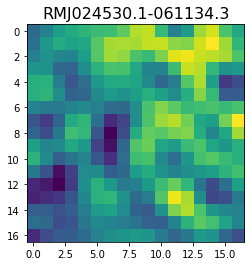

 42%|████▏     | 4217/10099 [06:08<07:42, 12.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 68.24319    25.016867  -30.954975  -51.11192   -41.67243   -36.003796
 -36.24979   -20.881704    2.7353897   1.2897264 -25.834887  -38.55215
 -21.783901  -12.656514  -34.67729   -48.495583  -11.520535 ]


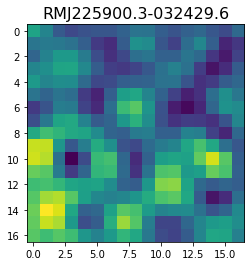

 42%|████▏     | 4225/10099 [06:09<05:42, 17.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[89.0802    69.95317   25.53409    7.5994186 41.021606  79.627266
 73.75778   43.91551   36.832653  46.769733  41.652534  31.856552
 43.069965  51.99906   26.298847   2.0488875 36.63467  ]


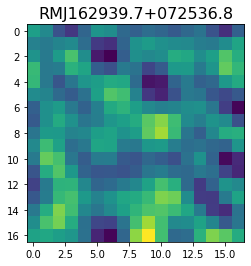

<class 'pixell.enmap.ndmap'>
[-24.85075    21.91333    31.71103    32.288067   50.74439    51.24984
  21.23997     4.09153     5.8264575 -18.705786  -59.427975  -49.243275
   8.55639    33.541573    7.832648   -3.2137687  14.013812 ]


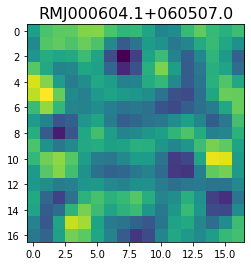

 42%|████▏     | 4228/10099 [06:09<08:11, 11.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 19.020067    3.6663554  -4.8555474  -5.692373  -21.25033   -52.04987
 -65.2964    -44.193157  -16.823212  -14.451632  -28.30451   -32.737373
 -28.876743  -36.1868    -54.57658   -63.871456  -56.259624 ]


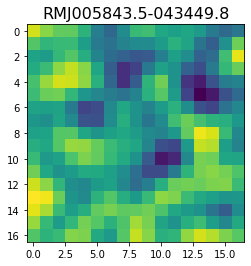

 42%|████▏     | 4230/10099 [06:10<08:52, 11.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-68.49697  -72.82128  -83.73537  -86.29529  -74.52179  -61.57679
 -62.35164  -72.865944 -76.28634  -66.47054  -55.729343 -57.0331
 -65.64836  -64.866165 -48.56997  -31.134346 -30.528051]


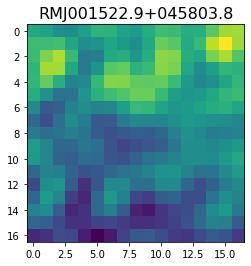

 42%|████▏     | 4232/10099 [06:10<10:13,  9.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[194.75063  254.463    216.30708  177.35439  186.13165  155.70897
  55.252625  10.04229   86.13852  148.95613   83.6698    -4.908519
  26.961973 125.064064 145.91457   83.2199    30.066746]


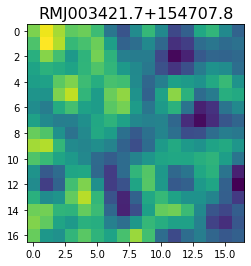

 42%|████▏     | 4234/10099 [06:10<11:03,  8.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-72.72267  -98.36161  -47.456272  32.29305   87.52983  128.44466
 178.22762  192.46066  113.82052  -10.863549 -65.22828  -19.804207
  37.567745  40.51034   21.719908  26.84631   38.4057  ]


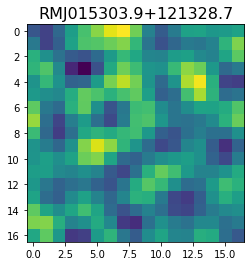

 42%|████▏     | 4236/10099 [06:10<11:49,  8.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -83.55628   -65.7256    -85.29603  -119.47409  -125.06764   -99.883835
  -84.911705 -102.39687  -124.66086  -121.85918  -109.78426  -119.284904
 -141.05667  -140.93285  -119.07415  -111.323685 -131.12357 ]


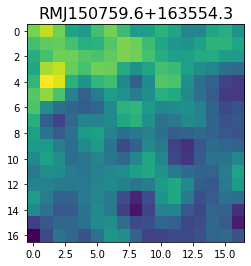

 42%|████▏     | 4241/10099 [06:11<09:26, 10.34it/s]

<class 'pixell.enmap.ndmap'>
[-61.81639   -38.73301   -35.429363  -34.19486   -19.845402   -1.0332897
  -0.6503324 -27.505354  -64.731705  -83.36057   -62.04861    -3.131216
  59.93207    83.10334    57.567238   25.923788   32.75277  ]


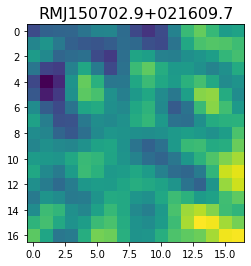

<class 'pixell.enmap.ndmap'>
[ 97.182465   44.833633    7.359829   28.68428    40.471592  -11.253982
 -54.46086    -3.139883   83.8774     76.50271   -23.545393  -78.658844
 -19.838274   61.92481    63.474533    7.5225053 -26.151182 ]


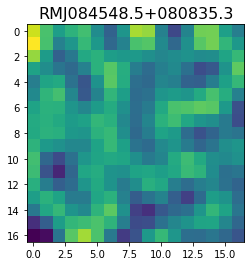

 42%|████▏     | 4243/10099 [06:11<12:59,  7.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[138.50015  149.1338   119.06762   91.834694  91.87194   94.5069
  79.283485  69.24596   88.9806   119.846535 130.3818   122.64196
 115.04322  104.69806   82.6351    66.28425   78.61772 ]


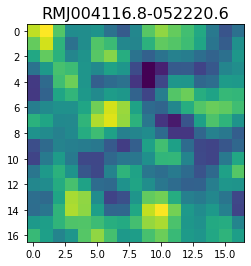

 42%|████▏     | 4248/10099 [06:12<10:15,  9.50it/s]

<class 'pixell.enmap.ndmap'>
[ 7.5636215e+00 -8.3071699e+00 -1.4218194e+01 -4.8020385e-02
 -1.3663524e+01 -6.5070824e+01 -8.3026215e+01 -2.8968603e+01
  2.5705929e+01  8.8561792e+00 -3.8136345e+01 -3.6840332e+01
 -9.3572992e-01  2.8025383e-01 -3.7209003e+01 -5.5954048e+01
 -3.4550388e+01]


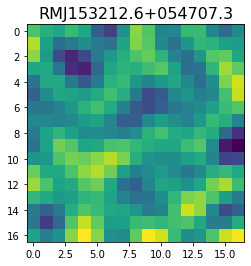

<class 'pixell.enmap.ndmap'>
[ -30.77216    -28.775642   -21.389748   -21.212673   -31.951738
  -28.098211     1.6048213   28.059454    16.552862   -42.47064
 -128.44092   -179.46815   -124.354164    10.890671    80.31961
   -6.197524  -137.96225  ]


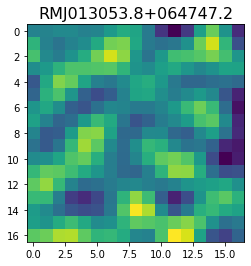

 42%|████▏     | 4250/10099 [06:12<12:51,  7.58it/s]

<class 'pixell.enmap.ndmap'>
[156.72221   115.07961   106.142784  120.444305  103.20176    49.510906
   1.3806754 -10.495653    7.639224   29.826368   50.667736   91.80276
 143.17755   149.30774   107.44393    99.78854   153.83496  ]


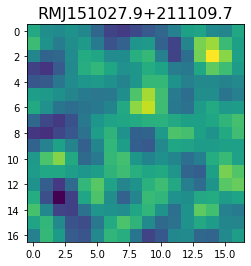

 42%|████▏     | 4251/10099 [06:12<14:10,  6.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-183.33156  -149.55954   -47.681904  -19.787136 -108.0967   -211.26834
 -241.86517  -214.69423  -184.1214   -179.75705  -200.36615  -216.2495
 -196.0181   -161.5252   -168.69196  -209.13396  -205.55316 ]


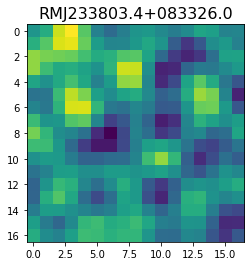

 42%|████▏     | 4258/10099 [06:13<08:53, 10.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-168.65843   -154.63867    -64.919426   -48.54135   -115.17171
 -136.39343    -76.99605    -34.598667   -55.14683    -71.120995
  -29.838036    34.554535    58.299713     7.8805594  -91.76388
 -153.73009   -111.99034  ]


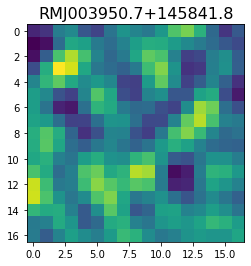

 42%|████▏     | 4260/10099 [06:13<09:29, 10.25it/s]

<class 'pixell.enmap.ndmap'>
[-30.369755    -0.23260686  -5.2479763   -5.4338994   23.00524
  41.561428    28.64024     26.937208    61.006985    82.266205
  53.922367    17.534895    11.958642     1.342707   -43.33094
 -64.88496    -10.057874  ]


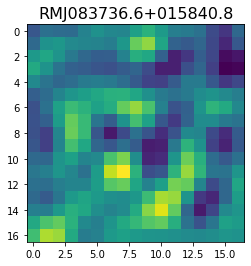

 42%|████▏     | 4262/10099 [06:13<10:28,  9.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-114.35388  -110.77141   -85.9737    -67.82015   -81.88423  -116.93824
 -134.0664   -115.903496  -92.54315  -101.180565 -131.19046  -138.9042
 -114.96468   -98.96014  -115.310486 -134.21187  -122.28915 ]


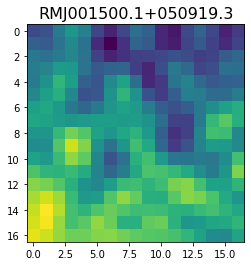

 42%|████▏     | 4265/10099 [06:14<09:52,  9.85it/s]

<class 'pixell.enmap.ndmap'>
[161.12843  127.68296  161.88283  212.92612  179.19559  124.46861
 155.3837   190.90555  110.68282   23.25426  109.343506 288.5104
 322.5106   191.51042  104.198654 160.09822  234.86183 ]


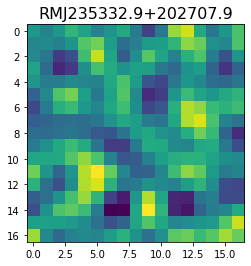

 42%|████▏     | 4266/10099 [06:14<12:34,  7.74it/s]

<class 'pixell.enmap.ndmap'>
[-52.108635  24.894556  95.74322  122.18605  117.97935  101.93231
  62.58959   17.838844  20.060146  50.060566  22.711699 -45.08237
 -21.10344  110.51284  174.3897    69.09911  -60.78219 ]


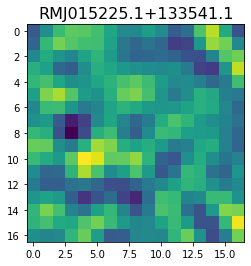

 42%|████▏     | 4267/10099 [06:14<14:29,  6.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-63.235962 -76.499    -86.73783  -89.486885 -74.907364 -45.553352
 -25.978304 -36.08097  -63.465515 -79.46667  -75.52575  -66.565186
 -63.879665 -62.760098 -56.025223 -45.110607 -35.97387 ]


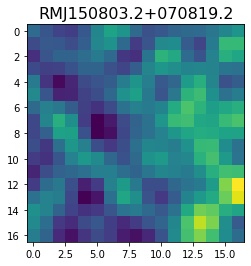

 42%|████▏     | 4270/10099 [06:14<12:31,  7.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 62.861073  56.296837  42.90185   55.24866   71.665344  53.291897
  26.591204  48.950302 104.96976  120.646645  80.125656  48.53227
  69.26566  109.57711  124.656105 117.73145  117.44537 ]


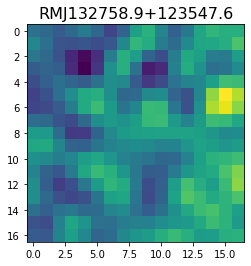

 42%|████▏     | 4277/10099 [06:15<08:08, 11.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.57779    37.277763   83.9615    100.50456    43.97418   -19.527706
   3.8293803  87.26278   117.04616    71.49815    49.307835   93.20293
 113.60851    53.65767     7.0703225  65.89635   151.441    ]


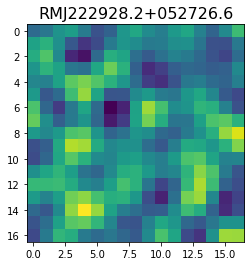

 42%|████▏     | 4280/10099 [06:15<08:33, 11.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[151.2436   162.51202  152.7746   134.19449  121.04285  119.70846
 130.79231  146.54308  151.89026  139.91765  122.65342  117.926285
 129.82689  149.53342  169.44113  185.96184  191.19821 ]


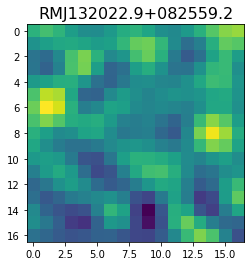

 42%|████▏     | 4283/10099 [06:15<08:46, 11.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[41.60783   37.28273   28.800314  31.38044   43.684296  51.798187
 43.053825  18.074781  -3.5587747  1.7649393 31.625046  55.153618
 52.64701   40.49844   39.622513  39.26261   18.476036 ]


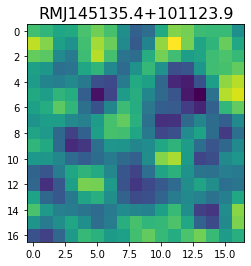

 42%|████▏     | 4290/10099 [06:16<06:52, 14.09it/s]

<class 'pixell.enmap.ndmap'>
[157.86967  114.3508   109.054016 166.58745  242.47598  259.10995
 203.13867  149.84923  165.34665  220.79594  243.42023  219.73831
 192.79955  180.27666  163.71117  150.65247  171.96509 ]


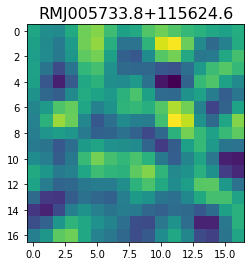

 42%|████▏     | 4292/10099 [06:16<07:39, 12.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-129.22609  -129.73157  -137.10355  -129.93518  -112.74935  -115.888245
 -140.30312  -149.14296  -125.27582   -95.938545  -88.73543   -97.3664
 -100.84055   -90.182396  -69.95644   -52.286057  -50.08977 ]


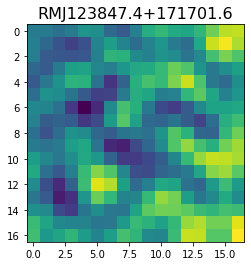

 43%|████▎     | 4297/10099 [06:16<06:53, 14.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -71.496025    22.086872    93.84804     72.89969    -29.030672
 -102.39638    -73.80531     -6.5627522    8.585786    -5.8858333
   10.285182    14.917449   -57.01272   -132.53119    -86.39793
   44.05761     99.71433  ]


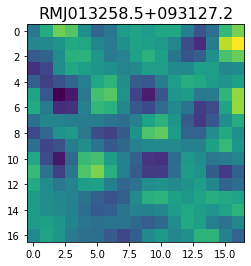

 43%|████▎     | 4300/10099 [06:16<07:16, 13.28it/s]

<class 'pixell.enmap.ndmap'>
[ 35.530315    23.727415    10.500854     6.7428226   11.156728
  12.92189      4.1451297  -12.113678   -24.135855   -21.407019
  -5.0876117   11.140752    14.26547      6.225584     0.46968868
   3.553309     6.486873  ]


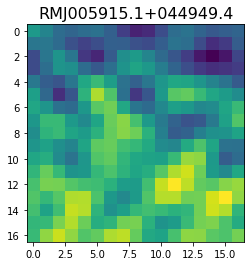

<class 'pixell.enmap.ndmap'>
[ 33.257473    2.3811755  27.78893    44.365723    3.3970234 -60.860893
 -91.460655  -76.45968   -41.238255  -13.134985   -5.5578556 -11.770688
  -9.9734335   8.889589   23.089323    5.098678  -42.574406 ]


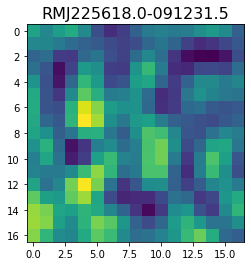

 43%|████▎     | 4302/10099 [06:17<09:52,  9.79it/s]

<class 'pixell.enmap.ndmap'>
[ 20.742264 -59.847992 -65.61175   13.476004  63.41162   37.861057
  35.774025 114.90063  172.40196  119.21088   41.241993  54.47752
 111.36154   94.642715  11.989713 -45.527653 -61.99113 ]


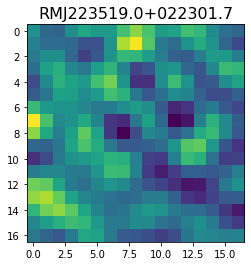

 43%|████▎     | 4304/10099 [06:17<10:34,  9.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-183.42313  -136.32184   -61.16286   -14.984378  -49.26157  -124.68152
 -134.1572    -57.44881   -18.772257 -107.006294 -217.59883  -198.5864
  -87.14625   -43.864     -96.345795 -123.38909   -76.367424]


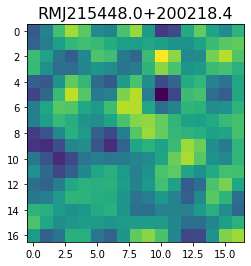

 43%|████▎     | 4306/10099 [06:17<11:21,  8.50it/s]

<class 'pixell.enmap.ndmap'>
[18.591606 13.080616 29.989618 53.009293 60.701447 59.77892  67.2306
 77.1728   70.51924  47.638264 32.10174  44.063126 75.69789  91.77215
 63.946514 13.129455 -1.968444]


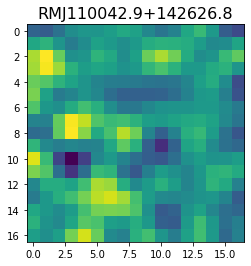

 43%|████▎     | 4307/10099 [06:18<14:11,  6.80it/s]

<class 'pixell.enmap.ndmap'>
[155.95009  159.86075  122.30203   78.546394  60.394573  80.14708
 123.348625 154.72554  158.80571  160.39638  176.10863  178.34898
 146.5288   112.0196   104.562096 100.40376   75.30573 ]


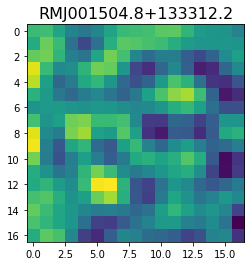

 43%|████▎     | 4308/10099 [06:18<16:11,  5.96it/s]

<class 'pixell.enmap.ndmap'>
[140.94183  128.46129  113.188614 121.38127  151.55615  167.79398
 141.80894   91.473114  64.357315  83.97969  124.716034 144.53606
 130.79512  103.60241   84.73515   80.66342   91.01478 ]


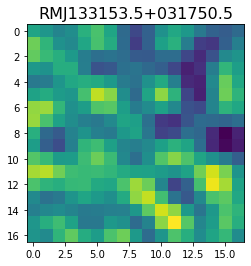

 43%|████▎     | 4309/10099 [06:18<18:12,  5.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  46.309677     8.855414   -24.59579     22.554348    77.2914
   28.33061    -75.2679     -98.61213    -39.464474   -13.945942
  -61.327385  -110.337204  -115.46405    -97.41696    -68.16442
  -25.562784    -0.6799077]


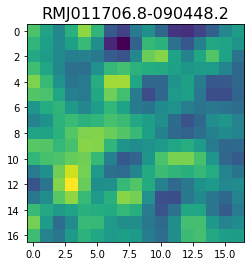

 43%|████▎     | 4313/10099 [06:19<12:49,  7.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[43.981777  54.011696  34.2611    12.07696   13.997809  29.02188
 30.04687   16.411182  10.861456  20.148315  24.492693  10.968068
 -3.9527776  2.5088093 26.852724  44.74398   43.81213  ]


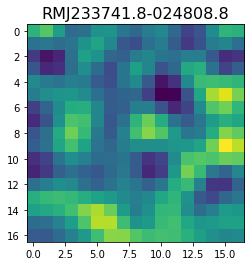

 43%|████▎     | 4318/10099 [06:19<09:48,  9.83it/s]

<class 'pixell.enmap.ndmap'>
[ 92.796745  29.366653  12.276263  57.07638  100.20504   97.392235
  73.35411   62.754387  59.56533   47.578346  36.085625  38.976456
  49.3762    56.178253  62.299603  70.67171   71.70515 ]


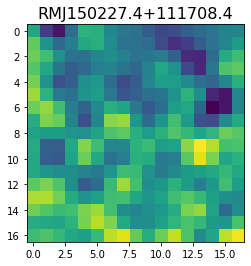

 43%|████▎     | 4319/10099 [06:19<11:45,  8.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-2.5542037 26.469896  45.734886  49.17952   53.63555   60.932903
 56.01077   43.378456  47.77536   69.03323   73.75096   48.2426
 24.122778  29.814165  50.540062  62.229877  72.07047  ]


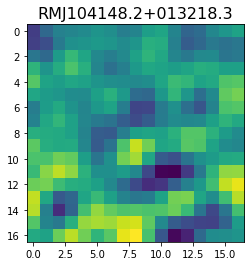

 43%|████▎     | 4322/10099 [06:20<11:13,  8.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -17.327812    33.791916     3.8589468  -82.55106   -130.48947
 -103.9967     -75.77106   -106.60538   -137.44507    -84.49488
    8.128478    25.894886   -32.451496   -60.54574    -28.567694
  -17.687828   -53.350918 ]


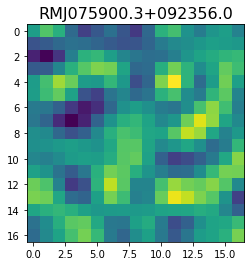

 43%|████▎     | 4324/10099 [06:20<11:37,  8.28it/s]

<class 'pixell.enmap.ndmap'>
[ -62.815907   -31.831951    -1.2168754   12.134435    34.01019
   50.91676      4.3083863  -91.15752   -122.83291    -45.772068
   21.170956   -35.141335  -137.76613   -131.34058    -21.698711
   40.748062    -4.5870104]


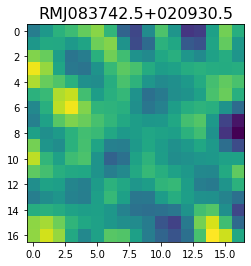

 43%|████▎     | 4325/10099 [06:20<13:27,  7.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   3.8256218  -83.299835  -220.72269   -175.80312     14.712297
  113.91849     56.527306    -4.8392634   21.90598     68.57214
   62.245632     4.9512324  -77.90061   -141.14076   -119.60104
  -23.26291     37.343594 ]


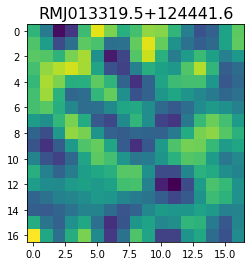

 43%|████▎     | 4328/10099 [06:20<12:07,  7.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[44.52092  29.8314   43.964855 53.885178 47.590725 48.228275 62.45031
 59.679535 29.542048 15.464788 49.681377 91.60229  82.315994 35.0756
 14.531867 38.156185 56.855556]


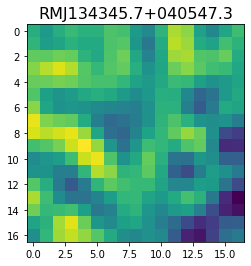

 43%|████▎     | 4332/10099 [06:21<10:17,  9.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -84.7679    -218.51549   -216.71013   -126.18924    -37.564495
  -24.714832   -92.667625  -112.87421      2.3732858   94.65742
    5.7586308 -100.110115   -24.515968    62.90704    -52.827732
 -174.29834    -45.337353 ]


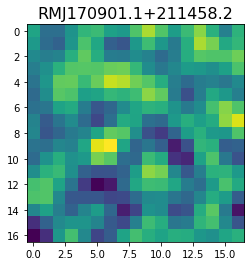

 43%|████▎     | 4338/10099 [06:21<08:07, 11.82it/s]

<class 'pixell.enmap.ndmap'>
[-112.66632  -246.5772   -196.84747    44.31209   114.468445  -68.621056
 -242.70248  -353.25107  -513.46155  -535.8631   -198.15633   196.52464
  214.34862    20.55272    49.39917   223.92383   170.89133 ]


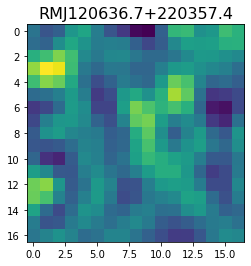

 43%|████▎     | 4345/10099 [06:22<06:30, 14.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-125.42358 -137.67429 -144.98204 -161.4296  -179.64975 -169.60973
 -132.82741 -128.29121 -203.87193 -310.40317 -335.67984 -244.29597
 -137.47272 -131.966   -214.03856 -270.2288  -242.01111]


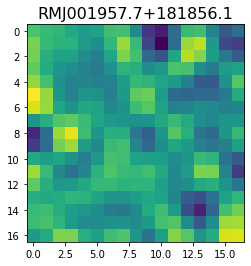

 43%|████▎     | 4352/10099 [06:22<05:34, 17.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-140.5138   -134.1937   -123.35173  -139.41008  -174.73401  -189.97774
 -157.2278    -88.75041   -27.758364  -12.798628  -47.57494  -102.4309
 -140.08951  -137.73618   -97.95521   -54.197693  -53.036964]


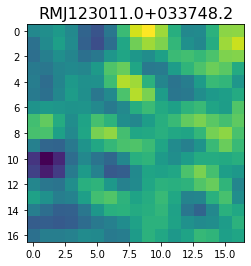

 43%|████▎     | 4359/10099 [06:22<05:35, 17.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -6.3683624    5.1391053  -19.080568   -49.085136   -56.495346
 -51.46366    -43.52222    -22.736414     0.42510173  -9.033791
 -50.7734     -72.558975   -40.295193    13.147357    35.09673
  19.733908     1.6109271 ]


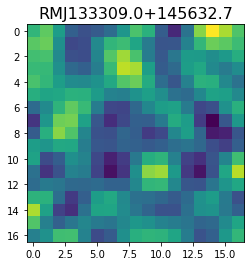

 43%|████▎     | 4369/10099 [06:23<04:15, 22.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 28.614344    4.0196342 -11.087953   -3.968018   23.839315   38.223717
  13.351923  -15.588926    0.9858513  37.827457   28.36493   -17.263723
 -19.220646   36.54331    67.84914    30.36764   -13.283304 ]


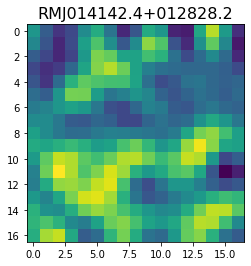

 43%|████▎     | 4373/10099 [06:23<04:50, 19.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[61.05263  55.38913  58.658985 65.778564 64.25928  58.753654 62.5858
 72.96109  75.617256 68.94097  64.57994  67.30982  71.13855  73.73925
 79.23312  86.05051  85.983376]


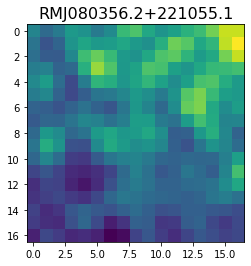

 43%|████▎     | 4376/10099 [06:23<05:27, 17.46it/s]

<class 'pixell.enmap.ndmap'>
[ -46.63814   -52.539165 -103.58486  -132.25146  -127.02124   -97.221146
  -34.32864    22.881748  -10.880196 -135.25697  -236.40715  -244.57716
 -212.06625  -194.57245  -173.6407   -137.67253  -124.05951 ]


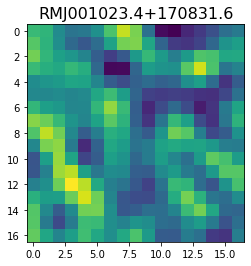

<class 'pixell.enmap.ndmap'>
[ -66.25936    -2.951342   59.354122  144.944     185.05457   -37.113625
 -341.11667  -239.55759   203.2599    371.7756     86.80099  -191.84488
 -175.33871   -10.739442  179.90042   357.08      347.20935 ]


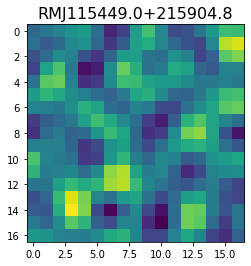

 43%|████▎     | 4379/10099 [06:24<07:34, 12.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-129.39244  -146.73802  -115.31479  -111.07639  -133.68903  -118.37485
  -91.05549  -119.15904  -155.31454  -120.873764  -71.66858   -95.35009
 -138.91727  -112.97317   -57.14225   -45.99295   -52.21787 ]


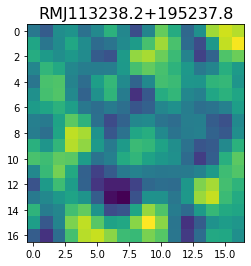

 43%|████▎     | 4383/10099 [06:24<07:31, 12.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-20.965324  -28.702663  -44.304127  -52.826416  -34.33965    -6.5256057
  -5.58093   -26.389416  -32.035522  -20.184666  -23.152056  -41.245697
 -38.453407  -12.628565   -7.035582  -36.496758  -60.28219  ]


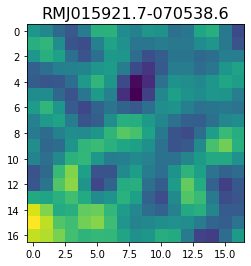

 43%|████▎     | 4386/10099 [06:24<07:50, 12.15it/s]

<class 'pixell.enmap.ndmap'>
[85.172165 97.10683  97.16849  77.144264 44.31431  17.26567   8.048932
 14.07528  25.230503 30.460371 21.109978  0.766408 -9.961828  6.108322
 36.452248 48.856163 30.924715]


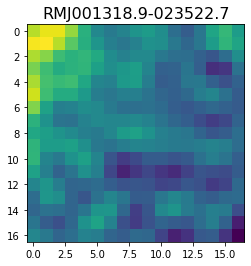

 43%|████▎     | 4388/10099 [06:25<09:09, 10.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -14.153827  -57.381344  -96.95627   -36.992447   50.53656     7.637441
 -140.10065  -198.51167  -100.09267    17.756527   50.221783   36.424305
    5.858831  -75.30145  -163.24081  -148.00626   -55.942833]


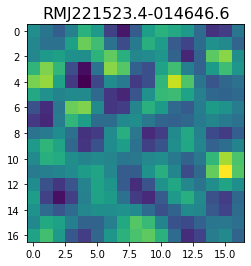

 43%|████▎     | 4390/10099 [06:25<09:41,  9.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -12.413614   26.171463   26.359558  -25.744795 -122.10229  -193.23575
 -182.02023  -127.19895   -94.79474   -80.049805  -59.18601   -65.6957
 -120.48604  -159.59721  -127.32444   -71.60235   -61.78346 ]


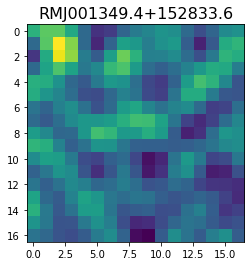

 43%|████▎     | 4392/10099 [06:25<10:30,  9.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -93.90307   -81.5208   -107.667885 -150.1156   -148.03737   -84.65308
  -18.107388  -12.247978  -62.269287 -114.46072  -137.10736  -137.27223
 -124.06756   -98.78948   -77.852196  -83.98342  -109.894554]


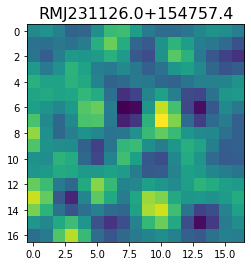

 43%|████▎     | 4393/10099 [06:25<12:20,  7.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 97.09472   80.12255   67.493774  54.818035  43.95355   38.73286
  46.514004  73.30172  101.625656  95.679016  54.71934   34.359337
  73.63246  122.853745  99.06692    7.356967 -52.346504]


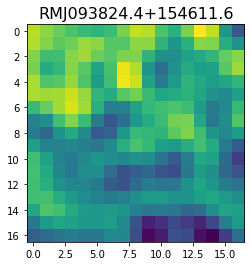

 44%|████▎     | 4398/10099 [06:26<09:10, 10.35it/s]

<class 'pixell.enmap.ndmap'>
[-181.6884   -160.97545   -88.76284   -51.64737  -121.41308  -168.79591
  -25.518093  162.64719   125.033516  -31.030762   14.861355  205.72046
  226.82834   100.52996    83.310005  125.98205    21.523376]


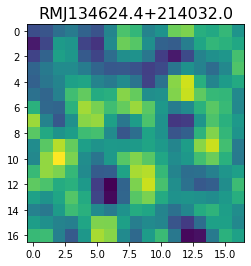

 44%|████▎     | 4400/10099 [06:26<10:06,  9.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.141182   58.13585    40.547512   14.52847     4.6975136   7.95699
   7.4305773   2.442441    3.3948393   8.760571    8.494994    3.7755525
   4.8862176  12.539882   15.56509     5.5061717 -15.59907  ]


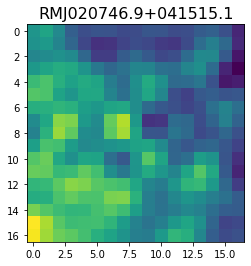

 44%|████▎     | 4402/10099 [06:26<11:12,  8.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-20.062914  -36.43069   -65.08417   -77.26111   -64.28078   -41.09238
 -24.539852  -21.094618  -27.09884   -31.623312  -28.08227   -25.805933
 -35.276558  -42.922173  -25.778584    5.2556734   8.664073 ]


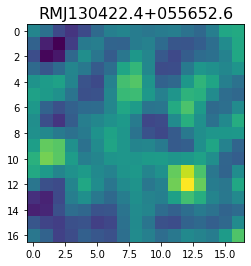

 44%|████▎     | 4408/10099 [06:27<08:00, 11.85it/s]

<class 'pixell.enmap.ndmap'>
[197.85655 208.33868 186.43532 154.2256  152.68448 165.61328 153.25528
 131.99593 147.3267  186.76437 193.34291 158.79501 135.45912 153.01604
 181.50688 186.13307 172.05353]


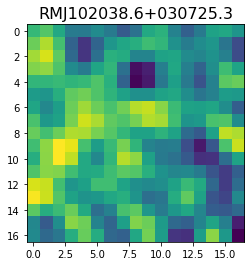

<class 'pixell.enmap.ndmap'>
[111.69618  160.92264  183.46323  165.74619  138.67555  135.86461
 152.99345  161.3462   147.71965  121.843864  95.93642   79.188484
  80.920235  94.49118   91.864914  62.554935  41.12002 ]


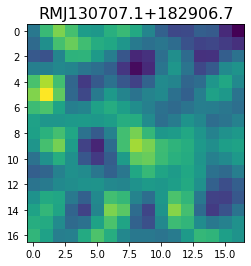

 44%|████▎     | 4410/10099 [06:27<10:42,  8.86it/s]

<class 'pixell.enmap.ndmap'>
[ 73.91993    79.18046    53.460903   34.616882   46.63202    60.723564
  43.538406    9.379686   -6.438402    0.4949524  10.9651     17.594461
  19.285511    4.807874  -20.026     -15.28386    35.816833 ]


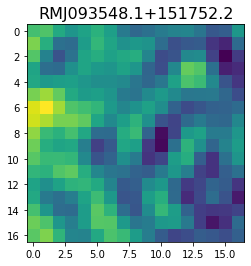

 44%|████▎     | 4411/10099 [06:27<12:10,  7.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  9.41166    -9.193604  -24.199183  -32.320812  -27.46746     3.7827697
  25.440445  -11.833987  -70.41536   -67.74526   -12.003922   17.67099
   8.764457   13.8668375  33.121918   17.850513  -24.148449 ]


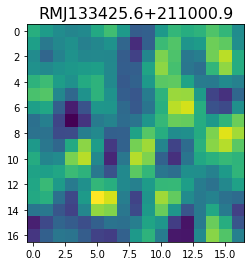

 44%|████▎     | 4414/10099 [06:28<10:44,  8.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-27.086946  -43.23632   -41.085922  -25.851192  -12.30655   -12.388111
 -23.029448  -30.945219  -28.795591  -23.04729   -24.955175  -34.420906
 -36.19102   -18.871367    3.3941598   2.2385254 -25.9727   ]


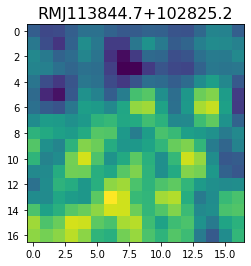

 44%|████▎     | 4416/10099 [06:28<10:49,  8.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 33.306835   23.913637  -12.106016  -28.50341    -4.9854045  26.193348
  32.60915    20.69868     7.670939   -6.822809  -20.75527   -15.1868305
  15.680675   43.956993   40.632053   13.230076   -6.1001716]


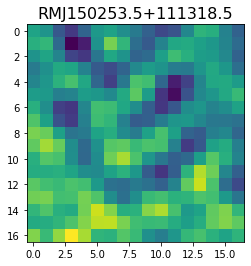

 44%|████▍     | 4421/10099 [06:28<08:15, 11.45it/s]

<class 'pixell.enmap.ndmap'>
[218.31029  252.54193  318.0072   296.26974  181.02318  100.082184
 139.51337  229.97595  253.52777  199.67133  151.86032  159.5896
 197.36911  234.51823  269.18427  285.0265   246.66673 ]


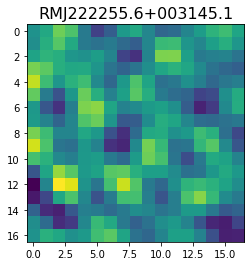

 44%|████▍     | 4423/10099 [06:28<09:20, 10.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[149.17899  138.12253  147.62909  182.24922  148.4059    50.19971
  13.680405  73.86487  125.4758   118.216156 117.74388  143.97894
 126.627625  56.170834  22.02529   63.66415  110.31458 ]


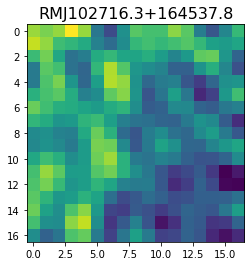

 44%|████▍     | 4426/10099 [06:29<08:59, 10.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.74309   -13.703882  -19.218401  -15.464532   -7.3699436  -5.5907745
  -4.0364566   5.8902416  10.84877    -5.494289  -30.719858  -41.036175
 -39.3571    -45.048668  -56.94164   -60.298695  -60.83293  ]


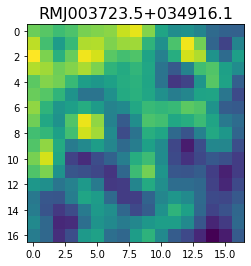

 44%|████▍     | 4429/10099 [06:29<08:56, 10.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 97.519615  11.280018 -35.226017  -4.123864  49.09571   69.31621
  56.46027   38.425533  37.7404    57.976486  73.21944   47.284164
 -11.720365 -39.85171    8.762958  94.31383  130.5616  ]


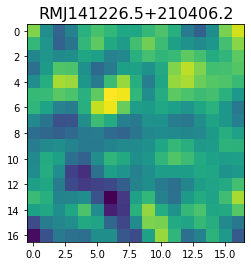

 44%|████▍     | 4431/10099 [06:29<09:31,  9.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-44.714638 -15.783035  45.66003   64.527725  28.343409 -12.629783
 -26.976088 -22.387068  -4.994742  25.874237  52.118145  50.33956
  27.71835   13.369096  17.008432  20.823027  12.488749]


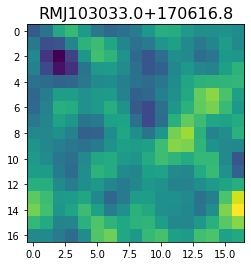

 44%|████▍     | 4435/10099 [06:29<08:21, 11.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 97.23556  111.99185  121.210365 105.57828   75.76474   63.03938
  78.49855   99.6018   103.07623   95.385574  97.32446  108.11168
 104.5857    78.34809   54.844788  61.757015  89.270256]


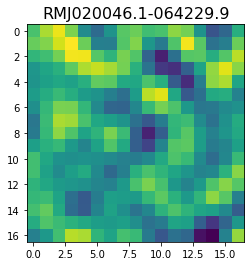

 44%|████▍     | 4437/10099 [06:30<09:03, 10.41it/s]

<class 'pixell.enmap.ndmap'>
[115.11805  121.4645   140.75812  151.62086  121.27238   45.6955
 -21.352594 -11.12235   79.036095 174.48663  207.47473  186.01627
 158.28943  137.41116  101.768005  57.762615  50.960533]


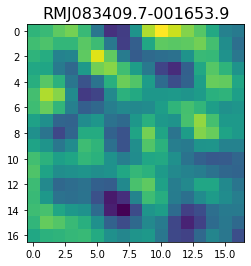

<class 'pixell.enmap.ndmap'>
[-125.25238   -88.3653    -19.175684   24.481241   46.516163   68.33501
   38.04766   -94.8016   -233.49905  -212.39806   -39.58587    88.42625
   58.463066  -21.779125  -24.14168    13.438349    4.322484]


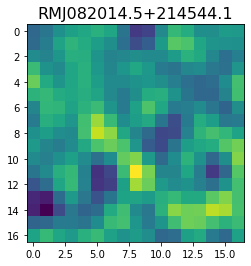

 44%|████▍     | 4439/10099 [06:30<12:53,  7.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-157.79556  -118.864296 -116.724014 -164.82063  -187.0664   -133.4269
  -78.22415  -108.87366  -179.64044  -187.30138  -139.51878  -127.14269
 -165.52386  -183.01936  -149.15929  -109.882576 -103.19072 ]


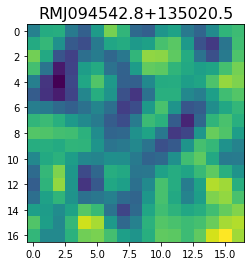

 44%|████▍     | 4444/10099 [06:30<09:32,  9.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.296927   -3.4268115 -32.15634   -43.45556   -17.898254   19.435226
  22.706066  -12.771945  -39.842815  -24.438787   10.110625   27.535763
  35.250126   59.61053    88.90709    86.43531    50.36022  ]


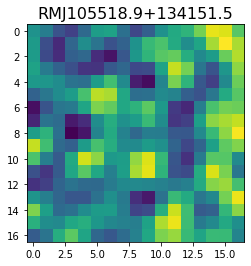

 44%|████▍     | 4449/10099 [06:31<07:59, 11.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[141.43303   195.84927   168.18433    97.88305    36.420982   10.699935
  12.67579    14.138994    5.6999316  14.640793   60.008297  105.95557
 100.066315   46.307903   -6.9152207 -40.97328   -74.17226  ]


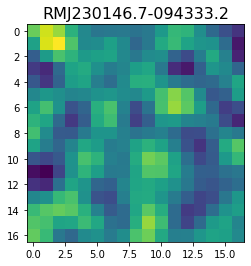

 44%|████▍     | 4451/10099 [06:31<08:47, 10.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-200.33878    -85.94447      5.900982   -10.772642   -26.618908
    5.5283065  -12.747827   -67.8814     -26.985138    68.61113
   38.35973   -106.79928   -186.98798   -160.85825   -119.64423
  -68.74909     22.201332 ]


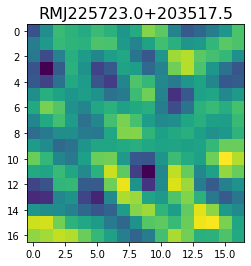

 44%|████▍     | 4457/10099 [06:31<07:02, 13.36it/s]

<class 'pixell.enmap.ndmap'>
[  73.52783    -14.325365   -63.87616    -51.227127   -66.19759
 -113.2107    -100.51838    -17.913578    41.63959     35.08346
    7.5783443   -8.346381   -16.742823    -6.8254576   25.4923
   39.732277    11.468674 ]


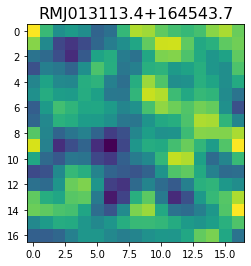

 44%|████▍     | 4459/10099 [06:32<07:55, 11.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 32.98056    17.583681   -8.962545  -13.2433     -7.580093  -17.103043
 -36.932602  -49.390076  -49.643604  -38.96557   -23.00352   -19.610786
 -35.653397  -44.275356  -24.459164   -6.0721455 -25.67556  ]


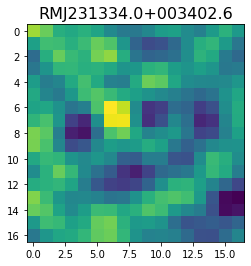

 44%|████▍     | 4461/10099 [06:32<08:47, 10.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-40.05862  -33.5206   -20.411789 -16.918869 -25.247808 -31.932495
 -17.157806  23.83882   62.419804  62.418163  33.13192   24.934244
  59.338036 100.22453  110.79471   99.077255  86.70384 ]


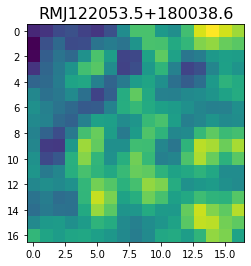

 44%|████▍     | 4465/10099 [06:32<08:05, 11.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-44.875988   -37.158432   -21.41967     -5.079065     6.7648854
   9.59432      0.43093735 -16.304764   -31.253834   -39.744934
 -41.548546   -35.855843   -28.649626   -35.646362   -58.081615
 -65.03218    -28.08205   ]


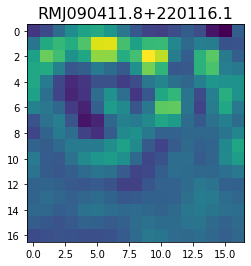

 44%|████▍     | 4471/10099 [06:32<06:47, 13.81it/s]

<class 'pixell.enmap.ndmap'>
[-242.5845   -258.53394  -130.63757   -67.080444 -159.18907  -256.31226
 -228.29071  -148.55606  -133.97928  -172.33408  -199.53078  -211.57466
 -216.62662  -189.81802  -144.26915  -145.49323  -201.03528 ]


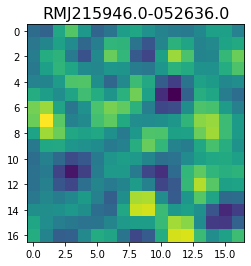

<class 'pixell.enmap.ndmap'>
[ 2.8802759e+01  7.6011455e-01 -1.1249374e+00  1.7448799e+01
  1.3165134e+01 -2.5418879e+01 -5.5078598e+01 -4.0968010e+01
 -6.9138031e+00  8.0182925e-03 -2.7860458e+01 -5.3908115e+01
 -4.5772297e+01 -1.5255573e+01 -9.4629984e+00 -5.8830929e+01
 -1.3204298e+02]


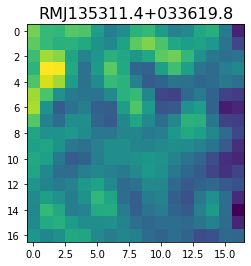

 44%|████▍     | 4473/10099 [06:33<09:54,  9.47it/s]

<class 'pixell.enmap.ndmap'>
[176.30151  193.85245  216.811    184.08679  136.12218  141.31926
 195.12274  241.08801  239.48302  186.27997  112.966995  80.55255
 120.79214  179.74408  178.80815  127.82596  107.1385  ]


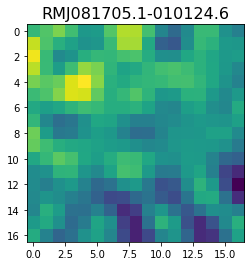

<class 'pixell.enmap.ndmap'>
[ 81.96809   57.05786   60.09868   62.768505  31.447887  15.109763
  48.467518  62.739925   9.519266 -27.116842  31.435051 107.608955
  92.417854  31.806446  43.355385 117.336716 142.95341 ]


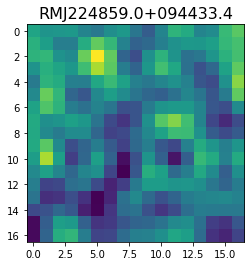

 44%|████▍     | 4475/10099 [06:33<12:25,  7.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-4.3038867e-02 -2.5774393e+01 -3.8590782e+01 -3.6179272e+01
 -8.9519129e+00  2.0414207e+01  5.9718189e+00 -5.5870770e+01
 -1.1817945e+02 -1.4993768e+02 -1.5613481e+02 -1.2765076e+02
 -4.3006329e+01  6.1871330e+01  1.0055661e+02  4.5081261e+01
 -3.6684471e+01]


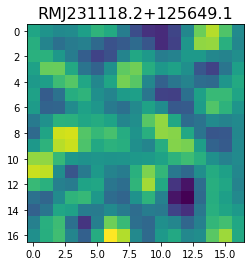

 44%|████▍     | 4478/10099 [06:34<11:46,  7.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-47.891975 -68.01123  -62.194057 -33.665367 -31.522646 -67.180275
 -97.24633  -94.25087  -75.075806 -57.49082  -41.029682 -30.839563
 -37.0931   -53.79343  -68.780045 -81.770454 -89.58264 ]


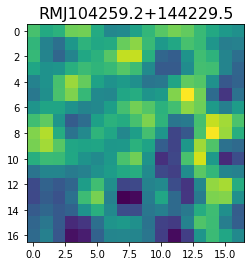

 44%|████▍     | 4481/10099 [06:34<10:54,  8.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-226.28777   -263.37006      2.6565027  213.24692    127.50031
  -15.773883    12.671173    82.51625    102.75264    212.76335
  344.54987    196.02661   -156.85683   -243.0889      35.1473
  229.03062     83.46972  ]


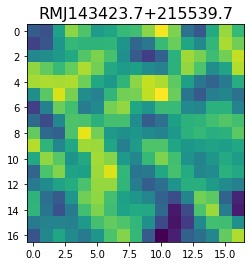

 44%|████▍     | 4483/10099 [06:34<10:57,  8.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[143.32793   98.90181   90.34447  118.06655  127.63766   98.36276
  69.6009    72.70442   83.55015   66.54185   34.03523   28.333017
  57.34403   81.286995  66.974236  29.738573   8.041927]


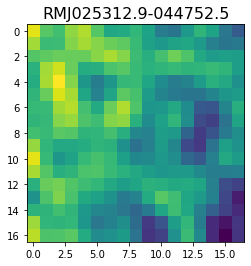

 44%|████▍     | 4487/10099 [06:35<09:11, 10.17it/s]

<class 'pixell.enmap.ndmap'>
[-198.93248   -96.72702   -34.225494   -8.552361    4.932104  -33.191868
 -123.3491   -184.49832  -173.66484  -130.92728   -90.87235   -64.8538
  -88.80991  -160.15419  -175.62245   -77.76375     5.685415]


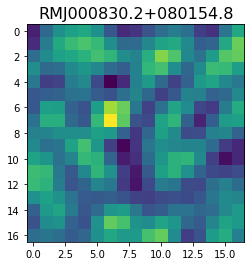

 44%|████▍     | 4489/10099 [06:35<09:37,  9.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 83.39359    58.04658    17.533798   15.173026   53.13822    76.52459
  49.939507    2.6632268 -16.10957     2.8799155  30.122206   37.984222
  25.027777    9.441537    6.7608237  12.630872   10.636732 ]


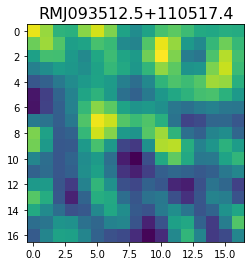

 45%|████▍     | 4496/10099 [06:35<06:51, 13.60it/s]

<class 'pixell.enmap.ndmap'>
[ 26.14475    12.740348    3.2817423  25.6154     58.139248   56.590675
  17.822603  -17.11492   -16.56719    10.391447   34.37286    40.090744
  36.157097   37.008175   43.005573   44.68587    40.845844 ]


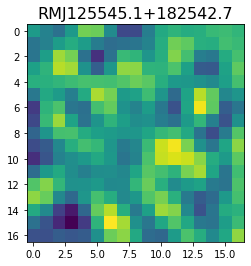

 45%|████▍     | 4498/10099 [06:35<07:39, 12.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 27.723614   -17.169432   -32.446514    -5.392192   -16.90695
 -75.05952    -91.094475   -39.07223      3.1994264   -1.5177568
   1.8109285   35.39529     41.74768      0.46485877 -28.810074
 -14.843677     3.1096153 ]


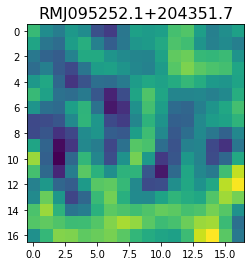

 45%|████▍     | 4500/10099 [06:36<08:30, 10.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[158.79695  168.39072  166.05107  138.33711  119.2472   131.23663
 141.4676   117.86442   92.095055 110.152885 150.27356  158.61398
 143.52548  155.86224  190.52005  193.88141  165.39722 ]


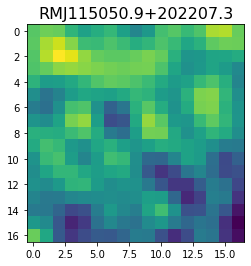

 45%|████▍     | 4502/10099 [06:36<09:16, 10.05it/s]

<class 'pixell.enmap.ndmap'>
[249.6159   241.22255  212.5076   209.226    234.1483   238.0418
 211.0396   218.21086  289.88034  335.80243  265.31866  152.84564
 148.84512  238.04291  251.80466  144.38992   71.647514]


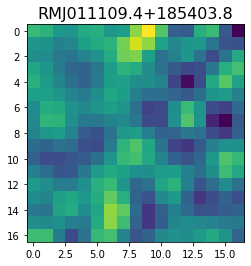

 45%|████▍     | 4503/10099 [06:36<11:14,  8.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[114.365425  91.002625 143.97218  227.62091  250.86221  224.27654
 226.19316  251.17702  219.29633  129.37488   75.46206   95.302925
 119.8696   102.49332   89.61544  121.80824  160.35425 ]


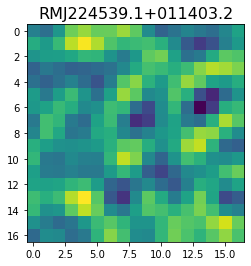

 45%|████▍     | 4509/10099 [06:36<07:42, 12.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-85.99424   -62.49502   -42.74376   -59.128708  -94.47467   -95.554115
 -59.220413  -37.33317   -43.573086  -34.439564   -2.194665    1.9519234
 -32.099102  -42.852135   -8.092339    7.9565406 -29.463078 ]


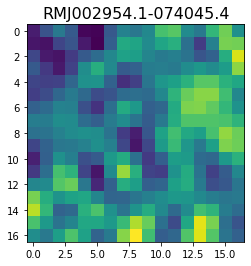

 45%|████▍     | 4512/10099 [06:37<07:45, 12.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[47.19644   58.20711   39.677418  10.928626   0.5127838 12.810876
 23.177046  14.415336   1.6454818  3.8687608 10.249231   2.4948575
 -6.703181   5.755629  26.988056  25.107767   6.134075 ]


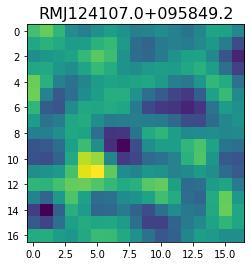

 45%|████▍     | 4516/10099 [06:37<07:19, 12.70it/s]

<class 'pixell.enmap.ndmap'>
[ 48.282623  91.41847  117.81731   95.73156   61.583332  65.00774
  95.28118  106.83976   95.019424  95.09811  115.98491  126.44727
 111.1326    96.08504  105.475655 125.70355  128.53891 ]


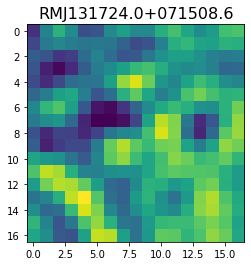

 45%|████▍     | 4518/10099 [06:37<08:03, 11.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[102.56853   120.301186  107.87085    98.86719   148.44864   209.65846
 177.38168    75.88398    52.256695  142.0446    200.20366   129.24654
  24.011684    7.5624514  55.99287    77.34421    59.35932  ]


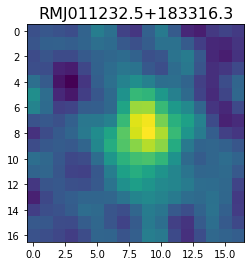

 45%|████▍     | 4522/10099 [06:38<07:53, 11.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   1.441832  -22.58405   -57.01391   -64.18774   -69.8413    -92.809296
 -101.27718   -81.4641    -70.583435  -85.073875  -88.8504    -62.91038
  -41.726948  -55.706894  -88.995    -110.184944 -107.26362 ]


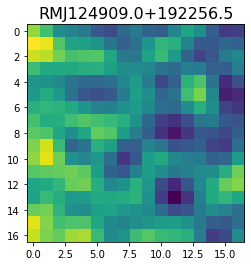

 45%|████▍     | 4527/10099 [06:38<06:53, 13.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -8.871304  -19.215876    3.1408575  41.54962    60.995487   44.70093
 -18.12543   -90.99173   -81.47596    20.87087    81.29229    12.923271
 -78.70835   -70.015526   -5.1169887  21.323267   22.339811 ]


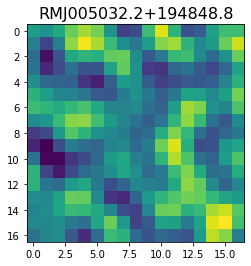

 45%|████▍     | 4530/10099 [06:38<07:13, 12.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[26.423038 20.42294  19.547268 15.7519    9.622658 14.905683 37.234467
 58.40104  55.15766  30.233437 10.653559 13.688236 27.827961 33.51412
 30.504967 32.931232 44.50921 ]


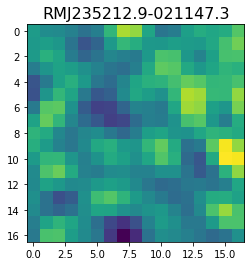

 45%|████▍     | 4535/10099 [06:38<06:39, 13.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-100.38868  -124.351425 -204.1148   -220.51677  -115.67084   -34.443295
 -109.791504 -245.24786  -266.86795  -182.03383  -128.50844  -155.2352
 -208.69128  -256.3323   -276.2556   -215.45058   -96.64219 ]


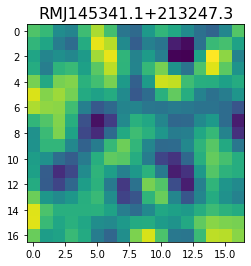

 45%|████▍     | 4539/10099 [06:39<06:53, 13.44it/s]

<class 'pixell.enmap.ndmap'>
[-109.168945 -109.29501   -98.776276  -88.52765   -83.755394  -87.180145
 -101.49022  -122.23583  -134.92073  -128.75896  -112.06929  -105.109116
 -116.11811  -132.6674   -139.6822   -136.87492  -132.03595 ]


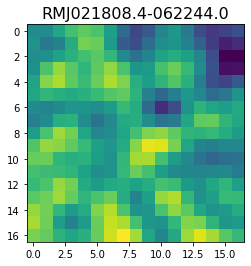

 45%|████▍     | 4541/10099 [06:39<07:59, 11.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 37.815998  35.819286  36.435608  45.683125  49.811295  45.537792
  46.61366   56.091988  56.54037   40.55808   32.11267   58.046238
 108.445    146.22849  152.56236  141.61835  128.90327 ]


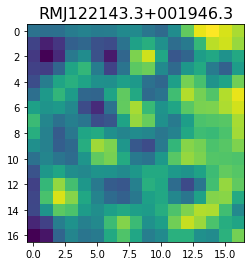

<class 'pixell.enmap.ndmap'>
[  3.2329822 -46.69538   -62.594677  -22.623486    1.2642117 -21.990913
 -38.360912  -11.607521   26.36669    39.679478   29.075447    8.516122
  -2.6042383  18.636816   59.34609    68.74238    34.0724   ]


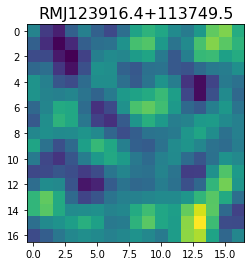

 45%|████▍     | 4543/10099 [06:40<11:46,  7.87it/s]

<class 'pixell.enmap.ndmap'>
[-151.41869  -197.41554  -113.18289   -22.713562  -63.952877 -166.25563
 -201.98833  -179.1478   -143.74701   -80.90358   -24.472157  -66.442604
 -175.93112  -212.59393  -162.03964  -138.47127  -147.809   ]


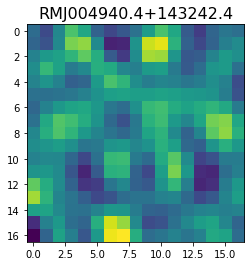

 45%|████▍     | 4544/10099 [06:40<13:08,  7.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  23.014725   -62.23215    -75.10956     22.816345    88.03492
   22.187674   -62.862576   -29.61291     48.64982     11.813515
  -95.618835   -74.006584    90.23047    159.36417     -2.9334035
 -210.40717   -218.66179  ]


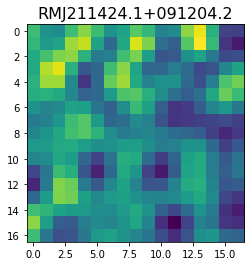

 45%|████▌     | 4549/10099 [06:40<09:43,  9.51it/s]

<class 'pixell.enmap.ndmap'>
[-23.167923    14.296063     7.849298     0.43698275  27.002846
  39.666126    -0.46087602 -47.830177   -53.557747   -41.183647
 -48.141098   -65.520905   -74.11838    -70.364746   -38.804207
  26.253498    71.58787   ]


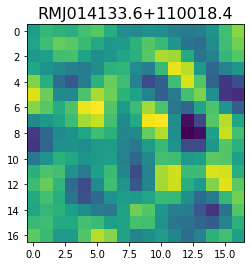

 45%|████▌     | 4550/10099 [06:40<11:21,  8.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-2.7485218 16.36076   35.283688  28.10228   32.639805  57.50093
 51.148575   7.4728074 -9.472649  18.645876  34.92823   19.397423
 21.403454  59.745766  90.04987   84.77349   63.140373 ]


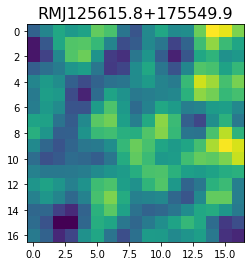

 45%|████▌     | 4553/10099 [06:41<10:29,  8.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-112.68692   -59.34729   -38.414627  -28.133898  -18.964033  -37.81214
  -76.41042   -80.81588   -44.457554  -30.555258  -63.613857  -79.593544
  -34.277344   12.755339  -14.501023  -92.3272   -134.22334 ]


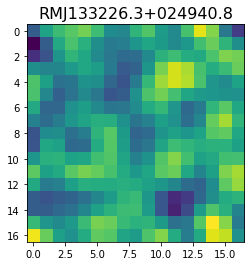

 45%|████▌     | 4556/10099 [06:41<09:55,  9.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-173.4257   -229.78665  -135.64453   -19.84436    11.716852  -38.54238
 -126.02528  -205.25124  -219.3737   -146.62186   -62.13598   -71.483826
 -167.45528  -223.53712  -155.81815   -33.715496    9.744767]


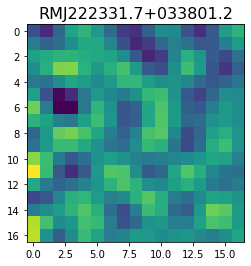

 45%|████▌     | 4559/10099 [06:41<09:26,  9.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-68.127846  -69.13193   -62.78831   -50.172775  -27.400026  -12.89915
 -28.47191   -55.085342  -47.30208     0.7558204  39.793457   29.717892
 -11.03018   -38.609814  -40.09326   -33.99318   -33.191746 ]


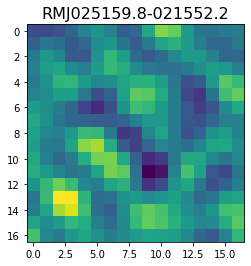

 45%|████▌     | 4561/10099 [06:42<10:51,  8.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  0.41960457   7.3089542  -12.3371525  -35.596043   -45.381016
 -37.200054   -11.326402    18.230131    23.57681     -4.085487
 -39.164745   -56.809887   -57.491066   -44.476753   -15.387571
  10.694896     6.002754  ]


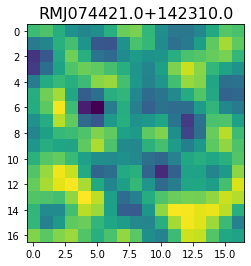

 45%|████▌     | 4563/10099 [06:42<11:17,  8.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-28.553839   -2.8510878   1.3120996 -29.266106  -59.711338  -62.1532
 -48.40797   -37.944416  -31.9065    -32.59324   -50.802094  -75.55328
 -72.5018    -35.83033    -9.792439  -30.356464  -70.79776  ]


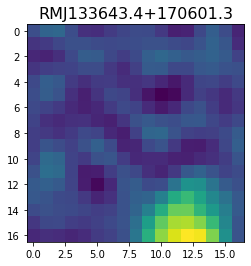

 45%|████▌     | 4565/10099 [06:42<11:38,  7.93it/s]

<class 'pixell.enmap.ndmap'>
[-57.089016 -61.35276  -22.5759     8.680177   4.002418 -15.370946
 -33.92622  -61.500698 -82.14446  -50.91858   20.996168  45.34299
 -17.560823 -74.20625  -26.579844  64.6774    62.10914 ]


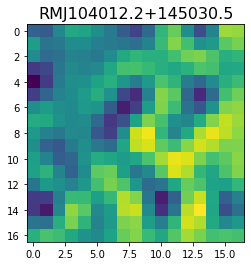

 45%|████▌     | 4566/10099 [06:42<13:24,  6.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -38.405865  -56.97671  -108.553406  -52.281517   87.98221   113.135345
   -5.809622  -66.111206   19.958149   99.92832    69.82815    22.63
   36.723213   50.403442   14.459806  -22.966553  -29.238636]


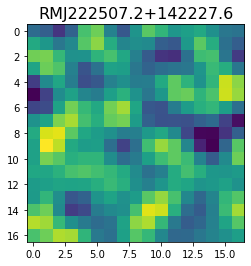

 45%|████▌     | 4571/10099 [06:43<09:39,  9.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-22.170464    6.7751226  20.128536    5.3759165 -20.477863  -38.786114
 -43.777042  -37.265656  -26.980808  -24.268957  -30.252705  -32.136402
 -23.867327  -18.343143  -26.251404  -36.031197  -30.782867 ]


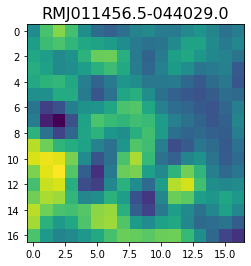

 45%|████▌     | 4574/10099 [06:43<09:03, 10.17it/s]

<class 'pixell.enmap.ndmap'>
[ 62.699078    5.4190755  10.555328   22.606806   36.240242   91.01322
 150.89456   124.13525    21.303461  -27.962795   40.645573  127.407394
 117.72905    48.415848   38.618454  101.94646   129.14035  ]


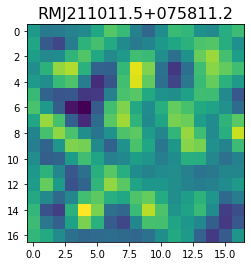

 45%|████▌     | 4575/10099 [06:43<10:45,  8.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 68.54702    37.02417     0.3640148  14.216261   63.055485   77.358505
  27.638494  -37.90501   -65.75287   -63.289375  -60.650288  -49.380978
  -9.512888   32.11447    30.082254   -6.829351  -28.150486 ]


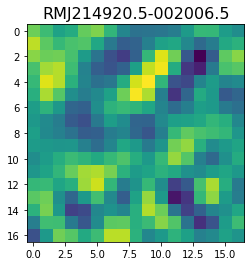

 45%|████▌     | 4578/10099 [06:44<09:41,  9.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -86.603134 -137.32176  -172.08344  -158.83923  -110.08949   -72.623146
  -65.221054  -59.227802  -35.17158   -22.631115  -54.58269  -108.99404
 -133.68906  -116.61826   -94.93861   -97.65177  -112.532684]


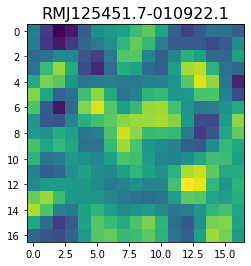

 45%|████▌     | 4580/10099 [06:44<10:04,  9.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-105.99643   -68.02382   -50.58109   -21.089664  -13.262891  -73.56908
 -137.00883  -119.07165   -77.095856 -114.19062  -188.22374  -187.71786
 -132.66861  -131.16698  -191.27461  -227.42853  -209.08899 ]


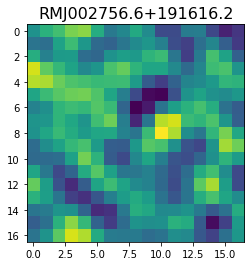

 45%|████▌     | 4582/10099 [06:44<10:22,  8.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -56.077026  -76.26743  -144.89917  -147.13777  -100.181076 -100.93256
 -106.50507   -13.926915   92.73522    39.775074 -123.449554 -176.60556
  -79.87582    -8.560093  -33.23242   -30.131992   56.046   ]


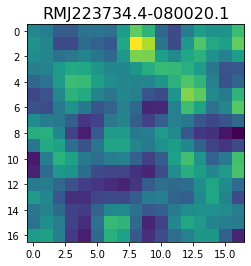

 45%|████▌     | 4585/10099 [06:44<09:26,  9.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 14.219823  -19.198984  -11.6771965  32.452198   72.532684   67.11966
  13.070352  -43.233658  -48.778362   -6.4043765  26.63468    12.381279
 -24.484346  -43.178043  -41.627262  -35.961266  -18.239784 ]


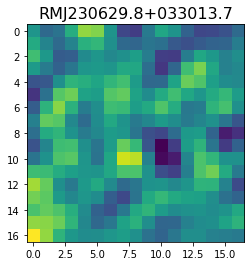

 45%|████▌     | 4587/10099 [06:45<10:08,  9.05it/s]

<class 'pixell.enmap.ndmap'>
[  -7.89749     -7.0134125  -91.18665   -152.376     -115.36258
  -54.159283   -75.481316  -146.15498   -149.97852    -87.83747
  -82.4527    -167.87492   -217.27625   -142.79076    -42.91452
  -54.430912  -149.55855  ]


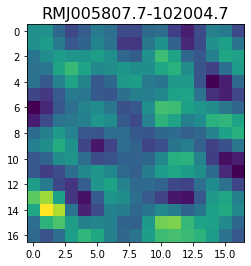

 45%|████▌     | 4588/10099 [06:45<11:53,  7.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[97.21181  73.54916  48.888306 47.53859  60.50394  66.49597  57.221718
 52.18411  73.12127  97.134094 82.23367  47.596607 53.83164  91.12341
 83.45699  23.107134 -8.022267]


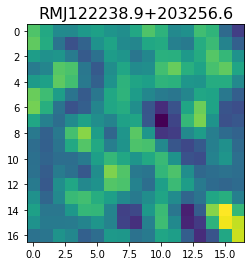

 45%|████▌     | 4593/10099 [06:45<08:30, 10.79it/s]

<class 'pixell.enmap.ndmap'>
[ -98.65859    -77.17491    -37.87565    -37.193317   -81.90588
 -121.50853   -117.23627    -88.504715   -80.13236   -103.62599
 -128.39761   -123.716515   -91.90607    -56.683975   -32.45375
  -16.849995    -6.4491177]


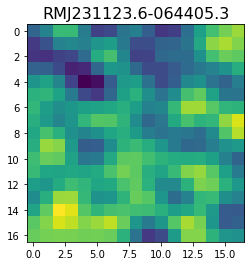

 45%|████▌     | 4595/10099 [06:45<09:54,  9.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[102.77688   133.37524   122.29668   109.682884   99.90195    87.30362
 101.15221   128.58664    97.61476    23.653353   34.0001    151.79568
 215.03773   121.82248    -1.1693188   3.751043   98.91157  ]


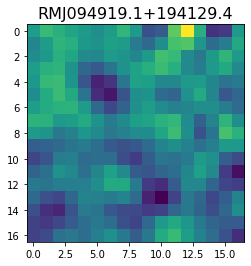

 46%|████▌     | 4602/10099 [06:46<06:56, 13.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-53.823444  -54.501484  -62.23307   -75.08791   -76.522125  -59.31103
 -46.37944   -61.553375  -86.986755  -82.1075    -45.76593   -23.79521
 -42.70002   -69.54186   -60.318733  -21.603191    4.9970155]


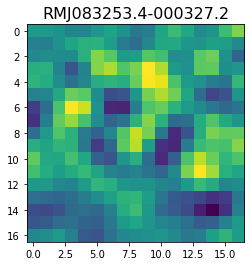

 46%|████▌     | 4604/10099 [06:46<07:44, 11.82it/s]

<class 'pixell.enmap.ndmap'>
[ 47.97468    29.85398    22.287323   33.685936   50.288204   50.79564
  29.420298    5.5060825   4.487898   27.407173   48.281055   46.78272
  34.27302    38.54002    68.09969   100.6664    106.7154   ]


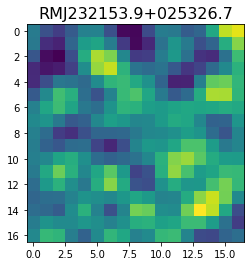

 46%|████▌     | 4606/10099 [06:46<08:27, 10.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-154.84908  -157.38359  -122.06162  -106.16979  -102.44426   -64.02072
  -11.508847  -21.696527  -99.45589  -151.3594   -118.031525  -54.503666
  -37.242065  -58.33971   -63.46472   -42.482548  -24.774584]


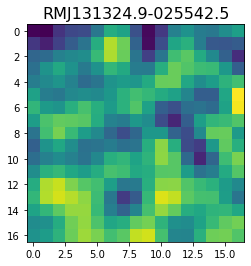

 46%|████▌     | 4609/10099 [06:46<08:21, 10.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.304848 -27.35958   22.821795  60.273243  46.602917  18.126822
  17.16997   29.945923  23.325327   1.223739  -9.10922    0.439709
  17.963234  34.17725   44.021355  39.57801   20.157381]


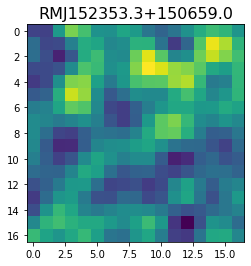

 46%|████▌     | 4613/10099 [06:47<07:38, 11.97it/s]

<class 'pixell.enmap.ndmap'>
[ -84.47501    -93.57947      9.066029    74.17875     -2.8196423
 -107.942314   -96.83741    -16.08266     14.241915    -4.180213
  -17.009008   -35.141716   -52.10282     -3.4862852   75.68015
   36.58416   -128.92654  ]


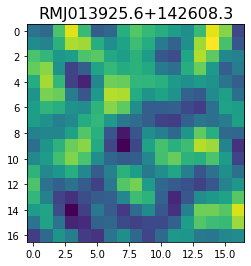

 46%|████▌     | 4615/10099 [06:47<08:25, 10.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-28.489672 -94.086006 -20.265715 110.451096 133.24469   39.774456
 -24.40251    9.577349  50.839336  23.07579  -18.719807  -3.860647
  39.992905  56.634148  47.66491   25.705532 -29.315401]


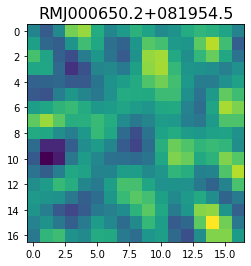

 46%|████▌     | 4619/10099 [06:47<07:49, 11.68it/s]

<class 'pixell.enmap.ndmap'>
[ 14.448152  25.221085 -14.262136 -28.263786  39.90249  103.82044
  64.86154  -34.866375 -84.85791  -54.458492   7.644434  59.193836
  84.41556   73.53011   34.9784     4.649322  11.14647 ]


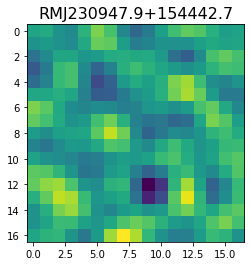

 46%|████▌     | 4621/10099 [06:48<08:33, 10.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 112.824394   -51.820366  -203.77438   -153.10278     10.767477
   72.04515     11.4715395  -19.55135     28.292673    53.440266
    7.3336153  -21.884983    40.264393   130.26184    121.23994
  -21.203686  -187.85707  ]


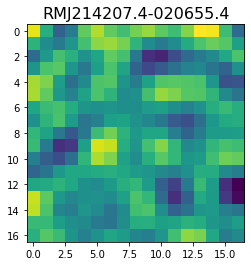

 46%|████▌     | 4624/10099 [06:48<08:29, 10.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 67.00648   78.04707  109.11014  118.43807  108.588005 108.02017
 108.387825  89.96837   75.3718    91.142044 115.22686  118.89606
 112.44699  106.22956   88.19188   72.2636    93.23973 ]


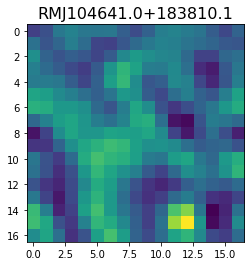

 46%|████▌     | 4626/10099 [06:48<09:18,  9.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.781754  30.696964  72.34799  109.61018   99.03981   82.95814
 116.961235 168.17061  166.21298  115.5791    78.24667   76.25718
  83.597565  88.88402  100.61106  106.97293   85.685265]


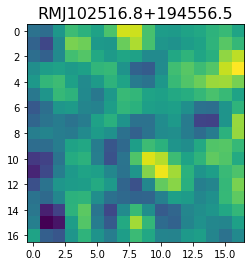

 46%|████▌     | 4628/10099 [06:48<09:53,  9.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-48.084126  -37.118935  -34.1559    -14.493625    8.891489   -1.9095213
 -51.486057  -90.35345   -70.13781    -7.354694   32.607697   16.25106
 -19.20209   -21.362268    6.233804   16.245516  -10.674708 ]


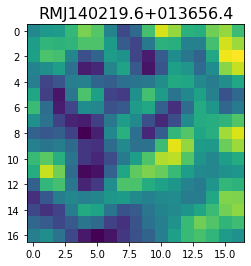

 46%|████▌     | 4631/10099 [06:49<09:34,  9.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.090542 -18.7511   -46.390533 -35.021107   7.202362  27.706188
 -15.492907 -80.92346  -76.77341   10.883467  77.99155   35.441822
 -64.43624  -97.95814  -37.842487  23.478107  11.879644]


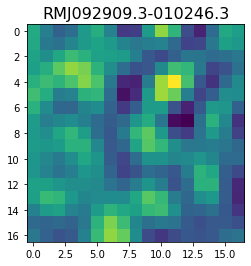

 46%|████▌     | 4634/10099 [06:49<09:13,  9.88it/s]

<class 'pixell.enmap.ndmap'>
[  9.167242   18.648664   20.611696   18.89463    13.974882   -6.633914
 -28.886032  -13.753231   32.877083   47.563587    3.7124975 -36.83123
 -13.385245   40.551357   48.050648   -1.4156866 -47.436554 ]


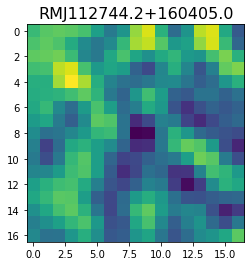

 46%|████▌     | 4635/10099 [06:49<11:32,  7.89it/s]

<class 'pixell.enmap.ndmap'>
[-196.47777  -183.20828  -103.150795  -32.23624    30.882364   71.14287
   20.076067 -117.29725  -215.44891  -187.18599  -101.35903   -68.09486
  -83.60289   -72.49589   -30.03188   -30.910574 -110.07731 ]


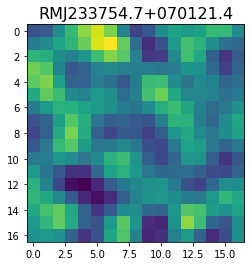

 46%|████▌     | 4636/10099 [06:49<12:59,  7.01it/s]

<class 'pixell.enmap.ndmap'>
[ -62.88119    -22.287224   -58.66047   -120.97835   -113.98865
  -52.45069    -35.852226   -84.66672   -117.841576   -95.94279
  -67.08134    -55.37087    -27.003284     4.9500003  -33.007607
 -138.02933   -197.70897  ]


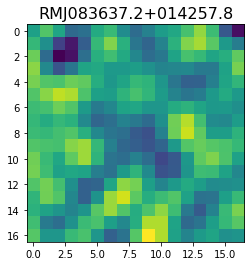

 46%|████▌     | 4637/10099 [06:50<14:42,  6.19it/s]

<class 'pixell.enmap.ndmap'>
[ 40.755836   22.707369   13.500221   15.148488    8.016615  -12.997862
 -28.680086  -24.601011   -8.73986     4.512885   10.549437    9.522446
   0.3493763 -12.640568  -18.183487  -12.018568   -6.0238466]


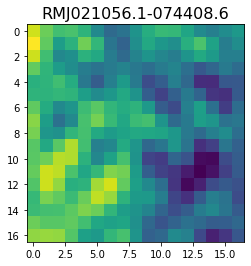

 46%|████▌     | 4638/10099 [06:50<16:12,  5.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  46.511753 -109.61506  -246.01796  -188.03448   -37.2416     14.669198
  -33.497597  -59.077717  -30.234983    6.299886   43.46756    76.52898
   45.187138  -61.187157 -135.72583  -103.06109   -38.925556]


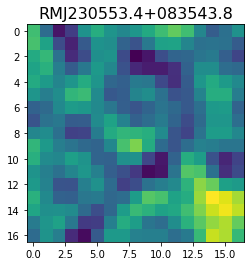

 46%|████▌     | 4641/10099 [06:50<12:28,  7.29it/s]

<class 'pixell.enmap.ndmap'>
[-121.02906   -69.761246  -75.42088  -131.80457  -179.67865  -183.12466
 -158.5071   -137.95828  -135.43517  -147.12549  -159.20242  -154.2564
 -130.46237  -111.28224  -115.851944 -127.73441  -119.56509 ]


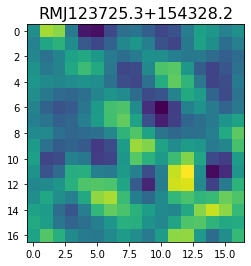

 46%|████▌     | 4642/10099 [06:50<14:15,  6.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-126.89636  -106.88086   -73.8604    -52.378693  -76.44725  -131.40245
 -155.3612   -116.45876   -58.2192    -44.437237  -81.77242  -121.63573
 -121.068245  -77.780815  -20.601643   10.083485  -13.420687]


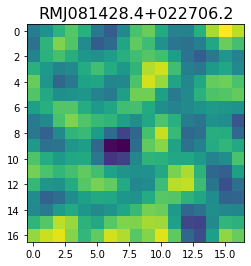

 46%|████▌     | 4645/10099 [06:51<11:29,  7.91it/s]

<class 'pixell.enmap.ndmap'>
[ 17.81485   22.734085  42.77412   33.01143   27.259403  55.65469
  78.13269   59.15973   37.80329   62.936253 109.07779  114.905785
  76.08664   48.54818   68.31582  106.30555  111.187   ]


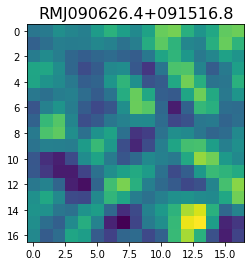

 46%|████▌     | 4646/10099 [06:51<13:09,  6.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[188.87051  146.63054  130.88347  143.24889  153.37123  142.32555
 131.10492  145.75623  172.53772  175.39542  145.24629  104.27045
  72.68102   59.124542  71.29141  103.649826 123.74598 ]


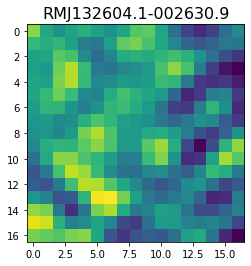

 46%|████▌     | 4656/10099 [06:51<05:25, 16.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.687504 -26.14909  -51.787785  20.603584 117.31671  136.5221
  79.75065   36.442276  52.039474  73.29649   45.07111    6.203879
  31.562178 104.53627  125.150475  57.581585  -7.717227]


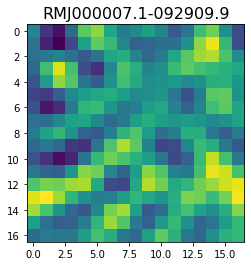

 46%|████▌     | 4660/10099 [06:52<05:44, 15.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 34.44914   70.26126  135.81825  133.69469   64.624725  16.887718
  36.806885  78.754166  89.05736   74.71584   63.208378  49.216995
  23.50445   14.348095  47.76603   90.00246   84.51663 ]


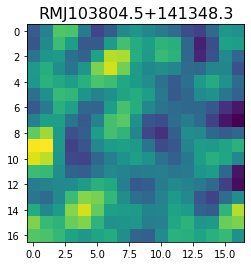

 46%|████▌     | 4664/10099 [06:52<05:57, 15.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-81.41255   -52.535503   -2.6030405  17.750452   -6.7617273 -44.91026
 -59.59872   -42.332764  -10.58785    15.101008   28.279457   35.410755
  40.04578    32.79908     4.0682487 -36.039116  -62.022713 ]


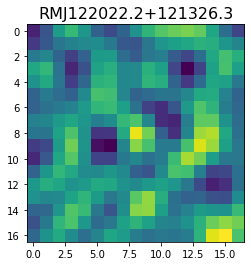

 46%|████▌     | 4667/10099 [06:52<06:34, 13.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -36.070877    -57.887405      0.44688776   80.003075    104.66475
   58.021923    -21.859573    -82.48623     -78.77554       2.7060823
  111.47545     151.72609      71.5208      -68.674614   -144.62167
  -95.71833      12.0549965 ]


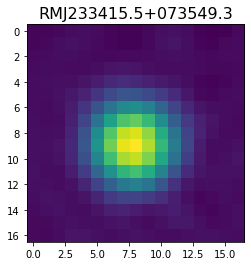

 46%|████▌     | 4669/10099 [06:52<07:28, 12.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -92.93552   -76.11001   -33.225594  -57.739296 -163.45139  -236.34799
 -199.00732  -122.56253  -114.82381  -169.48012  -193.17307  -142.74821
  -74.848     -64.50513  -112.63551  -152.44301  -141.4586  ]


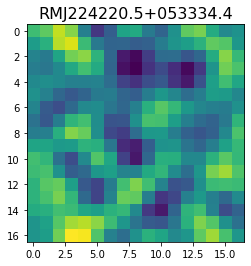

 46%|████▋     | 4671/10099 [06:53<08:37, 10.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-124.49173  -127.81418  -129.63179  -123.018814 -115.066216 -122.67085
 -144.32913  -154.04106  -137.94617  -119.83794  -127.73251  -149.51869
 -151.47656  -131.65973  -120.61832  -131.51999  -144.65967 ]


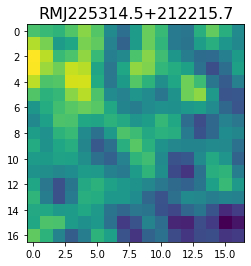

 46%|████▋     | 4683/10099 [06:53<04:45, 18.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.700527   82.69998    76.206055   33.142235   32.90896    84.87887
 108.04361    60.171497    6.273951   14.622959   53.295597   53.63409
  23.55719    19.736214   41.037548   35.40385    -0.4451526]


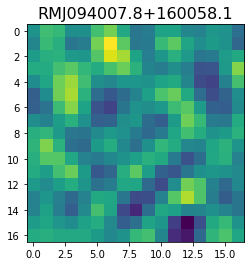

 46%|████▋     | 4688/10099 [06:53<04:58, 18.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[118.6821      6.5205884 -12.16098    65.193695  113.20679    75.282845
  31.438902   53.641487  100.02189   104.09036    83.90842    89.91485
 104.91679    82.06356    48.920837   82.05618   179.82068  ]


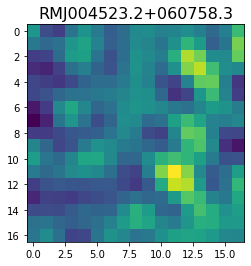

<class 'pixell.enmap.ndmap'>
[-103.30159  -118.70848  -166.16992  -169.18259  -107.78029   -54.197678
  -65.46377  -100.691666 -100.05311   -88.8491   -121.1098   -163.96436
 -141.92955   -73.79744   -53.525974  -98.010315 -125.63967 ]


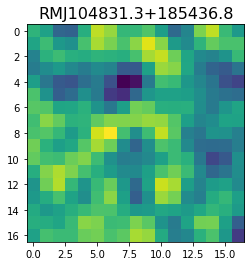

 46%|████▋     | 4691/10099 [06:54<07:17, 12.37it/s]

<class 'pixell.enmap.ndmap'>
[-139.4196   -143.89384  -149.69772  -155.09877  -125.54207   -87.009285
 -111.571014 -182.53911  -187.29088  -102.60377   -63.353336 -149.02367
 -222.91466  -129.06267    43.03724    71.28651   -66.003395]


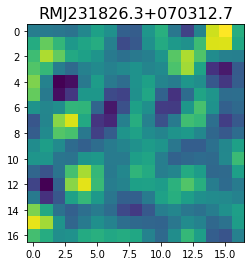

 46%|████▋     | 4693/10099 [06:54<08:02, 11.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-50.87276   -83.05791   -55.245667  -12.427577  -25.39439   -80.64777
 -95.51145   -43.57777     3.0658877 -18.148659  -70.99272   -82.674934
 -49.618683  -28.09596   -46.34121   -77.07209   -85.136566 ]


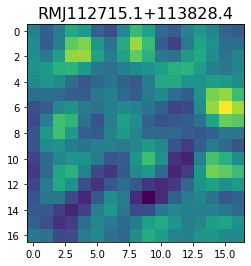

 46%|████▋     | 4695/10099 [06:55<08:47, 10.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -7.590265 -114.26398   -30.074047   98.67254    30.238153 -189.5525
 -260.09003   -64.7677    139.70569    86.72176  -126.791916 -207.55275
  -81.583824   67.00011   103.8292     74.2416     41.466133]


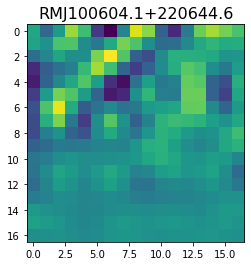

<class 'pixell.enmap.ndmap'>
[125.07634  -10.546123 -66.015686  -8.132265  44.452133  27.546957
  11.137096  45.35841   76.20577   61.7129    45.729237  63.059345
  74.39076   46.59445   14.223952  14.229692  23.98612 ]


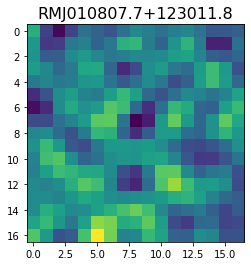

 47%|████▋     | 4697/10099 [06:55<11:34,  7.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -33.46177     17.321453   -13.07403    -90.77293   -142.40247
 -126.52881    -57.15524     25.932947    89.42799    109.599945
   71.3732      -9.12025    -73.08807    -65.8373      -1.0962571
   49.577816    40.16448  ]


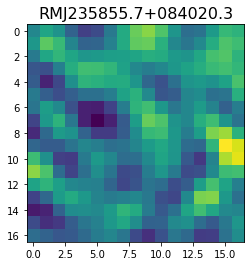

 47%|████▋     | 4701/10099 [06:55<09:36,  9.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 51.42998   16.814554  16.03335   49.443413  85.73182  100.44169
  95.151535  85.30265   80.08162   75.79371   66.71511   59.013298
  66.01121   86.56318   99.318565  88.475784  66.313515]


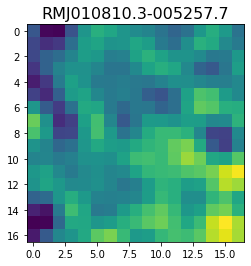

 47%|████▋     | 4704/10099 [06:56<09:07,  9.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -6.4732566 -19.658218   24.077099   49.598274    8.435217  -42.754253
 -30.110971   18.087395   17.21916   -33.291477  -46.114048   13.406096
  72.64881    67.38915    32.714924   29.312119   43.001087 ]


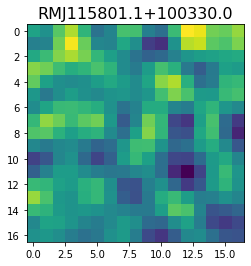

 47%|████▋     | 4708/10099 [06:56<08:13, 10.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -73.50871   -46.098152  -61.864468  -99.648476 -109.57278   -79.32716
  -43.258167  -33.894974  -52.40814   -85.17161  -118.98874  -135.46777
 -122.31129  -100.14408  -105.506546 -133.43181  -133.51454 ]


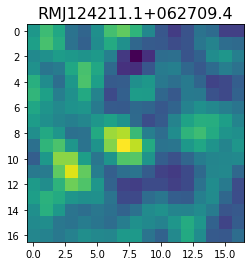

 47%|████▋     | 4712/10099 [06:56<07:35, 11.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-23.153763  -41.862537  -36.87219   -11.464664    2.8045828  -2.3487139
 -13.027322  -23.51185   -31.054853  -26.809067  -17.080976  -22.06192
 -37.891983  -38.512833  -23.682829  -20.568142  -33.852337 ]


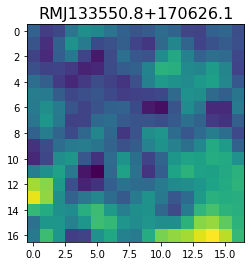

 47%|████▋     | 4716/10099 [06:56<07:12, 12.46it/s]

<class 'pixell.enmap.ndmap'>
[  19.433685     1.9020668    7.54913     31.519497    19.873472
  -41.232643  -102.617516  -117.433266   -86.19634    -38.786945
   -2.5409198   13.818249    21.149088    31.419125    38.45664
   29.732904     9.7967415]


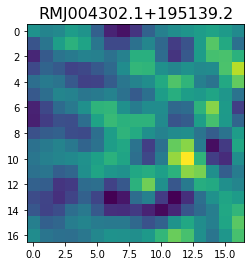

 47%|████▋     | 4718/10099 [06:57<07:49, 11.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-144.83878  -115.19833  -115.301506 -156.953    -214.02667  -245.37384
 -233.11879  -193.74571  -161.12312  -163.22899  -196.93227  -218.77135
 -186.59264  -120.18563   -88.4302   -122.15743  -175.84474 ]


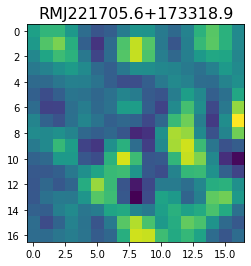

 47%|████▋     | 4721/10099 [06:57<08:18, 10.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[200.34813  180.32422  246.52844  316.09988  315.49844  280.35617
 260.1569   227.45833  154.3079    96.721794 119.13733  190.43869
 234.70992  243.61201  260.0322   278.4054   245.28435 ]


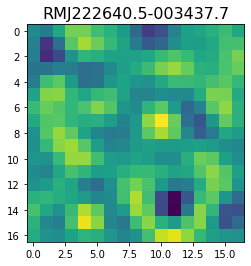

 47%|████▋     | 4725/10099 [06:57<07:39, 11.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[67.91157  64.928604 52.424328 35.235085 32.55915  50.331177 64.19624
 48.76771  17.5096    9.213485 34.682167 62.71035  65.00183  49.29695
 36.293633 28.134207 18.063578]


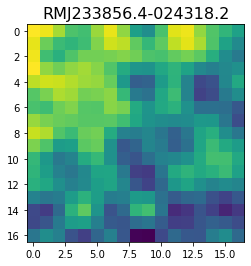

 47%|████▋     | 4729/10099 [06:58<07:12, 12.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -3.7325983 -96.99039   -84.47621    44.940357  114.97608    33.46968
 -70.32989   -58.12186    22.065489   50.00045    16.453722  -13.682852
 -28.19641   -54.40298   -77.518974  -58.0878     -2.0907187]


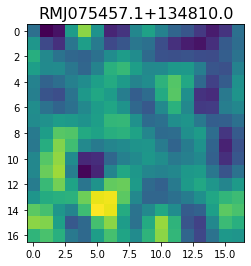

 47%|████▋     | 4734/10099 [06:58<06:34, 13.61it/s]

<class 'pixell.enmap.ndmap'>
[ -29.656693    33.658283   115.589905   118.30202     52.698975
   12.764989    11.820973    -3.8911028  -26.765806   -19.568817
  -14.689593   -52.93564    -97.89701   -103.2923     -74.81167
  -20.237953    45.502678 ]


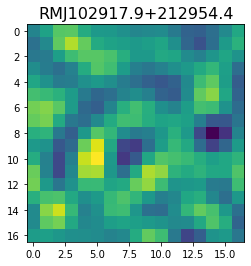

 47%|████▋     | 4736/10099 [06:58<07:25, 12.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[140.29863   147.99681    41.37029    15.1037855  86.90419   111.08247
  65.38898    58.252514   89.84749    63.94119    11.102071   55.321213
 173.19655   209.28714   123.15693    27.50089    -7.822863 ]


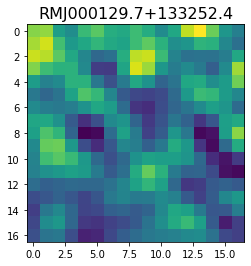

 47%|████▋     | 4738/10099 [06:58<08:23, 10.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   2.965955 -100.08226  -131.34538   -51.79085    52.726086   78.501915
    4.643365  -82.58442   -63.755554   62.426197  132.11795    16.08565
 -172.56873  -211.97281   -89.84213    -9.609793  -67.473854]


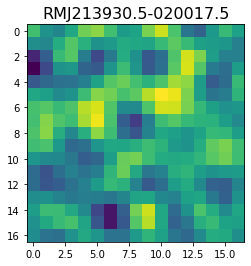

 47%|████▋     | 4742/10099 [06:59<07:46, 11.48it/s]

<class 'pixell.enmap.ndmap'>
[ -47.472984    20.064987    53.287575    38.260403    -2.0719106
  -25.93339    -26.872223   -44.66565    -86.21841    -85.55583
   -7.536435    59.46024      6.226736  -133.65987   -221.00511
 -195.30632   -125.93001  ]


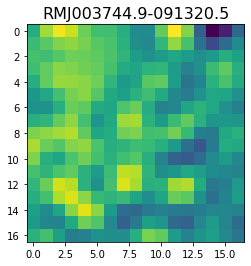

 47%|████▋     | 4744/10099 [06:59<08:36, 10.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 85.48988     9.982555  -20.909525   -1.4944206  -3.8003209 -37.995003
 -28.087177   39.408      73.99181    35.841404    3.0193093  33.302963
  79.02085    85.24272    64.942154   44.87948    32.778725 ]


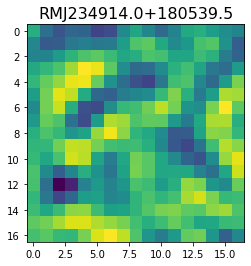

 47%|████▋     | 4748/10099 [06:59<07:44, 11.51it/s]

<class 'pixell.enmap.ndmap'>
[-130.25258   -30.015215   64.24397    25.819351  -75.05877   -91.867165
  -36.43327   -34.242683 -100.2571   -123.98266   -65.591484  -13.997812
  -25.798841  -38.09453     5.70561    50.17577    26.295872]


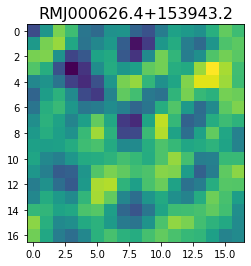

<class 'pixell.enmap.ndmap'>
[ -78.955414  -89.097626  -60.493313  -39.906826  -52.614376  -73.440285
  -83.62196   -97.04363  -114.071396 -106.11729   -73.985916  -68.54369
 -110.85045  -138.59402   -92.601906  -22.641499  -28.591635]


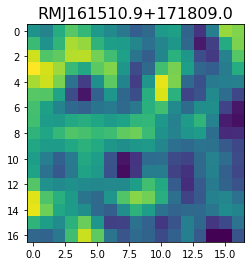

 47%|████▋     | 4750/10099 [07:00<10:23,  8.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  14.01285   127.64275    76.87895    -4.332251   22.132746   39.529358
 -110.15243  -302.08875  -281.79968   -59.92274   107.76217    95.13117
   14.104061  -34.897465  -82.074165 -130.94496  -102.34898 ]


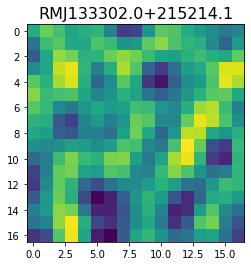

 47%|████▋     | 4754/10099 [07:00<08:58,  9.93it/s]

<class 'pixell.enmap.ndmap'>
[ -36.441494   -28.889282   -22.197012   -67.61934   -122.278015
 -116.04704    -73.155655   -55.744514   -50.422142   -20.004303
    7.2572265    8.692877    36.9888     106.35711    115.45923
   12.544454   -74.06866  ]


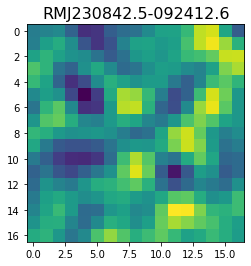

<class 'pixell.enmap.ndmap'>
[-43.057953  -71.0946    -61.659737  -23.078646  -22.190342  -68.15415
 -77.9799     -7.8600283  62.60025    47.26025   -16.329067  -36.240135
  -8.258269    1.6881255 -24.096867  -44.873497  -45.648182 ]


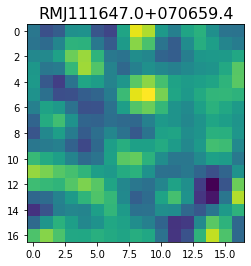

 47%|████▋     | 4756/10099 [07:00<11:42,  7.60it/s]

<class 'pixell.enmap.ndmap'>
[ 74.14871  -17.204666 -98.14803  -71.658966  32.543148 113.77005
 122.24504   87.23113   49.385014  13.170513 -23.650812 -36.283394
 -10.411193  13.655592  -5.017175 -26.056038  20.222357]


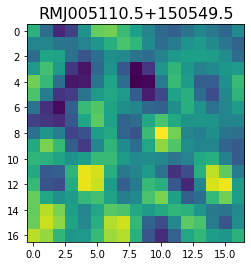

 47%|████▋     | 4757/10099 [07:01<13:33,  6.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -9.995954  -47.53707   -51.923466   13.771908   69.90171    29.514874
  -73.200775 -126.32865   -91.5962    -42.578053  -51.202606 -105.51773
 -156.81422  -182.92291  -175.02817  -121.74019   -49.03991 ]


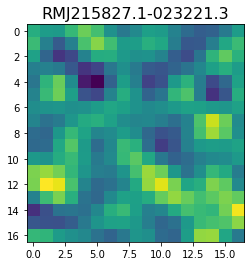

 47%|████▋     | 4760/10099 [07:01<11:54,  7.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -63.76761    -44.847042    26.348408    41.040455   -16.457865
  -48.83434     -7.5822234   24.401075   -31.47339   -111.96803
  -98.75747      4.2597575   80.520966    72.33718     41.949512
   48.138393    57.00064  ]


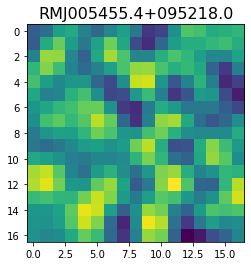

 47%|████▋     | 4766/10099 [07:01<08:14, 10.79it/s]

<class 'pixell.enmap.ndmap'>
[  9.753201    31.661062    43.987446    49.1754      54.50928
  48.454525    42.824814    66.199       92.615616    66.54663
  15.408138    28.677322   103.93054    132.70879     70.20915
   1.2988447    0.46998906]


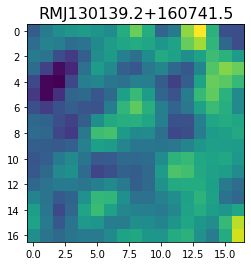

 47%|████▋     | 4768/10099 [07:02<09:02,  9.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-72.57338  -56.956776 -23.741184  -5.625709 -18.646044 -38.801205
 -42.964558 -40.496994 -43.960583 -46.946213 -50.828747 -70.223335
 -93.4521   -85.12195  -45.325718 -17.143095 -20.871223]


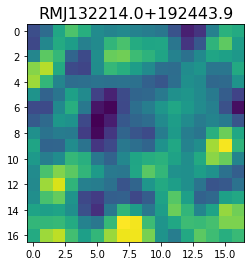

 47%|████▋     | 4770/10099 [07:02<10:10,  8.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -65.99295   -72.20102   -72.9051    -61.948692  -51.92609   -60.66586
  -84.350464  -97.81523   -87.670906  -71.71402   -73.207184  -87.108635
  -90.09934   -78.434906  -74.11846   -91.3865   -117.02721 ]


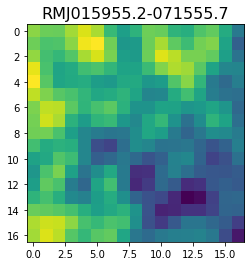

 47%|████▋     | 4772/10099 [07:02<10:26,  8.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.601074  34.52216   44.59583   73.54993   93.082985  58.80602
 -13.775449 -34.746246  35.31409  100.27082   61.47016  -24.267115
 -37.70041   12.905705  32.684837  13.628305  16.28123 ]


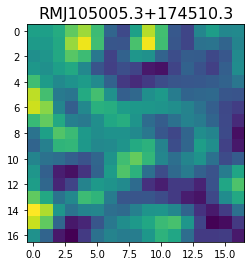

 47%|████▋     | 4774/10099 [07:02<10:42,  8.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  34.378098   39.26798    -6.29964   -41.929222  -31.762566  -24.505684
  -66.86311  -113.923996  -95.58441   -34.287823  -14.935694  -53.265926
  -79.09616   -56.18103   -35.27948   -59.199627  -88.07277 ]


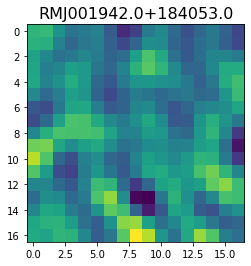

 47%|████▋     | 4778/10099 [07:03<08:47, 10.09it/s]

<class 'pixell.enmap.ndmap'>
[ 19.56776  101.65576  100.64245   20.861048 -26.190962   4.604153
  51.6298    57.504826  24.975145 -24.306673 -71.19688  -88.54269
 -62.767414 -15.275627  26.423454  53.661964  58.081158]


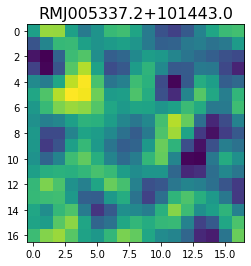

 47%|████▋     | 4780/10099 [07:03<09:14,  9.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-162.02618 -124.33053  -71.02631  -59.14217  -99.14167 -145.1773
 -159.98735 -148.58945 -133.62706 -132.85963 -150.79056 -167.98077
 -159.66165 -139.26929 -145.9312  -177.57039 -188.87909]


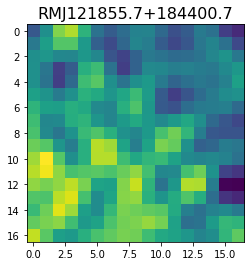

 47%|████▋     | 4782/10099 [07:03<10:01,  8.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-211.0625  -201.89455 -277.05566 -324.07562 -308.76584 -313.8767
 -373.41003 -391.09525 -305.9841  -229.31447 -288.6541  -414.99557
 -439.23547 -354.42807 -311.67944 -364.88046 -397.52728]


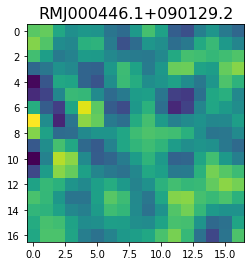

 47%|████▋     | 4784/10099 [07:04<10:54,  8.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.923578  -21.541735   -3.3705444  38.005726   48.641926   34.798557
  35.32358    45.767754   35.53384    14.539623   17.24109    36.753757
  37.256313   23.848963   41.207314   99.45558   149.84238  ]


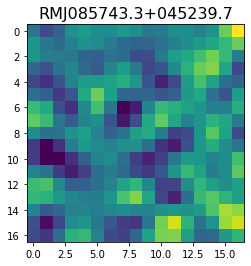

 47%|████▋     | 4790/10099 [07:04<07:30, 11.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-326.27432 -332.16318 -291.69827 -271.45142 -293.0197  -301.01868
 -264.49762 -235.67485 -263.1378  -305.96844 -295.87976 -247.75444
 -238.87166 -290.4874  -337.84488 -328.65247 -293.71283]


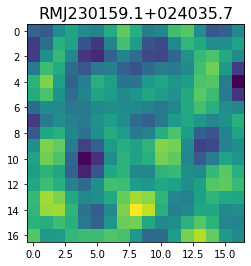

 47%|████▋     | 4792/10099 [07:04<08:20, 10.60it/s]

<class 'pixell.enmap.ndmap'>
[ 56.311584  35.165073  10.256107  20.9438    35.857426  24.963316
  29.92173   81.708405 118.82503   80.037285  16.343765  15.004887
  64.66259   89.26929   72.75912   60.853317  69.87566 ]


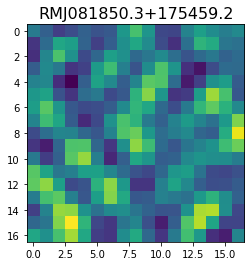

 47%|████▋     | 4794/10099 [07:04<08:55,  9.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[127.42213  195.59204  143.47946   46.084858  48.04942  143.2662
 190.82135  124.49468   27.017567  -6.100679  24.176506  66.355064
  94.62671  109.65507  114.654305 116.3277   122.263374]


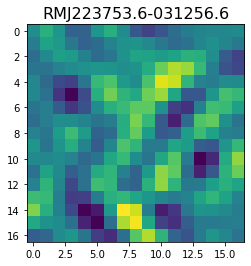

 47%|████▋     | 4796/10099 [07:05<09:59,  8.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[136.46004   -53.30134   -14.6125145 159.80843   248.41336   242.81923
 247.4474    226.82442   108.95749    -4.556023   20.05389   116.3078
 155.2339    176.89171   257.55295   308.26807   248.3955   ]


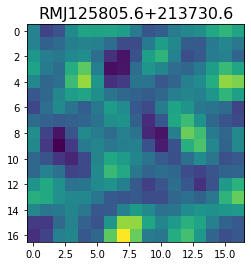

 48%|████▊     | 4800/10099 [07:05<08:17, 10.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -14.879501 -128.80093  -166.89104  -137.27065   -65.553825   22.361872
   74.32652    61.021374   19.07158   -15.951203  -58.78753  -102.94566
  -89.08188   -12.221865   33.094307  -13.152679  -88.63191 ]


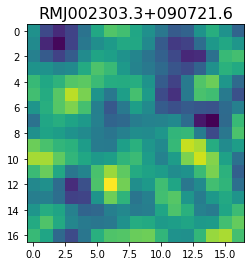

 48%|████▊     | 4802/10099 [07:05<08:46, 10.07it/s]

<class 'pixell.enmap.ndmap'>
[365.09006 325.07455 302.755   341.05368 388.71188 390.68774 372.42996
 364.64487 341.47784 308.66748 325.01978 367.23706 338.62207 267.88925
 289.01022 377.62    364.1393 ]


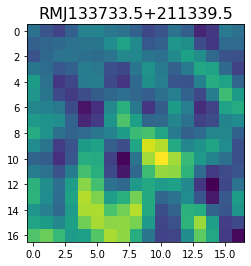

 48%|████▊     | 4804/10099 [07:05<09:13,  9.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[200.59955  106.08353   77.455536 150.68735  218.29335  207.64146
 176.8104   177.6202   158.45871   86.56941   39.448692  75.27673
 127.29806  127.121956 121.57357  165.31598  206.20372 ]


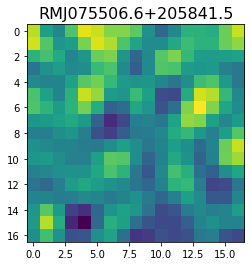

 48%|████▊     | 4808/10099 [07:06<08:14, 10.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[72.24191  57.771152 64.19712  81.7931   90.517    86.467186 81.92816
 78.83691  60.033268 20.720684 -8.593221  4.072412 45.162006 71.20563
 66.5865   55.312542 57.23824 ]


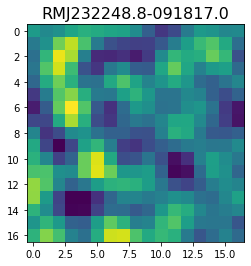

 48%|████▊     | 4811/10099 [07:06<08:23, 10.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -72.71211     -21.22404      -8.1693125   -49.956627    -66.252426
   -0.25019026   78.954544     56.882267    -68.43196    -175.35904
 -170.35933     -91.50128     -30.109497      0.8640148    55.005283
  125.570435    118.555855  ]


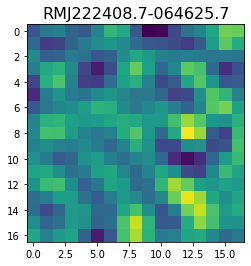

 48%|████▊     | 4815/10099 [07:06<07:38, 11.53it/s]

<class 'pixell.enmap.ndmap'>
[144.68344   206.21944   232.48335   186.6238    110.30367   110.51375
 176.655     169.49692    57.29959    -7.9110713  64.43948   151.69325
 124.42539    54.53845    82.05827   185.56987   224.29893  ]


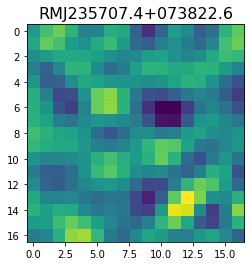

 48%|████▊     | 4817/10099 [07:07<08:23, 10.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -79.82168  -139.75505  -125.31886   -51.886368  -17.977108  -40.431732
  -49.678886  -19.499016    9.441206   19.188972   32.091293   47.418793
   38.96604     9.519325  -11.893931  -14.748097   -5.204881]


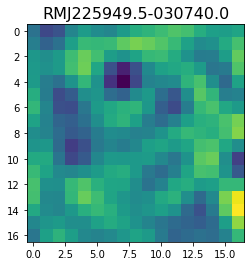

<class 'pixell.enmap.ndmap'>
[ -33.719193  -37.986897  -43.95357   -97.69546  -150.00899   -87.746765
   96.2139    235.74759   178.78235   -10.217798 -127.511925  -76.23814
   40.35582    52.675087  -86.3662   -235.75258  -214.77773 ]


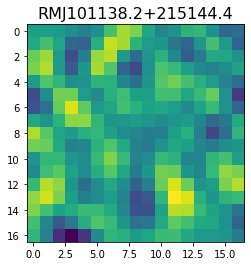

 48%|████▊     | 4819/10099 [07:07<11:20,  7.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -75.58617   -66.265175  -83.11617  -122.85219  -153.78387  -145.13448
 -105.293144  -77.47051   -88.26945  -113.89971  -113.7231    -86.48212
  -68.71564   -80.24528  -100.06831  -104.217575 -100.4635  ]


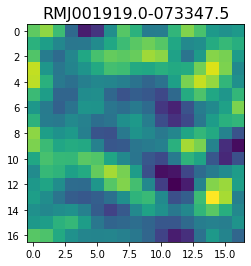

 48%|████▊     | 4823/10099 [07:07<09:18,  9.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   9.750665  -98.68028  -102.598495   26.3546    101.89719    25.505116
  -79.96997   -91.33189   -60.706436  -86.94908  -145.80666  -150.2367
 -100.6435    -75.48048  -103.405846 -128.36075  -103.85285 ]


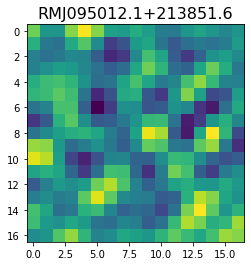

 48%|████▊     | 4832/10099 [07:08<05:22, 16.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-119.91652  -110.54441  -137.0335   -164.63208  -158.47232  -135.67558
 -128.93277  -125.2245    -95.08012   -62.297073  -76.21962  -120.49245
 -124.252625  -74.474434  -42.697083  -72.92754  -110.64409 ]


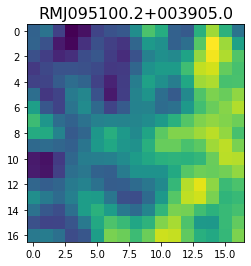

 48%|████▊     | 4835/10099 [07:08<05:57, 14.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  22.448915 -182.44316  -130.4508     95.25097   186.25818    74.45887
   -9.3684     48.616596   91.021385   33.71202    43.420284  221.77858
  391.6196    371.35184   231.48344   123.089294   61.611465]


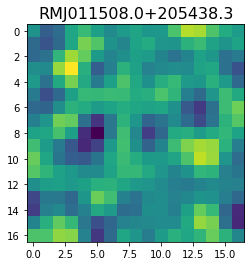

<class 'pixell.enmap.ndmap'>
[ -14.321514      5.235034     -9.342931    -66.621056   -103.44791
  -80.83449     -28.534382      7.0241046     0.17738058  -49.1751
  -96.21297     -77.23533      -3.3561857    34.46517       2.8670819
  -17.270998     28.544811  ]


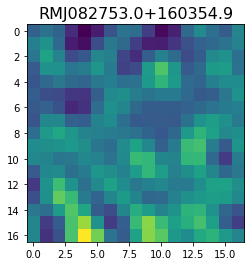

 48%|████▊     | 4838/10099 [07:09<08:38, 10.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  3.2087798 124.95609   179.04941   113.737495   -2.1354249 -39.766163
  34.911007  111.34814    80.18148   -19.823212  -65.23284   -21.082064
  32.57129    34.70053    17.18486    28.20423    52.885967 ]


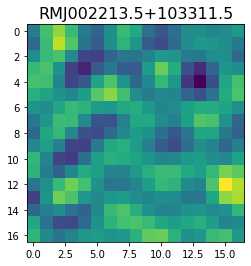

<class 'pixell.enmap.ndmap'>
[ -24.215279   -28.066183    -8.776751     6.0398226   -5.504191
  -51.76214   -121.34519   -157.17873   -105.76934    -16.139887
    1.5985643  -57.334743   -78.444725   -15.747306    33.834526
   -1.6882433  -55.95965  ]


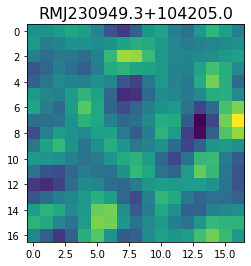

 48%|████▊     | 4840/10099 [07:09<11:01,  7.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-84.662476  -82.86051   -67.2392    -39.40603   -22.284464  -35.906406
 -63.340687  -71.07069   -55.822613  -40.785793  -33.160275  -19.666946
  -1.5154798   1.1323045 -15.353903  -26.874166  -14.641472 ]


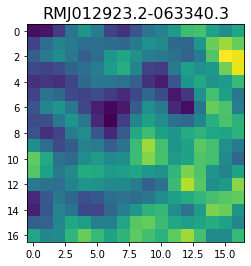

 48%|████▊     | 4845/10099 [07:09<08:46,  9.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -96.13026    -73.464714   -78.98111   -125.38773   -152.1119
 -109.61414    -43.047035   -36.830708   -89.37103   -110.17352
  -53.959557     9.815934    -0.8275699  -63.23775    -90.79049
  -56.656265   -13.956455 ]


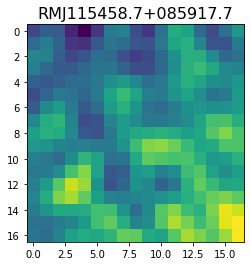

 48%|████▊     | 4851/10099 [07:10<06:58, 12.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.968834   53.273643   45.316433   18.138254  -14.360223  -26.815401
 -19.493792  -11.547476   -1.3274676  28.610447   69.191696   85.67627
  62.472572   16.199844  -31.213543  -60.962795  -50.285885 ]


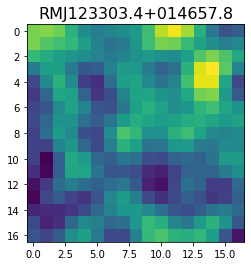

 48%|████▊     | 4854/10099 [07:10<07:09, 12.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[165.8511   148.47943   78.78825   20.153784  16.568142  67.058334
 122.887856 137.7686   123.97351  116.18398   98.074165  39.99182
  -7.710079  36.22047  139.31204  176.21907  115.230415]


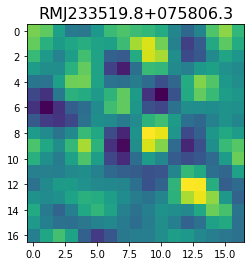

 48%|████▊     | 4856/10099 [07:10<07:49, 11.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 61.46028   78.76311   87.147255  81.592834  94.12941  117.27379
 112.30497   86.426384  73.11765   62.540516  39.374878  44.17402
 104.41097  159.85222  149.85403  114.410484 118.8754  ]


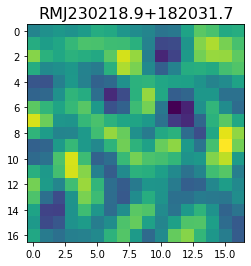

 48%|████▊     | 4860/10099 [07:10<07:08, 12.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-32.033386  -17.05861   -12.200395  -43.60634   -59.92754   -14.759638
  45.484867   45.268074  -11.189261  -56.94701   -55.544376  -24.591846
   6.8437543  19.847076    5.7448716 -19.078255  -14.811867 ]


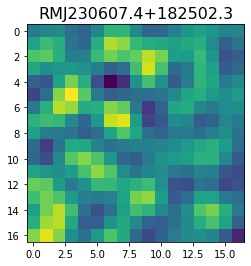

 48%|████▊     | 4862/10099 [07:11<07:51, 11.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -83.25685  -117.21256  -145.4455    -71.437096   56.94038   101.40191
   24.518488  -79.83427  -127.06986  -117.54368   -82.57829   -45.70629
  -42.34138   -98.09089  -169.95105  -173.21376   -90.37529 ]


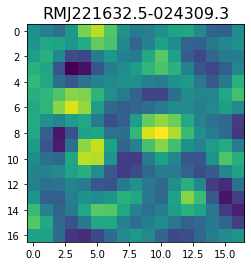

 48%|████▊     | 4865/10099 [07:11<07:49, 11.16it/s]

<class 'pixell.enmap.ndmap'>
[ 97.22682    90.34715    38.181137    1.1592193  26.023922   82.5216
 102.40838    72.383736   43.59881    47.526657   55.37319    39.64067
  24.502981   39.324364   61.959785   52.682858   19.242317 ]


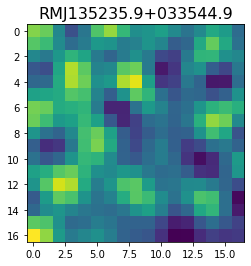

<class 'pixell.enmap.ndmap'>
[ 213.12079    234.75333    160.50233    142.7442     166.97716
   65.481804  -177.97885   -336.96527   -262.52197   -106.04225
  -62.920532   -73.29155      7.6728115   97.0663       9.941823
 -194.61728   -265.58954  ]


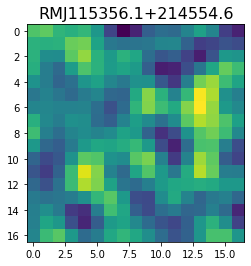

 48%|████▊     | 4867/10099 [07:11<10:27,  8.34it/s]

<class 'pixell.enmap.ndmap'>
[-140.47195 -108.57031  -93.40988 -120.45629 -144.46375 -133.2484
 -118.7113  -129.77278 -139.47844 -120.23045  -96.72504 -100.336
 -115.33074 -112.6957  -101.04518 -102.2406  -104.38237]


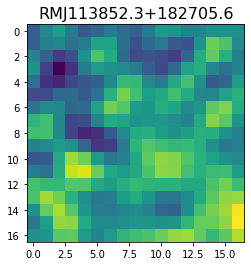

 48%|████▊     | 4868/10099 [07:12<11:55,  7.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.79532   25.517859  26.716825  43.86822   47.716568  38.53393
  47.766617  77.03032   84.6125    56.279224  39.211964  67.98747
 102.391884  89.169655  50.122574  49.087204  92.36998 ]


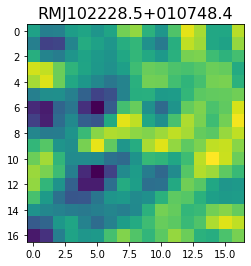

 48%|████▊     | 4875/10099 [07:12<07:21, 11.84it/s]

<class 'pixell.enmap.ndmap'>
[ -43.107544   -46.235092   -15.328665    11.334039   -12.039384
  -73.30343   -109.65043    -84.14317    -29.772955    -5.17039
  -24.742388   -52.101963   -54.67647    -39.895424   -29.882164
  -23.383575    -6.2008634]


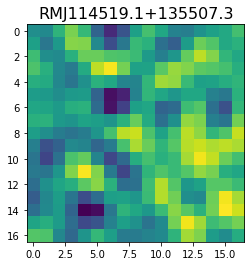

 48%|████▊     | 4877/10099 [07:12<08:26, 10.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[120.81567    64.56102    -1.2107594   0.8569555  11.575912   18.597933
  48.76324    39.811558  -45.830715  -98.12259   -44.551453   13.492253
   4.3362765  10.338993   67.471725   78.76622    13.475284 ]


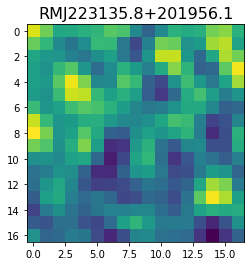

 48%|████▊     | 4884/10099 [07:13<06:15, 13.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[45.985683 37.683315 47.550617 54.96419  38.63704  26.74558  47.84009
 71.19848  58.47627  36.65972  51.26173  80.70483  70.45083  27.59851
  8.553279 27.61015  45.596558]


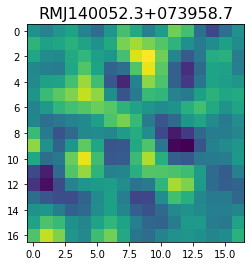

 48%|████▊     | 4887/10099 [07:13<06:39, 13.05it/s]

<class 'pixell.enmap.ndmap'>
[ 93.48175   59.966106  40.79359   66.702835 109.82977  132.32764
 122.56068   89.21124   57.264523  50.067383  53.366425  37.088486
  19.78647   43.150536  80.75591   67.902534  27.00389 ]


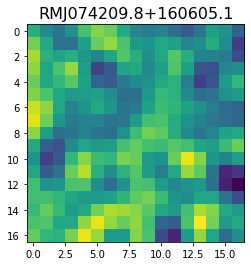

<class 'pixell.enmap.ndmap'>
[ 49.2338     48.16554    14.465773  -31.496494  -54.650253  -45.45561
 -25.176912  -13.1305     -4.4099555  11.672651   24.899212   16.111937
  -7.498659  -14.2329645   6.0783453  21.556713    2.8830698]


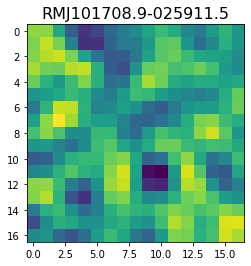

 48%|████▊     | 4889/10099 [07:13<09:11,  9.45it/s]

<class 'pixell.enmap.ndmap'>
[-111.297424 -116.827896 -133.96951  -144.044    -137.07689  -122.86644
 -105.07232   -79.27058   -62.111317  -80.14814  -119.457466 -130.8249
  -99.0162    -62.86032   -52.1686    -51.953785  -46.99417 ]


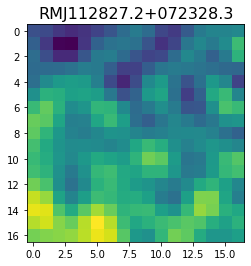

<class 'pixell.enmap.ndmap'>
[-94.00218   -58.682686  -21.542892  -16.490019  -34.083866  -39.81681
 -30.765532  -37.42996   -65.30188   -76.51186   -47.4847     -8.683638
  -1.3430032 -21.660955  -35.362324  -28.74895   -18.67209  ]


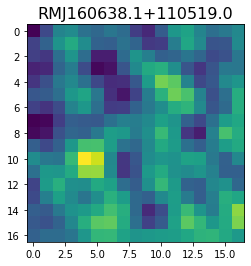

 48%|████▊     | 4891/10099 [07:14<11:22,  7.63it/s]

<class 'pixell.enmap.ndmap'>
[ -92.5005   -130.42729   -75.33047   -14.86708   -61.301437 -160.41228
 -151.09724   -22.998346   41.745155  -61.17929  -196.60008  -194.96675
  -92.65996   -41.729103  -73.54489   -95.093315  -66.52326 ]


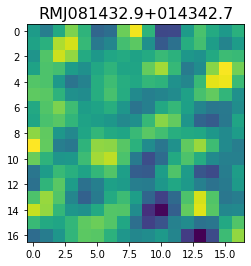

 48%|████▊     | 4892/10099 [07:14<12:55,  6.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -8.69256    -2.6257129 -41.187355  -64.70333   -41.292736   -6.439725
   8.272222   16.168457   31.284193   43.142467   47.26836    50.598083
  43.568283   14.577647  -12.091289   -2.3096986  31.100925 ]


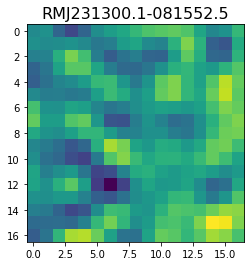

 48%|████▊     | 4894/10099 [07:14<12:49,  6.77it/s]

<class 'pixell.enmap.ndmap'>
[139.58687  146.96951  146.74953  155.60558  170.9667   163.68922
 128.94232  102.00292  104.01474  113.768394 111.98767  109.073524
 108.734276  92.15157   63.88405   65.67377  112.40384 ]


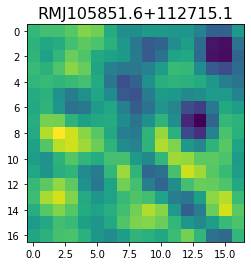

 48%|████▊     | 4895/10099 [07:15<14:27,  6.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  40.248165  108.908775  170.42677   101.64076   -54.6      -103.691185
   28.495504  181.84209   197.0412    123.15525    81.855      57.564003
  -25.560846 -112.775986  -80.7429     49.671284  125.91842 ]


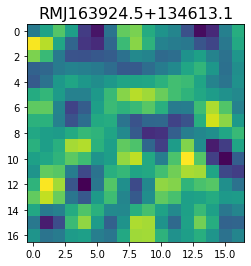

 48%|████▊     | 4897/10099 [07:15<13:19,  6.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.141563   22.234169   18.394985    6.393534  -19.356623  -32.262356
 -16.931099   -5.5187893 -28.25674   -54.247425  -37.062885    2.0136735
   2.5608544 -35.325344  -52.257366  -29.485825  -13.895338 ]


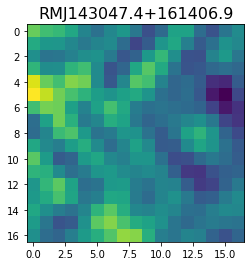

 49%|████▊     | 4900/10099 [07:15<11:17,  7.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  47.87055   -27.394472 -140.01451  -173.91301  -131.60103   -89.66373
  -73.093636  -48.64544   -16.963264  -28.22948   -96.905136 -166.0991
 -179.40013  -141.67244   -89.84454   -47.175976  -26.949919]


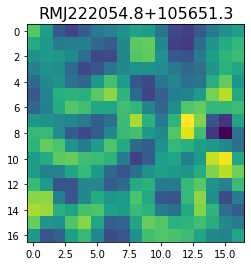

 49%|████▊     | 4902/10099 [07:15<10:57,  7.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-322.402    -231.01476  -140.49847  -193.37152  -377.21228  -477.69397
 -354.19562  -151.05487  -105.138275 -224.59132  -314.1261   -275.5636
 -211.459    -221.24052  -256.17993  -238.19736  -199.95862 ]


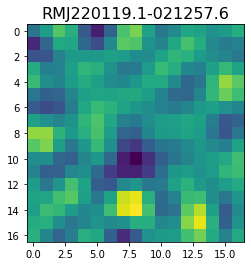

 49%|████▊     | 4904/10099 [07:16<10:47,  8.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  8.9705715 -11.231817  -53.588627  -65.86215   -36.43059    -2.4364212
   3.459446  -12.164168  -20.938229   -5.5217857  27.66443    55.788292
  56.449615   25.669014  -16.193724  -39.029587  -27.335129 ]


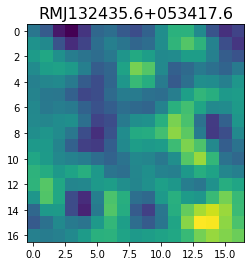

 49%|████▊     | 4906/10099 [07:16<12:03,  7.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 74.05844   67.562775  63.815773  68.948296  86.267204 108.77149
 110.23774   74.320274  38.62396   62.989254 135.27522  166.96504
 118.21475   61.90477   72.098694 113.17059  108.34072 ]


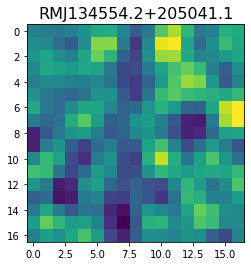

 49%|████▊     | 4908/10099 [07:16<11:45,  7.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-80.3028    -39.093872    8.365862    2.9213257 -28.556774  -22.956184
  14.581201   29.998047   16.01885     9.460239   11.407178  -10.825694
 -50.630554  -65.385826  -50.06938   -39.37864   -39.01652  ]


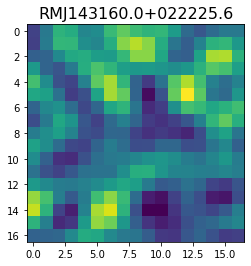

 49%|████▊     | 4911/10099 [07:17<10:06,  8.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.368147   -2.9501693 -10.207066   19.31657    49.71808    41.28002
  13.722017    9.547068   28.769428   38.387333   22.82254    -2.2493787
 -10.868297    8.298493   34.309856   29.978529   -5.214877 ]


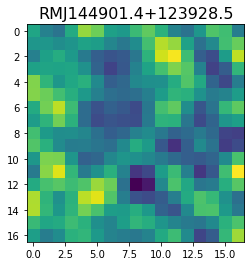

 49%|████▊     | 4914/10099 [07:17<09:22,  9.21it/s]

<class 'pixell.enmap.ndmap'>
[-39.49452   -41.72955   -23.693848   -1.1160855  -7.110872  -44.60959
 -74.40008   -67.36243   -44.48345   -42.280666  -59.277294  -64.9114
 -47.735275  -25.632452  -15.30373   -17.584532  -29.45566  ]


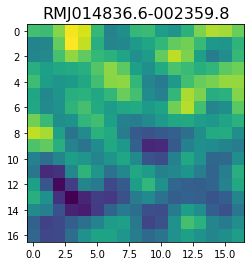

 49%|████▊     | 4915/10099 [07:17<10:55,  7.91it/s]

<class 'pixell.enmap.ndmap'>
[169.875    200.19598  230.17178  220.53374  185.00986  171.557
 181.64874  173.3561   144.5252   137.4911   152.98766  140.48271
  90.80286   60.066963  80.42462  115.37056  126.64145 ]


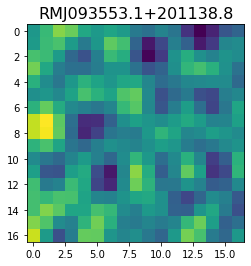

 49%|████▊     | 4916/10099 [07:17<12:28,  6.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 56.842506  48.525177  61.119755  78.2074    91.35073   99.145035
 102.14956  109.23402  123.37019  121.27096   83.01307   38.979183
  41.47499   88.88346  128.0707   134.97285  136.97102 ]


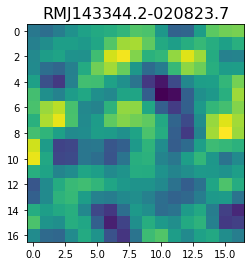

 49%|████▊     | 4918/10099 [07:18<11:49,  7.30it/s]

<class 'pixell.enmap.ndmap'>
[-7.7868714e+00  1.5531398e+00  2.5302574e+01  2.5098948e-02
 -8.1215759e+01 -1.2518559e+02 -9.2539749e+01 -6.2119114e+01
 -7.8423447e+01 -7.9028465e+01 -4.1377022e+01 -4.7940170e+01
 -1.2283532e+02 -1.5774625e+02 -9.7149780e+01 -4.7412457e+01
 -9.3996277e+01]


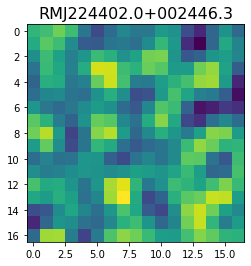

 49%|████▊     | 4919/10099 [07:18<13:33,  6.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-151.5037   -151.59955  -134.84341  -114.66927  -109.049706 -108.27669
  -91.18678   -72.817795  -88.940765 -128.1954   -138.30742  -114.21249
 -112.565    -151.79897  -170.28262  -126.7183    -73.76325 ]


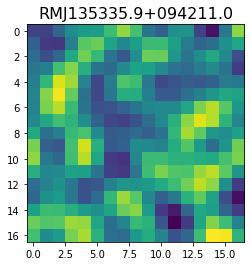

 49%|████▉     | 4927/10099 [07:18<05:54, 14.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 100.885025  181.23177    17.362638 -191.40692  -192.40143   -54.58044
  -28.998747 -133.44016  -174.39105  -132.82764  -169.00969  -236.50888
 -103.852066  167.14426   210.76012   -39.50933  -194.5357  ]


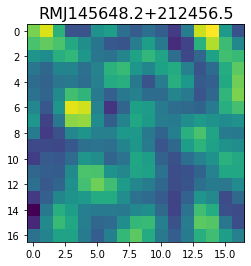

 49%|████▉     | 4930/10099 [07:18<06:24, 13.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[371.85883   653.8144    460.6981     45.46399   -13.572452  260.46286
 362.37405   143.09238   -49.03268     4.6677866 116.31804    82.3714
 -27.672878  -78.56671   -85.471825  -82.227516   11.953573 ]


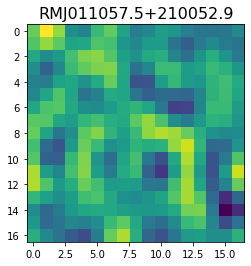

 49%|████▉     | 4932/10099 [07:19<07:30, 11.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-10.197776   5.304909 -23.208475 -46.29571  -30.380995  -8.622473
 -25.631647 -60.984818 -57.773952 -12.878602  13.451856 -16.565222
 -63.611023 -62.731094  -8.079949  40.96577   38.34966 ]


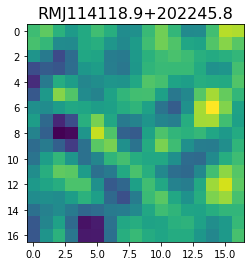

 49%|████▉     | 4934/10099 [07:19<08:38,  9.96it/s]

<class 'pixell.enmap.ndmap'>
[ 3.6387491 15.18657   68.215065  78.80198   37.920895  19.865923
 53.05254   78.395164  56.44569   30.93235   49.61218   88.06852
 94.92661   66.212265  34.493176  17.353537  13.130465 ]


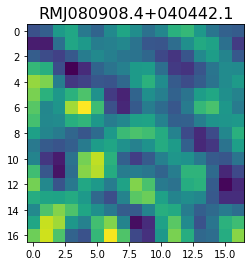

<class 'pixell.enmap.ndmap'>
[  3.0245469 -18.498638  -39.172092  -12.525194   15.268237  -12.795345
 -50.407696  -32.269375    2.9407961  -3.2367225  -8.457104   40.90588
  90.67956    71.124245   19.122389    2.6224618  12.601695 ]


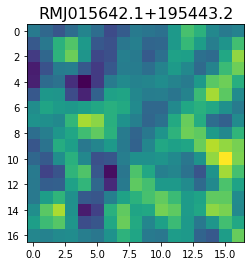

 49%|████▉     | 4936/10099 [07:19<11:39,  7.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 21.35314     9.873309   38.698048   76.50998    86.56217    72.53145
  59.633266   54.614418   46.705723   29.404919    4.6659865 -17.841
 -18.236652   13.425855   48.895927   43.508167   -4.088669 ]


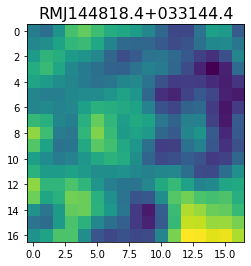

 49%|████▉     | 4938/10099 [07:20<11:52,  7.24it/s]

<class 'pixell.enmap.ndmap'>
[ 36.07146    65.99585    77.27413    43.526714   12.13423    28.764418
  73.11483   101.328186  103.24618    89.38229    61.507797   23.393814
  -6.2512    -11.293514    6.3055973  33.377018   54.911343 ]


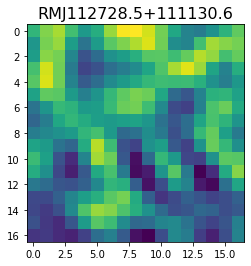

 49%|████▉     | 4939/10099 [07:20<13:08,  6.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-164.26158  -222.11803  -177.09688   -89.116394  -94.86578  -173.67488
 -193.29092  -145.42241  -141.80847  -200.65897  -227.39638  -198.46678
 -185.01134  -196.94322  -172.09964  -117.52368  -102.58932 ]


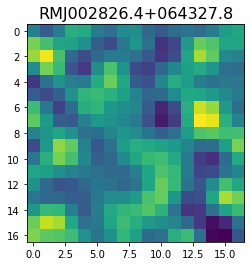

 49%|████▉     | 4942/10099 [07:20<10:45,  7.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  12.23476     41.42358    -68.12621     14.503263   257.28342
  245.7305     -65.60609   -252.03915   -131.85086      0.9648521
  -82.28073   -237.69067   -243.81874    -91.50251     48.89902
   21.344137  -121.68375  ]


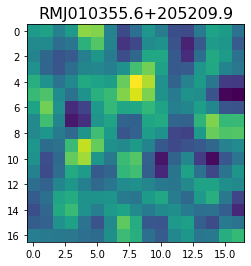

 49%|████▉     | 4946/10099 [07:20<08:51,  9.70it/s]

<class 'pixell.enmap.ndmap'>
[ -84.21601   -94.37031  -118.00195  -142.10281  -142.27762  -118.43298
 -102.58124  -113.71136  -130.09169  -127.06943  -115.69471  -117.0755
 -122.81995  -113.27687   -96.657875  -96.404915 -111.81794 ]


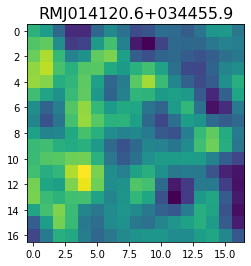

 49%|████▉     | 4948/10099 [07:21<09:31,  9.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-9.14935532e+01 -7.95092239e+01 -9.43619843e+01 -1.07039635e+02
 -1.12863396e+02 -8.39912338e+01 -6.24775030e-02  6.68348083e+01
  2.31511955e+01 -8.25572052e+01 -1.07894119e+02 -4.07754822e+01
 -1.80686779e+01 -9.46877975e+01 -1.61401047e+02 -1.39029816e+02
 -9.19968185e+01]


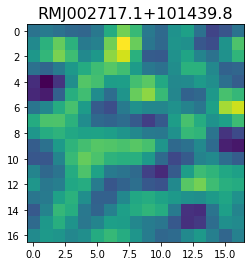

 49%|████▉     | 4951/10099 [07:21<09:08,  9.38it/s]

<class 'pixell.enmap.ndmap'>
[88.19162   92.31114   84.608025  61.54489   28.417025   5.5971146
 10.491411  35.278248  51.885105  41.534252  13.697621  -6.536954
 -4.2570596 15.552663  37.58006   47.92541   39.579998 ]


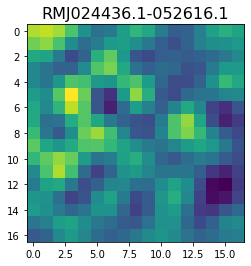

 49%|████▉     | 4952/10099 [07:21<11:00,  7.80it/s]

<class 'pixell.enmap.ndmap'>
[ 70.13145   76.873116  92.10527  100.065475  92.990906  85.2323
  89.08479   94.01579   87.46223   79.7716    86.786095  99.81928
  96.99197   78.661736  68.8773    81.62233  103.54381 ]


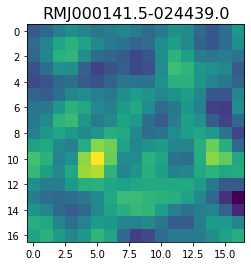

 49%|████▉     | 4953/10099 [07:22<12:43,  6.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.798162  67.069565 102.85417  127.01877  140.59142  126.077545
  85.75627   50.391834  45.49631   80.32323  148.06436  202.02124
 173.68735   64.23897  -27.511309 -24.576977  29.910877]


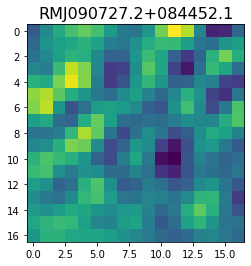

 49%|████▉     | 4955/10099 [07:22<12:38,  6.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -75.41431   -76.44427   -69.85875   -71.13845   -77.97487   -66.32248
  -46.53518   -59.076527  -98.262634 -111.31822   -87.454994  -73.12161
  -86.683784  -94.671394  -82.72262   -73.66661   -68.482704]


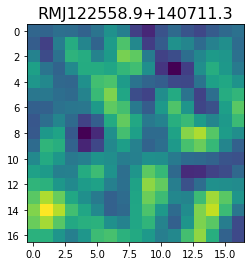

 49%|████▉     | 4957/10099 [07:22<12:16,  6.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -72.020386  -88.87458   -95.98781   -90.60752   -82.82698   -86.57013
  -99.83589  -105.949974 -101.54889  -103.30229  -114.88294  -114.36669
  -94.86085   -86.56539  -107.72138  -125.25524  -105.84285 ]


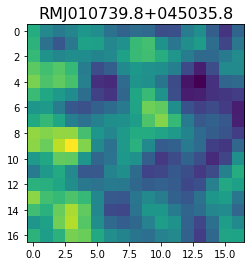

 49%|████▉     | 4959/10099 [07:22<12:20,  6.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 93.16602    34.638268   -1.987814   19.57519    26.049076  -17.977968
 -48.51809   -28.245895   -6.4881387 -10.397919    1.9304612  38.12916
  37.84342   -15.383534  -52.542076  -28.553528   15.157366 ]


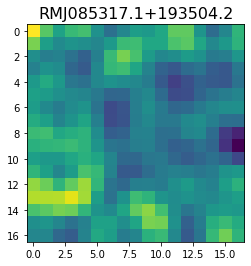

 49%|████▉     | 4970/10099 [07:23<05:13, 16.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -85.248276  -93.60247  -106.20321  -137.68707  -147.49196  -114.77276
  -91.461876 -113.87094  -137.47993  -121.838066  -98.01673   -96.45407
  -94.62175   -82.614586  -91.137566 -119.08736  -123.951164]


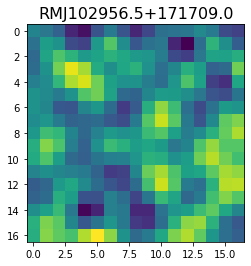

 49%|████▉     | 4973/10099 [07:23<05:43, 14.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 55.084812 103.026344 168.45119  146.29068   79.619644  84.92857
 156.66844  178.12799  115.65864   66.46342   89.24331  114.32762
  77.311905  33.74332   60.105183 119.359924 118.84569 ]


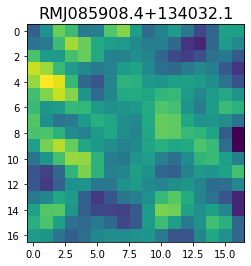

<class 'pixell.enmap.ndmap'>
[ 46.947685   43.25277     2.2485018 -33.53843   -26.999054    4.64391
  20.879404   18.691835   24.209442   32.48568    11.031538  -28.238384
 -28.55711    12.923755   22.051865  -30.136484  -63.774235 ]


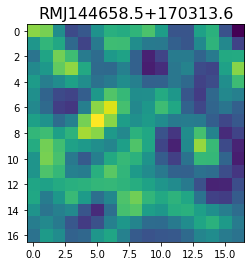

 49%|████▉     | 4976/10099 [07:24<08:31, 10.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 3.4251395e+02  2.8293283e+02  2.4354776e+02  1.6690112e+02
 -2.7761295e+00 -9.2820312e+01  4.5701250e-01  8.7753960e+01
  2.3543736e+01 -5.3049427e+01 -1.4156846e+01  4.8055370e+01
  4.2823029e+01  2.7103308e-01 -7.8430931e+01 -1.9486864e+02
 -2.1207326e+02]


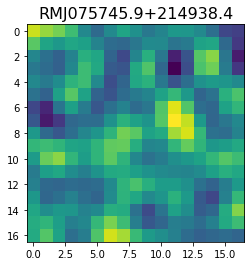

 49%|████▉     | 4979/10099 [07:24<08:30, 10.04it/s]

<class 'pixell.enmap.ndmap'>
[ 64.542      39.733063   23.369284   61.82907    77.54992    31.622541
   2.3278444  25.390583   23.175573  -36.12988   -70.22454   -37.637295
 -10.150522  -34.33374   -56.96593   -37.076443  -15.910113 ]


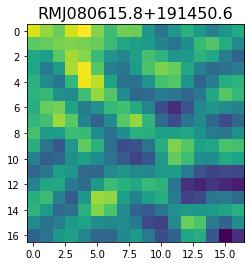

<class 'pixell.enmap.ndmap'>
[-71.64921  -70.677246 -47.65602  -26.390844 -28.86537  -49.060486
 -62.399765 -57.39911  -47.78389  -50.282463 -59.60612  -56.80164
 -40.219666 -32.006466 -45.515846 -60.906128 -50.560493]


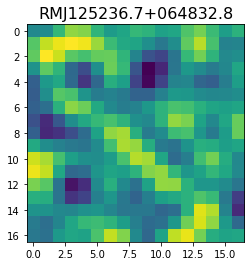

 49%|████▉     | 4981/10099 [07:24<11:12,  7.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-151.91911 -177.80113 -137.24388  -78.52391  -92.17203 -139.90948
 -146.66112 -144.34702 -173.6715  -180.99416 -133.92387  -96.46637
 -108.60217 -133.53098 -156.25366 -189.77399 -195.17416]


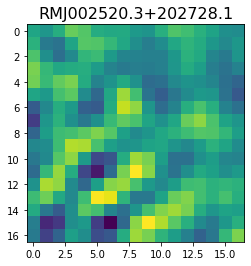

 49%|████▉     | 4983/10099 [07:25<10:53,  7.83it/s]

<class 'pixell.enmap.ndmap'>
[134.08084  189.74806  187.78258  157.01788  191.16927  263.1345
 275.37747  224.16861  185.18756  190.7818   208.56291  191.10184
 111.48955   17.264835  33.9837   202.96924  353.27786 ]


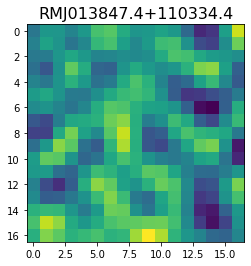

 49%|████▉     | 4985/10099 [07:25<10:45,  7.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -84.46308  -101.84146   -85.21057   -61.61443   -81.08696  -133.03403
 -155.16031  -129.11736  -104.47295  -114.40213  -130.48209  -124.03984
 -114.07158  -123.248604 -135.75981  -132.88571  -129.12794 ]


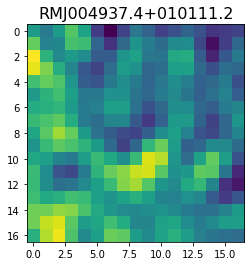

 49%|████▉     | 4986/10099 [07:25<12:00,  7.09it/s]

<class 'pixell.enmap.ndmap'>
[ -77.141785 -185.78099  -227.00056  -160.25674   -90.31504   -91.50825
 -125.61865  -147.28452  -168.60516  -194.36166  -197.242    -181.0451
 -179.40636  -181.31914  -145.92107   -93.37671   -88.39809 ]


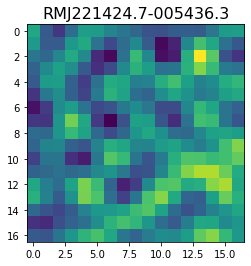

 49%|████▉     | 4987/10099 [07:25<13:13,  6.45it/s]

<class 'pixell.enmap.ndmap'>
[ 76.938965  91.96306   49.447117  24.143875  44.040726  85.4045
 112.6095    94.086716  25.859894 -40.9715   -38.526794  36.0832
 111.35752  121.30677   64.71613  -12.405683 -59.468445]


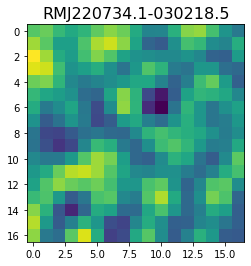

 49%|████▉     | 4988/10099 [07:26<14:40,  5.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-127.08788   -99.34495   -91.20958  -105.506004 -123.63541  -135.95471
 -147.82329  -155.21823  -141.04674  -108.29392   -92.13089  -115.038956
 -147.8439   -147.14964  -120.91978  -117.50463  -149.01167 ]


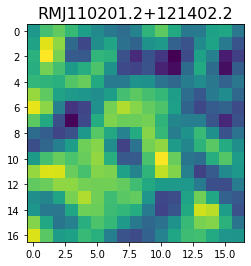

 49%|████▉     | 4990/10099 [07:26<13:35,  6.26it/s]

<class 'pixell.enmap.ndmap'>
[-145.54173  -137.24432  -111.35469  -110.19534  -114.58707  -101.689735
 -102.71031  -143.53893  -176.05157  -139.16447   -60.755398  -29.16704
  -72.56214  -127.64534  -132.1486    -97.61963   -74.85475 ]


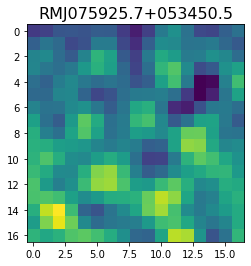

 49%|████▉     | 4991/10099 [07:26<15:20,  5.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[144.40915   76.38232   39.53063   63.963    104.41775  114.04751
  89.15112   52.611378  35.07642   62.101147 120.390175 148.62112
 105.38919   35.75029   18.533157  52.11853   56.068607]


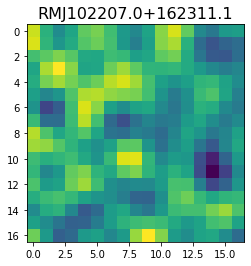

 49%|████▉     | 4995/10099 [07:26<10:07,  8.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[22.458046   6.365576  -4.381616   3.6572263 20.392147  29.351103
 25.191612  13.496983   4.477035   7.9186015 24.8713    42.843914
 46.868713  36.955566  28.531805  33.717365  46.72497  ]


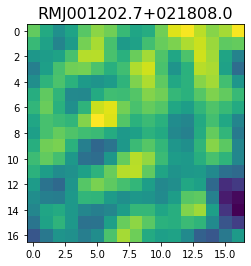

 49%|████▉     | 4997/10099 [07:27<10:29,  8.10it/s]

<class 'pixell.enmap.ndmap'>
[238.23163 229.41988 245.36766 253.76965 247.01794 230.50215 197.54251
 166.7597  183.46306 241.05606 271.78088 247.18271 206.80956 176.02347
 147.85312 141.94656 177.30571]


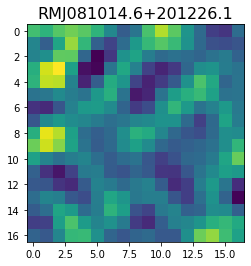

 49%|████▉     | 4998/10099 [07:27<11:59,  7.09it/s]

<class 'pixell.enmap.ndmap'>
[ 74.0865     86.26655    79.707726   38.456905    8.0228405  42.446247
 109.2202    122.26103    67.35685    20.640192   34.318554   74.30227
  89.551765   81.35721    75.85315    75.43816    69.18415  ]


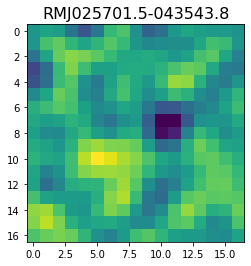

 49%|████▉     | 4999/10099 [07:27<15:02,  5.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[113.4475   162.93716  118.71482   21.745647 -10.992408  69.98493
 180.09303  203.18367  125.13174   35.947704  22.28453   85.60576
 155.63733  165.59584  117.0563    74.044876  87.576775]


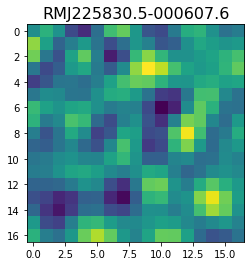

 50%|████▉     | 5002/10099 [07:28<11:30,  7.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -66.50014   -71.25974   -52.789547  -29.444925  -34.95507   -71.203865
 -103.33734  -104.839615  -90.08736   -88.83993  -100.0289    -94.48508
  -64.41585   -42.199493  -53.752663  -77.01675   -74.80189 ]


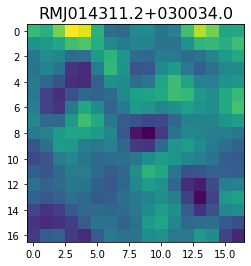

 50%|████▉     | 5004/10099 [07:28<11:12,  7.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-32.26687  -39.618683 -47.595676 -53.00496  -59.133183 -67.626274
 -68.595215 -52.165756 -28.104094 -18.497179 -28.520784 -40.00708
 -39.789867 -38.388763 -49.356537 -63.86071  -62.640446]


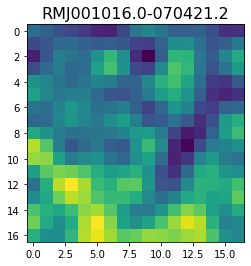

 50%|████▉     | 5009/10099 [07:28<08:04, 10.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -1.2090113  -18.0687     -91.03684   -161.5118    -169.20947
 -114.68627    -73.05256   -102.330574  -158.51279   -162.9044
 -125.07277   -116.176834  -142.26018   -139.4858     -90.21725
  -53.23539    -69.70428  ]


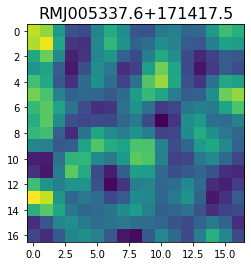

 50%|████▉     | 5015/10099 [07:28<06:20, 13.34it/s]

<class 'pixell.enmap.ndmap'>
[ -89.774635  -107.956024  -102.789986   -93.42306    -98.92963
 -100.649376   -81.17259    -60.437813   -57.700603   -59.670593
  -56.322357   -59.418324   -58.902332   -20.366676    42.541885
   57.224392    -6.2543707]


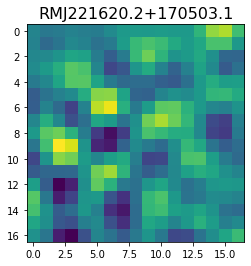

 50%|████▉     | 5023/10099 [07:29<04:39, 18.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 91.39052   88.36201   11.563841 -33.05041  -13.189992   8.447157
  10.478832  16.292255   8.451992 -21.848612 -13.15512   54.460274
  87.65555   33.08643  -23.29665  -12.780685   6.742388]


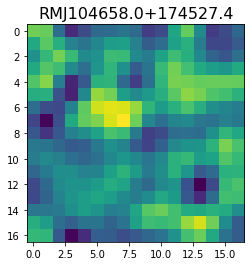

<class 'pixell.enmap.ndmap'>
[ -6.512349 -80.45714  -17.352917  70.91609   90.64783   83.13405
 114.803345 152.7827   132.43652   81.87084   79.87168  121.89762
 127.02877   70.32454   12.406199 -12.200426 -40.416534]


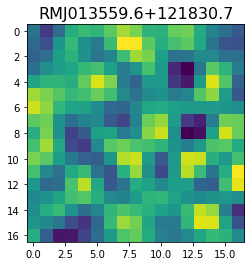

 50%|████▉     | 5026/10099 [07:29<06:48, 12.41it/s]

<class 'pixell.enmap.ndmap'>
[ -81.08439     58.43677     74.81936    -12.730129   -80.800644
  -97.06802   -110.70634   -100.13834    -20.473717    46.635437
    5.6043606  -46.70209     29.631895   127.1458      37.713364
 -160.19351   -185.93439  ]


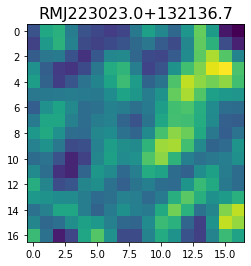

<class 'pixell.enmap.ndmap'>
[116.85011  106.79149   99.840546  82.97854   67.95976   78.720985
  97.18687   87.85924   62.789055  58.73727   71.38276   73.64043
  71.17745   80.629074  85.261734  67.37967   49.45489 ]


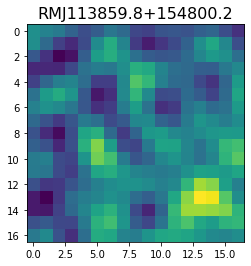

 50%|████▉     | 5033/10099 [07:30<06:22, 13.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[102.97496   60.690216  34.788334  78.473    103.1999    53.619434
  18.912252  65.43251  113.02159   89.39552   61.259026  94.64511
 124.30103   86.52691   51.625954  94.89947  155.18913 ]


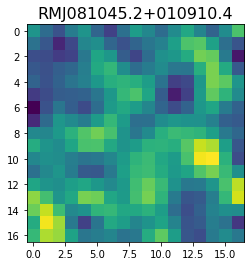

 50%|████▉     | 5036/10099 [07:30<06:42, 12.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 37.371677   31.870523   24.711243   18.660833   10.937135    2.8265438
   8.098012   31.219343   48.996628   38.47511    10.297061  -10.809156
 -21.149414  -24.900423   -8.850749   31.51805    62.021217 ]


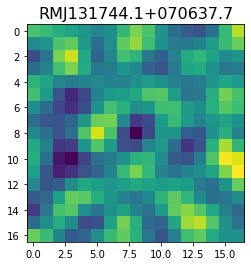

 50%|████▉     | 5046/10099 [07:30<04:15, 19.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


 50%|█████     | 5053/10099 [07:31<03:04, 27.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -39.601303   -10.367554   -23.738562   -65.637856   -97.9952
 -101.4848     -83.35849    -52.057423   -12.395305    17.027355
   16.052317    -1.8837832   -0.7915793   23.352976    35.769463
   22.19125     13.390776 ]


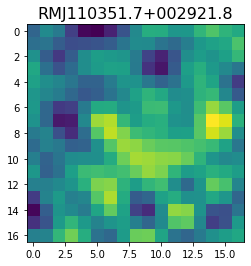

 50%|█████     | 5060/10099 [07:31<03:27, 24.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  4.795812  24.488934  38.901836  19.089706 -10.788638  -7.510242
  18.04517   30.25149   41.00386   74.07971   97.97526   81.838295
  67.58108   91.27951   95.64988   28.833906 -36.36542 ]


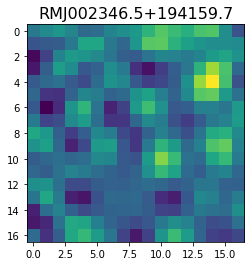

<class 'pixell.enmap.ndmap'>
[ -9.037485   -38.42816    -50.245747    -0.85213095  59.226925
  50.31696    -17.986664   -64.17766    -55.22219    -36.523357
 -40.511055   -39.95235    -15.6290245   -3.5711894  -30.891548
 -54.800846   -22.974964  ]


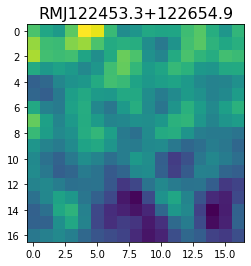

 50%|█████     | 5064/10099 [07:32<05:20, 15.73it/s]

<class 'pixell.enmap.ndmap'>
[ 66.34192   95.11208  112.13435  114.53597  105.857185  93.22945
  86.61342   85.98196   78.41058   62.47238   60.985016  88.818726
 121.897194 124.824615 101.32497   89.18434  106.89572 ]


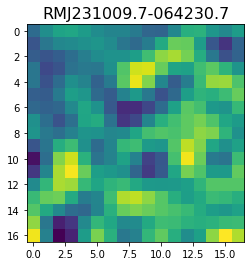

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -43.001617   -132.60074    -208.98753    -150.63544       5.4337993
   77.246086     -2.3062868   -83.74093     -48.928043      0.40724823
  -59.79161    -142.67415     -97.47006      25.163141     52.791126
  -35.984406   -105.00057   ]


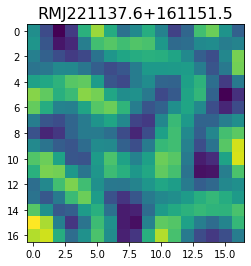

 50%|█████     | 5067/10099 [07:32<07:20, 11.42it/s]

<class 'pixell.enmap.ndmap'>
[15.301337   19.727034   18.542437    7.250893   -2.1981263  -4.673803
  0.48691103 17.891838   39.2586     42.53918    29.56519    32.101807
 57.082672   66.587      41.909477   21.618057   36.57012   ]


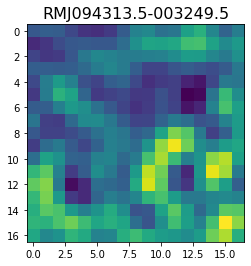

 50%|█████     | 5070/10099 [07:32<07:24, 11.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.908794 -43.310055 -67.757286 -92.152145 -84.77659  -47.863773
 -24.720919 -42.724228 -77.84726  -93.92815  -88.891685 -80.326256
 -71.74627  -59.377884 -52.772366 -62.884663 -82.45904 ]


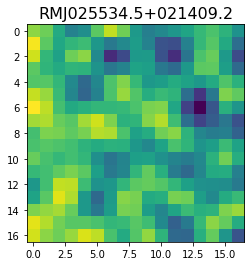

 50%|█████     | 5073/10099 [07:33<07:32, 11.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-115.594215  -97.32441   -59.70258   -23.070284    5.999345   16.772854
  -32.53626  -152.57327  -236.9526   -151.9397     51.452957  143.68684
   14.767747 -157.29051  -151.50618    -6.960319   69.46995 ]


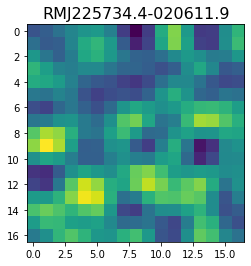

 50%|█████     | 5075/10099 [07:33<08:12, 10.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 64.481064  137.7363     92.08744    -9.59591     4.9368024 101.019264
  89.77211   -28.291176  -63.00229    23.276413   61.211582  -16.589128
 -79.34956   -44.185955   14.818631   32.11256    26.488523 ]


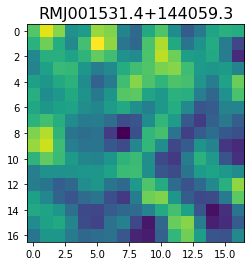

 50%|█████     | 5077/10099 [07:33<08:51,  9.45it/s]

<class 'pixell.enmap.ndmap'>
[-29.882711   -4.904036  -13.34725   -13.885889    6.79358     5.359184
 -30.17085   -51.07151   -33.032352  -16.44645   -30.903082  -42.38528
 -13.6287565  29.201374   32.548798   -6.405327  -36.95724  ]


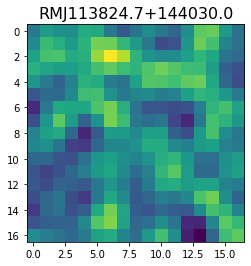

<class 'pixell.enmap.ndmap'>
[-57.23275   -62.87813   -33.75743    -7.7545023 -13.918059  -43.176643
 -67.584785  -70.56584   -57.95727   -50.169212  -60.77874   -77.69066
 -76.22618   -56.489742  -48.985817  -70.74921   -96.280685 ]


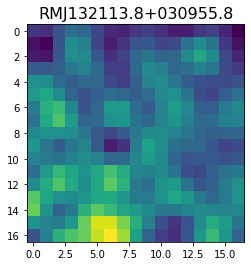

 50%|█████     | 5079/10099 [07:34<11:45,  7.12it/s]

<class 'pixell.enmap.ndmap'>
[-129.06184   -273.31903   -207.51369    -46.339207     4.1964827
  -62.496082   -96.41998    -24.952335    72.27471     82.64201
   -5.050494   -87.2938     -69.50003     14.3124695   53.800068
   12.340019   -51.258026 ]


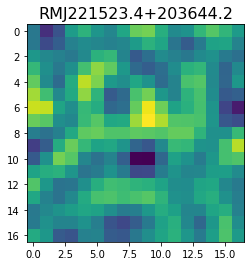

 50%|█████     | 5080/10099 [07:34<12:46,  6.55it/s]

<class 'pixell.enmap.ndmap'>
[-242.95654  -192.64937   -36.41709    40.212593  -78.55873  -265.61298
 -304.79074  -170.05315   -43.568874  -63.335396 -165.48242  -214.6144
 -191.47252  -171.85143  -181.91997  -174.31718  -129.69524 ]


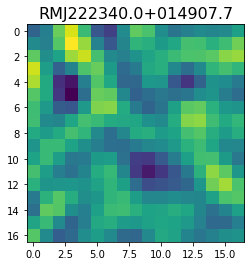

 50%|█████     | 5081/10099 [07:34<14:20,  5.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  55.718193      9.868922    -48.79409     -52.910183    -65.48287
 -119.52497    -119.05931     -19.20464      55.547768     -2.5877223
 -112.48434    -133.62169     -62.677948      1.3254671    10.315319
   -1.9692417     0.14278647]


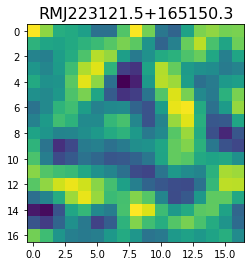

 50%|█████     | 5085/10099 [07:34<10:08,  8.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-144.80644   -115.66614    -16.919693    35.51241     -7.5506253
  -75.1766     -88.40179    -65.35909    -66.60524    -83.727325
  -59.3868      -1.3516566   12.526006   -38.283646   -67.680855
   -9.745479    70.522575 ]


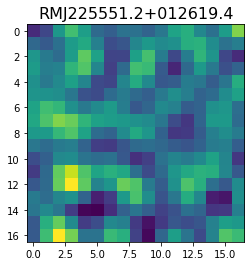

 50%|█████     | 5090/10099 [07:35<07:38, 10.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[62.87873  63.942474 62.3436   53.591915 35.324677 24.445744 40.327618
 67.70675  67.8453   38.70863  24.213406 43.860603 60.481945 45.479736
 24.277096 23.400112 26.333786]


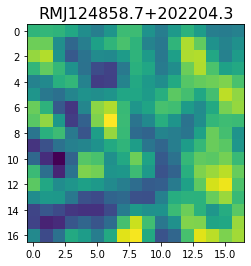

 50%|█████     | 5094/10099 [07:35<07:25, 11.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[286.20728  257.19736  362.1565   459.62415  387.4322   170.82983
 -29.046131 -60.300747  95.14304  280.65854  329.6476   272.2927
 241.83342  227.94681  128.10713  -14.827259 -56.10938 ]


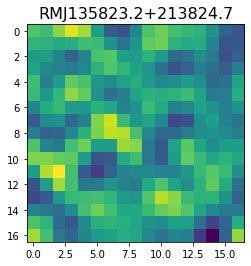

 51%|█████     | 5102/10099 [07:36<05:25, 15.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[246.48874  213.44566  201.16176  212.57037  230.70514  240.10484
 243.95483  252.08986  248.08705  205.06989  151.46205  160.06807
 230.05746  253.68748  170.87778   82.544334 112.5591  ]


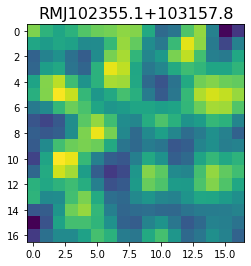

 51%|█████     | 5105/10099 [07:36<05:57, 13.97it/s]

<class 'pixell.enmap.ndmap'>
[ 42.64426    8.716906 -34.339268 -38.837467 -14.767     -5.661482
 -24.066496 -39.748573 -30.723896 -15.895755 -23.69105  -51.260124
 -75.32037  -87.41789  -93.88276  -90.36444  -64.497215]


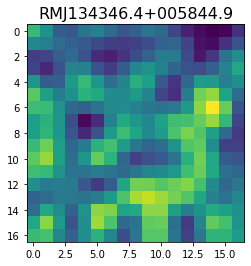

 51%|█████     | 5108/10099 [07:36<06:25, 12.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-4.47785258e-02 -7.84292145e+01 -1.16645561e+02  1.16200600e+01
  1.39049271e+02  7.24619217e+01 -8.57318115e+01 -1.26179489e+02
 -7.30879059e+01 -8.01754303e+01 -1.30185562e+02 -1.07730110e+02
 -5.52969437e+01 -1.01221565e+02 -2.16518967e+02 -2.64636688e+02
 -2.29522522e+02]


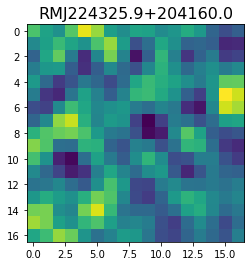

 51%|█████     | 5112/10099 [07:36<06:23, 13.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -15.263338    38.887535    20.54592    -66.03307   -106.54145
  -60.57967    -14.773478   -34.27279    -78.67821    -90.782906
  -75.50659    -61.943256   -51.252285   -29.525986    -2.2470052
    0.5160062  -43.072437 ]


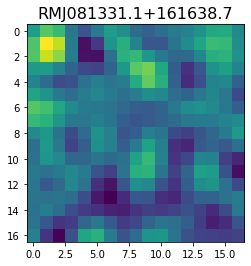

 51%|█████     | 5115/10099 [07:37<06:43, 12.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 75.33295   39.844666 -15.157063 -13.363781  38.286278  59.85387
  37.27033   36.107395  73.355804  93.26519   76.952034  64.262245
  63.89827   45.930573  19.785782  23.011457  42.8641  ]


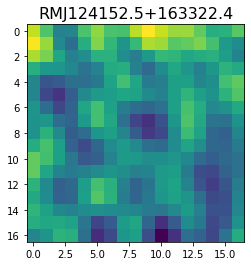

 51%|█████     | 5120/10099 [07:37<06:01, 13.78it/s]

<class 'pixell.enmap.ndmap'>
[149.50461    120.230835    94.07871     31.546825   -18.78256
 -11.781286     0.96522164 -15.265672    -6.610027    36.50673
  34.37992    -15.900379    -2.2155569  103.28492    176.21732
 135.58568     56.553574  ]


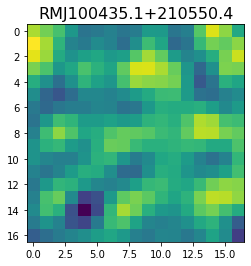

<class 'pixell.enmap.ndmap'>
[  71.344536    52.506573    17.18546      2.7342637  -53.545387
 -154.69156   -203.01917   -161.18959    -94.15633    -37.920284
   15.012768    13.925031   -87.53394   -186.84544   -142.3779
   -8.347266    34.556572 ]


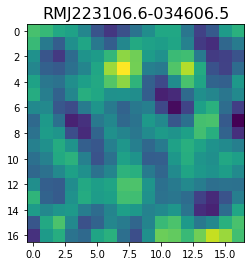

 51%|█████     | 5122/10099 [07:37<08:39,  9.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -64.70333   -87.790436 -122.70295  -125.30717   -92.35042   -71.50087
 -100.02988  -154.99002  -182.25098  -160.45462  -116.2416    -85.86057
  -83.57725  -104.084915 -132.80542  -148.78838  -136.3207  ]


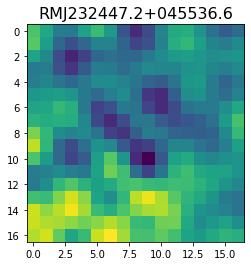

 51%|█████     | 5133/10099 [07:38<04:54, 16.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -2.7188742    1.8516415   -0.91895974  12.436713    38.965366
  50.566715    35.545177    10.779492    -4.0372906   -3.2667649
   6.739771    10.101541    -6.798456   -32.574146   -37.11419
 -13.31914     10.361103  ]


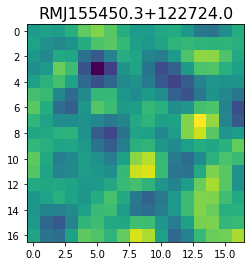

 51%|█████     | 5138/10099 [07:38<05:16, 15.69it/s]

<class 'pixell.enmap.ndmap'>
[-40.277367 -15.821092  -7.202815 -20.561026 -35.945595 -39.353207
 -38.89002  -41.939846 -39.694286 -27.908157 -23.18374  -39.89394
 -64.07012  -69.825    -54.277657 -37.935436 -33.9984  ]


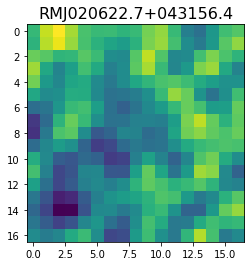

<class 'pixell.enmap.ndmap'>
[ 63.88629   53.367733  49.31389   49.912933  39.364384  13.645826
 -11.203232 -10.776105  25.940708  75.35206   88.7352    43.96221
 -17.86881  -32.244205  12.06063   59.062706  53.410347]


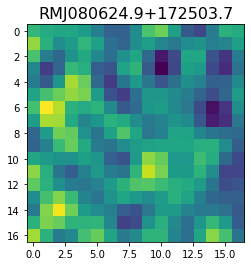

 51%|█████     | 5148/10099 [07:39<04:55, 16.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-210.08917   -192.34125   -208.71255   -210.1724    -143.0496
  -50.885788    -6.7581863  -12.415636   -23.5457     -28.12755
  -50.372437   -97.6964    -135.7126    -121.22707    -57.64104
   -1.216114     8.321177 ]


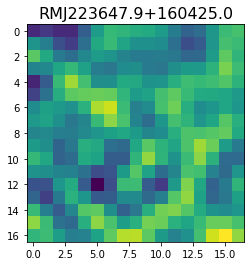

 51%|█████     | 5152/10099 [07:39<05:39, 14.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-108.7803     -77.162766   -40.423634     3.4286253   -2.2826123
  -86.707016  -142.06612    -43.553524   130.22374    159.83405
   -5.8543534 -167.20027   -157.97362    -58.159084   -33.154636
  -90.56463   -115.6101   ]


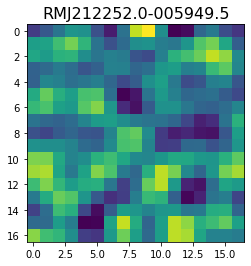

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -22.697586   -68.44371    -42.397636    12.206217    -1.928634
  -79.57777   -118.61594    -72.379616    -4.9070616   14.290938
   -5.1857557  -18.181208   -17.965162   -31.518148   -62.340603
  -71.41472    -27.567371 ]


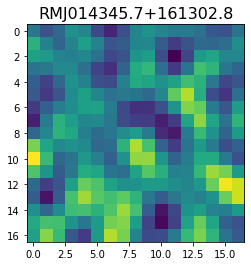

 51%|█████     | 5162/10099 [07:40<05:12, 15.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[216.73218  143.67395   52.578556  37.89311  102.33152  180.22284
 211.81532  182.92085  132.16365  121.47356  167.12952  213.78973
 209.53986  176.01732  159.20547  149.98381  116.293015]


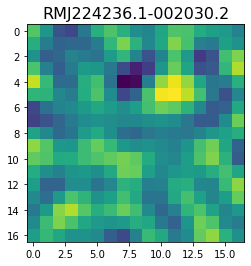

 51%|█████     | 5166/10099 [07:40<05:25, 15.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-106.4308   -117.51191   -73.65672   -37.734657  -63.91961  -110.44542
  -99.027275  -37.536068   -9.46688   -43.438507  -74.9488    -59.049374
  -40.040874  -65.18965   -99.987816  -90.91231   -58.686535]


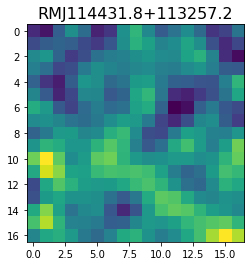

<class 'pixell.enmap.ndmap'>
[-192.13683 -201.64671 -239.94778 -260.43112 -229.83638 -184.59955
 -190.75618 -255.884   -316.50903 -315.92316 -264.50702 -214.82124
 -201.87665 -219.7095  -238.77895 -234.77046 -210.86661]


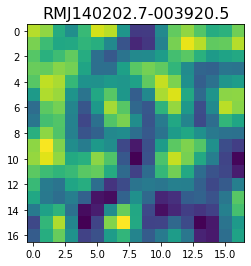

 51%|█████     | 5169/10099 [07:41<07:13, 11.36it/s]

<class 'pixell.enmap.ndmap'>
[13.788941  28.6985    20.275917   5.8116846 14.858712  33.999004
 32.682594  17.457737  15.7697115 28.501886  38.23069   43.418083
 49.472042  46.302082  26.131037   5.684553   4.3896894]


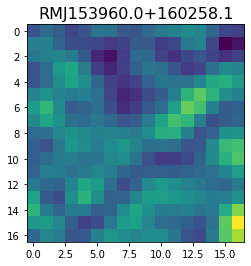

<class 'pixell.enmap.ndmap'>
[ -53.570477   -59.82693    -24.177755     8.470063    -7.8946924
  -68.75569   -114.924324  -103.92075    -57.407677    -8.059996
   31.657969    17.957333   -85.970474  -183.26007   -126.734955
   21.367632    28.863888 ]


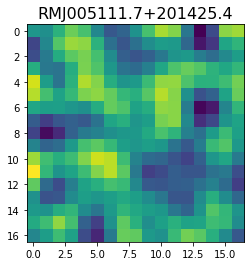

 51%|█████     | 5172/10099 [07:41<08:42,  9.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-65.4074    -38.606506   -3.4060287   1.6387324 -30.191282  -64.27731
 -57.260235   -9.635764   26.510965   13.264544  -18.687757  -16.953606
  11.072364   15.905558   -6.0326705  -6.808178   26.357635 ]


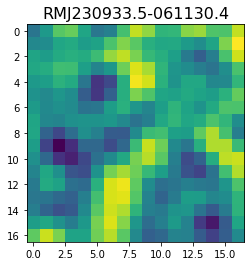

 51%|█████     | 5175/10099 [07:42<08:40,  9.46it/s]

<class 'pixell.enmap.ndmap'>
[  -8.326671   -14.1997385  -23.440632   -37.890015   -17.761965
   42.587265    72.89902     13.628959   -91.714584  -140.92287
  -86.114105    34.212982   146.09428    186.37973    132.61702
   31.485949   -27.025196 ]


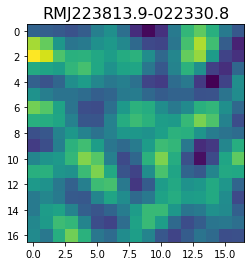

 51%|█████▏    | 5177/10099 [07:42<09:00,  9.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  1.2960677 -15.959042  -31.012259  -17.860744    9.368828   21.881912
   4.712505  -34.04645   -59.24541   -32.74898    31.96414    66.76754
  34.348343  -14.642877  -12.226027   30.742903   50.96473  ]


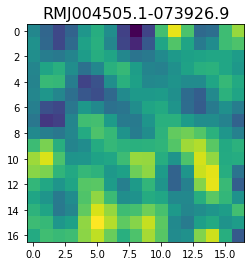

 51%|█████▏    | 5183/10099 [07:42<06:53, 11.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -84.92716   -175.53143   -117.58384     13.587341    66.15841
   44.624615    63.68966    104.4309      40.404984   -98.48023
 -132.0598     -29.104313    37.253258   -16.578722   -63.613598
   -7.9218307   67.333435 ]


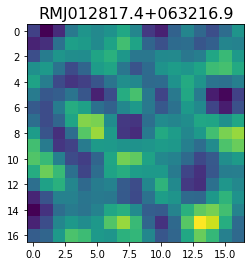

 51%|█████▏    | 5185/10099 [07:42<07:24, 11.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 99.751396 122.30939  132.1021   116.93835   89.044395  74.72997
  85.73147  108.48457  122.94274  122.58292  111.49912   94.73427
  83.7933    99.11473  144.63657  184.9414   175.9824  ]


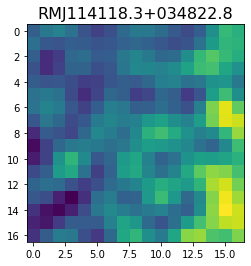

 51%|█████▏    | 5189/10099 [07:43<06:51, 11.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -90.7466     -67.60774   -122.88396   -174.40868   -128.68105
  -45.16956    -27.982065   -61.63201    -68.21154    -39.81995
  -16.848501    -6.441485     2.5945582    3.7178771   -2.9571798
   -7.240348   -24.379822 ]


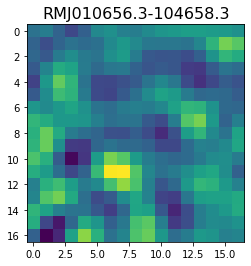

 51%|█████▏    | 5191/10099 [07:43<07:43, 10.60it/s]

<class 'pixell.enmap.ndmap'>
[  -7.2130694  -12.717735   -81.44037   -129.71638   -120.36629
  -86.2982     -76.440186   -93.34773    -93.50901    -62.4571
  -55.579212  -110.20325   -156.0221    -103.669205     5.7624617
   49.78397      4.690532 ]


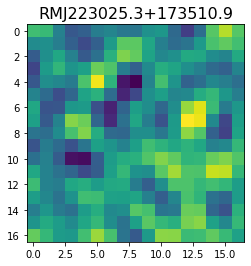

 51%|█████▏    | 5193/10099 [07:43<08:27,  9.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-24.423944 -14.227442  14.02934   44.533203  50.97356   23.94751
 -19.471165 -50.304054 -50.861046 -31.252354 -23.302362 -46.004612
 -76.66998  -74.92259  -39.37612  -15.366406 -33.089424]


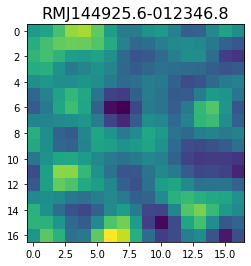

 51%|█████▏    | 5197/10099 [07:44<07:26, 10.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  10.072816     3.684059   -47.291428   -70.41493    -30.348036
  -19.5058    -107.44118   -185.3675    -115.86669     25.430803
   48.230106   -45.51772    -74.23787     -3.7801013  -16.761923
 -185.41414   -310.10446  ]


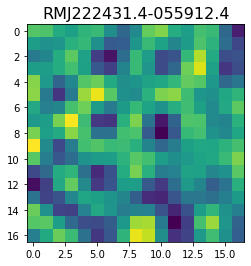

 51%|█████▏    | 5199/10099 [07:44<08:46,  9.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.514538  -35.160225  -19.352314   -1.0589193 -20.894594  -68.11983
 -83.16186   -38.32497    22.25241    41.733917   19.353449   -3.8309364
  -4.7818213   4.750915    8.939818    7.3277187   5.3947735]


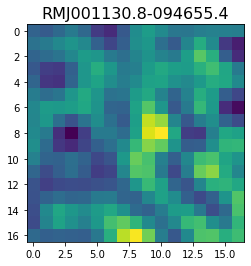

 52%|█████▏    | 5204/10099 [07:44<06:59, 11.68it/s]

<class 'pixell.enmap.ndmap'>
[ -57.49635      11.265173     71.82799      65.1814       -9.357217
 -102.51287    -144.27037     -96.42628     -12.56631      -0.63392407
  -78.64268    -128.32927     -61.66         36.248497     32.681637
  -44.595196    -57.38848   ]


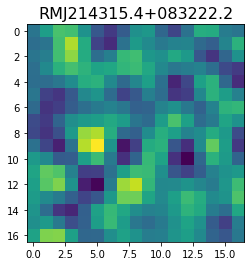

<class 'pixell.enmap.ndmap'>
[165.61989  142.41324  124.13061  116.872925 119.20851  146.71828
 195.8051   217.29305  177.563    120.56277  115.073715 156.6227
 178.57013  156.41817  141.66505  175.90697  222.60217 ]


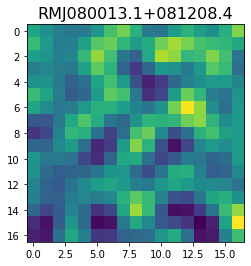

 52%|█████▏    | 5206/10099 [07:45<09:10,  8.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -7.642364   -5.129357  -46.882587 -106.62626  -128.43411   -99.46753
  -62.732815  -67.911    -111.99326  -131.63005   -87.13036   -42.301903
  -83.35906  -166.01173  -163.71695   -77.781654  -48.105957]


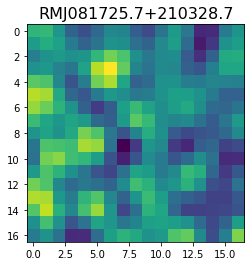

 52%|█████▏    | 5208/10099 [07:45<09:23,  8.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-143.30298     -38.833958     85.58244      15.8412     -138.35764
 -106.37431     100.24544     181.48706       0.42098442 -215.03688
 -209.46867     -36.046837     69.88636      11.52626    -107.63178
 -156.95703     -98.53622   ]


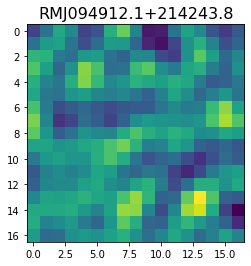

 52%|█████▏    | 5211/10099 [07:45<08:52,  9.18it/s]

<class 'pixell.enmap.ndmap'>
[ 111.92536     49.761204   -33.071907   -54.5623     -17.780346
   -7.1834836  -64.691505  -125.57964   -103.12747     -2.3956418
   80.393074    59.792168   -52.95872   -157.00479   -149.31271
  -19.26446    135.83635  ]


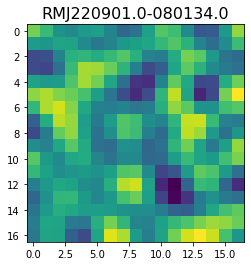

 52%|█████▏    | 5212/10099 [07:45<10:07,  8.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[153.22281  203.82834  187.5344    68.63244  -46.20258  -17.288359
 103.064575 123.18337   19.030283 -23.605156  63.393322 107.14448
  13.334893 -45.825043  65.84931  193.61096  149.23056 ]


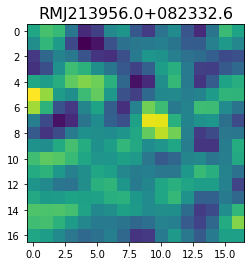

 52%|█████▏    | 5214/10099 [07:46<10:16,  7.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-83.3261    -60.82023   -20.424986  -15.024584  -50.067566  -72.19248
 -55.458996  -31.573198  -24.389826  -19.00886    -7.5853357  -6.695164
 -17.699778  -21.735476  -20.438694  -32.77616   -50.61659  ]


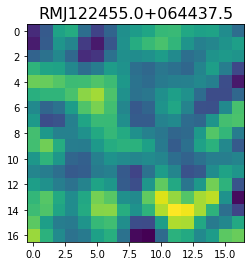

 52%|█████▏    | 5216/10099 [07:46<10:12,  7.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 96.95498   135.89949   135.26756   104.58912    69.04309    49.598568
  49.880608   53.399654   40.596416   12.679621   -7.947124   -2.3290055
  26.158398   57.451706   73.85479    73.885864   70.65101  ]


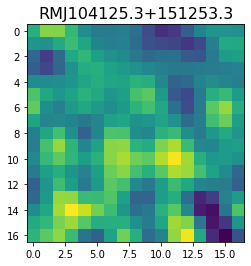

 52%|█████▏    | 5219/10099 [07:46<09:00,  9.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-83.18651  -82.91307  -75.42291  -66.314026 -62.52752  -60.264297
 -53.657387 -46.845516 -47.311348 -52.96409  -54.51992  -48.630146
 -42.33474  -43.399895 -49.83143  -52.743    -48.47586 ]


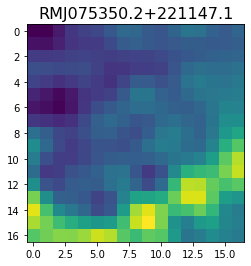

 52%|█████▏    | 5221/10099 [07:46<09:11,  8.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.671017 -86.13017   80.99545  301.58292  311.68207  121.92138
 -36.00896  -44.786648  14.921747  53.23291   56.703575  32.352634
  20.200994 100.70635  254.14032  304.57727  155.73311 ]


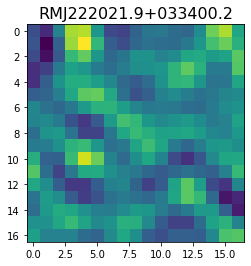

 52%|█████▏    | 5226/10099 [07:47<07:03, 11.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 75.19542   39.42986   16.996683  28.045256  51.977806  63.765522
  62.206985  55.463596  43.59174   29.927967  30.056675  48.93453
  61.443947  39.4071    -5.999562 -32.572926 -21.435326]


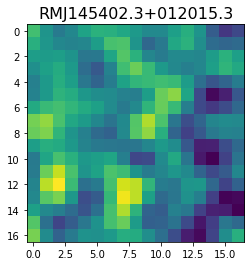

 52%|█████▏    | 5238/10099 [07:47<03:48, 21.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  0.35575306  35.112865    69.59586     80.11139     60.875614
  24.94804     -6.5648794  -21.697824   -23.18318    -17.523783
  -9.043252    -6.0038133  -15.453313   -25.621378   -12.996676
  21.780518    44.734303  ]


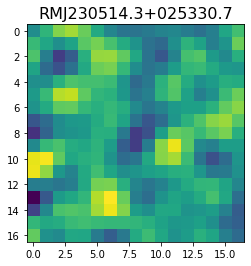

 52%|█████▏    | 5241/10099 [07:47<04:31, 17.86it/s]

<class 'pixell.enmap.ndmap'>
[119.8379   128.93904  145.43132  123.85943   70.83131   49.395004
  93.23602  154.47824  167.60875  139.3507   128.77864  149.04439
 149.2817   107.74569   79.57084  111.869194 163.70221 ]


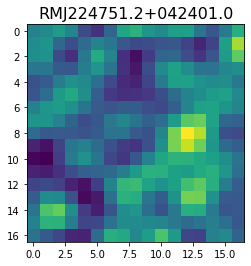

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[105.220604 148.82053  159.20119  117.28778   56.714046  33.60012
  61.525238  95.152176  91.09248   63.398067  55.16376   74.04458
  89.91052   86.873146  79.69154   77.82963   69.196846]


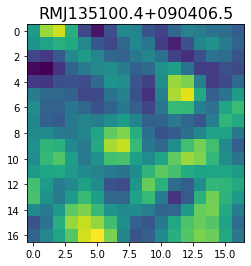

 52%|█████▏    | 5251/10099 [07:48<04:19, 18.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  0.29755306   6.7885656   17.285528    17.504076    -7.2133265
 -41.890675   -44.83539      1.5029398   55.831646    62.952297
  26.381193    -0.6301829    5.5590205   15.550593    10.406522
  13.959085    38.47443   ]


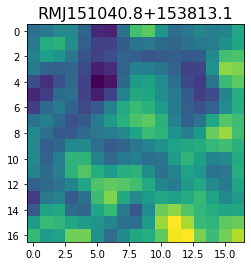

<class 'pixell.enmap.ndmap'>
[ 30.990036   55.542046   41.817287   -1.3501935 -34.206215  -48.457523
 -68.77028   -93.831406  -85.7705    -34.72402    10.544323    7.4833927
 -17.588331  -10.9885     24.282785   31.22985   -17.180033 ]


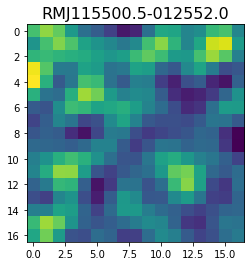

<class 'pixell.enmap.ndmap'>
[ 42.726013  42.169525  29.608524  16.85106   16.745922  27.168875
  32.68516   24.604465  12.775807  10.337642  12.681092   4.356071
 -14.701487 -26.150877 -21.111227 -14.199556 -18.576405]


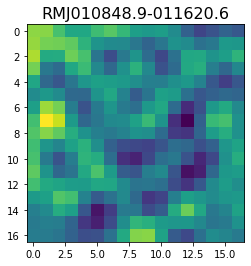

 52%|█████▏    | 5255/10099 [07:49<07:16, 11.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-14.580688   16.418436    8.277594  -38.370773  -54.439163  -21.909266
  -3.8250184 -24.082909  -25.624262   13.445985   33.337032    7.5494246
  -5.4032617  23.699053   37.518364    6.137402  -10.318712 ]


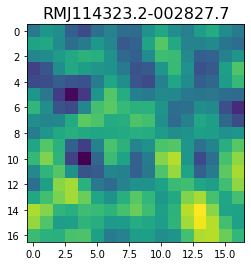

 52%|█████▏    | 5260/10099 [07:49<06:56, 11.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -58.003933 -171.38405  -233.33565  -142.60425    23.244843   48.13578
 -113.27451  -226.77213  -122.643196   28.974165   -6.784436 -150.45657
 -169.72539   -79.63271   -75.615746 -161.05862  -162.81696 ]


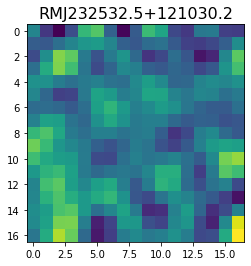

 52%|█████▏    | 5263/10099 [07:49<07:01, 11.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.832016  -37.91978   -41.70901   -48.66119   -55.583633  -58.90348
 -54.529358  -40.771866  -25.864948  -20.689058  -20.208656   -9.71168
   5.543627    1.2159894 -24.843994  -39.902378  -23.799004 ]


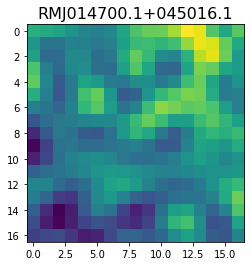

 52%|█████▏    | 5266/10099 [07:50<07:00, 11.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  35.42777   272.24225   125.605835 -176.82135  -167.61345   140.53578
  267.17828     9.4371   -235.83768   -88.45334   225.29602   244.00897
  -14.414038 -155.29796   -83.08944   -68.15706  -176.36078 ]


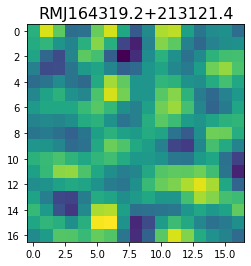

 52%|█████▏    | 5269/10099 [07:50<07:12, 11.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -6.0947666   -2.7686048    4.9727983    3.0100784  -19.932316
  -44.441616   -51.323723   -51.986195   -61.835266   -69.98489
  -62.220642   -51.90659    -61.601105   -88.51252   -108.67469
 -105.72343    -83.37044  ]


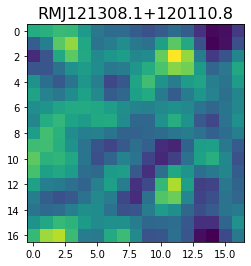

 52%|█████▏    | 5272/10099 [07:50<07:28, 10.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-61.11896   -53.206734  -60.14827   -71.1595    -77.61052   -78.64977
 -69.296814  -50.206367  -43.030926  -61.970592  -78.54129   -56.743145
 -14.965679   -3.1279364 -23.67424   -32.2932    -17.760485 ]


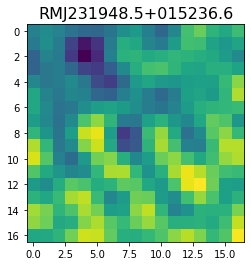

 52%|█████▏    | 5275/10099 [07:51<07:41, 10.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 119.14834     9.156374 -102.45359  -104.7584    -27.500044    7.285125
  -32.149765  -52.145153   11.252551  101.396034  134.7975    102.71408
   44.93234    -6.827524  -26.23993     3.733148   53.17076 ]


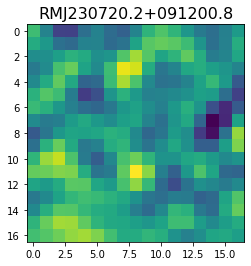

 52%|█████▏    | 5278/10099 [07:51<07:32, 10.65it/s]

<class 'pixell.enmap.ndmap'>
[-161.62021  -216.53676  -140.00871    11.684394   51.94706   -49.855938
 -148.48021  -185.19107  -210.91219  -196.08449  -109.338425  -88.36892
 -222.52057  -321.34793  -222.10645  -107.8594   -180.11234 ]


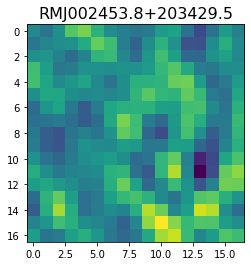

 52%|█████▏    | 5287/10099 [07:51<04:34, 17.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -28.40676    -34.054623   -83.36739   -107.03368    -77.93399
  -28.032402   -15.875414   -69.54114   -135.78433   -120.27268
  -17.579212    51.696934    -4.3540726 -111.98651   -131.40445
  -47.020092    36.292    ]


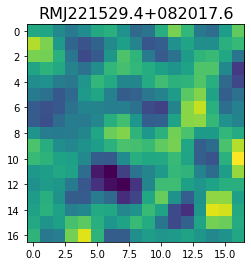

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[236.39836  117.01011  -41.611877 -15.357812 187.6847   306.6617
 217.27959   94.45055   97.53601  140.5071   105.29876   60.738754
 109.970215 197.26993  221.94557  205.52861  211.35266 ]


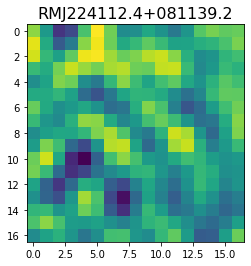

 52%|█████▏    | 5290/10099 [07:52<06:51, 11.70it/s]

<class 'pixell.enmap.ndmap'>
[ -83.99165   -41.502068   -9.645479  -45.886875 -116.666916 -142.50934
 -108.02092   -73.15348   -78.18984   -90.7572    -68.13386   -31.11443
  -34.719757  -82.082726 -114.448166  -95.14388   -62.556908]


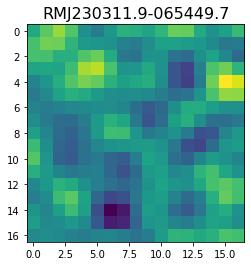

<class 'pixell.enmap.ndmap'>
[-15.52995   -61.064327  -34.927303   59.778908  143.54865   151.80205
 116.75066    93.6901     56.204002  -27.631132  -76.4499     -6.83416
  89.0975     63.36246   -28.806662   -1.6515568 145.39774  ]


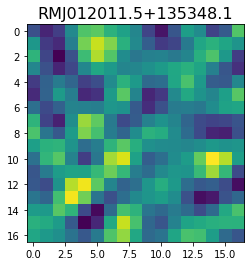

 52%|█████▏    | 5293/10099 [07:52<08:18,  9.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-212.45471 -157.12889 -200.28369 -304.65433 -345.51086 -269.44464
 -157.55058 -122.1873  -183.22662 -262.3146  -277.01794 -229.44891
 -204.23767 -268.9227  -379.32452 -419.16772 -344.53955]


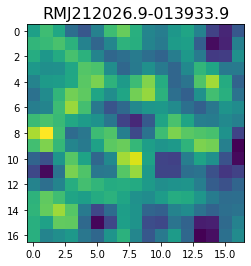

 52%|█████▏    | 5298/10099 [07:52<06:57, 11.51it/s]

<class 'pixell.enmap.ndmap'>
[ -49.479847 -102.414474  -87.74361   -40.645344  -30.844572  -74.03756
 -114.584465  -96.42032   -31.909498   12.373326   -6.396101  -57.531055
  -74.35292   -33.923306   20.045605   36.98238    17.489262]


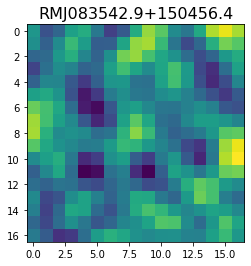

<class 'pixell.enmap.ndmap'>
[-110.550446  -92.06168   -98.13923  -160.62508  -221.17014  -200.12888
 -103.58247   -24.154978  -33.106693 -102.9968   -154.85793  -155.08353
 -131.59428  -112.278725  -98.43744   -99.37726  -135.01656 ]


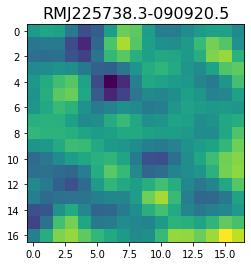

 52%|█████▏    | 5300/10099 [07:53<08:57,  8.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 94.30808 144.89293 149.60834 124.64744 123.89055 155.6891  168.36111
 129.67223  82.7371   89.19002 141.33517 177.22409 173.14285 166.70871
 181.44264 185.86836 153.76465]


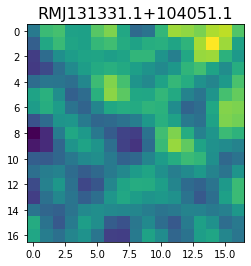

 53%|█████▎    | 5302/10099 [07:53<09:36,  8.33it/s]

<class 'pixell.enmap.ndmap'>
[-101.39897  -164.1983   -123.67138   -74.86257  -120.68325  -206.96988
 -204.06898  -108.96033   -54.166405 -112.274536 -199.21396  -209.90045
 -157.19678  -113.049355  -87.714035  -54.797325  -45.97575 ]


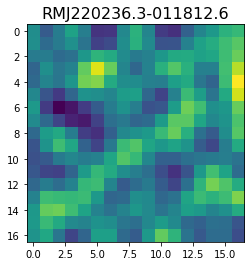

 53%|█████▎    | 5304/10099 [07:54<09:50,  8.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  13.242499    50.52089     28.050282   -22.97324    -60.03159
  -76.7697     -98.3995    -112.2163     -73.20725     -7.6407585
    2.1113188  -25.36461     20.53529    127.68209    138.26743
    7.005628  -111.749855 ]


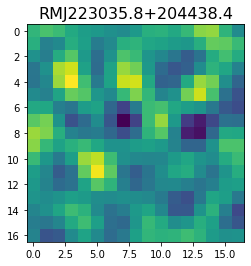

 53%|█████▎    | 5306/10099 [07:54<10:01,  7.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-278.3049     112.93314    250.46826     26.586025  -162.02348
  -67.767944   119.34099    128.34726     -3.2725706   -6.872036
  163.22421    155.88643   -234.40282   -587.62036   -422.67413
  -11.540764    40.578583 ]


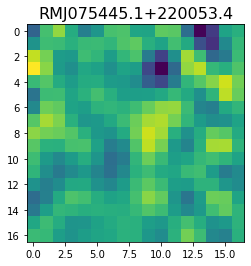

 53%|█████▎    | 5308/10099 [07:54<10:01,  7.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[242.50784 154.11975 139.97087 196.7436  233.81085 205.3072  153.0593
 136.47346 167.2092  210.60652 224.94882 198.01846 155.32445 133.11073
 145.45367 179.7082  212.53369]


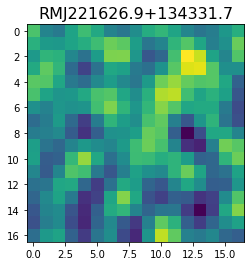

 53%|█████▎    | 5315/10099 [07:54<06:29, 12.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  42.538586   19.60706   -47.974766 -109.03499  -124.3724    -96.28139
  -56.481335  -42.32638   -72.97887  -128.50105  -158.86601  -130.52295
  -62.41866    -9.674339  -17.305532  -87.42741  -174.67598 ]


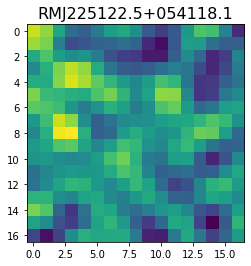

 53%|█████▎    | 5317/10099 [07:55<07:25, 10.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-50.07715    -7.7447615  53.55734    79.086975   71.5467     69.624
  76.11824    59.531853   17.708275   -6.9015813  18.392738   73.63336
 104.69103    77.68124    19.819311    2.1617625  60.28117  ]


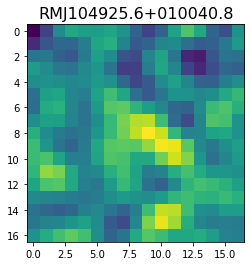

 53%|█████▎    | 5325/10099 [07:55<05:16, 15.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-77.748245  -89.57959   -88.41458   -74.16988   -54.744602  -42.51501
 -44.149208  -53.277645  -59.189495  -62.29225   -69.61957   -73.81046
 -55.92407   -20.087385   -4.3205276 -34.09155   -79.48116  ]


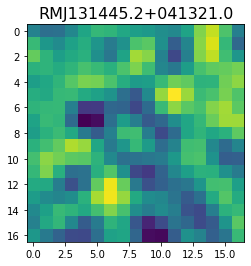

 53%|█████▎    | 5331/10099 [07:55<05:11, 15.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[25.902912  22.222069  31.403795  39.35504   46.95644   63.610718
 72.6623    47.73663    7.0391026  1.6742402 38.494408  65.55997
 52.00502   30.861332  38.090923  58.9403    66.06349  ]


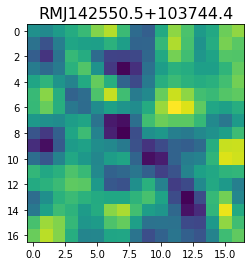

<class 'pixell.enmap.ndmap'>
[ 31.988926 135.3201   136.07509   74.50566   81.25622  144.03485
 144.81055   85.996254  87.31252  160.73851  177.5714    93.16904
  31.304018  79.760765 148.3338   117.682915  18.646257]


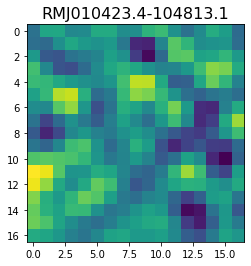

 53%|█████▎    | 5334/10099 [07:56<07:36, 10.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  4.293094   -0.7582918  -3.250276   -1.2722265  -2.6976855  -5.1254587
   2.9371536  14.69261     6.389341  -25.692091  -56.37952   -65.113686
 -51.656532  -22.321188    7.4891186   7.8340993 -29.512634 ]


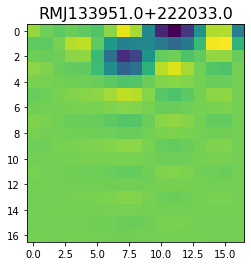

 53%|█████▎    | 5336/10099 [07:56<08:13,  9.65it/s]

<class 'pixell.enmap.ndmap'>
[-120.4527   -127.77075  -109.28811   -96.76349   -99.775665  -98.337204
  -82.50442   -67.106255  -61.967075  -55.938244  -41.572865  -32.788826
  -43.155968  -62.38149   -69.12549   -57.132294  -36.655144]


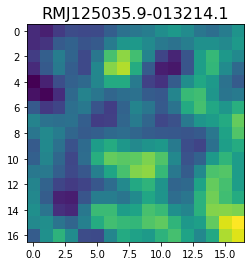

 53%|█████▎    | 5338/10099 [07:57<08:52,  8.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.282759  21.875566  48.42015   89.28757  113.35265  110.682045
 102.11523  104.793236 110.19478  106.72728   99.606705  93.99991
  81.94083   62.441288  53.3618    66.08887   86.49441 ]


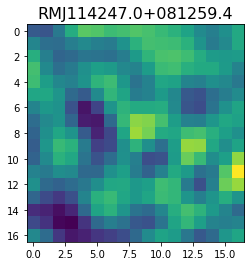

 53%|█████▎    | 5340/10099 [07:57<09:14,  8.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-130.30522  -133.15688   -67.5633    -40.948673  -57.167088  -14.941718
   38.600025  -45.225357 -196.19182  -189.06427   -40.59664     8.813563
  -85.13447  -119.38472   -15.399099   82.70397    85.82797 ]


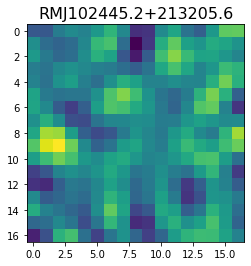

 53%|█████▎    | 5342/10099 [07:57<09:29,  8.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -75.566765  -52.39639   -61.869118  -99.82998  -119.12176   -99.74195
  -75.24401   -77.4812    -93.079445  -95.242615  -86.33738   -82.27552
  -80.20052   -71.54995   -68.62979   -87.49495  -115.78413 ]


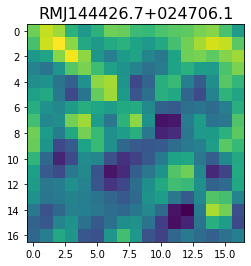

 53%|█████▎    | 5345/10099 [07:57<08:37,  9.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -57.99113    -39.43093      8.707375    16.714472   -17.402876
  -13.372163    40.535084    32.05203    -83.64203   -166.12187
  -98.70991     12.926932     7.6360707  -88.13419   -147.39188
 -154.92322   -167.6214   ]


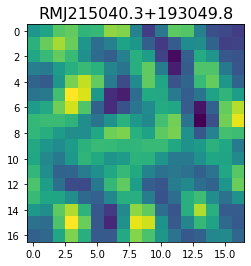

 53%|█████▎    | 5347/10099 [07:58<08:53,  8.91it/s]

<class 'pixell.enmap.ndmap'>
[ 59.48193   48.473682  50.92591   56.655067  56.840775  51.598423
  49.129173  61.1754    87.01908  102.82804   85.88293   48.997757
  27.38488   30.637745  36.007725  32.52868   37.50724 ]


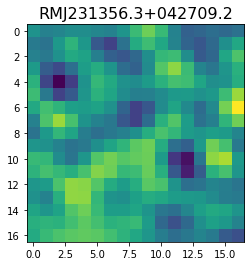

 53%|█████▎    | 5348/10099 [07:58<10:26,  7.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -33.123955  -53.63365   -52.912945  -27.520761  -18.456486  -64.55337
 -144.73076  -194.18454  -164.05481   -65.1947     24.027193   14.456275
  -87.47164  -161.89287  -124.50601   -51.00961   -64.61834 ]


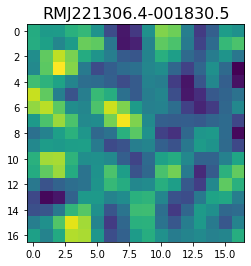

 53%|█████▎    | 5354/10099 [07:58<06:58, 11.33it/s]

<class 'pixell.enmap.ndmap'>
[ -76.05533    -78.63628    -87.29549   -106.25926   -110.834595
  -80.15527    -45.367447   -53.8297     -87.56325    -76.00469
   -3.295908    54.295967    29.375484   -42.618443   -73.50116
  -38.9711       3.8187358]


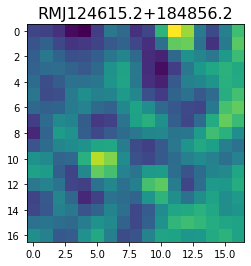

 53%|█████▎    | 5356/10099 [07:59<07:36, 10.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 3.3215378e+01  1.1817428e+01 -2.0916702e+01 -3.9348042e+01
 -3.6701691e+01 -1.9169416e+01 -1.5971992e+01 -4.3914146e+01
 -6.1126793e+01 -2.0700727e+01  3.8882103e+01  4.0940922e+01
  2.0206501e-01  2.5352044e+00  5.3188869e+01  6.1972698e+01
  3.5717089e-02]


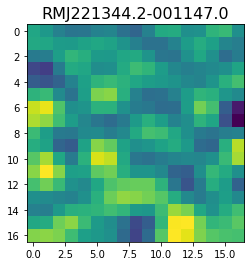

 53%|█████▎    | 5358/10099 [07:59<08:08,  9.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 33.525303  73.25909   95.1921    80.63959   32.890957  21.241962
  82.53878  135.83456   97.48485   11.182975 -27.477676  -1.180104
  45.50269   77.70504   79.0473    57.125225  53.675774]


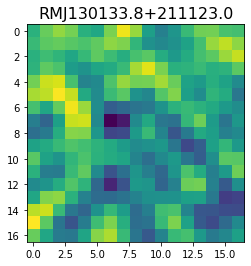

 53%|█████▎    | 5369/10099 [07:59<04:21, 18.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-37.328144  -37.762577  -66.72507   -89.253265  -85.19012   -71.13137
 -60.215656  -50.398655  -51.385166  -71.09601   -81.40758   -52.04443
  -9.773072   -6.7074614 -38.333878  -50.956604  -25.11013  ]


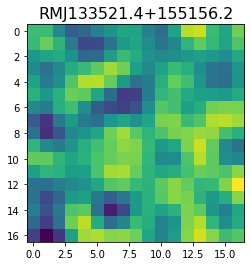

 53%|█████▎    | 5374/10099 [07:59<04:29, 17.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[117.079445  73.574196  22.628077   9.406509  40.757668  71.02523
  49.102165 -11.447317 -36.722893   8.806036  61.337578  40.606316
 -32.729897 -64.957085 -25.063213  18.136066   6.418017]


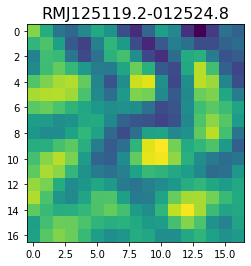

 53%|█████▎    | 5387/10099 [08:00<03:17, 23.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-32.23327     -3.5185018   18.240574    15.45335     -0.43506265
  -6.698795    -2.5897012   -2.1418922   -5.8234086   -9.066475
 -23.27155    -54.469162   -80.556816   -84.51188    -83.305435
 -87.18443    -68.53659   ]


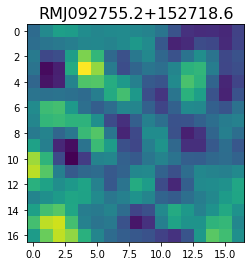

<class 'pixell.enmap.ndmap'>
[ 17.378653    5.5856485   5.8065767  49.00752    62.53332    -4.6559453
 -54.498432   10.4277315 108.13227   105.29691    28.699432   -9.478656
  -4.996089  -20.977167  -38.226315   -1.6109006  52.5785   ]


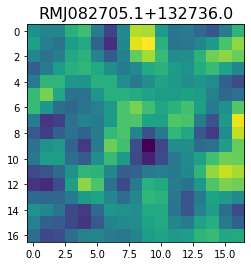

<class 'pixell.enmap.ndmap'>
[ -2.2465541  27.522976   92.717896   99.98575    35.305664   -5.677376
  26.802391   72.66962    87.71111   106.6468    141.36682   137.48827
  81.220436   47.003487   85.08603   140.13342   136.70294  ]


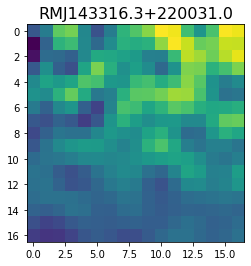

 53%|█████▎    | 5391/10099 [08:01<06:05, 12.89it/s]

<class 'pixell.enmap.ndmap'>
[ 93.95791  123.86808   80.63459  -12.432455 -45.22914    4.814394
  22.31816  -32.207214 -36.9906    57.233147 117.958374  70.41123
  13.70876    5.583091 -16.584072 -34.47445   48.877552]


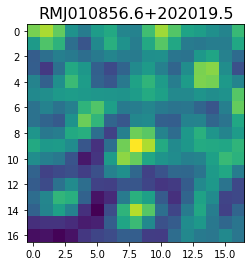

<class 'pixell.enmap.ndmap'>
[-37.28539   -11.120886   -2.8426878 -32.087147  -49.4247    -16.594965
  36.380592   56.9567     37.72672    15.58106    21.789314   48.491356
  59.58063    32.80446    -8.415516  -17.15873    18.730055 ]


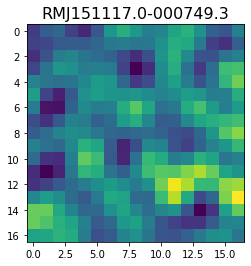

<class 'pixell.enmap.ndmap'>
[-41.46477  -66.67151  -71.983406 -47.672394 -14.70582  -10.210586
 -44.324642 -78.93242  -71.78623  -33.46259   -9.750873 -15.528821
 -26.799576 -34.394585 -54.178265 -76.68415  -62.735367]


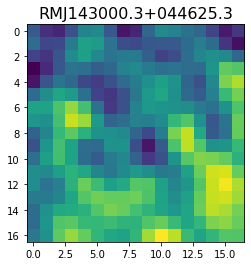

 53%|█████▎    | 5394/10099 [08:01<08:29,  9.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-10.970441 -47.635017 -58.039314 -31.896929  -8.062014 -21.7545
 -60.261093 -86.405914 -87.30218  -76.653404 -63.096344 -47.42913
 -43.871372 -67.252075 -98.07313  -99.31195  -75.683205]


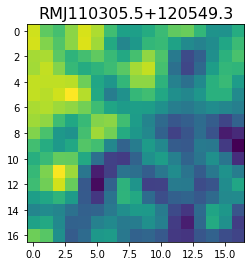

 53%|█████▎    | 5396/10099 [08:02<08:42,  9.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-31.510279   -2.6414123  20.409578   16.696472    5.3970356  10.828371
  23.105892   18.019175    1.560176    3.0522487  25.54334    34.890083
   8.930103  -28.634565  -41.871544  -31.200481  -25.628843 ]


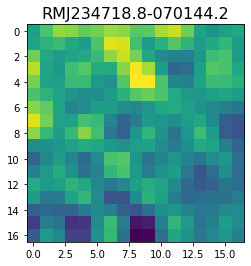

 53%|█████▎    | 5399/10099 [08:02<08:16,  9.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -37.073032  -10.761959  -14.671241    8.38872    26.47827   -13.086122
  -53.112064  -29.994013  -18.678057 -101.53208  -196.89674  -192.07254
 -132.5693   -113.64529  -109.48755   -65.4594    -27.819017]


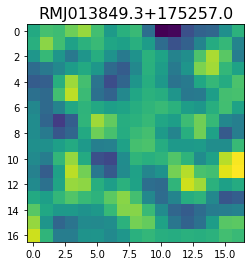

 53%|█████▎    | 5401/10099 [08:02<08:36,  9.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 79.02371   49.1545    23.97402   56.755753 116.1227   118.316124
  42.97671  -33.61417  -34.32969   28.630913  81.83788   82.94638
  56.28502   44.756157  53.942516  56.12766   37.32819 ]


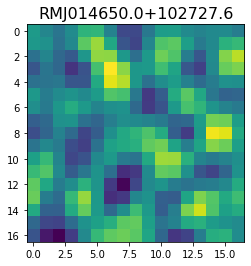

 54%|█████▎    | 5403/10099 [08:02<09:13,  8.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 27.62871    35.84548    92.349464   97.90544    37.150566   10.997151
  57.976166   84.7903     35.420406  -12.3363495   4.6508856  26.806633
  -1.946452  -28.096191    0.6537363  33.34308    13.470995 ]


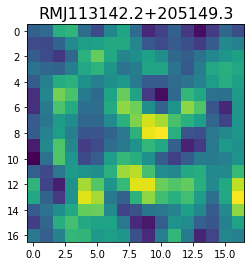

 54%|█████▎    | 5406/10099 [08:03<08:28,  9.24it/s]

<class 'pixell.enmap.ndmap'>
[ -54.040764   85.31607   156.61624    35.04055   -74.71099  -153.60608
  -98.42649   297.07144   656.199     351.8296   -289.69168  -337.52692
  211.4573    530.0341    367.03195   115.31694  -111.29358 ]


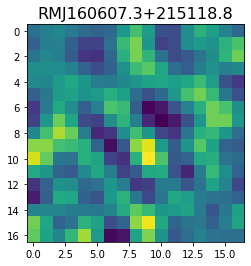

<class 'pixell.enmap.ndmap'>
[ 54.776897   72.69685    42.824425  -10.724391   -8.066071   58.31787
  94.328255   47.68827    -1.3077868  32.2098     95.58676    89.47929
  38.7901     42.940872   93.61125    87.87769    15.092745 ]


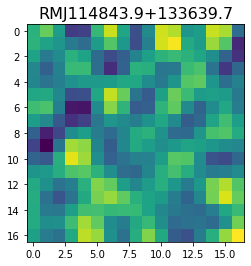

 54%|█████▎    | 5408/10099 [08:03<10:55,  7.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-178.13452  -125.09315   -37.12296   -11.36024   -57.713696  -84.44431
  -46.586742  -26.605215 -102.56086  -203.70398  -201.38518  -110.119965
  -70.190735 -122.21668  -138.94582   -39.789852   57.827717]


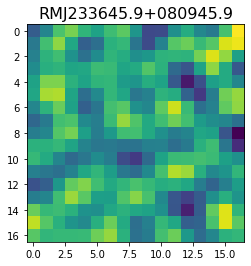

 54%|█████▎    | 5410/10099 [08:04<11:18,  6.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-27.09109   -27.134077  -13.099831  -15.6703615 -23.671965  -12.043586
   0.3432143 -11.891176  -19.026688   18.697395   71.77246    78.0836
  40.843277   22.575499   51.561844   94.02422   114.60228  ]


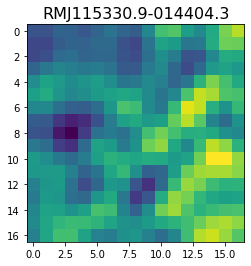

 54%|█████▎    | 5416/10099 [08:04<07:36, 10.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[139.61058   119.50186    60.315823   93.95542   140.43259   102.76981
  62.846558   83.559654   77.88539    25.893518   45.123867  136.54242
 144.78366    45.712505   -1.8198484  63.95999   125.328606 ]


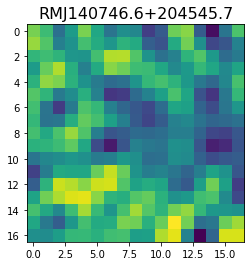

 54%|█████▎    | 5419/10099 [08:04<07:33, 10.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -18.660288  -55.620113  -66.27663   -50.837013  -66.1857   -110.99677
 -122.32679   -94.20144   -86.83203  -104.8396    -86.78485   -37.34
  -42.710957 -116.95131  -156.30063   -99.937584  -25.853445]


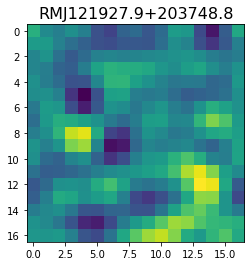

 54%|█████▎    | 5423/10099 [08:04<06:45, 11.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-116.444916  -40.519257  -44.286358 -120.843834 -162.79619  -110.67832
  -48.10903   -61.526596 -101.546776  -89.97474   -58.60044   -69.98703
 -104.2309   -121.14552  -130.9298   -134.29755  -105.3061  ]


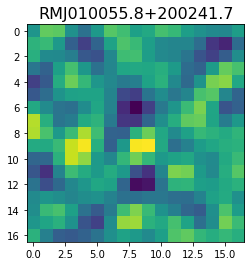

 54%|█████▎    | 5426/10099 [08:05<06:43, 11.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[128.58519    98.39091    49.103054   65.91137    96.74061    53.587585
 -18.116255  -19.135715   33.769295   56.721924   46.918      56.68146
  77.9839     60.09288     3.4476233 -39.923805  -34.85541  ]


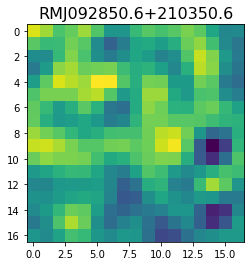

 54%|█████▎    | 5428/10099 [08:05<07:15, 10.72it/s]

<class 'pixell.enmap.ndmap'>
[-58.900253  46.595356 177.7395   182.12836  124.117386 140.54039
 221.46587  248.74243  186.24266  116.07938  102.96629  122.3541
 137.64984  164.54823  214.54507  235.7205   179.51257 ]


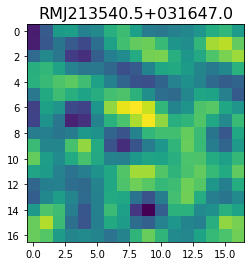

 54%|█████▍    | 5430/10099 [08:05<07:46, 10.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[226.71695  177.56749  108.374756 111.45899  108.87447   58.65479
 102.69955  305.009    456.94272  377.32437  225.48082  257.41797
 407.26028  394.09726  176.00627    8.625548  41.93763 ]


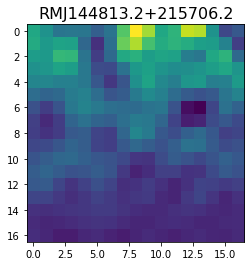

<class 'pixell.enmap.ndmap'>
[ -62.53588  -104.10718   -81.623116   10.307747   64.478226   16.39468
  -47.447266  -35.789062    4.063931   -6.247106  -42.622715  -57.084522
  -68.10345   -87.489395  -81.13993   -59.955566  -75.820984]


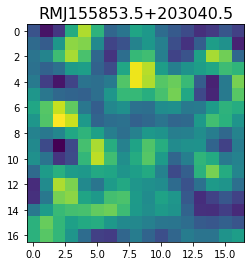

 54%|█████▍    | 5432/10099 [08:06<10:10,  7.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.147494   16.11142    12.345596    6.5603228   1.6652887  -7.4516096
 -24.727491  -44.84398   -55.65443   -45.34949   -10.03713    38.126415
  72.06354    70.38867    40.926376   15.57409    17.094492 ]


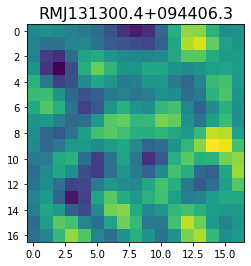

 54%|█████▍    | 5434/10099 [08:06<09:57,  7.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 23.296976   33.1767     42.470142   53.499245   61.733715   47.917774
  17.074448    7.6931124  36.83856    71.805275   82.19743    83.449036
  97.64562   106.262634   81.32726    38.8017     20.563591 ]


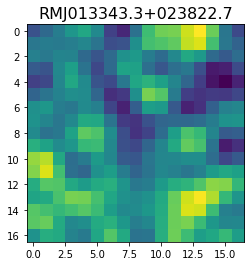

 54%|█████▍    | 5436/10099 [08:06<09:52,  7.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 87.16728   86.89752   77.09238   64.5267    70.41806   96.61886
 114.5349   105.35789   87.4023    84.098305  89.30188   87.398476
  84.852684  94.85601  108.81516  109.81007  100.36729 ]


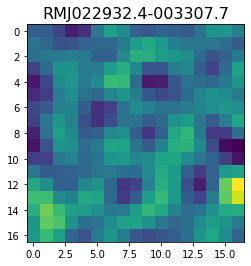

 54%|█████▍    | 5438/10099 [08:06<09:54,  7.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[64.69392  49.772144 44.578056 48.344955 29.704369 -2.806482 -1.409753
 41.319183 73.581505 62.282394 38.215534 41.24813  62.760498 69.200035
 53.810097 38.485725 38.442318]


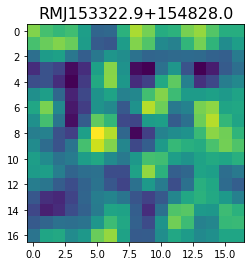

 54%|█████▍    | 5440/10099 [08:07<09:49,  7.90it/s]

<class 'pixell.enmap.ndmap'>
[-127.996414  -68.20749   -72.755264 -114.45787  -130.40672  -109.48877
 -102.70581  -140.15099  -175.78014  -153.673    -101.35064   -96.226654
 -146.96739  -174.21011  -121.342926  -30.530727   11.602281]


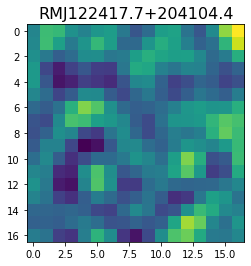

 54%|█████▍    | 5441/10099 [08:07<11:15,  6.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 61.74155   70.812454 100.87857  102.766785  86.20611   84.062164
  94.235    100.095406 110.11887  133.80682  146.07494  116.68849
  59.847782  22.702835  32.134285  71.641685 102.19349 ]


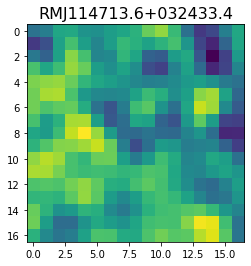

 54%|█████▍    | 5445/10099 [08:07<09:09,  8.47it/s]

<class 'pixell.enmap.ndmap'>
[ -5.7265573  11.347428   26.395905   13.003496  -22.853395  -44.922585
 -31.047564   -3.9765522  -3.079898  -32.559     -58.065376  -52.992847
 -26.500366   -3.9842951  -0.9700432 -18.934008  -45.542873 ]


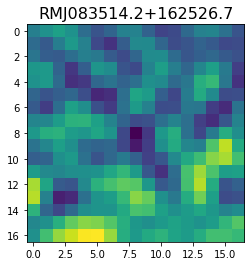

 54%|█████▍    | 5446/10099 [08:07<10:33,  7.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[102.75567   33.844196  -2.50959   57.988728 143.92128  153.87045
  89.45584   26.037745   7.730473  17.440304  19.91849    9.146478
  16.494013  57.984566  82.28046   31.51687  -45.062534]


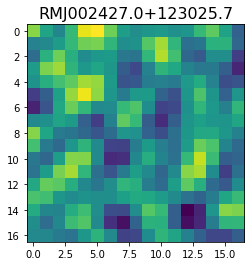

 54%|█████▍    | 5450/10099 [08:08<08:28,  9.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -42.127968   -41.648354    -3.9646993   -0.7391087  -48.289288
  -80.86041    -71.45789    -80.92174   -147.01389   -209.50969
 -198.7632    -132.79263    -70.21575    -21.961203    25.759733
   42.50206    -14.424266 ]


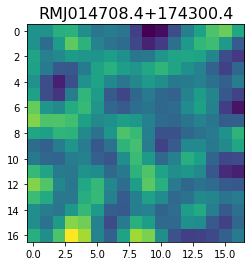

 54%|█████▍    | 5452/10099 [08:08<09:03,  8.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.369808  48.176117  41.621414  10.948774  18.47654   68.3111
 112.33525  132.66515  136.17842  105.30363   35.54144  -13.927458
  15.635069  93.96989  138.56863  116.28552   61.780354]


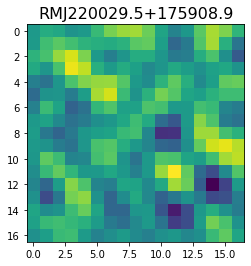

 54%|█████▍    | 5463/10099 [08:08<04:10, 18.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -73.59869     -48.924595     24.349976      0.17707947 -102.99291
 -129.08505     -73.94168     -71.97094    -114.99983     -64.89889
   62.17483      97.451004      9.707772    -58.540783    -49.56415
  -48.590828    -79.22434   ]


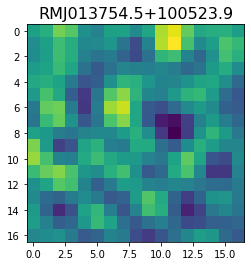

 54%|█████▍    | 5468/10099 [08:09<04:23, 17.60it/s]

<class 'pixell.enmap.ndmap'>
[-22.873272 -26.814514  13.238979  23.342323 -28.88504  -80.001175
 -82.39121  -72.48588  -81.590866 -76.07019  -40.728165 -28.517166
 -66.91718  -99.06687  -77.52712  -38.99809  -28.973671]


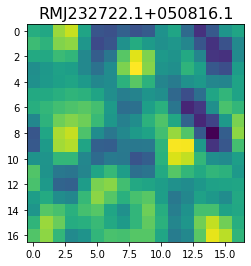

<class 'pixell.enmap.ndmap'>
[-96.62239    -76.86237    -26.855682    -0.86731035 -20.122524
 -49.757122   -47.997704   -19.127077    -3.6159704  -25.879702
 -67.91765    -93.61653    -86.24385    -57.90391    -31.349846
 -20.484575   -24.788     ]


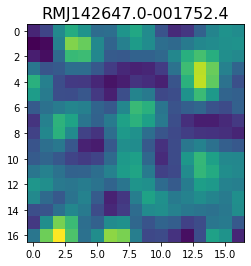

 54%|█████▍    | 5471/10099 [08:09<06:09, 12.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.262703   82.38181   109.482315   78.53882    19.736137  -11.091143
  -7.4987645   9.700626   36.49794    67.23172    77.17952    55.157375
  20.412485   -3.2641788   0.8950056  43.470413   99.88543  ]


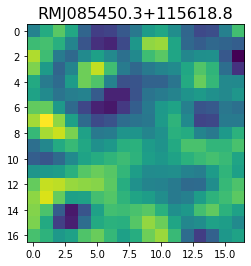

 54%|█████▍    | 5473/10099 [08:09<06:41, 11.51it/s]

<class 'pixell.enmap.ndmap'>
[  6.4425163 -64.40001   -77.29498   -22.813393   26.116272   17.878834
 -16.191753  -24.499277   -5.6216774  13.592763   22.913425   18.106287
 -13.454283  -61.920082  -85.698105  -67.61406   -47.439056 ]


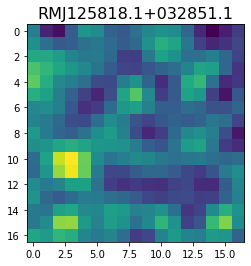

 54%|█████▍    | 5475/10099 [08:10<07:16, 10.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-122.99672  -104.27947  -101.88558  -113.022255 -124.38485  -127.04916
 -125.35263  -127.0715   -130.33186  -128.18388  -122.64054  -123.64786
 -133.23747  -140.42415  -136.0727   -125.47649  -120.03201 ]


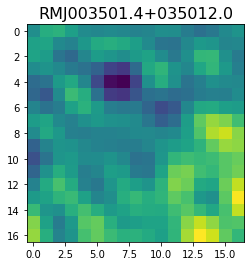

 54%|█████▍    | 5477/10099 [08:10<07:42,  9.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 62.029053   48.81293    36.915195   33.72935    33.73151    33.6876
  33.346138   26.085758    6.8386006 -13.881611  -20.206316  -13.096809
  -8.053738  -13.08557   -22.457394  -29.728304  -33.346867 ]


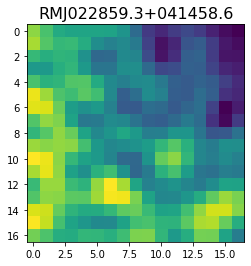

 54%|█████▍    | 5480/10099 [08:10<07:38, 10.07it/s]

<class 'pixell.enmap.ndmap'>
[ 48.839314  100.69179    75.8423     20.86405    33.36669   114.95429
 172.63777   154.04918    97.90995    49.739193    5.1064253 -43.379868
 -61.48753   -11.573816   86.07523   153.62187   122.97631  ]


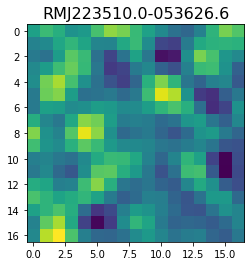

<class 'pixell.enmap.ndmap'>
[  4.23918  114.026695 171.07765  136.7814    79.233955  63.475697
  77.97959   90.26293   95.851814  79.979866  11.366153 -76.585396
 -74.60136   58.39177  193.24673  162.82155  -20.855888]


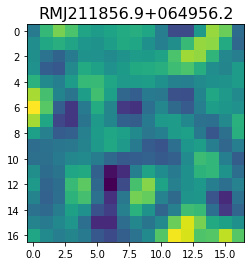

 54%|█████▍    | 5482/10099 [08:11<10:39,  7.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  32.449383   30.200472  -39.746998  -78.22197   -70.62802   -82.01204
  -99.083885  -56.03152    -1.646956  -44.949547 -139.80894  -130.67964
  -19.635677   26.94647   -40.518864  -84.0973    -27.873251]


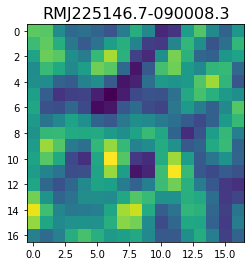

 54%|█████▍    | 5484/10099 [08:11<11:15,  6.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -50.688618    -59.58504      -3.425856     -9.067677    -77.28061
  -88.91734     -16.237595     32.49297       9.374441      7.7318463
   75.59738     100.99188       0.40470687 -106.327965    -66.20979
   49.506508     40.411995  ]


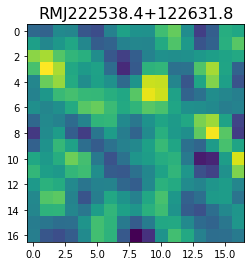

 54%|█████▍    | 5486/10099 [08:11<11:07,  6.91it/s]

<class 'pixell.enmap.ndmap'>
[ 354.13693    237.95108    191.3657     213.55754    103.88459
  -74.524826    -1.7355956  314.44525    437.484      171.63184
 -126.84347   -141.34277    -58.00425   -146.60838   -271.2515
 -171.64845     57.58163  ]


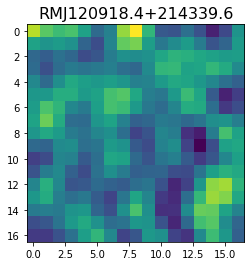

 54%|█████▍    | 5487/10099 [08:12<12:36,  6.09it/s]

<class 'pixell.enmap.ndmap'>
[ 86.42931    95.784966  121.18506   132.49074    93.46137    29.400158
   2.8951182  26.443878   57.18416    66.95846    59.44213    37.58424
  16.987663   42.882748  119.56042   156.44797    74.55913  ]


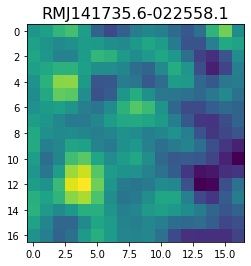

 54%|█████▍    | 5488/10099 [08:12<14:02,  5.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 59.174232   94.313034   98.25435    75.47354    24.647867  -27.495085
 -35.689835    0.6228673  32.82104    45.18964    82.77716   154.10355
 173.09056    79.786644  -34.814358  -40.436775   25.7094   ]


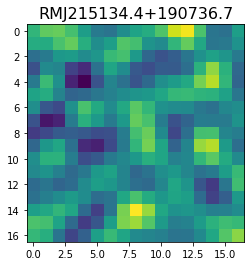

 54%|█████▍    | 5490/10099 [08:12<12:57,  5.93it/s]

<class 'pixell.enmap.ndmap'>
[   5.5876827  -54.08477   -111.90809   -123.25223   -111.33111
 -109.936264  -113.36961   -105.58048    -98.15562   -105.535095
 -109.7796     -86.709496   -51.368088   -40.73151    -56.513977
  -60.757664   -34.101612 ]


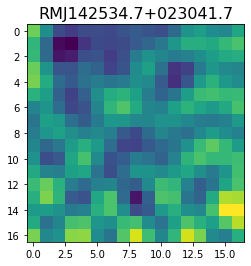

 54%|█████▍    | 5491/10099 [08:12<14:30,  5.29it/s]

<class 'pixell.enmap.ndmap'>
[177.15543 184.4033  210.91315 258.7083  268.94644 227.16966 217.62001
 280.34946 318.57275 257.10028 183.86168 202.90154 250.70856 212.43645
 136.12666 159.22902 271.7254 ]


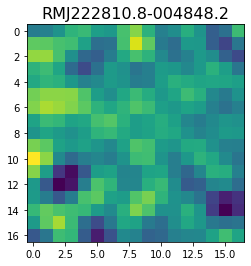

 54%|█████▍    | 5497/10099 [08:13<07:04, 10.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 90.25996  127.72268  130.33481  122.13116  161.21915  198.76288
 140.79129   42.405052  53.168076 164.55963  213.94618  155.784
 117.75657  159.48384  190.00305  165.37894  156.91972 ]


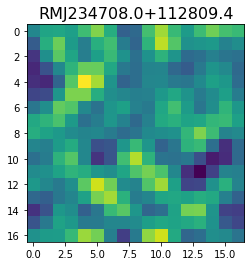

 54%|█████▍    | 5502/10099 [08:13<06:31, 11.75it/s]

<class 'pixell.enmap.ndmap'>
[  -3.34071    -27.46968    -87.11758   -135.89984   -103.08088
    7.3081703   96.09586     75.38173    -29.957901  -118.80416
 -133.28888    -98.23412    -49.292038    13.384709    72.46311
   58.646267   -63.028484 ]


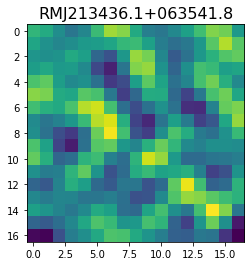

<class 'pixell.enmap.ndmap'>
[   3.748703    -42.749557    -59.088116    -24.390257     10.029996
   -0.59455067  -28.497086    -25.595114     -5.253082    -20.478014
  -76.541245   -118.352394   -109.80085     -80.978294    -76.76716
  -92.19118     -90.726295  ]


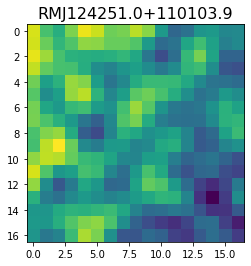

 55%|█████▍    | 5510/10099 [08:14<05:46, 13.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-106.02553   -73.82596   -49.67617   -72.887856 -120.40514  -132.02422
  -90.75431   -40.58896   -25.132767  -43.306404  -69.97764   -89.093124
  -96.15996   -90.86749   -79.51346   -73.19453   -77.55452 ]


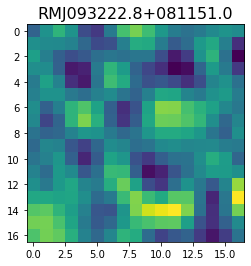

<class 'pixell.enmap.ndmap'>
[ 76.12149    35.806377  -18.23337    -6.537906   92.8278    163.82916
 100.14761    -3.9615376  25.656113  157.73914   187.43709    56.64051
 -62.752823  -43.306446   28.733183   23.753294  -41.8894   ]


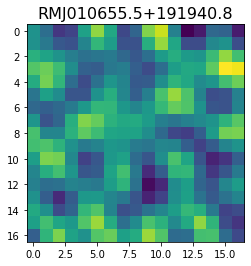

 55%|█████▍    | 5513/10099 [08:14<07:43,  9.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  58.201096    48.4968       3.1205752  -67.883934  -125.489365
 -125.64188    -76.07786    -38.125614   -33.746326    -6.8586993
   64.045204    94.79175     31.673433   -28.00739     17.536095
   87.91352     43.160206 ]


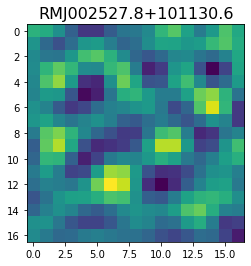

<class 'pixell.enmap.ndmap'>
[-3.7636131e+01 -2.5717554e+01  7.1216164e+00  2.5551888e+01
  7.8302603e+00 -2.3407686e+01 -2.7826963e+01  1.1129998e+00
  2.3858170e+01 -7.6841310e-02 -5.9842659e+01 -9.9841888e+01
 -8.3950722e+01 -3.7022808e+01 -6.8317766e+00 -1.4426755e+00
  6.4019799e+00]


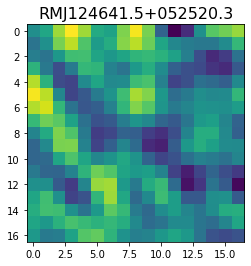

 55%|█████▍    | 5515/10099 [08:15<09:48,  7.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 219.6388    199.75302    35.29057  -142.25177  -139.81493    21.817223
  112.488945   14.439606 -107.97172   -56.83004   106.70751   167.5135
   80.318375   10.955731   60.73399   121.68388    63.418736]


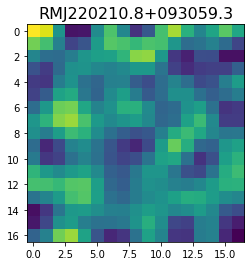

 55%|█████▍    | 5517/10099 [08:15<10:15,  7.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.335022   -7.3756557 -72.03362   -76.90472    21.022926  138.46498
 142.88893    30.242659  -51.81367    -4.72902    82.61424    81.08924
  22.186846   23.11963    74.51106    66.141136   -1.3716801]


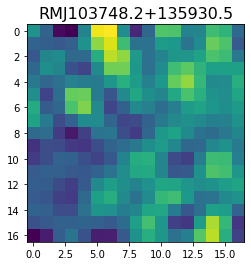

 55%|█████▍    | 5521/10099 [08:16<08:30,  8.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[38.525154 40.83925  47.21731  54.088253 68.89447  83.246475 74.10613
 41.22037  20.570444 39.773933 73.48474  71.27702  28.354658 -3.490802
 11.807037 41.94     33.86929 ]


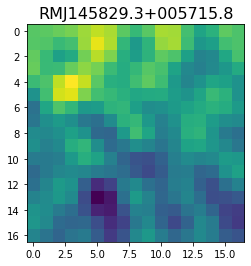

 55%|█████▍    | 5523/10099 [08:16<08:44,  8.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -89.205154  -90.65466  -153.11388  -174.1308   -137.01007  -111.79641
 -102.97653   -61.134407  -21.705593  -64.73956  -147.04117  -137.81755
  -29.495369   37.54018   -13.998859  -95.605354 -104.3136  ]


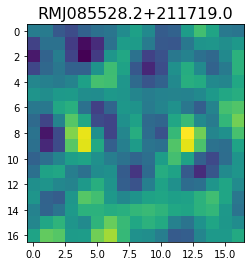

 55%|█████▍    | 5528/10099 [08:16<06:57, 10.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[215.12889  185.56116  124.546196  60.39066   37.281303 107.46432
 239.2101   301.59503  225.78911  119.403595 125.56319  219.11273
 248.14777  151.2816    31.591906  12.942148 100.519035]


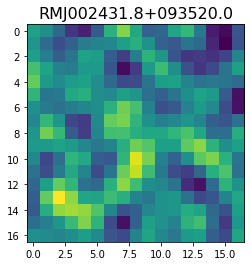

 55%|█████▍    | 5530/10099 [08:16<07:32, 10.11it/s]

<class 'pixell.enmap.ndmap'>
[ 98.67151   100.9863     93.07723    71.269394   29.435932   -6.199686
   5.0901465  51.81193    73.19675    43.859623    3.671811  -10.370995
  -7.395683   -2.4852653  10.517352   25.860767   17.875763 ]


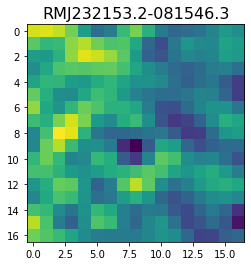

 55%|█████▍    | 5532/10099 [08:17<08:11,  9.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[104.28077   83.59848   57.996685  40.578934  34.514416  33.633717
  33.187798  32.916557  32.94693   35.83707   46.46402   58.887135
  55.41848   35.750816  29.66098   52.97906   69.18199 ]


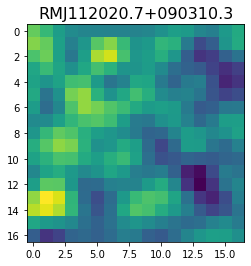

 55%|█████▍    | 5535/10099 [08:17<07:53,  9.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 29.810062   17.843904    3.2812765   0.8306777  12.857278   26.10165
  28.273003   24.602903   27.342321   31.165667   20.540726    3.459894
   5.9693666  24.538073   23.137724   -6.620657  -25.82664  ]


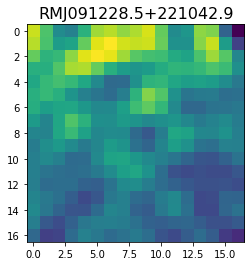

 55%|█████▍    | 5540/10099 [08:17<07:09, 10.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -87.78341   -87.06686   -63.015995  -80.22255  -128.6371   -118.37455
  -33.335426   31.239323   20.331297   -4.04224    14.724764   29.768034
  -20.37519  -100.21702  -125.01201   -78.13506   -23.931177]


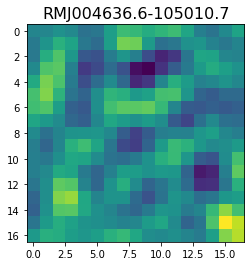

 55%|█████▍    | 5542/10099 [08:18<08:05,  9.39it/s]

<class 'pixell.enmap.ndmap'>
[-118.99129   -97.02616   -24.306816  -26.260197 -101.68821  -117.41639
  -52.50948   -34.603024  -98.11846  -122.46088   -61.32588   -26.663937
  -81.730965 -135.94547  -111.19762   -55.57647   -34.80061 ]


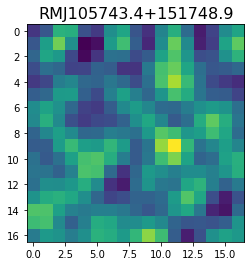

 55%|█████▍    | 5543/10099 [08:18<09:54,  7.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-1.0309738e+02 -8.9876450e+01 -6.9165222e+01 -5.9236809e+01
 -6.0486919e+01 -7.0299812e+01 -8.8389389e+01 -9.8914192e+01
 -8.0045937e+01 -4.7006989e+01 -4.8004841e+01 -9.1675453e+01
 -1.1785778e+02 -7.8567200e+01 -1.3902545e+01 -8.3382584e-02
 -4.6050892e+01]


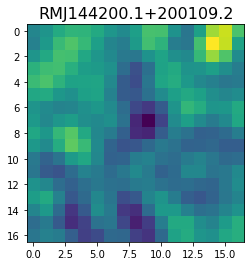

 55%|█████▍    | 5549/10099 [08:18<07:18, 10.37it/s]

<class 'pixell.enmap.ndmap'>
[ 36.692787  52.560856  40.880302  17.468618   9.106142  21.148018
  40.99805   61.63473   82.04698   92.27684   82.86154   68.663055
  77.74075  110.57353  134.09152  126.738754 107.52427 ]


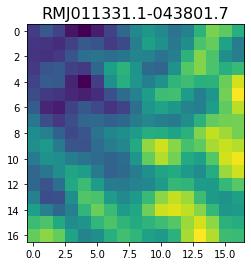

 55%|█████▌    | 5556/10099 [08:19<05:27, 13.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 9.6669378e+00 -1.0358954e+01 -3.5951984e+01 -4.6192139e+01
 -2.5259268e+01  4.1422715e+00  3.2455854e-02 -4.1158054e+01
 -7.3481232e+01 -6.1165054e+01 -2.3961714e+01 -3.3449607e+00
 -7.0562162e+00 -1.5536491e+01 -2.5969500e+01 -5.3002735e+01
 -8.9464127e+01]


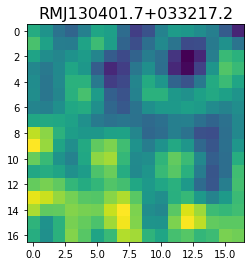

<class 'pixell.enmap.ndmap'>
[ 94.91963   56.924995  54.086044  85.399826 116.59286  125.29739
 115.261284  99.88309   89.05713   85.49276   82.0358    68.58328
  50.61631   51.621075  83.516975 121.65665  128.0128  ]


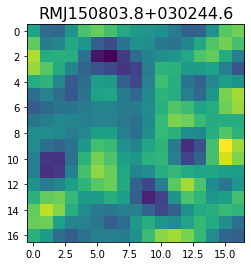

 55%|█████▌    | 5559/10099 [08:19<08:22,  9.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 60.966557  53.93818   62.41098   86.94035  100.26359   87.764595
  71.104965  73.13237   85.09857   86.86144   76.78264   65.656334
  60.726067  66.88023   83.8633    95.5644    84.85176 ]


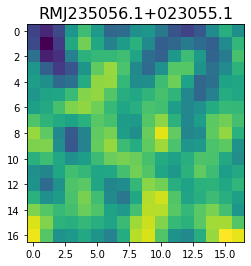

 55%|█████▌    | 5564/10099 [08:20<07:48,  9.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.5480223  15.020024    3.7144978  -4.0210247   5.1937146  -2.5810435
 -39.997078  -53.34338    -7.7488317  40.088104   25.407328  -17.353804
 -11.25145    33.777992   37.05184   -17.017944  -45.885815 ]


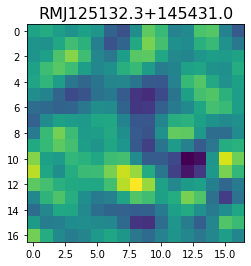

 55%|█████▌    | 5566/10099 [08:20<08:34,  8.81it/s]

<class 'pixell.enmap.ndmap'>
[108.806366  91.3669    60.125435  55.36242   49.02893   29.820309
  43.761543  88.82957   97.143936  70.40693   86.42485  137.64246
 129.42474   62.767452  41.502045  81.7837    93.49856 ]


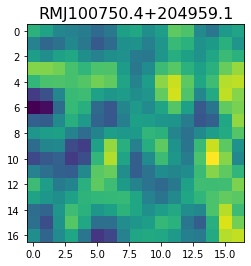

 55%|█████▌    | 5568/10099 [08:21<09:15,  8.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -91.445656   -44.38271     -2.351748    11.343887   -26.827002
  -90.543205  -104.7686     -40.566555    27.143017    23.03877
  -13.294155   -11.272575   -12.884344   -95.39274   -193.27237
 -162.0401      -5.5261316]


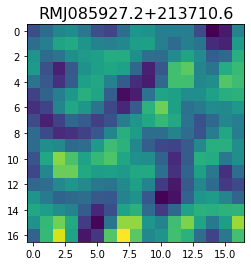

 55%|█████▌    | 5570/10099 [08:21<09:52,  7.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[294.5465   201.69952  115.639946 140.85298  202.45149  195.8152
 142.80876  130.06024  171.31668  199.6864   168.77112  112.87802
  96.20661  125.11795  145.35675  125.61609   95.928215]


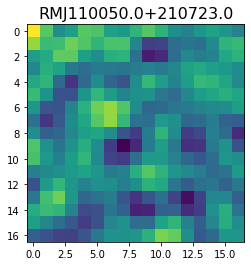

 55%|█████▌    | 5571/10099 [08:21<11:43,  6.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 14.228958   -2.9490743  -7.623044   20.550562   45.304474   23.443802
 -29.258793  -58.792686  -42.936913   -7.250932   16.637938   17.637297
  -1.7078558 -28.842674  -38.58776   -10.472076   45.92678  ]


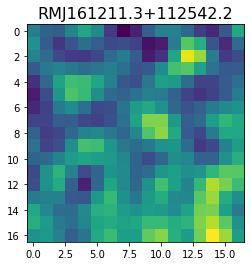

 55%|█████▌    | 5574/10099 [08:21<10:14,  7.36it/s]

<class 'pixell.enmap.ndmap'>
[ 0.84631556  0.6508026   0.04216706 -0.17853495  0.01321872  0.08617251
 -0.02229992 -0.03758434  0.01396538  0.00501512  0.00871449  0.01710469
 -0.05087235 -0.02821716  0.14016049  0.01611665 -0.57384634]


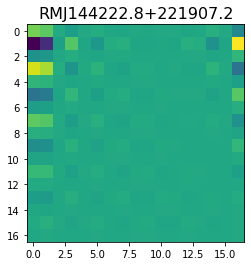

 55%|█████▌    | 5575/10099 [08:22<12:03,  6.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -73.34206   -108.520905  -173.07378   -266.71667   -375.19672
 -443.94415   -389.45065   -204.8937     -30.120455   -25.360878
 -168.7732    -265.10544   -185.03098    -20.19025     52.87246
   -0.7258633  -70.51197  ]


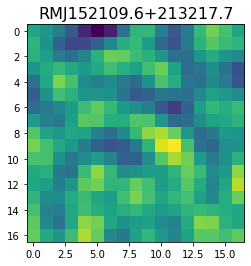

 55%|█████▌    | 5578/10099 [08:22<10:33,  7.14it/s]

<class 'pixell.enmap.ndmap'>
[150.55823  152.48618  160.61597  169.00395  172.23663  164.44582
 142.07948  118.230965 117.51153  140.49228  156.20016  151.31114
 155.39291  184.71227  198.30746  161.16795  118.6479  ]


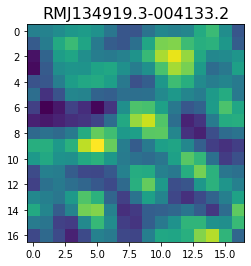

 55%|█████▌    | 5579/10099 [08:22<12:12,  6.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[119.83048  106.96332   85.66192   74.695206  80.092445  96.73925
 113.23591  119.119675 114.9575   111.213684 112.72222  112.89442
 109.27388  112.196556 125.93151  133.10756  116.59336 ]


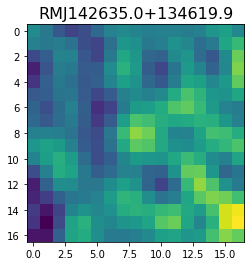

 55%|█████▌    | 5582/10099 [08:23<10:43,  7.02it/s]

<class 'pixell.enmap.ndmap'>
[-15.340872  -63.158707  -31.879395   57.120014  110.24789    74.840935
   4.6418624 -16.617676   11.383927   18.073904  -24.570866  -62.272343
 -43.692104    9.879604   47.05114    55.60004    56.70172  ]


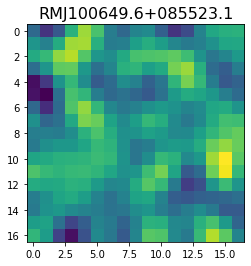

 55%|█████▌    | 5583/10099 [08:23<12:34,  5.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-1.53834763e+02 -1.38518555e+02 -1.59752384e-01  6.36304665e+01
 -1.08660545e+01 -7.19724731e+01 -3.62817116e+01  1.45182343e+01
  1.76084423e+01 -2.16514378e+01 -1.08529655e+02 -1.93872696e+02
 -1.54364761e+02 -6.72077894e+00  4.54627457e+01 -6.80121307e+01
 -1.54254028e+02]


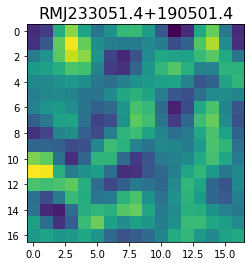

 55%|█████▌    | 5587/10099 [08:23<09:39,  7.78it/s]

<class 'pixell.enmap.ndmap'>
[ 41.79215    44.816372   53.87689    74.700195   97.56366    85.67578
  25.599674  -28.64533   -18.795828   29.556192   46.118366   20.762184
  -1.7989877  -8.890686  -24.023312  -41.585045  -32.666786 ]


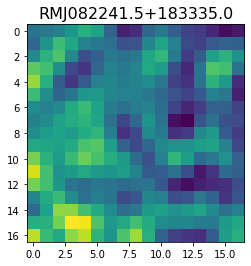

 55%|█████▌    | 5588/10099 [08:24<11:23,  6.60it/s]

<class 'pixell.enmap.ndmap'>
[ -39.451466  -34.57407   -33.29362   -40.624775  -59.994843  -83.47147
  -98.08974   -91.19071   -60.60913   -30.984901  -32.97015   -55.177876
  -58.766605  -47.925022  -64.67708  -102.37872  -101.5481  ]


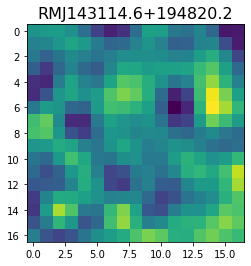

 55%|█████▌    | 5589/10099 [08:24<12:34,  5.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-19.004227  -22.230015  -16.8005     -8.210665  -11.558999  -17.260191
 -10.501763   -1.2711998  -3.0045152  -7.7122593  -9.0415125 -17.847935
 -29.873167  -17.617517   17.719223   30.265003   -1.9692129]


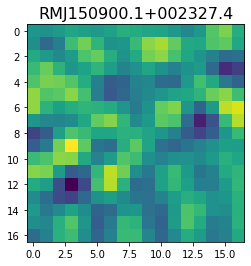

 55%|█████▌    | 5593/10099 [08:24<09:39,  7.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 99.8768    134.11096   154.24971   125.7356     56.249275   -2.3299148
  -0.9578319  47.553      72.53573    38.12469     3.9404352  36.76664
  94.57376    86.03604    23.09778     6.154235   61.43994  ]


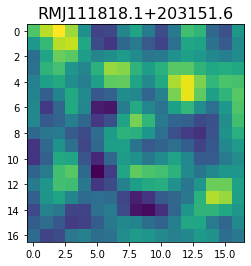

 55%|█████▌    | 5602/10099 [08:25<04:51, 15.42it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-260.31354  -191.13312  -136.04135  -157.20747  -232.90724  -290.43503
 -273.39856  -187.73036   -98.663635  -68.69196   -91.03632  -108.828384
 -101.42509  -107.82626  -152.46806  -200.28613  -212.47719 ]


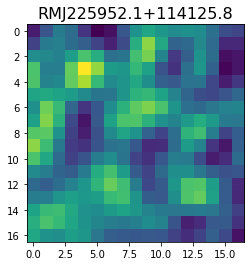

 56%|█████▌    | 5605/10099 [08:25<05:22, 13.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.488945 -35.05156  -37.36505  -41.00719  -41.22454  -40.194393
 -45.25731  -52.134583 -48.89705  -41.213062 -46.1731   -58.25974
 -56.741173 -45.9557   -45.52339  -45.227467 -21.924664]


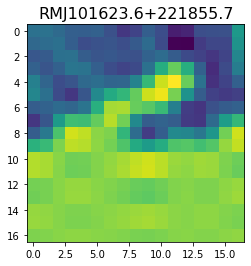

 56%|█████▌    | 5608/10099 [08:25<05:54, 12.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-112.69764     19.60297    113.98393     62.885452   -84.264206
 -188.57175   -176.7017     -90.51019    -23.19978    -47.035126
 -160.41168   -264.12384   -240.1578     -98.684494    13.311557
    1.3305938  -54.561226 ]


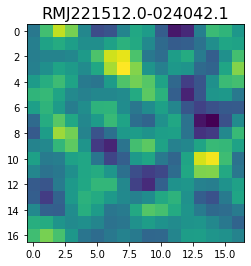

 56%|█████▌    | 5614/10099 [08:26<05:16, 14.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -32.15213   -55.857746  -82.42535   -66.30699   -36.003365  -47.072464
  -90.077156 -101.87099   -60.101933  -14.285535  -14.715716  -53.152855
  -88.88347   -97.605255  -78.35336   -45.70899   -30.865149]


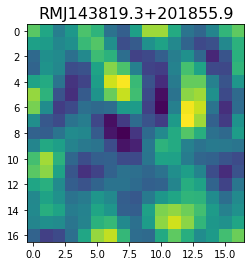

 56%|█████▌    | 5617/10099 [08:26<05:50, 12.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  1.0127351  10.16194    30.417809   39.13022    33.970993   34.826332
  45.17788    44.765354   21.48871   -12.783503  -35.550987  -29.430784
   4.5697584  40.83146    52.162704   42.357594   34.970142 ]


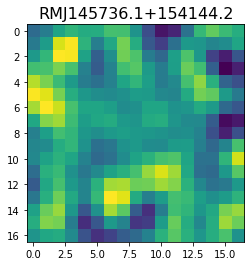

 56%|█████▌    | 5620/10099 [08:26<06:16, 11.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-34.337254    1.7129989  25.686255    1.6717126 -44.52713   -60.528343
 -38.264374  -19.078218  -31.226171  -48.844746  -30.003235   15.293593
  27.246195  -18.863848  -63.501514  -37.957085   34.5509   ]


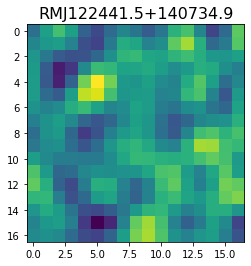

 56%|█████▌    | 5623/10099 [08:26<06:35, 11.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-129.40262  -105.43112   -82.84979   -83.62697  -107.32535  -126.472176
 -125.36891  -119.34602  -124.8064   -132.86794  -128.53812  -118.13068
 -118.00054  -126.56494  -127.20097  -115.41918  -106.15566 ]


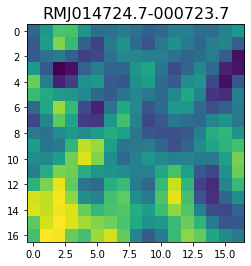

 56%|█████▌    | 5626/10099 [08:27<06:58, 10.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 132.91118    97.926476  -35.138153  -63.148273   43.806602   86.5125
  -19.120766  -94.68001   -18.342976   57.699768  -19.381763 -131.96634
  -99.746445   18.042536   46.149925  -14.370417  -31.76293 ]


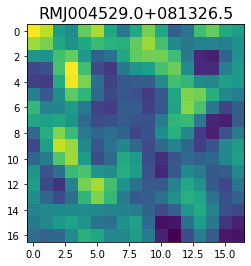

 56%|█████▌    | 5628/10099 [08:27<07:20, 10.15it/s]

<class 'pixell.enmap.ndmap'>
[ 59.236355   51.468426   43.92978    33.297653   27.103268   42.958923
  55.805523   22.028675  -27.562147  -13.796297   51.82105    64.45101
  -6.3056087 -64.26274   -46.163612  -11.513517  -17.227934 ]


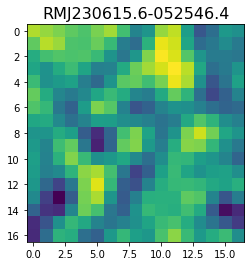

<class 'pixell.enmap.ndmap'>
[  18.574402    -49.816113    -83.63686     -36.27594       8.552494
   -9.619052    -22.076187      9.876094     -3.4987226   -90.6895
 -126.96497     -58.372402      0.44231716   -5.893438      4.7079763
   30.365622    -32.351574  ]


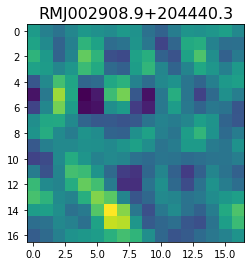

 56%|█████▌    | 5630/10099 [08:27<09:33,  7.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -31.210096  -57.572422  -56.502575  -38.135227  -25.960337  -22.29976
  -27.821266  -57.8668   -109.03645  -140.72491  -122.545815  -77.20523
  -47.980934  -44.456676  -46.683983  -43.819183  -40.865646]


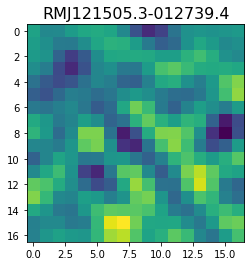

 56%|█████▌    | 5632/10099 [08:28<09:24,  7.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-18.043406   54.405033   90.7001     47.27056    11.458974   54.001087
 101.53506    55.638927  -39.692513  -64.14408    -3.0156844  51.839027
  53.975735   47.13116    66.99365    90.27788    88.37673  ]


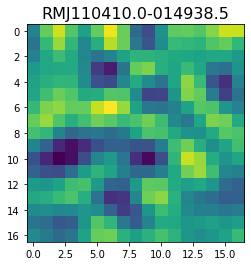

 56%|█████▌    | 5636/10099 [08:28<07:35,  9.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-15.778999  -18.857683  -31.354555  -33.199875  -31.922512  -40.460464
 -43.213284  -17.639677   20.81419    30.161356   -0.7102238 -36.306362
 -43.974186  -33.03252   -30.836426  -40.6689    -44.30623  ]


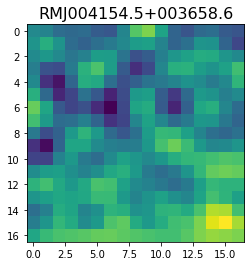

 56%|█████▌    | 5640/10099 [08:28<07:08, 10.41it/s]

<class 'pixell.enmap.ndmap'>
[ -49.95295   -54.10645   -79.315384  -95.631775  -93.102165  -96.74814
 -112.302635 -111.421936  -83.84673   -58.525925  -60.403885  -79.73192
  -90.99584   -80.01424   -54.24828   -38.81781   -49.52366 ]


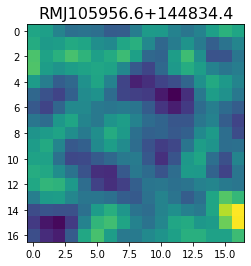

 56%|█████▌    | 5642/10099 [08:29<07:35,  9.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 5.575628   -4.9269924  17.375586   40.58722    28.982767    2.5573485
  1.9187574  19.480808   17.195484   -2.615786    0.19486736 32.72172
 53.50948    37.388596   11.540711    9.857709   25.508514  ]


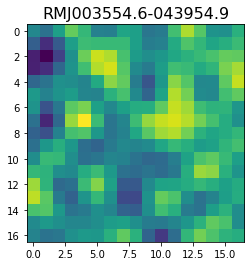

 56%|█████▌    | 5643/10099 [08:29<08:58,  8.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-130.16597  -136.01558  -106.82148   -82.43701  -102.64577  -133.45245
 -117.750656  -70.55058   -48.924175  -59.768158  -74.80244   -95.45282
 -123.91703  -123.28971   -87.37831   -84.69372  -149.5578  ]


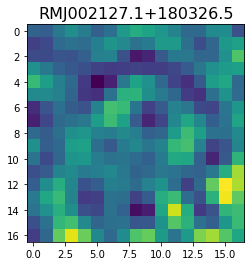

 56%|█████▌    | 5647/10099 [08:29<07:29,  9.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 97.82214   117.73118   162.29327   176.57462   175.11305   177.56581
 169.108     148.74722   141.12611   139.47122   104.80656    40.973385
   7.6065407  36.958817   90.04168   113.486305   96.86294  ]


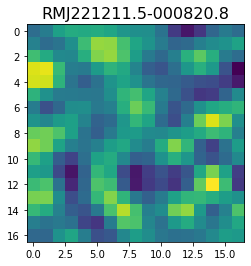

 56%|█████▌    | 5651/10099 [08:29<06:34, 11.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 14.080308  23.027401  10.171918  12.946772  27.062834  19.66967
  -7.90017  -14.522186  16.798525  50.4405    51.178314  30.436777
  17.075043  13.860888  11.743896  20.658134  51.112522]


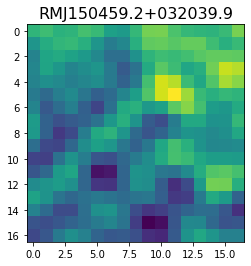

 56%|█████▌    | 5663/10099 [08:30<03:38, 20.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  88.132416   133.29431     79.094574     7.1780744  -58.088623
 -109.193     -116.949814  -110.91737   -152.29434   -186.71889
  -99.57863     56.663044    97.457886    -1.7810395  -72.453964
  -48.387745   -57.766296 ]


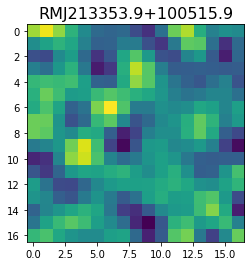

 56%|█████▌    | 5666/10099 [08:30<04:20, 17.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -88.91239   -73.925766  -73.64273   -62.112503  -30.404678  -18.593372
  -50.959778  -85.875595  -74.509     -36.448112  -30.45004   -68.12907
 -101.72061   -94.838905  -65.276276  -45.323513  -32.476093]


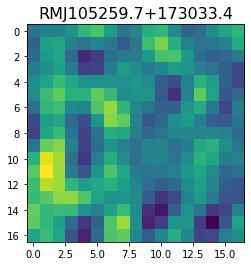

 56%|█████▌    | 5669/10099 [08:30<04:58, 14.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -70.86743   -73.832924  -46.151825  -54.985138  -93.81346   -93.137024
  -47.85266   -34.120388  -84.13891  -130.35278  -109.27257   -57.156513
  -54.87177  -112.30913  -156.62778  -129.76653   -58.621162]


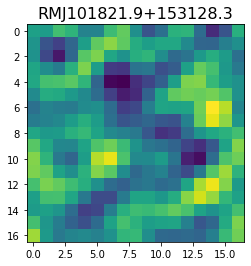

 56%|█████▌    | 5672/10099 [08:31<05:21, 13.78it/s]

<class 'pixell.enmap.ndmap'>
[ 31.02559   33.527763  29.545958  29.589756   9.426481 -33.109356
 -49.13611  -18.856133   4.083066 -16.842728 -35.283504  -7.422218
  28.367126  25.776958  15.047081  38.58757   66.43638 ]


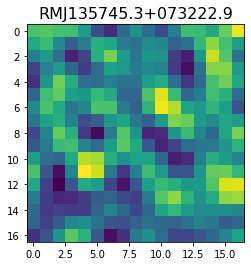

 56%|█████▌    | 5674/10099 [08:31<06:03, 12.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-89.85182   -62.35553   -30.283262  -32.70044   -56.6432    -57.33787
 -27.726408   -8.7715645 -26.024952  -53.969543  -58.396507  -42.442184
 -29.6006    -25.917845  -23.472609  -24.105915  -34.880814 ]


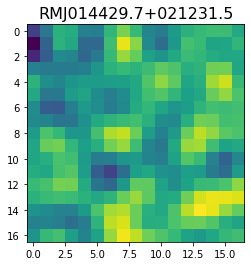

 56%|█████▌    | 5676/10099 [08:31<06:43, 10.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[114.206345 125.34401  118.474846  94.24547   79.18848   85.95791
  92.692505  79.04809   58.61592   53.82557   59.236755  55.17085
  42.633194  38.02937   42.646896  43.06034   37.6603  ]


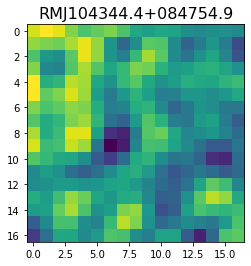

 56%|█████▌    | 5679/10099 [08:31<06:32, 11.26it/s]

<class 'pixell.enmap.ndmap'>
[145.40121   115.13277    28.100325   36.420975  117.55535   113.66934
  -0.4151901 -76.41426   -24.155796   77.22532   121.67662    99.42712
  53.037663   16.793175   23.733566   88.4669    164.03206  ]


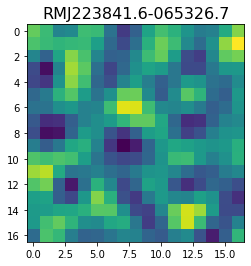

 56%|█████▋    | 5681/10099 [08:32<07:29,  9.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[116.8792     63.925755  138.83798   194.25949   138.52892    42.31286
 -10.611185  -22.347303   -3.0814865  68.74143   167.98349   215.46999
 188.4899    149.10631   134.80606   109.26959    53.45118  ]


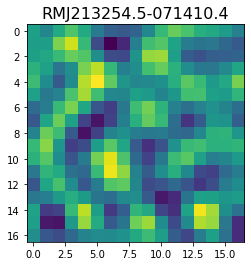

 56%|█████▋    | 5683/10099 [08:32<08:13,  8.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 43.268528   39.722565   15.510908  -12.338538    8.75759    66.860306
  91.763954   65.90627    38.335205   31.177698   19.319057   -1.2114029
  -2.3829014  21.101908   45.13236    57.802357   67.64111  ]


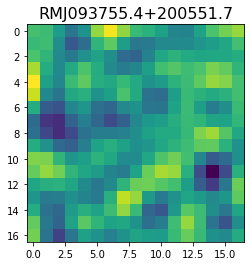

 56%|█████▋    | 5686/10099 [08:32<08:30,  8.64it/s]

<class 'pixell.enmap.ndmap'>
[ 22.721449  41.371975  36.67738   46.9101    67.397896  53.076134
  12.806661   9.636256  46.912354  53.236084  16.182013  21.939682
 102.9328   156.51349  100.69763   12.442958   7.499014]


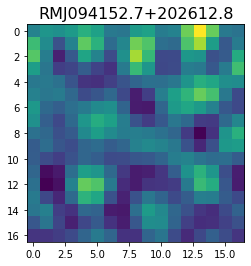

 56%|█████▋    | 5687/10099 [08:33<09:47,  7.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 46.935715   25.398746  -15.482979  -31.189613  -15.349811    1.6791688
   8.634631   17.123772   29.252964   43.458908   67.17415    87.11134
  63.608646   -4.7380667 -53.280346  -34.2784     14.831711 ]


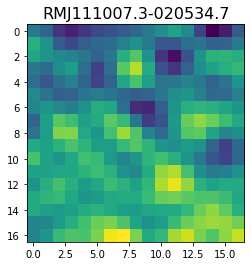

 56%|█████▋    | 5690/10099 [08:33<08:34,  8.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 20.884752  65.077446  99.34459  106.63612   78.71019   41.91051
  64.505226 149.20573  171.28485   50.42305  -75.141495 -16.801302
 164.36536  226.77777  105.2786   -17.781834 -20.11257 ]


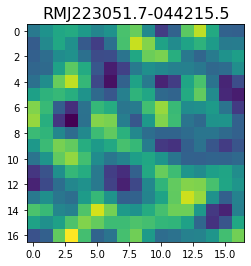

 56%|█████▋    | 5692/10099 [08:33<08:50,  8.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.2757826  -15.993539   -49.060528   -46.875145    -7.7101483
  22.301641    16.425097     0.22977613   4.1377664   17.376282
  11.475047   -14.249103   -35.54499    -38.057114   -27.608011
 -13.443528    -0.32154244]


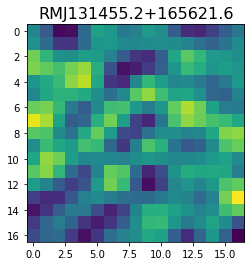

 56%|█████▋    | 5695/10099 [08:33<08:13,  8.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-142.23935     -71.68502     -50.31333     -36.094112     24.647394
   72.73541      29.810053    -54.05734     -65.241356     -5.4419804
   15.143177    -38.718475    -73.03819     -30.623703      0.39338928
  -75.995316   -195.75226   ]


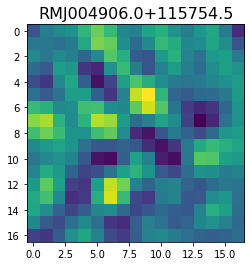

 56%|█████▋    | 5698/10099 [08:34<08:00,  9.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-84.768105  -96.0436    -74.438034  -51.391716  -50.191628  -54.175312
 -36.57884    -5.6657686   6.2250075  -8.181523  -20.310816   -6.050374
  25.261877   47.500774   47.18322    31.093538   15.7551155]


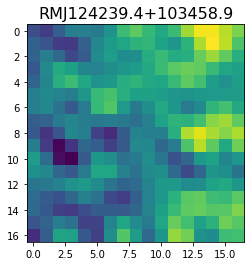

 56%|█████▋    | 5703/10099 [08:34<06:57, 10.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-22.671371  -37.917484  -31.62665   -26.364504  -40.360374  -48.932953
 -31.985945  -20.76369   -36.797043  -44.616993  -27.943851  -31.078346
 -62.553585  -59.76895    -8.891144   18.594856    1.5924911]


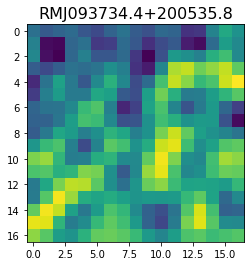

 56%|█████▋    | 5705/10099 [08:34<07:26,  9.85it/s]

<class 'pixell.enmap.ndmap'>
[ -58.84878    23.507265  112.10994   104.78422    23.10439    -9.358923
   40.805084   48.29912   -62.788795 -155.87103   -82.54443    64.37178
  107.71789    78.051216  103.48992   130.55296    41.560356]


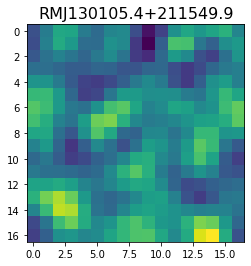

 57%|█████▋    | 5706/10099 [08:35<08:38,  8.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  3.4614356   1.5503362   2.2804413   9.240334   31.719149   46.503006
  33.090763   21.317142   55.826027  121.30075   148.86267   103.40669
  25.181921  -30.619926  -58.311317  -78.15151   -80.57389  ]


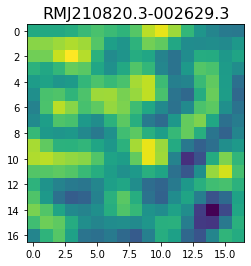

 57%|█████▋    | 5716/10099 [08:35<04:16, 17.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-85.4605    -65.830536  -62.044823  -74.63224   -79.67182   -55.556984
 -13.542391    5.9059997 -17.524517  -49.77869   -46.697186  -21.038227
 -20.727959  -46.019634  -48.155975  -18.393326  -10.148138 ]


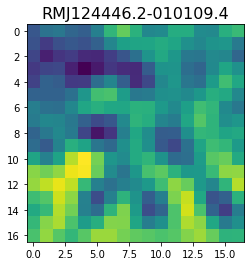

<class 'pixell.enmap.ndmap'>
[-45.962288 -39.988808 -41.361225 -41.243885 -36.645863 -38.1359
 -49.991154 -60.465153 -59.407555 -50.732788 -42.094746 -36.071083
 -34.591095 -38.365376 -41.435623 -40.249367 -44.959667]


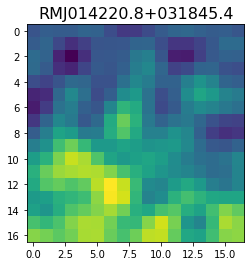

 57%|█████▋    | 5719/10099 [08:35<06:18, 11.57it/s]

<class 'pixell.enmap.ndmap'>
[ -54.886574  -71.292206 -111.82928  -113.65623   -66.597305  -22.041327
  -26.048512  -69.72444  -108.43198  -110.54802   -80.68798   -47.383476
  -35.415733  -45.930687  -60.837505  -66.41268   -66.9534  ]


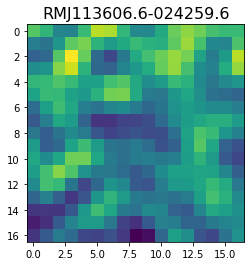

 57%|█████▋    | 5721/10099 [08:36<06:56, 10.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-15.750254   22.714901   30.20948     1.5853105 -36.616173  -52.252327
 -50.916847  -52.41556   -45.358387  -19.996153   -8.753598  -29.869558
 -41.95075   -22.150187  -18.128471  -46.6645    -33.587128 ]


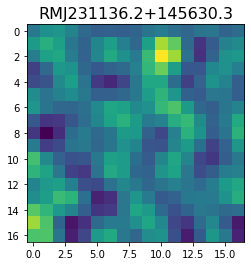

 57%|█████▋    | 5723/10099 [08:36<07:29,  9.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  42.26781    95.904655   78.01431    17.887743    9.779453   56.7105
   49.483376  -52.011253 -125.65157   -59.39729    76.28954   133.32965
   92.60942    54.862823   74.33421   109.58512   115.5153  ]


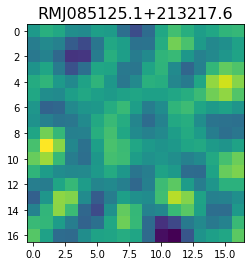

 57%|█████▋    | 5729/10099 [08:36<06:12, 11.73it/s]

<class 'pixell.enmap.ndmap'>
[ -9.870022     4.962658    -0.87522227 -12.503484    -2.2357183
  25.268686    35.572098    15.812926    -4.7500505    4.110226
  36.035152    65.29469     80.573944    85.22436     82.14471
  78.42618     90.88267   ]


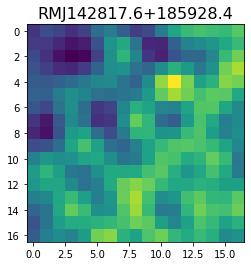

 57%|█████▋    | 5731/10099 [08:37<06:45, 10.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-171.4276   -189.29279  -195.42477  -146.4716    -74.16109   -83.09858
 -177.99919  -221.82355  -144.98523   -57.611794  -60.138584  -89.440475
  -67.037056  -49.819096  -95.391884 -121.169716  -54.28751 ]


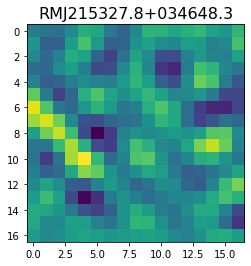

 57%|█████▋    | 5735/10099 [08:37<06:12, 11.73it/s]

<class 'pixell.enmap.ndmap'>
[-26.740166   4.77582   31.982931  23.511835  -5.70919  -19.157394
 -14.379042 -18.183352 -36.03442  -47.287613 -47.90358  -55.143585
 -66.8319   -58.729843 -31.365164 -18.22544  -32.79576 ]


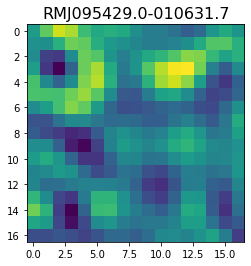

 57%|█████▋    | 5737/10099 [08:37<06:54, 10.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 95.199486  114.27762    71.81311    39.73939    38.265305   32.47645
  18.12409    25.264233   58.355923   95.07412   116.45046   100.81406
  41.164135   -4.2587175  38.925396  130.70341   140.79816  ]


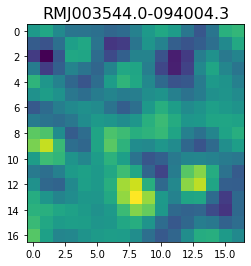

 57%|█████▋    | 5739/10099 [08:37<07:29,  9.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -41.223083  -52.496826  -84.428734  -98.10061   -78.7846    -60.801823
  -77.32627  -110.19198  -117.65606   -93.95558   -69.61161   -62.88135
  -62.5027    -55.89374   -46.882175  -42.860176  -44.214626]


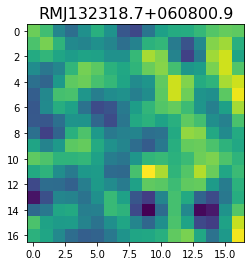

 57%|█████▋    | 5741/10099 [08:38<07:56,  9.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-57.722843 -51.91773  -54.21443  -81.6223   -97.57108  -68.67959
 -25.422043 -17.22548  -35.881725 -35.792816 -12.280855  -6.173114
 -33.83943  -59.66207  -47.226696  -5.229003  29.3732  ]


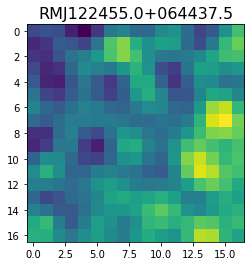

 57%|█████▋    | 5743/10099 [08:38<08:17,  8.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.793983   86.28545    77.84934    42.026688   13.581449    5.9428854
  28.553638   84.166695  137.40717   137.59514    89.58091    56.455917
  74.30634   106.95864   105.552605   73.80782    49.643112 ]


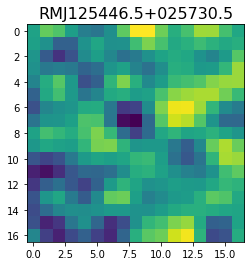

 57%|█████▋    | 5745/10099 [08:38<08:33,  8.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[160.93823 115.94282 185.5907  286.16687 293.8068  220.89769 191.26204
 252.51451 312.10263 286.40076 221.69533 206.65982 234.70006 234.95479
 198.87334 185.35144 211.2178 ]


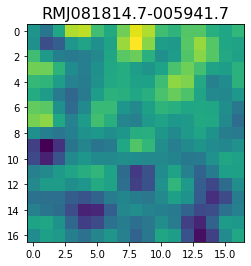

 57%|█████▋    | 5747/10099 [08:38<08:54,  8.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-32.53458   -35.69907   -14.507562    1.8042262 -12.132036  -42.55297
 -51.31011   -25.553549    2.8456793  -3.661369  -41.07329   -70.56721
 -68.21596   -50.59671   -46.73327   -60.403084  -72.394936 ]


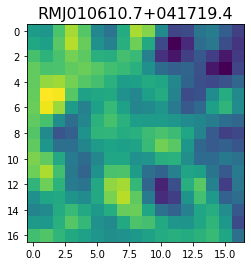

 57%|█████▋    | 5750/10099 [08:39<08:09,  8.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 55.91709    53.141808   49.229355   44.76458    46.818535   56.447777
  63.572964   55.48902    31.454535    9.977852   14.894594   45.78958
  68.768845   51.30869     3.8267202 -30.45443   -28.034374 ]


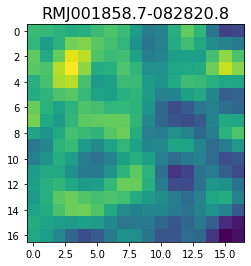

 57%|█████▋    | 5752/10099 [08:39<08:23,  8.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -89.86564  -106.05243   -88.93283   -53.72121   -38.195805  -40.013073
  -35.931248  -35.781364  -60.77292   -90.73982   -91.12299   -76.191826
  -88.5326   -125.40201  -139.64987  -112.383385  -77.72259 ]


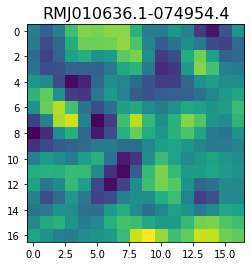

 57%|█████▋    | 5755/10099 [08:39<07:35,  9.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-61.304073  -51.150043    6.6398354  23.133986  -31.132778  -84.027565
 -85.65788   -75.00986   -89.77321   -99.00846   -70.366394  -32.629944
 -24.78841   -37.127678  -41.368862  -35.24548   -28.899492 ]


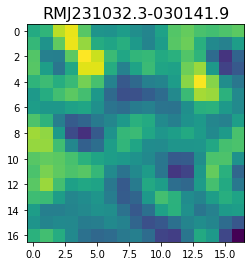

 57%|█████▋    | 5758/10099 [08:40<07:04, 10.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  6.19311   21.068466  79.19578  129.47356  124.87545   70.02673
  18.532648  33.42538  121.27846  205.08823  214.1983   183.1837
 181.51208  184.25533  132.56027   78.452545 116.68681 ]


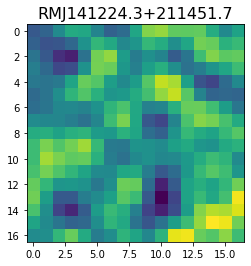

 57%|█████▋    | 5761/10099 [08:40<07:00, 10.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-114.507614 -196.52153  -241.5801   -125.97266    22.307302  -25.591198
 -202.41771  -233.75995  -102.96655   -63.4362   -175.83633  -215.81152
 -102.58039   -44.377453 -149.69583  -233.27522  -146.9409  ]


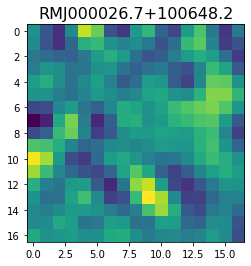

 57%|█████▋    | 5763/10099 [08:40<07:57,  9.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  71.24529    81.50075   -10.33497  -106.66533  -111.74013   -22.818325
   81.839714  111.12681    41.547142  -50.48149   -71.9992    -33.849762
  -27.303986  -75.8928    -98.279976  -45.96365    16.647509]


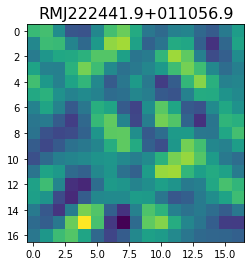

 57%|█████▋    | 5765/10099 [08:40<08:13,  8.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[22.89873  23.54966  22.645557 23.092957 25.701393 26.665445 24.791023
 23.888584 25.65649  27.30376  27.10649  26.157236 25.581337 26.586098
 29.887156 32.277485 29.848606]


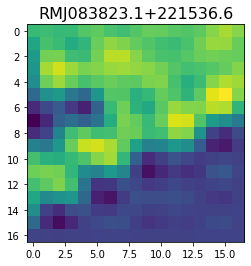

 57%|█████▋    | 5767/10099 [08:41<08:22,  8.61it/s]

<class 'pixell.enmap.ndmap'>
[-79.999245 -74.16683  -84.5375   -91.411095 -69.70819  -45.027794
 -60.896667 -96.90921  -96.658325 -66.21234  -57.26259  -69.66421
 -65.614815 -56.086662 -74.16037  -95.305725 -84.25825 ]


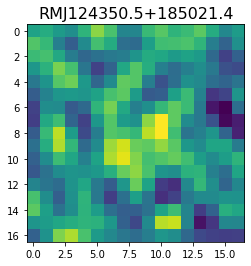

 57%|█████▋    | 5768/10099 [08:41<09:36,  7.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -46.31282   -117.18778   -142.10898    -51.429752    57.54033
   25.089577  -130.25005   -216.41527   -135.85596      1.4544244
   69.16705     67.88118     26.020601   -71.970436  -182.04712
 -190.45485    -99.318054 ]


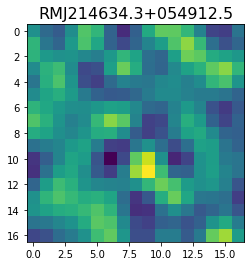

 57%|█████▋    | 5772/10099 [08:41<07:24,  9.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -56.63736   -62.189285  -49.154198  -44.472164  -47.676807  -34.33837
  -13.363491  -26.507263  -76.98949  -110.75465   -94.078926  -63.577698
  -65.640564  -85.95188   -81.117256  -52.6891    -42.92203 ]


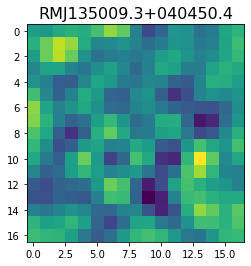

 57%|█████▋    | 5777/10099 [08:41<06:11, 11.64it/s]

<class 'pixell.enmap.ndmap'>
[ -36.467216  -98.37869  -139.62166  -113.39745   -72.65063   -83.02907
 -119.074104 -132.25815  -148.81781  -204.80804  -248.81284  -213.95259
 -138.00822  -110.454315 -135.73334  -141.34335  -101.259544]


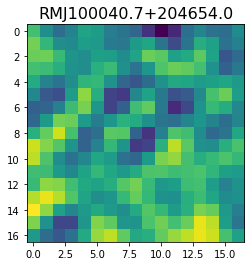

<class 'pixell.enmap.ndmap'>
[ -89.30621   -24.44871   147.43958   233.95638    94.588104 -133.9973
 -172.24612    44.109734  251.23497   180.23009   -80.79707  -191.49725
  -23.826736  158.1307     79.46523  -143.98195  -172.96155 ]


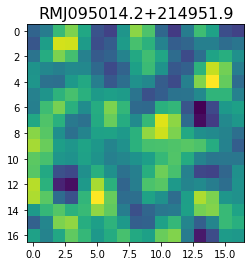

 57%|█████▋    | 5779/10099 [08:42<08:53,  8.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 75.41802   44.770782  43.504604  88.49096  134.4287   123.23315
  62.955376  19.61201   29.568981  61.187508  70.77836   56.0223
  38.990704  29.909975  27.961819  37.088432  62.14245 ]


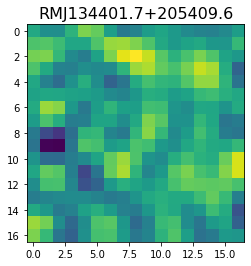

 57%|█████▋    | 5781/10099 [08:42<09:14,  7.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-17.510998    0.2616568  64.39055   122.37395   144.64946   124.323296
  70.973305   26.890924   42.651867  110.56872   163.19568   158.86497
 126.06559   105.23405    97.72251    97.435585  118.780655 ]


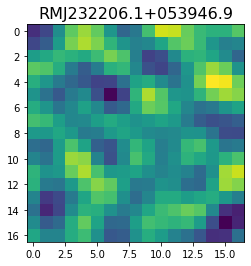

 57%|█████▋    | 5787/10099 [08:43<06:24, 11.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-28.851345   -40.488136   -37.16733    -16.420008    -0.35903504
  -2.7843192   -8.523778     3.0787194   27.68548     43.53417
  41.299946    30.75425     20.974468    10.196609    -2.0421183
  -7.150241    -0.08046208]


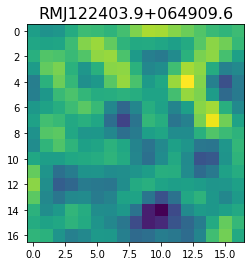

 57%|█████▋    | 5789/10099 [08:43<06:52, 10.44it/s]

<class 'pixell.enmap.ndmap'>
[ -49.7917    -75.192184 -126.965    -154.19551  -130.16772   -84.30383
  -67.638275  -95.54961  -138.0316   -158.74411  -147.58737  -119.050255
  -94.93862   -88.42979   -91.96901   -81.67418   -45.513813]


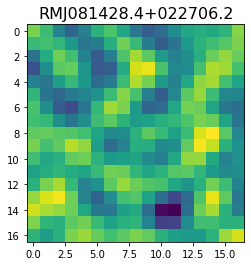

<class 'pixell.enmap.ndmap'>
[ 25.144001   -1.2230133 -10.894496   13.301686   22.79532    -3.5061548
 -23.694544  -14.695938   -8.715862  -20.38757   -14.335678   23.468208
  52.448215   46.776207   34.42642    38.889187   41.075306 ]


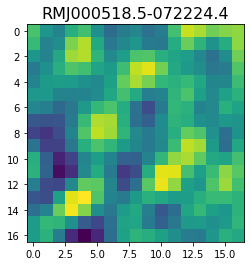

 57%|█████▋    | 5791/10099 [08:43<08:59,  7.98it/s]

<class 'pixell.enmap.ndmap'>
[ -3.6710231   2.1768591   8.622908   21.225174   19.375664  -18.299065
 -64.81164   -66.80849   -18.014425   28.203876   28.144      -1.1601202
 -13.623706    4.0833426  21.2449      9.307483  -17.121626 ]


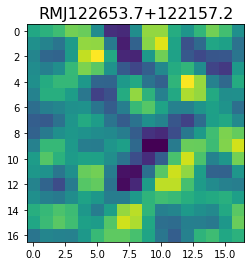

 57%|█████▋    | 5792/10099 [08:44<10:03,  7.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -35.74247  -155.10283   -67.15641    86.7867     96.34337    31.934662
   87.94863   208.23184   197.68253   101.896935  107.88847   160.4837
   71.788765  -75.827545  -46.543316  111.655334  152.94287 ]


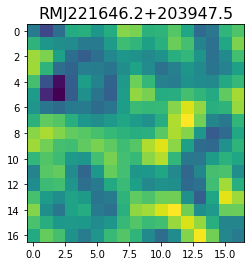

 57%|█████▋    | 5794/10099 [08:44<10:25,  6.88it/s]

<class 'pixell.enmap.ndmap'>
[ -67.294556  -66.26761   -68.273415  -94.41489  -124.40423  -116.188965
  -69.92928   -36.834965  -53.293697  -95.93057  -117.5733   -103.231895
  -72.74548   -48.56623   -40.91405   -50.183094  -65.25598 ]


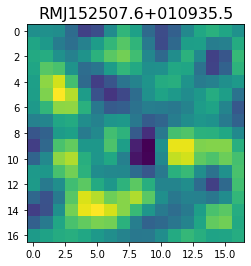

 57%|█████▋    | 5795/10099 [08:44<11:29,  6.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 64.91583   52.737793  57.039192  84.7593   108.659065 101.344574
  77.75752   70.52812   78.19468   75.5302    62.940666  63.982346
  79.876526  87.6108    81.70088   79.001434  81.751175]


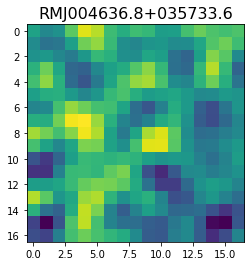

 57%|█████▋    | 5798/10099 [08:44<09:11,  7.80it/s]

<class 'pixell.enmap.ndmap'>
[ 55.773247   77.52015    79.23904    55.449585    4.188136  -35.608433
  -2.2752092 103.46986   192.51239   184.25078   101.69218    33.94737
  28.191229   58.28593    82.34       85.93386    71.85206  ]


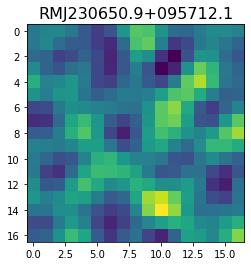

 57%|█████▋    | 5806/10099 [08:45<04:44, 15.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-304.4943   -318.51462  -362.84357  -385.80045  -273.8824    -71.1458
   22.429789  -79.13406  -221.41283  -234.75366  -165.12355  -164.65222
 -239.34064  -253.22717  -156.4557    -65.20806   -85.32585 ]


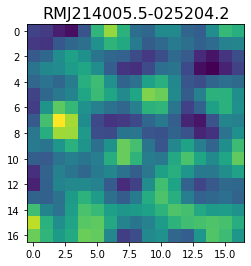

 58%|█████▊    | 5809/10099 [08:45<05:27, 13.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[196.75739 188.9371  180.20314 229.53978 298.7181  317.13837 300.03613
 297.00336 295.68158 276.3241  274.98553 298.59064 278.29398 197.69608
 157.56386 223.30898 314.37363]


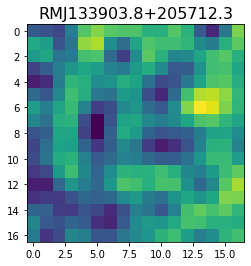

 58%|█████▊    | 5811/10099 [08:45<06:25, 11.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-199.03383   -25.752958   62.286728  -15.327132 -147.95093  -208.55208
 -203.89877  -193.70207  -182.594    -166.24467  -176.50732  -204.50648
 -177.41579   -86.05128   -40.551075 -119.4275   -244.96255 ]


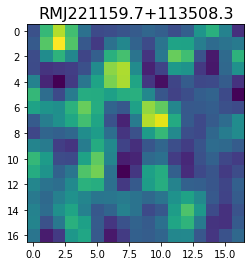

 58%|█████▊    | 5816/10099 [08:46<05:29, 12.99it/s]

<class 'pixell.enmap.ndmap'>
[ -79.19553   -124.96286   -105.46133    -46.977776   -11.5192375
   -5.3941083   -4.122086    -4.6622295  -13.0435705  -26.137596
  -47.948387   -82.99702   -106.65323    -87.3156     -41.66282
  -23.749521   -55.341805 ]


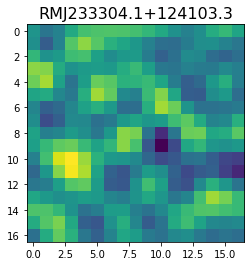

 58%|█████▊    | 5818/10099 [08:46<06:03, 11.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-49.546318 -11.240388 -12.176554 -45.01935  -54.06041  -23.218767
  -5.226207 -34.8341   -71.79049  -68.383804 -41.302536 -33.280544
 -47.088444 -59.97659  -66.315575 -67.32583  -52.892273]


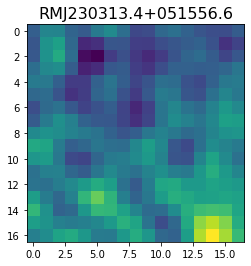

<class 'pixell.enmap.ndmap'>
[ -66.90985  -184.8788   -182.76997   -46.450855   63.097057   33.62352
  -43.493362  -21.577412   97.472     198.01175   213.8822    166.632
   93.420654   18.618574  -33.503216  -56.692177  -70.13337 ]


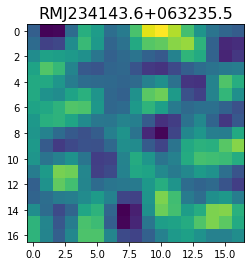

 58%|█████▊    | 5820/10099 [08:46<08:21,  8.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[278.89972  207.39375   96.855736   7.073218   0.669088  63.94351
  97.12228   35.228928 -49.081905 -28.026909 105.698616 217.95335
 204.06566  114.64269   70.37808  102.36733  139.31345 ]


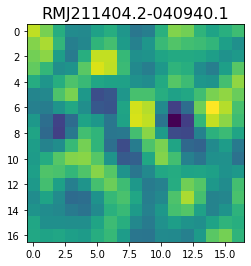

 58%|█████▊    | 5822/10099 [08:46<08:22,  8.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -2.6501293  -6.7800975  14.063712   30.419159   54.85908    89.08285
  87.72687    39.158043   13.939937   58.53164   104.12867    67.31798
 -10.210899  -18.097794   57.501675  119.74058   103.9605   ]


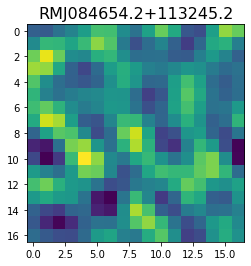

 58%|█████▊    | 5824/10099 [08:47<08:25,  8.46it/s]

<class 'pixell.enmap.ndmap'>
[ -60.239155 -121.05955  -147.39186   -82.770065  -36.124054  -88.38277
 -138.67885   -81.00215    11.439622   20.654978  -24.373302  -31.702555
  -16.481506  -49.85867  -114.92603  -131.868     -76.20382 ]


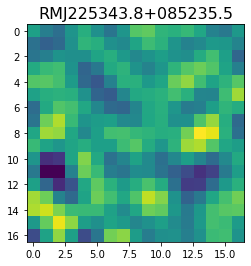

 58%|█████▊    | 5825/10099 [08:47<09:48,  7.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 89.48189    62.430813   38.6455     35.340366   33.06621    34.469208
  51.37643    67.25535    67.45606    69.94687    81.717445   69.235756
  16.427662  -32.215256  -31.630657   -2.2972069   6.7103395]


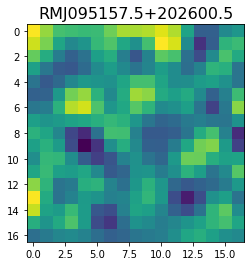

 58%|█████▊    | 5828/10099 [08:47<08:19,  8.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-59.44028   -66.7285    -51.709213  -37.098045  -37.34095   -34.37652
 -15.836168   -2.3128138 -10.615406  -20.417912   -7.2479405  15.72895
  20.103773    7.9584317   3.6843522  11.948828   13.665098 ]


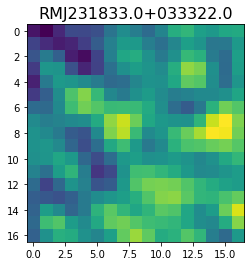

 58%|█████▊    | 5831/10099 [08:48<08:16,  8.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[108.814545  136.98645   145.44629   124.19569    82.087395   36.003338
  14.512573   43.151203  104.37936   135.44131    98.299614   40.465034
  46.712765  124.24331   176.77295   120.83369    -1.6617041]


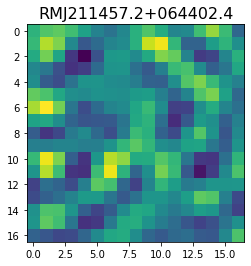

 58%|█████▊    | 5834/10099 [08:48<07:37,  9.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-145.27608   -118.056595  -201.07782   -196.91087    -58.027946
   -3.2558174 -110.710106  -187.70187   -119.70898    -28.283247
  -39.803646  -116.80327   -138.92876    -49.42787     64.42516
   59.653126   -39.553898 ]


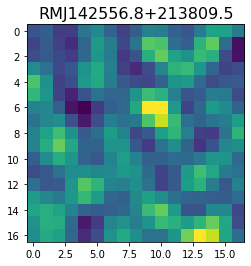

 58%|█████▊    | 5839/10099 [08:48<06:22, 11.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -55.004875 -127.16786  -206.33498  -195.0095    -77.472595   42.7055
   49.709465  -54.027645 -155.60855  -167.31361  -118.41199   -95.93553
 -126.72477  -156.78232  -138.25781   -92.469574  -69.51201 ]


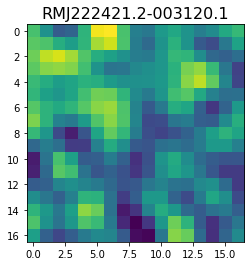

 58%|█████▊    | 5843/10099 [08:48<05:54, 12.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[194.35028   100.866035   -5.5228715  -4.4187336  82.16142   134.04521
 116.12814   108.425476  150.41591   171.04758   113.28287    32.1359
  10.1838875  44.813114   77.45133    82.76503    75.222755 ]


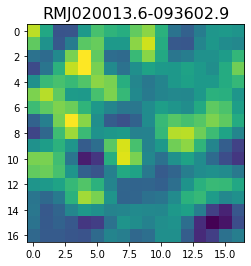

 58%|█████▊    | 5855/10099 [08:49<03:32, 20.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


 58%|█████▊    | 5862/10099 [08:49<02:37, 26.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.70178   26.995728 -23.666212 -50.555553  14.149118  94.34517
  73.66091   -9.03547  -12.737475  72.426315 108.31586   45.789284
   6.53362   65.45696  116.187195  56.505493 -32.873707]


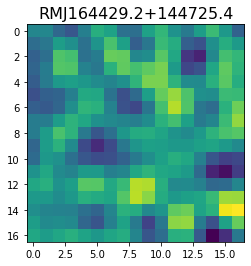

<class 'pixell.enmap.ndmap'>
[ 102.06712    82.9714     25.279661  -24.55105     9.116282   85.14634
   71.853775  -41.051003 -102.10749   -22.407894   99.38088   134.98976
   79.8094     -6.089109  -83.7429   -108.97297   -39.77548 ]


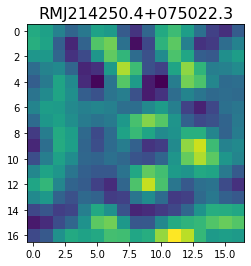

 58%|█████▊    | 5866/10099 [08:50<04:06, 17.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 70.701614 122.801674 124.588974  93.93789   94.48972  135.47948
 159.08936  132.24599   93.09817   84.29927   91.61389   84.23949
  74.276474  89.81905  116.535416 116.48714   91.99033 ]


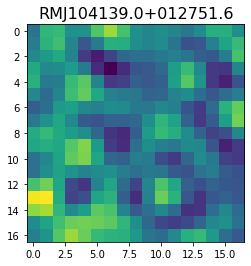

 58%|█████▊    | 5869/10099 [08:50<04:30, 15.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[67.78402   52.495274  41.487377  50.50738   61.376305  54.319984
 44.31233   59.93539   91.99356   94.32793   48.272533   0.5879047
  9.492664  64.69614   95.423     61.754765   4.8809414]


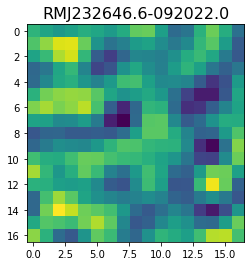

 58%|█████▊    | 5876/10099 [08:50<03:55, 17.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 93.77588    55.098503    4.068836   -1.7375113  24.52476    50.792995
  84.57593   131.33382   151.371     115.508965   64.11346    57.457096
  95.20764   130.44241   139.94974   137.52336   133.54095  ]


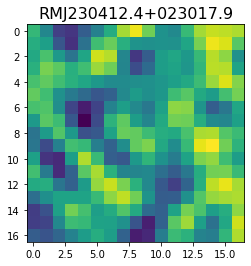

 58%|█████▊    | 5879/10099 [08:50<04:23, 16.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  3.527945   28.162973   28.287836   -2.0312867 -22.047827   -6.065355
  21.6697     32.26029    24.24307     3.3090107 -20.321066  -20.758621
   6.354231   18.161562   -9.569754  -29.730476    1.6077051]


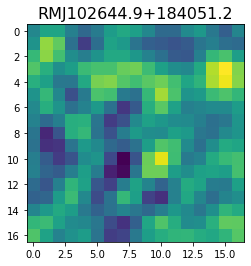

 58%|█████▊    | 5881/10099 [08:51<05:12, 13.51it/s]

<class 'pixell.enmap.ndmap'>
[ 61.679466   21.490253    2.3732355  35.868927   72.77837    57.13708
  -2.1542342 -52.76416   -63.473625  -48.24691   -37.05879   -36.874706
 -29.073694   -7.737256   -2.9964573 -41.30565   -93.717926 ]


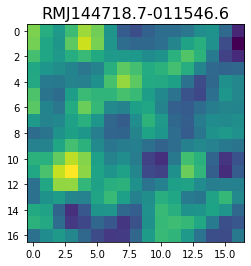

<class 'pixell.enmap.ndmap'>
[ 61.615364  84.39434   95.06578   96.66946   97.04007   91.77885
  77.960014  71.18331   79.2957    77.56389   48.18049   24.004868
  46.59882   97.86418  122.44468  105.20249   79.58472 ]


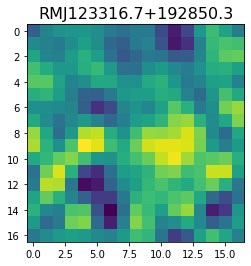

 58%|█████▊    | 5890/10099 [08:51<04:17, 16.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -33.88322    -16.825615   -30.113424   -66.39051    -82.68341
  -49.581383    -2.3885229   -5.812931   -62.670074  -100.46036
  -70.658005   -20.784765   -26.991581   -83.229515  -113.32301
  -86.831825   -62.283283 ]


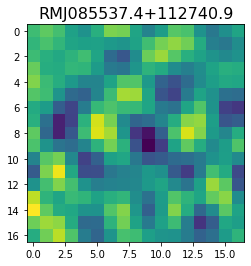

 58%|█████▊    | 5893/10099 [08:51<04:53, 14.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -2.3876653  44.88172    29.763231   -5.680157   -2.929707   16.503899
   6.5356574 -14.862845    2.633242   50.576435   61.848476    5.6879807
 -57.201576  -42.136494   48.133114  117.11333    96.59023  ]


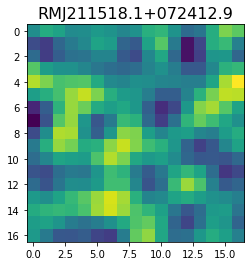

 58%|█████▊    | 5896/10099 [08:52<05:33, 12.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -5.775419     5.97071    -38.686764   -95.01224    -85.378
  -26.501495   -18.202053   -82.2127    -121.38673    -84.05115
  -47.66762    -70.59877    -86.74658    -39.98352     -1.5231464
  -38.746475   -77.340904 ]


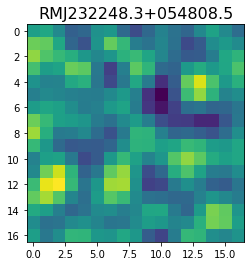

 58%|█████▊    | 5903/10099 [08:52<04:30, 15.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[104.65891   79.88024   61.767326  63.566917  71.61255   65.672424
  42.171036  10.778859 -13.034799 -10.935357  19.978989  52.67924
  57.84621   42.96802   39.907814  59.0587    81.12739 ]


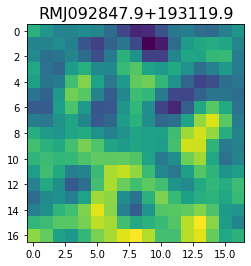

 59%|█████▊    | 5908/10099 [08:52<04:35, 15.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 82.13419   76.25425  126.67537  175.83437  158.05402   79.32168
  15.854769  24.14122   73.872635  95.97166   79.79609   76.85786
 106.41707  113.0842    49.785458 -38.127678 -59.305927]


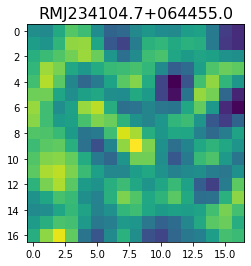

 59%|█████▊    | 5912/10099 [08:53<04:42, 14.80it/s]

<class 'pixell.enmap.ndmap'>
[46.354755  29.44488   25.91851   29.12774   22.241703   5.9932804
 -3.0669718  6.2612042 28.213442  46.610325  50.19727   42.587032
 36.307575  37.79782   43.598034  50.213593  56.955288 ]


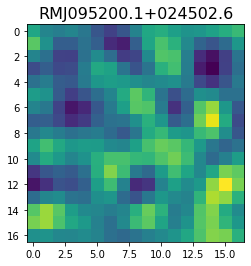

 59%|█████▊    | 5914/10099 [08:53<05:28, 12.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 11.887448   42.494396   38.469246   12.947463   10.23672    28.854866
  24.963537   -5.15124   -16.045355    3.820636   12.402533   -7.374873
 -20.23353    -7.8981786   1.3098125  -8.079831  -11.216925 ]


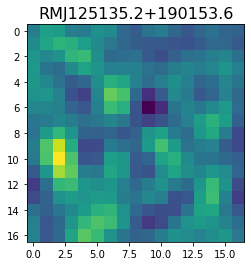

<class 'pixell.enmap.ndmap'>
[  10.1870985   25.829071    49.139065    45.084007    44.075836
   96.13047    182.18665    228.56172    199.35202    124.65239
   43.814003   -29.812822   -85.869774  -104.38567    -81.58596
  -42.630024   -17.905022 ]


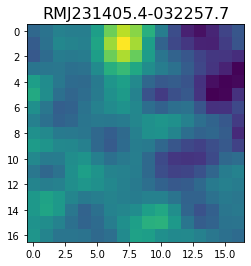

 59%|█████▊    | 5916/10099 [08:54<07:35,  9.18it/s]

<class 'pixell.enmap.ndmap'>
[-13.2918    34.78929   41.08356    6.986425 -44.53381  -70.77907
 -39.8474    22.602747  51.02789   22.327303 -13.682264  -6.556568
  27.049192  37.607765  18.351233  10.638303  42.941105]


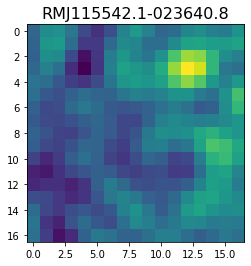

 59%|█████▊    | 5918/10099 [08:54<07:58,  8.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 90.38086  109.610695  67.2125    -6.542086 -17.87842   53.63376
 115.60745   96.973694  45.6276    45.822346  95.89806  122.195625
  87.49994   37.474426  34.57059   74.36017   93.66227 ]


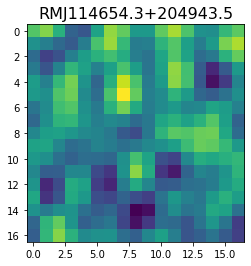

 59%|█████▊    | 5920/10099 [08:54<08:08,  8.55it/s]

<class 'pixell.enmap.ndmap'>
[  26.854464   -30.537163   -43.903927     2.9789672   46.296165
   11.019084   -88.00159   -151.17328   -114.062416   -26.687414
   13.025766   -23.78799    -78.485634   -84.07459    -33.40458
   20.344816    14.2934675]


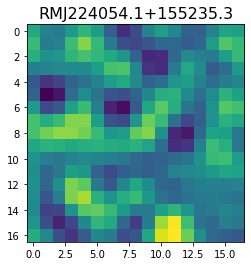

 59%|█████▊    | 5921/10099 [08:54<09:15,  7.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  76.64045     29.386644   -45.490215   -73.30153    -18.51572
   57.237938    64.44765     12.834777   -11.019616     6.4542074
  -14.004222   -91.67622   -131.89592    -77.015305    -4.0891404
   -4.677409   -57.514454 ]


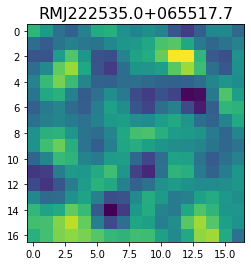

 59%|█████▊    | 5923/10099 [08:55<09:00,  7.73it/s]

<class 'pixell.enmap.ndmap'>
[-35.03108   -45.087036    5.5752935  58.048645   86.701866  105.5615
 111.772675   88.61175    57.391712   63.35116    99.27831    99.479485
  35.046703  -32.348495  -30.967373   21.507292   50.30609  ]


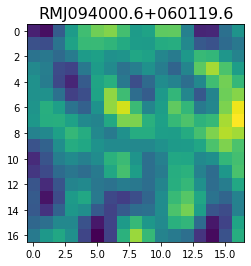

 59%|█████▊    | 5924/10099 [08:55<10:36,  6.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[173.65892   34.986416 -34.52731   21.782818  71.80227   14.998206
 -44.138016  26.14622  142.90501  124.852    -13.033847 -81.7192
 -16.106562  50.223778  26.603582 -10.748718  10.7303  ]


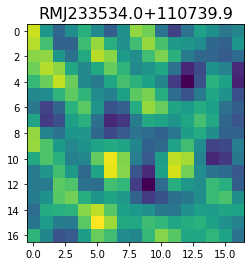

 59%|█████▊    | 5927/10099 [08:55<08:41,  8.00it/s]

<class 'pixell.enmap.ndmap'>
[  24.324648  -24.808561 -126.50642  -183.55292  -169.25642   -90.21265
   21.584515   70.8262    -18.63416  -167.11711  -211.76535  -128.90085
  -50.538414  -50.786312  -66.80428   -53.857174  -57.743095]


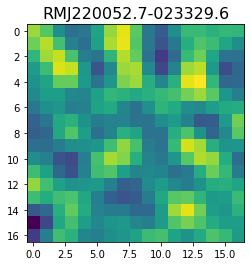

 59%|█████▊    | 5928/10099 [08:55<09:50,  7.07it/s]

<class 'pixell.enmap.ndmap'>
[-188.77403  -317.7211   -284.67456  -141.80327   -55.413998  -53.889576
  -60.817932  -74.622536 -131.4394   -171.81834  -123.6736    -52.20143
  -65.506775 -136.87022  -169.25922  -163.47978  -174.7565  ]


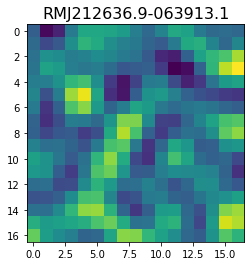

 59%|█████▊    | 5929/10099 [08:56<12:16,  5.66it/s]

<class 'pixell.enmap.ndmap'>
[160.30267  195.29543  189.36961  144.48393  108.50449  137.5994
 213.7448   247.12263  191.58131  110.3327    90.04265  135.3668
 188.9004   208.93001  180.8473    98.74505   -5.157032]


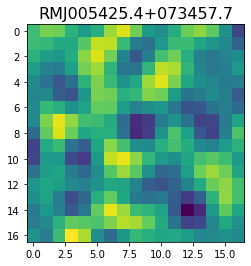

 59%|█████▊    | 5930/10099 [08:56<13:16,  5.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-179.3599   -120.69645  -101.89014  -119.03628  -126.79144  -126.29114
 -132.50491  -132.18901  -121.56344  -119.19625  -122.92182  -117.471054
 -117.82879  -140.23859  -156.43134  -141.6628   -127.511505]


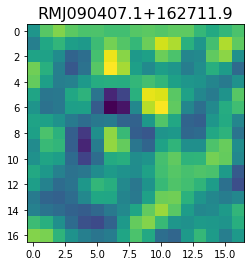

 59%|█████▉    | 5935/10099 [08:56<07:45,  8.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-15.749071  48.806587  50.815365   9.669005 -11.784117 -18.340952
 -55.710773 -99.81618  -75.57726   14.725847  74.64848   42.960934
 -30.678308 -61.611206 -30.654518  14.029958  24.118954]


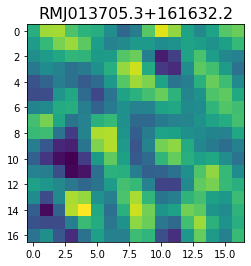

 59%|█████▉    | 5937/10099 [08:56<08:03,  8.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -53.047817     3.6250434  -31.803951  -107.667816   -89.43672
   10.304815    58.342644    19.9779      -7.5358357   29.64211
   70.55212     53.76622     -1.9906505  -47.107292   -57.978127
  -37.88219    -10.908316 ]


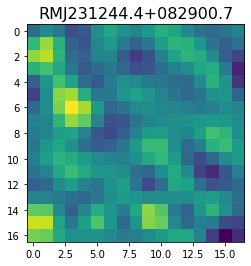

 59%|█████▉    | 5940/10099 [08:57<07:26,  9.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -31.847433   -81.69111    -94.99117    -52.446743   -29.38718
  -58.5874     -70.191284   -22.660454    10.330832   -38.126408
 -104.27276    -89.261375   -20.37082     -7.7518806  -69.0358
 -109.885605   -80.36271  ]


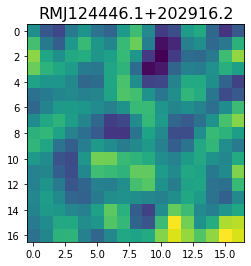

 59%|█████▉    | 5953/10099 [08:57<03:31, 19.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


 59%|█████▉    | 5960/10099 [08:57<02:32, 27.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[11.1094055 23.039513  40.59025   44.44041   44.943943  57.612823
 78.33108   91.15995   82.57145   52.25432   24.648703  32.105145
 68.6776    87.60247   66.46321   39.081955  33.95545  ]


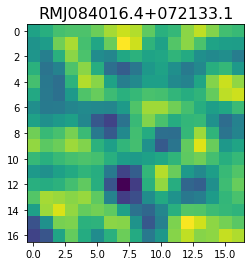

 59%|█████▉    | 5964/10099 [08:58<03:05, 22.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 15.441643    34.645657    99.075195   116.74113     59.39565
  12.304704    33.230114    63.16371     38.8556       0.36568052
  11.464017    51.312218    63.99891     53.907948    57.559345
  70.35884     68.42454   ]


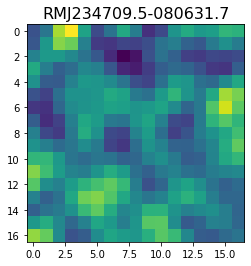

 59%|█████▉    | 5970/10099 [08:58<03:14, 21.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.50047      2.4419315  -20.98336    -34.978558   -36.82621
 -18.90996     15.131459    38.871       34.21948     19.08693
  18.612099    25.59774     17.766563    -0.79287684  -6.5228844
   5.1265917   17.543236  ]


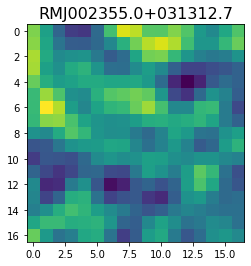

 59%|█████▉    | 5973/10099 [08:58<03:52, 17.72it/s]

<class 'pixell.enmap.ndmap'>
[ 77.485756  39.463646  51.246407 113.14555  154.09782  146.4922
 142.7106   168.62129  166.18733   95.27331   18.253937  14.706
  66.83045   99.54247   93.74914   90.74416  109.18235 ]


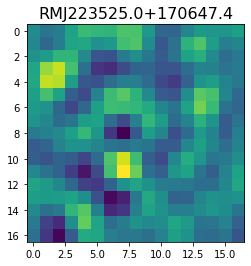

<class 'pixell.enmap.ndmap'>
[-10.27072   -9.909283 -10.747565  -8.844775 -12.799706 -32.46127
 -60.027855 -71.423546 -55.56814  -33.5961   -33.35532  -51.391582
 -60.758316 -53.045895 -47.905327 -58.25146  -70.63224 ]


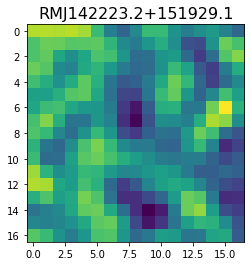

 59%|█████▉    | 5976/10099 [08:59<05:27, 12.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-27.80216    14.163928   97.612144  111.87736    81.07421    89.77225
 109.505615   64.65624     3.6132338  29.382032  104.72029   104.8653
  38.23528    34.89531   120.59399   170.13855   109.5926   ]


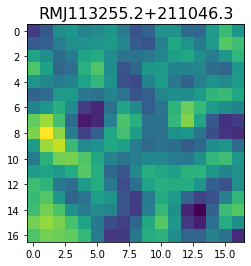

 59%|█████▉    | 5978/10099 [08:59<06:17, 10.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 71.3497     61.362774   28.763544   12.325443   21.958576   41.44994
  59.537758   67.210655   46.396305   -1.9402258 -34.792652  -12.175029
  42.340813   64.38798    30.941063  -15.812978  -30.227215 ]


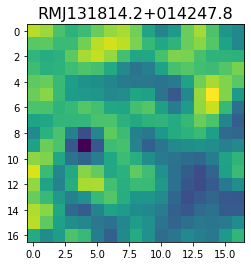

 59%|█████▉    | 5980/10099 [08:59<06:54,  9.94it/s]

<class 'pixell.enmap.ndmap'>
[ -64.21582    -39.623894     5.3444004   21.663074   -27.965048
 -109.576065  -133.65382    -65.507034    18.279028    28.202505
  -22.42136    -55.641727   -47.34454    -39.050957   -50.905045
  -54.770943   -36.415348 ]


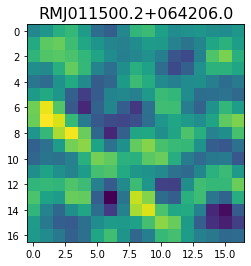

 59%|█████▉    | 5982/10099 [08:59<07:26,  9.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-18.740341   -93.27584    -81.726006    11.009099    86.47853
  89.82268     47.606003     0.44753885 -26.776978   -15.1881275
  25.13143     52.223213    57.729004    85.27698    136.65009
 130.42213     24.145199  ]


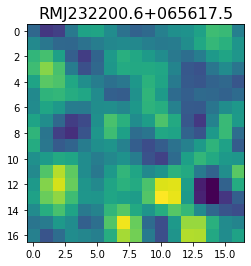

 59%|█████▉    | 5984/10099 [09:00<08:20,  8.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -76.210724  -91.281235 -121.13977  -138.54     -102.17435   -33.783512
  -20.687733  -93.25751  -164.63452  -148.24713   -72.405426  -20.131342
  -15.014663  -27.02613   -41.51016   -63.789337  -87.03909 ]


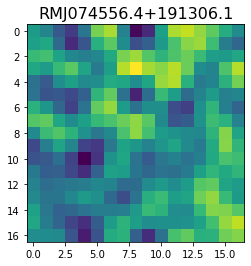

 59%|█████▉    | 5985/10099 [09:00<09:37,  7.12it/s]

<class 'pixell.enmap.ndmap'>
[-123.4006   -153.11122  -116.50873   -70.87279   -68.72323   -77.64028
  -63.643505  -58.37437   -86.59552  -111.1354   -101.58814   -82.71842
  -76.23625   -69.08118   -65.9016    -91.42802  -118.91965 ]


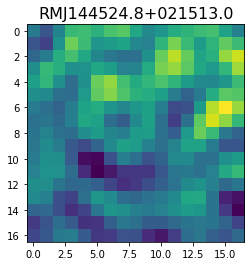

 59%|█████▉    | 5986/10099 [09:00<11:23,  6.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[47.05427  56.38567  55.178333 44.19447  35.382664 36.685238 42.92549
 45.9553   46.057743 47.196934 48.769657 49.613003 52.819355 58.695972
 61.123196 59.55344  64.7153  ]


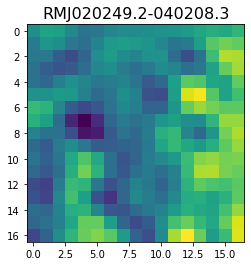

 59%|█████▉    | 5989/10099 [09:01<09:27,  7.24it/s]

<class 'pixell.enmap.ndmap'>
[  1.6057239 -16.736704    1.6201845  29.307333   20.55519    -6.1800113
  -1.4537281  23.101707   13.891206  -29.45163   -56.345963  -52.462578
 -48.951283  -53.219093  -45.3424    -36.311848  -55.502056 ]


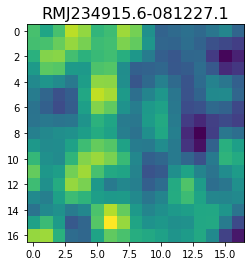

 59%|█████▉    | 5990/10099 [09:01<10:59,  6.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 92.1393    42.466667   5.658499  33.08189   66.965256  60.52501
  59.645275  97.31471  124.803085 108.40432   87.41755   87.07515
  72.62716   29.382685   1.339353  19.587284  59.444378]


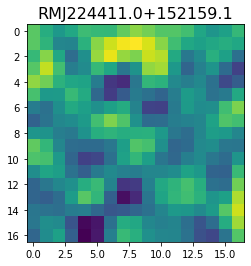

 59%|█████▉    | 5992/10099 [09:01<10:59,  6.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[41.041096 24.93347  36.5097   62.677547 76.9984   75.40604  70.49899
 59.778904 34.29663  13.535677 26.606964 57.196014 59.57531  36.590862
 39.54445  72.78455  70.04331 ]


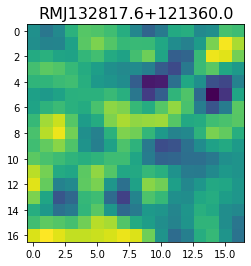

 59%|█████▉    | 5994/10099 [09:01<10:04,  6.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-153.89624 -159.83649 -159.0761  -178.3979  -204.12695 -206.58333
 -177.58896 -134.14186 -104.83238 -113.89425 -156.69266 -191.13057
 -178.19675 -134.80968 -121.67645 -168.44006 -231.74596]


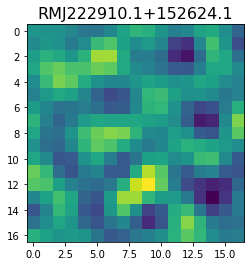

 59%|█████▉    | 5998/10099 [09:02<07:41,  8.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[238.93382 218.56244 225.00673 261.33524 281.80768 255.80344 214.82141
 211.04047 245.81735 270.92758 257.36    230.36247 225.75403 238.23958
 236.1256  214.2904  205.12076]


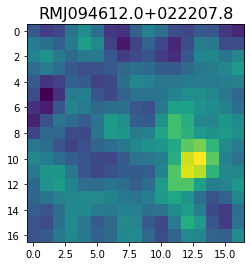

 59%|█████▉    | 6008/10099 [09:02<03:52, 17.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-152.89655   -146.98267    -69.08953      0.9628872  -76.32857
 -259.99225   -348.61386   -253.12184    -99.46656    -32.542862
  -51.072414   -77.28649    -80.11727    -78.385895   -92.752914
 -129.94548   -171.5878   ]


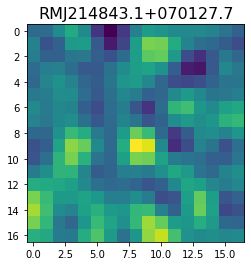

 60%|█████▉    | 6011/10099 [09:02<04:33, 14.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.879062   20.448223   25.49503    23.254055   23.63963    25.124865
  14.66965    -5.987159  -14.169837    1.0224813  19.412926   21.177814
  18.967249   34.038734   55.359894   53.943      31.321838 ]


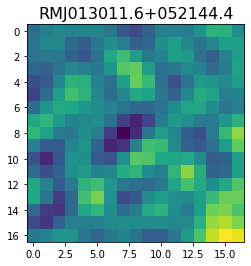

<class 'pixell.enmap.ndmap'>
[ -83.64301    -73.70763    -69.51535    -78.775116   -66.17363
  -34.1667     -36.468113   -87.647835  -114.21069    -48.171688
   57.540382    80.617325     0.8037979  -66.62595    -42.774998
    6.291011    -1.4701539]


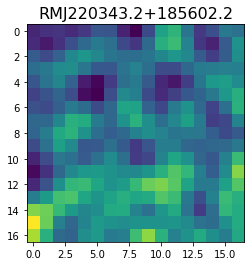

 60%|█████▉    | 6014/10099 [09:03<06:28, 10.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 153.38777    148.92805     55.409256    -3.1157622   16.970308
   69.4608      81.472176   -20.903273  -189.4181    -213.11331
  -23.26399    118.38385     23.484344   -78.58854     45.761974
  190.02623     90.55846  ]


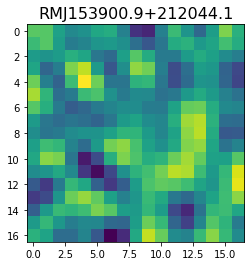

 60%|█████▉    | 6016/10099 [09:03<07:10,  9.49it/s]

<class 'pixell.enmap.ndmap'>
[-8.0188881e+01 -1.0228983e+02 -1.0958388e+02 -7.1074707e+01
 -2.1173130e+01 -4.8666203e+01 -1.3674248e+02 -1.4153653e+02
 -9.2330121e-02  1.4915721e+02  1.4052068e+02 -4.3925743e+00
 -1.2502104e+02 -1.2950169e+02 -6.7092918e+01 -2.1370510e+01
 -9.1340685e+00]


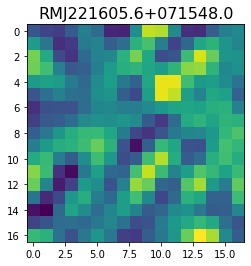

 60%|█████▉    | 6018/10099 [09:03<07:23,  9.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 21.04122  103.9133    93.70939   11.506503 -21.28466   23.42234
  56.052013  31.282156   7.571328  34.774914  86.626076 118.700645
 114.83582   75.6342    27.812563  30.233442 104.425476]


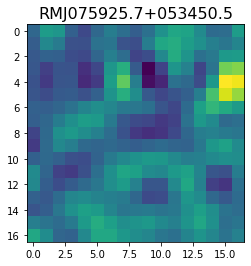

 60%|█████▉    | 6020/10099 [09:04<08:20,  8.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.047077    -2.3171704   -7.9171724    0.36183342  15.45111
  30.595453    32.590565     8.719739   -24.850372   -21.6231
  40.58802    114.17361    125.4711      65.23507      0.21014327
 -15.061381    -0.6835495 ]


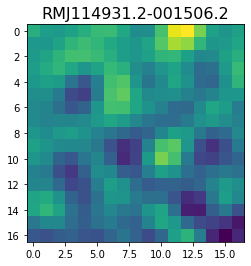

 60%|█████▉    | 6022/10099 [09:04<08:29,  8.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 95.01589   101.496315   44.531757   18.096443   50.47989    78.76586
  82.50469    89.82926    78.111534   23.964033    5.1281557  90.1325
 183.70645   149.39995    30.04125   -17.64091    39.752552 ]


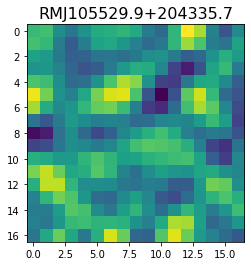

 60%|█████▉    | 6024/10099 [09:04<08:33,  7.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 14.571454  29.673075  97.757774 143.59134   81.97421  -27.171642
 -50.769306  28.793571 107.69225  116.656906  84.97177   62.931267
  59.252777  51.080822  11.123748 -56.129593 -86.48236 ]


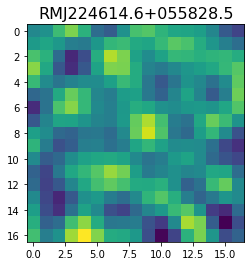

 60%|█████▉    | 6026/10099 [09:05<08:52,  7.66it/s]

<class 'pixell.enmap.ndmap'>
[   0.2236919  -20.777699   -17.085634   -20.300896   -44.200966
  -34.39746      1.9015388  -25.305492  -109.01333   -121.028244
  -35.30097     12.696423   -41.32836    -87.8046     -44.009613
   20.94431     29.682484 ]


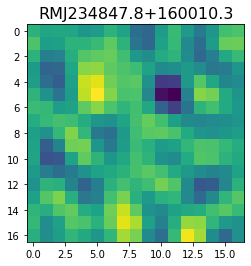

 60%|█████▉    | 6027/10099 [09:05<10:29,  6.47it/s]

<class 'pixell.enmap.ndmap'>
[ -27.906021  -42.367878  -66.00423   -73.108345  -67.191826  -64.82266
  -66.31685   -61.654858  -55.15719   -63.723007  -90.46805  -115.80713
 -120.97007  -110.63486  -102.89416  -102.06193   -95.14763 ]


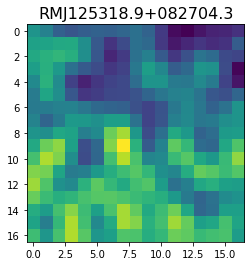

 60%|█████▉    | 6034/10099 [09:05<05:13, 12.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -11.802514   -43.319588   -91.16896    -67.76658     -8.456817
   -2.088569   -46.41744    -84.30918   -115.8481    -162.3912
 -179.74075   -119.93459    -33.046745    -5.0695477  -33.218384
  -51.466675   -39.84486  ]


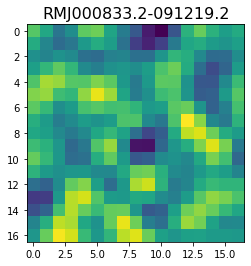

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-65.2616    -76.23085   -73.275444  -68.375755  -69.55359   -70.88305
 -57.54108   -23.8637     13.525351   27.20188     8.3073225 -20.785547
 -30.322378  -16.281826   -1.0441076  -2.6358223 -14.454575 ]


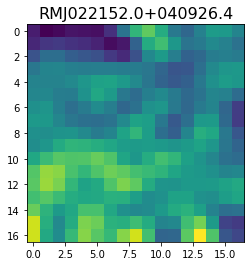

 60%|█████▉    | 6037/10099 [09:06<06:52,  9.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[108.36637   41.147625 -18.280663 -12.261176  44.405563  74.17217
  44.749977  16.15891   46.4782    96.21049   85.10129   18.369743
 -17.21223   16.519156  58.636726  52.752743  29.917278]


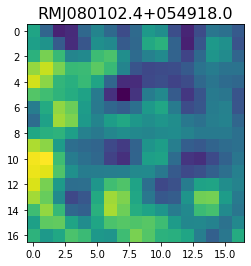

 60%|█████▉    | 6044/10099 [09:06<05:01, 13.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.27003   47.97716   46.114964  52.357243  84.25816  115.915924
 108.47207   74.224915  60.266872  79.060974  95.25897   81.40949
  56.83701   56.181557  74.982666  76.392136  53.405895]


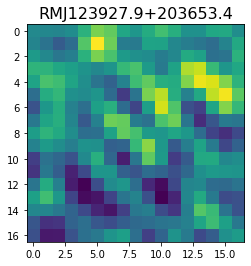

 60%|█████▉    | 6047/10099 [09:06<05:16, 12.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 66.074745 115.01881  114.62731   70.060104  62.7762    98.58393
 102.57405   61.60055   49.254044  96.49181  144.00473  142.16417
 108.279144  69.42049   30.667004  12.190229  40.571777]


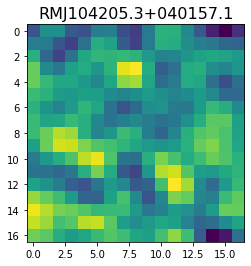

 60%|█████▉    | 6050/10099 [09:07<05:22, 12.56it/s]

<class 'pixell.enmap.ndmap'>
[-143.17786  -167.81046   -38.197754   88.180275   40.301167 -109.00887
 -173.76994  -130.10074   -88.03307   -83.247345  -72.31371   -63.78441
  -90.80761  -111.88223   -82.64299   -63.101067 -118.24674 ]


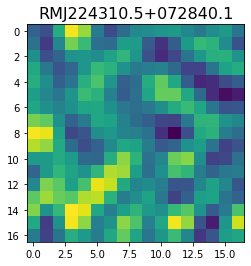

 60%|█████▉    | 6052/10099 [09:07<05:57, 11.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[130.17136  117.0178   118.804634 135.87141  123.34915   74.39006
  56.48789   96.708664 113.55467   50.29645   -8.576529  34.599155
 116.76843   98.72092  -18.890406 -97.81628  -66.9027  ]


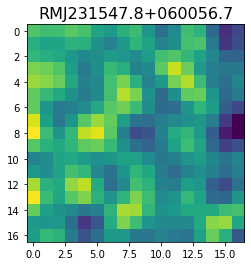

 60%|█████▉    | 6054/10099 [09:07<06:29, 10.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 36.963352   40.5054     -1.7541313 -45.183304  -26.144196   34.839138
  62.885895   42.909477   24.768679   29.675526   31.573784   23.830957
  28.856298   44.51966    48.61031    50.67175    74.893    ]


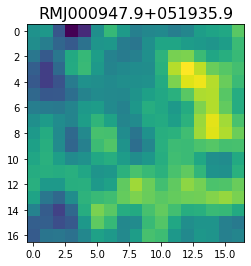

 60%|█████▉    | 6056/10099 [09:07<06:59,  9.65it/s]

<class 'pixell.enmap.ndmap'>
[ -86.95666  -126.4112   -136.98685  -112.54155   -90.2568    -93.41524
  -98.9862    -78.63493   -48.27925   -46.88871   -76.10003   -96.65935
  -88.00559   -74.19189   -75.90237   -73.600876  -45.790966]


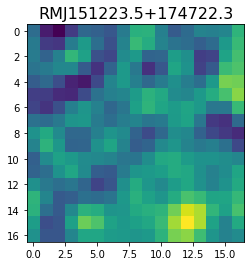

<class 'pixell.enmap.ndmap'>
[-42.614475  -67.08938   -54.12012   -11.273208    3.4774396 -22.245575
 -33.53683     4.9677663  50.720055   40.29155   -22.53406   -72.14763
 -68.24015   -37.171295  -15.057711    4.9731655  36.257427 ]


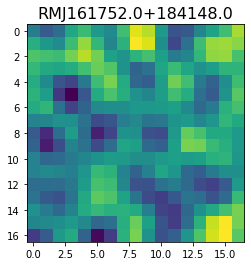

 60%|█████▉    | 6058/10099 [09:08<09:39,  6.97it/s]

<class 'pixell.enmap.ndmap'>
[ 30.576221   12.643742  -41.62154   -31.211716   38.73749    59.6375
   2.1330466 -40.73476   -15.32763    18.68935    13.789528   11.535295
  42.720528   59.047855   24.433577  -14.176504   -4.2644196]


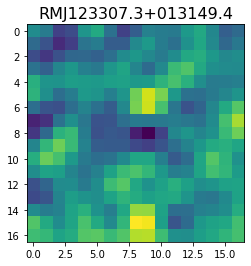

 60%|█████▉    | 6059/10099 [09:08<10:57,  6.15it/s]

<class 'pixell.enmap.ndmap'>
[  -4.6708097   66.33094     68.4211      19.325018    12.469106
   26.718458    -7.095998   -40.208363     9.577454    81.693214
   53.627083   -55.186844  -107.40238    -40.52095     72.79429
  127.1187      79.17009  ]


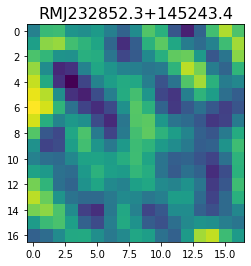

 60%|██████    | 6060/10099 [09:08<12:07,  5.55it/s]

<class 'pixell.enmap.ndmap'>
[ -32.885643  -110.952095  -145.54303    -78.79278    -42.70978
 -126.74072   -206.73692   -158.10394    -75.23986   -102.304184
 -183.81026   -171.37657    -71.47446     -4.6924973   -1.8750417
   -7.8620143  -17.249498 ]


 60%|██████    | 6061/10099 [09:09<12:44,  5.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[120.00654  155.16833  160.64651  120.15663   95.542076 131.46384
 181.45573  175.95569  125.55842   94.80262   99.358894 101.74257
  96.964516 121.63916  169.55656  176.98949  120.1145  ]


 60%|██████    | 6063/10099 [09:09<11:16,  5.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[212.72964  237.4695   196.61572  134.83047  123.99387  176.18874
 230.91827  231.97305  191.87262  160.30803  151.23651  139.79677
 122.889496 133.08315  179.48909  219.13062  212.7502  ]


 60%|██████    | 6068/10099 [09:09<07:05,  9.48it/s]

<class 'pixell.enmap.ndmap'>
[ 51.65663   135.5571    167.02461   164.48833   176.95406   168.72124
  86.483864   -1.7794513  33.06154   177.44795   259.6917    184.38048
  71.0539     80.36995   189.48979   247.43996   201.81049  ]


 60%|██████    | 6069/10099 [09:09<09:02,  7.43it/s]

<class 'pixell.enmap.ndmap'>
[-103.568665 -109.09996   -62.456768  -32.4653    -35.59956   -42.590412
  -37.595345  -34.37549   -50.852238  -84.45281  -106.375175  -88.8947
  -50.77628   -50.454277 -108.2998   -164.4959   -150.284   ]


 60%|██████    | 6070/10099 [09:10<10:34,  6.35it/s]

<class 'pixell.enmap.ndmap'>
[-168.81999  -183.0885   -187.4104   -191.04654  -195.66669  -183.67215
 -156.06828  -143.51877  -157.91     -168.69148  -151.14084  -124.896355
 -119.58667  -131.98105  -141.83434  -143.98589  -141.4496  ]


 60%|██████    | 6071/10099 [09:10<11:54,  5.63it/s]

<class 'pixell.enmap.ndmap'>
[-25.228647  -39.735657  -38.372288  -24.45518   -29.495468  -53.16158
 -59.02864   -41.223457  -32.871952  -39.125767  -33.05363   -20.380398
 -27.992779  -35.27381    -7.5415964  18.403654  -15.810366 ]


 60%|██████    | 6072/10099 [09:10<12:43,  5.27it/s]

<class 'pixell.enmap.ndmap'>
[ -7.151699   51.08543    55.256218    5.3203177 -35.965603  -35.7745
 -21.059414  -20.153496  -25.717041  -21.738243   -7.346917   13.306716
  33.959496   36.109745    4.4389358 -44.45018   -72.79281  ]


 60%|██████    | 6073/10099 [09:10<13:33,  4.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[142.27522  202.79822  184.26527  143.92628  150.14247  153.94139
 126.52861  135.73727  183.39038  169.80196   90.757225  57.914543
  88.24129   90.64319   62.1494    77.81605  113.39228 ]


 60%|██████    | 6075/10099 [09:11<11:27,  5.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 17.371645    7.3955383  17.647688   33.928387   24.03607     5.780474
  21.09068    52.92423    40.656452  -18.381098  -54.04251   -28.3519
   7.5096307  -6.6816216 -51.415043  -61.975845  -24.687946 ]


 60%|██████    | 6077/10099 [09:11<10:28,  6.40it/s]

<class 'pixell.enmap.ndmap'>
[ -24.96823    -30.12963    -55.608612   -92.324295   -90.04344
  -40.09166     -4.597342   -23.309069   -44.411224    -7.4326234
   47.521233    30.95232    -56.40866   -118.86602   -103.04069
  -61.1194     -57.012238 ]


 60%|██████    | 6084/10099 [09:11<05:09, 12.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -28.665632  -47.415638  -87.15724   -97.83861   -85.07982   -78.953705
  -72.34656   -46.717976  -33.938984  -85.27349  -178.66083  -219.73207
 -158.30429   -57.708797  -13.794576  -36.1415    -53.29849 ]


 60%|██████    | 6087/10099 [09:12<05:28, 12.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-117.152855 -115.75161  -111.13351  -101.43906   -83.91568   -68.60122
  -63.199196  -58.37651   -46.135586  -38.60453   -49.727066  -70.61459
  -82.06397   -81.9618    -82.21624   -85.70971   -83.6504  ]


 60%|██████    | 6089/10099 [09:12<06:10, 10.84it/s]

<class 'pixell.enmap.ndmap'>
[-259.97577   256.5727    303.7254     85.808495  184.62178   494.15515
  499.93167   159.1915   -133.75798   -94.51864   272.8899    673.8422
  643.76636    96.867226 -388.09735  -292.24084   115.38588 ]


<class 'pixell.enmap.ndmap'>
[-173.56583   -209.93779   -107.06406     -5.2257924  -22.444107
  -91.892685   -94.73125    -37.497757   -15.994504   -76.43089
 -178.4112    -254.54074   -267.3936    -231.14285   -190.41032
 -166.01833   -140.26744  ]


 60%|██████    | 6091/10099 [09:12<08:54,  7.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  11.939156   -40.955677  -118.721725  -179.16516   -168.93588
  -83.61084      8.286058    26.40935    -29.783815   -76.01818
  -51.107388    -2.3996816  -17.556934   -86.06592    -98.70292
   -3.5723267  107.112045 ]


 60%|██████    | 6100/10099 [09:13<04:45, 14.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[132.53783  138.30501   53.905056 -17.01952   31.203276 111.84709
  66.11608  -63.291424 -78.90757   58.837578 176.43123  166.12254
 110.751015  86.70298   48.18826  -22.095928 -37.932995]


 60%|██████    | 6104/10099 [09:13<04:44, 14.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -75.02565   -43.083168  -30.07238   -51.353344  -69.7266    -68.74685
  -71.881996  -83.53791   -82.03634   -74.352554  -88.6131   -112.62656
 -108.846405  -85.43424   -81.553215  -90.89944   -74.813416]


 60%|██████    | 6107/10099 [09:13<05:07, 12.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 36.53325    55.893623   83.741486   82.27616    43.48422     7.6833086
  15.122532   54.40417    79.5972     69.051575   45.565815   41.437004
  61.593884   81.86543    72.95347    29.186832  -18.604746 ]


 60%|██████    | 6109/10099 [09:14<05:52, 11.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[49.296978  55.580345  38.012012  15.808021  22.065277  52.60813
 65.20866   38.714375   5.172164   3.989935  27.144346  38.146984
 29.783245  26.751621  35.070755  29.367428   1.9056245]


 61%|██████    | 6111/10099 [09:14<06:21, 10.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-100.73319   -71.73675   -62.917274  -79.496216  -90.807335  -83.287636
  -65.835266  -44.233154  -23.340122  -20.09987   -45.415825  -81.17363
  -96.72429   -82.84766   -55.720028  -34.510162  -26.506678]


 61%|██████    | 6113/10099 [09:14<06:45,  9.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -88.013245  -82.06266   -37.01575     4.93232   -15.71725   -75.221634
  -99.50417   -77.121796  -76.007645 -136.07     -192.66171  -151.62886
  -30.015259   36.58752   -39.740856 -173.71417  -210.80792 ]


 61%|██████    | 6117/10099 [09:14<06:05, 10.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-265.67905   -215.10857    -65.22584      1.1571681  -82.29895
 -186.06444   -190.83199   -139.49268   -115.87884    -99.60726
  -42.163654    11.187072   -11.299269   -82.10354   -117.112564
 -100.5094     -82.266205 ]


 61%|██████    | 6120/10099 [09:15<06:13, 10.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -4.7845387 -40.158142  -57.31557   -45.358578  -38.346077  -54.40044
 -71.58415   -71.35595   -61.2918    -50.44249   -38.529263  -28.239513
 -19.785082   -4.383126   12.16264     2.2877584 -38.760506 ]


 61%|██████    | 6123/10099 [09:15<06:10, 10.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  9.836789  -16.817667  -42.775185  -39.874405  -19.6539    -10.330073
 -16.660501  -18.755867   -1.7149389  26.689476   44.34192    34.688377
   3.3559668 -21.884153  -15.065343   20.597698   55.98797  ]


 61%|██████    | 6126/10099 [09:15<06:39,  9.93it/s]

<class 'pixell.enmap.ndmap'>
[ -78.86162   -53.355114  -34.331837  -49.63141   -84.6576   -101.14615
  -88.289696  -74.53544   -82.420105  -96.48054   -94.76134   -86.6822
  -90.075485  -94.45787   -83.86905   -73.47188   -81.30945 ]


<class 'pixell.enmap.ndmap'>
[-20.557993     7.093484    52.070827    75.324165    58.66175
  18.807037   -12.732646   -13.130978    11.857958    26.657257
   2.5706646  -45.09182    -76.77809    -77.57856    -60.10853
 -32.337456     0.33762896]


 61%|██████    | 6128/10099 [09:16<08:52,  7.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-301.9931  -339.86496 -366.54764 -374.4785  -406.16043 -449.49512
 -436.7955  -359.3547  -295.77322 -302.85666 -344.68295 -362.72794
 -370.6431  -428.03494 -527.11066 -565.57294 -475.8374 ]


 61%|██████    | 6130/10099 [09:16<08:40,  7.63it/s]

<class 'pixell.enmap.ndmap'>
[ 164.57903     132.18408      26.149092    -37.765102    -38.462643
  -68.185074   -130.82465    -102.73782      37.920372    113.97195
    0.85902244 -155.20232    -126.06236      64.88581     167.0707
   50.86282    -127.28877   ]


 61%|██████    | 6131/10099 [09:16<09:55,  6.67it/s]

<class 'pixell.enmap.ndmap'>
[ -53.772312   -63.163406   -53.78814    -22.465109    -9.512206
  -52.845673  -111.931915   -94.93358      7.1928906   73.14291
    7.3149905 -108.44648   -124.96696    -49.196407   -17.790415
  -63.810078   -76.74407  ]


 61%|██████    | 6132/10099 [09:17<11:05,  5.96it/s]

<class 'pixell.enmap.ndmap'>
[  18.65022   -42.275635  -83.74089   -50.531654   13.193177   16.767918
  -48.008884  -90.84375   -57.100185  -10.783259  -28.626049  -71.110176
  -47.42853    24.085924   28.132252  -69.87166  -161.91399 ]


 61%|██████    | 6133/10099 [09:17<12:22,  5.34it/s]

<class 'pixell.enmap.ndmap'>
[111.20598  156.39114  107.367256   9.518645 -17.245861  51.780766
 144.4019   192.9407   170.03218   92.37479   31.991861  51.628128
 112.43316  126.619415  91.228355  69.952576  69.80703 ]


 61%|██████    | 6134/10099 [09:17<13:25,  4.93it/s]

<class 'pixell.enmap.ndmap'>
[-133.4003   -144.33118  -124.582504  -92.219826  -69.89189   -69.470215
  -83.96281   -92.049095  -87.16966   -88.89274  -102.624855  -97.02995
  -57.980324  -28.125849  -43.047783  -66.955734  -51.02377 ]


 61%|██████    | 6135/10099 [09:17<14:28,  4.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-48.19073   56.860027  83.95455   -8.545735 -84.64062  -52.205017
  15.916624  30.274696  15.406979  18.507458  14.112709  -9.415622
  15.597522 109.75324  159.87814   78.94456  -36.081814]


 61%|██████    | 6143/10099 [09:18<05:12, 12.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  4.1671515 -17.015818  -28.298904    7.9373903  37.68475     7.8603387
 -28.480652   -4.1655927  38.508343   27.07067   -12.740954  -17.967522
  -2.5108202  -4.996094    1.3004202  46.24599    82.2865   ]


 61%|██████    | 6146/10099 [09:18<05:26, 12.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -99.95925    -69.23969    -96.58522   -101.018394   -54.97648
  -37.520256   -68.18183    -61.76574     -5.045235     2.5001175
  -60.02272    -88.527214   -51.928898   -46.77171    -99.651245
 -104.61911    -19.674644 ]


 61%|██████    | 6149/10099 [09:18<05:42, 11.53it/s]

<class 'pixell.enmap.ndmap'>
[114.04838  142.59148  115.426414 118.99639  216.37402  300.93436
 244.02208  130.53937  147.82208  275.51007  317.0476   231.95808
 180.89911  213.65977  188.80098   78.98125   76.85798 ]


 61%|██████    | 6151/10099 [09:19<06:30, 10.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-41.28497   -27.475185   18.204847   36.24731     4.2056284 -19.410162
   9.935657   43.847317   24.139578  -11.221113    9.138905   65.887535
  82.24863    50.489323   30.79838    43.640244   52.37812  ]


 61%|██████    | 6154/10099 [09:19<06:09, 10.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-45.06537   -40.227085  -31.24461   -30.828238  -25.055632   -7.7910147
  13.80229    46.386448   94.08241   117.75475    73.07372    -6.2657027
 -34.27857     4.2345757  30.769243   -3.613263  -48.743282 ]


 61%|██████    | 6164/10099 [09:19<03:37, 18.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[288.55667 284.96674 243.81068 247.61975 300.46524 307.5089  228.44135
 150.34416 164.24677 245.94324 309.52927 321.14398 306.61295 286.03052
 255.27277 219.58096 205.22656]


<class 'pixell.enmap.ndmap'>
[ 41.082714  67.01963   73.833885  72.45475   75.550095  76.828705
  72.28998   72.31376   81.55289   89.68337   89.52349   88.397545
  98.152695 121.183174 143.00592  139.88235  107.425385]


<class 'pixell.enmap.ndmap'>
[-101.094086 -111.264305  -51.387848   15.996327   19.070978  -30.757599
  -60.621525  -38.64806    -9.011164  -17.745241  -48.523254  -59.90792
  -53.327236  -61.665493  -85.02566   -85.69715   -52.103233]


 61%|██████    | 6167/10099 [09:20<06:25, 10.20it/s]

<class 'pixell.enmap.ndmap'>
[ 72.19479  120.14461   70.60035  -23.471022 -24.131798  62.078556
 104.7051    67.52887   35.007507  45.365517  55.068424  51.77626
  63.830853  72.20508   31.142275 -35.88132  -54.221596]


 61%|██████    | 6170/10099 [09:20<06:13, 10.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[201.75374  196.64209  194.6405   158.28253  123.12475  141.3154
 204.95488  252.36421  229.81192  143.95049   66.276474  68.45458
 137.72537  186.87099  166.66246  124.54751  122.842674]


 61%|██████    | 6180/10099 [09:21<03:37, 18.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-31.974632  -26.340178  -11.620966   -7.763837  -35.254486  -67.820404
 -65.68497   -40.425148  -31.956732  -38.5448    -26.750973    3.3490689
  17.102314    0.8502419 -23.833096  -33.165787  -19.519926 ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   2.4597638  -55.189342   -58.695477   -14.8843775   19.990227
   16.712166    -7.080168   -26.56085    -33.33659    -27.17589
  -10.668165     9.515287    26.49931     31.06156      6.349113
  -54.254128  -122.00443  ]


 61%|██████▏   | 6191/10099 [09:21<03:13, 20.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.4373655 -13.260997  -54.121323  -59.021427   -7.4247136  49.394295
  47.10839    -8.235982  -45.69805   -20.721209   29.028028   36.11265
 -10.346094  -58.2365    -63.30503   -35.240128   -8.006532 ]


 61%|██████▏   | 6195/10099 [09:22<03:36, 18.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 72.87875     47.585175     1.33554    -25.674517   -44.236412
 -64.078705   -53.70415      0.8977431   48.901913    39.9168
   0.58340484  -6.6892953   24.642962    47.259438    37.1591
  16.933027     7.140715  ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 50.37453     74.47315     78.44809     42.983223    -3.146089
 -13.882906    14.131074    41.199043    44.903877    43.53336
  49.636578    43.7048      17.13285     -0.54578686   9.7383
  17.767117    -6.3448606 ]


 61%|██████▏   | 6199/10099 [09:22<04:40, 13.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -12.274204  -13.348269  -71.480774  -97.213936  -35.6021     22.996805
   -8.96692   -79.54841  -102.272964  -91.747345 -103.671745 -123.89455
 -104.140724  -55.015682  -32.046356  -54.19807   -85.77464 ]


 61%|██████▏   | 6203/10099 [09:22<04:39, 13.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-14.619738  -19.088554   32.226223   77.50728    37.470028  -58.330307
 -89.87433   -30.880215   29.835573   61.306232  100.49223   111.15338
  48.244198   11.2240925  94.95092   182.44287   132.04655  ]


 61%|██████▏   | 6206/10099 [09:23<04:49, 13.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-115.50322    95.51274   286.54678   349.8263    319.52335   211.29266
  113.80788    77.2784    -31.883963 -148.57036    94.16171   569.24603
  527.81     -103.01342  -349.53595   173.86928   552.1423  ]


 61%|██████▏   | 6208/10099 [09:23<05:19, 12.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[121.746445 178.22343  175.39182  109.662704  71.34723   89.41248
  95.13477   48.85915    7.4924    29.231058  81.40959   96.188065
  73.5422    66.38632   83.176765  74.839325  27.133461]


 61%|██████▏   | 6210/10099 [09:23<06:10, 10.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[165.83908  210.27454  215.26242  153.48924  122.118675 171.80432
 195.53008  121.01617   61.10505  122.28848  210.90747  192.59349
 116.78104  118.79821  197.50804  240.44012  203.36324 ]


 62%|██████▏   | 6214/10099 [09:23<05:31, 11.73it/s]

<class 'pixell.enmap.ndmap'>
[ 20.865244 -15.58454  -32.38285  -28.534134 -11.372602  -9.557131
 -45.96414  -86.49677  -81.134605 -45.94941  -28.011053 -22.728502
 -12.016116 -25.513155 -67.42855  -62.224365  22.05638 ]


 62%|██████▏   | 6216/10099 [09:24<06:05, 10.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -9.398451    -42.378853     -7.3385253    60.466656     41.388313
  -64.422      -100.90791      -6.4766912    60.732403    -24.031721
 -132.64365     -88.13041      46.91612      82.23189       0.45158985
  -55.64095     -32.546677  ]


 62%|██████▏   | 6221/10099 [09:24<05:08, 12.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  63.678608   25.358204  -48.561237  -44.291256   62.94897   151.79967
  101.677795  -46.3888   -134.59464   -99.01841   -46.261578  -59.916397
  -57.01128    33.22191    95.60065    26.473095  -50.77889 ]


 62%|██████▏   | 6227/10099 [09:24<04:26, 14.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  28.232533  -71.65239  -182.04597  -179.50089  -120.006744 -124.65295
 -189.70444  -212.36125  -162.52684  -117.88258  -129.00824  -150.84337
 -138.93135  -129.97517  -171.94545  -233.22075  -248.52475 ]


 62%|██████▏   | 6230/10099 [09:24<04:44, 13.59it/s]

<class 'pixell.enmap.ndmap'>
[ 80.38172   118.936134  118.88604    85.81327    65.43043    71.731346
  70.79614    45.911068   31.769503   54.832325   80.02498    61.070297
  16.055502    0.5093548  20.867043   32.001614   18.353094 ]


<class 'pixell.enmap.ndmap'>
[233.92308    11.7908945  21.448025  143.82341   146.64647    51.630432
  11.096894   22.964077    1.2190291 -14.711935   64.86483   186.92805
 212.48737   115.610374    4.865665  -20.384855   40.97077  ]


 62%|██████▏   | 6232/10099 [09:25<06:32,  9.86it/s]

<class 'pixell.enmap.ndmap'>
[-44.553608 -75.44765  -95.49419  -81.01605  -57.796894 -54.50607
 -61.531883 -56.550793 -42.309418 -34.539635 -34.06482  -34.228577
 -38.110085 -47.074276 -48.380592 -34.34165  -19.763983]


 62%|██████▏   | 6234/10099 [09:25<06:47,  9.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-19.077757    1.3314658  16.054205    9.561037  -11.08331   -22.325298
 -11.007382    8.301261    9.799751  -10.968596  -31.446041  -32.271835
 -22.155586  -23.654713  -40.78571   -52.107307  -36.296364 ]


 62%|██████▏   | 6236/10099 [09:25<07:00,  9.19it/s]

<class 'pixell.enmap.ndmap'>
[ 93.19738    91.211494   72.501434   63.15958    70.803535   70.39054
  53.918938   39.889168   33.92291    25.823114   15.596015    6.9148407
  -4.787718  -15.711177  -15.613081  -14.241413  -27.154737 ]


 62%|██████▏   | 6237/10099 [09:26<08:03,  7.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-12.425346   14.8271265  30.295908   21.350906   18.217064   26.154026
   4.52111   -49.790623  -71.76497   -23.577862   43.538975   65.33951
  49.463524   43.495304   58.36437    63.347717   38.665627 ]


 62%|██████▏   | 6240/10099 [09:26<07:03,  9.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-77.639015   45.161995  106.60374    43.875156  -31.973343   -3.328354
  83.851105  110.02717    66.554985   37.94253    49.265366   48.86911
  22.742035   17.01725    42.294147   46.451973    3.7041335]


 62%|██████▏   | 6242/10099 [09:26<07:11,  8.94it/s]

<class 'pixell.enmap.ndmap'>
[48.299637 47.87547  57.90442  69.64032  77.834816 81.17423  75.1768
 58.551144 43.59733  46.650272 67.51875  87.50464  88.18209  67.41205
 40.12226  27.629795 40.5964  ]


 62%|██████▏   | 6243/10099 [09:26<08:22,  7.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-126.62191    -51.58259    -35.13077    -92.62487   -127.25412
  -86.192924   -47.09788    -89.007774  -154.56549   -133.60342
  -40.480835    -3.6744585  -83.46535   -192.51866   -219.00241
 -157.60384    -85.64207  ]


 62%|██████▏   | 6247/10099 [09:27<06:51,  9.37it/s]

<class 'pixell.enmap.ndmap'>
[134.79897   97.41876   57.54586   69.978874 109.99813  126.0718
 116.81163  108.15738  100.497314  84.00818   71.20643   75.60601
  85.45237   86.62739   86.38134   95.103966 108.88485 ]


 62%|██████▏   | 6248/10099 [09:27<07:56,  8.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  4.9585123 -11.322027   24.353737   19.007824  -36.285122  -39.19988
  36.99146    88.69325    53.362255  -10.968434  -49.290386  -75.26575
 -87.9127    -50.365623   21.759554   55.188923   22.467983 ]


 62%|██████▏   | 6252/10099 [09:27<06:32,  9.79it/s]

<class 'pixell.enmap.ndmap'>
[-61.89119  -31.793163 -22.233597 -45.680607 -80.22269  -92.44782
 -74.3133   -47.699467 -35.654087 -40.62591  -52.10881  -63.84553
 -75.739006 -85.05929  -85.66278  -76.84771  -67.39104 ]


 62%|██████▏   | 6253/10099 [09:27<07:41,  8.33it/s]

<class 'pixell.enmap.ndmap'>
[229.57727    55.999317  -78.41503    -4.3458757 273.01053   518.14465
 525.1054    370.01382   267.33914   259.9612    227.41637   139.80385
 110.201935  194.4028    296.84485   322.96194   311.33212  ]


 62%|██████▏   | 6254/10099 [09:28<08:49,  7.26it/s]

<class 'pixell.enmap.ndmap'>
[-60.344715   -53.832066   -23.341053   -13.231433   -30.381098
 -35.54055     -7.101101    25.721624    26.8318       1.6697977
 -15.429594    -5.7051845   16.691347    25.50874     13.212415
   0.61899495  12.854756  ]


 62%|██████▏   | 6255/10099 [09:28<10:00,  6.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -92.98415   -76.530365  -67.44096   -86.662704 -102.81119   -83.55146
  -46.490654  -31.74135   -47.42317   -67.53848   -71.18856   -62.860146
  -57.549587  -59.972206  -61.49096   -53.068756  -37.005318]


 62%|██████▏   | 6258/10099 [09:28<08:02,  7.96it/s]

<class 'pixell.enmap.ndmap'>
[  44.17789    88.707695   87.21797    57.38298    22.016058   -3.304897
  -10.338715  -11.877968  -31.946024  -64.40281   -74.04531   -56.635498
  -54.73576   -87.883514 -112.66097   -85.701324  -24.234152]


 62%|██████▏   | 6259/10099 [09:28<09:22,  6.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 95.793144  26.359303  75.24094  166.17313  208.60942  188.57985
 124.557     38.2663   -13.686218  29.540537 137.66534  195.48483
 143.41934   57.082108  43.403122  99.00441  126.792145]


 62%|██████▏   | 6262/10099 [09:29<07:44,  8.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -21.730362  -44.969547  -94.17796  -120.04557   -90.33383   -37.653492
  -24.632164  -64.79281  -105.59619   -96.597664  -49.38018   -14.194939
  -16.116133  -37.407944  -54.220764  -64.38595   -74.54194 ]


 62%|██████▏   | 6265/10099 [09:29<06:53,  9.26it/s]

<class 'pixell.enmap.ndmap'>
[60.7285   66.01373  72.47336  82.535034 83.12325  69.78143  52.65282
 42.61465  44.938644 56.047184 59.897255 44.89999  26.659105 30.630594
 52.460495 63.484615 54.660717]


 62%|██████▏   | 6266/10099 [09:29<08:14,  7.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 90.53098   97.35552   54.88586   11.607372 -14.716924 -26.963514
  -9.952023  40.20343   81.827354  76.9625    50.134113  48.09688
  60.779232  38.18574  -16.218819 -28.601515  39.531376]


 62%|██████▏   | 6268/10099 [09:29<08:11,  7.79it/s]

<class 'pixell.enmap.ndmap'>
[-56.546936 -65.35789  -68.04441  -54.80319  -35.80546  -32.464172
 -49.646397 -66.663795 -62.197453 -42.43551  -34.024666 -48.8914
 -68.234    -68.31722  -51.378136 -38.689655 -40.71192 ]


 62%|██████▏   | 6269/10099 [09:30<09:25,  6.78it/s]

<class 'pixell.enmap.ndmap'>
[107.785416 127.42477  117.27676   94.531715 106.101746 141.63586
 140.97655  101.50179   89.988075 124.073494 135.8128    88.70803
  39.920498  42.252632  66.866806  70.08483   64.310936]


 62%|██████▏   | 6270/10099 [09:30<10:56,  5.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[171.74231  140.33073  114.21123  126.304436 149.84683  162.65732
 183.45717  200.87668  146.70789   15.488951 -54.950512  55.19262
 232.19907  237.05112   53.226055 -67.19857   16.317623]


 62%|██████▏   | 6273/10099 [09:30<09:10,  6.95it/s]

<class 'pixell.enmap.ndmap'>
[140.37498   122.114      36.30916   -16.885191    5.745785   27.95137
 -10.867128  -52.08733   -24.202574   25.244226    4.2387133 -67.10069
 -85.769066  -30.4111     14.040222   -1.509539  -26.83176  ]


 62%|██████▏   | 6274/10099 [09:30<10:05,  6.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -52.500134   -65.198654   -66.91704   -102.09099   -145.66817
 -117.184875   -22.93717     32.532017     7.0402937  -20.867706
    4.143794    23.746565   -21.739504   -88.17343   -102.11037
  -64.44655    -17.96886  ]


 62%|██████▏   | 6276/10099 [09:31<09:23,  6.79it/s]

<class 'pixell.enmap.ndmap'>
[ 207.8364    279.79144    94.67517   -54.28754    78.008736  303.3151
  261.34186   -35.26216  -203.197     -52.601173  138.31204    49.78356
 -207.25603  -271.99426   -59.748425  150.4444    134.54863 ]


 62%|██████▏   | 6284/10099 [09:31<04:17, 14.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -49.746113  -54.536385  -76.851585  -97.98286  -122.06676  -144.93118
 -128.70505   -62.74849    -9.73113   -30.268467  -95.23083  -130.35124
 -113.742676  -74.99745   -37.117897  -17.541573  -46.185986]


 62%|██████▏   | 6287/10099 [09:31<04:52, 13.02it/s]

<class 'pixell.enmap.ndmap'>
[ 25.206171  11.258785 -32.14774  -37.43472   28.026688  87.81363
  55.362377 -31.543812 -65.82802  -27.918135   9.360245   7.028017
  -8.690546 -23.891024 -48.256752 -59.72827  -28.409468]


 62%|██████▏   | 6289/10099 [09:32<05:45, 11.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-47.938023 -80.97442  -74.10692  -36.571358 -20.971476 -43.284946
 -66.111824 -63.06567  -53.71863  -61.68814  -76.22889  -76.33198
 -66.4098   -65.18134  -73.96132  -76.40752  -64.587265]


 62%|██████▏   | 6293/10099 [09:32<05:24, 11.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -64.32528   -91.30334  -124.28633  -114.62161   -88.74463   -90.46745
 -108.54487  -107.12916   -90.67184   -93.484634 -123.63113  -152.8125
 -155.90848  -138.57794  -127.178314 -141.792    -176.65417 ]


 62%|██████▏   | 6297/10099 [09:32<05:04, 12.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 56.172123    4.5388627 -78.93422   -45.477226   75.0975    117.80144
  33.707043  -43.834637   -4.355723   94.06784   136.9485    110.58495
  74.54558    50.68543    23.96427     9.166596   31.009495 ]


 62%|██████▏   | 6299/10099 [09:33<05:42, 11.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 15.110976    1.1175197  24.237322   49.12107    52.402805   50.668636
  55.82769    43.894093    5.363125  -11.608147   34.053867   92.47004
  74.31693   -17.71632   -81.32801   -53.034874   13.593997 ]


 62%|██████▏   | 6301/10099 [09:33<06:14, 10.14it/s]

<class 'pixell.enmap.ndmap'>
[-1.19322136e+02 -6.39921570e+01 -3.32038975e+00 -2.20345967e-02
 -3.19109726e+01 -5.24247475e+01 -6.52773590e+01 -9.09447174e+01
 -1.07781036e+02 -8.60848618e+01 -5.17845879e+01 -5.65364647e+01
 -9.58629227e+01 -1.09238968e+02 -6.39615021e+01  1.01025045e+00
  2.54597569e+01]


<class 'pixell.enmap.ndmap'>
[-104.02026    18.43711  -131.3149   -341.64932  -383.33163  -317.10263
 -247.54134  -131.03876    14.16758    33.359943  -78.25167  -120.16805
  -47.327675  -78.12415  -287.80618  -404.3443   -233.54    ]


 62%|██████▏   | 6303/10099 [09:33<08:32,  7.41it/s]

<class 'pixell.enmap.ndmap'>
[-15.541492    2.2427015  21.343767   24.847351   17.193796   15.529463
  19.901148   11.369556  -15.946149  -40.09007   -39.379025  -20.510262
  -4.8628373   2.5591981  13.994318   32.944263   43.589485 ]


 62%|██████▏   | 6304/10099 [09:34<09:41,  6.52it/s]

<class 'pixell.enmap.ndmap'>
[10.832612 23.41921  31.80737  28.89437  30.806292 44.49939  53.095318
 44.03286  30.820248 32.936234 48.672863 61.841618 65.34125  64.13993
 60.551502 50.486813 35.140408]


 63%|██████▎   | 6312/10099 [09:34<04:29, 14.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 33.83342    27.249004   25.532442    5.96584   -14.311454   -6.1897774
  18.56795    29.627466   33.228733   52.582787   69.73875    47.508835
   3.3690522  -2.4058542  40.175526   70.02271    45.145226 ]


 63%|██████▎   | 6315/10099 [09:34<05:10, 12.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 94.415924 105.249016  87.96654   58.41079   51.825005  56.69096
  39.17221   15.319099  34.331726  92.89879  128.4511   109.4737
  78.99854   85.62556  114.81592  121.62403  102.91993 ]


 63%|██████▎   | 6317/10099 [09:34<05:43, 11.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-137.33562 -200.8118  -235.17175 -199.81126 -162.40509 -160.30565
 -142.67151  -95.61495  -87.076   -134.8193  -162.05975 -138.57272
 -136.82187 -192.09488 -232.0516  -205.82344 -166.99966]


 63%|██████▎   | 6320/10099 [09:35<05:51, 10.76it/s]

<class 'pixell.enmap.ndmap'>
[166.32469  233.69496  251.68004  197.43274  133.40831  104.647736
 117.11686  154.04582  159.16064   83.20757   -9.081776  16.07116
 156.81754  236.04031  145.82753   19.367569  46.270935]


 63%|██████▎   | 6322/10099 [09:35<06:18,  9.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -64.17666    -89.70954   -184.96489   -255.05748   -227.58945
 -159.55728   -133.55127   -127.42097    -72.78808     11.192239
   37.00632    -16.647652   -71.81689    -61.80775    -13.659044
    5.2794766  -15.064168 ]


 63%|██████▎   | 6325/10099 [09:35<06:02, 10.42it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 91.22029  115.358406  89.5062    90.87402  133.8747   141.69766
  98.91577   69.493286  65.04006   50.972363  58.356724 128.76521
 188.43057  144.97067   61.77033   66.48888  138.6653  ]


 63%|██████▎   | 6336/10099 [09:36<03:15, 19.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-240.01874 -216.18628 -206.36378 -213.95706 -180.35568 -111.05218
  -91.2634  -155.87828 -227.14345 -222.90402 -167.34537 -144.73566
 -181.85576 -228.73692 -237.30504 -209.73248 -171.94283]


 63%|██████▎   | 6340/10099 [09:36<03:33, 17.62it/s]

<class 'pixell.enmap.ndmap'>
[  6.0261946  47.3435     30.773186  -48.554424  -70.015945    3.7199879
  64.223755   45.021767   16.639072   42.99578    77.02486    58.61675
  13.239938   -3.8429527  10.011262   23.692587   26.912222 ]


 63%|██████▎   | 6343/10099 [09:36<04:09, 15.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.80222    86.4935     55.800957    5.997035   -2.3186607  43.75566
  98.31802    92.05454    18.5799    -32.11057     7.4013166  69.56377
  53.047398  -13.882427  -28.688633   15.631902   43.21475  ]


 63%|██████▎   | 6350/10099 [09:37<03:40, 17.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-54.535984 -68.35931  -57.718414 -41.110767 -47.010715 -66.102715
 -70.65952  -61.55651  -57.37969  -56.64998  -50.028732 -49.849384
 -67.27188  -80.09365  -64.84724  -40.996723 -39.56028 ]


 63%|██████▎   | 6354/10099 [09:37<03:55, 15.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-173.65588  -163.6441   -139.3543   -159.97829  -188.94212  -160.74597
 -101.38306   -73.179955  -74.63684   -82.64082  -108.63895  -141.64302
 -129.1185    -72.199135  -45.18635   -79.72121  -122.80253 ]


 63%|██████▎   | 6365/10099 [09:37<03:00, 20.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-58.53387   -61.357094  -65.810104  -85.77025   -83.33855   -69.50859
 -87.77325   -98.491486  -26.922445   75.42321    77.18245   -19.94185
 -76.2915    -33.164047   21.857742   23.467789    9.2411585]


 63%|██████▎   | 6368/10099 [09:38<03:42, 16.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[43.17459   27.59213   24.066645  47.38814   70.99126   60.054516
 20.900618  -3.8702984  9.655365  39.526302  54.232548  52.793747
 51.248775  49.845867  40.29465   33.347908  48.353035 ]


 63%|██████▎   | 6371/10099 [09:38<04:18, 14.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-0.00831629 -0.13853246  0.02888677  0.06953874 -0.03046162 -0.0348308
  0.02310975  0.01226556 -0.00749405  0.00155004 -0.01797927 -0.00482553
  0.05940635 -0.01122238 -0.14443149  0.09884328  0.667122  ]


 63%|██████▎   | 6375/10099 [09:38<04:31, 13.73it/s]

<class 'pixell.enmap.ndmap'>
[  5.6424694 -21.745893  -30.9702    -13.099187    8.0382      2.1579742
 -22.230026  -26.513884   -1.0550053  14.280145  -12.93468   -54.01443
 -53.130367   -5.7746744  31.337978   15.625145  -26.646063 ]


 63%|██████▎   | 6377/10099 [09:39<05:44, 10.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[80.409225  51.606743   4.6004157  4.5303373 51.341324  81.30989
 60.940784  28.899492  28.19055   45.824585  49.938522  44.782906
 49.784393  55.506508  42.97748   25.822826  31.1484   ]


 63%|██████▎   | 6380/10099 [09:39<05:54, 10.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -97.57973  -160.6406   -145.999     -71.14727   -40.398617  -77.169655
 -102.40855   -72.05347   -29.476841  -18.016169  -27.501093  -36.83615
  -50.384773  -83.56415  -137.74115  -182.51938  -168.13277 ]


 63%|██████▎   | 6386/10099 [09:39<05:00, 12.34it/s]

<class 'pixell.enmap.ndmap'>
[ 141.81       136.93796    168.32416    405.7944     685.0866
  616.391      174.35281   -182.47763   -146.26534     32.579166
    3.4603028 -140.7161     -95.99495    111.84466    184.05081
   33.580357  -123.32952  ]


 63%|██████▎   | 6388/10099 [09:40<05:42, 10.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[103.076256  67.78281   62.21261   59.84653   21.248894 -23.024933
 -14.152613  36.223442  66.33952   66.44069   79.08905  104.80659
  94.05069   42.500652  12.52062   37.351753  72.90499 ]


 63%|██████▎   | 6390/10099 [09:40<06:18,  9.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 184.24272     22.73434    -36.100204    51.756298   126.25114
  111.43605     85.01691     72.10477     23.525139   -21.202946
    7.7544084   35.52892    -35.1885    -104.295006   -27.651876
  103.959206   103.97211  ]


 63%|██████▎   | 6393/10099 [09:40<06:18,  9.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 37.55847     50.25302      7.163059   -35.52376      0.83010805
  80.16621     92.34508     24.68258    -25.315145    -9.319125
  19.78302     22.988922    26.166864    40.62185     35.80768
   8.382162    -5.458556  ]


 63%|██████▎   | 6395/10099 [09:41<06:56,  8.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 37.14728     8.381809  -27.96555   -31.646994    0.598706   29.022366
  29.147745   15.1631155   4.0971293  -2.5901022  -1.520134   13.225523
  34.440113   49.610603   55.942215   53.219223   40.533848 ]


 63%|██████▎   | 6397/10099 [09:41<07:16,  8.49it/s]

<class 'pixell.enmap.ndmap'>
[54.47651   48.364254  25.773037  12.561513  20.074907  31.445896
 27.0729     9.959548  -3.3864536 -4.657663   3.8721902 17.401241
 28.928717  31.894705  30.990936  38.36766   51.547703 ]


 63%|██████▎   | 6398/10099 [09:41<08:39,  7.12it/s]

<class 'pixell.enmap.ndmap'>
[-50.15207   -71.44575   -44.24574    -6.7622824 -13.765986  -46.458595
 -52.538193  -26.85759    -1.8855662   7.8156705  11.365747   12.30466
   2.2820015 -21.496187  -44.375885  -44.387585  -20.541313 ]


 63%|██████▎   | 6399/10099 [09:41<10:19,  5.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-1.19704895e+02 -2.12307720e+01  2.07922764e+01  3.71975899e+00
  9.44197845e+00 -4.52803898e+00 -8.05816040e+01 -1.12989723e+02
 -5.26020317e+01 -3.56548538e+01 -1.28455276e+02 -1.93675125e+02
 -1.39293793e+02 -4.84469948e+01 -1.73082635e-01 -1.81317687e+00
 -8.16655731e+01]


 63%|██████▎   | 6402/10099 [09:42<08:50,  6.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[13.766038  16.550695  14.340273  23.545103  42.903225  50.785374
 38.96334   23.466385  13.3690605  1.1228323 -6.2579746 12.474559
 45.898853  50.749123  22.954956  16.756975  59.102135 ]


 63%|██████▎   | 6405/10099 [09:42<07:45,  7.93it/s]

<class 'pixell.enmap.ndmap'>
[ 70.65411    70.072945   28.47604    10.843807   43.69584    73.08827
  59.13634    43.304058   71.34333   106.8269     87.00057    27.481258
   1.3390431  31.18779    68.232124   76.30229    75.783875 ]


 63%|██████▎   | 6406/10099 [09:42<09:10,  6.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 163.26352     -2.9045136 -194.35164   -161.36053    -11.431814
   -3.0388381  -94.402756   -43.339558   126.23277    128.68965
  -98.19211   -255.49832   -130.05585     96.948906   141.14471
   16.826218   -38.91074  ]


 63%|██████▎   | 6409/10099 [09:43<07:53,  7.79it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -96.587616  -49.084335  -47.136353  -74.43227   -61.267742  -17.594635
  -26.147491 -112.632866 -199.91191  -203.25922  -126.37832   -45.88467
  -20.683414  -37.27394   -48.277714  -41.87943   -41.505287]


 63%|██████▎   | 6411/10099 [09:43<08:10,  7.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[127.557274 195.69151  187.62474  130.2174    81.16915   54.058407
  40.42816   61.80688  132.49544  194.59865  176.27379  113.59069
 117.61493  202.0383   250.53633  196.47751  124.185814]


 64%|██████▎   | 6414/10099 [09:43<07:14,  8.47it/s]

<class 'pixell.enmap.ndmap'>
[ 291.14493   240.15555    60.282524  -27.390682  -11.589726   54.733868
  113.764404   28.84239  -184.87563  -251.46582  -119.89067  -164.57172
 -495.6974   -625.0536   -293.43143     9.349957 -126.74823 ]


 64%|██████▎   | 6415/10099 [09:43<08:10,  7.51it/s]

<class 'pixell.enmap.ndmap'>
[ -33.832466     1.4322973  -41.870598  -120.94157   -134.95984
  -67.560745    -7.9847393  -21.49334    -71.934006   -97.58104
  -97.29044   -100.0445    -100.30119    -76.32429    -44.473965
  -45.034477   -82.17947  ]


 64%|██████▎   | 6422/10099 [09:44<04:16, 14.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[149.07068  159.71645  209.94066  227.64615  188.76866  152.74236
 167.6125   201.64438  205.965    193.45084  202.10854  215.15057
 184.50569  123.192894 103.24552  146.85771  186.02904 ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-277.48535  -181.45448  -105.47782  -159.96283  -250.68565  -233.22432
 -118.33817   -36.08502   -67.801315 -178.03812  -260.85928  -228.85423
 -110.98026   -48.451813 -120.06343  -215.41325  -187.41194 ]


 64%|██████▎   | 6425/10099 [09:44<05:58, 10.26it/s]

<class 'pixell.enmap.ndmap'>
[-138.41031   -113.21435    -96.81301   -128.4326    -131.59549
  -70.42211    -20.26176    -34.269135   -71.03226    -90.04837
 -100.76407    -94.55591    -42.761116    18.469683     7.9128094
  -77.86325   -151.12071  ]


 64%|██████▎   | 6427/10099 [09:44<06:15,  9.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-113.11123   -86.3554    -68.94819   -69.47918   -84.41295  -105.04581
 -117.45979  -106.68999   -73.19003   -41.427486  -39.356144  -66.75759
  -93.536354  -94.02303   -74.21698   -57.238052  -49.920876]


 64%|██████▎   | 6429/10099 [09:45<06:33,  9.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -6.490183   32.498207   61.83279    59.50764    33.778942   -0.2833075
 -38.469017  -77.08724   -93.10709   -52.641083   37.61198   104.61905
  86.013115   24.663319   16.10141    64.395645   82.29341  ]


 64%|██████▎   | 6434/10099 [09:45<05:44, 10.62it/s]

<class 'pixell.enmap.ndmap'>
[ -38.911327     2.1020942  -44.170177  -111.11639   -110.87176
  -54.390266   -25.017841   -57.4879    -105.35669   -127.281624
 -142.48524   -176.58554   -203.82402   -185.23683   -133.69125
  -95.88627    -85.30456  ]


<class 'pixell.enmap.ndmap'>
[140.31578  146.56006  136.49341   99.165184 119.44634  176.09671
 161.2355   106.70883  145.98474  257.02692  289.24445  230.90268
 202.81213  210.60776  156.03662   70.85869   87.4154  ]


 64%|██████▎   | 6436/10099 [09:46<07:53,  7.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 51.297607   37.307194   30.835302   34.129612   34.06826    29.415556
  27.928988   24.333763    8.1198845 -10.050481   -8.58197     6.3790193
   3.1508389 -24.591562  -39.404816  -12.871449   27.840712 ]


 64%|██████▍   | 6439/10099 [09:46<07:16,  8.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 36.79342    54.234913   17.610632  -10.570388   10.969977   36.6548
  11.960027  -25.293879   -0.7997503  66.23861    83.52691    30.879324
 -12.820462   -1.3782     16.183767   -4.016085  -25.415781 ]


 64%|██████▍   | 6443/10099 [09:46<06:11,  9.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -91.069695  -28.959343  -54.88434  -126.0033   -132.09692   -73.54621
  -42.561756  -67.46563   -97.005005 -114.455894 -145.73373  -169.8807
 -145.06795  -113.464485 -149.16058  -204.39995  -154.30492 ]


 64%|██████▍   | 6448/10099 [09:46<05:25, 11.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -42.39618   -111.96051   -143.23732   -103.34137    -35.0489
   -8.9752035  -44.27177    -94.48617   -106.8773     -79.3718
  -55.1241     -70.00541   -113.675064  -143.23735   -129.7065
  -84.30097    -40.36997  ]


 64%|██████▍   | 6454/10099 [09:47<04:45, 12.75it/s]

<class 'pixell.enmap.ndmap'>
[132.49832  157.00743  174.79787  150.48909  117.639435 115.22409
 135.63164  159.01425  178.9862   180.71198  152.08261  122.27932
 129.58322  152.97742  140.45059   98.45527   81.9752  ]


 64%|██████▍   | 6456/10099 [09:47<05:12, 11.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[53.343678 51.042137 48.041958 52.06198  67.50276  79.25497  70.524025
 46.222    24.782999 14.666464 11.125633  9.926466 12.428194 19.237753
 26.567686 28.742744 22.377623]


 64%|██████▍   | 6459/10099 [09:47<05:14, 11.56it/s]

<class 'pixell.enmap.ndmap'>
[ -77.44986    -75.88631    -86.10114   -105.1269    -108.15333
  -69.84865    -33.756947   -60.325428  -101.59793    -64.71765
    1.7406714  -38.776394  -161.91515   -189.46822    -76.53054
   15.314736   -19.105082 ]


 64%|██████▍   | 6461/10099 [09:48<05:37, 10.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-187.39651  -265.07263  -106.24135   -55.540073 -177.22731  -184.89444
  -65.83012   -97.24498  -258.47522  -250.28447   -71.48036   -16.01744
 -141.91977  -228.40073  -198.07996  -185.92621  -235.64072 ]


 64%|██████▍   | 6470/10099 [09:48<03:24, 17.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-109.09356    -99.76663    -26.356144   -15.830785   -72.21822
 -114.38903   -123.010185  -126.73373   -109.843506   -52.787838
  -14.696597   -61.343098  -141.511     -141.10284    -49.561035
   21.048527    -8.1049385]


 64%|██████▍   | 6473/10099 [09:48<03:56, 15.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[114.46595  153.02885   96.03549   36.349003  55.867245 103.537605
 105.6416    92.15123  118.637596 151.62494  133.18445   90.64608
  84.93914  105.601135 106.73719   97.68606  113.535324]


 64%|██████▍   | 6482/10099 [09:49<02:52, 20.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -67.247055  -65.94355   -46.692707  -29.62625   -51.89596   -96.29502
 -104.35073   -66.68859   -40.817604  -60.34641   -85.97999   -79.36089
  -67.9123    -86.90869  -106.87805   -83.3205    -43.05839 ]


 64%|██████▍   | 6487/10099 [09:49<03:10, 18.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 46.004257   17.015995    2.3478334  27.617363   83.083565   90.11737
  19.688004  -31.226828   11.253397   70.20009    54.863987   12.678846
  21.002665   46.240246   35.93833    29.772642   59.745174 ]


 64%|██████▍   | 6491/10099 [09:49<03:24, 17.66it/s]

<class 'pixell.enmap.ndmap'>
[-171.79358  -204.60495  -222.90977  -195.25865  -121.63548   -54.92341
  -88.600784 -220.24356  -287.64926  -181.4281    -34.490803  -27.266972
 -108.45946  -111.95046   -46.839947  -48.717403 -125.01947 ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 35.253727   57.76514    85.68708    75.0754     21.616745    2.9111438
  50.141613   77.57257    26.735935  -26.612068   -3.2083004  46.39869
  38.520763   -2.693415    0.3003487  46.39237    65.01523  ]


 64%|██████▍   | 6499/10099 [09:50<03:38, 16.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.17386     50.332497    15.5477295   -9.763841    -5.6928678
  -0.45713103 -20.442608   -52.541233   -62.924107   -36.929203
   3.135049    15.931325   -15.338783   -57.794266   -66.458885
 -46.074276   -43.771294  ]


 64%|██████▍   | 6502/10099 [09:50<04:02, 14.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-42.92258   -34.807175  -22.827465  -15.588381  -15.499096  -13.459145
   1.9580406  23.967503   26.744652   -2.7364528 -41.314533  -54.53947
 -38.594578  -18.804287  -10.437759   -3.1550727  12.954822 ]


 64%|██████▍   | 6507/10099 [09:50<03:54, 15.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[184.38759  103.19652   42.263744  74.891045 128.83572   84.78241
 -36.804935 -95.160706 -31.450113  57.092953  69.96207   32.656628
  24.619184  54.939205  75.16576   70.418625  71.57285 ]


 64%|██████▍   | 6512/10099 [09:51<03:57, 15.09it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[144.41986  192.21242  169.55591   45.627228 -12.553422  54.919376
 103.29006   55.333008  13.717916  38.17391   45.30328   -4.319469
 -25.960192  22.354073  68.23515   63.30076   43.86405 ]


 65%|██████▍   | 6516/10099 [09:51<04:20, 13.78it/s]

<class 'pixell.enmap.ndmap'>
[-160.73608  -141.06451   -91.639534  -60.851555  -82.60393  -133.48114
 -156.07484  -127.53669   -88.55098   -93.25965  -142.80478  -186.9108
 -187.99759  -162.51697  -150.5382   -161.86919  -171.20515 ]


<class 'pixell.enmap.ndmap'>
[ 42.25246    18.450867    4.354351   -1.850483  -13.316733  -18.341879
 -11.288867  -14.824339  -40.54874   -62.800213  -54.881554  -24.058687
   4.5958776  17.462254   15.627527    4.9181213  -8.43938  ]


 65%|██████▍   | 6518/10099 [09:52<06:04,  9.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 54.945507  70.34364   73.20109   79.96449   91.963936 105.92524
 127.038994 146.18665  131.84544   82.752914  62.96381  127.40784
 222.41411  230.2218   127.341194  28.691387  36.599762]


 65%|██████▍   | 6521/10099 [09:52<05:49, 10.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  24.383383    34.781773    57.645416    17.710514   -33.375233
   11.05737    102.4825      68.80279   -107.90666   -218.48749
 -117.41098     62.65053    106.29986     11.389629   -50.847088
   -2.4227364   60.716045 ]


 65%|██████▍   | 6528/10099 [09:52<04:24, 13.52it/s]

<class 'pixell.enmap.ndmap'>
[  36.43522   -37.335464  -82.56454   -98.344765 -100.80399   -44.582695
   22.213722  -39.074444 -180.63147  -170.34428     6.328997   67.04611
  -92.440765 -198.81339   -78.922195   33.23105   -71.67042 ]


<class 'pixell.enmap.ndmap'>
[-166.92758  -164.79842  -217.94748  -201.81047  -121.02006  -102.09148
 -162.71722  -189.55902  -141.7021    -96.880135  -99.525    -115.99942
 -128.62479  -147.8843   -156.3634   -139.42256  -127.765274]


 65%|██████▍   | 6530/10099 [09:53<06:02,  9.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-25.550957 111.49154   81.61458  -12.947656  20.692118 137.78976
 155.97394   55.59348  -30.688885 -42.32598  -29.03492  -27.517525
 -34.88482  -50.758213 -53.998383  -4.917675  66.85381 ]


 65%|██████▍   | 6532/10099 [09:53<06:26,  9.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -55.967636  -40.34131   -83.15256  -151.20412  -184.1935   -176.67142
 -198.26521  -271.6999   -268.96906   -78.62926   143.03067   129.40565
  -67.488556 -121.6431     29.898996   77.29247  -111.786095]


 65%|██████▍   | 6534/10099 [09:53<06:42,  8.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-46.392513  -34.499596    7.000728   32.016605   19.667473    0.6540311
   4.1828213  12.740353   -2.7521253 -31.518099  -41.809303  -30.623917
 -17.73557    -5.9651484  12.948721   23.137215   -1.8619628]


 65%|██████▍   | 6537/10099 [09:53<06:14,  9.51it/s]

<class 'pixell.enmap.ndmap'>
[-140.93234  -155.22223  -145.86267  -128.55379  -122.33829  -121.29555
 -113.27235  -101.995255  -95.94059   -95.19872   -98.26549  -102.31348
  -94.58946   -68.048454  -44.761753  -53.038246  -80.19783 ]


<class 'pixell.enmap.ndmap'>
[  -6.1803937  -84.3816    -154.45941   -135.19386    -74.77291
  -70.6455    -123.32904   -154.04176   -137.03877   -121.121735
 -127.34009   -118.71943    -87.01179    -85.73626   -140.42882
 -190.17628   -167.3674   ]


 65%|██████▍   | 6539/10099 [09:54<08:14,  7.21it/s]

<class 'pixell.enmap.ndmap'>
[-42.769024    8.1983795 119.14708   178.92207   164.18343   141.77844
 156.73854   175.7339    146.67403    74.29019    14.616896    9.197944
  44.022522   73.34448    71.34271    53.367325   53.00529  ]


 65%|██████▍   | 6540/10099 [09:54<09:08,  6.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -29.050484   -91.17708     -9.328287    71.36696     -4.9040065
 -139.59813   -132.32187     -1.2852894   66.93649     30.478485
   22.586374    78.65555     65.92328    -65.980255  -166.18895
 -102.42331     51.06279  ]


 65%|██████▍   | 6542/10099 [09:54<08:33,  6.93it/s]

<class 'pixell.enmap.ndmap'>
[ 67.849     97.16738  178.85785  211.51505  170.55278  108.81867
  63.93575   47.967583  77.616356 132.85774  143.91826   93.78301
  61.93806   97.81634  141.50464  141.33162  143.5267  ]


 65%|██████▍   | 6543/10099 [09:55<09:58,  5.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  78.53885      3.323006    -2.7124913   49.140324    76.90106
   28.261782   -66.87148   -126.618355   -95.08136     -4.630913
   48.93602     10.16267    -72.98673   -109.043465   -69.58368
  -13.380618   -10.890011 ]


 65%|██████▍   | 6545/10099 [09:55<09:07,  6.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-123.671715 -142.75275  -150.48709  -135.6022   -121.53609  -131.8605
 -162.00247  -183.93567  -173.20471  -139.07391  -120.56265  -134.94061
 -148.31203  -129.81122  -111.22415  -139.87166  -189.2823  ]


 65%|██████▍   | 6550/10099 [09:55<06:16,  9.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 36.833954   76.670944  182.1271    188.80046    85.56745    -1.0659357
 -12.415338    3.0731905  19.010391   59.543556  111.53315   123.27489
  89.89372    56.770763   47.1415     51.927338   72.18067  ]


 65%|██████▍   | 6556/10099 [09:56<04:44, 12.44it/s]

<class 'pixell.enmap.ndmap'>
[ -81.2239    -52.49763   -36.014206  -68.46765  -109.07002  -110.07852
  -85.82597   -72.828445  -72.51286   -71.30443   -73.26978   -80.84644
  -83.22985   -86.63767  -112.05233  -144.86742  -138.96329 ]


 65%|██████▍   | 6558/10099 [09:56<05:16, 11.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -48.801975 -118.336494 -124.26278   -61.683468   32.083206   40.070736
  -89.61929  -210.71822  -168.84184   -53.16709   -48.489506 -116.71855
  -79.069435   44.37457    58.721497  -64.666954 -148.24408 ]


 65%|██████▍   | 6560/10099 [09:56<05:42, 10.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-29.828903   5.193313  21.687202  15.922936  35.884617  73.43004
  66.048035   9.818135 -19.41484   20.822521  79.65934   93.66223
  66.82253   39.702694  27.317387  20.996239  20.451576]


 65%|██████▍   | 6562/10099 [09:56<06:04,  9.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[114.090904  98.95966   28.29631  -52.263794 -70.541504 -12.421107
  65.709045 104.63809   95.768456  73.13448   78.65134  131.19582
 205.23508  239.92354  189.33566   69.86354  -47.22715 ]


 65%|██████▍   | 6564/10099 [09:57<06:21,  9.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-422.60654 -260.857   -151.28249 -192.78505 -241.58589 -205.1442
 -169.77333 -198.59361 -230.77255 -229.70381 -240.44992 -261.43896
 -227.59317 -151.50949 -131.252   -194.68803 -266.445  ]


 65%|██████▌   | 6570/10099 [09:57<04:35, 12.79it/s]

<class 'pixell.enmap.ndmap'>
[  -4.125625   -32.74274    -50.345825   -36.727577    -8.43193
   -4.253243   -36.99955    -71.275536   -64.73798    -23.6497
    3.2497058  -15.976601   -63.89314   -100.72957   -103.11548
  -73.50854    -33.290955 ]


<class 'pixell.enmap.ndmap'>
[-104.4628   -118.03404  -146.5732   -189.43538  -155.69705   -66.8882
  -42.61651   -93.98559  -127.124626 -117.05123   -94.37351   -32.784206
   57.939835   37.117393 -148.48355  -281.53638  -163.47664 ]


 65%|██████▌   | 6572/10099 [09:57<06:26,  9.12it/s]

<class 'pixell.enmap.ndmap'>
[ 111.92629    75.4819    -88.29544  -103.46224    93.7072    243.75816
  193.80585    61.227596  -72.54263  -211.99289  -224.821     -31.879456
   97.83869   -68.27853  -268.75977  -194.46815   -63.659103]


 65%|██████▌   | 6573/10099 [09:58<07:22,  7.97it/s]

<class 'pixell.enmap.ndmap'>
[-70.20375    -2.8612208  44.14353    41.6872     20.952557    7.4304543
  -2.3394449  -1.8985062  21.9841     45.71511    30.697624   -9.248611
 -22.477009   -2.432912    4.9245505 -19.443293  -40.178905 ]


 65%|██████▌   | 6574/10099 [09:58<08:43,  6.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 297.7563    122.84417   -70.93278   -53.16809    83.62815    62.217743
  -76.74007   -61.81856    71.057846   14.511322 -254.93054  -415.72888
 -309.1269   -114.80606   -10.646153   21.45533    31.995623]


 65%|██████▌   | 6576/10099 [09:58<08:18,  7.07it/s]

<class 'pixell.enmap.ndmap'>
[-188.76073  -112.15794   -75.17318   -99.07972  -107.2218    -70.078804
  -59.09609  -107.93191  -142.35634  -115.42928   -93.59741  -129.39816
 -160.79802  -125.14891   -73.63514   -80.51357  -120.3438  ]


 65%|██████▌   | 6577/10099 [09:58<09:52,  5.94it/s]

<class 'pixell.enmap.ndmap'>
[ 42.379826   50.80886    32.501667    4.5733542  39.64693   129.4946
 192.38776   178.65337    99.12623    -5.8606215 -68.53934   -24.108236
  97.17921   165.71515   106.828995    7.2621493   1.0373139]


 65%|██████▌   | 6578/10099 [09:59<10:47,  5.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[161.01384   98.60824  111.7705   170.59476  153.43115   64.02789
  41.133865 123.641106 171.54642   94.95426    8.109684  41.702774
 128.48538  116.805565  11.602026 -47.978893  -7.628755]


 65%|██████▌   | 6583/10099 [09:59<06:33,  8.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[199.03572  242.47101  227.38797  164.87361  113.4963    92.63468
  76.977425  57.987377  58.268337  91.05621  138.98619  168.29013
 151.33449   93.466125  44.248592  53.406727 109.43409 ]


 65%|██████▌   | 6585/10099 [09:59<06:51,  8.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 53.76017   88.42768   57.367332  27.841724  60.75655  104.454414
  79.44277   18.362537  18.991222  82.467064 110.14096   64.43598
  23.580505  48.64105   93.15568   91.03816   56.401333]


 65%|██████▌   | 6587/10099 [10:00<06:53,  8.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 88.78661     59.22527     32.4923      25.507734    43.600937
  78.114685   108.168396   117.30248    109.08722     93.07891
  64.62778     23.29448     -0.73640037  21.4007      62.372982
  63.275547    19.270893  ]


 65%|██████▌   | 6592/10099 [10:00<05:30, 10.62it/s]

<class 'pixell.enmap.ndmap'>
[-151.09335    -98.19389    -15.0559845  -38.220875  -165.97102
 -242.44502   -181.90941    -81.266174   -58.395668  -101.84435
 -142.37608   -157.04227   -137.95944    -70.44971     -4.1615915
  -29.955986  -124.75989  ]


 65%|██████▌   | 6594/10099 [10:00<06:12,  9.42it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -32.28967   -38.69002   -61.047264 -101.90889  -129.07307  -102.68229
  -41.22372   -18.339163  -68.493324 -134.59297  -142.91693   -97.3421
  -60.50311   -67.17805   -98.19841  -123.13568  -128.09354 ]


 65%|██████▌   | 6597/10099 [10:00<05:51,  9.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -86.24345   -81.959946  -74.26008   -86.12067  -107.88572  -103.92043
  -67.153656  -39.847176  -54.699123  -83.01335   -80.95062   -62.18802
  -70.20491   -95.46924   -87.552284  -48.093483  -38.86888 ]


 65%|██████▌   | 6603/10099 [10:01<04:30, 12.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -5.230208  -19.238405  -25.716766  -11.971115    7.3173833   6.522753
 -13.572045  -22.270477   -1.8623384  26.994385   39.727924   44.201504
  55.69566    57.66452    25.813614  -20.69157   -33.812843 ]


 65%|██████▌   | 6605/10099 [10:01<05:02, 11.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -44.32266   -56.53511  -118.84164  -153.17802  -138.54271  -123.713066
 -134.85153  -136.08597   -95.54227   -40.053387  -17.970997  -37.243214
  -67.71725   -90.40879  -115.730415 -149.68488  -167.622   ]


 65%|██████▌   | 6612/10099 [10:01<03:54, 14.88it/s]

<class 'pixell.enmap.ndmap'>
[-55.727985 -37.735985 -24.564354 -30.008982 -38.022156 -33.867916
 -32.02121  -47.909653 -64.9189   -59.62128  -42.588238 -41.772038
 -56.371445 -60.117416 -46.180386 -36.321    -40.83656 ]


 65%|██████▌   | 6614/10099 [10:02<04:25, 13.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-128.92943   -17.414646   27.466072   -2.230635  -50.110245  -74.88308
  -78.54189   -74.3961    -66.53317   -60.090458  -60.047108  -57.42842
  -43.4558    -35.261734  -57.208748  -98.94907  -124.61068 ]


 66%|██████▌   | 6624/10099 [10:02<02:55, 19.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[93.092804 83.47357  78.46881  86.91967  80.38126  53.08474  37.200893
 46.636726 55.55084  46.127827 33.633987 31.369858 30.487183 26.915718
 33.920025 56.83299  82.610466]


 66%|██████▌   | 6641/10099 [10:02<01:48, 31.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-58.677124   -56.108025   -20.145159     0.7678428  -22.589315
 -39.076992    -0.37915793  46.85975     31.007513   -24.292244
 -37.96409     -3.1340947   10.863694   -20.060295   -39.912323
 -10.857331    28.727798  ]


<class 'pixell.enmap.ndmap'>
[121.76066  163.60077  173.47647  132.50159   64.131645  29.88335
  66.55531  129.97392  142.81284   95.6186    50.061913  43.14249
  49.81791   49.80429   63.129166  93.19068   97.587654]


 66%|██████▌   | 6646/10099 [10:03<03:30, 16.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-22.049833 -51.405144 -53.24397  -50.07079  -52.989445 -52.98714
 -49.52112  -51.522808 -59.397034 -69.91277  -82.51397  -85.440155
 -64.199905 -37.75562  -45.762566 -82.34835  -92.22686 ]


 66%|██████▌   | 6650/10099 [10:03<03:47, 15.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-115.05764   -101.623      -61.51002    -53.56268    -69.47163
  -67.35862    -60.682007   -98.348595  -166.70084   -183.9895
 -110.43419    -13.894353     4.7748117  -70.53186   -154.46906
 -157.37184    -80.51675  ]


 66%|██████▌   | 6656/10099 [10:04<03:42, 15.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -46.747463   60.048798   58.58644  -104.74135  -223.35938  -105.49295
  105.35982   128.30774   -13.872823  -46.222675   77.176704   80.84661
 -145.23608  -292.4452    -80.05214   291.33804   404.61688 ]


 66%|██████▌   | 6659/10099 [10:04<04:05, 14.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-127.46356  -122.95959  -107.94343  -103.71703  -114.06254  -121.453835
 -116.81079  -110.285065 -110.14996  -113.70606  -121.77834  -138.45697
 -153.66727  -151.60957  -140.20906  -144.11815  -161.98146 ]


<class 'pixell.enmap.ndmap'>
[26.631378 23.509388 15.868536 13.231879 19.28702  24.57267  22.945574
 23.441647 32.839157 40.287857 36.469395 33.593494 44.35431  54.77145
 45.422535 28.76117  32.95959 ]


 66%|██████▌   | 6661/10099 [10:05<05:51,  9.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.131628   -25.718822   -28.566593   -34.505367   -41.713123
 -43.695084   -47.05125    -49.091724   -27.620571    19.317585
  51.66565     36.978138    -0.24000947 -12.428522     2.9994226
   5.5640554  -22.429731  ]


 66%|██████▌   | 6663/10099 [10:05<06:12,  9.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[34.574356 38.04308  48.949783 50.39708  30.504728 13.667296 30.882769
 67.33818  78.9265   55.431267 28.78819  22.320972 28.500439 35.07316
 39.6064   38.14806  27.0336  ]


 66%|██████▌   | 6673/10099 [10:05<03:45, 15.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-62.36766   -69.45493   -31.43904   -16.483082  -57.330616  -97.4155
 -77.58498   -24.067877   -3.3065474 -24.749655  -41.20809   -28.890854
 -15.742558  -28.244883  -50.25346   -49.880146  -24.038128 ]


 66%|██████▌   | 6676/10099 [10:06<04:12, 13.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[27.901258 36.137897 49.71836  55.549515 51.183456 44.38117  40.965794
 38.93213  33.187023 24.897482 24.441212 39.00544  57.20401  57.800537
 38.641644 23.05478  28.161062]


 66%|██████▌   | 6681/10099 [10:06<03:56, 14.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[112.82051    75.49438    91.985535   87.45727    13.14947   -32.49649
  37.265495  136.14868   130.96732    38.24517   -26.103106  -23.567356
  -7.4994984  -7.4973893   2.196656   35.763206   64.93338  ]


 66%|██████▌   | 6683/10099 [10:06<04:37, 12.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 2.3951694e+01  4.8482685e+01  6.0980347e+01  3.7218452e+01
 -6.2755356e-03 -5.8664832e+00  2.3876835e+01  4.7693844e+01
  4.0118778e+01  2.6578415e+01  3.8067680e+01  5.8383179e+01
  5.0806831e+01  2.4381163e+01  2.9859758e+01  8.2692474e+01
  1.3154082e+02]


 66%|██████▌   | 6688/10099 [10:07<04:10, 13.61it/s]

<class 'pixell.enmap.ndmap'>
[-33.871593   -6.9236965  19.235895   11.199397   -7.568024    1.0855958
  29.489561   38.781364   14.083372  -19.26971   -26.706886   -2.5547845
  20.762943    9.580151  -21.94834   -21.64353    31.659428 ]


 66%|██████▌   | 6690/10099 [10:07<04:38, 12.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 19.895582  -23.938007  -44.35834   -20.389       1.2319875 -15.747154
 -37.58926   -18.670296   27.335155   57.516064   60.841526   51.41284
  39.347145   39.176956   67.209     106.06028   113.55329  ]


 66%|██████▋   | 6692/10099 [10:07<05:27, 10.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[175.77516  193.19963  145.06444   67.935555  26.252352  46.73854
  89.023346  96.11539   72.95612   77.150406 119.20106  131.08861
  76.8019    31.311352  74.283936 152.81337  147.00114 ]


 66%|██████▋   | 6698/10099 [10:07<04:21, 12.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 29.511724   61.19018    68.778885   37.74753     6.7531953  16.08983
  54.98235    85.918106   94.06952    82.4761     48.005814   -1.9350983
 -33.91958   -24.175285    9.618042   35.76286    44.29205  ]


 66%|██████▋   | 6700/10099 [10:08<04:50, 11.71it/s]

<class 'pixell.enmap.ndmap'>
[ 80.1226     36.382683   -9.5398445 -23.087278  -15.974755   -7.4365835
   7.5408306  30.034712   32.500298   -3.5720882 -45.102345  -40.571133
   8.064593   41.68541    21.219505  -21.270527  -29.907352 ]


<class 'pixell.enmap.ndmap'>
[ 30.942682  33.333492  13.059324 -12.783058 -13.641843  14.194429
  39.589977  38.21797   25.84811   32.79997   58.141125  73.45159
  66.32899   53.23734   47.991703  44.855408  40.502434]


 66%|██████▋   | 6702/10099 [10:08<06:34,  8.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-115.05943  -130.79643  -138.54033  -125.38517  -113.43176  -123.42712
 -145.7606   -152.7179   -139.76923  -138.76122  -165.45485  -173.50015
 -113.827614  -29.725101  -16.58391   -78.49077  -112.60049 ]


 66%|██████▋   | 6705/10099 [10:08<06:14,  9.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -17.604008   -94.32646   -141.44305    -79.19711      8.070532
    5.3728037  -66.84486   -101.60965    -67.32733    -28.51803
  -25.728098   -28.11318    -16.44443    -27.388456   -74.800606
  -95.52998    -36.610756 ]


 66%|██████▋   | 6708/10099 [10:09<05:56,  9.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[108.64911   112.75054    22.25456   -27.506426    1.3290913   9.988289
 -33.217136  -37.69002    18.367558   32.11997   -36.138683  -94.64749
 -83.993706  -50.379448  -29.69029    -5.946383    8.030938 ]


 66%|██████▋   | 6715/10099 [10:09<04:18, 13.09it/s]

<class 'pixell.enmap.ndmap'>
[143.16324  131.28557  108.64641  103.19005  108.70956  108.81932
 100.51249   85.752014  67.02873   53.485664  50.242527  47.9441
  41.011536  40.40372   49.274868  50.01882   38.338818]


 67%|██████▋   | 6717/10099 [10:09<04:55, 11.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  -0.53778297   16.314106     35.045326     68.25672     115.3733
   99.11146     -17.945473   -117.01838     -74.7402       35.852486
   59.136345      2.759833     -8.721496     37.409256     52.556988
   37.63772      66.255226  ]


 67%|██████▋   | 6719/10099 [10:10<05:26, 10.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -15.325448     9.925335    56.57194    106.94011    114.92929
   54.962612   -24.23896    -44.2453      -5.4039454    4.027152
  -58.778503  -107.95497    -50.561993    53.93136     65.36273
  -15.739626   -31.026949 ]


 67%|██████▋   | 6721/10099 [10:10<05:51,  9.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-84.00782  -68.23338  -58.446117 -66.98389  -76.80171  -67.20643
 -46.56925  -42.127247 -59.970757 -74.044846 -62.335537 -38.75368
 -33.67257  -51.224052 -66.12199  -63.089603 -57.703144]


 67%|██████▋   | 6722/10099 [10:10<06:47,  8.28it/s]

<class 'pixell.enmap.ndmap'>
[237.04657  242.16487  204.1519   153.70987  130.95125  141.72777
 165.31573  173.62334  145.58273   96.59851   80.957436 123.159294
 165.96643  141.60165   78.87399   72.55617  146.88577 ]


 67%|██████▋   | 6723/10099 [10:10<07:49,  7.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  29.916351  -78.97811    -4.929614  268.57562   345.79202   128.00122
    1.271675  159.23178   292.8907    159.4817    -26.875597  -16.710384
   63.46651    -9.325534 -167.05156  -219.19171  -195.4084  ]


 67%|██████▋   | 6728/10099 [10:11<05:20, 10.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 99.43158 105.40668 153.69843 190.63689 169.9992  130.6092  154.96906
 252.88881 331.2175  295.16888 163.55383  68.25863 123.05975 285.8236
 384.7099  315.9129  175.769  ]


 67%|██████▋   | 6730/10099 [10:11<06:04,  9.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -62.670807   -56.795143   -71.4447    -109.29371   -138.00687
 -116.844      -52.45696     -6.0900555  -22.536562   -68.09324
  -73.78545    -32.440372    -5.620183   -25.834492   -46.43548
  -20.216597    21.132336 ]


 67%|██████▋   | 6732/10099 [10:11<06:35,  8.52it/s]

<class 'pixell.enmap.ndmap'>
[ 91.423874  64.72887  111.00996  176.42625  177.47961  121.96312
  92.35085  129.95291  193.29636  227.0045   224.58246  215.56342
 222.19516  242.14743  261.60004  276.19675  294.8393  ]


 67%|██████▋   | 6733/10099 [10:11<07:40,  7.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.70924  133.12415  111.56531   73.8312    47.56765   48.962444
  79.060936 116.2282   126.81387  110.5809   109.514755 141.1825
 162.29134  140.87076  118.847694 143.09308  177.18341 ]


 67%|██████▋   | 6740/10099 [10:12<04:42, 11.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -32.90899   -28.206192  -35.760693  -71.34364   -91.74859   -62.15787
  -34.931587  -73.840096 -135.43242  -126.39335   -52.969395   -7.229882
  -21.62504   -44.31683   -48.102352  -56.20448   -65.15004 ]


 67%|██████▋   | 6751/10099 [10:12<03:03, 18.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -6.445825  19.087234  70.730095  84.58442   67.98387   72.75733
 103.3273   119.27758  106.99373   89.11924   76.0874    58.90498
  43.021862  47.58105   71.99568   91.95715   88.38993 ]


 67%|██████▋   | 6754/10099 [10:13<03:38, 15.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[23.11449  45.799145 50.931652 28.601631 16.778713 36.99981  59.022476
 57.789    54.085026 68.45846  85.508865 90.036934 88.58944  78.40082
 49.26637  25.306543 44.720047]


<class 'pixell.enmap.ndmap'>
[261.40463 228.27148 239.14293 287.0808  331.6168  336.37466 303.0135
 259.73828 232.85028 237.44223 270.48557 300.58936 293.16962 259.4957
 248.08652 272.1725  285.76154]


 67%|██████▋   | 6757/10099 [10:13<05:07, 10.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[102.91659  123.473625 -21.986746 -97.46234   17.080662 116.69133
  49.746014 -25.384031  37.50834  124.1046   125.391136 128.69475
 175.39305  144.02661   19.732079 -17.75635  103.79285 ]


 67%|██████▋   | 6759/10099 [10:13<05:39,  9.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 27.187508  -27.273848   52.63404    88.59505     2.797708   12.554354
 182.80637   235.0949     64.7667    -30.813389  111.91111   237.19237
 143.22644    -3.037024   -7.3006196  77.69188   142.14145  ]


 67%|██████▋   | 6771/10099 [10:14<03:04, 18.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[103.60873    78.72068    48.375378    6.9918847   3.3111222  51.35861
  81.65821    69.86749    92.162186  166.5996    179.06699    72.49805
 -25.05461    15.590776  126.9358    159.3489    101.657646 ]


<class 'pixell.enmap.ndmap'>
[29.194744   19.499285   13.092958   14.28708    16.07241    12.10717
  7.996324   10.082396   12.282831    7.0417113   0.12493827  0.581255
  5.2269773   6.066752    3.8377419   2.809401    1.3981146 ]


 67%|██████▋   | 6774/10099 [10:14<04:26, 12.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-170.64145  -206.79997  -178.53256  -133.3228   -143.00883  -190.61334
 -185.73424  -107.782005  -52.38544   -89.48729  -154.70587  -154.73833
 -113.84998  -121.72015  -179.95331  -205.08852  -167.51259 ]


<class 'pixell.enmap.ndmap'>
[176.66258  261.93207  244.63527  208.22203  202.87787  194.05429
 159.65926  117.82577   91.80923  101.717064 134.88835  135.54102
 100.90635  108.77233  152.39476   98.29077  -61.140076]


 67%|██████▋   | 6777/10099 [10:15<05:26, 10.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  5.9818525  13.320567    5.462887   -4.2885246   7.6888165  38.841072
  52.36771    27.50005    -6.8162684 -15.878937   -8.749451  -10.525053
 -15.568849  -10.201105  -13.468164  -44.955917  -74.393394 ]


 67%|██████▋   | 6779/10099 [10:15<05:59,  9.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 53.267788  52.252247  23.051874  -7.715312  -4.252911  30.707144
  57.056225  52.414284  39.015656  43.88767   59.559853  64.81034
  63.157913  74.68164  100.937454 122.48188  126.84948 ]


 67%|██████▋   | 6783/10099 [10:15<05:16, 10.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-108.95801   -171.76257   -172.76755   -125.656906  -120.052704
 -151.43646   -101.92422     37.733578    93.94539    -22.28382
 -146.41678   -113.35086    -12.4980345  -13.476524   -92.51714
 -123.73986   -108.41373  ]


 67%|██████▋   | 6793/10099 [10:16<03:11, 17.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -75.93801      16.532803     78.754135     16.826195    -64.246574
   13.325145    199.21634     233.0988       42.653183   -103.94211
   -0.86311173  173.18646     162.61574      49.047512     72.39244
  204.97993     216.16312   ]


 67%|██████▋   | 6796/10099 [10:16<03:32, 15.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 59.29985  -37.5613   -75.60067  -33.637497  47.56715  114.29787
 140.89055  130.11359   96.76726   56.51994   19.058228 -10.909267
 -22.956781  -1.864592  49.78708  102.16976  127.77184 ]


 67%|██████▋   | 6806/10099 [10:16<02:28, 22.25it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 19.267073   54.00896    27.297306  -18.36993   -17.662931   15.776942
  31.703648   24.544714   15.866415    8.70146     2.7692533   9.32108
  22.742376   20.680147    7.22484    12.412609   41.368237 ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   6.1361375   10.816738   135.81888    224.45866    108.37637
 -102.70514   -165.89503    -64.09918     16.1693       9.123684
   15.135494    50.650784    18.89714    -61.269447   -51.00618
   49.414505    73.04574  ]


<class 'pixell.enmap.ndmap'>
[171.37256  212.71053  207.38496  149.74446  122.54735  158.1067
 164.1182    81.7598    15.531126  79.237564 194.42754  191.75432
  65.61599  -23.462652  14.612329  98.72019  122.94116 ]


 67%|██████▋   | 6810/10099 [10:17<04:40, 11.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-122.85207   -122.509796  -140.81868   -135.66199    -90.1202
  -32.82321    -26.642572  -112.55933   -227.53859   -240.83777
 -135.90163    -68.62137   -144.33186   -235.29753   -166.53856
   -1.9237311   36.018406 ]


<class 'pixell.enmap.ndmap'>
[-109.50153  -114.18715  -113.422264 -120.77584  -126.91054  -111.17721
  -80.53738   -66.10833   -76.69466   -85.390656  -72.3779    -54.76265
  -58.91653   -83.05392  -103.83717  -107.381966  -99.460815]


 67%|██████▋   | 6813/10099 [10:18<06:07,  8.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -29.954432  -37.373734   19.02312   119.09216   143.53246    10.77954
 -156.14946  -150.61555    11.689817   75.352905  -97.93044  -316.19537
 -317.41498  -119.11895    42.168343   46.015614  -14.355847]


 67%|██████▋   | 6815/10099 [10:18<06:34,  8.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[45.263386   6.9941254 22.93548   63.4455    71.048454  39.732048
  9.318763  12.907702  46.332184  72.19328   60.13103   30.04707
 24.824936  40.097717  37.240734  24.604998  45.689495 ]


 68%|██████▊   | 6819/10099 [10:18<06:04,  9.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 20.727457  46.27058   53.214283  45.845856  65.366684 111.53359
 135.12259  118.64931  103.80935  116.16853  125.155754 111.216194
 108.368515 138.00111  162.7792   153.63414  142.03113 ]


 68%|██████▊   | 6825/10099 [10:19<05:05, 10.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -78.4993    -64.04926   -31.384932  -39.3948    -96.44891  -133.04803
 -101.14016   -50.137356  -56.3821   -109.48126  -129.88046   -89.15421
  -45.854214  -48.68871   -69.2347    -65.70963   -56.66605 ]


 68%|██████▊   | 6831/10099 [10:19<04:35, 11.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-54.241196   -45.969723    -4.398688     4.2815022  -21.955542
 -30.494087    -7.764409     0.09964498 -33.411846   -69.90978
 -64.653046   -31.345583   -15.211996   -25.116581   -29.204315
  -8.963211    17.78502   ]


 68%|██████▊   | 6838/10099 [10:20<04:03, 13.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-87.32688   -42.697914   -6.133058   -0.5950167  -3.203443    2.1541996
  -4.5648794 -35.5959    -64.44844   -63.50439   -38.51169   -10.154249
   7.4386044   3.6252866 -20.023083  -37.314278  -25.912882 ]


<class 'pixell.enmap.ndmap'>
[ -3.675018  40.97114  135.87363  183.45702  143.30893   67.532745
  39.24736   86.52529  166.22273  224.02895  246.4481   249.19844
 241.73378  221.72865  188.59526  146.70393  106.27116 ]


 68%|██████▊   | 6841/10099 [10:20<05:52,  9.25it/s]

<class 'pixell.enmap.ndmap'>
[ 66.6235    92.19337   83.65328   45.510437  43.830338  89.54353
 110.237045  77.74807   57.044785  85.162605 111.28129  100.41173
  88.36936   94.117386  82.560555  49.432972  44.492752]


<class 'pixell.enmap.ndmap'>
[-164.50699  -129.1767   -103.674194 -114.76542  -134.11044  -134.62616
 -130.9629   -140.57727  -146.98466  -131.30626  -109.96967  -111.87263
 -136.2483   -155.51776  -149.60828  -125.216095 -109.14198 ]


 68%|██████▊   | 6843/10099 [10:21<07:54,  6.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-30.306839  -70.629944  -62.504845    4.1406813  61.489292   67.52192
  51.015377   44.030178   35.108723   10.706829   -6.08411    11.434121
  45.768524   48.399197    2.8677485 -39.299145   -9.591864 ]


 68%|██████▊   | 6848/10099 [10:21<06:28,  8.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-22.29655   -28.052614   -4.297083    8.889257  -13.0845785 -39.380257
 -35.525673  -16.318935  -13.4189    -21.323772  -12.641785   13.111741
  29.398275   20.046661   -7.314407  -35.744133  -49.64062  ]


 68%|██████▊   | 6851/10099 [10:22<06:20,  8.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-61.19427    13.511907  203.441     275.3508    140.64322     2.1356766
  51.129574  213.27946   302.2392    272.4774    207.50488   166.30733
 142.82375   114.48936    69.27601    24.210197   26.17358  ]


 68%|██████▊   | 6853/10099 [10:22<06:47,  7.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -82.0175     -62.20329    -27.124586   -19.284315    -3.765096
   45.05941     68.21164      6.8468037 -100.497635  -165.25818
 -148.5505     -76.99617     -2.5457816   27.059004    -3.8085802
  -58.884895   -83.563675 ]


 68%|██████▊   | 6857/10099 [10:22<05:58,  9.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-34.83907   -10.684963  -10.481444  -49.992146  -84.64283   -64.562485
 -13.037916    1.1393836 -36.71505   -69.75726   -57.405468  -26.577274
 -16.721405  -21.355425  -13.463259    6.355175   18.869715 ]


 68%|██████▊   | 6860/10099 [10:23<06:03,  8.91it/s]

<class 'pixell.enmap.ndmap'>
[ 65.85572  101.68418  103.13359   89.5868   101.62424  129.10323
 125.46182   81.594734  40.746548  38.81433   62.8959    75.1771
  57.3155    25.289608   9.32273   20.415804  37.242584]


 68%|██████▊   | 6861/10099 [10:23<07:10,  7.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-32.275215  -52.93213    -5.2276883  36.891247   21.395445   -8.61699
  -1.9546087  38.362297   94.881004  140.29642   118.139      22.537914
 -45.739544  -12.421926   47.775017   35.595318  -13.018006 ]


 68%|██████▊   | 6873/10099 [10:24<03:08, 17.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[106.72936  147.55891  162.31337  110.61235   49.870888  48.52729
 105.284996 162.98343  166.82527  116.1109    70.551834  76.92497
  98.2633    75.033615  37.754898  64.38778  136.32932 ]


 68%|██████▊   | 6876/10099 [10:24<03:57, 13.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[44.33351    34.57007    23.279776   14.906949    0.96256256 -8.364095
 10.200383   45.831287   55.535984   29.70526    13.407674   39.51103
 78.397316   82.7283     53.24917    29.419039   32.440453  ]


<class 'pixell.enmap.ndmap'>
[ -8.523    -13.394861 -14.469498 -16.516088 -32.434826 -60.369724
 -76.83847  -65.745766 -43.632755 -40.91927  -63.219845 -85.880066
 -86.30891  -69.076294 -55.6721   -59.07565  -74.74355 ]


<class 'pixell.enmap.ndmap'>
[ -22.247656   -4.679788  -11.145587  -22.80763   -49.42136   -87.195816
  -86.28114   -28.437437   24.521284   16.022043  -33.394062  -80.413
 -111.6346   -107.54046   -42.41317    40.57646    48.406292]


 68%|██████▊   | 6879/10099 [10:25<07:40,  6.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   5.597945    71.67267    204.96278    183.01456     36.037315
    2.6061363  109.805305   149.08504     43.578537   -74.88731
 -125.98362   -141.66516   -116.32528    -34.462215    16.375051
  -35.382126   -82.74847  ]


 68%|██████▊   | 6889/10099 [10:25<04:13, 12.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-119.03905  -116.32174  -147.21489  -161.57146  -138.95357  -118.09187
 -127.61215  -136.58388  -112.711975  -87.07983  -100.63171  -119.37033
  -84.75884   -30.334412  -48.32468  -137.64366  -192.74812 ]


 68%|██████▊   | 6895/10099 [10:26<03:46, 14.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[176.79402  144.72885  107.786476 111.63369  138.77246  144.54947
 130.01355  130.58487  152.18317  164.81972  151.53827  126.43938
 106.73138   95.87988   94.13461  102.77653  115.05507 ]


<class 'pixell.enmap.ndmap'>
[-19.848637 -27.18402    9.269276  47.79421   55.017803  40.84979
  31.69475   31.143118  25.423569  13.951336  10.614841  17.329346
  18.011688   3.802323 -12.462544 -15.026402  -5.368524]


 68%|██████▊   | 6898/10099 [10:26<04:51, 11.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 55.67063    -8.988638  -63.701893  -56.099255  -14.072838   10.911144
  18.543522   30.877197   34.495327   11.3411045 -11.075154   -3.0504222
   8.219503  -15.334199  -52.404488  -60.742603  -50.373066 ]


 68%|██████▊   | 6900/10099 [10:27<05:07, 10.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[126.0255    99.15854  100.30398  123.96718  127.93827  112.619354
 123.86335  167.0062   192.8928   180.27174  161.3614   159.97928
 167.49593  175.69151  179.23615  164.25072  140.55399 ]


 68%|██████▊   | 6902/10099 [10:27<05:30,  9.69it/s]

<class 'pixell.enmap.ndmap'>
[ -2.1770182   4.760474   24.288034   55.221786   52.060307  -16.356865
 -93.094315  -79.911896   22.812227   94.13902    55.683895  -16.741442
 -13.673724   46.749676   72.18       52.978283   52.093235 ]


 68%|██████▊   | 6904/10099 [10:27<05:53,  9.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 30.253582   33.11581    11.060573  -25.703634  -40.253      -6.8882456
  45.932724   60.324192   20.962828  -27.26929   -41.321854  -28.682495
 -20.134148  -23.17376   -25.010408  -21.761175  -20.272633 ]


 68%|██████▊   | 6906/10099 [10:27<06:12,  8.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-47.580017  -51.999943  -53.038475  -44.822296  -27.919525  -22.958147
 -42.955578  -69.14639   -74.26625   -54.75978   -23.95753     6.9086294
  23.50044     8.689285  -27.919956  -43.822308  -15.706626 ]


 68%|██████▊   | 6908/10099 [10:28<06:16,  8.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 50.92962  158.20444   83.75304  -49.57662  -69.021706  -3.653967
   5.627287 -43.046825 -31.47554   53.967556  99.77893   63.47372
  29.743292  48.407337  58.83533   12.260693 -46.57265 ]


 68%|██████▊   | 6913/10099 [10:28<04:51, 10.94it/s]

<class 'pixell.enmap.ndmap'>
[ 53.59761  122.05362  141.23772   73.45447   20.390705  67.95593
 125.986244  60.758213 -69.840065 -84.32436   37.271263 116.09816
  47.570892 -53.94964  -43.846836  54.215527 118.93966 ]


<class 'pixell.enmap.ndmap'>
[-54.891537  -94.51801   -23.177435   88.52656    89.80268   -14.2816305
 -76.17986   -30.18469    35.313503   33.632572   -9.239702  -25.466194
  -2.098416   25.78122    28.290943    5.329814  -17.259323 ]


 68%|██████▊   | 6915/10099 [10:28<06:23,  8.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  8.935272     0.50163645  -0.54897565  11.588359    33.571445
  37.273552     6.874912   -25.513899   -25.807978   -14.0337105
 -20.515919   -18.397657    28.872065    80.116684    61.61361
 -13.084496   -54.59935   ]


 69%|██████▊   | 6918/10099 [10:29<06:15,  8.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-55.477707 -58.4024   -41.961124 -34.973927 -32.54114  -16.64935
   9.375782  32.878963  49.59699   55.16836   47.654945  41.795242
  49.83559   55.43648   42.762424  36.136093  66.016525]


 69%|██████▊   | 6920/10099 [10:29<06:23,  8.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-44.10495  -58.207973 -56.074383 -62.578728 -80.01302  -80.944275
 -55.088882 -29.594156 -31.216602 -54.065945 -76.479034 -89.30748
 -95.5819   -96.82045  -91.066666 -78.37597  -64.143295]


 69%|██████▊   | 6923/10099 [10:29<05:52,  9.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 33.571747   -30.886051   -62.950615   -27.846642    15.745796
   2.8446817  -55.10446    -99.17091    -95.466705   -53.61095
  -4.141126    19.116571    -0.83291906 -41.75004    -59.727367
 -42.22379    -22.484207  ]


 69%|██████▊   | 6925/10099 [10:29<06:02,  8.76it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.197296  67.2997   137.81596  171.75156  176.81902  169.30412
 132.30405   70.53389   36.998344  61.336    103.919334 116.79927
 103.70121   90.028366  79.75461   72.679985  84.88759 ]


 69%|██████▊   | 6927/10099 [10:30<06:07,  8.64it/s]

<class 'pixell.enmap.ndmap'>
[ 98.16941    70.364456   62.13714    65.31271    61.324104   46.99303
  28.379091   11.227811    9.021989   31.727497   54.368217   35.12449
 -16.669342  -36.12105     4.2276406  43.993095   19.784794 ]


 69%|██████▊   | 6928/10099 [10:30<07:00,  7.54it/s]

<class 'pixell.enmap.ndmap'>
[  -8.313624   -13.864759   -62.983242  -109.48465    -92.21254
  -25.557932    14.315985    -6.1600504  -40.129562   -39.944054
  -23.435305   -30.854607   -54.489143   -52.498062   -15.519294
   18.397509    14.602511 ]


 69%|██████▊   | 6929/10099 [10:30<07:59,  6.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 69.67456    68.809135   37.427612   12.213053   19.99506    32.617992
  14.625561  -13.113661   -6.618855   25.620697   36.16631    16.443373
   4.0972624  16.13727    30.381763   35.56657    46.023304 ]


 69%|██████▊   | 6934/10099 [10:30<05:13, 10.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 45.72093   80.82139   39.22975  -24.823944 -17.689022  47.818993
  73.56084   28.478579 -12.451163   7.908239  48.88206   48.14356
  15.152297   3.305183  25.789328  45.13734   33.668777]


 69%|██████▊   | 6936/10099 [10:31<05:32,  9.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[57.829605  36.69706   -2.9954364 -5.12246   37.07004   51.47641
 10.836047  -8.123109  42.853306  93.99556   76.739746  32.326218
 24.379786  37.769886  36.34369   34.430664  49.27043  ]


 69%|██████▊   | 6938/10099 [10:31<05:43,  9.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-120.8062     -55.66575    -12.004402   -34.624134  -104.21706
 -150.65793   -120.689445   -43.00366      1.2001245  -18.361311
  -45.522083   -24.832394    18.27981     22.158632   -16.021852
  -38.67693    -15.131175 ]


 69%|██████▊   | 6940/10099 [10:31<05:51,  9.00it/s]

<class 'pixell.enmap.ndmap'>
[ 74.48535    49.06867    -9.148305  -27.014498   28.300167   88.51151
  68.56266    -8.580146  -43.273018   -7.2795515  24.322546    1.5599117
 -27.221369   -5.8342867  39.909084   52.3372     28.391062 ]


 69%|██████▊   | 6941/10099 [10:31<06:48,  7.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -44.54785    -77.196266  -174.00056   -172.01999    -30.098196
   62.638348     2.4999526  -80.9806     -84.43667    -60.137707
  -43.823723   -15.83369    -19.64678    -83.893135  -106.028534
  -22.277239    46.087364 ]


 69%|██████▉   | 6944/10099 [10:32<05:49,  9.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 23.126646  -32.538193  -46.371235   -1.6616522  27.8842      2.97311
 -19.951365    7.1146903  43.28792    38.32043    18.408056   28.801912
  52.521282   50.888878   34.647472   33.994453   41.64788  ]


 69%|██████▉   | 6947/10099 [10:32<05:20,  9.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[160.60902   156.76273   108.19293    58.546665   48.924576   54.746567
  32.285774   -2.5786393   1.2793225  50.159573  100.9986    118.72522
  99.43264    62.0749     50.045727  101.88983   182.95032  ]


 69%|██████▉   | 6952/10099 [10:32<04:36, 11.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-43.929253   -66.39001    -40.52103      0.39104858   0.8819011
 -35.044724   -66.736046   -77.13289    -73.35358    -66.487724
 -69.02361    -77.440155   -62.793682   -16.611732    17.890205
   4.053527   -31.782244  ]


 69%|██████▉   | 6955/10099 [10:33<04:36, 11.38it/s]

<class 'pixell.enmap.ndmap'>
[  88.363235     4.5656233  -42.45313    -40.58976    -22.171316
    0.7460868   20.291931     5.8254395  -56.237507  -124.9818
 -145.60744   -108.43324    -42.694668    24.055647    69.96321
   62.93913    -13.949099 ]


 69%|██████▉   | 6957/10099 [10:33<04:59, 10.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 147.8404     -32.22716   -182.71303   -161.33264    -43.653385
   16.77566     -3.5775726  -17.547611     7.28904     16.776167
   -9.612251   -19.473204     6.283111     5.0518775  -59.314342
 -119.0226    -101.715996 ]


 69%|██████▉   | 6963/10099 [10:33<03:50, 13.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[125.75508    88.74947    59.649574   62.9964     50.46725    -4.1566596
 -30.410702   32.424835  116.8201    120.93181    68.40162    54.57316
  75.82119    46.84872   -33.411823  -69.79071   -27.461756 ]


 69%|██████▉   | 6965/10099 [10:33<04:21, 11.99it/s]

<class 'pixell.enmap.ndmap'>
[-149.03018  -151.62526  -129.4275   -108.721245 -114.28551  -127.42571
 -117.63153   -93.15767   -82.068214  -82.88612   -75.830925  -66.68846
  -74.632576  -88.01072   -78.68912   -54.09919   -49.053146]


 69%|██████▉   | 6967/10099 [10:34<04:45, 10.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -45.352737     2.21011     -0.6214663  -68.6425    -115.77328
  -90.69646    -27.696915    44.11004    118.28072    130.31827
    8.635665  -164.55849   -203.3585     -81.70625     13.930099
  -35.620182  -114.90595  ]


 69%|██████▉   | 6973/10099 [10:34<03:53, 13.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[117.70359   51.178852  46.563293  72.30636   70.037     68.861664
 114.85458  159.97966  131.40605   56.113724  20.218472  47.46841
  92.01868  112.94915  102.91361   78.07056   71.61965 ]


 69%|██████▉   | 6983/10099 [10:34<02:38, 19.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 10.968199  -24.46733     2.2451615  77.47197   107.41069    57.07004
  -0.1693894  -7.4064245   2.2208407  -5.3288875  -7.429644    5.923111
   6.534632   -0.9847976  18.245731   44.24578    23.481436 ]


 69%|██████▉   | 6986/10099 [10:35<03:05, 16.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 90.50812   128.90529   177.1752    152.06244    55.94751    -1.3217281
  45.51271   130.44942   167.89232   161.12073   144.23529   107.3782
  51.265343   34.857307   87.229256  138.9461    121.9776   ]


<class 'pixell.enmap.ndmap'>
[-241.65117 -240.14914 -260.13342 -275.2576  -237.22466 -146.6246
  -74.12429  -87.8897  -165.62796 -211.66861 -173.12431 -102.58819
  -76.30044  -87.78859  -76.59757  -38.35281  -32.60028]


 69%|██████▉   | 6989/10099 [10:35<04:24, 11.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -0.24099697  -4.5940456  -25.904127   -22.646278    -2.8660054
  -0.80846816 -11.90138     -8.136888     6.2634573    8.727472
   4.7671084   10.593342    14.649907     4.1562285    1.2526139
  23.533188    39.416943  ]


 69%|██████▉   | 6991/10099 [10:35<04:58, 10.42it/s]

<class 'pixell.enmap.ndmap'>
[187.46086 130.21637 112.30839 129.60939 150.91269 164.70775 172.63503
 166.49567 143.62044 126.65877 138.35416 166.46968 178.07214 163.11316
 144.15335 144.43697 160.88754]


<class 'pixell.enmap.ndmap'>
[-15.147425  -13.73496   -15.099151    7.186993   35.799686   37.009384
  23.384243   31.720375   45.93313    11.930878  -57.316578  -67.09909
  25.763567  126.87028   115.59234     6.4373794 -70.21405  ]


 69%|██████▉   | 6993/10099 [10:36<06:45,  7.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-171.81944 -163.74678 -205.14812 -246.79173 -243.77142 -206.43636
 -182.75267 -201.45935 -243.55272 -269.13303 -264.79044 -252.92567
 -250.75739 -240.54637 -203.61147 -167.42209 -178.09708]


 69%|██████▉   | 6995/10099 [10:36<07:16,  7.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[144.5803     187.0968     166.52437    119.50134    111.665726
 126.75645    100.62007     50.02444     55.871395   115.01717
 126.08635     49.858234   -21.865723    -0.60806054  79.5545
 123.98539     97.64816   ]


 69%|██████▉   | 6997/10099 [10:37<07:18,  7.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 73.05471  157.05887  133.30827   46.9019    31.582148 112.72596
 176.34329  144.81702   77.35229   58.13157   76.966415  78.645676
  61.698547  62.937237  87.0089   108.64504  118.67388 ]


 69%|██████▉   | 7003/10099 [10:37<05:08, 10.05it/s]

<class 'pixell.enmap.ndmap'>
[112.3197   139.72499  145.63896  121.398     94.57114   97.551796
 128.49452  153.399    145.07454  110.64616   79.2329    70.88577
  82.41555   97.90603  105.09326  101.365395  90.45232 ]


 69%|██████▉   | 7005/10099 [10:37<05:35,  9.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-138.68222  -116.512665  -63.874527  -39.721786  -54.62256   -72.58139
  -73.142525  -70.94075   -75.09337   -68.396515  -41.467884  -19.358791
  -31.25838   -68.90731   -98.84747  -108.67324  -115.31019 ]


 69%|██████▉   | 7007/10099 [10:37<05:44,  8.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-39.69638  -53.2074   -29.708609   8.521943  28.166111  23.577156
  12.49878    5.12399  -12.515837 -47.65641  -63.163708 -21.248821
  35.901665  27.7394   -32.70308  -50.010666  -8.144772]


 69%|██████▉   | 7009/10099 [10:38<06:00,  8.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-260.18057 -310.51556 -308.16226 -251.80356 -228.18546 -280.2417
 -345.87918 -350.5437  -297.123   -240.7006  -221.08519 -238.18306
 -263.4987  -268.19775 -254.83975 -252.05765 -269.53964]


 69%|██████▉   | 7011/10099 [10:38<06:15,  8.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-144.19572  -125.92583  -104.62706  -106.42526  -125.50509  -131.51158
 -112.93077   -89.72748   -79.18649   -75.69324   -73.74715   -83.949814
 -111.06234  -138.20659  -147.10541  -136.76224  -115.60242 ]


 69%|██████▉   | 7014/10099 [10:38<05:47,  8.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  6.76604   121.59528    75.50283   -83.69954   -85.97004    64.037476
  95.704216  -10.71722    -1.6232005 142.54518   169.44864    39.50334
 -17.556824   63.559334  111.772514   66.87274    40.41343  ]


 69%|██████▉   | 7016/10099 [10:39<06:00,  8.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -66.26586    -63.945072    -7.5987926   40.396336   119.39154
  221.55142    201.4858      10.979408  -154.8015    -128.92511
  -23.999668   -22.878944   -85.67837    -83.91909    -72.54435
 -168.45769   -271.9449   ]


 70%|██████▉   | 7022/10099 [10:39<04:29, 11.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-13.850099  -39.230774  -52.341022  -47.26459   -35.38439   -22.312445
  -7.1540294   1.518307   -4.6309175 -15.545235  -20.67201   -33.142685
 -65.22574   -92.72652   -81.090195  -38.929874   -8.012358 ]


 70%|██████▉   | 7031/10099 [10:39<03:03, 16.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 63.533184  76.05082   80.7064    71.08796   66.00803   77.57643
  90.04588   84.39956   70.75377   69.58668   69.08598   43.038788
  11.773422  28.793442  90.80492  124.07346   90.4621  ]


<class 'pixell.enmap.ndmap'>
[  3.8393953  -9.615632  -37.078907  -36.29623    -3.2900321  11.937885
 -15.644346  -44.324913  -36.1599    -16.506798  -20.550652  -29.895271
 -13.454498    9.844841    4.23694   -18.165222  -19.539654 ]


 70%|██████▉   | 7040/10099 [10:40<03:04, 16.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-82.43703  -64.345695 -11.542933  23.3901    34.491417  47.31503
  68.92929   82.743004  76.5298    51.714226  15.351805 -17.230906
 -19.64594   24.22978   93.82653  142.03723  140.25987 ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 5.6164527 -4.811784  15.803856  39.735043  38.237484  20.0597
 13.229249  24.589159  35.858246  35.370907  35.07244   47.110043
 58.322468  49.582508  33.348667  40.599068  67.94047  ]


 70%|██████▉   | 7043/10099 [10:41<04:45, 10.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 13.177811   -0.7869361 -19.793938  -32.180943  -36.613327  -38.08948
 -36.307796  -30.710535  -30.76906   -45.05664   -64.922455  -75.63769
 -77.62182   -78.14324   -71.04378   -49.968704  -34.192974 ]


 70%|██████▉   | 7052/10099 [10:41<03:16, 15.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -51.32082   -56.028072  -62.744938  -82.84317   -93.16102   -79.71312
  -57.438053  -45.959522  -55.015945  -83.88937  -111.843636 -110.22291
  -85.64974   -80.431404 -109.300156 -136.904    -141.1333  ]


 70%|██████▉   | 7057/10099 [10:41<03:10, 16.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -31.311035 -122.06391  -142.6503    -62.452023  -19.589115  -84.168846
 -147.93376  -114.734215  -56.217926  -81.8141   -160.20584  -181.43613
 -131.99403   -97.05363  -115.78605  -135.25078  -111.3652  ]


 70%|██████▉   | 7060/10099 [10:42<03:26, 14.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-129.22206  -182.34706  -183.19049  -127.68222   -73.68963   -75.606346
 -120.96026  -153.55403  -147.14575  -126.80447  -120.70909  -125.42626
 -129.60411  -140.76979  -165.78514  -185.44025  -175.7235  ]


 70%|██████▉   | 7063/10099 [10:42<03:45, 13.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[174.03934  263.17343  285.13425  240.62982  170.62914  119.94833
 114.51178  164.31322  256.92325  337.40002  336.85422  254.60278
 174.97841  160.32257  168.79497  137.51595  103.095764]


 70%|██████▉   | 7065/10099 [10:42<04:16, 11.83it/s]

<class 'pixell.enmap.ndmap'>
[ -83.54979    -48.753284   118.13038    180.83324     68.89146
  -40.2638     -29.889061     4.2113547  -36.512028   -98.72593
 -106.9036     -85.942795   -82.443115   -85.47062    -75.236145
  -53.084534    -6.890281 ]


 70%|██████▉   | 7067/10099 [10:42<04:45, 10.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 105.43107    75.91746    63.483753   15.281433  -89.08926  -128.42625
  -45.90556    41.25314    56.791122   72.46822   108.01428    66.7336
  -40.63298   -58.63613    41.64376   101.47671    56.556892]


 70%|███████   | 7073/10099 [10:43<03:45, 13.44it/s]

<class 'pixell.enmap.ndmap'>
[ 88.83081   46.15279   34.89604   77.820206 133.3923   158.14464
 172.0249   206.42339  236.92833  225.96854  182.45757  129.42033
  70.93343   32.560688  58.51186  123.05753  132.76422 ]


 70%|███████   | 7075/10099 [10:43<04:14, 11.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-226.39566 -217.81853 -199.19856 -214.49991 -240.11826 -234.26663
 -207.91078 -198.3889  -203.67897 -191.61708 -160.26645 -145.71434
 -168.03368 -200.52075 -204.82547 -181.49118 -169.22392]


<class 'pixell.enmap.ndmap'>
[78.09686   93.23529   61.32004    9.963231  -6.156967  24.743732
 60.98068   62.21944   32.296032   4.890954   2.5069313 17.537647
 28.955786  29.981075  32.079727  40.706303  40.084873 ]


 70%|███████   | 7077/10099 [10:43<05:52,  8.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-63.052155 -59.27193  -60.389465 -63.09742  -68.9562   -76.94857
 -78.32919  -70.28317  -64.50466  -70.92998  -82.184944 -84.996185
 -79.24609  -75.372345 -78.23873  -82.94001  -84.46157 ]


 70%|███████   | 7081/10099 [10:44<04:58, 10.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.347588   47.46814    52.007286   23.45424   -12.895174   10.5031595
  80.05338   105.20351    55.197353   -3.6099358 -14.809691   11.039509
  47.69886    77.16607    69.30403    22.328516    7.2076044]


 70%|███████   | 7085/10099 [10:44<04:35, 10.95it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 53.15538   18.71487    2.003491  36.88821   68.80315   47.43828
  19.540855  34.514572  52.05216   35.78348   27.090929  41.508865
  21.890345 -29.561684 -20.536987  60.779644 103.376236]


 70%|███████   | 7091/10099 [10:44<03:56, 12.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  98.253006     10.086855    -54.132843    -44.183113    -17.978382
  -44.64042     -76.600105    -18.785627     88.58531      84.22628
  -77.56362    -222.6876     -175.47363       0.59304464   86.76756
   -7.9536643  -156.91495   ]


 70%|███████   | 7093/10099 [10:45<04:38, 10.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-59.937286  -46.056786    6.9875307  45.959583   41.968998   13.527339
 -11.605856  -21.46329   -10.632341   14.713101   26.915813    8.75071
 -16.521685  -21.690538  -16.53981   -13.197856    9.141946 ]


 70%|███████   | 7096/10099 [10:45<04:42, 10.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 2.4646278e+01 -1.9853033e+01 -3.6262157e+01 -1.3305897e+01
 -1.3229330e+00 -1.7329651e+01 -1.9726604e+01  9.2692318e+00
  2.9899679e+01  1.6915623e+01 -1.5331719e-02  5.2470479e+00
  1.4970017e+01  1.3332737e+01  1.9300802e+01  4.5102917e+01
  6.7550491e+01]


 70%|███████   | 7099/10099 [10:45<04:51, 10.27it/s]

<class 'pixell.enmap.ndmap'>
[ -85.582184 -158.09863  -235.6208   -245.79173  -235.98721  -221.25479
 -148.26335   -50.167496  -50.387173 -160.74316  -237.81589  -196.08679
 -125.47534  -132.30585  -179.15279  -168.19101  -106.338745]


 70%|███████   | 7101/10099 [10:46<05:17,  9.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 87.783394  14.256883 -59.328224 -76.46314  -34.9954    34.382484
  88.98185   89.16706   33.14796  -36.02983  -79.39995  -93.27621
 -82.95604  -49.930218 -18.17147  -20.779501 -44.74784 ]


 70%|███████   | 7102/10099 [10:46<06:14,  8.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[216.76416   105.248955    3.1554732  58.42058   179.44527   182.34897
  71.38149     5.677106   52.128174  128.69589   159.67047   150.72887
 121.84728    77.315475   45.393913   67.12106   138.37209  ]


 70%|███████   | 7105/10099 [10:46<05:39,  8.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-63.89846   -65.50029   -60.377697  -58.165966  -62.564873  -68.60798
 -73.18764   -77.48321   -75.332565  -53.009525  -14.315098    6.5032406
 -18.233759  -64.24107   -77.46076   -45.125072  -11.313632 ]


 70%|███████   | 7110/10099 [10:46<04:24, 11.29it/s]

<class 'pixell.enmap.ndmap'>
[ -3.6103778 -11.088437  -15.826192  -10.133404    1.9230214   9.061897
   6.9357896   1.6499418  -0.5532062  -0.6222698  -1.108381    1.0434018
   9.80285    20.314873   21.856356   12.73191     4.85788  ]


<class 'pixell.enmap.ndmap'>
[193.43025   194.33934   223.66273   291.3976    319.92172   244.63483
 119.409676   55.273502   73.80047    96.83866    82.068474   81.82815
 134.056     175.87642   132.8983     40.986534   -1.4754013]


 70%|███████   | 7112/10099 [10:47<05:48,  8.57it/s]

<class 'pixell.enmap.ndmap'>
[-124.78931    -59.687714    -3.6154912   16.442118    32.35029
   62.993294    72.75024     25.736399   -43.458336   -49.545433
   39.615986   139.7755     129.84273      2.2218375 -111.59281
  -97.48463      3.3195848]


 70%|███████   | 7113/10099 [10:47<06:28,  7.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 40.68683   69.528786  82.08413   81.96389   70.44263   45.176983
  22.331726  30.357769  70.77204  103.36335   88.321945  40.112812
  19.535574  60.402332 122.932785 144.6133   120.82419 ]


 70%|███████   | 7115/10099 [10:47<06:19,  7.86it/s]

<class 'pixell.enmap.ndmap'>
[ 75.84186  103.35012  131.57213  115.66157   71.54451   70.900246
 125.03459  151.46696  104.91889   56.854313  76.71488  117.88237
 106.6942    69.231064  72.777695 102.66533   98.092705]


 70%|███████   | 7116/10099 [10:48<07:07,  6.98it/s]

<class 'pixell.enmap.ndmap'>
[104.682686  94.642845  81.92608   81.131454  82.82582   83.40792
  93.923225 106.0724    94.396126  67.67887   69.8786   110.51316
 143.6477   140.38147  132.22913  150.75821  171.24643 ]


 70%|███████   | 7117/10099 [10:48<07:57,  6.25it/s]

<class 'pixell.enmap.ndmap'>
[-101.27366  -110.21212  -119.15862  -118.66412  -117.72701  -128.54585
 -147.09302  -154.28271  -140.79456  -125.07475  -132.26472  -154.87807
 -156.02316  -122.61683   -92.048805 -103.23909  -139.31287 ]


 70%|███████   | 7118/10099 [10:48<09:06,  5.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[66.58871  66.47036  46.563915 32.909107 42.997597 58.00027  52.55286
 34.175167 28.984692 40.120388 45.587227 32.52017  12.632744  5.06407
 17.992054 43.815186 62.178825]


 71%|███████   | 7124/10099 [10:48<05:17,  9.38it/s]

<class 'pixell.enmap.ndmap'>
[ 84.71441  123.97026  143.02522  103.285774  64.25643  104.44455
 174.6255   175.29524  131.81102  133.61493  159.24303  132.32729
  91.85757  133.58687  230.11961  267.51157  224.7257  ]


 71%|███████   | 7125/10099 [10:49<06:07,  8.10it/s]

<class 'pixell.enmap.ndmap'>
[ -71.63316  -104.67007   -87.45796   -80.15222  -117.73991  -156.29723
 -143.57967   -92.82722   -51.68604   -40.128242  -50.365257  -70.99658
  -86.78201   -87.49055   -88.250145 -104.715706 -111.07586 ]


 71%|███████   | 7126/10099 [10:49<07:08,  6.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-156.57965  -118.17438  -128.48727  -157.60696  -149.5238   -127.72455
 -127.75668  -124.64524   -98.529205  -83.53993  -103.34969  -134.09204
 -154.03989  -166.26576  -171.57687  -169.03789  -166.4671  ]


 71%|███████   | 7129/10099 [10:49<06:01,  8.21it/s]

<class 'pixell.enmap.ndmap'>
[17.678263 25.415422 15.75232   8.501744 28.255342 59.178486 74.15925
 77.9443   86.81469  92.79473  80.87513  60.015335 49.6279   52.25885
 57.717747 56.90022  41.10446 ]


 71%|███████   | 7130/10099 [10:49<07:04,  6.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.513397  -25.11402    17.66373    36.077282    6.5697894 -22.885859
 -18.15788    -4.8595533  -8.577265   -9.771538   12.110548   35.823128
  33.005337   15.905737   19.169561   48.842976   75.26771  ]


 71%|███████   | 7135/10099 [10:50<04:49, 10.23it/s]

<class 'pixell.enmap.ndmap'>
[ 39.22283   23.408257  23.872221  48.745914  70.79659   76.311295
  80.42042   94.13689  111.00521  123.951324 127.85597  114.35087
  88.76912   76.92426   89.89655  101.45164   87.156235]


 71%|███████   | 7136/10099 [10:50<05:41,  8.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[   2.270576    31.222801    43.598846    74.08261    138.06883
  184.32831    144.48807     38.050922   -32.683414   -31.719631
  -45.387905  -116.00062   -132.73053    -10.214787   132.61378
  125.874466    -3.8323555]


 71%|███████   | 7139/10099 [10:50<05:16,  9.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-126.53712  -142.24605  -112.83927   -67.83398   -29.31526   -15.442612
  -49.901505 -113.21422  -137.89842  -101.67582   -66.3448    -78.28484
  -99.983696  -90.476494  -77.29426   -88.97481   -90.74439 ]


 71%|███████   | 7141/10099 [10:50<05:26,  9.06it/s]

<class 'pixell.enmap.ndmap'>
[-37.53304    -25.728275    42.13048     87.511536    30.171444
 -68.57269    -86.04413    -19.939018    28.44046     18.828108
  -0.41253984  -8.024367   -34.90366    -78.62712    -97.08672
 -86.73875    -78.46571   ]


 71%|███████   | 7142/10099 [10:51<06:24,  7.68it/s]

<class 'pixell.enmap.ndmap'>
[ 13.386131  -36.515778  -34.984844   61.04433   162.13008   190.71652
 170.30222   141.1527     92.47048    25.541313   -1.230942   45.94466
 103.42222    84.01573    -2.0922625 -59.723953  -38.699726 ]


 71%|███████   | 7143/10099 [10:51<07:18,  6.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 26.744448    9.59856    -1.0129184  24.699232   30.210264  -12.557925
 -35.56075     8.105783   54.749985   38.819374    4.978692   17.471434
  35.024303   -9.108094  -61.817284  -20.357958   81.249084 ]


 71%|███████   | 7147/10099 [10:51<05:22,  9.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[130.89058   31.852737  36.926567  99.61363  111.629684  87.76199
 124.7307   199.79262  190.38332   96.48559   49.56106   82.11934
  86.951645  28.589447  -9.626674 -14.79041  -67.75988 ]


 71%|███████   | 7152/10099 [10:52<04:10, 11.76it/s]

<class 'pixell.enmap.ndmap'>
[ 81.7744   143.98462  147.52744   88.52123   39.66498   59.620377
 122.963684 155.9669   125.97989   73.17348   55.52659   82.75016
 115.75761  121.13083  108.6622   110.36603  134.07852 ]


 71%|███████   | 7154/10099 [10:52<04:33, 10.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -14.695548   -57.927998   -86.60641    -38.995945    13.168638
   -3.1988325  -45.8905     -62.397266   -76.28761    -96.52999
  -82.82163    -51.282917   -67.74908   -111.045616   -94.451706
  -26.897818    -1.8043295]


 71%|███████   | 7157/10099 [10:52<04:38, 10.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -69.78201     14.787233    11.956615   -45.872456   -51.29139
  -19.540348   -42.02902   -104.0468    -103.25305    -20.212627
   58.469868    70.898186    34.342392   -10.840044   -30.942516
    1.8901616   69.903824 ]


 71%|███████   | 7171/10099 [10:53<02:19, 20.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 43.652805   -8.710102  -48.37607   -22.48994    39.47051    75.98355
  72.76906    59.67717    58.463955   65.09592    67.22443    56.05748
  30.534271    3.4396617  -5.345864    9.976311   33.962936 ]


 71%|███████   | 7175/10099 [10:53<02:35, 18.79it/s]

<class 'pixell.enmap.ndmap'>
[ 237.21558   267.55817    48.91524  -281.6934   -391.3991   -220.857
  -24.098824  -10.48952  -198.84027  -442.352    -425.43887    15.984116
  472.62723   388.3885    -59.128754 -214.93282   -57.408707]


<class 'pixell.enmap.ndmap'>
[ 83.08325   71.38665   16.74262  -41.050903 -19.052443  93.823814
 182.95569  144.85583   22.906221 -66.80408  -79.58948  -37.120567
  41.245808 113.64664  104.67502   16.061043 -32.368927]


<class 'pixell.enmap.ndmap'>
[101.007576 116.39059  113.643005 119.15939  144.05429  162.07031
 152.58347  137.65779  151.01631  185.75287  201.16443  178.80692
 146.75525  141.37274  163.7783   187.183    194.50491 ]


 71%|███████   | 7178/10099 [10:53<04:21, 11.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[290.89557  455.73346  487.782    343.88242  126.36791   20.565619
 106.04131  235.64359  202.46571   47.76418   26.429764 199.08186
 311.1148   214.43733  108.98716  159.89418  198.12941 ]


 71%|███████   | 7188/10099 [10:54<02:57, 16.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.92802    26.582968   37.10256    43.68436    36.20136    26.38393
  32.2554     46.091667   35.532734   -8.764996  -42.610874  -16.632744
  49.436317   80.7381     44.875713   -5.3512516  -8.003258 ]


 71%|███████   | 7193/10099 [10:54<03:01, 16.04it/s]

<class 'pixell.enmap.ndmap'>
[ 63.422157   27.872417    5.53563     7.9026494   6.616922  -10.922269
 -23.647583  -18.992523   -8.630811    1.9800094  19.280664   35.315956
  33.473316   19.470093   12.525121   11.495819    2.8780217]


<class 'pixell.enmap.ndmap'>
[-102.74567  -209.30261  -210.34761   -97.75843   -57.345047 -110.59716
  -69.80229    92.31381   151.05205    14.371654 -110.20697   -78.79417
  -43.470253 -138.94571  -220.41081  -134.20741     5.198742]


 71%|███████▏  | 7196/10099 [10:55<04:07, 11.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[81.36994  92.98677  88.16718  66.25719  47.733414 49.81253  64.31181
 67.48884  50.38745  30.52391  30.004133 48.327255 63.32087  57.338333
 36.46485  21.737331 25.10788 ]


 71%|███████▏  | 7198/10099 [10:55<04:25, 10.94it/s]

<class 'pixell.enmap.ndmap'>
[ 62.564617  83.51325   88.5201    82.225006  79.85468   89.52744
 104.89959  111.56373  102.50482   85.972786  77.47048   87.83619
 114.255455 134.68349  124.06456   92.26338   85.214325]


<class 'pixell.enmap.ndmap'>
[ 28.420727  49.176994  70.1111    83.79013   85.83753   78.39674
  72.83454   76.634186  81.20878   76.98338   71.306305  72.803505
  72.49161   65.46259   72.378784 104.70342  127.520546]


 71%|███████▏  | 7200/10099 [10:55<05:46,  8.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 34.15356   38.79161    6.161483 -22.866367 -15.472216  12.347936
  26.487333  23.33345   27.727177  49.76005   63.628643  40.335358
  -6.488707 -27.297009   3.4548    53.10807   73.82723 ]


 71%|███████▏  | 7204/10099 [10:56<04:53,  9.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 20.38439    -13.175245   -30.588018    -4.6193933   21.838657
   7.9705     -20.056976   -19.461008    -1.0123998   -0.79308116
 -18.819366   -33.372887   -45.109272   -61.66759    -66.12735
 -43.663284   -15.888822  ]


 71%|███████▏  | 7220/10099 [10:56<02:05, 23.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>


 72%|███████▏  | 7227/10099 [10:56<01:34, 30.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-67.16467   -72.16557   -59.80174   -24.410986    4.056311    2.7376318
 -18.838816  -39.33405   -44.9283    -32.460236  -18.210482  -28.426128
 -54.52096   -48.410923   -1.1309379  16.217533  -48.4721   ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-108.3616    -54.40196   -64.39402  -140.39958  -181.09874  -132.32039
  -69.790985  -74.31521  -111.66761  -111.30938   -84.24223   -75.37293
  -69.64464   -38.995872  -20.180408  -49.17533   -72.744446]


 72%|███████▏  | 7232/10099 [10:57<02:32, 18.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-152.42455  -141.91882  -127.49416  -120.85834  -107.11593   -85.24208
  -77.421646  -88.37451   -95.88812   -91.674614  -91.62957   -96.10915
  -83.05415   -53.22116   -38.646942  -49.59857   -54.99907 ]


 72%|███████▏  | 7236/10099 [10:57<02:46, 17.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-211.74214   -159.68468    -61.512657    16.604755    47.155506
  -39.740852  -263.2135    -442.90628   -378.47668   -146.83124
    5.1033797    3.869322   -35.565506   -53.11333    -79.77766
 -106.749054  -102.866585 ]


 72%|███████▏  | 7239/10099 [10:57<03:08, 15.21it/s]

<class 'pixell.enmap.ndmap'>
[ -67.48762   -77.806175  -90.1859   -105.72117  -111.926     -87.61904
  -52.249302  -55.565647 -100.86813  -134.8252   -130.1148   -117.75837
 -118.23472  -106.00377   -71.3368    -53.993996  -77.52071 ]


<class 'pixell.enmap.ndmap'>
[141.31427  135.71399  133.41644  125.75679  114.916084 118.30564
 145.40517  177.41283  182.21037  150.57994  109.14492   93.44676
 112.58288  144.34526  162.14392  160.35336  151.60786 ]


 72%|███████▏  | 7242/10099 [10:58<04:14, 11.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[235.70038  139.16344  100.19385  204.70453  302.7531   231.68695
  74.99227   33.370926 116.33456  158.93076  114.62207  116.35856
 219.84285  294.3996   247.03279  176.14069  194.85312 ]


 72%|███████▏  | 7244/10099 [10:58<04:40, 10.18it/s]

<class 'pixell.enmap.ndmap'>
[113.42383   106.27763    51.984512   33.069077   41.455822   16.510174
  -5.3520346  46.29906   116.48546    99.96455    25.67225    10.293043
  76.04096   135.91449   119.61906    39.52389   -27.697147 ]


<class 'pixell.enmap.ndmap'>
[-206.45146 -216.00664 -210.4718  -197.6707  -173.36717 -144.82272
 -130.01247 -133.16066 -144.12593 -161.30331 -191.63383 -224.7083
 -230.49396 -195.69043 -148.43138 -131.57338 -155.62927]


 72%|███████▏  | 7246/10099 [10:59<06:04,  7.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-86.54312   -70.26668   -49.88837   -46.168125  -48.35566   -40.285477
 -25.284506  -14.336505   -9.43144    -9.584944  -16.412222  -24.370733
 -21.157871   -5.908601    7.7647653  13.121932   18.853205 ]


 72%|███████▏  | 7251/10099 [10:59<04:52,  9.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -65.84967   -27.824373  -30.464397  -75.359184  -97.51132   -73.4229
  -52.20433   -61.411137  -63.624527  -36.39027   -20.100164  -49.33683
  -97.80148  -122.86085  -113.29402   -75.29355   -24.997616]


 72%|███████▏  | 7261/10099 [10:59<02:48, 16.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.239906   37.97123    22.959526   20.583885    9.758791  -15.278229
 -16.477968   19.791256   44.24882    20.814278  -13.30865   -11.909824
   7.534776    6.574837   -6.5141397  -5.4724793  -1.1970721]


 72%|███████▏  | 7264/10099 [11:00<03:09, 15.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -35.682674   -43.674976     4.9137774   71.0423      81.02272
   20.55007    -49.38234    -76.56154    -78.85283   -100.00408
 -135.80086   -142.10468   -105.28157    -64.60892    -56.465385
  -67.8449     -64.54227  ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 52.649117  25.274273  -6.018316  22.512257  62.65842   38.477627
 -18.452116 -23.619986  18.880745  37.345734  20.983292  21.438509
  47.31208   56.407017  43.106075  45.21226   66.2994  ]


 72%|███████▏  | 7267/10099 [11:00<04:29, 10.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-53.63578   -12.398024   31.818186   24.325687    4.9152536  28.031183
  74.84632    87.19166    53.07928    18.454504   25.458057   65.76686
  98.244514  100.99784    93.1949     99.838905  111.43159  ]


 72%|███████▏  | 7273/10099 [11:01<03:43, 12.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 26.967503  -59.374695  -33.038185    2.8482547 -43.489296  -69.18379
  22.106829  111.23707    58.151897  -43.171623  -20.061134   90.854996
 131.21236    96.32768   102.41121   152.37968   145.79974  ]


 72%|███████▏  | 7275/10099 [11:01<04:12, 11.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -46.93344   -61.03029   -85.0704    -77.37583   -38.73946   -22.12287
  -54.557766  -98.14787  -109.12665   -97.116066  -95.34503  -100.09939
  -78.839645  -25.764889   26.657621   45.526894   18.30004 ]


 72%|███████▏  | 7280/10099 [11:01<03:41, 12.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 27.586748   46.186184   49.501392   23.714792    2.6567214  18.194696
  54.48223    74.07994    72.40456    76.793236   96.76132   107.81937
  93.47179    74.161415   74.586716   84.52272    79.29143  ]


 72%|███████▏  | 7283/10099 [11:02<03:56, 11.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.895369  -24.098797  -41.500652  -29.590431  -17.102684  -15.163537
 -17.618458  -19.779118  -14.469461    3.9872768  22.98135    24.38069
  12.82644     7.680872   15.6633215  30.746048   44.9913   ]


 72%|███████▏  | 7287/10099 [11:02<03:51, 12.14it/s]

<class 'pixell.enmap.ndmap'>
[-127.1544   -162.79518  -163.60248  -120.53886   -90.833916 -113.51818
 -151.17046  -149.50665  -114.929596  -95.83306  -112.926895 -141.32805
 -147.93082  -124.10781   -89.806725  -75.29067   -89.88206 ]


 72%|███████▏  | 7289/10099 [11:02<04:27, 10.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-174.39194  -203.26158  -181.95659  -103.90895   -17.339901  -37.941673
 -186.22337  -291.84558  -206.47667   -32.06879    26.08685   -40.865406
  -75.90159   -31.558445  -16.581568  -84.44326  -159.52072 ]


 72%|███████▏  | 7291/10099 [11:02<04:58,  9.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -96.27091   -15.181934   17.868456  -18.13219   -48.52176   -37.437523
  -35.210384  -71.60416   -96.45047   -70.08626   -37.363594  -58.33275
 -119.084305 -161.22847  -159.59302  -127.53386   -79.67549 ]


 72%|███████▏  | 7304/10099 [11:03<02:24, 19.34it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -74.547874  -121.156235   -74.56626     -1.2041101   12.374287
    5.4554825   15.27702    -32.303013  -151.88686   -199.48691
 -108.92131    -36.08277    -94.47395   -154.0488     -92.68515
  -27.461647   -81.64635  ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -6.0919194  -6.632364   -3.4923987  16.990274   29.139793   15.208412
   2.6792064   8.924148    8.789513    1.3792171  34.88589   110.08256
 139.12572    70.39928   -18.374182  -26.738342   32.732574 ]


 72%|███████▏  | 7307/10099 [11:03<03:33, 13.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 135.67384    60.83495   -27.457663  -25.27363    30.063816   73.00505
   98.686      98.71592    68.293884   64.90697   108.30258    96.96315
  -20.229265 -111.298676  -57.95918    61.061935  123.36552 ]


<class 'pixell.enmap.ndmap'>
[1.73128952e+02 1.44217987e+02 1.54128662e+02 1.65376099e+02
 1.47224319e+02 1.20979469e+02 1.22691994e+02 1.39623917e+02
 1.35441132e+02 1.24898415e+02 1.43227768e+02 1.50994400e+02
 8.40205460e+01 1.65334538e-01 2.65642643e+01 1.34903671e+02
 1.47630280e+02]


 72%|███████▏  | 7310/10099 [11:04<04:33, 10.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 18.041647    8.52657    24.435305   37.366383   20.635653   -6.256589
  -7.428539   12.140009   15.866552   -4.9944835 -19.673634   -7.901583
  14.105428   25.884274   29.233515   30.581095   25.37131  ]


 72%|███████▏  | 7312/10099 [11:04<04:46,  9.73it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -43.65819   -66.96307   -58.62219   -37.51857   -45.04822   -79.319756
  -92.63471   -69.58627   -55.895954  -80.93624  -104.68758   -84.76165
  -48.47523   -45.05266   -65.34169   -68.20921   -57.737873]


 72%|███████▏  | 7315/10099 [11:04<04:49,  9.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[85.30982  77.2386   58.74569  49.728798 39.34969  23.683485 24.645838
 52.78772  84.68333  95.29412  87.138275 74.28629  62.22614  55.852787
 64.236565 84.49796  98.51681 ]


 72%|███████▏  | 7318/10099 [11:05<04:43,  9.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 34.041286    27.945316    14.481938     8.966773    17.144394
  20.093784     5.80972     -6.921734    -0.36675638   9.675543
  -0.43448213 -25.060156   -42.02346    -41.857113   -25.089905
   4.5519977   26.364647  ]


 73%|███████▎  | 7323/10099 [11:05<04:03, 11.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-147.46558 -141.48097 -119.02286  -98.37281 -113.75858 -159.26735
 -187.2409  -180.42111 -175.29199 -192.50996 -200.22664 -175.50763
 -148.10988 -148.77127 -160.6335  -156.77092 -147.46121]


 73%|███████▎  | 7334/10099 [11:05<02:34, 17.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-142.31302  -119.65038  -131.81229  -166.40851  -166.55891  -139.78577
 -130.49635  -133.92117  -129.68399  -133.8344   -142.50584  -112.78355
  -59.03573   -55.055332  -94.29697   -88.492355  -44.075912]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -85.76638  -150.39331  -145.44794   -44.432102   -8.986504 -125.627625
 -237.91992  -212.54768  -165.54414  -220.79796  -261.48502  -160.07286
  -47.22554   -92.873184 -208.75604  -228.07024  -202.66666 ]


 73%|███████▎  | 7337/10099 [11:06<03:37, 12.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -79.324455  -16.928541   -5.175524  -47.377792  -75.440384  -61.154804
  -44.21419   -51.57924   -63.23981   -63.13961   -60.831406  -57.257187
  -42.990433  -32.84793   -53.72115   -96.89065  -124.51639 ]


 73%|███████▎  | 7342/10099 [11:06<03:19, 13.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 62.151386   91.80956   110.73517    87.215996   62.574856   63.42301
  51.733208   16.410595   16.917912   72.95152   105.33378    58.58963
  -3.1162016   1.0289674  45.823223   60.211674   44.561615 ]


 73%|███████▎  | 7344/10099 [11:07<03:43, 12.33it/s]

<class 'pixell.enmap.ndmap'>
[ 98.799545   112.56206     45.216778     0.3175585    4.2444615
 -13.385481   -72.398315   -91.510826   -28.677471    30.362362
  -0.43690097 -67.87947    -61.332726    14.487691    52.424248
  13.101365   -20.192305  ]


 73%|███████▎  | 7346/10099 [11:07<04:01, 11.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -77.99171   -69.379524  -76.12714   -86.36187   -86.22012   -79.15641
  -74.0938    -72.04083   -75.94302   -96.72644  -132.20436  -154.22668
 -139.94241  -107.90197   -97.32561  -113.27822  -120.381714]


 73%|███████▎  | 7348/10099 [11:07<04:24, 10.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-45.765266 -76.225426 -36.91797  -24.007751 -58.2587   -84.438255
 -81.37326  -56.378918  14.290006 123.64118  170.18353   82.005104
 -42.70506  -48.50441   56.69492  119.53993   61.52765 ]


 73%|███████▎  | 7351/10099 [11:07<04:37,  9.89it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-53.67154   -60.80035   -70.88515   -64.65209   -31.212431    4.4919753
   5.4747696 -27.161343  -52.163837  -42.70854   -19.704817  -17.002298
 -33.870953  -43.31351   -35.010563  -25.914007  -31.194342 ]


 73%|███████▎  | 7355/10099 [11:08<04:18, 10.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 26.315454 -28.950375 -29.596191  50.377712 115.69228  100.812904
  61.44957   58.875107  67.193855  56.943813  62.777332 101.554245
 119.377655  82.80846   37.56331   24.059343  17.782576]


 73%|███████▎  | 7358/10099 [11:08<04:13, 10.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-128.894     -56.09785   -26.216007  -65.95988  -107.5565    -99.45107
  -76.246414  -74.30334   -73.73745   -74.16424  -119.26426  -185.5036
 -168.41306   -57.888836    1.340815  -76.46615  -168.7934  ]


 73%|███████▎  | 7360/10099 [11:08<04:39,  9.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-32.378864   -7.794811   -8.426388  -28.96085   -31.405462   -6.07885
  10.184264  -12.266021  -52.13268   -68.13013   -54.36964   -38.41725
 -33.90254   -25.06903    -1.9046241  15.535443    2.3870962]


 73%|███████▎  | 7362/10099 [11:09<05:22,  8.50it/s]

<class 'pixell.enmap.ndmap'>
[15.96707   32.8311    17.214447   4.3576164 14.383077  28.777723
 24.398943   6.444083   1.6925049 25.587027  58.477364  62.849205
 32.33059    7.4141946 21.940819  52.245476  52.196823 ]


 73%|███████▎  | 7363/10099 [11:09<06:08,  7.42it/s]

<class 'pixell.enmap.ndmap'>
[ 86.4265   156.24454  137.25629   43.95248   11.913026  84.39853
 142.62471  120.594246 106.73379  148.40065  152.32983   78.62648
  40.33065  105.29318  179.36243  181.18327  159.96375 ]


 73%|███████▎  | 7364/10099 [11:09<06:52,  6.63it/s]

<class 'pixell.enmap.ndmap'>
[ -89.11063   -44.592987  -34.24478   -89.739075 -167.58307  -207.89235
 -191.53233  -133.36668   -62.999928  -21.29586   -34.829956  -81.814224
 -114.431984 -116.37806  -106.25817   -93.00611   -71.55258 ]


 73%|███████▎  | 7365/10099 [11:09<07:33,  6.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-24.84393   -45.22254   -61.900307  -50.00893   -20.613747   -1.0984689
   1.1483327  -5.786931  -18.519344  -33.271107  -39.181213  -34.860184
 -34.03129   -40.664936  -39.84618   -27.56107   -24.446985 ]


 73%|███████▎  | 7367/10099 [11:09<06:48,  6.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-112.71231 -168.88806 -192.68054 -154.68448 -111.53635 -115.17012
 -141.9954  -152.27565 -161.26546 -194.96431 -222.05005 -198.00296
 -147.91176 -135.18788 -161.99825 -169.67938 -137.14052]


 73%|███████▎  | 7369/10099 [11:10<06:24,  7.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -35.290382    28.605612    82.99986     25.155422  -132.4363
 -225.97272   -139.97154     29.487106   104.193794    59.165237
   16.137613    36.405224    49.979706    -2.9447334  -80.84999
 -126.39874   -144.62544  ]


 73%|███████▎  | 7373/10099 [11:10<04:52,  9.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 32.03581    30.657885    4.1478186 -11.692312    1.6824354  23.876577
  23.304983   -5.7736497 -34.547688  -29.135979    5.3352113  22.901651
  -3.1344376 -37.465702  -32.626095   -2.859665   -1.9056183]


 73%|███████▎  | 7378/10099 [11:10<03:49, 11.83it/s]

<class 'pixell.enmap.ndmap'>
[ 88.94818    65.94096   100.46082   140.25206   108.672134   31.467203
   6.92303    52.244358   74.90043    28.985275   -1.4059396  52.84594
 110.976074   64.71523   -31.452095  -32.293945   64.393265 ]


 73%|███████▎  | 7380/10099 [11:11<04:12, 10.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-71.18066   -69.39896   -40.445263  -18.47556   -21.476252  -41.698406
 -56.644672  -46.203156  -14.183709   10.025775    6.697047   -7.027705
  -5.5970864   2.4444263 -10.26517   -40.654457  -55.328754 ]


 73%|███████▎  | 7382/10099 [11:11<04:29, 10.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  6.765812   22.869114    2.2142866 -13.687122   -0.6949018   5.6840644
 -22.229454  -46.46861   -20.975023   27.920536   33.242565  -15.132223
 -57.29474   -50.021564  -20.00065   -12.379065  -23.333164 ]


 73%|███████▎  | 7385/10099 [11:11<04:19, 10.46it/s]

<class 'pixell.enmap.ndmap'>
[ 49.06269   18.09618  -39.897053 -71.31584  -67.34503  -61.74966
 -71.36422  -75.5517   -59.41494  -42.756435 -48.806988 -69.00307
 -79.28797  -73.09022  -57.13464  -30.306488   8.310711]


 73%|███████▎  | 7387/10099 [11:11<04:37,  9.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-10.802667  20.340492 143.896    208.19641  138.01321   39.294384
  28.350918  71.420525  73.47459   35.50915   26.286245  56.113983
  77.02984   79.158424  97.363556 127.73192  114.478195]


 73%|███████▎  | 7389/10099 [11:12<04:48,  9.40it/s]

<class 'pixell.enmap.ndmap'>
[-319.77332  -224.77367   -11.02501    28.623146 -148.57103  -266.1995
 -189.06592  -108.9292   -175.86127  -265.7107   -247.62375  -203.6147
 -227.73169  -237.4104   -146.71046   -51.103428  -85.22712 ]


 73%|███████▎  | 7390/10099 [11:12<05:37,  8.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-42.80051  -44.959736 -62.917522 -68.98645  -67.84459  -77.3815
 -88.46174  -79.32751  -53.384796 -31.920074 -21.750528 -14.735815
  -7.899075  -4.053837  -3.390732  -8.605447 -24.699509]


 73%|███████▎  | 7392/10099 [11:12<05:58,  7.55it/s]

<class 'pixell.enmap.ndmap'>
[ 17.80843    25.290611   27.371881   14.831023    2.2257047  13.211595
  44.43669    61.343124   39.12088    -4.9888177 -31.626997  -22.613274
   7.1737194  34.18917    48.260307   50.970848   45.28144  ]


 73%|███████▎  | 7393/10099 [11:12<06:55,  6.51it/s]

<class 'pixell.enmap.ndmap'>
[ -4.868424  -40.952824   -8.808704   44.91158    36.277252   -6.387438
  13.44809    71.38551    46.529476  -48.782604  -58.78163    47.75161
 102.089836   11.400552  -86.06595   -58.096806    7.5861764]


 73%|███████▎  | 7394/10099 [11:13<07:40,  5.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-107.80551  -134.0398   -202.76083  -218.06831  -165.55801  -124.97325
 -117.609604  -77.96133    -3.042835    8.954815  -80.47246  -169.94922
 -162.41501   -97.44251   -74.4186   -111.214226 -145.35133 ]


 73%|███████▎  | 7401/10099 [11:13<03:55, 11.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-37.14893  -21.324894  16.355827  46.316334  85.55253  125.23839
 110.85416   39.26077   -6.513077  27.13776   81.51548   76.78125
  32.269463  28.813215  82.902824 129.48586  126.11149 ]


 73%|███████▎  | 7406/10099 [11:13<03:21, 13.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 31.020338    7.6048565  40.154022   88.34531    99.947655   91.07763
 113.03692   157.2035    155.38661    86.031525   19.903404   25.346748
  77.48179   107.82088   100.90512    85.28214    65.82114  ]


 73%|███████▎  | 7415/10099 [11:14<02:17, 19.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  23.3977       11.633342     26.473684     33.028904    -30.435951
 -105.31141     -98.08992     -53.144184    -69.56301    -110.122665
  -67.70857      33.586567     68.566666      0.73691696  -91.28257
 -136.20724    -120.39297   ]


 73%|███████▎  | 7418/10099 [11:14<02:46, 16.10it/s]

<class 'pixell.enmap.ndmap'>
[-86.000565  -62.458504  -36.69113   -22.301739  -18.552164  -27.295494
 -50.167316  -71.260284  -69.88881   -52.937824  -46.517857  -50.839977
 -37.179996   -1.8488866  15.723193   -6.2777677 -30.623991 ]


<class 'pixell.enmap.ndmap'>
[ 16.518822   2.848501  10.037676  48.69583   83.96602   85.00186
  70.3117    74.86346   92.1415    86.16121   53.97209   36.70424
  60.063473  96.16312  102.88866   79.92676   63.956753]


<class 'pixell.enmap.ndmap'>
[ 60.192696  -6.861555 -24.166973  52.543633 121.239655  89.286125
  16.401648  10.387715  61.430523  82.03438   54.818684  37.322636
  49.923275  52.645626  26.533857   4.700768  16.900738]


 73%|███████▎  | 7421/10099 [11:15<04:44,  9.42it/s]

<class 'pixell.enmap.ndmap'>
[   0.35425845  -99.99978    -164.61418    -106.63247       3.278343
   36.002335    -19.513243    -73.1489      -88.80447    -106.55686
 -129.82866    -115.333885    -76.50093     -77.88993    -115.07304
 -114.08552     -66.714615  ]


<class 'pixell.enmap.ndmap'>
[-218.10614   -144.96838     15.558145    73.12505     16.122375
    4.448353    66.811264    64.21617    -27.388458   -61.78287
    2.6023192   22.612387   -64.7381    -124.4006     -53.69192
   65.36486    125.4356   ]


 74%|███████▎  | 7423/10099 [11:15<05:53,  7.56it/s]

<class 'pixell.enmap.ndmap'>
[-278.52698 -354.71555 -337.09436 -266.7565  -252.67267 -278.79922
 -248.40833 -157.43141  -99.48826 -133.02222 -220.0433  -276.86026
 -255.52966 -188.23495 -144.48906 -142.3466  -144.34583]


<class 'pixell.enmap.ndmap'>
[ -1.7502192  -14.482984    -5.9648094    9.316794    20.179718
  28.737791    30.314003    16.614143     0.23444007   2.437814
  14.860295     8.81773    -14.620219   -22.64744     -5.2171435
   8.363307    -0.72132796]


 74%|███████▎  | 7425/10099 [11:16<06:51,  6.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -32.8653     -13.317961   -17.982763   -33.22708    -30.527353
  -12.7697935   -8.401567   -24.509703   -37.3855     -35.365826
  -40.050415   -68.84206   -101.51357   -106.51899    -83.332794
  -55.202164   -32.914368 ]


 74%|███████▎  | 7438/10099 [11:16<03:15, 13.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -45.298897  -37.916412  -47.287727  -70.862366  -88.19944   -84.69857
  -67.57618   -52.58961   -45.76461   -48.13516   -65.2895    -94.56412
 -113.130196 -101.71157   -75.03871   -64.9799    -75.8462  ]


 74%|███████▎  | 7441/10099 [11:16<03:34, 12.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  6.19683    18.022604    6.0205812 -14.036309  -15.213768    6.73348
  29.182167   29.175798   10.219365   -1.7948595   7.9737453  23.580889
  22.955788   10.820545    7.360971   13.248046   11.873458 ]


 74%|███████▎  | 7443/10099 [11:17<04:02, 10.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 23.642464 121.79549  153.08505  107.49575   51.68271   29.28225
  24.96134   22.51092   38.422546  75.74321   96.78562   80.88909
  68.98443  102.498505 148.75165  145.38197  101.55715 ]


 74%|███████▎  | 7447/10099 [11:17<03:51, 11.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -72.963974  -114.67469   -103.717995   -38.68618     15.529976
    2.3389041  -44.40886    -42.187355    17.523403    52.607864
   14.001493   -41.120014   -37.254093    16.959007    63.378323
   82.82546     91.9483   ]


 74%|███████▍  | 7449/10099 [11:17<04:19, 10.22it/s]

<class 'pixell.enmap.ndmap'>
[-208.33904 -150.76758 -137.2012  -189.15926 -241.77324 -231.25069
 -196.53278 -210.82887 -247.01982 -224.07242 -165.78282 -175.76665
 -248.84712 -256.4297  -158.238    -83.17433 -130.2037 ]


 74%|███████▍  | 7451/10099 [11:18<04:52,  9.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-24.381836    6.857332   -0.8193301 -36.588417  -40.965202   -1.7577932
  18.480686  -21.19022   -72.51717   -69.179474  -22.590063    2.8813934
 -16.548656  -44.63666   -47.068584  -30.07684   -17.970022 ]


 74%|███████▍  | 7455/10099 [11:18<04:26,  9.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-1.0444906e+02 -8.8078491e+01 -6.5127716e+01 -1.7240040e+01
  1.6852016e+01 -1.4462242e+01 -8.2443253e+01 -1.1170017e+02
 -9.4321251e+01 -8.5555824e+01 -9.6928040e+01 -8.7893173e+01
 -6.0986130e+01 -6.4115356e+01 -8.8812065e+01 -6.8584335e+01
 -1.8189253e-02]


 74%|███████▍  | 7457/10099 [11:18<04:39,  9.47it/s]

<class 'pixell.enmap.ndmap'>
[ -91.18013   -75.07279   -63.81405   -84.23379  -130.18459  -130.91783
  -63.587334  -15.993589  -51.769012  -96.03709   -56.776524   17.994543
   21.607943  -35.265713  -54.422413  -14.768926   14.132521]


 74%|███████▍  | 7459/10099 [11:18<04:52,  9.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -8.67896    8.931709  -4.595815 -20.236172  14.269619  81.41508
 107.22173   69.76355   30.32827   38.234352  62.16931   47.201756
  -2.56036  -33.08003   -8.219699  56.484035 113.2079  ]


 74%|███████▍  | 7460/10099 [11:19<05:44,  7.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -36.583973 -115.13723  -134.94589   -53.08299    32.093327   12.562629
  -79.73277  -139.41525  -144.8131   -142.02493  -126.58036   -70.77843
  -28.346493  -68.761536 -135.42     -120.75871   -62.818695]


 74%|███████▍  | 7469/10099 [11:19<03:04, 14.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[152.65555  145.84225  112.22779   62.392673  47.89403   87.77712
 141.74892  167.77702  167.07362  163.32399  166.37358  162.19257
 126.59734   60.805824  18.146217  57.010624 149.74278 ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-17.842903   76.574356  134.98071   117.25081    58.797832    9.038421
   3.4933527  47.288128   93.773575   81.68717    15.623414  -33.186024
 -22.819254   10.306775   19.133608   16.415785   48.277058 ]


 74%|███████▍  | 7472/10099 [11:20<04:42,  9.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[115.79571   64.186584  29.073812  52.058025  94.862785  96.32426
  59.618134  32.656487  37.75158   63.77242   94.227646 111.73587
 104.138504  80.37249   55.873444  33.049694  23.329996]


 74%|███████▍  | 7474/10099 [11:20<05:03,  8.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-65.88572  -47.255756 -30.61517  -31.898123 -39.150524 -32.29509
 -15.978952 -14.004194 -33.9457   -55.256863 -56.444622 -41.08434
 -29.499998 -31.948334 -38.46352  -33.85429  -16.155157]


 74%|███████▍  | 7479/10099 [11:20<04:30,  9.68it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[154.35158  102.482285 112.42812  155.07993  137.43803  100.77229
 141.85715  196.05444  143.4558    56.310825  81.045746 163.40154
 159.93002  119.356674 175.63063  269.51315  253.97792 ]


 74%|███████▍  | 7482/10099 [11:21<04:26,  9.81it/s]

<class 'pixell.enmap.ndmap'>
[-155.00589   -114.6012     -92.157875  -110.2966    -116.818405
  -66.16527     -5.021609   -15.547605   -90.74225   -137.53578
 -110.069916   -68.52014    -76.262665  -103.02178    -83.41285
  -27.832386    -7.9999895]


 74%|███████▍  | 7484/10099 [11:21<04:43,  9.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -26.943949   -94.37832   -106.3002     -59.70131    -48.436195
 -109.105354  -149.24455    -97.636185   -26.905956   -36.040237
  -92.4977     -92.90885    -23.422813    38.02256     40.96668
    1.6242465  -45.606747 ]


 74%|███████▍  | 7486/10099 [11:21<05:04,  8.58it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -27.761986  -64.519325 -118.867226 -144.14597  -109.14028   -43.654556
   -8.654225  -19.65106   -44.932194  -70.002014 -102.51987  -126.10249
 -117.83437   -96.449844  -88.00642   -72.22058   -29.9172  ]


 74%|███████▍  | 7492/10099 [11:22<03:44, 11.61it/s]

<class 'pixell.enmap.ndmap'>
[  29.29332     18.280535   -36.35437    -41.24146    -10.869289
  -38.878113   -97.43885    -65.20036     23.462303    -7.7216167
 -162.73158   -225.19872   -105.23785     20.014915    13.05846
  -31.427334   -19.266485 ]


 74%|███████▍  | 7494/10099 [11:22<04:07, 10.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[115.69846  111.334694 125.30072  138.2263   134.55211  124.138054
 124.39612  131.31593  128.29524  117.77513  119.65295  137.35637
 149.28912  140.06053  119.78311  104.80098   97.953804]


 74%|███████▍  | 7497/10099 [11:22<04:12, 10.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-162.76361  -133.4195    -70.30384   -57.876556  -89.596725  -95.46521
  -70.51882   -83.32988  -147.934    -177.81358  -111.88215   -19.071676
  -12.488644  -95.549866 -163.03116  -146.15416   -89.91829 ]


 74%|███████▍  | 7499/10099 [11:22<04:30,  9.63it/s]

<class 'pixell.enmap.ndmap'>
[123.46846   60.947205  10.873419  66.71152  149.351    152.88348
 124.72498  138.72939  130.97441   38.71132  -33.69917   26.564888
 134.85483  140.29872   61.516636  27.691746  69.16899 ]


 74%|███████▍  | 7500/10099 [11:23<05:28,  7.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-90.292244 -84.94691  -94.437    -91.40075  -84.49093  -95.397285
 -97.826645 -61.979893 -25.522871 -37.955513 -71.93505  -73.140274
 -57.366066 -70.36641  -92.06401  -75.6719   -47.53337 ]


 74%|███████▍  | 7503/10099 [11:23<05:07,  8.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 29.043177  -34.38601   -37.645947   10.645179   23.508535  -24.005432
 -62.525658  -37.42627    22.72908    57.841812   46.721252   12.5886135
 -11.475052   -8.3636     18.357561   51.323235   69.65849  ]


 74%|███████▍  | 7507/10099 [11:23<04:33,  9.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[100.11785  110.76556  120.55802  115.3205   109.39981  119.67678
 135.71164  136.94856  125.98053  123.11245  133.82018  141.51474
 133.76956  119.856346 116.0547   124.52293  135.87744 ]


 74%|███████▍  | 7509/10099 [11:24<05:00,  8.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-257.7771  -271.8254  -235.78065 -183.00331 -196.85382 -268.24207
 -292.96982 -244.29329 -220.00839 -266.68903 -288.54898 -211.7319
 -124.51835 -148.80017 -253.353   -305.18652 -257.79282]


 74%|███████▍  | 7511/10099 [11:24<05:17,  8.14it/s]

<class 'pixell.enmap.ndmap'>
[ 83.26669   35.33307   23.548113  34.635445  16.772497  -7.316927
  16.407618  59.090256  54.30078   23.015478  38.69015   94.51328
 117.23004   92.96224   71.88925   64.60677   38.33843 ]


 74%|███████▍  | 7512/10099 [11:24<06:01,  7.15it/s]

<class 'pixell.enmap.ndmap'>
[-186.47888 -199.01003 -186.08498 -160.20248 -140.7102  -142.5255
 -161.09724 -175.49695 -174.95451 -172.62029 -180.43176 -183.00046
 -159.97585 -128.21086 -130.74196 -177.37683 -225.0358 ]


 74%|███████▍  | 7513/10099 [11:25<07:13,  5.96it/s]

<class 'pixell.enmap.ndmap'>
[183.97234 186.64404 176.71457 175.36761 181.32628 177.48592 169.73079
 173.4054  175.40573 157.89357 138.33429 138.36333 144.95396 149.3102
 177.6126  231.05397 251.6819 ]


 74%|███████▍  | 7514/10099 [11:25<07:40,  5.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -98.04054   -71.399216  -53.50723   -50.505386  -67.60967  -101.19463
 -130.65363  -134.128    -108.46625   -73.44435   -62.603542  -99.61042
 -167.47388  -209.59805  -181.84135  -102.76192   -38.839012]


 74%|███████▍  | 7517/10099 [11:25<06:00,  7.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  3.852936  -13.214354  -11.148895    2.1069458   3.0984018  -6.8291245
  -2.1577117  22.054209   36.157486   19.716406   -6.918211  -13.670148
  -2.0267549   6.5149937   6.255326    6.822722    7.8825555]


 74%|███████▍  | 7519/10099 [11:25<05:50,  7.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-237.2142  -231.19507 -217.33577 -191.1134  -184.65927 -214.95798
 -247.68239 -249.82233 -236.61177 -235.43503 -240.72354 -233.25066
 -215.21408 -202.67581 -199.47961 -195.60687 -187.74506]


 75%|███████▍  | 7526/10099 [11:26<03:29, 12.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -1.027216 -41.79073  -66.72709  -64.99411  -63.13282  -61.483788
 -25.653864  38.34185   57.38983  -10.092914 -90.13439  -78.23764
  11.315637  62.590176  26.643988 -15.314717  11.189701]


 75%|███████▍  | 7528/10099 [11:26<03:49, 11.21it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 81.82562   47.680744  44.378216  74.492676 102.94117  110.09678
 114.78069  131.48044  136.7784   109.74586   78.78927   84.36481
 114.09146  124.04152  109.725815 102.63596  107.74454 ]


 75%|███████▍  | 7533/10099 [11:26<03:24, 12.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 39.92097    43.484608   27.456146   17.123438   37.223194   61.175755
  48.790173   20.427622   28.90475    65.402626   68.27825    28.404837
   5.597786   24.895676   36.404682    7.1184673 -21.43673  ]


 75%|███████▍  | 7538/10099 [11:27<03:07, 13.64it/s]

<class 'pixell.enmap.ndmap'>
[-303.86237  -305.65277  -242.62704  -184.92673  -159.60545  -148.46231
 -153.2742   -180.87624  -195.68338  -164.6153   -123.725426 -129.50562
 -167.70694  -179.80135  -160.88081  -160.209    -191.89154 ]


<class 'pixell.enmap.ndmap'>
[ -55.29737   -155.6573    -157.49544    -29.098269    54.17129
   -5.7730317 -101.187126  -129.9236    -134.20847   -160.07231
 -160.6419    -118.44416   -109.2374    -166.57692   -209.75967
 -170.99687    -90.64352  ]


 75%|███████▍  | 7540/10099 [11:27<04:16,  9.97it/s]

<class 'pixell.enmap.ndmap'>
[ -63.422043  -70.35676    11.036385   81.03956    48.630386  -26.993862
  -31.779627   30.18057    53.513794   -8.605264  -87.151535 -103.317215
  -68.96993   -52.717728  -78.68414  -102.04882   -85.003075]


 75%|███████▍  | 7542/10099 [11:27<04:34,  9.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -73.51015    -68.63442    -87.12189   -131.3718    -157.6008
 -115.751755   -31.762321     1.5343765  -57.54925   -137.6137
 -149.13283   -100.43512    -68.464775   -84.563866  -109.36344
 -108.66579    -94.4551   ]


 75%|███████▍  | 7543/10099 [11:27<05:21,  7.94it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-50.197918  -75.30193   -95.059525  -73.99985   -52.50418   -69.5616
 -84.45771   -53.383522  -17.841318  -31.645237  -60.060246  -41.996044
  -0.8982421  -1.493348  -37.76016   -52.31828   -35.032288 ]


 75%|███████▍  | 7545/10099 [11:28<05:23,  7.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 78.69976   47.470665  97.00108  147.62863  124.07118   67.10432
  62.779472 115.32911  155.73407  143.68991  103.69988   78.83845
  92.07753  138.55232  184.7989   190.33876  151.21901 ]


 75%|███████▍  | 7554/10099 [11:28<02:55, 14.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 110.02114    140.94417     78.48537     -5.869343   -13.821776
   45.0157      98.23464    122.848366   124.39031     73.411
  -33.897705  -107.21904    -62.718704    42.34422     74.392555
    1.7030458  -78.458496 ]


 75%|███████▍  | 7557/10099 [11:29<03:34, 11.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-74.060616  -58.421566  -22.671972   -6.740649  -19.331629  -43.195694
 -54.699436  -39.339783   -8.942789    2.9106104 -18.55564   -45.119347
 -42.984257  -20.623592  -14.36425   -36.011185  -59.63782  ]


 75%|███████▍  | 7559/10099 [11:29<03:59, 10.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 89.87903    83.68356    62.4041     39.51403     2.977636   -9.389057
  49.305115  120.14457   103.00291    25.753933   -3.2186158  10.596928
 -23.553646  -80.866585  -47.389385   57.137665   85.29203  ]


 75%|███████▍  | 7561/10099 [11:29<04:19,  9.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 36.861282   29.04908    17.626402   60.355137  133.83844   150.65569
  98.4351     63.21812    91.01963   119.19953    83.89281    16.1512
 -17.265127   -7.9642434   8.877367   18.844902   30.803534 ]


 75%|███████▍  | 7566/10099 [11:29<03:25, 12.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 78.46015   74.327034  98.41795  120.00599   99.86691   62.464275
  63.555393 102.919685 126.82923  111.41909   92.94621  107.96379
 141.39236  153.95996  141.85867  141.16061  171.28075 ]


 75%|███████▍  | 7569/10099 [11:30<03:28, 12.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-10.103951  -11.743446  -12.603241   -6.6612287  12.484565   35.373062
  42.549072   32.355038   24.894274   31.567719   41.111664   44.370384
  48.996452   56.50845    50.18247    24.838585    5.9608393]


 75%|███████▍  | 7573/10099 [11:30<03:17, 12.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 47.594044  57.78942   37.337036  31.116982  62.88703   93.37161
  90.42861   72.90569   58.933205  35.72519    9.206419  20.385014
  76.95123  122.97306  112.91736   71.14576   46.20806 ]


 75%|███████▌  | 7577/10099 [11:30<03:09, 13.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  15.533381  -24.02111  -139.6476   -192.47586  -151.23523   -87.80965
  -56.91628   -70.12818  -117.69167  -155.80756  -146.4156   -137.24559
 -201.55447  -282.74802  -235.64812   -58.350845   64.93505 ]


 75%|███████▌  | 7579/10099 [11:30<03:32, 11.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[108.8891    96.821655  82.61607   84.42331   89.54442   73.797966
  40.808956  21.927881  33.253223  52.41685   50.901867  34.36871
  32.135258  55.60113   88.957054 117.54974  140.46184 ]


 75%|███████▌  | 7584/10099 [11:31<03:05, 13.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-87.491005 -88.720436 -51.602634 -16.256727  -7.6017   -14.851556
 -25.872812 -39.140858 -45.544533 -37.81621  -31.993332 -44.557743
 -61.472572 -64.89782  -68.931725 -87.86235  -95.596924]


 75%|███████▌  | 7587/10099 [11:31<03:14, 12.94it/s]

<class 'pixell.enmap.ndmap'>
[-28.362455  -27.764265  -35.33844     3.6304128  70.43854    80.038376
  13.264964  -39.224125   -2.2291677  78.34      104.7067     60.44248
  19.686022   39.468594   91.89364   111.356514   78.07368  ]


 75%|███████▌  | 7589/10099 [11:31<03:37, 11.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  82.92167    20.32859   -24.632442   20.479198   36.38828   -46.273193
  -95.54484   -21.773817   35.073997  -64.73268  -208.21619  -188.5183
  -13.174664  113.430046   76.73164   -15.258694   -6.556237]


<class 'pixell.enmap.ndmap'>
[-103.18703   -50.36515   -18.718805  -29.102757  -63.63632   -89.13746
  -86.05433   -70.058205  -81.29781  -124.95293  -142.27483   -89.58356
  -20.775377  -22.463127  -87.72219  -131.69078  -115.768394]


 75%|███████▌  | 7591/10099 [11:32<04:53,  8.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 54.94561    39.4332     20.411993   26.074488   24.073963   -4.5391603
 -12.759939   20.539783   35.267853   -3.1046288 -34.54323   -11.011553
  21.007544   10.647917  -12.138232   -2.581936   23.461226 ]


 75%|███████▌  | 7594/10099 [11:32<04:31,  9.21it/s]

<class 'pixell.enmap.ndmap'>
[-29.356974  -37.941113  -45.196106  -44.47779   -49.471973  -51.36342
 -33.879417  -27.005062  -60.258564  -87.38125   -59.144928  -24.83422
 -45.05738   -70.733376  -39.306835   -7.3495665 -44.56896  ]


 75%|███████▌  | 7595/10099 [11:32<05:28,  7.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 12.645595    3.3003862 -30.274782  -54.88906   -30.47005    40.669144
  98.123726   89.03429    40.366066   25.82977    62.026363   85.295425
  48.023026   -7.957351  -10.832157   37.55684    65.00988  ]


 75%|███████▌  | 7597/10099 [11:32<05:19,  7.82it/s]

<class 'pixell.enmap.ndmap'>
[ 48.682243 103.22981  157.05219  161.49532  115.22762   56.990707
  31.600346  54.473625  95.367325 102.97392   59.98766   10.025546
  12.484266  68.00419  108.70071   78.006065   6.185612]


 75%|███████▌  | 7598/10099 [11:33<06:01,  6.92it/s]

<class 'pixell.enmap.ndmap'>
[ 67.93734    25.11545     6.6374416  30.141005   60.872242   58.54796
  20.169558   -4.0477843  38.45837   119.60992   158.30878   150.59352
 176.62132   243.68372   247.50471   150.86429    65.65368  ]


 75%|███████▌  | 7599/10099 [11:33<06:42,  6.21it/s]

<class 'pixell.enmap.ndmap'>
[-103.81367   -20.35625   -36.191147 -129.80731  -170.18645  -126.99063
  -99.0942   -140.68292  -189.84973  -188.71133  -163.61539  -153.1146
 -143.03519  -112.001335  -79.90154   -74.66027   -89.21401 ]


 75%|███████▌  | 7600/10099 [11:33<07:21,  5.66it/s]

<class 'pixell.enmap.ndmap'>
[ 115.87128   350.1039    322.30127   109.41929  -140.62186  -273.50348
 -125.046555  200.98468   336.78424   186.43492    57.679707  106.807785
  164.47382   194.30992   319.8882    390.20676   159.39754 ]


 75%|███████▌  | 7601/10099 [11:33<07:54,  5.26it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[122.85757  116.54075  113.94742  116.92815  122.3562   126.059235
 124.80741  119.6751   115.63186  114.75672  115.00913  116.75621
 122.02952  127.42988  127.85029  125.74565  126.66116 ]


 75%|███████▌  | 7603/10099 [11:34<06:54,  6.02it/s]

<class 'pixell.enmap.ndmap'>
[ 13.146077   47.39469    37.929356   -1.9718885  10.416398   82.65782
 109.92287    41.62774   -22.184296   10.585141   69.85013    41.983444
 -37.77206   -42.683132   42.840397  104.82013    67.884094 ]


 75%|███████▌  | 7604/10099 [11:34<07:25,  5.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-4.18270912e+01 -3.99525452e+01 -2.84804840e+01 -2.84088497e+01
 -4.29329414e+01 -4.59509888e+01 -2.14781570e+01  2.86837411e+00
 -1.28688335e+01 -6.17693596e+01 -9.13099518e+01 -7.09429550e+01
 -2.98976345e+01 -1.00020485e+01 -8.60566902e+00  4.60041799e-02
  7.89500809e+00]


 75%|███████▌  | 7611/10099 [11:34<03:35, 11.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[49.25868   49.21259   45.35725   30.886164   8.9568205  2.2831328
 24.481735  53.539238  57.492947  37.235325  19.39358   15.734972
 16.842545  18.83505   26.110392  30.565266  18.415682 ]


 75%|███████▌  | 7613/10099 [11:34<03:54, 10.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-206.92732 -197.6126  -211.71338 -227.98013 -224.16267 -214.88979
 -221.44772 -231.01505 -219.85954 -198.79745 -198.22644 -214.74977
 -211.8155  -180.47401 -161.42813 -184.29507 -217.54852]


 75%|███████▌  | 7616/10099 [11:35<03:48, 10.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[125.90542   77.426254  -5.443101 -19.249418  41.164574  87.92486
  73.48903   40.19226   33.247246  39.407623  38.292088  50.145634
  86.94488  104.42895   63.441948  11.024278  30.256897]


 76%|███████▌  | 7632/10099 [11:35<01:40, 24.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-48.14738    -9.644313   17.323566   10.000804   -7.5022626   1.7715064
  25.686907   27.021063   14.212179   26.653137   62.339653   83.68213
  81.4921     69.981834   37.73534   -27.83591   -86.897224 ]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 99.14924   72.78641   91.47828  122.953224 110.02644   71.561935
  70.98944  107.49332  117.74601   79.03654   41.23777   50.137966
  91.41964  122.037674 121.74927  101.6476    82.18698 ]


<class 'pixell.enmap.ndmap'>
[ 65.59456   52.077503  -8.557802 -59.66904  -24.10058   68.07514
 114.22816   85.25794   48.764786  49.334538  52.92548   29.003944
  12.075083  40.677795  85.59796   89.10266   52.847225]


 76%|███████▌  | 7636/10099 [11:36<03:37, 11.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.80541   49.507977  70.6493    45.506485  19.527864  31.234419
  46.644028  28.947012  15.721585  59.561787 124.90266  121.970184
  42.390537 -13.132621  29.273233 111.35487  122.59652 ]


 76%|███████▌  | 7642/10099 [11:36<03:09, 13.00it/s]

<class 'pixell.enmap.ndmap'>
[-231.19351 -189.5927  -221.05019 -245.7838  -188.96686 -124.3611
 -134.99255 -153.37929 -102.53817  -65.88097 -133.69144 -210.29488
 -176.69821 -123.05273 -196.4859  -321.15887 -307.6676 ]


 76%|███████▌  | 7645/10099 [11:37<03:16, 12.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[84.95957  80.48643  70.13319  53.64037  47.77261  65.20745  87.13859
 80.5429   47.68383  31.909142 58.110588 92.48624  89.11827  57.638577
 46.487167 66.13383  73.30216 ]


 76%|███████▌  | 7647/10099 [11:37<03:34, 11.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -72.079704  -13.88683   -69.95401  -144.00745  -148.84615  -140.0852
 -162.29562  -155.4982   -102.8471    -88.20139  -129.33925  -128.36751
  -58.132137  -30.33899  -102.0192   -164.25137  -114.335846]


 76%|███████▌  | 7649/10099 [11:37<03:52, 10.55it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[185.46054  168.4503   124.93701  103.36366  115.023026 131.47453
 134.68259  135.32898  140.44792  135.87065  114.326805  96.460976
 103.49634  123.91532  129.98773  119.88994  118.527695]


 76%|███████▌  | 7651/10099 [11:37<04:08,  9.87it/s]

<class 'pixell.enmap.ndmap'>
[158.06882  102.11154  106.57619  140.08057  120.37131   77.33896
  95.358765 155.1025   182.11932  179.03687  176.76567  149.27504
  94.52467   84.726494 134.07175  149.75122  100.502594]


 76%|███████▌  | 7653/10099 [11:38<04:29,  9.07it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -98.870735    111.681335    128.12852     -36.891983   -164.0572
 -182.58362    -130.56686      -6.063821     91.17575      -5.8467703
 -187.40935    -167.64378       0.84015656   12.961228   -105.6323
  -76.69057      53.87472   ]


<class 'pixell.enmap.ndmap'>
[ 61.878674  43.841064  35.717926  50.322678  57.9518    37.714634
   6.760704 -11.074173 -13.746966 -14.839004 -23.3384   -27.199608
  -6.059377  25.059649  16.485245 -37.85815  -68.71463 ]


 76%|███████▌  | 7655/10099 [11:38<06:15,  6.51it/s]

<class 'pixell.enmap.ndmap'>
[ -16.887453  -69.90224  -105.30585  -137.49341     8.339886  194.91646
  154.82039    98.94339   309.382     400.8674    -36.293415 -473.6408
 -226.49414   286.0562    226.08583  -220.96039  -250.12627 ]


 76%|███████▌  | 7656/10099 [11:39<06:59,  5.83it/s]

<class 'pixell.enmap.ndmap'>
[ 11.970096  37.371136  78.94184   92.876915  75.108154  57.766426
  61.97619   73.53121   71.51329   65.89813   80.33873   99.67758
  78.98789   24.56769   11.505252  74.12361  131.9367  ]


 76%|███████▌  | 7664/10099 [11:39<03:11, 12.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  8.478448  92.90045  141.1062   122.31669   80.66314   69.879425
  84.65817   89.02242   84.693886 100.557526 131.08437  139.42686
 114.21158   78.398964  53.575436  53.648018  90.34907 ]


 76%|███████▌  | 7667/10099 [11:39<03:17, 12.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 3.6892811e+01  5.1652180e+01  1.9852312e+01 -5.4925858e+01
 -8.3566559e+01 -2.7057924e+01  6.4290764e+01  1.2384791e+02
  1.0391559e+02 -3.8240347e+00 -1.0564355e+02 -5.6550652e+01
  1.2984518e+02  2.3777002e+02  1.3900989e+02 -1.5698874e-01
  4.0367088e+01]


<class 'pixell.enmap.ndmap'>
[ 41.459343   -2.8576322 -72.00694   -85.63611   -29.834177   16.260674
  17.631418   20.601753   33.848663   14.599643  -18.324417   -2.819742
  40.75181    39.53137    -1.2395344 -24.047844  -29.383465 ]


 76%|███████▌  | 7669/10099 [11:40<04:46,  8.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-214.36075  -208.34517  -189.13214   -72.44907    15.330445 -101.18283
 -329.50214  -367.11295  -103.98807   216.75777   309.96048   178.99272
   42.2799     24.380842   38.780037  -37.345993 -174.78816 ]


 76%|███████▌  | 7676/10099 [11:40<03:33, 11.34it/s]

<class 'pixell.enmap.ndmap'>
[-237.99643 -207.71896 -164.52092 -140.50226 -170.2432  -221.68047
 -227.69106 -187.67212 -162.26099 -169.56451 -171.17274 -160.99232
 -174.48923 -203.12076 -196.76685 -164.78064 -176.6451 ]


 76%|███████▌  | 7678/10099 [11:40<03:53, 10.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[51.23079  71.21815  76.80978  59.861813 43.58997  48.101006 62.446564
 68.84171  69.57141  70.796814 65.28713  51.891342 47.397697 58.446472
 66.55089  61.142796 60.58724 ]


 76%|███████▌  | 7680/10099 [11:41<04:17,  9.41it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -64.291115  -44.2948    -74.71803   -81.98014   -36.01611   -27.125158
  -74.340965  -83.02954   -55.1052    -89.83235  -158.8671   -148.13173
  -93.237335 -103.092026 -131.33179   -90.13623   -60.027466]


 76%|███████▌  | 7682/10099 [11:41<04:26,  9.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -95.81943  -105.95825  -125.07307  -108.662     -71.38386   -69.78483
 -112.817795 -150.33676  -156.47578  -160.86278  -178.01163  -169.57614
 -112.88916   -54.793644  -51.59994   -90.58727  -115.39276 ]


 76%|███████▌  | 7685/10099 [11:41<04:12,  9.55it/s]

<class 'pixell.enmap.ndmap'>
[-151.01634    -70.78206   -107.54741   -327.70273   -427.88605
 -216.70566    -51.01847   -194.31725   -297.9183    -118.21047
  -11.0020275 -147.77034   -147.32039     58.5596      17.870222
 -271.25693   -286.02527  ]


<class 'pixell.enmap.ndmap'>
[ 89.53711  107.625175  78.14188   38.416573  38.45209   73.01823
  97.66692   91.789215  77.637794  82.52823  103.89907  117.74987
 110.88624   92.84309   75.79165   57.808434  37.614204]


 76%|███████▌  | 7687/10099 [11:42<05:30,  7.31it/s]

<class 'pixell.enmap.ndmap'>
[-173.30489  -145.20822  -112.350266 -132.53079  -184.0346   -190.0565
 -138.91502  -106.06513  -136.92737  -178.0178   -165.52567  -124.45286
 -121.694534 -157.96474  -171.87428  -137.8407    -99.10194 ]


 76%|███████▌  | 7688/10099 [11:42<06:08,  6.54it/s]

<class 'pixell.enmap.ndmap'>
[ 71.335365  48.07074   32.980553  89.908295 132.3448    87.54005
  48.834736  87.444435 108.9823    55.581245  25.91748   58.887203
  45.38312  -33.707043 -42.801697  47.659664  95.00182 ]


 76%|███████▌  | 7689/10099 [11:42<06:39,  6.03it/s]

<class 'pixell.enmap.ndmap'>
[165.9424     77.76214    47.038456   88.401115  105.73925    71.705635
  48.009663   54.430088   46.447845   13.25787    -1.9866499  22.090881
  59.633816   85.793816  101.528984  110.900406  106.66614  ]


 76%|███████▌  | 7690/10099 [11:42<07:19,  5.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-225.27281  -185.49814  -117.21878   -82.166756  -74.56967   -70.63635
  -93.29505  -166.05853  -240.48215  -244.80171  -191.14565  -161.75996
 -186.97807  -207.1445   -175.17976  -133.44695  -147.88487 ]


 76%|███████▌  | 7693/10099 [11:43<05:39,  7.09it/s]

<class 'pixell.enmap.ndmap'>
[ -0.60824096 -21.533825   -36.51792    -43.1205     -21.263535
  24.662136    53.576374    33.749565   -20.194138   -65.207085
 -68.757805   -30.004854    17.455023    27.198856    -9.072304
 -36.178123     2.551717  ]


 76%|███████▌  | 7694/10099 [11:43<06:20,  6.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.270614  -46.218987    7.7741113  84.19489    98.2004     35.787647
 -41.897606  -57.77821    -4.124738   34.487404   -7.8534613 -66.28713
 -34.8855     50.31042    51.020695  -41.899063  -74.0243   ]


 76%|███████▌  | 7698/10099 [11:43<04:43,  8.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 38.064793  27.772926  78.73196  132.33997  128.41116  103.0949
 124.72392  169.98729  155.55113   75.88371   16.951988  29.198746
  68.801094  80.55463   67.8272    55.735493  43.797924]


 76%|███████▌  | 7700/10099 [11:44<04:52,  8.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-33.720375  -59.590878  -51.335518  -14.89789    13.822918   14.298311
   3.29374     6.8004956  25.9581     38.56925    25.30519    -9.364785
 -37.2706    -31.56332     1.7105544  27.214928   25.71198  ]


 76%|███████▋  | 7702/10099 [11:44<05:20,  7.49it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 60.323505  13.194093  19.425064  88.014465 141.1252   120.754875
  64.740425  46.805016  81.0146   121.775635 133.24161  121.77436
 108.688255 101.19684   94.73617   87.92372   86.96435 ]


 76%|███████▋  | 7706/10099 [11:44<04:22,  9.13it/s]

<class 'pixell.enmap.ndmap'>
[-57.212914  -80.51109   -86.79479   -53.621025    0.8962838  23.554043
 -11.9658    -65.7832    -77.40212   -39.58579     0.8472558  10.360343
   2.8496435   1.7314047   4.2421126   2.4051354   9.215802 ]


 76%|███████▋  | 7707/10099 [11:44<05:00,  7.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-113.2936   -118.11668  -117.49474   -93.84719   -74.73589   -95.36811
 -118.72598   -96.69773   -73.71672  -107.73416  -143.05016  -101.343666
  -34.49371   -37.176903  -77.50357   -67.033005  -27.536524]


 76%|███████▋  | 7711/10099 [11:45<04:06,  9.71it/s]

<class 'pixell.enmap.ndmap'>
[ 132.2055     22.837053  -96.61708   -82.38526    25.393099  105.00635
   83.02166   -24.81723  -121.07144  -113.33964   -25.618177   34.81043
   19.730116  -17.25314    -4.14471    71.23891   141.36006 ]


 76%|███████▋  | 7712/10099 [11:45<04:48,  8.28it/s]

<class 'pixell.enmap.ndmap'>
[ -22.839027  -31.81742   -70.95009   -96.05129   -74.214615  -38.537514
  -45.71523   -90.78533  -116.95001  -102.575386  -80.98432   -78.35864
  -87.68533   -99.88827  -111.886246 -112.87481  -102.36779 ]


 76%|███████▋  | 7713/10099 [11:45<05:34,  7.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-64.572754  -46.813396   -3.8759851  34.168304   26.413162  -15.878451
 -31.698511    4.844217   44.76898    37.224678    2.5506454  -5.15156
  20.39665    35.80518    14.944839  -20.30968   -37.32729  ]


 76%|███████▋  | 7715/10099 [11:45<05:26,  7.30it/s]

<class 'pixell.enmap.ndmap'>
[-49.36044  -56.325294 -75.20986  -77.49435  -57.537426 -40.60908
 -54.115902 -87.885864 -97.98891  -64.16753  -23.258596 -20.209867
 -46.07656  -58.4912   -45.924248 -31.029974 -22.419909]


 76%|███████▋  | 7716/10099 [11:46<06:13,  6.39it/s]

<class 'pixell.enmap.ndmap'>
[-27.143873  -20.515245  -21.352686   11.216474   53.957615   53.398903
  14.838506   -2.4616208  22.466948   36.04704   -10.7795105 -81.23474
 -94.87317   -42.28388    -1.5790693 -23.475698  -59.954727 ]


 76%|███████▋  | 7717/10099 [11:46<06:51,  5.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -61.646244  -116.9364     112.809715   173.64124    -74.630264
 -187.19402    -23.283543     5.9407587 -179.40215   -174.25333
   37.449802    51.868973   -92.772354   -12.27741    174.53862
   49.72222   -260.09473  ]


 76%|███████▋  | 7719/10099 [11:46<06:10,  6.43it/s]

<class 'pixell.enmap.ndmap'>
[  -8.878745    30.037428   -42.70818   -129.95      -151.28194
 -139.64378   -150.26445   -158.56001   -107.656136   -14.601526
   31.85974    -17.050396   -95.53882    -92.19269      4.7621865
   73.40751      8.723471 ]


 76%|███████▋  | 7720/10099 [11:46<06:48,  5.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  43.673477   28.33365  -215.25299  -284.09622    40.0596    254.62007
  -23.738132 -335.9546   -170.909     187.31413   239.36154    56.5996
  -59.096165  -99.01213  -106.53418    33.083317  266.72388 ]


 76%|███████▋  | 7722/10099 [11:47<06:06,  6.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[104.74176   114.885895   92.81335    46.357845   -1.3372128 -18.873402
   4.844405   40.327133   46.092945   17.346163  -12.465197  -17.210205
  -4.4028563   5.260312    4.234626   -1.7474023  -4.762978 ]


 76%|███████▋  | 7724/10099 [11:47<05:39,  6.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.53323  -67.35813  -50.08029  -25.951727 -23.197872 -30.57908
 -39.892254 -49.502453 -41.270443  -9.963435   6.482699 -20.557188
 -52.985413 -35.01277   21.23438   50.30652   22.157316]


 77%|███████▋  | 7730/10099 [11:47<03:32, 11.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-19.667051   25.832016   28.849216   -8.762628  -40.789997  -34.215023
  -1.9953383  18.618496    7.2767963 -18.48487   -19.764196   19.113043
  64.46213    68.169556   27.79537   -11.849168  -19.214483 ]


 77%|███████▋  | 7735/10099 [11:48<03:12, 12.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -71.08538   -82.39438   -86.89037   -78.27682   -79.760315  -91.94807
  -89.71958   -72.653305  -70.88637   -94.58623  -117.45262  -118.00227
 -104.72382   -93.185036  -84.694275  -74.00691   -59.115147]


 77%|███████▋  | 7742/10099 [11:48<02:33, 15.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-21.936384    -7.4785423  -29.128077   -53.3649     -36.338596
  -6.897198   -14.513996   -35.121223   -22.616505    -0.75125355
  -5.217303     0.14598161  48.41603     86.352       65.797516
  35.686382    48.490974  ]


 77%|███████▋  | 7744/10099 [11:48<02:58, 13.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 47.190407   27.70527     2.2170599 -13.061364  -16.74366   -13.26644
  -2.8732054  10.599058   12.647184   -8.789251  -43.36749   -61.192642
 -44.82481   -15.619679  -12.641832  -39.914417  -55.08832  ]


 77%|███████▋  | 7750/10099 [11:49<02:42, 14.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  7.8717637  20.763447   11.565472  -29.003403  -48.531456  -11.825291
  33.445084   20.061281  -37.01939   -57.818485   -9.42432    50.091484
  51.46205    -0.3662792 -44.27388   -43.950138  -20.530489 ]


 77%|███████▋  | 7753/10099 [11:49<03:01, 12.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -59.51825   -58.11579   -14.335359   32.6988     63.03686    48.247364
  -46.633083 -165.52997  -163.14336     3.143948  174.3696    184.85097
   70.02121   -22.98737   -41.23928   -25.909466    9.563369]


 77%|███████▋  | 7756/10099 [11:49<03:06, 12.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -38.755394  -49.005222  -57.927025  -60.672974  -64.1991    -81.01561
  -99.53813   -87.55083   -41.639732   -8.363755  -29.961697  -84.96154
 -113.706764  -96.40024   -72.144936  -75.354866  -86.4413  ]


 77%|███████▋  | 7766/10099 [11:49<01:59, 19.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -67.95128   -80.80053  -102.93061  -100.34474   -80.36441   -68.69228
  -62.582375  -47.558197  -33.4459    -34.596306  -37.51359   -25.433388
  -14.252613  -27.154911  -50.848274  -52.69112   -28.97553 ]


 77%|███████▋  | 7773/10099 [11:50<01:52, 20.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-143.59175   -156.5221     -75.14667    -15.931706   -45.988438
  -80.69445    -51.53929    -37.89536   -115.8168    -194.71254
 -146.33226    -10.63395     68.46146     49.37679      0.4451774
  -44.527355   -99.257065 ]


 77%|███████▋  | 7776/10099 [11:50<02:11, 17.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 4.840231  -1.8424053 17.21887   45.86908   55.337692  31.483232
 -3.0482743 -6.4754786 27.85474   58.69101   59.420605  56.71032
 73.536095  79.481674  47.809002  17.009003  32.98367  ]


 77%|███████▋  | 7779/10099 [11:50<02:27, 15.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 98.6335   100.114174 130.41646  123.503944  77.40298   65.71778
  99.386665 108.44196   75.161194  58.23264   79.04473  100.9575
 112.81793  127.87624  127.72795  102.51727   97.92121 ]


 77%|███████▋  | 7783/10099 [11:51<02:32, 15.16it/s]

<class 'pixell.enmap.ndmap'>
[    9.00808   225.49823   506.02283   495.7453    145.57646   -57.34126
    54.08013   -77.40071  -572.06177  -574.1199    182.77151   531.06964
  -252.65762 -1084.7607   -847.4341   -125.71532    94.0087 ]


 77%|███████▋  | 7785/10099 [11:51<02:57, 13.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 32.039734  70.4812   143.8109   186.39168  157.92204  118.03399
 143.38963  215.6813   260.5348   260.87292  259.8332   271.42316
 258.88336  206.34521  157.1022   155.93076  183.24696 ]


 77%|███████▋  | 7789/10099 [11:51<02:52, 13.38it/s]

<class 'pixell.enmap.ndmap'>
[-47.90179   -74.58726   -29.919569   15.243123    6.6375446 -18.489967
 -16.947601  -14.122111  -40.653442  -70.15951   -69.68283   -53.49941
 -50.85611   -64.591866  -78.83894   -73.776306  -36.202156 ]


<class 'pixell.enmap.ndmap'>
[-15.049675  -17.676287  -12.421384   -1.9403582 -14.254408  -43.031307
 -39.780743    6.7960196  40.91208    23.865826   -6.768978   -3.1961818
  17.983854   15.669001   -2.3390257   1.7732792  30.629538 ]


 77%|███████▋  | 7791/10099 [11:52<04:17,  8.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 43.114773 105.698265 219.54756  225.14273  139.842     85.26515
  84.54707   82.05645   88.82817  152.2813   219.70633  180.60072
  44.405785 -48.014557 -12.160524  78.00274  109.25758 ]


 77%|███████▋  | 7793/10099 [11:52<04:35,  8.37it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -48.369316   -64.757095   -23.590204    12.285886   -36.484035
 -144.9977    -180.1088     -62.61997    105.785355   141.47023
    3.5249195 -141.24072   -114.70289     50.423462   148.97705
   58.55748   -120.05437  ]


 77%|███████▋  | 7796/10099 [11:52<04:11,  9.16it/s]

<class 'pixell.enmap.ndmap'>
[-16.586168    -9.880553   -18.217947   -26.748268   -21.0486
 -13.607717   -15.994835   -14.543705    -0.53231996   9.6039505
   6.552044     3.6560328    4.951577    -2.177741   -13.56239
  -9.299605     7.8779254 ]


<class 'pixell.enmap.ndmap'>
[ 23.294077    15.834148     3.461571    -0.43054092  -1.4564549
  -4.7512755   -4.4459057   -3.1550615  -12.104235   -23.691011
 -16.352184     5.205786     9.544056   -11.877309   -29.46367
 -21.625196    -2.7860677 ]


 77%|███████▋  | 7805/10099 [11:53<02:49, 13.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[34.456944  30.494457  35.419518  42.073162  39.797676  38.275837
 52.363052  73.75613   78.107414  60.121803  43.568325  45.18102
 45.466812  21.242924  -6.462367   1.5011537 34.774513 ]


 77%|███████▋  | 7815/10099 [11:53<01:59, 19.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.207886  67.26693   50.721966  27.301281  23.19769   27.089804
  28.076189  38.426685  54.278717  45.793583   9.899377 -16.568607
 -12.699828   4.933551  21.910364  38.185184  43.816036]


<class 'pixell.enmap.ndmap'>
[-109.51867  -152.35602  -141.81996   -51.817528 -118.20777  -372.4572
 -487.97174  -308.46857  -136.76172  -258.9633   -501.44968  -510.9762
 -258.20987   -24.236128   12.721939  -30.95557    15.043763]


<class 'pixell.enmap.ndmap'>
[ 98.92026  106.22801  124.46439  143.91075  140.22969  118.81042
 121.32154  155.84364  168.44118  128.64514   91.81935  116.62878
 166.57048  166.4017   122.653206 107.928635 142.2347  ]


 77%|███████▋  | 7819/10099 [11:54<03:31, 10.78it/s]

<class 'pixell.enmap.ndmap'>
[  49.545643  -97.16776    43.808376  247.54611   187.40607   -17.343615
  -78.38419   -51.42344  -103.51942  -137.65369   -68.13729   -46.162838
  -93.8775    -18.503254  106.51486   -18.147423 -281.99265 ]


<class 'pixell.enmap.ndmap'>
[ 63.32844   41.356613  52.57849   92.43459  121.37879  111.06863
  78.169754  63.01516   82.125786 112.300674 122.21619  110.32988
 100.7405   103.57212   98.06068   67.24136   33.101208]


 77%|███████▋  | 7822/10099 [11:55<04:04,  9.33it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 31.724966    4.827308   -7.2737436  12.070056   36.221313   50.940865
  62.381016   58.796402   25.064974  -12.694094  -17.33857    -5.451982
 -18.55894   -42.292686  -26.809172   19.511194   34.48798  ]


 77%|███████▋  | 7824/10099 [11:55<04:08,  9.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-20.136276  -59.017986  -62.877323  -44.770164  -12.993994   22.575924
  43.024063   38.839268   11.429289  -30.51126   -56.778564  -39.598072
  -8.2936735 -16.508394  -47.37641   -39.61025    -7.5305924]


 77%|███████▋  | 7826/10099 [11:55<04:21,  8.70it/s]

<class 'pixell.enmap.ndmap'>
[108.7752     83.49608   113.53967   145.39363   128.8072    109.80819
 139.64854   164.7537    111.39765    19.917654  -18.686504   -7.740028
  -8.752139   -9.6869755  44.76645   128.55315   163.30447  ]


 78%|███████▊  | 7828/10099 [11:55<04:39,  8.12it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -68.62411   -46.11194   -32.666996  -44.638054  -50.624226  -42.468582
  -51.47287   -78.59371   -81.985916  -54.45315   -43.172184  -69.02965
  -93.811775  -92.72832   -93.44112  -114.645935 -127.73662 ]


 78%|███████▊  | 7830/10099 [11:56<04:54,  7.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -41.043312    7.376532  -29.632671  -57.45254   -50.388496  -74.491936
  -98.514534  -39.688084   15.909034  -80.50982  -238.38152  -230.62863
  -72.556915    7.161414  -51.76001   -92.59516   -53.71871 ]


 78%|███████▊  | 7833/10099 [11:56<04:20,  8.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[117.015205    88.02633     79.0875      74.80478     44.10468
  -1.9017999  -20.910324     0.73959917  34.968506    58.08095
  73.155235    78.61026     55.421913     9.826057    -7.7889743
  33.747784    87.68472   ]


 78%|███████▊  | 7836/10099 [11:56<04:06,  9.16it/s]

<class 'pixell.enmap.ndmap'>
[ -79.58203   -41.01325   -31.496134  -67.29954   -97.12251   -83.79886
  -70.13606  -124.27989  -232.45642  -293.55243  -242.90462  -146.77138
 -125.65317  -195.32393  -245.56207  -192.2658    -88.934525]


<class 'pixell.enmap.ndmap'>
[  67.76135   -31.782394 -154.67787  -176.28781   -87.85882     9.134458
   40.239834   26.948666   24.246325   44.005116   51.629368    9.742922
  -78.162094 -153.69763  -148.70145   -62.975433   24.989712]


 78%|███████▊  | 7838/10099 [11:57<05:36,  6.72it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  71.383385 -110.209984 -319.39038  -212.90091   -14.109657 -142.20923
 -401.49777  -334.43817   -74.21386   -47.97975  -156.74985   -38.603477
  186.92674   158.51907   -58.31593  -139.34186   -54.201584]


 78%|███████▊  | 7842/10099 [11:57<04:45,  7.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 38.86234    46.688744   38.396873   23.712477    8.064125    3.4044287
  21.750444   52.77189    67.51836    53.80661    32.940094   31.808239
  52.164455   78.09888    99.51662   112.702995  109.09241  ]


 78%|███████▊  | 7844/10099 [11:57<04:59,  7.53it/s]

<class 'pixell.enmap.ndmap'>
[  2.4629374  -9.282409  -26.60079   -50.047375  -64.68371   -40.69128
  11.969017   34.96903    -3.5555048 -62.00764   -81.35267   -56.393166
 -22.664265   -1.4949967   8.140187    2.3790276 -28.213745 ]


 78%|███████▊  | 7845/10099 [11:58<05:45,  6.53it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[109.47262  167.38222  111.24118   24.94795   11.123606  56.98408
 105.15073  148.3973   186.35173  177.62231  106.56098   32.156796
  11.046446  25.911808  34.96815   38.04228   51.821198]


 78%|███████▊  | 7849/10099 [11:58<04:34,  8.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 31.051476   26.528423    3.1626875   2.6320772  35.345688   43.36065
  -5.329769  -44.110836   -5.804295   62.500107   73.1032     37.388893
  29.808798   50.26159    35.725098   -9.810532  -12.826536 ]


 78%|███████▊  | 7851/10099 [11:58<04:52,  7.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -54.493813   -59.036682   -19.315023   -24.323338   -80.89511
 -107.02121    -84.42045    -80.51893   -101.957275   -73.18212
    1.0915797    5.18555    -88.35749   -136.28838    -40.78581
   79.80498     62.907627 ]


 78%|███████▊  | 7854/10099 [11:59<04:35,  8.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-73.72726   -24.344273  -19.245735  -51.51893   -75.754166  -76.31883
 -73.925476  -79.58136   -80.27245   -68.190414  -55.678013  -56.683094
 -68.72107   -75.63144   -61.928055  -27.775543    6.9161882]


 78%|███████▊  | 7856/10099 [11:59<04:36,  8.10it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.781017  58.171906 103.32913  110.66122   83.54324   61.943447
  46.877453  44.467823  91.81125  168.69904  182.73438  106.48452
  34.148743  47.544445 111.84027  146.05003  124.95495 ]


 78%|███████▊  | 7860/10099 [11:59<03:58,  9.38it/s]

<class 'pixell.enmap.ndmap'>
[ -72.63494   -72.51672   -92.195656  -82.07445   -45.830093  -37.480762
  -62.810097  -67.604385  -43.23261   -51.642113 -107.32276  -128.13351
  -63.399723   11.678697    5.236749  -53.3501    -68.81983 ]


 78%|███████▊  | 7861/10099 [12:00<04:46,  7.81it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.35174  116.197655 131.02214  155.26129  174.97325  184.57054
 181.53738  167.56157  155.26332  156.05856  158.97552  142.04591
 110.66557  100.76686  129.90982  167.01134  171.3042  ]


 78%|███████▊  | 7865/10099 [12:00<04:09,  8.96it/s]

<class 'pixell.enmap.ndmap'>
[ -47.195797     64.49131      66.6234      -35.075634   -126.55164
 -132.3836      -82.69882     -38.797947    -16.457006      0.58313763
   20.278736     40.20852      55.347115     51.23646      14.270628
  -40.56067     -76.416275  ]


 78%|███████▊  | 7866/10099 [12:00<04:40,  7.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -10.113813  -15.214045  -33.46686   -34.59317   -37.439587  -55.031075
  -64.703606  -61.222145  -84.9604   -149.06432  -184.22424  -124.17838
  -20.176607    8.27107   -64.91702  -136.603    -117.93009 ]


 78%|███████▊  | 7868/10099 [12:00<04:37,  8.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[23.715904 45.448727 34.552578 23.960463 49.28721  82.1441   79.90979
 53.82471  41.140266 50.755154 68.57222  80.22209  73.91659  55.09528
 53.4781   79.67479  97.122894]


 78%|███████▊  | 7871/10099 [12:01<04:09,  8.93it/s]

<class 'pixell.enmap.ndmap'>
[-254.63608 -201.02737 -114.20993 -137.58482 -248.78738 -278.79065
 -193.40704 -145.11964 -203.66624 -243.65456 -176.25308 -102.62944
 -130.12628 -191.5464  -172.4157  -105.32741 -108.29345]


 78%|███████▊  | 7872/10099 [12:01<04:51,  7.63it/s]

<class 'pixell.enmap.ndmap'>
[-106.08095  -174.65016  -190.34822  -191.67702  -209.19727  -200.09236
 -153.58415  -130.7951   -132.18315   -77.62279    22.648474   46.928284
  -35.647682 -117.321495 -146.50168  -187.72737  -250.52415 ]


 78%|███████▊  | 7880/10099 [12:01<02:22, 15.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -18.502554   -14.33179    -13.578976   -12.383304    32.17511
   96.25671     99.86896     38.168457   -11.7342205  -17.825344
  -11.877867     3.6651447   40.167233    40.944756   -42.078236
 -120.44061    -73.915665 ]


 78%|███████▊  | 7883/10099 [12:01<02:36, 14.12it/s]

<class 'pixell.enmap.ndmap'>
[ -74.567024  -153.62997   -159.33806    -71.31071     -2.0021837
    0.6224018  -12.56703    -32.096424   -82.996544  -106.56759
  -28.983377    78.13123     75.71573    -30.024094  -109.09795
 -108.06246    -78.939384 ]


 78%|███████▊  | 7885/10099 [12:02<03:05, 11.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 58.566      67.233376   50.918587   22.86197    15.985984   33.27061
  50.548958   59.69518    60.573803   34.466724  -14.731894  -30.79705
  12.202408   47.234146   16.549568  -23.597988    3.2532978]


 78%|███████▊  | 7890/10099 [12:02<02:45, 13.36it/s]

<class 'pixell.enmap.ndmap'>
[ 50.24874   29.79587   22.237179  18.77459   18.187756  39.86209
  82.41112  103.31347   74.30327   29.613192  19.228447  36.805897
  39.080112  19.70566   12.808351  29.630262  42.544544]


 78%|███████▊  | 7892/10099 [12:02<03:06, 11.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 120.90149   160.86322    69.136314  -12.065527   56.46697   181.025
  164.79774     8.737851  -84.3643    -13.769979   74.36263    16.059513
 -128.31474  -177.90797   -96.63655   -18.188213  -33.75831 ]


<class 'pixell.enmap.ndmap'>
[-178.20421   -166.80043    -50.702305     0.8612902  -38.13876
  -82.142044   -83.32432    -55.004616   -25.611635   -25.555227
  -59.4609     -75.61906    -28.5662      37.895123    47.168327
    4.824258   -29.04026  ]


 78%|███████▊  | 7894/10099 [12:03<04:18,  8.52it/s]

<class 'pixell.enmap.ndmap'>
[-103.899376   -72.76698      1.5762396   29.72921    -54.26755
 -176.34418   -224.5864    -190.52223   -131.70589    -70.03444
  -13.175401   -10.8246765  -92.89149   -191.29007   -209.59818
 -150.05142   -103.38621  ]


<class 'pixell.enmap.ndmap'>
[120.986786 198.6406   198.36781   97.848404  62.95485  139.39313
 180.14427  115.966934  65.39059  122.50643  215.68594  232.2105
 162.73796   84.969154  71.95962  125.763374 175.9069  ]


 78%|███████▊  | 7896/10099 [12:03<05:20,  6.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-134.76538  -163.18245  -176.25061  -150.21902  -122.14882  -141.81934
 -194.08032  -213.60529  -177.54352  -135.31746  -129.54688  -135.35046
 -113.38049   -82.74467   -88.48045  -119.725296 -121.61419 ]


 78%|███████▊  | 7899/10099 [12:04<05:02,  7.28it/s]

<class 'pixell.enmap.ndmap'>
[-16.225946  -4.274747 -10.43025  -29.96902  -35.317722 -12.439126
  19.715355  35.486767  29.859295   9.950519 -18.851212 -44.450054
 -47.907837 -28.980486 -12.049329 -10.864385  -9.576798]


 78%|███████▊  | 7906/10099 [12:04<02:55, 12.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 36.690872  19.211525  54.350193  90.57169   77.73924   50.886074
  70.08628  110.25019   97.18826   41.61193   37.521282 113.256996
 182.61507  176.91335  134.31445  114.03198  107.81671 ]


<class 'pixell.enmap.ndmap'>
[-108.416    -138.50993  -177.20998  -177.98071  -136.494     -99.86447
 -109.27759  -147.08278  -160.73445  -131.88147   -95.47203   -88.53278
 -107.179344 -124.98293  -131.01471  -132.90059  -136.75264 ]


 78%|███████▊  | 7909/10099 [12:04<03:55,  9.32it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.68239   32.717274  93.94547  162.05907  145.1463    76.397125
  64.28735  125.87043  174.75215  166.10611  148.61714  159.0566
 161.13942  123.77034   85.43317   96.10698  143.84613 ]


 78%|███████▊  | 7912/10099 [12:05<03:46,  9.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -67.07429   -61.138012  -75.37771   -67.72122   -37.054455  -42.715946
 -110.68373  -165.30585  -143.62836  -115.267426 -158.11736  -184.44339
  -69.93518   100.06482   118.84045   -29.478403 -147.14565 ]


 78%|███████▊  | 7915/10099 [12:05<03:40,  9.88it/s]

<class 'pixell.enmap.ndmap'>
[ 82.03653  147.1401   123.15647   28.294296   6.412359  92.06507
 171.55101  173.3883   153.0823   169.2455   190.40141  164.07278
 107.094536  85.26666  129.32385  195.99399  214.65144 ]


 78%|███████▊  | 7917/10099 [12:05<03:55,  9.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -20.172783  -98.45956  -136.76442  -112.384346  -88.60406   -89.49279
  -73.69353   -35.52911   -31.157476  -82.165054 -136.09     -149.77213
 -142.40248  -138.30724  -120.93223   -80.56301   -57.779102]


 78%|███████▊  | 7919/10099 [12:06<04:06,  8.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.11159    73.04799   169.25479   136.0812      5.378167  -30.794792
 102.04615   241.51909   211.60649    54.897133  -42.379707    9.167655
 119.07605   151.0051     79.47611     2.8846688  18.22252  ]


 78%|███████▊  | 7921/10099 [12:06<04:15,  8.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -42.194893 -106.66616  -139.7552   -100.522995  -62.32653   -94.50631
 -148.11642  -143.71483   -99.88744   -84.0434    -97.575966 -100.43021
  -95.15128   -99.55709   -87.48435   -40.849224  -11.797726]


 78%|███████▊  | 7926/10099 [12:06<03:17, 11.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 47.611557  42.65616   25.419641  34.16991   72.50651   89.582855
  47.555317 -15.328977 -28.613594  17.062399  64.06779   69.09625
  43.84475   13.598504 -14.764539 -32.429916 -24.305378]


 79%|███████▊  | 7929/10099 [12:06<03:15, 11.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 33.85077      5.894222   -17.631626   -21.652126    -6.512043
  17.050947    29.171972    15.111561   -11.513639   -18.35969
   2.0214171   19.614216    12.251524    -0.23010217  10.870075
  36.17462     43.392494  ]


 79%|███████▊  | 7932/10099 [12:07<03:14, 11.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-127.055954 -110.73897   -70.91665   -46.400505  -14.169318   46.058727
   77.37586    25.110245  -58.413982  -77.18129   -20.636713   43.936214
   64.420525   27.193012  -57.096832 -131.01509  -116.35193 ]


 79%|███████▊  | 7939/10099 [12:07<02:29, 14.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-168.10628  -120.550026  -31.503853   48.89161    99.34728   118.45102
  120.27615   125.74173   107.27285     9.076403 -106.17784   -66.17686
  125.55392   193.97485   -11.076374 -214.54634   -91.24643 ]


 79%|███████▊  | 7941/10099 [12:07<02:50, 12.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  3.2799892  20.426596   -8.627801  -48.734463  -55.94608   -39.56179
 -37.22154   -51.908604  -60.491512  -58.682533  -47.286488  -10.440344
  37.462975   35.38553   -27.377665  -61.19099    -2.5814848]


 79%|███████▊  | 7945/10099 [12:08<02:52, 12.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 80.881615   44.823555   14.504284   11.005138   13.35203     4.590492
   0.1580143  14.673577   34.196266   43.522465   54.717274   84.52249
 122.72707   145.62372   147.27144   138.37831   125.10436  ]


 79%|███████▊  | 7948/10099 [12:08<03:03, 11.74it/s]

<class 'pixell.enmap.ndmap'>
[141.61206  140.68517   90.28977  122.46364  209.46223  188.11343
  49.696827 -19.640463  63.2117   148.98026  105.20949   14.665352
  19.896194 106.897575 156.50323  124.7482    74.39465 ]


 79%|███████▊  | 7950/10099 [12:08<03:22, 10.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[126.97548  143.21628   97.67292   98.8349   121.72616   68.15782
  -7.093103  34.71059  160.22147  200.50838  116.84166   31.265253
  16.361464  29.354939  36.13695   54.786743  85.28201 ]


 79%|███████▊  | 7952/10099 [12:08<03:44,  9.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 72.21848   114.822266   55.249935  -24.841125   -5.4642835  70.527
  74.28385     5.5316567 -24.774256   21.442846   80.956436  106.794876
 102.49718    75.46603    40.500736   32.658424   60.275715 ]


 79%|███████▉  | 7955/10099 [12:09<03:36,  9.89it/s]

<class 'pixell.enmap.ndmap'>
[152.67436 170.9756  144.06084  96.46864  81.37568 132.27936 220.2727
 266.35962 219.1294  116.92393  51.65997  73.11499 146.5015  199.0024
 188.38235 128.72307  67.84273]


 79%|███████▉  | 7956/10099 [12:09<04:15,  8.39it/s]

<class 'pixell.enmap.ndmap'>
[ 47.084835   36.382492    1.4289969   1.5761999  31.789581   28.98205
 -13.762642  -35.74638   -15.157878    4.2690196   2.4955623  14.35785
  55.358627   88.64927    83.793976   52.174522   16.652708 ]


 79%|███████▉  | 7957/10099 [12:09<04:58,  7.17it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 46.86525   41.495815  10.713573  17.700922  85.70157  111.752785
  33.306324 -36.18342   22.702    137.55551  160.51468   89.25235
  30.849346  23.958282  29.556463  34.871433  50.25473 ]


 79%|███████▉  | 7962/10099 [12:10<03:34,  9.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 12.234278  -29.392237  -37.68231     5.6380367  27.590813   -8.890201
 -43.21191   -16.55887    35.540462   40.56273    -3.543522  -36.12359
 -29.362501  -15.012109  -15.88094   -11.914224    9.152242 ]


 79%|███████▉  | 7970/10099 [12:10<02:14, 15.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-11.624681  -19.062689  -22.09239   -29.67148   -29.198467  -13.561843
 -11.398049  -40.614025  -62.272385  -37.023834    5.001641   12.635011
  -1.8738837   3.943438   16.81965    -6.829973  -52.081814 ]


<class 'pixell.enmap.ndmap'>
[ -67.936264  -54.72634   -83.02826  -119.53263  -118.45458   -91.42335
  -85.36827  -107.14512  -118.38713   -99.90523   -77.15186   -77.93614
  -98.37467  -116.22517  -114.94336   -93.08179   -66.83611 ]


 79%|███████▉  | 7973/10099 [12:10<03:21, 10.56it/s]

<class 'pixell.enmap.ndmap'>
[-11.864483   -7.9213037   5.5855255   6.407486  -12.075899  -24.293604
  -4.325105   37.057777   66.050156   66.717964   50.024406   31.645866
  19.452604   15.952335   17.469643   16.627813   14.612756 ]


 79%|███████▉  | 7975/10099 [12:11<03:35,  9.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[58.10651   39.824493  22.210003  29.58872   53.74574   59.069542
 35.52254   10.530324   5.7646413 15.871072  31.154085  48.026142
 55.779106  44.947525  29.238308  29.287437  38.29411  ]


 79%|███████▉  | 7977/10099 [12:11<03:45,  9.40it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -72.37565    -84.096794  -151.5819    -189.57214   -167.99059
 -138.24721   -129.19853   -103.88756    -43.876778     2.5914147
   -1.9359527  -22.456549   -15.965675    -5.069948   -31.359888
  -73.526985   -73.25723  ]


 79%|███████▉  | 7979/10099 [12:11<03:54,  9.02it/s]

<class 'pixell.enmap.ndmap'>
[-33.955982  -58.100315  -37.227196   -4.285989    8.352829   16.868668
  37.317333   41.34609     8.506407  -24.905704  -20.173885    2.4032497
   3.8640125 -10.723183  -13.826812   -3.678789    7.8991885]


 79%|███████▉  | 7981/10099 [12:12<04:16,  8.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-26.488104 -37.101894 -41.102192 -37.77876  -47.906277 -69.42065
 -74.66376  -57.830814 -43.943615 -44.849033 -47.335125 -48.910816
 -61.326824 -74.32217  -62.64426  -35.688957 -32.562653]


 79%|███████▉  | 7983/10099 [12:12<04:15,  8.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-109.90844   -64.39592   115.02537   229.76378   137.17993   -42.82384
 -128.26373   -84.50404    23.841312   95.53757    18.59947  -172.76665
 -250.79318  -104.16906    51.304695  -12.136622 -190.76097 ]


 79%|███████▉  | 7985/10099 [12:12<04:18,  8.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -76.22347   -50.427216 -102.44902  -125.69294   -71.474     -31.172651
  -74.765945 -131.49123  -114.32434   -60.495625  -52.350456  -78.19566
  -75.2522    -58.149223  -99.11292  -196.24406  -249.476   ]


 79%|███████▉  | 7987/10099 [12:12<04:22,  8.06it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-178.74318 -197.81256 -212.37747 -216.9552  -204.87143 -179.80061
 -163.2737  -170.1345  -181.87552 -167.47684 -129.06148 -101.43147
 -102.93834 -113.70329 -112.62712 -109.51545 -121.54056]


 79%|███████▉  | 7989/10099 [12:13<04:31,  7.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -85.48244   -73.44657   -61.692043  -59.678757  -75.57109  -102.502396
 -113.88095   -90.47658   -50.467854  -34.50001   -59.261364 -102.23506
 -133.50938  -143.80484  -137.15509  -117.10609   -92.04596 ]


 79%|███████▉  | 7996/10099 [12:13<02:46, 12.60it/s]

<class 'pixell.enmap.ndmap'>
[ -63.483925  -74.29538   -87.435585  -85.90637   -80.73571   -97.698814
 -124.58747  -116.41571   -63.744373  -15.757042  -18.582745  -61.404186
  -99.77234  -108.146355  -95.45382   -86.53581   -97.60067 ]


<class 'pixell.enmap.ndmap'>
[ -78.389404 -127.6649   -208.29486  -259.6011   -271.4694   -253.90279
 -186.94112   -77.75942   -32.224384 -144.45465  -306.27655  -285.54593
  -65.372826   63.31052  -109.472244 -379.02274  -393.2022  ]


 79%|███████▉  | 7998/10099 [12:13<03:46,  9.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-187.73979  -241.58278  -253.98112  -206.87807  -145.42752  -119.03672
 -129.78188  -146.5953   -147.54048  -134.48125  -119.936775 -114.45656
 -122.017845 -136.62074  -144.656    -139.3916   -132.96683 ]


 79%|███████▉  | 8001/10099 [12:14<03:41,  9.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.304712  31.509182  39.272182  31.870085  29.987223  49.484646
  64.4874    46.28153   19.536186  27.98584   64.29549   92.071686
 112.985664 143.04056  148.32138   89.97797   17.149067]


 79%|███████▉  | 8005/10099 [12:14<03:21, 10.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-16.6683   -14.296381 -37.08941  -56.30194  -47.45167  -27.814812
 -27.81571  -41.814907 -44.600513 -41.383373 -54.984844 -75.77092
 -75.38377  -59.750072 -56.792187 -64.18515  -62.456207]


 79%|███████▉  | 8018/10099 [12:14<01:45, 19.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[158.84282 153.55876 162.88322 170.56575 170.84215 164.97021 152.81293
 142.51479 150.92744 177.47156 194.03665 179.6461  150.65099 137.22737
 143.50137 151.28104 151.20424]


 79%|███████▉  | 8021/10099 [12:15<02:00, 17.18it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-112.30649   -209.37466   -257.60165   -207.61514   -129.15398
  -83.412636   -40.52058     24.136234    38.788868   -65.28359
 -210.81714   -240.69234   -124.01956      2.2608702   18.251858
  -44.756794   -97.810814 ]


 79%|███████▉  | 8026/10099 [12:15<02:00, 17.22it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 74.25787     48.209488    12.416517    15.141154    45.308727
  48.10232     10.821185   -18.411865    -7.621761    14.542479
  13.059107     0.31404978   5.6929297   25.35718     33.537632
  21.855736     2.646371  ]


<class 'pixell.enmap.ndmap'>
[-212.23035   -140.60419     -2.8338664   52.329643    18.53717
  -12.6297455   -8.473878     8.472325    32.21369     44.939148
    7.545223   -49.732746   -35.965862    43.30665     68.920265
    4.0087075  -42.919426 ]


 80%|███████▉  | 8029/10099 [12:15<02:56, 11.74it/s]

<class 'pixell.enmap.ndmap'>
[-70.814384  -38.09912   -53.484615  -84.55285   -75.22895   -22.017
  20.244627    7.278312  -39.928947  -61.697285  -34.63149    -0.7502339
  -9.687718  -48.0369    -55.92175   -12.01647    35.382706 ]


 80%|███████▉  | 8031/10099 [12:16<03:10, 10.86it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-115.829094 -109.897766 -165.89787  -220.88461  -214.89992  -159.27724
 -109.84615   -83.967224  -58.296783  -46.209873  -96.85562  -192.33777
 -230.15985  -158.99661   -64.10887   -58.664234 -140.84518 ]


 80%|███████▉  | 8035/10099 [12:16<02:53, 11.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -64.297325  -62.179897  -88.8071   -113.21233  -110.158455  -82.10172
  -51.643925  -38.24631   -44.04908   -58.108883  -68.65783   -70.02665
  -62.73492   -52.342136  -47.036785  -50.94812   -58.9494  ]


 80%|███████▉  | 8040/10099 [12:16<02:33, 13.45it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -8.672355 -41.70369  -72.82989  -65.041016 -30.347925 -10.349378
 -15.63242  -20.099436 -11.093768  -6.64089  -18.079899 -30.508375
 -30.86019  -26.741394 -26.20108  -22.999765 -12.907018]


 80%|███████▉  | 8043/10099 [12:17<02:40, 12.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -53.927536  -65.96819  -108.76049  -103.69724   -45.111805  -22.989105
  -70.59798  -120.222145 -128.85165  -128.80672  -139.68712  -137.96484
 -123.58846  -124.17203  -134.2691   -129.44101  -122.79818 ]


 80%|███████▉  | 8046/10099 [12:17<02:45, 12.39it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 16.650501  36.95174   89.40168  125.40781  133.63628  142.907
 158.89738  145.66293   92.480316  50.501965  62.221523  93.88211
  89.13418   60.944313  69.744316 122.20963  154.49744 ]


 80%|███████▉  | 8050/10099 [12:17<02:37, 12.98it/s]

<class 'pixell.enmap.ndmap'>
[-41.787804  -16.41667   -14.713208  -41.40067   -50.847298    1.1571352
  81.95355   100.135284   26.162813  -51.996185  -42.59386    24.349321
  52.768093   24.505482    1.1235722   2.9966655 -13.441335 ]


 80%|███████▉  | 8057/10099 [12:17<02:11, 15.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[66.41469  67.00076  72.51183  62.87956  49.16053  54.432186 70.58664
 67.43424  39.387173 13.491575 12.001376 29.468132 45.877884 46.04541
 28.93062   9.233414  4.475166]


<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -66.92415    -82.18324    -72.84254    -10.612538    67.8238
   92.7786      38.00039    -46.61629    -85.822914   -56.39941
   -5.6511765    3.225543   -45.581203  -110.4717    -135.35936
 -100.45175    -38.03359  ]


 80%|███████▉  | 8060/10099 [12:18<03:32,  9.59it/s]

<class 'pixell.enmap.ndmap'>
[188.44402  219.66692  192.29697  163.00298  173.83368  173.13254
 114.214775  64.81267  101.50821  161.2028   141.77936   86.55946
 106.261734 179.73965  203.3332   176.14139  165.92146 ]


 80%|███████▉  | 8062/10099 [12:18<03:54,  8.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-209.68211  -184.00583  -129.01752  -107.4732   -108.435684  -99.556564
 -112.55285  -176.60706  -221.64404  -157.97624   -26.423794   29.90518
  -55.43117  -193.60524  -254.89622  -214.77605  -159.79451 ]


 80%|███████▉  | 8065/10099 [12:19<03:48,  8.90it/s]

<class 'pixell.enmap.ndmap'>
[-101.80988    -94.2243    -101.91078   -100.65863    -90.44399
  -91.275375   -94.12455    -67.73373    -21.51231     -5.791487
  -31.356377   -45.612015   -18.408667     2.9809973  -32.638603
  -95.50852   -113.980354 ]


 80%|███████▉  | 8067/10099 [12:19<04:00,  8.46it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-158.2779   -461.16574  -675.4911   -552.03033  -318.5624   -241.93404
 -240.03975  -214.89061  -295.21155  -445.00613  -359.82312   -63.315605
  -15.632515 -330.52878  -529.14575  -354.35004  -170.47252 ]


 80%|███████▉  | 8070/10099 [12:19<03:52,  8.74it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-35.22205  -32.672756 -33.289104 -31.256983 -22.510479 -10.208057
  -9.458405 -29.68403  -54.59704  -59.209656 -44.88564  -36.538124
 -46.041603 -60.460297 -66.82982  -66.29619  -61.39413 ]


 80%|███████▉  | 8078/10099 [12:20<02:33, 13.15it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 39.4923     60.94505    70.198166   64.00505    55.827995   59.612843
  75.86659    91.58033    93.95645    82.03632    62.41395    38.791218
  12.81541    -8.4413    -14.645981   -1.7637657  24.963701 ]


 80%|████████  | 8081/10099 [12:20<02:49, 11.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 58.54608    32.187218    1.682472   27.17113    42.7579    -32.710796
 -98.724396  -13.845116  132.56915   138.14645    12.855258  -62.33881
 -35.612656   -5.292327   -8.884082   -5.5569954  -1.3743232]


 80%|████████  | 8086/10099 [12:21<02:38, 12.67it/s]

<class 'pixell.enmap.ndmap'>
[-268.05368  -236.9754   -149.61713  -123.62309  -182.41328  -227.8006
 -196.2128   -135.97076  -100.06869   -80.27147   -80.28759  -124.88106
 -166.04225  -126.07651   -60.94     -109.143166 -243.58499 ]


 80%|████████  | 8094/10099 [12:21<01:59, 16.75it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[62.91914  42.397808 11.923496 12.579395 34.732685 46.816544 44.035633
 33.825974 13.140907 -9.182504 -6.944649 18.983423 29.993162  9.159843
 -8.808084  5.948804 30.898636]


 80%|████████  | 8097/10099 [12:21<02:21, 14.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  76.23463  -188.31734   -95.79666    -5.892436  -98.21483  -111.11346
   15.605465   75.34509    90.49701   156.5334     55.76095  -326.84335
 -598.9203   -431.22684   -67.265015  136.23822   164.59477 ]


 80%|████████  | 8100/10099 [12:22<02:37, 12.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-98.96537  -23.003979  36.19575   56.733555  48.996616  27.784199
  13.035372  25.537539  59.50157   89.61825  117.364235 166.74045
 218.61021  206.53015  113.28384   20.436625  12.657028]


 80%|████████  | 8102/10099 [12:22<03:01, 10.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-62.84552  -70.426605 -66.87522  -51.707344 -52.99432  -77.39127
 -89.382225 -64.52077  -33.063858 -37.59711  -68.96426  -82.32414
 -65.19069  -50.000435 -59.556847 -76.16166  -75.48117 ]


 80%|████████  | 8104/10099 [12:22<03:30,  9.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 75.06406    99.19236    81.138565   88.328804  107.69436    87.801
  77.18724   150.37793   235.54904   198.73505    69.71419     1.3131877
  32.82354    76.22794   102.56483   148.8829    170.46892  ]


 80%|████████  | 8106/10099 [12:22<03:51,  8.61it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-128.29663   -178.95032   -154.89209    -75.26631     -3.585736
    1.0491879  -47.082245   -76.74164    -65.57754    -56.031902
  -56.59385    -40.170773   -40.387505  -101.80379   -147.92682
  -81.02122     12.609773 ]


 80%|████████  | 8112/10099 [12:23<02:51, 11.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-38.714565 -38.48597  -20.753721 -26.608995 -52.17231  -51.662094
 -20.687696  -8.016103 -32.454933 -53.123096 -41.625675 -25.526342
 -35.775665 -58.811756 -65.56169  -52.215046 -34.38083 ]


 80%|████████  | 8114/10099 [12:23<03:13, 10.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[105.4161     59.05572   -10.946746    4.365698   69.96601    84.65242
  57.71494    73.785545  122.52895   109.336945   27.849184  -21.77658
  -2.4394248   8.737537  -30.1683    -56.311344  -27.644419 ]


 80%|████████  | 8116/10099 [12:23<03:32,  9.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -49.053585  -71.32544   -71.86528   -77.52773  -119.68278  -161.29282
 -145.60698   -86.00661   -49.105568  -63.08608   -92.414116  -98.87284
  -83.97415   -64.41594   -41.395023  -13.119219    3.941573]


 80%|████████  | 8121/10099 [12:24<03:01, 10.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 62.893776  71.91243   43.215706   9.40248   13.608402  46.413643
  57.708393  28.482378  -2.692749   3.841517  35.66141   55.234154
  58.023422  69.68949   93.93485  101.41965   78.440125]


 80%|████████  | 8126/10099 [12:24<02:42, 12.11it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -87.32573   -169.61371   -163.90445    -40.641853    75.3095
   68.348694   -21.743479   -70.38458    -38.780704    -4.1867657
  -30.776232   -82.13584    -90.92337    -64.77977    -68.829216
 -119.98477   -157.54979  ]


 81%|████████  | 8130/10099 [12:24<02:52, 11.40it/s]

<class 'pixell.enmap.ndmap'>
[ -20.052319   -34.907932   -20.987434   -40.4362     -82.533615
  -92.69081    -52.479435     3.8842008   22.205935   -23.422197
  -93.338524  -118.02054    -84.659874   -43.98864    -26.596352
  -14.042907     4.850825 ]


 81%|████████  | 8132/10099 [12:25<03:18,  9.92it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 43.236206    7.6562247  16.923471   64.47467    82.525215   48.592148
  23.076107   54.63403   112.32685   138.36664   113.65452    52.512142
 -17.867878  -61.23822   -57.362064  -22.977768   23.33908  ]


 81%|████████  | 8134/10099 [12:25<03:39,  8.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 99.95006   88.68531   77.277336  76.20179   80.93882   79.175865
  72.193436  77.10163   98.53833  111.9974    94.183495  61.231667
  52.70401   78.89748  107.90433  109.15758   87.70759 ]


 81%|████████  | 8138/10099 [12:25<03:19,  9.82it/s]

<class 'pixell.enmap.ndmap'>
[ -92.24731   -72.375404  -87.14507  -115.54481  -117.04438   -96.65361
  -82.5429    -71.238884  -47.70767   -30.738768  -44.759426  -69.18166
  -66.05106   -42.23815   -39.292736  -69.2056    -96.94068 ]


 81%|████████  | 8139/10099 [12:26<04:00,  8.15it/s]

<class 'pixell.enmap.ndmap'>
[ 72.9066     47.03051    16.258915   -6.4381733  -4.626955   25.928732
  59.913036   60.86493    21.251486  -21.5579    -19.164017   29.12336
  63.567112   35.76692   -16.269455  -10.10847    60.50611  ]


 81%|████████  | 8146/10099 [12:26<02:29, 13.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-223.43588  -123.85014  -128.71567  -118.65363    45.36974   163.32677
   12.102167 -206.61559  -208.45415  -133.77513  -222.67108  -316.205
 -180.38687    16.802925   12.549973 -107.70749  -150.18666 ]


 81%|████████  | 8149/10099 [12:26<02:43, 11.91it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -18.146048  -19.231024  -38.18084   -56.477367  -25.021852   34.151577
   30.933334  -49.4585   -100.13903   -46.217453   41.9283     60.85344
   26.179455   27.132418   80.820625  123.16416   120.175644]


 81%|████████  | 8154/10099 [12:27<02:29, 12.98it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -32.875168  -68.37536   -88.65613   -52.48117   -13.167941  -37.119015
  -85.68485   -73.66171   -16.399261  -10.682526  -74.81135  -116.17411
  -78.055016  -22.651726  -28.798922  -82.84514  -118.5798  ]


 81%|████████  | 8156/10099 [12:27<02:53, 11.19it/s]

<class 'pixell.enmap.ndmap'>
[ -8.042653     3.0715811    7.138874     2.4506304   -0.82451177
  -7.6136155  -20.817287   -13.252277    29.570276    62.91614
  42.52774      1.9572433    1.6413441   32.422863    40.29801
  16.352613    -5.0554223 ]


 81%|████████  | 8158/10099 [12:27<03:13, 10.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[134.37563  149.11606  148.72879  132.8087   129.37749  130.52927
 107.295006  83.2357   103.54623  142.6727   137.4418    94.726906
  72.23639   77.67821   78.808365  80.83698  104.444626]


 81%|████████  | 8162/10099 [12:28<03:03, 10.57it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 91.5486   103.50185   95.82086   87.0882    92.35673  101.36336
 102.203804 101.09098  105.37355  107.538795  99.66503   87.81598
  79.72239   71.98891   62.539886  64.07796   88.474266]


 81%|████████  | 8165/10099 [12:28<03:09, 10.22it/s]

<class 'pixell.enmap.ndmap'>
[ -75.622955  -72.68763   -63.96504   -62.53234   -75.18843   -97.17556
 -110.72181   -98.99435   -71.65109   -60.35374   -76.695984  -96.47678
 -100.36691  -101.272804 -110.08055  -107.47601   -81.15933 ]


 81%|████████  | 8167/10099 [12:28<03:30,  9.16it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -30.030334    -65.880165   -122.2363     -135.84291     -66.14324
    4.1519465    -0.32557738  -15.935015     30.929092     72.95268
   23.387444    -56.70074     -60.51111      -9.300214     18.18579
   35.15038      82.60319   ]


 81%|████████  | 8170/10099 [12:29<03:22,  9.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 69.0207    97.35277  107.260895  82.789345  38.757492  16.044353
  31.301289  60.11285   78.79509   86.26986   79.57288   53.538563
  30.992165  43.316395  75.452095  82.99374   66.22784 ]


 81%|████████  | 8172/10099 [12:29<03:47,  8.46it/s]

<class 'pixell.enmap.ndmap'>
[-58.60909   -61.99179   -21.62152    16.996326   46.84805    82.161705
 110.440544  105.9879     76.13439    57.219875   64.2465     70.35698
  46.377728    4.0875244 -18.416937   -7.4209046  14.342991 ]


 81%|████████  | 8179/10099 [12:29<02:16, 14.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 97.38843  114.63951   87.38475   21.805273 -22.505451  -7.738818
  31.387451  41.15155   21.067284   8.164722  14.900947  21.970861
  19.451996  18.701557  25.785355  30.398357  23.918303]


 81%|████████  | 8182/10099 [12:30<02:33, 12.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 62.445244  85.037445 105.656235  90.989235  57.08379   47.063362
  52.428207  34.914185  12.701752  35.133457  84.40051   95.73899
  65.67845   50.535263  66.03942   71.54058   47.484665]


 81%|████████  | 8184/10099 [12:30<02:54, 10.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -94.532486  -81.98257   -91.338356 -117.60254  -101.73551   -30.330038
   23.387531    1.776304  -54.891026  -77.24733   -62.8546    -49.802204
  -41.99834   -18.702465   13.963088   32.035732   31.543175]


 81%|████████  | 8193/10099 [12:30<01:42, 18.51it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[194.6053  162.81905 171.00914 208.35794 229.25902 216.48341 194.8932
 189.34338 197.85031 208.52357 218.47565 226.5037  224.96886 212.8538
 206.21426 219.8913  242.97104]


<class 'pixell.enmap.ndmap'>
[ 36.70459   -16.700207  -62.174347  -32.805923   22.09889    26.465258
   5.5755253  24.252504   60.00261    42.42482   -22.016344  -62.364258
 -55.224003  -40.15924   -41.3782    -46.65494   -51.955463 ]


 81%|████████  | 8196/10099 [12:31<02:37, 12.08it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[121.29102   136.25177   154.46942   145.69087    83.329765   13.429745
   0.8166626  36.68038    66.023994   73.912346   78.50646    72.85059
  44.133152   23.569527   48.58882    94.15116   102.51755  ]


 81%|████████▏ | 8206/10099 [12:31<01:41, 18.60it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-125.66728  -120.08415  -128.08696  -127.128075 -118.17878  -117.86499
 -128.1301   -139.87866  -146.91724  -143.22789  -126.95442  -107.190414
  -90.22464   -76.07207   -79.45246  -113.903824 -144.27759 ]


<class 'pixell.enmap.ndmap'>
[-148.18968   -171.33716    -86.64642    -56.317387  -134.14404
 -182.76306   -134.0148     -77.25814    -57.745365   -23.815243
   14.945564   -10.0323715  -74.99349    -93.66447    -66.66163
  -57.24211    -69.55328  ]


 81%|████████▏ | 8210/10099 [12:32<02:29, 12.66it/s]

<class 'pixell.enmap.ndmap'>
[  75.06524    17.309948  -52.36194   -45.091705   15.541442   39.048862
   19.048338   21.8952     50.4409     41.921967   -7.437141  -32.68858
  -17.69212   -17.061104  -54.3072    -92.382034 -108.449066]


 81%|████████▏ | 8213/10099 [12:32<02:36, 12.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -71.13745   -120.06329   -133.61368    -91.864      -37.341206
   -1.3325305    6.9349575  -13.609267   -43.02429    -56.77994
  -60.88595    -70.55287    -76.34358    -70.146286   -64.635506
  -59.447987   -43.786835 ]


 81%|████████▏ | 8216/10099 [12:32<02:41, 11.69it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-69.83953  -68.839615 -62.91446  -61.60835  -64.35673  -66.40221
 -70.02972  -77.34841  -82.46443  -81.11379  -77.63275  -75.72099
 -73.573006 -71.79182  -74.05216  -78.04299  -77.09184 ]


 81%|████████▏ | 8222/10099 [12:33<02:14, 13.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.311585 -23.194468  52.231728  85.10446   44.631584  41.3209
 115.248215 168.69965  131.51917   47.813675 -15.102471 -30.05763
   8.875155  72.01467   88.07296   34.0476   -15.13522 ]


 81%|████████▏ | 8224/10099 [12:33<02:30, 12.44it/s]

<class 'pixell.enmap.ndmap'>
[ -6.5497   -84.13987   23.078419 171.40727  104.58945  -51.43643
 -16.18779  119.186356  95.18086  -20.625566 -15.774098  52.63134
  39.991924  20.338884  75.98856   93.73003   17.572567]


 81%|████████▏ | 8226/10099 [12:33<02:55, 10.66it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-151.23991   -96.96498   -93.80822  -128.70703   -99.5493     -8.443828
    5.295234 -110.23372  -202.27824  -127.96421    24.519823   63.1646
  -32.83951  -111.27326   -84.941025  -25.192457  -13.746415]


 81%|████████▏ | 8228/10099 [12:33<03:21,  9.29it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-142.80916 -121.54154 -157.74193 -208.31021 -207.51428 -159.22572
 -130.56853 -155.0486  -187.95212 -176.38359 -134.80302 -116.64765
 -134.2591  -149.4341  -138.839   -127.23954 -143.27315]


 82%|████████▏ | 8231/10099 [12:34<03:16,  9.52it/s]

<class 'pixell.enmap.ndmap'>
[ -77.67144  -110.56919  -126.94983  -121.62897  -113.556984 -119.67734
 -128.82048  -119.00619   -95.611916  -88.761375 -108.823456 -127.82834
 -117.945526  -90.64974   -79.72196   -95.64429  -115.66647 ]


 82%|████████▏ | 8233/10099 [12:34<03:26,  9.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[155.31212  104.00791  103.1705   139.21034  132.11554   66.15194
  25.059864  85.03654  204.87215  262.70035  205.66312  115.07671
  90.72305  120.56665  125.81955   93.94188   83.59377 ]


 82%|████████▏ | 8236/10099 [12:34<03:14,  9.56it/s]

<class 'pixell.enmap.ndmap'>
[-5.58405042e-01 -1.59697354e-01 -8.49956512e+01 -1.14356636e+02
  5.52733088e+00  1.04097504e+02 -2.29740639e+01 -1.86949478e+02
 -4.64303856e+01  2.43825668e+02  2.13817413e+02 -8.12208023e+01
 -1.27241798e+02  1.09969696e+02  1.25192917e+02 -1.80944702e+02
 -3.30791504e+02]


 82%|████████▏ | 8237/10099 [12:35<03:52,  8.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 61.409313 120.9603    84.08532   33.684002  53.826073 100.10466
  80.88839   18.14687   19.645405 101.87361  152.91687   98.123764
   5.957899 -20.791996  15.684852  37.95605    9.841676]


 82%|████████▏ | 8240/10099 [12:35<03:30,  8.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-185.97604    -19.86761    155.46948    145.90868     33.776432
   -5.7356377   36.61695     52.877266    15.2715      -2.9958856
   33.917522    70.26882     58.784603    37.2067      49.65089
   48.60519    -33.563072 ]


 82%|████████▏ | 8242/10099 [12:35<03:42,  8.34it/s]

<class 'pixell.enmap.ndmap'>
[ 13.885445   31.07385    12.770667   -2.1581492   9.053819   24.46879
  15.585475  -10.7373495 -20.794184    1.0700027  27.76047    21.99826
 -10.282256  -24.993332   -5.8821983  10.550506   -1.2563611]


 82%|████████▏ | 8243/10099 [12:35<04:29,  6.90it/s]

<class 'pixell.enmap.ndmap'>
[ -89.27764   -77.67769   -49.82387   -41.84459   -78.999954 -131.64023
 -146.78925  -116.18016   -81.64675   -73.81394   -78.50137   -72.86059
  -63.54446   -68.04044   -79.16395   -74.748566  -54.244736]


 82%|████████▏ | 8244/10099 [12:36<04:58,  6.21it/s]

<class 'pixell.enmap.ndmap'>
[-51.645218  -60.852654  -30.391449   -5.6594167 -15.947214  -28.616207
 -11.218221    9.151862   -7.1343246 -45.61558   -66.38304   -67.77456
 -73.16817   -80.877205  -75.79422   -70.04199   -84.69624  ]


 82%|████████▏ | 8245/10099 [12:36<05:25,  5.69it/s]

<class 'pixell.enmap.ndmap'>
[-16.615204  -17.704767    5.607493   19.612106    3.5468423  -3.8069115
  28.881386   56.402664   29.754341   -7.6119976  13.271727   63.364594
  60.912506   11.632193   -2.8915427  39.431007   81.01722  ]


 82%|████████▏ | 8246/10099 [12:36<05:57,  5.19it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 49.04873    32.994488   92.47223   114.43741    40.53076   -37.473385
 -30.111427   16.78407    16.815622  -15.134883    1.1237563  80.82716
 151.01503   144.77686    78.11947    28.646215   46.325375 ]


 82%|████████▏ | 8249/10099 [12:36<04:40,  6.60it/s]

<class 'pixell.enmap.ndmap'>
[ 127.1605     187.99756    130.61867     -7.7995396  -84.119705
  -33.27221     59.281746    92.214424    71.62287     51.900597
   27.13118    -39.528976  -116.15332   -120.49983    -42.339596
   23.45976     -3.8785653]


 82%|████████▏ | 8250/10099 [12:37<05:08,  6.00it/s]

<class 'pixell.enmap.ndmap'>
[ -31.364563  -59.82472  -124.991745 -144.41026  -132.04446  -153.27313
 -197.48108  -197.36647  -142.88347   -76.50755   -12.175637   39.65804
   18.050879  -93.544365 -169.7629    -88.55208    63.992798]


 82%|████████▏ | 8251/10099 [12:37<06:00,  5.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -68.35853  -155.89331  -102.394775  -34.231678  -40.223488  -44.55422
  -25.516983  -75.08585  -166.45782  -144.08444   -10.122065   48.675213
  -26.476524  -80.508156  -21.463417   44.445206   13.524823]


 82%|████████▏ | 8255/10099 [12:37<04:02,  7.61it/s]

<class 'pixell.enmap.ndmap'>
[-10.896575    0.560113   11.085205    4.7999215 -12.878164  -24.32049
 -21.137367  -17.786846  -34.927917  -61.12254   -53.843815   -2.812212
  35.320713    7.5778975 -52.502857  -66.91012   -24.74038  ]


 82%|████████▏ | 8256/10099 [12:38<04:37,  6.65it/s]

<class 'pixell.enmap.ndmap'>
[ -92.968216  -82.82302   -16.798088   27.101479   -8.810299  -61.782608
  -52.09525   -18.461435  -42.508114 -100.45916  -106.64527   -57.66541
  -24.318867  -37.226574  -71.92806  -109.11638  -133.32178 ]


 82%|████████▏ | 8257/10099 [12:38<05:06,  6.00it/s]

<class 'pixell.enmap.ndmap'>
[-19.082895   15.303251   48.09421    28.302877  -19.135363  -34.43364
 -11.838799    4.8452997  -5.0775685 -18.55637   -11.669284   11.519288
  29.62424    24.735676   -2.103719  -28.950699  -35.404884 ]


 82%|████████▏ | 8265/10099 [12:38<02:08, 14.31it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[124.37938  143.40959  107.91221   45.402847  29.162104  82.63274
 143.27     148.71512  122.05177  129.35362  176.74344  204.29091
 180.54376  148.5541   157.56807  191.84866  201.92442 ]


 82%|████████▏ | 8268/10099 [12:38<02:20, 13.00it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 30.13576    59.438076   51.34037    -1.0652043   1.3381292  89.14581
 138.85622    59.106323  -50.34148   -43.965267   52.99571   101.65324
  62.491367   21.718119   36.000195   69.032776   78.00155  ]


 82%|████████▏ | 8271/10099 [12:39<02:28, 12.30it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-111.31191  -100.52356  -122.49827  -166.21385  -195.26994  -184.04036
 -137.81702   -84.25496   -58.113216  -78.18968  -118.075905 -121.60087
  -77.349106  -49.991024  -91.70158  -149.94907  -130.80016 ]


 82%|████████▏ | 8276/10099 [12:39<02:12, 13.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[157.469   150.04866 231.52208 283.8832  205.26741  71.39964  39.27161
 132.75446 222.28899 210.68579 147.86345 134.09662 180.24709 218.13898
 213.21132 204.27258 232.07338]


 82%|████████▏ | 8278/10099 [12:39<02:32, 11.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  52.088352   97.60418    52.426167   28.588175  139.32034   229.61485
  122.56634   -28.825306   22.99912   183.14706   171.09639    -8.708483
 -110.01366   -69.00556   -44.931854  -83.95646   -51.6515  ]


 82%|████████▏ | 8280/10099 [12:39<02:50, 10.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[126.13396  120.98755   91.40316   78.0603   118.164604 161.7028
 136.7465    77.17814   82.74727  154.0781   181.83461  122.25947
  67.81861   94.93049  146.42537  136.26077   85.91038 ]


 82%|████████▏ | 8285/10099 [12:40<02:25, 12.44it/s]

<class 'pixell.enmap.ndmap'>
[83.271385 80.25056  71.05308  74.59229  76.46668  62.891674 49.086117
 50.021408 53.868504 46.824947 38.752476 43.767    55.921764 60.793934
 54.548683 40.91322  25.374805]


 82%|████████▏ | 8287/10099 [12:40<02:40, 11.27it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-164.20296  -159.73537  -151.99031  -148.78552  -135.57939  -106.12635
  -82.42284   -81.53866   -87.72736   -80.14919   -66.0992    -64.26812
  -73.574615  -80.15519   -80.907875  -81.18328   -80.40824 ]


 82%|████████▏ | 8297/10099 [12:40<01:33, 19.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 71.70824   56.853836  68.796555  95.995605 108.254875  92.426636
  63.464016  45.46128   50.984695  73.98267   94.06638   92.245255
  70.82478   53.292805  56.867783  71.131775  73.36557 ]


 82%|████████▏ | 8300/10099 [12:41<01:48, 16.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[102.17803   -59.79543   -65.90183    23.107265   83.1243     93.73348
  82.51019    48.502476   15.603179   40.291767  102.30804    98.79524
   2.3680155 -80.93594   -61.733208   22.044146   85.11194  ]


 82%|████████▏ | 8303/10099 [12:41<02:10, 13.77it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -31.28421   -176.67247   -265.13257   -158.7649      -3.197613
   21.414444     2.4974852   92.47569    207.04608    188.7848
   78.90631    -11.265856   -90.18163   -155.23955   -107.640724
   41.866684   122.85035  ]


 82%|████████▏ | 8307/10099 [12:41<02:15, 13.25it/s]

<class 'pixell.enmap.ndmap'>
[-143.17351  -199.46443  -246.66263  -228.29063  -165.10193  -110.50954
  -99.55414  -121.27132  -102.294174  -20.82486   -18.16008  -181.9942
 -289.77255  -113.24238   117.68014    21.994246 -259.37796 ]


 82%|████████▏ | 8309/10099 [12:42<02:39, 11.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -73.29479    -56.912647   -57.315018   -62.06156    -60.56833
  -55.915146   -39.198856    -9.136567    -0.6978304  -33.08959
  -61.423157   -48.468513   -38.185616   -77.70713   -119.98238
  -97.403564   -41.55495  ]


 82%|████████▏ | 8311/10099 [12:42<02:58, 10.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-136.43214  -241.61476  -243.93768  -121.28791   -35.77551   -96.84352
 -185.3338   -154.36452   -84.479164 -140.39119  -263.5554   -248.67673
  -89.37649     3.344502  -62.27755  -142.68748  -123.77888 ]


 82%|████████▏ | 8313/10099 [12:42<03:13,  9.23it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 68.9469    66.26289   44.291935  20.272758  20.919733  54.794662
  83.3864    56.2842   -16.250408 -64.6347   -46.77848    3.687261
  32.767803  34.827694  41.11444   63.284573  77.77174 ]


 82%|████████▏ | 8315/10099 [12:42<03:26,  8.64it/s]

<class 'pixell.enmap.ndmap'>
[ -99.62814   -90.24568   -80.399414  -97.91596  -121.91945  -118.6866
  -99.11191   -97.64621  -115.58002  -126.34205  -121.80934  -116.5098
 -115.76101  -111.582184 -106.55445  -116.02758  -142.50275 ]


 82%|████████▏ | 8316/10099 [12:43<03:56,  7.54it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[123.583374 131.26775  167.70842  213.27843  226.04639  182.24634
 120.235405 108.49387  155.69926  193.59758  174.48117  141.423
 159.2763   213.27771  234.40312  206.04057  182.17073 ]


 82%|████████▏ | 8321/10099 [12:43<02:49, 10.47it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 52.631325 112.348694  89.17142   26.89586   27.233194  76.27428
  90.41904   62.25252   41.06743   32.82194   18.41103   11.814731
  25.910994  38.816196  39.84363   44.38336   43.450188]


 82%|████████▏ | 8325/10099 [12:43<02:36, 11.35it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-51.451363  -52.03646   -61.15953   -64.73067   -47.993458  -20.01052
  -9.287692  -28.14461   -51.535706  -46.079605  -15.386248    3.2894826
 -10.162397  -33.079063  -35.46044   -20.861017  -14.03039  ]


 82%|████████▏ | 8329/10099 [12:44<02:24, 12.26it/s]

<class 'pixell.enmap.ndmap'>
[-38.64546   -45.5885    -37.490486  -13.032562    7.1352377   6.5248613
  -5.5756288  -8.634093    1.7610439  12.094849   10.124499   -6.159096
 -31.66593   -49.88815   -33.892513   21.490992   70.855415 ]


 82%|████████▏ | 8331/10099 [12:44<02:43, 10.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -46.580963  -81.77798  -105.49351   -81.56583   -43.951492  -46.118195
  -83.38134  -106.301125  -94.46219   -72.98376   -62.31789   -56.329315
  -53.501347  -66.51438   -87.1041    -80.02854   -35.42041 ]


 83%|████████▎ | 8338/10099 [12:44<02:07, 13.85it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 25.89888    86.44874    86.02397    10.551246  -50.567787    4.5246606
 136.17065   190.06044   118.04129    43.80668    52.980293   76.15901
  49.858757   20.319668   15.654486   -7.8509154 -34.760548 ]


 83%|████████▎ | 8347/10099 [12:45<01:33, 18.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 82.81503   58.7907    63.211876  94.01446  116.460594 107.727
  85.53927   76.845245  79.44712   76.38629   69.33164   72.10994
  84.797386  97.85169  110.07289  121.407074 120.84506 ]


 83%|████████▎ | 8350/10099 [12:45<01:48, 16.09it/s]

<class 'pixell.enmap.ndmap'>
[ -15.539255  -40.093212  -77.01732   -83.9291    -79.460304  -89.73957
  -94.14633   -81.18796   -85.525986 -114.1276   -114.77889   -73.50249
  -56.27219   -94.06933  -119.803474  -87.26501   -57.340282]


<class 'pixell.enmap.ndmap'>
[ -4.053732    9.275824  -20.492119  -52.615463  -38.65116    11.089614
  44.701523   39.161594   21.40494    19.493168   26.986776   29.33255
  34.106003   48.660492   52.128082   25.919458   -2.3954234]


 83%|████████▎ | 8353/10099 [12:45<02:40, 10.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-146.5689     -99.26594      2.0689926   -1.0644608  -76.85775
  -68.17422     10.531869    -8.600952  -124.962944  -148.16783
  -44.28694     -3.5300474  -86.65643   -114.34026    -11.944832
   45.612675   -39.13709  ]


 83%|████████▎ | 8356/10099 [12:46<02:40, 10.83it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -78.21504   -10.995674  -29.9518    -98.27419  -149.01012  -147.75012
 -120.5593   -117.73972  -146.4272   -162.89648  -144.29494  -128.39735
 -148.05113  -165.51915  -126.29693   -52.38193   -19.290833]


 83%|████████▎ | 8359/10099 [12:46<02:40, 10.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-59.92788   -40.99191    -2.6697152  14.24639     9.035143    0.9524663
 -12.058014  -37.43123   -51.428875  -23.603653   28.848457   54.51962
  37.958145   16.981346   22.06133    35.624657   27.302166 ]


 83%|████████▎ | 8370/10099 [12:46<01:32, 18.65it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[109.82483 160.93143 218.03247 208.1239  144.8936  117.50704 151.94344
 181.60866 167.97198 147.95604 147.69975 148.6634  149.8734  171.76746
 196.09811 185.66577 154.62422]


 83%|████████▎ | 8374/10099 [12:47<01:39, 17.28it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 10.154058    -8.825192   -67.408936   -82.04869    -36.182404
   8.400193    13.38632     -0.21184145 -11.494107   -25.963724
 -42.714115   -50.643536   -54.401985   -60.519943   -51.384846
 -16.568127    10.05439   ]


 83%|████████▎ | 8377/10099 [12:47<01:51, 15.46it/s]

<class 'pixell.enmap.ndmap'>
[-34.979065  -74.89251   -78.085754  -38.53055    -6.4613304 -15.3582735
 -37.80338   -33.63106    -7.406683    9.093533    6.392312   -1.2807668
  -8.62417   -21.999727  -34.9608    -30.271809  -10.342416 ]


 83%|████████▎ | 8380/10099 [12:47<02:04, 13.82it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -65.35448   -91.38486   -67.43278   -71.2598   -113.63324  -134.84383
  -95.51194   -19.274427   31.0643      0.402681 -105.65649  -209.3969
 -235.76785  -193.80551  -151.38145  -150.23396  -186.5355  ]


 83%|████████▎ | 8382/10099 [12:48<02:28, 11.59it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 14.1054125 -24.491545   36.89266   125.72311   128.909      80.640045
  87.53952   131.19397   126.316154   99.385796  120.05881   141.13197
  93.51779    40.839016   60.47816    85.48557    36.40295  ]


 83%|████████▎ | 8387/10099 [12:48<02:11, 13.01it/s]

<class 'pixell.enmap.ndmap'>
[-30.598328  65.797585  67.20341  -21.112808 -46.217625  48.07113
 128.6228    90.2728    16.649532  26.817678  86.57329   91.48721
  46.29573   33.71382   58.472786  46.32462  -17.527056]


<class 'pixell.enmap.ndmap'>
[-221.0663   -300.5488   -335.78345  -254.87692  -206.35431  -272.6732
 -242.70883   -13.821089  100.08501  -111.399506 -307.0579   -154.19295
   79.35931    18.83314  -165.30942  -139.40594   -16.832724]


 83%|████████▎ | 8389/10099 [12:48<03:08,  9.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 48.996956  -10.059973    2.3574996  55.714077   72.795456   51.13724
  43.469078   48.60887    15.093789  -48.087532  -55.4133     30.582624
 129.03589   142.45438    82.02331    37.63466    50.04328  ]


 83%|████████▎ | 8392/10099 [12:49<03:02,  9.36it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[124.87517  215.31673  153.16974  130.05954  196.75453  189.01874
 105.396996 124.19533  241.60304  269.4932   166.8726    68.170944
  47.39639   89.37843  182.96474  277.71454  281.62808 ]


 83%|████████▎ | 8396/10099 [12:49<02:42, 10.48it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-177.52005  -116.432304  -70.72456   -85.40918  -123.59573  -134.2117
 -118.24312   -99.47276   -81.546684  -70.54421   -92.75133  -145.59984
 -171.69489  -132.22112   -73.81806   -69.18236  -116.59942 ]


 83%|████████▎ | 8399/10099 [12:49<02:49, 10.01it/s]

<class 'pixell.enmap.ndmap'>
[137.50356 164.81955 190.1242  175.59816 136.69756 120.71068 142.4889
 169.12497 169.76651 154.56055 151.71153 165.49362 176.75645 174.72679
 167.22627 162.26222 159.09389]


 83%|████████▎ | 8401/10099 [12:50<03:00,  9.43it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -35.678177     7.332449    48.00311     24.603718   -56.040504
 -114.09635    -97.24923    -45.781536   -27.803953   -43.660404
  -39.70763      2.4152966   43.263756    50.175003    34.110683
   11.84751    -22.973385 ]


 83%|████████▎ | 8403/10099 [12:50<03:09,  8.93it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  9.416294    -9.772613   -32.07639    -33.148224   -13.545863
   0.14162883  -7.285313   -16.966461    -5.482021    17.634619
  24.816437    14.265031    11.033288    24.479618    33.485733
  23.467522    12.664834  ]


 83%|████████▎ | 8408/10099 [12:50<02:30, 11.20it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -37.666435   27.256777  -36.39807  -147.3405   -175.27867  -112.424706
  -72.23475  -122.00531  -189.0034   -166.45335   -59.595238   26.432144
   17.397402  -63.567772 -149.76865  -199.78506  -205.18561 ]


 83%|████████▎ | 8410/10099 [12:50<02:51,  9.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 56.15199   52.836693  55.43285   67.84024   79.81517   77.03691
  63.326115  59.628872  75.26267   94.14114   99.74068   99.5592
 108.14129  117.03535  104.942955  75.09067   58.61728 ]


 83%|████████▎ | 8414/10099 [12:51<02:34, 10.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-162.69685  -145.6926   -117.75185  -114.188965 -150.01164  -165.51268
 -117.260445  -75.80964  -122.96747  -194.04901  -164.45738   -70.358376
  -73.94791  -195.78203  -262.75766  -180.01263   -81.48755 ]


 83%|████████▎ | 8418/10099 [12:51<02:24, 11.62it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-61.46318   -22.616488   16.590933    2.2474122 -51.44056   -78.28525
 -59.027905  -43.66747   -64.99078   -89.48825   -78.14527   -46.84677
 -34.536617  -45.37554   -54.37556   -50.75334   -48.83881  ]


 83%|████████▎ | 8421/10099 [12:51<02:30, 11.13it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -74.97514  -217.70396  -162.38521   -50.29609   -99.69296  -221.66216
 -187.15367   -38.82169    -8.498115 -112.405655 -154.87794   -88.6956
  -58.890705  -97.16922   -66.13192    62.24503   127.49404 ]


 83%|████████▎ | 8425/10099 [12:52<02:20, 11.88it/s]

<class 'pixell.enmap.ndmap'>
[  55.868294   12.948086 -107.39981  -177.56009  -116.65883     7.97826
   68.11354    28.993176  -33.06925   -52.68485   -50.98782   -67.17251
  -72.73403   -15.266502   76.89146   108.04624    43.081085]


<class 'pixell.enmap.ndmap'>
[113.48182  123.86142  132.46675  134.43292  123.5409   112.34514
 128.8359   176.10023  214.45625  204.77933  156.88194  114.874825
 104.01588  112.40926  120.18648  125.59212  137.51147 ]


 83%|████████▎ | 8427/10099 [12:52<03:04,  9.05it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -33.97264   -16.103476  -14.036876  -39.443455  -63.326004  -66.00261
  -79.28037  -118.86533  -116.852844  -22.025158   63.985153   -8.009652
 -188.24406  -248.08107   -96.79499    80.09428    87.03898 ]


 83%|████████▎ | 8429/10099 [12:52<03:08,  8.88it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[70.42997  37.459732 20.361128 32.649532 53.737904 58.337524 39.72577
 16.994217 21.265932 58.501244 91.586075 84.489174 56.342426 55.94651
 86.048096 97.505066 66.302895]


 83%|████████▎ | 8431/10099 [12:53<03:10,  8.76it/s]

<class 'pixell.enmap.ndmap'>
[121.43451  112.67823  103.155174 107.417496 127.00795  141.61539
 134.37976  112.812706  97.372246 100.26804  117.75457  132.74419
 128.15465  108.99243  101.2742   113.941864 118.85221 ]


 83%|████████▎ | 8432/10099 [12:53<03:37,  7.67it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  5.782497   -9.626605   -4.0619516  12.934693   10.980245  -15.073312
 -25.25077    10.716352   54.671947   40.828537  -27.251125  -72.018166
 -46.140354   10.85064    43.85323    57.099422   77.30892  ]


 84%|████████▎ | 8434/10099 [12:53<03:50,  7.24it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -14.62162   -135.61002   -123.728714   -16.089348     4.098471
 -102.357864  -163.24861    -73.43542     45.529133    57.988754
   12.136781     1.5503047  -13.398819   -91.74467   -148.30261
  -77.88835     44.70122  ]


 84%|████████▎ | 8441/10099 [12:53<02:19, 11.89it/s]

<class 'pixell.enmap.ndmap'>
[ 92.60037   74.49275   20.40272   51.52305  139.3549   159.92038
  96.83845   48.357014  61.06972   85.17077   87.74653   96.86936
 121.02094  117.60594   68.02211   20.271082  29.177246]


 84%|████████▎ | 8443/10099 [12:54<02:33, 10.80it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-33.908447   36.773502   67.45511    39.715397    7.708183    3.5219638
   3.4266925  -3.16105     8.778657   32.99809    22.440178  -22.549976
 -33.37279    19.236801   68.97256    54.26567     9.942536 ]


 84%|████████▎ | 8446/10099 [12:54<02:30, 10.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[  17.333067   -9.309249  -74.82779  -127.43175  -127.369514 -104.92166
 -107.84368  -115.374084  -77.79136   -20.310165  -19.22144   -78.83151
 -119.38333   -95.58803   -47.981735  -23.32005   -16.456095]


 84%|████████▎ | 8449/10099 [12:54<02:28, 11.14it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 22.02459    -5.4592524 -16.181862    2.1148262  26.814428   28.20672
  12.739591   12.83707    32.827538   40.204975   23.11677    16.983362
  46.469307   77.19303    65.72282    30.285957   22.890694 ]


 84%|████████▎ | 8452/10099 [12:54<02:29, 11.02it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 27.027262    12.107945   -12.007004   -17.441805    -1.1331149
  13.822954    11.293295    -0.49459374  -4.400073     5.783326
  21.774353    29.290575    21.613642     8.996799     8.690349
  21.98848     31.143948  ]


 84%|████████▎ | 8455/10099 [12:55<02:27, 11.15it/s]

<class 'pixell.enmap.ndmap'>
[-11.702308 -28.846918 -34.238316 -32.656395 -28.609192 -25.931242
 -33.894714 -52.831795 -64.107216 -54.940533 -41.39569  -44.994377
 -58.619186 -59.799404 -47.714268 -41.132755 -45.9885  ]


<class 'pixell.enmap.ndmap'>
[-38.338375   -34.091534   -26.894812   -24.009014   -23.772652
 -16.413897    -3.6775122    2.2572412    0.31189767  -0.17740682
   0.15329729  -7.0775065  -18.630575   -22.86339    -18.960526
 -15.858177   -16.168407  ]


 84%|████████▎ | 8457/10099 [12:55<03:27,  7.90it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[119.62593  154.43788  213.97014  156.53123   23.727373   2.721541
 112.72149  169.90897   93.35223   12.518322  23.01692   59.289845
  71.23517  112.752174 182.76297  178.8792    88.01223 ]


 84%|████████▍ | 8459/10099 [12:55<03:29,  7.84it/s]

<class 'pixell.enmap.ndmap'>
[ -92.32635   -105.39563   -103.80002   -105.1589    -110.89273
  -95.17457    -52.084877   -21.2304     -39.852837   -90.21029
 -120.88796   -106.827484   -64.95874    -21.822615     9.2445755
   23.03018     18.028051 ]


 84%|████████▍ | 8460/10099 [12:56<04:04,  6.70it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -9.010007 -10.358841 -36.884895 -74.9227   -97.85916  -85.80873
 -51.794678 -34.58139  -51.822243 -74.839836 -68.82908  -44.21559
 -40.41892  -64.64944  -80.124405 -62.615505 -38.49414 ]


 84%|████████▍ | 8462/10099 [12:56<03:54,  6.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-106.10764  -139.35449  -151.78076  -122.027214  -82.51851   -78.06725
 -111.96168  -135.10432  -104.404305  -61.474407  -88.19211  -155.04565
 -132.66862   -16.436361   23.296318  -83.44506  -170.29105 ]


 84%|████████▍ | 8464/10099 [12:56<03:48,  7.14it/s]

<class 'pixell.enmap.ndmap'>
[121.05743   30.074768 -17.811712  32.215103 138.93945  188.06413
 113.757904 -19.8137   -93.66119  -69.891785  -6.891975  40.153248
  69.306015  83.72238   62.61127    7.87536  -27.84079 ]


 84%|████████▍ | 8465/10099 [12:57<04:24,  6.18it/s]

<class 'pixell.enmap.ndmap'>
[-27.107367  -58.945755  -79.629196  -56.040882  -25.23231   -32.193985
 -54.565002  -44.354908  -16.911974  -29.793547  -78.13747   -87.43182
 -30.756937   22.076391   13.0056095 -17.56174    -8.922025 ]


 84%|████████▍ | 8466/10099 [12:57<05:28,  4.97it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -3.2692144   9.83227    17.48297   -16.249313  -68.00226   -75.47112
 -54.750916  -67.109116  -84.84348   -34.0509     48.298378   57.206245
   6.0309386   6.4645953  66.995316   77.98812     8.844238 ]


 84%|████████▍ | 8470/10099 [12:57<03:34,  7.60it/s]

<class 'pixell.enmap.ndmap'>
[ -44.069996  132.70003   193.88428   167.46326   133.31714    50.17632
  -77.05767  -109.333496  -18.611288   28.097128  -31.244005  -37.197647
   79.570625  156.32918   102.5936     60.29699   121.776886]


 84%|████████▍ | 8471/10099 [12:57<04:13,  6.42it/s]

<class 'pixell.enmap.ndmap'>
[-183.96294  -163.8361   -197.37619  -224.6332   -191.48622  -127.89809
  -96.07139  -110.18384  -138.68178  -149.93443  -131.09187   -90.531296
  -59.614338  -68.31882  -108.583435 -142.00977  -144.64644 ]


 84%|████████▍ | 8472/10099 [12:58<04:41,  5.78it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-3.53544586e+02 -7.97340393e+00  4.71435577e+02  3.80658173e+02
 -3.67729675e+02 -8.77490051e+02 -5.33944336e+02  8.92664032e+01
  2.17202347e+02  4.17311549e-01 -3.45975647e+01  4.68689041e+01
 -1.18980652e+02 -4.58024994e+02 -6.00157959e+02 -4.20686188e+02
 -1.03115036e+02]


 84%|████████▍ | 8478/10099 [12:58<02:48,  9.64it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-145.02083  -127.752266 -127.844315 -125.70883  -118.51061  -130.18575
 -156.6148   -166.3305   -161.16624  -162.0001   -148.0186    -99.96343
  -72.80841  -117.39425  -171.02538  -147.1805    -84.70897 ]


 84%|████████▍ | 8481/10099 [12:58<02:45,  9.77it/s]

<class 'pixell.enmap.ndmap'>
[139.1282   163.0617   145.27351  108.45429   89.069695  92.396904
  90.893456  67.612144  43.168743  46.750313  71.79163   81.93454
  61.221943  35.275887  31.48802   38.83942   28.429274]


 84%|████████▍ | 8482/10099 [12:59<03:19,  8.09it/s]

<class 'pixell.enmap.ndmap'>
[-148.08424  -101.074104 -236.03917  -419.97928  -414.93875  -254.98187
 -175.40382  -248.38565  -294.1478   -166.90923   -10.622931 -110.53108
 -463.19812  -675.8777   -477.47183  -140.2875    -91.46567 ]


 84%|████████▍ | 8483/10099 [12:59<03:52,  6.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[103.55005  216.1065   258.1015   190.35652   87.92339   53.65833
  77.950035  66.47454    4.513453 -11.229983  63.75233  131.56439
  94.29293    5.491826 -10.981905  54.79388   93.395294]


 84%|████████▍ | 8493/10099 [12:59<01:44, 15.38it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-37.44497    -9.6208515  39.933243   41.142487  -15.942457  -48.831497
  -8.672637   33.06204    -3.633274  -68.062256  -53.339314   21.970263
  31.53248   -50.673557  -91.695724   -5.0519357 101.41852  ]


<class 'pixell.enmap.ndmap'>
[-125.41706   -83.624    -115.386955 -214.33046  -235.73885  -141.27327
  -91.67785  -165.07718  -199.6388    -84.10897    18.971209  -55.403828
 -187.76834  -183.5738    -90.12486   -75.2927   -138.46375 ]


 84%|████████▍ | 8496/10099 [13:00<02:35, 10.33it/s]

<class 'pixell.enmap.ndmap'>
[ 29.963488  57.4937   119.57153  137.4854    77.6171     5.213356
   5.155666  72.920425 125.33681  113.28851   76.78985   73.00568
  92.41098   83.50964   37.709023   4.106905  19.696972]


<class 'pixell.enmap.ndmap'>
[ -49.502636  -61.92318   -84.74323  -100.64706  -108.034035 -113.70631
 -126.35116  -144.16646  -149.22537  -131.64172  -110.3794   -104.97095
 -100.16396   -72.91964   -41.510937  -45.578144  -83.89853 ]


 84%|████████▍ | 8498/10099 [13:00<03:19,  8.03it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[137.42891  95.56796 171.03181 256.14334 251.44571 200.4642  179.91853
 177.255   152.60931 124.23467 123.23531 139.79294 160.10477 183.70297
 180.88358 117.07588  34.89851]


 84%|████████▍ | 8502/10099 [13:01<02:47,  9.56it/s]

<class 'pixell.enmap.ndmap'>
[-80.63887  -71.29536  -67.81389  -58.357758 -41.956753 -39.952065
 -61.19321  -78.7833   -65.69192  -37.52881  -31.265182 -49.171207
 -54.468872 -24.468508  19.870615  45.755096  46.07114 ]


 84%|████████▍ | 8504/10099 [13:01<03:07,  8.50it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-15.268687  -43.5094    -51.185463  -29.201488    1.6124052  12.386519
  -4.333314  -30.781616  -43.6619    -35.558838  -21.947426  -26.399057
 -53.235386  -78.810715  -78.730896  -58.55154   -44.769955 ]


 84%|████████▍ | 8506/10099 [13:01<03:18,  8.04it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 99.591866  100.73699    92.4262     82.08024    74.014694   59.781647
  37.328728   19.18329    10.1753025  -1.0763327 -16.280457  -15.7635145
  12.1036215  48.46502    66.26176    61.25339    49.604282 ]


 84%|████████▍ | 8508/10099 [13:02<03:22,  7.84it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-61.694256   10.024024   72.32669    64.39738    22.84142    14.079053
  29.084053   17.865963   -5.8042116  11.350576   51.408516   44.38031
  -3.0145078  -6.305462   54.613552   98.11205    73.38232  ]


 84%|████████▍ | 8510/10099 [13:02<03:28,  7.63it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 3.4056732e+01  1.5300838e+01 -7.1670976e+00  4.5318346e-02
  3.1718868e+01  4.6197189e+01  1.8003366e+01 -2.6629559e+01
 -3.4203430e+01  1.4253491e+01  7.1505661e+01  7.3818840e+01
  2.3952730e+01 -1.1254719e+01  1.3444945e+00  1.6953909e+01
 -2.8421962e+00]


 84%|████████▍ | 8514/10099 [13:02<02:56,  8.99it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 64.36957  109.57606  127.91312   86.844536  54.481724  88.039505
 134.31517  114.01823   55.712692  56.356102 128.56027  178.74252
 146.03957   82.87707   66.78381   93.241425 102.21449 ]


 84%|████████▍ | 8517/10099 [13:02<02:42,  9.71it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-161.6744   -156.97047  -137.63167  -138.76779  -161.80641  -178.8521
 -167.78825  -134.39528  -105.36599   -98.67511  -105.72114  -111.900826
 -118.70157  -125.84754  -116.02054   -87.57323   -75.09868 ]


 84%|████████▍ | 8519/10099 [13:03<02:55,  9.01it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[220.90991 240.37767 307.60568 330.92377 286.78165 242.34525 243.44574
 261.54556 261.30405 256.72342 276.8931  314.04227 330.17377 303.53195
 257.36746 239.49515 268.20624]


 84%|████████▍ | 8522/10099 [13:03<02:48,  9.35it/s]

<class 'pixell.enmap.ndmap'>
[-17.209816  -27.531672   -5.9337373  11.800755   -1.998478  -11.627301
  14.886451   41.730377   28.614443    6.1676097  24.252708   67.04359
  82.861015   66.612785   54.066338   58.68508    65.71182  ]


 84%|████████▍ | 8523/10099 [13:03<03:17,  7.96it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ -79.79284  -103.42971  -104.12723   -91.14132   -90.7103   -111.765114
 -141.50716  -163.58467  -164.28027  -132.88382   -78.61036   -38.516502
  -41.44155   -66.93341   -67.64454   -33.35618    -3.721113]


 84%|████████▍ | 8529/10099 [13:04<02:17, 11.44it/s]

<class 'pixell.enmap.ndmap'>
[ -31.636436   53.84188   146.20792    93.4607    -25.436388  -31.581226
   34.66826     8.162243  -73.784615  -54.734776   16.309935  -22.829565
 -117.87011   -99.28901   -17.916626  -37.817     -98.373886]


<class 'pixell.enmap.ndmap'>
[-188.63043  -153.0408   -130.88928  -195.23106  -216.19397   -75.830376
   54.781425  -43.811165 -248.84766  -276.32828  -150.42926  -133.44124
 -254.77243  -276.47058  -125.26162   -28.77366  -148.61885 ]


 84%|████████▍ | 8531/10099 [13:04<03:07,  8.35it/s]

<class 'pixell.enmap.ndmap'>
[ 53.98892    51.691826   12.905283  -16.508137  -13.043801   -6.0649514
 -23.972477  -48.51168   -48.71416   -29.495071  -18.161924  -23.87732
 -34.491726  -38.619938  -33.954636  -26.21553   -29.430914 ]


 84%|████████▍ | 8532/10099 [13:04<03:30,  7.44it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 72.0349   148.25423  167.44612  137.3949   112.02442  106.61237
  90.151146  64.27757   74.01464  116.02957  116.18879   46.510223
  -7.349375  37.88416  135.72159  174.73383  132.38615 ]


 85%|████████▍ | 8536/10099 [13:05<02:52,  9.05it/s]

<class 'pixell.enmap.ndmap'>
[ -66.91034    -63.257797  -123.78726   -168.22964   -132.85332
  -89.49105   -114.8631    -147.28104    -95.24437     -2.5430489
   18.764765   -39.543495   -89.90882    -92.40138    -90.32804
 -115.27085   -139.35588  ]


 85%|████████▍ | 8537/10099 [13:05<03:26,  7.56it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-51.612328  -43.07659   -26.805319  -11.107344   -4.3049407  -8.822124
 -16.307535  -17.309357  -17.797005  -29.619287  -43.365143  -38.519623
 -26.284302  -43.322803  -86.54519   -99.53248   -55.285286 ]


 85%|████████▍ | 8539/10099 [13:05<03:27,  7.52it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[-129.7319   -128.1577    -98.02036   -75.646614  -68.03549   -77.476944
 -114.953896 -169.84784  -199.71638  -170.52802   -97.18194   -36.91093
  -39.02306   -92.09594  -128.80461  -103.95905   -55.260365]


 85%|████████▍ | 8542/10099 [13:06<02:23, 10.87it/s]

<class 'pixell.enmap.ndmap'>
<class 'pixell.enmap.ndmap'>
[ 78.85287  116.28162   93.61674   39.82564   34.93028   70.752594
  51.52176  -35.78612  -70.081474  21.575157 137.58026  146.19295
  71.99869   36.77555   74.568756 113.34268  108.31541 ]


KeyboardInterrupt: 

In [25]:
ras  = adv_arw2['amf_ra']
decs = adv_arw2['amf_dec']
# amf_whl_red2 = amf_whl_red.reset_index()
# ras  = amf_whl_red2['amf_ra']
# decs = amf_whl_red2['amf_dec']

# sn   = adv_arw2["SNR"]

N = len(ras)
# N=200
stack_CMB_kSZ           = 0
stack_CMB_kSZ_deproject = 0
c = 0

for i in tqdm(range(N)):
    # Extract stamps by reprojecting the map at the center of each source.
    
    stamp = reproject.thumbnails(CMB_kSZ_D56,coords = np.deg2rad([decs[i], ras[i]]),r=2*utils.arcmin)
#     stamp_deproject = reproject.thumbnails(CMB_kSZ_deproject_tsz_D56 ,coords = np.deg2rad([decs[i], ras[i]]), r = 15*np.pi/180/60)
    
    print(type(stamp[0]))
    if stamp is None:
        continue
    elif stamp[0][0][0]==0.0:
        continue
    
    stack_CMB_kSZ += stamp 
#     stack_CMB_kSZ_deproject += stamp_deproject
    c += 1
    print(stamp[0][0])
    plt.imshow(stamp[0])
    plt.title(adv_arw2.iloc[i]['red_id'], fontsize = 16)
    plt.savefig('ex{}.png'.format(i))
    plt.show()
    
    

# Normalize the stamps
stack_CMB_kSZ /= c
stack_CMB_kSZ_deproject /= c

In [26]:
# Now we can plot both of these and compare
f, ax = plt.subplots(1,2, figsize=(10, 5))

f1 = ax[0].imshow(stack_CMB_kSZ[0])
ax[0].get_xaxis().set_visible(False)
ax[0].get_yaxis().set_visible(False)
ax[0].set_title("Stacked sources", fontsize = 16)
plt.colorbar(mappable = f1, ax = ax[0],orientation='horizontal')

plt.show()

---

In [103]:
plt.scatter(adv_arw2['amf_ra'],adv_arw2['amf_dec'])